In [10]:
# Core libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import time
from datetime import timedelta

# Machine learning tools
from sklearn.linear_model import LinearRegression, Ridge, MultiTaskLassoCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split, TimeSeriesSplit
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.multioutput import MultiOutputRegressor
from sklearn.feature_selection import mutual_info_regression

# Deep Learning tools
import tensorflow as tf
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Input
from keras.optimizers import Adam, RMSprop, SGD
from keras.callbacks import ReduceLROnPlateau, EarlyStopping
from keras.regularizers import l2

# Additional tools
from scipy import signal
from scipy.optimize import minimize
from itertools import combinations, product

# External data and APIs
import yfinance as yf
from dune_client.client import DuneClient
import requests
import streamlit as st

# Set random seeds to ensure reproducibility
random.seed(42)
np.random.seed(42)
tf.random.set_seed(42)


In [11]:
@st.cache_data()
def fetch_data_from_api(api_url, params=None):
    response = requests.get(api_url, params=params)
    if response.status_code == 200:
        data = response.json()
        if 'rows' in data['result']:
            return pd.DataFrame(data['result']['rows'])
        return data
    else:
        print(f"Failed to retrieve data: {response.status_code}")
        return pd.DataFrame()  # or an empty dict

2024-05-28 12:53:49.132 WARNING streamlit.runtime.caching.cache_data_api: No runtime found, using MemoryCacheStorageManager


In [12]:
def fetch_historical_data(api_url, api_key):
    # Use the API key either as a query parameter or in the headers
    params = {'vs_currency': 'usd', 'days': 'max', 'interval': 'daily', 'x_cg_demo_api_key': api_key}
    headers = {'x-cg-demo-api-key': api_key}  # Alternatively, use this header

    response = requests.get(api_url, params=params, headers=headers)

    if response.status_code == 200:
        # Parse the JSON response
        historical_pricedata = response.json()
        # Extract the 'prices' and 'market_caps' data
        historical_price = historical_pricedata['prices']
        market_cap = pd.DataFrame(historical_pricedata['market_caps'], columns=['date', 'marketcap'])

        # Convert the 'timestamp' column from UNIX timestamps in milliseconds to datetime objects
        history = pd.DataFrame(historical_price, columns=['timestamp', 'price'])
        history['date'] = pd.to_datetime(history['timestamp'], unit='ms')
        history.set_index('date', inplace=True)
        history.drop(columns='timestamp', inplace=True)

        vol = pd.DataFrame(historical_pricedata['total_volumes'], columns=['date', 'volume'])
        vol['date'] = pd.to_datetime(vol['date'], unit='ms')
        vol.set_index('date', inplace=True)
        
        return history, market_cap, vol
    else:
        print(f"Failed to retrieve data: {response.status_code}")
        return pd.DataFrame(), pd.DataFrame(), pd.DataFrame()

api_key_dune = st.secrets["api_key"]
api_key_cg = st.secrets["api_key_cg"]
api_key_FRED = st.secrets["FRED_API_KEY"]

dune = DuneClient(api_key_dune)

In [13]:
def fetch_dune_data(num):
    result = dune.get_latest_result(num)
    return pd.DataFrame(result.result.rows)

In [14]:
pd.options.display.float_format = '{:,.5f}'.format

### First, lets get MakerDAO Financial Statements from https://dune.com/steakhouse/makerdao

Balance Sheet

In [15]:
# Balance Sheet
#bs_raw = dune.get_latest_result(2840463)

In [16]:
#bs_df = pd.DataFrame(bs_raw.result.rows)
#bs_df['period'] = pd.to_datetime(bs_df['period'])
#bs_df.set_index('period', inplace=True)
#bs_df.index = bs_df.index.normalize()
#bs_df = bs_df.sort_index()

In [17]:
#bs_df

In [18]:
bs_path = '../data/csv/bs.csv'

In [19]:
#bs_df.to_csv(bs_path)

In [20]:
bs_csv = pd.read_csv(bs_path, index_col='period', parse_dates=True)

In [21]:
#categorizing items as asset, liability, or equity
def categorize_item(item):
    if item in ['Crypto-Loans', 'Real-World Assets', 'Others assets', 'Stablecoins']:
        return 'Assets'
    elif item in ['DAI','DSR']:  # Assuming DAI represents a liability here; adjust according to your accounting rules
        return 'Liabilities'
    elif item == 'Equity':
        return 'Equity'
    else:
        return 'Other'  # For any item not explicitly categorized

# Assuming 'df' is your DataFrame
bs_csv['category'] = bs_csv['item'].apply(categorize_item)



In [22]:
bs_csv = bs_csv.iloc[::-1]

In [23]:
bs_csv.tail()

,balance,item,normalized,category
period,,,,
2020-07-01 00:00:00+00:00,NaN,Stablecoins,NaN,Assets
2020-07-01 00:00:00+00:00,"-111,909,502.58181",DAI,-0.77283,Liabilities
2020-07-01 00:00:00+00:00,"144,805,383.35301",Crypto-Loans,1.00000,Assets
2020-07-01 00:00:00+00:00,"-200,158.69712",Equity,-0.00138,Equity
2020-07-01 00:00:00+00:00,NaN,Others assets,NaN,Assets


In [24]:
bs_csv.describe()

,balance,normalized
count,"8,549.00000","8,549.00000"
mean,0.00000,0.00000
std,"2,676,252,421.26448",0.47437
min,"-9,951,190,219.64641",-0.99430
25%,"-81,183,521.56298",-0.01444
50%,"46,794.81485",0.00001
75%,"1,333,547,688.39506",0.30441
max,"6,135,551,191.71599",1.00000


In [25]:
pivoted_balance_sheet = bs_csv.pivot(columns='item', values='balance')

In [26]:
# Percent Changes in account balances 
pivoted_balance_sheet['Crypto-Loans_pct_chg'] = pivoted_balance_sheet['Crypto-Loans'].pct_change()
pivoted_balance_sheet['DAI_pct_chg'] = pivoted_balance_sheet['DAI'].pct_change()
pivoted_balance_sheet['DSR_pct_chg'] = pivoted_balance_sheet['DSR'].pct_change()
pivoted_balance_sheet['Equity_pct_chg'] = pivoted_balance_sheet['Equity'].pct_change()
pivoted_balance_sheet['Others_assets_pct_chg'] = pivoted_balance_sheet['Others assets'].pct_change()  # Assuming this is the correct column name
pivoted_balance_sheet['Real-World_Assets_pct_chg'] = pivoted_balance_sheet['Real-World Assets'].pct_change()
pivoted_balance_sheet['Stablecoins_pct_chg'] = pivoted_balance_sheet['Stablecoins'].pct_change()


In [27]:
# Rolling Averages, Standard Deviation
# Define the window size for rolling calculation
window_size = 7  # for example, a 7-day rolling window

# Calculate rolling averages
pivoted_balance_sheet['Crypto-Loans_7d_rolling_avg'] = pivoted_balance_sheet['Crypto-Loans'].rolling(window=window_size).mean()
pivoted_balance_sheet['DAI_7d_rolling_avg'] = pivoted_balance_sheet['DAI'].rolling(window=window_size).mean()
pivoted_balance_sheet['DSR_7d_rolling_avg'] = pivoted_balance_sheet['DSR'].rolling(window=window_size).mean()
pivoted_balance_sheet['Equity_7d_rolling_avg'] = pivoted_balance_sheet['Equity'].rolling(window=window_size).mean()
pivoted_balance_sheet['Others_assets_7d_rolling_avg'] = pivoted_balance_sheet['Others assets'].rolling(window=window_size).mean()
pivoted_balance_sheet['Real-World_Assets_7d_rolling_avg'] = pivoted_balance_sheet['Real-World Assets'].rolling(window=window_size).mean()
pivoted_balance_sheet['Stablecoins_7d_rolling_avg'] = pivoted_balance_sheet['Stablecoins'].rolling(window=window_size).mean()

# Calculate volatility (standard deviation)
pivoted_balance_sheet['Crypto-Loans_7d_rolling_volatility'] = pivoted_balance_sheet['Crypto-Loans_pct_chg'].rolling(window=window_size).std()
pivoted_balance_sheet['DAI_7d_rolling_volatility'] = pivoted_balance_sheet['DAI_pct_chg'].rolling(window=window_size).std()
pivoted_balance_sheet['DSR_7d_rolling_volatility'] = pivoted_balance_sheet['DSR_pct_chg'].rolling(window=window_size).std()
pivoted_balance_sheet['Equity_7d_rolling_volatility'] = pivoted_balance_sheet['Equity_pct_chg'].rolling(window=window_size).std()
pivoted_balance_sheet['Others_assets_7d_rolling_volatility'] = pivoted_balance_sheet['Others_assets_pct_chg'].rolling(window=window_size).std()
pivoted_balance_sheet['Real-World_Assets_7d_rolling_volatility'] = pivoted_balance_sheet['Real-World_Assets_pct_chg'].rolling(window=window_size).std()
pivoted_balance_sheet['Stablecoins_7d_rolling_volatility'] = pivoted_balance_sheet['Stablecoins_pct_chg'].rolling(window=window_size).std()



In [28]:
# Assuming you've already calculated percent changes (_pct_chg)
window_size = 30  # Adjust based on your analysis needs

# Calculate rolling averages and volatilities based on percent changes
for col in ['Crypto-Loans', 'DAI', 'DSR', 'Equity', 'Others_assets', 'Real-World_Assets', 'Stablecoins']:
    pct_chg_col = f'{col}_pct_chg'  # The column names for percent changes you've calculated
    pivoted_balance_sheet[f'{col}_30d_rolling_avg_pct_chg'] = pivoted_balance_sheet[pct_chg_col].rolling(window=window_size).mean()
    pivoted_balance_sheet[f'{col}_30d_volatility_pct_chg'] = pivoted_balance_sheet[pct_chg_col].rolling(window=window_size).std()


In [29]:
pivoted_balance_sheet.columns = [f'b_s_{col}' if col != 'period' else col for col in pivoted_balance_sheet.columns]

In [30]:
pivoted_balance_sheet.tail()

,b_s_Crypto-Loans,b_s_DAI,b_s_DSR,b_s_Equity,b_s_Others assets,b_s_Real-World Assets,b_s_Stablecoins,b_s_Crypto-Loans_pct_chg,b_s_DAI_pct_chg,b_s_DSR_pct_chg,...,b_s_DSR_30d_rolling_avg_pct_chg,b_s_DSR_30d_volatility_pct_chg,b_s_Equity_30d_rolling_avg_pct_chg,b_s_Equity_30d_volatility_pct_chg,b_s_Others_assets_30d_rolling_avg_pct_chg,b_s_Others_assets_30d_volatility_pct_chg,b_s_Real-World_Assets_30d_rolling_avg_pct_chg,b_s_Real-World_Assets_30d_volatility_pct_chg,b_s_Stablecoins_30d_rolling_avg_pct_chg,b_s_Stablecoins_30d_volatility_pct_chg
period,,,,,,,,,,,,,,,,,,,,,
2024-03-17 00:00:00+00:00,"2,567,732,340.42011","-3,225,717,987.93427","-1,405,341,920.90512","-68,936,169.75210","48,533.08553","1,082,824,203.89962","1,049,391,001.18623",-0.02106,-0.01047,0.03167,...,0.00766,0.04836,0.00931,0.03991,0.00000,0.00000,-0.01815,0.03250,0.02895,0.17235
2024-03-18 00:00:00+00:00,"2,487,739,660.28346","-3,236,587,097.37393","-1,440,743,920.84188","-67,073,216.58339","48,533.08553","1,084,684,721.76837","1,171,931,319.66186",-0.03115,0.00337,0.02519,...,0.00820,0.04847,0.00852,0.04040,0.00000,0.00000,-0.01809,0.03253,0.03273,0.17301
2024-03-19 00:00:00+00:00,"2,442,828,415.48219","-3,237,504,446.80348","-1,399,485,314.96027","-66,776,806.15773","48,533.08553","1,084,527,447.53540","1,176,362,171.81837",-0.01805,0.00028,-0.02864,...,0.00727,0.04891,0.00854,0.04040,0.00000,0.00000,-0.01809,0.03253,0.03285,0.17299
2024-03-20 00:00:00+00:00,"2,358,443,170.28319","-3,225,358,948.44251","-1,373,045,029.84252","-67,160,889.56552","48,533.08553","1,083,706,110.61496","1,223,367,053.86688",-0.03454,-0.00375,-0.01889,...,0.00601,0.04909,0.00779,0.04023,0.00000,0.00000,-0.01644,0.03209,0.02760,0.17019
2024-03-21 00:00:00+00:00,"2,358,355,394.96955","-3,223,114,058.65770","-1,384,700,394.25705","-67,156,270.07927","48,533.08553","1,083,706,110.61496","1,232,860,684.32398",-0.00004,-0.00070,0.00849,...,0.00684,0.04891,0.00766,0.04025,0.00000,0.00000,-0.01643,0.03209,0.03020,0.16923


In [31]:
pivoted_balance_sheet.shape[0]

1360

MONTHLY Income Statement/PnL (also includes more detailed balance sheet)

In [32]:
#is_df = fetch_dune_data(2641549) 

In [33]:
#is_df.head()

In [34]:
#is_df_wide = is_df.pivot_table(index='period', columns='item', values='value', aggfunc='sum').reset_index()
#is_df_wide = is_df_wide.iloc[::-1]

In [35]:
#is_df_wide.head()

In [36]:
is_path = '../data/csv/is.csv'

In [37]:
#is_df.to_csv(is_path)

In [38]:
is_csv = pd.read_csv(is_path, index_col='period', parse_dates=True)

In [39]:
cleaned_is = is_csv.drop(columns=['Unnamed: 0','year'])

In [40]:
cleaned_is.describe()

,expenses,lending_income,liquidation_income,month,net_income,trading_income,value
count,106.00000,106.00000,106.00000,954.00000,106.00000,106.00000,689.00000
mean,"-2,138,542.90391","4,914,952.32038","851,312.42005",6.43396,"3,835,126.96118","207,405.12467","1,346,134,004.51490"
std,"2,317,856.05771","5,635,119.84691","3,083,911.34385",3.59701,"6,165,521.06181","387,438.99815","2,368,584,436.45978"
min,"-13,632,119.60085","2,828.77295","-5,787,399.49279",1.00000,"-5,601,718.87432",0.00000,"-13,632,119.60085"
25%,"-2,990,860.00000","993,839.65491","4,623.87785",3.00000,"36,867.28200",0.00000,0.00000
50%,"-1,820,097.70969","2,965,648.32045","42,700.72846",6.00000,"2,136,663.15839","9,359.23882","3,044,390.27061"
75%,0.00000,"7,786,060.64006","205,622.80539",10.00000,"6,547,116.46689","229,736.22430","2,038,968,283.82544"
max,0.00000,"25,123,953.08120","18,025,406.62450",12.00000,"23,542,837.91237","1,556,244.79182","9,429,355,721.66680"


In [41]:
pivoted_income_statement = is_csv.pivot_table(index='period', 
                            columns='item', 
                            values='value', 
                            aggfunc='sum').reset_index()

In [42]:
pivoted_income_statement.drop(columns=['1 - PnL','2 - Assets','2.8 - Operating Reserves','3 - Liabilities & Equity','3.8 - Equity (Operating Reserves)'], inplace=True)

In [43]:
pivoted_income_statement['Total Revenues']= pivoted_income_statement[['1.1 - Lending Revenues', '1.2 - Liquidations Revenues', '1.3 - Trading Revenues']].sum(axis=1)
pivoted_income_statement['Total Expenses'] = pivoted_income_statement[['1.4 - Lending Expenses', '1.5 - Liquidations Expenses', '1.6 - Workforce Expenses']].sum(axis=1)
pivoted_income_statement['profit_margin'] = pivoted_income_statement['1.9 - Net Income'] / pivoted_income_statement['2.9 - Total Assets']
pivoted_income_statement['ROA'] = pivoted_income_statement['1.9 - Net Income'] / pivoted_income_statement['2.9 - Total Assets']
pivoted_income_statement['ROE'] = pivoted_income_statement['1.9 - Net Income'] / pivoted_income_statement['3.7 - Equity (Surplus Buffer)']
pivoted_income_statement['debt_to_equity'] = pivoted_income_statement['3.1 - Liabilities (DAI)'] / pivoted_income_statement['3.7 - Equity (Surplus Buffer)']
pivoted_income_statement['debt_ratio'] = pivoted_income_statement['3.1 - Liabilities (DAI)'] / pivoted_income_statement['2.9 - Total Assets'] 
pivoted_income_statement['cumulative_revenues'] = pivoted_income_statement['Total Revenues'].cumsum()
pivoted_income_statement['cumulative_expenses'] = pivoted_income_statement['Total Expenses'].cumsum()
pivoted_income_statement['cumulative_net_income'] = pivoted_income_statement['1.9 - Net Income'].cumsum()


In [44]:
pivoted_income_statement[['1.9 - Net Income','2.9 - Total Assets']]

item,1.9 - Net Income,2.9 - Total Assets
0,"46,551.83753","23,732,990.97703"
1,"196,973.36834","71,962,891.76456"
2,"253,432.04703","107,709,249.00283"
3,"365,364.77968","119,275,347.31669"
4,"-5,601,718.87432","83,316,231.70835"
5,"50,782.20835","99,737,116.85066"
6,"36,867.28200","129,988,074.34640"
7,"120,628.50811","127,330,715.57274"
8,"128,524.38430","362,999,338.47932"
9,"39,460.56869","442,396,656.59973"


In [45]:
pivoted_income_statement.tail()

item,period,1.1 - Lending Revenues,1.2 - Liquidations Revenues,1.3 - Trading Revenues,1.4 - Lending Expenses,1.5 - Liquidations Expenses,1.6 - Workforce Expenses,1.9 - Net Income,2.1 - Crypto Loans,2.2 - Trading Assets,...,Total Revenues,Total Expenses,profit_margin,ROA,ROE,debt_to_equity,debt_ratio,cumulative_revenues,cumulative_expenses,cumulative_net_income
48,2023-11-01,"29,666,040.78753",455.02627,0.00000,"-6,376,789.60409",0.00000,"-2,974,302.24767","20,315,403.96204","4,636,257,421.47005","707,478,489.39263",...,"29,666,495.81380","-9,351,091.85176",0.00380,0.00380,0.34933,90.88666,0.98912,"291,977,550.61831","-133,751,913.33975","158,225,637.27856"
49,2023-12-01,"14,270,261.48143",0.00000,0.00000,"-6,484,200.84138",0.00000,"-2,658,930.55662","5,127,130.08344","4,820,477,732.34982","400,493,643.70898",...,"14,270,261.48143","-9,143,131.39799",0.00098,0.00098,0.09786,98.64843,0.98996,"306,247,812.09975","-142,895,044.73775","163,352,767.36200"
50,2024-01-01,"20,751,255.62092","27,376.29516",0.00000,"-5,943,924.23480",0.00000,"-5,669,555.33271","9,165,152.34857","4,321,343,136.28758","563,679,392.71587",...,"20,778,631.91608","-11,613,479.56751",0.00188,0.00188,0.17441,91.96220,0.98924,"327,026,444.01583","-154,508,524.30526","172,517,919.71057"
51,2024-02-01,"29,691,662.11849",0.00000,0.00000,"-4,567,709.03730",0.00000,"-1,581,115.16882","23,542,837.91237","4,083,073,663.20968","913,091,407.04291",...,"29,691,662.11849","-6,148,824.20612",0.00471,0.00471,0.35349,74.01712,0.98667,"356,718,106.13432","-160,657,348.51138","196,060,757.62294"
52,2024-03-01,"18,130,771.84133","4,623.87785",0.00000,"-7,076,544.93907",0.00000,"-3,857,879.46039","7,200,971.31971","3,442,061,505.58450","1,232,860,684.32398",...,"18,135,395.71918","-10,934,424.39946",0.00154,0.00154,0.10730,68.66294,0.98565,"374,853,501.85350","-171,591,772.91084","203,261,728.94266"


In [46]:
# Percent Changes in account balances
window_size = 3  # Three months
# Calculate rolling averages and volatilities based on percent changes
for col in ['Total Revenues', 'Total Expenses', '1.9 - Net Income']:
    pct_chg_col = f'{col}_pct_chg'  # Define the percent change column name
    pivoted_income_statement[pct_chg_col] = pivoted_income_statement[col].pct_change()
    # Use the pct_chg_col variable correctly now
    pivoted_income_statement[f'{col}_3m_rolling_avg_pct_chg'] = pivoted_income_statement[pct_chg_col].rolling(window=window_size).mean()
    pivoted_income_statement[f'{col}_3m_volatility_pct_chg'] = pivoted_income_statement[pct_chg_col].rolling(window=window_size).std()
    for lag in range(1,13):
        pivoted_income_statement[f'{col}_3m_rolling_avg_pct_chg_lag_{lag}'] = pivoted_income_statement[f'{col}_3m_rolling_avg_pct_chg'].shift(lag)
        pivoted_income_statement[f'{col}_3m_volatility_pct_chg_lag_{lag}'] = pivoted_income_statement[f'{col}_3m_volatility_pct_chg'].shift(lag)


In [47]:

# Generate lagged features
for lag in range(1, 13):  # From 1 to 12 months
    pivoted_income_statement[f'Total_Revenues_Lag_{lag}m'] = pivoted_income_statement['Total Revenues'].shift(lag)
    pivoted_income_statement[f'Total_Expenses_Lag_{lag}m'] = pivoted_income_statement['Total Expenses'].shift(lag)
    pivoted_income_statement[f'Net_Income_Lag_{lag}m'] = pivoted_income_statement['1.9 - Net Income'].shift(lag)
    pivoted_income_statement[f'profit_margin_Lag_{lag}m'] = pivoted_income_statement['profit_margin'].shift(lag)
    pivoted_income_statement[f'ROA_Lag_{lag}m'] = pivoted_income_statement['ROA'].shift(lag)
    pivoted_income_statement[f'ROE_Lag_{lag}m'] = pivoted_income_statement['ROE'].shift(lag)
    pivoted_income_statement[f'debt_to_equity_Lag_{lag}m'] = pivoted_income_statement['debt_to_equity'].shift(lag)
    pivoted_income_statement[f'debt_ratio_Lag_{lag}m'] = pivoted_income_statement['debt_ratio'].shift(lag)


C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2753484538.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  pivoted_income_statement[f'debt_ratio_Lag_{lag}m'] = pivoted_income_statement['debt_ratio'].shift(lag)
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2753484538.py:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  pivoted_income_statement[f'Total_Revenues_Lag_{lag}m'] = pivoted_income_statement['Total Revenues'].shift(lag)
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2753484538.py:4: Performa

In [48]:
pivoted_income_statement.shape[0]

53

Assets/Revenue Per Type
Coinbase asset type: http://forum.makerdao.com/t/mip81-coinbase-usdc-institutional-rewards/17703/254?u=sebventures


In [49]:
#assets_raw = dune.get_latest_result(58495)

In [50]:
#assets_p_t_ts = pd.DataFrame(assets_raw.result.rows)
#assets_p_t_ts['dt'] = pd.to_datetime(assets_p_t_ts['dt'])
#assets_p_t_ts.set_index('dt', inplace=True)

In [51]:
#assets_p_t_ts.head()

In [52]:
#assets_p_t_ts.to_csv(as_path)

In [53]:
as_path = '../data/csv/as.csv'

In [54]:
as_csv = pd.read_csv(as_path, index_col='dt', parse_dates=True)

In [55]:
as_csv = as_csv.drop(columns=['total_asset'])

Daily Interest Revenues By Vault

In [56]:
#ir_v = fetch_dune_data(3567939) 

In [57]:
#ir_v['period'] = pd.to_datetime(ir_v['period'])
#ir_v.set_index('period', inplace=True)

In [58]:
#ir_v.head()

In [59]:
daily_int_path = '../data/csv/d_int.csv'

In [60]:
#ir_v.to_csv(daily_int_path)

In [61]:
ir_csv = pd.read_csv(daily_int_path, index_col='period', parse_dates=True)

In [62]:
ir_csv.shape[0]

22031

In [63]:

ir_csv = ir_csv.rename_axis('day')

 

In [64]:
ir_csv = ir_csv.rename(columns={'collateral':'ilk'})

In [65]:
ir_csv['ilk'].unique()

array(['ETH-A', 'ETH-B', 'ETH-C', 'WBTC-A', 'WBTC-B', 'WBTC-C',
       'WSTETH-A', 'WSTETH-B', 'RWA002-A', 'RWA013-A', 'DIRECT-SPARK-DAI',
       'RWA014-A', 'RWA005-A', 'RWA012-A', 'RWA015-A', 'RWA007-A',
       'RETH-A', 'RWA003-A', 'GUNIV3DAIUSDC2-A', 'CRVV1ETHSTETH-A',
       'USDC-B', 'LINK-A', 'MATIC-A', 'UNIV2USDCETH-A', 'GNO-A',
       'UNIV2DAIUSDC-A', 'YFI-A', 'RWA004-A', 'GUNIV3DAIUSDC1-A',
       'GUSD-A', 'PAXUSD-A', 'USDC-A', 'DIRECT-AAVEV2-DAI',
       'DIRECT-COMPV2-DAI', 'RWA008-A', 'RENBTC-A', 'MANA-A', 'RWA009-A',
       'RWA001-A', 'UNI-A', 'UNIV2DAIETH-A', 'UNIV2WBTCETH-A',
       'UNIV2WBTCDAI-A', 'RWA-001', 'UNIV2UNIETH-A', 'TUSD-A', 'USDP-A',
       'BAT-A', 'BAL-A', 'ZRX-A', 'COMP-A', 'PSM-GUSD-A', 'AAVE-A',
       'UNIV2LINKETH-A', 'KNC-A', 'LRC-A', 'PSM-USDC-A', 'UNIV2AAVEETH-A',
       'UNIV2DAIUSDT-A', 'UNIV2ETHUSDT-A', 'USDT-A', 'PSM-PAX-A',
       'RWA006-A', 'PAX-A', nan, 'USDC', 'SAI'], dtype=object)

In [66]:
top_vaults = ir_csv.groupby('ilk').sum().sort_values('daily_revenues', ascending=False)

In [67]:
#10 Most Revenue Generating Vaults
top_10_vaults = top_vaults.head(10)

In [68]:
top_10_vaults

,daily_revenues
ilk,
ETH-A,"110,769,338.08915"
WBTC-A,"41,088,135.60381"
WSTETH-A,"22,414,721.27108"
ETH-C,"17,297,706.32896"
ETH-B,"15,374,386.82625"
WSTETH-B,"11,554,717.49490"
USDC-A,"7,351,192.95707"
RWA013-A,"3,241,981.73715"
WBTC-C,"2,697,915.32420"


Dai Maturity Profile

Step-by-Step Process:
Tracking DAI Movements:

First, all transactions involving DAI are tracked to understand how DAI moves in and out of wallets. This includes both inflows (adding DAI to a wallet) and outflows (removing DAI from a wallet).
Defining Maturity Buckets:

Maturity buckets are predefined categories based on time durations, such as "1-day", "1-week", "1-month", "1-year", etc. Each bucket represents a hypothesis about how long DAI tends to stay put before being moved again.
Assigning Weights to Buckets:

Weights are assigned to each maturity bucket to reflect assumptions or historical observations about the distribution of DAI across these buckets. For example, if historically 30% of DAI is moved or used within a day, then the "1-day" bucket might get a weight of 0.30 (or 30%).
Applying Weights Based on Wallet Types:

DAI can be held in different types of wallets or contracts, each with its own expected behavior. For example, DAI in a savings contract (like DSR) might be considered more long-term ("1-year"), while DAI in a regular wallet might be more liquid ("1-day" or "1-week"). The weights applied to the DAI in these wallets reflect these expectations.
Calculating DAI Amounts per Bucket:

For each wallet (or DAI holding), the total amount of DAI is distributed across the maturity buckets based on the assigned weights. This means if a wallet has 100 DAI and the "1-day" bucket weight is 30%, then 30 DAI is considered to have a 1-day maturity.
The process is repeated for each wallet and each maturity bucket, based on the specific weights for that wallet type and the total DAI it holds.
Aggregating Across the Ecosystem:

Finally, to get the ecosystem-wide view, the amounts of DAI in each maturity bucket from all wallets are aggregated. This provides a snapshot of how much DAI is considered to be in each maturity bucket across the entire MakerDAO system at any given time.

In [69]:
#d_m = fetch_dune_data(907852)

In [70]:
#d_m['dt'] = pd.to_datetime(d_m['dt'])

In [71]:
#d_m

In [72]:

#d_m.to_csv(d_m_path)


In [73]:
d_m_path = '../data/csv/d_m.csv'

In [74]:
d_m_csv = pd.read_csv(d_m_path, index_col='dt', parse_dates=True)

In [75]:
print(d_m_csv.describe())

       Unnamed: 0             outflow    outflow_dai_only  \
count 9,528.00000         9,528.00000         9,528.00000   
mean  4,763.50000   730,298,227.76490   723,044,786.34445   
std   2,750.64102 1,172,359,348.26991 1,153,238,025.25812   
min       0.00000             0.00000             0.00000   
25%   2,381.75000   107,656,317.15838   107,636,256.58728   
50%   4,763.50000   323,980,629.04069   323,980,629.04069   
75%   7,145.25000   628,916,174.70223   628,916,174.70223   
max   9,527.00000 6,014,959,678.79310 5,952,992,110.29562   

       outflow_surplus_buffer         total_period  
count             9,456.00000          9,528.00000  
mean          7,308,670.66985  4,381,789,366.58941  
std          20,455,276.74713  2,882,217,947.64180  
min          -5,674,219.65270              0.00000  
25%                   0.00000  1,093,258,152.23960  
50%                   0.00000  5,189,669,321.25249  
75%                   0.00000  6,203,283,988.25880  
max          83,550,327.25

In [76]:
clean_dm = d_m_csv.drop(columns=['Unnamed: 0'])

In [77]:
clean_dm.describe()

,outflow,outflow_dai_only,outflow_surplus_buffer,total_period
count,"9,528.00000","9,528.00000","9,456.00000","9,528.00000"
mean,"730,298,227.76490","723,044,786.34445","7,308,670.66985","4,381,789,366.58941"
std,"1,172,359,348.26991","1,153,238,025.25812","20,455,276.74713","2,882,217,947.64180"
min,0.00000,0.00000,"-5,674,219.65270",0.00000
25%,"107,656,317.15838","107,636,256.58728",0.00000,"1,093,258,152.23960"
50%,"323,980,629.04069","323,980,629.04069",0.00000,"5,189,669,321.25249"
75%,"628,916,174.70223","628,916,174.70223",0.00000,"6,203,283,988.25880"
max,"6,014,959,678.79310","5,952,992,110.29562","83,550,327.25113","10,118,832,636.48147"


In [78]:
dai_maturity_df = d_m_csv.pivot_table(
    index='dt',  # or 'period' if your DataFrame's time column is named 'period'
    columns='maturity',
    values=['outflow', 'outflow_dai_only', 'outflow_surplus_buffer'],
    aggfunc='sum'  # or any other aggregation function that fits your needs
)

# Flatten the MultiIndex columns (optional, for cleaner column names)
dai_maturity_df.columns = ['_'.join(col).strip() for col in dai_maturity_df.columns.values]

# Reset the index if you want 'dt' back as a regular column
dai_maturity_df.reset_index(inplace=True)



In [79]:
dai_maturity_df.tail()

,dt,outflow_1-block,outflow_1-day,outflow_1-month,outflow_1-week,outflow_1-year,outflow_3-months,outflow_dai_only_1-block,outflow_dai_only_1-day,outflow_dai_only_1-month,outflow_dai_only_1-week,outflow_dai_only_1-year,outflow_dai_only_3-months,outflow_surplus_buffer_1-block,outflow_surplus_buffer_1-day,outflow_surplus_buffer_1-month,outflow_surplus_buffer_1-week,outflow_surplus_buffer_1-year,outflow_surplus_buffer_3-months
1583,2024-03-16 00:00:00+00:00,"453,757,132.16554","453,757,132.16554","136,277,964.29642","591,913,771.82219","2,850,066,310.39846","201,065,848.96193","453,757,132.16554","453,757,132.16554","136,277,964.29642","591,913,771.82219","2,781,519,501.85289","201,065,848.96193",0.00000,0.00000,0.00000,0.00000,"68,546,808.54557",0.00000
1584,2024-03-17 00:00:00+00:00,"455,307,007.69644","455,307,007.69644","137,425,908.65600","596,032,698.73347","2,849,349,624.77721","202,759,537.36131","455,307,007.69644","455,307,007.69644","137,425,908.65600","596,032,698.73347","2,780,461,988.11065","202,759,537.36131",0.00000,0.00000,0.00000,0.00000,"68,887,636.66657",0.00000
1585,2024-03-18 00:00:00+00:00,"461,095,932.80881","461,095,932.80881","140,439,203.62959","607,501,207.94779","2,863,252,281.52928","207,205,382.40431","461,095,932.80881","461,095,932.80881","140,439,203.62959","607,501,207.94779","2,796,227,598.03142","207,205,382.40431",0.00000,0.00000,0.00000,0.00000,"67,024,683.49786",0.00000
1586,2024-03-19 00:00:00+00:00,"455,524,838.31873","455,524,838.31873","137,117,144.95605","595,167,015.96846","2,854,314,452.32749","202,303,984.36139","455,524,838.31873","455,524,838.31873","137,117,144.95605","595,167,015.96846","2,787,586,179.25529","202,303,984.36139",0.00000,0.00000,0.00000,0.00000,"66,728,273.07220",0.00000
1587,2024-03-20 00:00:00+00:00,"451,479,837.89191","451,479,837.89191","135,641,898.56847","589,090,233.01061","2,833,931,375.48651","200,127,391.33053","451,479,837.89191","451,479,837.89191","135,641,898.56847","589,090,233.01061","2,766,819,019.00652","200,127,391.33053",0.00000,0.00000,0.00000,0.00000,"67,112,356.47999",0.00000


In [80]:
dai_maturity_df['dt'] = pd.to_datetime(dai_maturity_df['dt'])
dai_maturity_df.set_index('dt', inplace=True)


start_date = dai_maturity_df.index.min()
end_date = dai_maturity_df.index.max()
date_range = pd.date_range(start=start_date, end=end_date, freq='D')  # 'D' for daily frequency




In [81]:
dai_maturity_df_reindexed = dai_maturity_df.reindex(date_range)

# Forward-fill missing values
dai_maturity_df_reindexed.ffill(inplace=True)

# Optionally, reset the index if you want 'dt' back as a column
dai_maturity_df_reindexed.reset_index(inplace=True)
dai_maturity_df_reindexed.rename(columns={'index': 'day'}, inplace=True)

In [82]:
dai_maturity_df_reindexed.columns = [f'dai_maturity_{col}' if col != 'day' and not col.startswith('dai_maturity_') else col for col in dai_maturity_df_reindexed.columns]

In [83]:
dai_maturity_df_reindexed.tail()

,day,dai_maturity_outflow_1-block,dai_maturity_outflow_1-day,dai_maturity_outflow_1-month,dai_maturity_outflow_1-week,dai_maturity_outflow_1-year,dai_maturity_outflow_3-months,dai_maturity_outflow_dai_only_1-block,dai_maturity_outflow_dai_only_1-day,dai_maturity_outflow_dai_only_1-month,dai_maturity_outflow_dai_only_1-week,dai_maturity_outflow_dai_only_1-year,dai_maturity_outflow_dai_only_3-months,dai_maturity_outflow_surplus_buffer_1-block,dai_maturity_outflow_surplus_buffer_1-day,dai_maturity_outflow_surplus_buffer_1-month,dai_maturity_outflow_surplus_buffer_1-week,dai_maturity_outflow_surplus_buffer_1-year,dai_maturity_outflow_surplus_buffer_3-months
1585,2024-03-16 00:00:00+00:00,"453,757,132.16554","453,757,132.16554","136,277,964.29642","591,913,771.82219","2,850,066,310.39846","201,065,848.96193","453,757,132.16554","453,757,132.16554","136,277,964.29642","591,913,771.82219","2,781,519,501.85289","201,065,848.96193",0.00000,0.00000,0.00000,0.00000,"68,546,808.54557",0.00000
1586,2024-03-17 00:00:00+00:00,"455,307,007.69644","455,307,007.69644","137,425,908.65600","596,032,698.73347","2,849,349,624.77721","202,759,537.36131","455,307,007.69644","455,307,007.69644","137,425,908.65600","596,032,698.73347","2,780,461,988.11065","202,759,537.36131",0.00000,0.00000,0.00000,0.00000,"68,887,636.66657",0.00000
1587,2024-03-18 00:00:00+00:00,"461,095,932.80881","461,095,932.80881","140,439,203.62959","607,501,207.94779","2,863,252,281.52928","207,205,382.40431","461,095,932.80881","461,095,932.80881","140,439,203.62959","607,501,207.94779","2,796,227,598.03142","207,205,382.40431",0.00000,0.00000,0.00000,0.00000,"67,024,683.49786",0.00000
1588,2024-03-19 00:00:00+00:00,"455,524,838.31873","455,524,838.31873","137,117,144.95605","595,167,015.96846","2,854,314,452.32749","202,303,984.36139","455,524,838.31873","455,524,838.31873","137,117,144.95605","595,167,015.96846","2,787,586,179.25529","202,303,984.36139",0.00000,0.00000,0.00000,0.00000,"66,728,273.07220",0.00000
1589,2024-03-20 00:00:00+00:00,"451,479,837.89191","451,479,837.89191","135,641,898.56847","589,090,233.01061","2,833,931,375.48651","200,127,391.33053","451,479,837.89191","451,479,837.89191","135,641,898.56847","589,090,233.01061","2,766,819,019.00652","200,127,391.33053",0.00000,0.00000,0.00000,0.00000,"67,112,356.47999",0.00000


MakerDAO Stablecoin Ratio
This can give insights into the proportion of assets held in stablecoins (including DAI) relative to other assets. A higher stablecoin ratio might suggest a preference for stability within the MakerDAO system, which can have implications for DAI's stability.

In [84]:
#stablecoin_ratio_df = fetch_dune_data(58136)

In [85]:
#stablecoin_ratio_df['dt'] = pd.to_datetime(stablecoin_ratio_df['dt'])
#stablecoin_ratio_df.set_index('dt', inplace=True)

In [86]:
#stablecoin_ratio_df.to_csv(stablecoin_ratio_path)

In [87]:
stablecoin_ratio_path = '../data/csv/srp.csv'

In [88]:
stablecoin_ratio_csv = pd.read_csv(stablecoin_ratio_path, index_col='dt', parse_dates=True)

In [89]:
stablecoin_ratio_csv.head()

,Unnamed: 0,,assets_size,assets_stablecoins,assets_usdc,stablecoins_ratio,usdc_ratio
dt,,,,,,,
2024-03-21 00:00:00+00:00,0,1.00000,"4,692,077,547.48832","510,492,745.87887","509,792,133.97710",0.10880,0.10865
2024-03-20 00:00:00+00:00,1,1.00000,"4,665,516,334.76502","451,367,053.86688","450,666,441.96511",0.09675,0.09660
2024-03-19 00:00:00+00:00,2,1.00000,"4,703,718,034.83595","404,362,171.81837","403,655,435.55115",0.08597,0.08582
2024-03-18 00:00:00+00:00,3,1.00000,"4,744,355,701.71368","399,931,319.66186","399,224,583.39463",0.08430,0.08415
2024-03-17 00:00:00+00:00,4,1.00000,"4,699,947,545.50595","632,391,001.18623","631,684,264.91900",0.13455,0.13440


In [90]:
stable_coin_ratios = stablecoin_ratio_csv[['stablecoins_ratio','usdc_ratio']]

In [91]:
stable_coin_ratios = stable_coin_ratios.rename_axis('day')

In [92]:
stable_coin_ratios.index

DatetimeIndex(['2024-03-21 00:00:00+00:00', '2024-03-20 00:00:00+00:00',
               '2024-03-19 00:00:00+00:00', '2024-03-18 00:00:00+00:00',
               '2024-03-17 00:00:00+00:00', '2024-03-16 00:00:00+00:00',
               '2024-03-15 00:00:00+00:00', '2024-03-14 00:00:00+00:00',
               '2024-03-13 00:00:00+00:00', '2024-03-12 00:00:00+00:00',
               ...
               '2019-11-27 00:00:00+00:00', '2019-11-26 00:00:00+00:00',
               '2019-11-25 00:00:00+00:00', '2019-11-24 00:00:00+00:00',
               '2019-11-23 00:00:00+00:00', '2019-11-22 00:00:00+00:00',
               '2019-11-21 00:00:00+00:00', '2019-11-20 00:00:00+00:00',
               '2019-11-19 00:00:00+00:00', '2019-11-18 00:00:00+00:00'],
              dtype='datetime64[ns, UTC]', name='day', length=1586, freq=None)

Maker Peg Stability Module Stats
Data on the Peg Stability Module, which helps maintain DAI's peg to the USD, can be vital. Insights into the inflows, outflows, and balances within the PSM can directly indicate efforts to stabilize DAI.

In [93]:
#psm_stats_df = fetch_dune_data(17216)

In [94]:
#psm_stats_df['date'] = pd.to_datetime(psm_stats_df['date'])

In [95]:
psm_stats_path = '../data/csv/psm.csv'

In [96]:
#psm_stats_df.to_csv(psm_stats_path)

In [97]:
psm_stats_csv = pd.read_csv(psm_stats_path, index_col='date', parse_dates=True)

In [98]:
psm_stats_csv.columns = [f'psm_{col}' if col != 'dt' and not col.startswith('psm_') else col for col in psm_stats_csv.columns]


In [99]:
psm_stats_csv = psm_stats_csv.drop(columns=['psm_Unnamed: 0'])

In [100]:
psm_stats_csv = psm_stats_csv.rename_axis('day')

In [101]:
psm_stats_csv.columns

Index(['psm_change', 'psm_change_excl_rwa', 'psm_change_excl_rwa_30d_avg',
       'psm_change_excl_rwa_7d_avg', 'psm_fees', 'psm_inflow',
       'psm_inflow_exl_rwa', 'psm_lifetime_fees', 'psm_lifetime_turnover',
       'psm_outflow', 'psm_balance', 'psm_turnover'],
      dtype='object')

In [102]:
psm_stats_csv[['psm_balance','psm_fees','psm_inflow','psm_outflow','psm_turnover']].describe()

,psm_balance,psm_fees,psm_inflow,psm_outflow,psm_turnover
count,"1,179.00000","1,102.00000","1,102.00000","1,102.00000","1,102.00000"
mean,"2,495,919,311.98562","4,037.43702","45,752,972.37799","45,289,730.32183","91,042,702.69982"
std,"1,628,328,770.12384","17,575.39274","71,460,076.00738","62,717,895.80422","116,889,284.79574"
min,1.00000,0.00000,0.00000,0.00000,1.00000
25%,"673,188,300.20901",0.00000,"12,117,870.97887","9,329,900.97380","28,952,809.73599"
50%,"3,041,213,026.50040",0.00000,"26,787,127.56153","29,106,242.25453","59,685,795.04156"
75%,"3,652,875,373.77239",0.32211,"54,102,189.61512","60,721,834.75167","114,257,782.06707"
max,"5,965,535,187.97622","329,095.82767","1,399,943,587.76463","828,699,035.76155","2,005,261,976.79404"


Where is dai lets us know how dai is being used; dai in lending could be considered to add to stability 

In [103]:
#where_is_dai_df = fetch_dune_data(54599)

In [104]:
#where_is_dai_df['dt'] = pd.to_datetime(where_is_dai_df['dt'])

In [105]:
wid_path = '../data/csv/wid.csv'

In [106]:
#where_is_dai_df.to_csv(wid_path)

In [107]:
where_is_dai_csv = pd.read_csv(wid_path, index_col='dt', parse_dates=True)

In [108]:
where_is_dai_csv = where_is_dai_csv.rename_axis('day')

In [109]:
print(where_is_dai_csv.describe())

        Unnamed: 0             balance        total_balance
count 11,112.00000        11,112.00000         11,112.00000
mean   5,555.50000   623,630,370.48427  4,989,042,963.87414
std    3,207.90243   885,053,602.90604  2,513,963,972.77145
min        0.00000             0.00000    113,631,008.03312
25%    2,777.75000    37,929,286.63720  4,426,586,805.75519
50%    5,555.50000   252,756,050.88655  5,195,896,461.42494
75%    8,333.25000   686,266,921.16145  6,378,627,017.74390
max   11,111.00000 4,078,699,922.32103 10,080,785,059.40782


In [110]:
where_is_dai_csv.columns = [f'where_is_dai_{col}' if col != 'day' and not col.startswith('where_is_dai_') else col for col in where_is_dai_csv.columns]

In [111]:
where_is_dai_csv = where_is_dai_csv.drop(columns=['where_is_dai_Unnamed: 0'])

In [112]:
where_is_dai_csv.shape[0]

11112

In [113]:
where_is_dai_csv_table = where_is_dai_csv.pivot_table(values='where_is_dai_balance', index='day', columns='where_is_dai_wallet', aggfunc='sum')

In [114]:
where_is_dai_csv_table.describe()

where_is_dai_wallet,Bridge,CeFi,Dai Savings,Dex,EOA,Lending,Other,Treasury
count,"1,389.00000","1,389.00000","1,389.00000","1,389.00000","1,389.00000","1,389.00000","1,389.00000","1,389.00000"
mean,"519,571,584.33810","97,793,318.98787","311,612,990.82754","759,685,160.26328","2,313,033,791.12395","583,815,304.12475","384,965,889.60998","18,564,924.59866"
std,"479,488,038.35103","78,415,911.28473","518,564,427.53373","660,249,624.37196","1,133,804,050.65508","565,104,617.61903","199,111,750.49807","22,963,663.96745"
min,91.54365,"6,032,365.69533","1,167,096.23327","5,969,545.92583","70,539,903.52468","2,382,557.63369","7,624,088.19928",0.00000
25%,"254,354,292.48149","22,517,650.67099","12,215,114.08115","242,906,003.63346","1,797,171,880.58040","86,534,442.32620","256,075,295.19992",0.00000
50%,"452,459,560.65111","83,466,578.33732","90,963,507.52642","563,571,678.16712","2,869,541,236.00474","379,804,255.54487","384,559,660.50490","19,322,535.41463"
75%,"611,193,769.10517","161,210,994.77376","253,531,898.07589","1,035,302,796.12233","3,126,200,483.95878","1,051,192,009.32218","539,753,467.20927","27,500,346.82052"
max,"2,131,833,654.66169","311,873,211.38310","1,750,756,886.51841","2,603,174,883.48654","4,078,699,922.32103","1,854,438,972.60497","829,237,365.55131","155,646,703.52670"


In [115]:
where_is_dai_csv_table.columns = [f'where_is_dai_{col}' if col != 'day' and not col.startswith('where_is_dai_') else col for col in where_is_dai_csv_table.columns]

In [116]:
where_is_dai_csv_table.shape[0]

1389

In [117]:
where_is_dai_csv_table

,where_is_dai_Bridge,where_is_dai_CeFi,where_is_dai_Dai Savings,where_is_dai_Dex,where_is_dai_EOA,where_is_dai_Lending,where_is_dai_Other,where_is_dai_Treasury
day,,,,,,,,
2020-06-02 00:00:00+00:00,181.37126,"6,495,398.23604","8,997,146.49028","8,114,031.95672","81,526,042.44580","6,212,584.87122","8,670,808.33896",0.00000
2020-06-03 00:00:00+00:00,145.77017,"6,219,836.95397","19,305,491.83583","8,415,140.85432","81,316,117.72742","6,514,226.99764","8,654,557.09216",0.00000
2020-06-04 00:00:00+00:00,152.79217,"6,265,401.71350","19,669,534.21225","8,156,540.93745","80,838,946.22249","6,290,350.24238","9,035,307.48351",0.00000
2020-06-05 00:00:00+00:00,153.79217,"6,278,796.16095","19,883,575.60696","7,870,497.51938","80,980,531.90619","6,430,836.22317","8,933,555.40327",0.00000
2020-06-06 00:00:00+00:00,164.24478,"6,327,429.41485","19,533,303.80013","8,166,284.91506","81,115,460.39149","6,516,086.07106","8,827,199.17052",0.00000
...,...,...,...,...,...,...,...,...
2024-03-17 00:00:00+00:00,"341,101,562.56894","31,510,036.75721","1,405,341,920.90512","116,990,698.21745","2,323,125,031.61885","61,038,698.31476","352,728,000.70116","719,771.00401"
2024-03-18 00:00:00+00:00,"343,816,406.33544","29,240,159.44327","1,440,743,920.84188","126,679,081.67360","2,321,774,310.26474","62,763,133.66138","353,008,358.69221","719,771.00401"
2024-03-19 00:00:00+00:00,"344,173,096.92080","33,172,644.85440","1,399,485,314.96027","125,380,900.52462","2,331,494,938.89885","57,010,995.26097","346,693,737.35350","719,771.00401"


Daily surplus buffer
Provides information on the surplus buffer in MakerDAO, which is a key financial metric. The surplus buffer acts as a reserve to cover potential system shortfalls and ensures the stability and solvency of the system. This data could be valuable for understanding the financial health and risk management strategies of MakerDAO over time

In [118]:
#daily_surplus_buffer = fetch_dune_data(3567837)

In [119]:
#daily_surplus_buffer['period'] = pd.to_datetime(daily_surplus_buffer['period'])

In [120]:
dsb_path = '../data/csv/dsb.csv'
#daily_surplus_buffer.to_csv(dsb_path)
daily_surplus_buffer_csv = pd.read_csv(dsb_path, index_col='period', parse_dates=True)

In [121]:
daily_surplus_buffer_csv = daily_surplus_buffer_csv.drop(columns=['Unnamed: 0'])

In [122]:
daily_surplus_buffer_csv.describe()

,delta_30d,delta_90d,surplus_buffer
count,"1,579.00000","1,519.00000","1,609.00000"
mean,"11,341,558.39501","11,070,966.35479","42,392,130.19224"
std,"53,417,133.65263","39,917,755.40227","30,073,000.80117"
min,"-210,344,528.51881","-93,067,840.03924","-5,674,219.91199"
25%,"-10,729,783.97915","-10,868,500.09631","4,001,728.35768"
50%,"2,241,898.68637","3,942,382.84675","50,260,545.40284"
75%,"42,026,961.48864","32,613,114.27740","69,818,697.28523"
max,"154,842,096.11319","122,533,492.57577","83,553,170.97114"


In [123]:
daily_surplus_buffer_csv.columns = [f'daily_surplus_buffer_{col}' if col != 'period' and not col.startswith('surplus_buffer') else col for col in daily_surplus_buffer_csv.columns]

In [124]:
daily_surplus_buffer_csv = daily_surplus_buffer_csv.rename(columns={'surplus_buffer':'daily_surplus_buffer'})


In [125]:
daily_surplus_buffer_csv = daily_surplus_buffer_csv.rename_axis('day')

In [126]:
daily_surplus_buffer_csv.head()

,daily_surplus_buffer_delta_30d,daily_surplus_buffer_delta_90d,daily_surplus_buffer
day,,,
2024-03-27 00:00:00+00:00,"-118,286,288.52743","-23,073,880.39679","42,679,254.97383"
2024-03-26 00:00:00+00:00,"-117,968,788.92971","-22,860,798.29552","42,972,541.23601"
2024-03-25 00:00:00+00:00,"-114,559,431.39742","-21,963,371.45807","43,449,261.65617"
2024-03-24 00:00:00+00:00,"-110,361,924.94238","-20,375,056.07408","44,097,497.34994"
2024-03-23 00:00:00+00:00,"-105,856,419.39971","-19,278,637.61949","44,733,525.24447"


Stability Fee history and Vault History - Rates Set by DAO
dart = debt balance

In [127]:
#sf_df = fetch_dune_data(3551110)

In [128]:
#sf_df['period'] = pd.to_datetime(sf_df['period'])

In [129]:
sf_path = '../data/csv/sf.csv'
#sf_df.to_csv(sf_path)
sf_history_csv = pd.read_csv(sf_path, index_col='period', parse_dates=True)

In [130]:
sf_history_csv

,Unnamed: 0,annualized,annualized_revenues,dart,ilk,total_ann_revenues
period,,,,,,
2024-03-21 00:00:00+00:00,0,0.04900,0.00000,0.00000,GNO-A,"176,643,660.32374"
2024-03-21 00:00:00+00:00,1,0.00060,"42,545.92718","70,910,068.43688",GUNIV3DAIUSDC2-A,"176,643,660.32374"
2024-03-21 00:00:00+00:00,2,0.02500,-0.00000,-0.00000,LINK-A,"176,643,660.32374"
2024-03-21 00:00:00+00:00,3,0.01500,-0.00000,-0.00000,YFI-A,"176,643,660.32374"
2024-03-21 00:00:00+00:00,4,0.01000,0.00000,0.00000,COMP-A,"176,643,660.32374"
...,...,...,...,...,...,...
2019-11-01 00:00:00+00:00,95411,NaN,NaN,NaN,WBTC-A,NaN
2019-11-01 00:00:00+00:00,95412,NaN,NaN,NaN,UNIV2UNIETH-A,NaN
2019-11-01 00:00:00+00:00,95413,NaN,NaN,NaN,RWA005-A,NaN


In [131]:
sf_history_csv_reset = sf_history_csv.reset_index()

In [132]:
sf_history_csv_clean = sf_history_csv_reset.drop_duplicates(subset=['period', 'ilk'], keep='last')

In [133]:
sf_history_csv_clean = sf_history_csv_clean.drop(columns='Unnamed: 0')

In [134]:
sf_history_csv_clean['period'] = sf_history_csv_clean['period'].dt.date

In [135]:
sf_history_csv_clean = sf_history_csv_clean.rename(columns={'period':'day'})

DAI Savings Rate Historical - Set by DAO

In [136]:
#dsr_rate = fetch_dune_data(3581248)

In [137]:
dsr_rate_path = '../data/csv/dsr.csv'
#dsr_rate.to_csv(dsr_rate_path)
dsr_rate_csv = pd.read_csv(dsr_rate_path, index_col='dt', parse_dates=True)

In [138]:
dsr_rate_csv['dsr_rate'].describe()

count   1,552.00000
mean        0.01459
std         0.02789
min         0.00000
25%         0.00010
50%         0.00010
75%         0.01000
max         0.15000
Name: dsr_rate, dtype: float64

In [139]:
dsr_rate_csv = dsr_rate_csv.drop(columns=['Unnamed: 0'])

In [140]:
dsr_rate_csv['dai_percent_in_dsr'] = dsr_rate_csv['dsr_balance'] / dsr_rate_csv['total_balance']
dsr_rate_csv['dai_percent_out_dsr'] = dsr_rate_csv['non_dsr_balance'] / dsr_rate_csv['total_balance']

In [141]:
dsr_rate_csv = dsr_rate_csv.rename_axis('day')

In [142]:
print(dsr_rate_csv.describe())

              dsr_balance    dsr_rate     non_dsr_balance  \
count         1,552.00000 1,552.00000         1,552.00000   
mean    293,268,678.28110     0.01459 4,181,101,606.37370   
std     508,781,220.44869     0.02789 2,795,421,701.76920   
min       1,167,096.23327     0.00000    42,257,176.08489   
25%      13,831,047.69404     0.00010 1,494,884,857.88371   
50%      78,372,158.20967     0.00010 4,361,860,196.87080   
75%     208,537,359.70928     0.01000 6,149,889,671.03570   
max   1,750,756,886.51841     0.15000 9,944,328,573.42844   

             total_balance  dai_percent_in_dsr  dai_percent_out_dsr  
count          1,552.00000         1,552.00000          1,552.00000  
mean   4,474,370,284.65481             0.12679              0.87321  
std    2,786,126,412.57020             0.16384              0.16384  
min       72,614,957.57550             0.00015              0.37988  
25%    1,501,681,100.28274             0.00701              0.71799  
50%    5,130,678,028.50355    

dsr flows

In [143]:
#dsr_flows = fetch_dune_data(1753750)

In [144]:
dsr_flows_path='../data/csv/dsr_flows.csv'
#dsr_flows.to_csv(dsr_flows_path)
dsr_flows_csv = pd.read_csv(dsr_flows_path, index_col='period', parse_dates=True)

In [145]:
dsr_flows_csv.shape[0]

581

In [146]:
dsr_flows_csv = dsr_flows_csv.drop(columns=['Unnamed: 0','balance'])
dsr_flows_csv = dsr_flows_csv.rename_axis('day')

In [147]:
dsr_flows_csv.columns = [f'dsr_{col}' if col != 'day' and not col.startswith('surplus_buffer') else col for col in dsr_flows_csv.columns]

In [148]:
dsr_df = dsr_flows_csv.merge(dsr_rate_csv, on=['day'], how='inner')

In [149]:
dsr_df = dsr_df.rename(columns={'total_balance':'dai_total_balance'})
dsr_df = dsr_df.rename(columns={'non_dsr_balance':'dai_circulating'})

In [150]:
dsr_df.describe()

,dsr_inflow,dsr_interest,dsr_outflow,dsr_balance,dsr_rate,dai_circulating,dai_total_balance,dai_percent_in_dsr,dai_percent_out_dsr
count,199.00000,420.00000,126.00000,581.00000,581.00000,581.00000,581.00000,581.00000,581.00000
mean,"18,211,028.03099","128,169.53472","17,498,729.01588","632,212,219.96053",0.02877,"4,584,444,424.95372","5,216,656,644.91426",0.12307,0.87693
std,"34,118,088.22120","126,667.15813","43,686,010.07290","689,782,183.06167",0.03181,"895,024,557.86261","495,795,966.59340",0.13229,0.13229
min,0.00001,0.11757,0.00750,"1,167,096.23327",0.00010,"3,182,053,005.07452","4,336,565,083.61191",0.00018,0.67419
25%,"1,995,736.74851","3,895.16291","625,555.75381","35,775,627.77270",0.00010,"3,756,055,150.82835","4,854,191,351.00480",0.00690,0.72043
50%,"8,698,729.53951","156,761.36393","6,453,848.96220","109,586,897.55483",0.01000,"4,542,041,297.78562","5,174,925,449.48353",0.02178,0.97822
75%,"19,085,676.63882","210,194.81100","14,916,349.43764","1,434,744,378.04960",0.05000,"5,136,076,330.00988","5,391,627,556.52055",0.27957,0.99310
max,"298,378,513.72837","591,988.67214","337,868,152.03203","1,750,756,886.51841",0.15000,"6,549,164,445.71382","6,550,365,936.14021",0.32581,0.99982


## Daily comprehensive vault stats

These next api calls retrive daily metrics for each vault in makerdao

In [151]:
#cum_bal_and_safetyprice_and_safetyvalue = vault_stats_6_20_through_6_21 

In [152]:
cumbal_stats_path ='../data/csv/cumbal.csv'
#cum_bal_and_safetyprice_and_safetyvalue.to_csv(cumbal_stats_path)
cumbal_csv = pd.read_csv(cumbal_stats_path, index_col = 'day', parse_dates=True)

In [153]:
cumbal_csv[cumbal_csv['ilk']=='PSM-USDC-A']

,Unnamed: 0,cumulative_collateral,ilk,safety_price,usd_safety_value
day,,,,,
2024-03-27,24,"520,555,804.88151",PSM-USDC-A,1.00000,"520,555,804.88151"
2024-03-26,79,"570,209,431.92216",PSM-USDC-A,1.00000,"570,209,431.92216"
2024-03-25,122,"551,839,217.22807",PSM-USDC-A,1.00000,"551,839,217.22807"
2024-03-24,203,"650,247,107.87488",PSM-USDC-A,1.00000,"650,247,107.87488"
2024-03-23,274,"609,988,570.46686",PSM-USDC-A,1.00000,"609,988,570.46686"
...,...,...,...,...,...
2019-11-05,97181,NaN,PSM-USDC-A,NaN,NaN
2019-11-04,97226,NaN,PSM-USDC-A,NaN,NaN
2019-11-03,97317,NaN,PSM-USDC-A,NaN,NaN


In [154]:
#debtbal_lpenalty_lratio = fetch_dune_data(3568425)

In [155]:
debtbal_lpenalty_lratio_path = '../data/csv/debtbal_lpenalty_lratio.csv'
#debtbal_lpenalty_lratio.to_csv(debtbal_lpenalty_lratio_path)
debtbal_lpenalty_lratio_path_csv = pd.read_csv(debtbal_lpenalty_lratio_path, index_col = 'day', parse_dates=True)

In [156]:
debtbal_lpenalty_lratio_path_csv.head()

,Unnamed: 0,debt_balance,ilk,liquidation_penalty,liquidation_ratio
day,,,,,
2024-03-27,0,0.00000,BAL-A,0.00000,7.48256
2024-03-27,1,-0.00000,KNC-A,0.00000,12.28093
2024-03-27,2,"300,484,322.01086",ETH-C,0.13000,1.70000
2024-03-27,3,0.00000,GUSD-A,0.13000,15.00000
2024-03-27,4,0.00000,BAT-A,0.00000,47.50017


In [157]:
debtbal_lpenalty_lratio_path_csv_reset = debtbal_lpenalty_lratio_path_csv.reset_index()
debtbal_lpenalty_lratio_path_csv_clean = debtbal_lpenalty_lratio_path_csv_reset.drop_duplicates(subset=['day', 'ilk'], keep='last')

In [158]:
debtbal_lpenalty_lratio_path_csv_clean = debtbal_lpenalty_lratio_path_csv_clean.drop(columns='Unnamed: 0')

In [159]:
#dceiling_dfloor_scratio = fetch_dune_data(3568438)

In [160]:
dceiling_dfloor_scratio_path = '../data/csv/dceiling_dfloor_scratio.csv'
#dceiling_dfloor_scratio.to_csv(dceiling_dfloor_scratio_path)
dceiling_dfloor_scratio_csv = pd.read_csv(dceiling_dfloor_scratio_path, index_col = 'day', parse_dates=True)

In [161]:
#vault_market_price = fetch_dune_data(3568453)

In [162]:
vault_market_price_path = '../data/csv/vault_market_price.csv'
#vault_market_price.to_csv(vault_market_price_path)
vault_market_price_csv = pd.read_csv(vault_market_price_path, index_col = 'day', parse_dates=True)

In [163]:
vault_market_price_csv.head()

,Unnamed: 0,ilk,market_price
day,,,
2024-03-27,0,GUNIV3DAIUSDC2-A,203.38646
2024-03-27,1,BAL-A,21.63759
2024-03-27,2,LINK-A,6.27903
2024-03-27,3,UNIV2WBTCDAI-A,"31,062,885.00401"
2024-03-27,4,WBTC-A,"69,767.85500"


In [164]:
vault_market_price_csv_reset = vault_market_price_csv.reset_index()
vault_market_price_csv_clean = vault_market_price_csv_reset.drop_duplicates(subset=['day', 'ilk'], keep='last')

In [165]:
vault_market_price_csv_clean = vault_market_price_csv_clean.drop(columns=['Unnamed: 0'])

In [166]:
cumbal_csv_reset = cumbal_csv.reset_index()
dceiling_dfloor_scratio_csv_reset = dceiling_dfloor_scratio_csv.reset_index()

In [167]:
cumbal_csv_reset[cumbal_csv_reset['ilk'] == 'PSM-USDC-A']

,day,Unnamed: 0,cumulative_collateral,ilk,safety_price,usd_safety_value
24,2024-03-27,24,"520,555,804.88151",PSM-USDC-A,1.00000,"520,555,804.88151"
79,2024-03-26,79,"570,209,431.92216",PSM-USDC-A,1.00000,"570,209,431.92216"
122,2024-03-25,122,"551,839,217.22807",PSM-USDC-A,1.00000,"551,839,217.22807"
203,2024-03-24,203,"650,247,107.87488",PSM-USDC-A,1.00000,"650,247,107.87488"
274,2024-03-23,274,"609,988,570.46686",PSM-USDC-A,1.00000,"609,988,570.46686"
...,...,...,...,...,...,...
97181,2019-11-05,97181,NaN,PSM-USDC-A,NaN,NaN
97226,2019-11-04,97226,NaN,PSM-USDC-A,NaN,NaN
97317,2019-11-03,97317,NaN,PSM-USDC-A,NaN,NaN
97363,2019-11-02,97363,NaN,PSM-USDC-A,NaN,NaN


In [168]:
cumbal_csv_clean = cumbal_csv_reset.drop_duplicates(subset=['day', 'ilk'], keep='last')
dceiling_dfloor_scratio_csv_clean = dceiling_dfloor_scratio_csv_reset.drop_duplicates(subset=['day', 'ilk'], keep='last')

In [169]:
cumbal_csv_clean[cumbal_csv_clean['ilk'] == 'PSM-USDC-A']

,day,Unnamed: 0,cumulative_collateral,ilk,safety_price,usd_safety_value
24,2024-03-27,24,"520,555,804.88151",PSM-USDC-A,1.00000,"520,555,804.88151"
79,2024-03-26,79,"570,209,431.92216",PSM-USDC-A,1.00000,"570,209,431.92216"
122,2024-03-25,122,"551,839,217.22807",PSM-USDC-A,1.00000,"551,839,217.22807"
203,2024-03-24,203,"650,247,107.87488",PSM-USDC-A,1.00000,"650,247,107.87488"
274,2024-03-23,274,"609,988,570.46686",PSM-USDC-A,1.00000,"609,988,570.46686"
...,...,...,...,...,...,...
97181,2019-11-05,97181,NaN,PSM-USDC-A,NaN,NaN
97226,2019-11-04,97226,NaN,PSM-USDC-A,NaN,NaN
97317,2019-11-03,97317,NaN,PSM-USDC-A,NaN,NaN
97363,2019-11-02,97363,NaN,PSM-USDC-A,NaN,NaN


In [170]:
cumbal_csv_clean = cumbal_csv_clean.drop(columns=['Unnamed: 0'])

In [171]:
dceiling_dfloor_scratio_csv_clean = dceiling_dfloor_scratio_csv_clean.drop(columns=['Unnamed: 0'])

In [172]:
comprehensive_vault_stats = pd.merge(cumbal_csv_clean, dceiling_dfloor_scratio_csv_clean, on=['day', 'ilk'], how='left')

In [173]:
comprehensive_vault_stats = comprehensive_vault_stats[comprehensive_vault_stats['day'] < '2024-03-22']

In [174]:
comprehensive_vault_stats = comprehensive_vault_stats.merge(vault_market_price_csv_clean, on=['day', 'ilk'], how='left' )

In [175]:
comprehensive_vault_stats = comprehensive_vault_stats.merge(debtbal_lpenalty_lratio_path_csv_clean, on=['day', 'ilk'], how='left')

In [176]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk'] == 'PSM-USDC-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio
57,2024-03-21,"547,548,112.26443",PSM-USDC-A,1.00000,"547,548,112.26443","851,876,106.74282",0.00000,1.00000,1.00000,"547,548,112.26443",0.13000,1.00000
61,2024-03-20,"450,666,441.96510",PSM-USDC-A,1.00000,"450,666,441.96510","807,437,546.92175",0.00000,1.00000,1.00000,"450,666,441.96510",0.13000,1.00000
137,2024-03-19,"403,655,435.55115",PSM-USDC-A,1.00000,"403,655,435.55115","748,775,785.68557",0.00000,1.00000,1.00000,"403,655,435.55114",0.13000,1.00000
215,2024-03-18,"399,224,583.39463",PSM-USDC-A,1.00000,"399,224,583.39463","1,043,620,575.48603",0.00000,1.00000,1.00000,"399,224,583.39463",0.13000,1.00000
276,2024-03-17,"631,684,264.91900",PSM-USDC-A,1.00000,"631,684,264.91900","961,410,955.71145",0.00000,1.00000,1.00000,"631,684,264.91900",0.13000,1.00000
...,...,...,...,...,...,...,...,...,...,...,...,...
94310,2019-11-05,NaN,PSM-USDC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN
94355,2019-11-04,NaN,PSM-USDC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN
94446,2019-11-03,NaN,PSM-USDC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN
94492,2019-11-02,NaN,PSM-USDC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN


In [177]:
comprehensive_vault_stats['day'] = pd.to_datetime(comprehensive_vault_stats['day'])
sf_history_csv_clean['day'] = pd.to_datetime(sf_history_csv_clean['day'])

In [178]:
sf_history_csv_clean[sf_history_csv_clean['ilk']=='WBTC-A']

,day,annualized,annualized_revenues,dart,ilk,total_ann_revenues
52,2024-03-21,0.16750,"10,567,608.93779","63,090,201.85355",WBTC-A,"176,643,660.32374"
118,2024-03-20,0.16750,"10,572,073.97253","63,116,858.77708",WBTC-A,"203,058,946.36180"
136,2024-03-19,0.16750,"10,570,053.97601","63,104,799.09649",WBTC-A,"199,379,356.92988"
195,2024-03-18,0.16750,"10,624,931.89974","63,432,428.48797",WBTC-A,"206,241,667.89842"
290,2024-03-17,0.16750,"10,556,749.35181","63,025,368.50522",WBTC-A,"209,313,743.79574"
...,...,...,...,...,...,...
95167,2019-11-05,NaN,NaN,NaN,WBTC-A,NaN
95194,2019-11-04,NaN,NaN,NaN,WBTC-A,NaN
95243,2019-11-03,NaN,NaN,NaN,WBTC-A,NaN
95343,2019-11-02,NaN,NaN,NaN,WBTC-A,NaN


In [179]:
ir_csv[ir_csv['ilk'] == 'WBTC-A']

,ilk,daily_revenues
day,,
2024-03-27,WBTC-A,"11,273.69628"
2024-03-26,WBTC-A,"84,107.12690"
2024-03-25,WBTC-A,"73,350.30985"
2024-03-24,WBTC-A,"120,062.23292"
2024-03-22,WBTC-A,"63,736.61563"
...,...,...
2020-05-07,WBTC-A,4.25337
2020-05-06,WBTC-A,3.27853
2020-05-05,WBTC-A,2.57558


In [180]:
comprehensive_vault_stats.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio'],
      dtype='object')

In [181]:
comprehensive_vault_stats = comprehensive_vault_stats.merge(ir_csv, on=['day', 'ilk'], how='left')

In [182]:
wtbca1 = comprehensive_vault_stats[comprehensive_vault_stats['ilk'] == 'WBTC-A']

In [183]:
wtbca1

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues
18,2024-03-21,"3,792.99047",WBTC-A,"44,840.72414","170,080,439.25267","76,495,946.51243","7,500.00000",2.69579,"65,019.05000","63,091,075.46654",0.13000,1.45000,"78,576.80580"
75,2024-03-20,"3,796.13810",WBTC-A,"45,191.76552","171,554,182.94818","76,495,946.51243","7,500.00000",2.71804,"65,528.06000","63,116,858.77708",0.13000,1.45000,"51,171.83241"
133,2024-03-19,"3,801.51806",WBTC-A,"44,054.59310","167,474,331.52282","76,495,946.51243","7,500.00000",2.65391,"63,879.16000","63,104,799.09649",0.13000,1.45000,"78,303.14060"
190,2024-03-18,"3,800.90191",WBTC-A,"46,586.75862","177,071,699.85983","76,495,946.51243","7,500.00000",2.79150,"67,550.80000","63,432,428.48797",0.13000,1.45000,"55,892.87509"
258,2024-03-17,"3,802.16343",WBTC-A,"47,221.06207","179,542,195.20208","74,121,006.59164","7,500.00000",2.84873,"68,470.54000","63,025,368.50522",0.13000,1.45000,"106,434.03809"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
94325,2019-11-05,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN
94393,2019-11-04,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN
94411,2019-11-03,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN
94480,2019-11-02,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN


In [184]:
wtbca1[['day','daily_revenues']].tail(10)

,day,daily_revenues
94028,2019-11-10,NaN
94082,2019-11-09,NaN
94149,2019-11-08,NaN
94172,2019-11-07,NaN
94239,2019-11-06,NaN
94325,2019-11-05,NaN
94393,2019-11-04,NaN
94411,2019-11-03,NaN
94480,2019-11-02,NaN
94575,2019-11-01,NaN


In [185]:
comprehensive_vault_stats = comprehensive_vault_stats.merge(sf_history_csv_clean, on=['day', 'ilk'], how='left')

In [186]:
comprehensive_vault_stats

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues,annualized,annualized_revenues,dart,total_ann_revenues
0,2024-03-21,0.00024,UNIV2WBTCDAI-A,"12,123,664.65474","2,930.93258",0.00000,"60,000.00000","-6,497,166,234,119.11816","31,062,885.00401",-0.00000,0.13000,2.56217,NaN,0.00000,0.00000,-0.00000,"176,643,660.32374"
1,2024-03-21,-0.00000,UNIV2ETHUSDT-A,"164,421,569.06246",-0.00000,0.00000,"10,000.00000",-15.46934,"230,190,196.68744",0.00000,0.13000,1.40000,NaN,0.02000,0.00000,0.00000,"176,643,660.32374"
2,2024-03-21,"698,525.73177",PSM-PAX-A,1.00000,"698,525.73177","120,000,000.00000",0.00000,1.00000,0.00000,"698,525.73177",0.13000,0.00000,NaN,0.00000,0.00000,"698,525.73177","176,643,660.32374"
3,2024-03-21,"2,040.05700",WBTC-B,"50,014.65385","102,032,744.65442","58,021,122.73888","25,000.00000",2.03247,"65,019.05000","50,201,274.19685",0.13000,1.30000,"22,440.10728",0.17250,"8,613,852.84156","49,935,376.81769","176,643,660.32374"
4,2024-03-21,8.58555,UNIV2LINKETH-A,158.06971,"1,357.11533",0.00000,"10,000.00000","-126,992,688,199,593.23438",783.84514,-0.00000,0.00000,4.95886,NaN,0.03000,-0.00000,-0.00000,"176,643,660.32374"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94572,2019-11-01,NaN,UNIV2DAIUSDT-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94573,2019-11-01,NaN,BAT-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94574,2019-11-01,NaN,RENBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94575,2019-11-01,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [187]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk'] == 'WBTC-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues,annualized,annualized_revenues,dart,total_ann_revenues
18,2024-03-21,"3,792.99047",WBTC-A,"44,840.72414","170,080,439.25267","76,495,946.51243","7,500.00000",2.69579,"65,019.05000","63,091,075.46654",0.13000,1.45000,"78,576.80580",0.16750,"10,567,608.93779","63,090,201.85355","176,643,660.32374"
75,2024-03-20,"3,796.13810",WBTC-A,"45,191.76552","171,554,182.94818","76,495,946.51243","7,500.00000",2.71804,"65,528.06000","63,116,858.77708",0.13000,1.45000,"51,171.83241",0.16750,"10,572,073.97253","63,116,858.77708","203,058,946.36180"
133,2024-03-19,"3,801.51806",WBTC-A,"44,054.59310","167,474,331.52282","76,495,946.51243","7,500.00000",2.65391,"63,879.16000","63,104,799.09649",0.13000,1.45000,"78,303.14060",0.16750,"10,570,053.97601","63,104,799.09649","199,379,356.92988"
190,2024-03-18,"3,800.90191",WBTC-A,"46,586.75862","177,071,699.85983","76,495,946.51243","7,500.00000",2.79150,"67,550.80000","63,432,428.48797",0.13000,1.45000,"55,892.87509",0.16750,"10,624,931.89974","63,432,428.48797","206,241,667.89842"
258,2024-03-17,"3,802.16343",WBTC-A,"47,221.06207","179,542,195.20208","74,121,006.59164","7,500.00000",2.84873,"68,470.54000","63,025,368.50522",0.13000,1.45000,"106,434.03809",0.16750,"10,556,749.35181","63,025,368.50522","209,313,743.79574"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94325,2019-11-05,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94393,2019-11-04,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94411,2019-11-03,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94480,2019-11-02,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Define the columns to be backward filled
bfill_columns = ['annualized', 'annualized_revenues', 'dart','total_ann_revenues']

# Apply bfill within each 'ilk' group for the specified columns
for column in bfill_columns:
    comprehensive_vault_stats[column] = comprehensive_vault_stats.groupby('ilk')[column].bfill()

# Optionally, apply ffill if you want to ensure there are no remaining NAs at the start of the dataset
for column in bfill_columns:
    comprehensive_vault_stats[column] = comprehensive_vault_stats.groupby('ilk')[column].ffill()

# Check results
print(comprehensive_vault_stats[comprehensive_vault_stats['ilk'] == 'WBTC-A'][['day', 'ilk'] + bfill_columns])


## More Maker Protocol Engingeering 

In [188]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk'] == 'WBTC-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues,annualized,annualized_revenues,dart,total_ann_revenues
18,2024-03-21,"3,792.99047",WBTC-A,"44,840.72414","170,080,439.25267","76,495,946.51243","7,500.00000",2.69579,"65,019.05000","63,091,075.46654",0.13000,1.45000,"78,576.80580",0.16750,"10,567,608.93779","63,090,201.85355","176,643,660.32374"
75,2024-03-20,"3,796.13810",WBTC-A,"45,191.76552","171,554,182.94818","76,495,946.51243","7,500.00000",2.71804,"65,528.06000","63,116,858.77708",0.13000,1.45000,"51,171.83241",0.16750,"10,572,073.97253","63,116,858.77708","203,058,946.36180"
133,2024-03-19,"3,801.51806",WBTC-A,"44,054.59310","167,474,331.52282","76,495,946.51243","7,500.00000",2.65391,"63,879.16000","63,104,799.09649",0.13000,1.45000,"78,303.14060",0.16750,"10,570,053.97601","63,104,799.09649","199,379,356.92988"
190,2024-03-18,"3,800.90191",WBTC-A,"46,586.75862","177,071,699.85983","76,495,946.51243","7,500.00000",2.79150,"67,550.80000","63,432,428.48797",0.13000,1.45000,"55,892.87509",0.16750,"10,624,931.89974","63,432,428.48797","206,241,667.89842"
258,2024-03-17,"3,802.16343",WBTC-A,"47,221.06207","179,542,195.20208","74,121,006.59164","7,500.00000",2.84873,"68,470.54000","63,025,368.50522",0.13000,1.45000,"106,434.03809",0.16750,"10,556,749.35181","63,025,368.50522","209,313,743.79574"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94325,2019-11-05,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94393,2019-11-04,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94411,2019-11-03,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94480,2019-11-02,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [189]:
def localize_or_convert(df, column_name, timezone='UTC'):
    # Check if the first datetime object in the column is naive or aware
    if df[column_name].dt.tz is None:
        # If naive, use tz_localize
        df[column_name] = df[column_name].dt.tz_localize(timezone)
    else:
        # If aware, use tz_convert
        df[column_name] = df[column_name].dt.tz_convert(timezone)
    return df

# Apply the function to your DataFrames



In [190]:
comprehensive_vault_stats = localize_or_convert(comprehensive_vault_stats, 'day')
dai_maturity_df_reindexed = localize_or_convert(dai_maturity_df_reindexed, 'day')

In [191]:
stable_coin_ratios.index

DatetimeIndex(['2024-03-21 00:00:00+00:00', '2024-03-20 00:00:00+00:00',
               '2024-03-19 00:00:00+00:00', '2024-03-18 00:00:00+00:00',
               '2024-03-17 00:00:00+00:00', '2024-03-16 00:00:00+00:00',
               '2024-03-15 00:00:00+00:00', '2024-03-14 00:00:00+00:00',
               '2024-03-13 00:00:00+00:00', '2024-03-12 00:00:00+00:00',
               ...
               '2019-11-27 00:00:00+00:00', '2019-11-26 00:00:00+00:00',
               '2019-11-25 00:00:00+00:00', '2019-11-24 00:00:00+00:00',
               '2019-11-23 00:00:00+00:00', '2019-11-22 00:00:00+00:00',
               '2019-11-21 00:00:00+00:00', '2019-11-20 00:00:00+00:00',
               '2019-11-19 00:00:00+00:00', '2019-11-18 00:00:00+00:00'],
              dtype='datetime64[ns, UTC]', name='day', length=1586, freq=None)

In [192]:
comprehensive_vault_stats.tail(1000)

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues,annualized,annualized_revenues,dart,total_ann_revenues
93577,2019-11-17 00:00:00+00:00,0.43000,ETH-A,123.31394,53.02499,0.00000,20.00000,0.00000,NaN,NaN,NaN,NaN,0.00000,0.04000,NaN,NaN,NaN
93578,2019-11-17 00:00:00+00:00,NaN,AAVE-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93579,2019-11-17 00:00:00+00:00,NaN,UNIV2LINKETH-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93580,2019-11-17 00:00:00+00:00,NaN,RWA003-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
93581,2019-11-17 00:00:00+00:00,NaN,GUSD-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94572,2019-11-01 00:00:00+00:00,NaN,UNIV2DAIUSDT-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94573,2019-11-01 00:00:00+00:00,NaN,BAT-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94574,2019-11-01 00:00:00+00:00,NaN,RENBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
94575,2019-11-01 00:00:00+00:00,NaN,WBTC-A,NaN,NaN,NaN,NaN,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [193]:
comprehensive_vault_stats.fillna(0,inplace=True)


In [194]:
comprehensive_vault_stats = comprehensive_vault_stats.rename(columns={'annualized':'annualized stability fee'})

In [195]:
def determine_status(row):
    # The vault is considered closed if 'dai_ceiling' is 0
    # This includes the first day if 'dai_ceiling' starts at 0 or if it drops to 0 from a nonzero value
    if pd.isnull(row['prev_dai_ceiling']) and row['dai_ceiling'] == 0:
        return 'Closed'
    elif row['prev_dai_ceiling'] >= 0 and row['dai_ceiling'] == 0:
        return 'Closed'
    # Check if 'safety_price' is 0
    elif row['safety_price'] == 0:
        return 'Closed'
    else:
        return 'Open'

In [196]:
comprehensive_vault_stats['market_price'] = np.where(comprehensive_vault_stats['liquidation_ratio'].isnull(), comprehensive_vault_stats['safety_price'], comprehensive_vault_stats['market_price'])

In [197]:
comprehensive_vault_stats = comprehensive_vault_stats.sort_values('day')
comprehensive_vault_stats['prev_dai_ceiling'] = comprehensive_vault_stats.groupby('ilk')['dai_ceiling'].shift(1)

In [198]:
comprehensive_vault_stats['status'] = comprehensive_vault_stats.apply(determine_status, axis=1)


In [199]:
comprehensive_vault_stats.tail(1000)

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status
962,2024-03-05 00:00:00+00:00,6.09662,UNIV2UNIETH-A,196.21343,"1,196.23832",0.00000,"25,000.00000","-673,810,419,302.06604",313.94148,-0.00000,0.13000,1.60000,0.00000,0.04000,-0.00000,-0.00000,"87,811,170.54316",0.00000,Closed
963,2024-03-05 00:00:00+00:00,0.00000,UNIV2DAIUSDT-A,"1,819,287.81223",0.00000,0.00000,"10,000.00000",0.00000,"2,274,109.76529",-0.00000,0.13000,1.25000,0.00000,0.02000,-0.00000,-0.00000,"87,811,170.54316",0.00000,Closed
966,2024-03-05 00:00:00+00:00,0.00000,DIRECT-AAVEV2-DAI,1.00000,0.00000,"5,000,000.00000",0.00000,-2.12798,0.00000,-0.00000,0.13000,0.00000,0.00000,0.00000,0.00000,-0.00000,"87,811,170.54316","5,000,000.00000",Open
965,2024-03-05 00:00:00+00:00,"23,190.01827",ZRX-A,0.05818,"1,349.14468",0.00000,"10,000.00000","324,229,421,823.71289",1.11687,0.00000,0.00000,19.19747,0.00000,0.04000,0.00000,0.00000,"87,811,170.54316",0.00000,Closed
967,2024-03-05 00:00:00+00:00,13.55336,YFI-A,67.28459,911.93212,0.00000,"15,000.00000","-26,193,311,660.92205",111.01957,-0.00000,0.13000,1.65000,0.00000,0.01500,-0.00000,-0.00000,"87,811,170.54316",0.00000,Closed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33,2024-03-21 00:00:00+00:00,472.00000,USDC-B,0.83333,393.33333,0.00000,"10,000.00000","335,902,581,431.26215",1.00000,0.00000,0.13000,1.20000,0.00000,0.50000,0.00000,0.00000,"176,643,660.32374",0.00000,Closed
32,2024-03-21 00:00:00+00:00,"8,347.77578",MANA-A,0.21278,"1,776.27752","1,000,000.00000","15,000.00000","2,179,729,679,336.60693",0.37237,0.00000,0.13000,1.75000,0.00000,0.50000,0.00000,0.00000,"176,643,660.32374","1,000,000.00000",Open
31,2024-03-21 00:00:00+00:00,269.19970,RETH-A,25.46106,"6,854.10980",0.00000,"7,500.00000","704,052,076,435.63953","2,546.10608",0.00000,0.13000,100.00000,0.00000,0.05250,0.00000,0.00000,"176,643,660.32374",0.00000,Closed
29,2024-03-21 00:00:00+00:00,"22,413.73485",GUNIV3DAIUSDC1-A,"1,005.26933","22,531,840.19352",0.00000,"15,000.00000",1.00923,"1,025.37472","22,325,681.59197",0.13000,1.02000,0.00000,0.00020,"4,465.16983","22,325,681.59197","176,643,660.32374",0.00000,Closed


In [200]:
comprehensive_vault_stats.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status'],
      dtype='object')

In [201]:
comprehensive_vault_stats['market_collateral_ratio'] = np.where(comprehensive_vault_stats['status']=='Open',((comprehensive_vault_stats['usd_safety_value'] *comprehensive_vault_stats['liquidation_ratio']) / comprehensive_vault_stats['debt_balance']), np.nan)
comprehensive_vault_stats['market_collateral_ratio'] = np.where(comprehensive_vault_stats['debt_balance']==0,0, comprehensive_vault_stats['market_collateral_ratio'])

comprehensive_vault_stats['safety_collateral_ratio'] = np.where(comprehensive_vault_stats['status']=='Open',comprehensive_vault_stats['safety_collateral_ratio'], np.nan)
comprehensive_vault_stats['safety_collateral_ratio'] = np.where(comprehensive_vault_stats['status'] == 'Closed', 0, comprehensive_vault_stats['safety_collateral_ratio'])
comprehensive_vault_stats['safety_collateral_ratio'] = np.where(comprehensive_vault_stats['debt_balance'] <= 0, 0, comprehensive_vault_stats['safety_collateral_ratio'])
comprehensive_vault_stats[['annualized_revenues', 'dart']] = np.where(comprehensive_vault_stats[['annualized_revenues', 'dart']] <= 0, 0, comprehensive_vault_stats[['annualized_revenues', 'dart']])

comprehensive_vault_stats['collateral_usd'] = comprehensive_vault_stats['usd_safety_value'] * comprehensive_vault_stats['liquidation_ratio']
comprehensive_vault_stats['hypothetical_dai_ceiling'] = comprehensive_vault_stats['collateral_usd']* (comprehensive_vault_stats['liquidation_ratio'] / 2)

In [202]:
#replace values when vault is closed to 0?

In [203]:
def clean_small_values(value, threshold=1e-8):
    """
    Set small negative and positive values within a specified threshold to zero.

    Parameters:
    - value: The value to be cleaned.
    - threshold: Values within +/- this threshold will be set to zero.

    Returns:
    - The cleaned value.
    """
    if -threshold < value < threshold:
        return 0.0
    else:
        return value

# Apply this function to the entire DataFrame
comprehensive_vault_stats[['cumulative_collateral','usd_safety_value','collateral_usd','hypothetical_dai_ceiling','debt_balance']] = comprehensive_vault_stats[['cumulative_collateral','usd_safety_value','collateral_usd','hypothetical_dai_ceiling','debt_balance']].applymap(lambda x: clean_small_values(x))


C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\4189237013.py:18: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  comprehensive_vault_stats[['cumulative_collateral','usd_safety_value','collateral_usd','hypothetical_dai_ceiling','debt_balance']] = comprehensive_vault_stats[['cumulative_collateral','usd_safety_value','collateral_usd','hypothetical_dai_ceiling','debt_balance']].applymap(lambda x: clean_small_values(x))


In [204]:
comprehensive_vault_stats = comprehensive_vault_stats[comprehensive_vault_stats['ilk'] != 'SAI']

UNIV2ETHUSDT-A is an outlier and will be removed from dataset.  

In [205]:
comprehensive_vault_stats[comprehensive_vault_stats['safety_collateral_ratio'] < 0 ]

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,daily_revenues,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling
56435,2021-08-08 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"137,635,170.14814",0.00000,"2,000,000.00000","10,000.00000",-12.94918,"192,689,238.20739",0.00000,...,4.86583,0.02000,0.00000,0.00000,"38,032,976.74097","2,006,530.97126",Open,-18.12886,0.00000,0.00000
56391,2021-08-09 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"139,168,140.35708",0.00000,"2,000,000.00000","10,000.00000",-13.09341,"194,835,396.49991",0.00000,...,4.74731,0.02000,0.00000,0.00000,"38,121,293.97276","2,000,000.00000",Open,-18.33078,0.00000,0.00000
56303,2021-08-10 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"140,063,017.89353",0.00000,"2,000,000.00000","10,000.00000",-13.17760,"196,088,225.05094",0.00000,...,4.75025,0.02000,0.00000,0.00000,"38,691,927.82685","2,000,000.00000",Open,-18.44865,0.00000,0.00000
56270,2021-08-11 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"141,384,297.66638",0.00000,"2,000,000.00000","10,000.00000",-13.30191,"197,938,016.73293",0.00000,...,4.72625,0.02000,0.00000,0.00000,"38,773,987.67610","2,000,000.00000",Open,-18.62268,0.00000,0.00000
56211,2021-08-12 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"137,867,965.99974",0.00000,"2,000,000.00000","10,000.00000",-12.97109,"193,015,152.39964",0.00000,...,4.74149,0.02000,0.00000,0.00000,"40,333,600.87470","2,000,000.00000",Open,-18.15952,0.00000,0.00000
56126,2021-08-13 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"141,650,852.35091",0.00000,"2,000,000.00000","10,000.00000",-13.32699,"198,311,193.29127",0.00000,...,4.74455,0.02000,0.00000,0.00000,"39,855,556.07940","2,000,000.00000",Open,-18.65779,0.00000,0.00000
56091,2021-08-14 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"142,284,082.27564",0.00000,"2,000,000.00000","10,000.00000",-13.38657,"199,197,715.18590",0.00000,...,4.74283,0.02000,0.00000,0.00000,"40,109,465.52254","2,000,000.00000",Open,-18.74120,0.00000,0.00000
56039,2021-08-15 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"139,997,139.81457",0.00000,"2,000,000.00000","10,000.00000",-13.17141,"195,995,995.74040",0.00000,...,4.74583,0.02000,0.00000,0.00000,"40,161,597.87318","2,000,000.00000",Open,-18.43997,0.00000,0.00000
55975,2021-08-16 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"142,001,139.88388",0.00000,"2,000,000.00000","10,000.00000",-13.35995,"198,801,595.83743",0.00000,...,4.74373,0.02000,0.00000,0.00000,"40,275,499.77709","2,000,000.00000",Open,-18.70393,0.00000,0.00000
55879,2021-08-17 00:00:00+00:00,0.00000,UNIV2ETHUSDT-A,"140,896,250.10819",0.00000,"2,000,000.00000","10,000.00000",-13.25600,"197,254,750.15146",0.00000,...,4.77617,0.02000,0.00000,0.00000,"40,012,479.04813","2,000,000.00000",Open,-18.55840,0.00000,0.00000


In [206]:
comprehensive_vault_stats = comprehensive_vault_stats[comprehensive_vault_stats['ilk'] != 'UNIV2ETHUSDT-A']

In [207]:
comprehensive_vault_stats['debt_balance'].describe()

count          91,371.00000
mean       65,328,707.52884
std       331,185,983.44351
min            -2,528.51095
25%                 0.00000
50%                 0.00000
75%         5,370,099.70887
max     5,464,044,218.45438
Name: debt_balance, dtype: float64

In [208]:
#pd.set_option('display.max_columns', None)  # Show all columns
#pd.set_option('display.max_rows', None)  # Show all rows
#pd.set_option('display.max_colwidth', None)  # Show full content of each column

In [209]:
comprehensive_vault_stats['market_collateral_ratio'].describe()

count                    68,591.00000
mean        269,955,731,734,072.25000
std      10,127,732,642,589,380.00000
min     -32,429,545,705,439,232.00000
25%                           0.00000
50%                           0.00000
75%                           2.79345
max     324,295,457,054,392,320.00000
Name: market_collateral_ratio, dtype: float64

In [210]:
comprehensive_vault_stats['safety_collateral_ratio'].describe()

count                    91,371.00000
mean        225,852,027,884,234.56250
std       8,299,357,847,739,374.00000
min                           0.00000
25%                           0.00000
50%                           0.00000
75%                           1.45740
max     308,852,816,242,278,400.00000
Name: safety_collateral_ratio, dtype: float64

In [211]:
type(comprehensive_vault_stats['debt_balance'].iloc[-1])

numpy.float64

In [212]:
# Check entries where `debt_balance` is zero but `market_collateral_ratio` is not
anomalies = comprehensive_vault_stats[
    (comprehensive_vault_stats['debt_balance'] == 0) & 
    (comprehensive_vault_stats['market_collateral_ratio'] != 0)
]
print(anomalies[['day', 'ilk', 'market_collateral_ratio', 'debt_balance']])


                            day             ilk    market_collateral_ratio  \
59824 2021-06-12 00:00:00+00:00  UNIV2AAVEETH-A -371,262,568,972,678.18750   
59735 2021-06-13 00:00:00+00:00  UNIV2AAVEETH-A -368,978,908,116,050.50000   
59661 2021-06-14 00:00:00+00:00  UNIV2AAVEETH-A -410,859,274,113,811.00000   
59608 2021-06-15 00:00:00+00:00  UNIV2AAVEETH-A -399,342,014,642,879.00000   
59535 2021-06-16 00:00:00+00:00  UNIV2AAVEETH-A -377,724,892,321,441.25000   
...                         ...             ...                        ...   
36    2024-03-21 00:00:00+00:00           ZRX-A                        NaN   
33    2024-03-21 00:00:00+00:00          USDC-B                        NaN   
32    2024-03-21 00:00:00+00:00          MANA-A    3,814,526,938,839.06250   
31    2024-03-21 00:00:00+00:00          RETH-A                        NaN   
0     2024-03-21 00:00:00+00:00  UNIV2WBTCDAI-A                        NaN   

       debt_balance  
59824       0.00000  
59735       0.00000

In [213]:
comprehensive_vault_stats[['day','ilk','market_collateral_ratio','debt_balance']][comprehensive_vault_stats['market_collateral_ratio'] > 3.31 ].sort_values('market_collateral_ratio')

,day,ilk,market_collateral_ratio,debt_balance
45466,2022-02-10 00:00:00+00:00,RENBTC-A,3.31031,"3,810,808.04719"
58399,2021-07-06 00:00:00+00:00,RENBTC-A,3.31038,"2,561,839.00613"
77001,2020-08-24 00:00:00+00:00,KNC-A,3.31044,"228,125.03841"
6222,2023-12-07 00:00:00+00:00,ETH-B,3.31056,"62,805,208.97153"
18159,2023-05-19 00:00:00+00:00,RETH-A,3.31065,"14,652,855.51393"
...,...,...,...,...
48080,2021-12-28 00:00:00+00:00,RWA003-A,"324,295,457,054,392,320.00000",0.00000
47269,2022-01-10 00:00:00+00:00,RWA003-A,"324,295,457,054,392,320.00000",0.00000
49321,2021-12-07 00:00:00+00:00,RWA003-A,"324,295,457,054,392,320.00000",0.00000
50383,2021-11-19 00:00:00+00:00,RWA003-A,"324,295,457,054,392,320.00000",0.00000


In [214]:
comprehensive_vault_stats[['day','ilk','safety_collateral_ratio']][comprehensive_vault_stats['safety_collateral_ratio'] > 100 ]

,day,ilk,safety_collateral_ratio
62886,2021-04-21 00:00:00+00:00,RWA002-A,149.50235
62814,2021-04-22 00:00:00+00:00,RWA002-A,149.50235
62744,2021-04-23 00:00:00+00:00,RWA001-A,"32,616,554.13835"
62761,2021-04-23 00:00:00+00:00,RWA002-A,149.50235
62671,2021-04-24 00:00:00+00:00,RWA001-A,"32,616,554.13835"
...,...,...,...
260,2024-03-17 00:00:00+00:00,MANA-A,"2,179,729,679,336.60693"
230,2024-03-18 00:00:00+00:00,MANA-A,"2,179,729,679,336.60693"
153,2024-03-19 00:00:00+00:00,MANA-A,"2,179,729,679,336.60693"
99,2024-03-20 00:00:00+00:00,MANA-A,"2,179,729,679,336.60693"


In [215]:
comprehensive_vault_stats[['day','ilk','debt_balance']][comprehensive_vault_stats['debt_balance'] < 0 ]

,day,ilk,debt_balance
38101,2022-06-15 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
38032,2022-06-16 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
37945,2022-06-17 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
37882,2022-06-18 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
37869,2022-06-19 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
...,...,...,...
257,2024-03-17 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
201,2024-03-18 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
142,2024-03-19 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000
64,2024-03-20 00:00:00+00:00,DIRECT-AAVEV2-DAI,-0.00000


In [216]:
comprehensive_vault_stats = comprehensive_vault_stats[comprehensive_vault_stats['ilk'] != 'DIRECT-AAVEV2-DAI']

In [217]:
comprehensive_vault_stats[['day','ilk','debt_balance']][comprehensive_vault_stats['debt_balance'] < 0 ]

,day,ilk,debt_balance


In [218]:
comprehensive_vault_stats

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,daily_revenues,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling
94576,2019-11-01 00:00:00+00:00,0.00000,PSM-PAX-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000
94543,2019-11-01 00:00:00+00:00,0.00000,WBTC-B,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000
94542,2019-11-01 00:00:00+00:00,0.00000,RWA004-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000
94541,2019-11-01 00:00:00+00:00,0.00000,COMP-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000
94540,2019-11-01 00:00:00+00:00,0.00000,TUSD-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33,2024-03-21 00:00:00+00:00,472.00000,USDC-B,0.83333,393.33333,0.00000,"10,000.00000",0.00000,1.00000,0.00000,...,0.00000,0.50000,0.00000,0.00000,"176,643,660.32374",0.00000,Closed,NaN,472.00000,283.20000
32,2024-03-21 00:00:00+00:00,"8,347.77578",MANA-A,0.21278,"1,776.27752","1,000,000.00000","15,000.00000","2,179,729,679,336.60693",0.37237,0.00000,...,0.00000,0.50000,0.00000,0.00000,"176,643,660.32374","1,000,000.00000",Open,"3,814,526,938,839.06250","3,108.48567","2,719.92496"
31,2024-03-21 00:00:00+00:00,269.19970,RETH-A,25.46106,"6,854.10980",0.00000,"7,500.00000",0.00000,"2,546.10608",0.00000,...,0.00000,0.05250,0.00000,0.00000,"176,643,660.32374",0.00000,Closed,NaN,"685,410.98027","34,270,549.01370"
29,2024-03-21 00:00:00+00:00,"22,413.73485",GUNIV3DAIUSDC1-A,"1,005.26933","22,531,840.19352",0.00000,"15,000.00000",0.00000,"1,025.37472","22,325,681.59197",...,0.00000,0.00020,"4,465.16983","22,325,681.59197","176,643,660.32374",0.00000,Closed,NaN,"22,982,476.99739","11,721,063.26867"


In [219]:
open_vaults = comprehensive_vault_stats[comprehensive_vault_stats['status'] == 'Open']

# Group by 'day' and count the entries for each day
open_ilk_count_per_day = open_vaults.groupby('day').size().reset_index(name='total_open_ilk_count')

# Merge this count back into the original DataFrame on the 'day' column
comprehensive_vault_stats = comprehensive_vault_stats.merge(open_ilk_count_per_day, on='day', how='left')

# Fill NaN values with 0 for days with no open ilks
comprehensive_vault_stats['total_open_ilk_count'] = comprehensive_vault_stats['total_open_ilk_count'].fillna(0).astype(int)

In [220]:
comprehensive_vault_stats['total_open_ilk_count'].describe()

count   89,768.00000
mean        21.41547
std          9.67768
min          0.00000
25%         18.00000
50%         26.00000
75%         29.00000
max         33.00000
Name: total_open_ilk_count, dtype: float64

<Axes: >

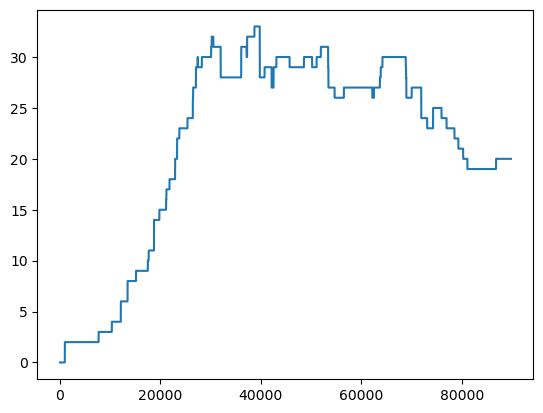

In [221]:
comprehensive_vault_stats['total_open_ilk_count'].plot()

In [222]:
comprehensive_vault_stats['status'].describe()

count      89768
unique         2
top       Closed
freq       55439
Name: status, dtype: object

In [223]:
comprehensive_vault_stats[['liquidation_ratio','liquidation_penalty','annualized stability fee',
       'annualized_revenues', 'dart', 'total_ann_revenues',
       'prev_dai_ceiling']].describe()

,liquidation_ratio,liquidation_penalty,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling
count,"89,768.00000","89,768.00000","89,768.00000","89,768.00000","89,768.00000","89,768.00000","89,712.00000"
mean,3.66566,-0.06543,0.02736,"815,536.32661","66,249,432.36808","50,971,731.95699","83,792,289.82375"
std,12.87870,0.33568,0.07241,"5,184,056.38008","334,003,236.11316","53,482,300.84802","424,802,863.29344"
min,0.00000,-1.00000,0.00000,0.00000,0.00000,0.00000,0.00000
25%,0.00000,0.00000,0.00000,0.00000,0.00000,"12,279,590.28742",0.00000
50%,1.02000,0.00000,0.01000,0.00000,0.00000,"35,141,262.35758",0.00000
75%,1.65000,0.13000,0.03440,"39,647.80460","5,622,765.21968","73,082,034.63709","10,260,042.46594"
max,100.00000,0.13000,0.50250,"142,209,506.83116","5,464,044,218.45438","351,700,458.60804","6,412,161,881.79308"


In [224]:
closed_vaults = comprehensive_vault_stats[comprehensive_vault_stats['status'] == 'Closed']

In [225]:
zero_balances = comprehensive_vault_stats[comprehensive_vault_stats['cumulative_collateral'] == 0]

In [226]:
usdt_a = comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='USDT-A']

In [227]:
usdt_a.tail()

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling,total_open_ilk_count
89532,2024-03-17 00:00:00+00:00,589.69935,USDT-A,0.33359,196.71806,0.00000,"10,000.00000",0.00000,1.00077,0.00000,...,0.08000,0.00000,0.00000,"209,313,743.79574",0.00000,Closed,NaN,590.15417,885.23126,20
89570,2024-03-18 00:00:00+00:00,589.69935,USDT-A,0.33359,196.71806,0.00000,"10,000.00000",0.00000,1.00077,0.00000,...,0.08000,0.00000,0.00000,"206,241,667.89842",0.00000,Closed,NaN,590.15417,885.23126,20
89614,2024-03-19 00:00:00+00:00,589.69935,USDT-A,0.33359,196.71806,0.00000,"10,000.00000",0.00000,1.00077,0.00000,...,0.08000,0.00000,0.00000,"199,379,356.92988",0.00000,Closed,NaN,590.15417,885.23126,20
89687,2024-03-20 00:00:00+00:00,589.69935,USDT-A,0.33359,196.71806,0.00000,"10,000.00000",0.00000,1.00077,0.00000,...,0.08000,0.00000,0.00000,"203,058,946.36180",0.00000,Closed,NaN,590.15417,885.23126,20
89751,2024-03-21 00:00:00+00:00,589.69935,USDT-A,0.33359,196.71806,0.00000,"10,000.00000",0.00000,1.00077,0.00000,...,0.08000,0.00000,0.00000,"176,643,660.32374",0.00000,Closed,NaN,590.15417,885.23126,20


In [228]:
zero_balances['ilk'].unique()

array(['PSM-PAX-A', 'WBTC-B', 'RWA004-A', 'COMP-A', 'TUSD-A', 'MATIC-A',
       'KNC-A', 'WSTETH-B', 'USDC-A', 'UNIV2WBTCDAI-A', 'CRVV1ETHSTETH-A',
       'PSM-GUSD-A', 'RWA005-A', 'RWA013-A', 'RWA012-A', 'USDC-B',
       'RWA011-A', 'RWA009-A', 'RWA006-A', 'UNIV2AAVEETH-A', 'WSTETH-A',
       'RETH-A', 'UNIV2DAIETH-A', 'USDT-A', 'UNIV2DAIUSDC-A', 'LINK-A',
       'RWA002-A', 'PSM-USDC-A', 'WBTC-A', 'GUNIV3DAIUSDC1-A', 'RENBTC-A',
       'BAT-A', 'UNIV2DAIUSDT-A', 'GNO-A', 'WBTC-C', 'UNIV2USDCETH-A',
       'RWA001-A', 'UNIV2WBTCETH-A', 'LRC-A', 'ETH-B', 'RWA008-A',
       'PAXUSD-A', 'UNI-A', 'UNIV2LINKETH-A', 'AAVE-A',
       'GUNIV3DAIUSDC2-A', 'RWA003-A', 'GUSD-A', 'UNIV2UNIETH-A', 'ETH-C',
       'YFI-A', 'ZRX-A', 'BAL-A', 'RWA010-A', 'MANA-A', 'ETH-A'],
      dtype=object)

In [229]:
closed_vaults['ilk'].unique()

array(['PSM-PAX-A', 'WBTC-B', 'RWA004-A', 'COMP-A', 'TUSD-A', 'MATIC-A',
       'KNC-A', 'WSTETH-B', 'USDC-A', 'UNIV2WBTCDAI-A', 'CRVV1ETHSTETH-A',
       'PSM-GUSD-A', 'RWA005-A', 'RWA013-A', 'RWA012-A', 'USDC-B',
       'RWA011-A', 'RWA009-A', 'RWA006-A', 'UNIV2AAVEETH-A', 'WSTETH-A',
       'RETH-A', 'UNIV2DAIETH-A', 'USDT-A', 'UNIV2DAIUSDC-A', 'LINK-A',
       'RWA002-A', 'PSM-USDC-A', 'WBTC-A', 'GUNIV3DAIUSDC1-A', 'RENBTC-A',
       'BAT-A', 'UNIV2DAIUSDT-A', 'GNO-A', 'WBTC-C', 'UNIV2USDCETH-A',
       'RWA001-A', 'UNIV2WBTCETH-A', 'LRC-A', 'ETH-B', 'RWA008-A',
       'PAXUSD-A', 'UNI-A', 'UNIV2LINKETH-A', 'AAVE-A',
       'GUNIV3DAIUSDC2-A', 'RWA003-A', 'GUSD-A', 'UNIV2UNIETH-A', 'ETH-C',
       'YFI-A', 'ZRX-A', 'BAL-A', 'RWA010-A', 'MANA-A', 'ETH-A'],
      dtype=object)

In [230]:
wbtc = comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='WBTC-A']
eth_a = comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='ETH-A']

In [231]:
wbtc['annualized_revenues']

28               0.00000
67               0.00000
126              0.00000
204              0.00000
266              0.00000
              ...       
89498   10,556,749.35181
89568   10,624,931.89974
89609   10,570,053.97601
89658   10,572,073.97253
89714   10,567,608.93779
Name: annualized_revenues, Length: 1603, dtype: float64

In [232]:
eth_a['status']

55       Closed
110      Closed
162      Closed
193      Closed
245      Closed
          ...  
89516      Open
89544      Open
89612      Open
89691      Open
89754      Open
Name: status, Length: 1603, dtype: object

In [233]:
eth_a_df = eth_a['dai_ceiling'].to_frame('eth_a_dai_ceiling')

In [234]:
eth_a_zero_dai_ceiling = eth_a[eth_a['dai_ceiling'] == 0]

In [235]:
eth_a_zero_dai_ceiling.head()

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling,total_open_ilk_count
55,2019-11-01 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000,0
110,2019-11-02 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
162,2019-11-03 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
193,2019-11-04 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
245,2019-11-05 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0


In [236]:
eth_a_df.head()

,eth_a_dai_ceiling
55,0.00000
110,0.00000
162,0.00000
193,0.00000
245,0.00000


In [237]:
wbtc = wbtc.set_index('day')

In [238]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='PSM-USDC-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling,total_open_ilk_count
27,2019-11-01 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000,0
101,2019-11-02 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
152,2019-11-03 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
179,2019-11-04 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
250,2019-11-05 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89539,2024-03-17 00:00:00+00:00,"631,684,264.91900",PSM-USDC-A,1.00000,"631,684,264.91900","961,410,955.71145",0.00000,1.00000,1.00000,"631,684,264.91900",...,0.00000,0.00000,"631,684,264.91900","209,313,743.79574","961,410,955.71145",Open,1.00000,"631,684,264.91900","315,842,132.45950",20
89595,2024-03-18 00:00:00+00:00,"399,224,583.39463",PSM-USDC-A,1.00000,"399,224,583.39463","1,043,620,575.48603",0.00000,1.00000,1.00000,"399,224,583.39463",...,0.00000,0.00000,"399,224,583.39463","206,241,667.89842","961,410,955.71145",Open,1.00000,"399,224,583.39463","199,612,291.69732",20
89600,2024-03-19 00:00:00+00:00,"403,655,435.55115",PSM-USDC-A,1.00000,"403,655,435.55115","748,775,785.68557",0.00000,1.00000,1.00000,"403,655,435.55114",...,0.00000,0.00000,"403,655,435.55114","199,379,356.92988","1,043,620,575.48603",Open,1.00000,"403,655,435.55115","201,827,717.77557",20
89678,2024-03-20 00:00:00+00:00,"450,666,441.96510",PSM-USDC-A,1.00000,"450,666,441.96510","807,437,546.92175",0.00000,1.00000,1.00000,"450,666,441.96510",...,0.00000,0.00000,"450,666,441.96510","203,058,946.36180","748,775,785.68557",Open,1.00000,"450,666,441.96510","225,333,220.98255",20


In [239]:
comprehensive_vault_stats.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count'],
      dtype='object')

In [240]:
comprehensive_vault_stats['ilk'].sort_values().unique()

array(['AAVE-A', 'BAL-A', 'BAT-A', 'COMP-A', 'CRVV1ETHSTETH-A', 'ETH-A',
       'ETH-B', 'ETH-C', 'GNO-A', 'GUNIV3DAIUSDC1-A', 'GUNIV3DAIUSDC2-A',
       'GUSD-A', 'KNC-A', 'LINK-A', 'LRC-A', 'MANA-A', 'MATIC-A',
       'PAXUSD-A', 'PSM-GUSD-A', 'PSM-PAX-A', 'PSM-USDC-A', 'RENBTC-A',
       'RETH-A', 'RWA001-A', 'RWA002-A', 'RWA003-A', 'RWA004-A',
       'RWA005-A', 'RWA006-A', 'RWA008-A', 'RWA009-A', 'RWA010-A',
       'RWA011-A', 'RWA012-A', 'RWA013-A', 'TUSD-A', 'UNI-A',
       'UNIV2AAVEETH-A', 'UNIV2DAIETH-A', 'UNIV2DAIUSDC-A',
       'UNIV2DAIUSDT-A', 'UNIV2LINKETH-A', 'UNIV2UNIETH-A',
       'UNIV2USDCETH-A', 'UNIV2WBTCDAI-A', 'UNIV2WBTCETH-A', 'USDC-A',
       'USDC-B', 'USDT-A', 'WBTC-A', 'WBTC-B', 'WBTC-C', 'WSTETH-A',
       'WSTETH-B', 'YFI-A', 'ZRX-A'], dtype=object)

In [241]:
comprehensive_vault_stats['status'].head()

0    Closed
1    Closed
2    Closed
3    Closed
4    Closed
Name: status, dtype: object

In [242]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='PSM-USDC-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling,total_open_ilk_count
27,2019-11-01 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000,0
101,2019-11-02 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
152,2019-11-03 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
179,2019-11-04 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
250,2019-11-05 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89539,2024-03-17 00:00:00+00:00,"631,684,264.91900",PSM-USDC-A,1.00000,"631,684,264.91900","961,410,955.71145",0.00000,1.00000,1.00000,"631,684,264.91900",...,0.00000,0.00000,"631,684,264.91900","209,313,743.79574","961,410,955.71145",Open,1.00000,"631,684,264.91900","315,842,132.45950",20
89595,2024-03-18 00:00:00+00:00,"399,224,583.39463",PSM-USDC-A,1.00000,"399,224,583.39463","1,043,620,575.48603",0.00000,1.00000,1.00000,"399,224,583.39463",...,0.00000,0.00000,"399,224,583.39463","206,241,667.89842","961,410,955.71145",Open,1.00000,"399,224,583.39463","199,612,291.69732",20
89600,2024-03-19 00:00:00+00:00,"403,655,435.55115",PSM-USDC-A,1.00000,"403,655,435.55115","748,775,785.68557",0.00000,1.00000,1.00000,"403,655,435.55114",...,0.00000,0.00000,"403,655,435.55114","199,379,356.92988","1,043,620,575.48603",Open,1.00000,"403,655,435.55115","201,827,717.77557",20
89678,2024-03-20 00:00:00+00:00,"450,666,441.96510",PSM-USDC-A,1.00000,"450,666,441.96510","807,437,546.92175",0.00000,1.00000,1.00000,"450,666,441.96510",...,0.00000,0.00000,"450,666,441.96510","203,058,946.36180","748,775,785.68557",Open,1.00000,"450,666,441.96510","225,333,220.98255",20


In [243]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk'] =='PSM-USDC-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,status,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling,total_open_ilk_count
27,2019-11-01 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,NaN,Closed,0.00000,0.00000,0.00000,0
101,2019-11-02 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
152,2019-11-03 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
179,2019-11-04 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
250,2019-11-05 00:00:00+00:00,0.00000,PSM-USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,Closed,0.00000,0.00000,0.00000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89539,2024-03-17 00:00:00+00:00,"631,684,264.91900",PSM-USDC-A,1.00000,"631,684,264.91900","961,410,955.71145",0.00000,1.00000,1.00000,"631,684,264.91900",...,0.00000,0.00000,"631,684,264.91900","209,313,743.79574","961,410,955.71145",Open,1.00000,"631,684,264.91900","315,842,132.45950",20
89595,2024-03-18 00:00:00+00:00,"399,224,583.39463",PSM-USDC-A,1.00000,"399,224,583.39463","1,043,620,575.48603",0.00000,1.00000,1.00000,"399,224,583.39463",...,0.00000,0.00000,"399,224,583.39463","206,241,667.89842","961,410,955.71145",Open,1.00000,"399,224,583.39463","199,612,291.69732",20
89600,2024-03-19 00:00:00+00:00,"403,655,435.55115",PSM-USDC-A,1.00000,"403,655,435.55115","748,775,785.68557",0.00000,1.00000,1.00000,"403,655,435.55114",...,0.00000,0.00000,"403,655,435.55114","199,379,356.92988","1,043,620,575.48603",Open,1.00000,"403,655,435.55115","201,827,717.77557",20
89678,2024-03-20 00:00:00+00:00,"450,666,441.96510",PSM-USDC-A,1.00000,"450,666,441.96510","807,437,546.92175",0.00000,1.00000,1.00000,"450,666,441.96510",...,0.00000,0.00000,"450,666,441.96510","203,058,946.36180","748,775,785.68557",Open,1.00000,"450,666,441.96510","225,333,220.98255",20


In [244]:
comprehensive_vault_stats['BTC Vault'] = comprehensive_vault_stats['ilk'].isin(['WBTC-A','WBTC-B','WBTC-C','RENBTC-A'])
comprehensive_vault_stats['ETH Vault'] = comprehensive_vault_stats['ilk'].isin(['ETH-A','ETH-B','ETH-C'])
comprehensive_vault_stats['stETH Vault'] = comprehensive_vault_stats['ilk'].isin(['WSTETH-A', 'WSTETH-B','RETH-A'])
comprehensive_vault_stats['Stablecoin Vault'] = comprehensive_vault_stats['ilk'].isin(['USDC-A', 'USDC-B', 'USDT-A','GUSD-A','PAXUSD-A','TUSD-A'])
comprehensive_vault_stats['Altcoin Vault'] = comprehensive_vault_stats['ilk'].isin(['AAVE-A', 'BAL-A', 'BAT-A', 'COMP-A','GNO-A','KNC-A', 'LINK-A', 'LRC-A', 'MANA-A', 'MATIC-A','UNI-A','YFI-A', 'ZRX-A'])
comprehensive_vault_stats['LP Vault'] = comprehensive_vault_stats['ilk'].isin(['CRVV1ETHSTETH-A','GUNIV3DAIUSDC1-A', 'GUNIV3DAIUSDC2-A','UNIV2AAVEETH-A', 'UNIV2DAIETH-A','UNIV2DAIUSDC-A', 'UNIV2DAIUSDT-A', 'UNIV2LINKETH-A','UNIV2UNIETH-A', 'UNIV2USDCETH-A', 'UNIV2WBTCDAI-A','UNIV2WBTCETH-A'])
comprehensive_vault_stats['RWA Vault'] = comprehensive_vault_stats['ilk'].isin(['RWA001-A', 'RWA002-A', 'RWA003-A', 'RWA004-A','RWA005-A', 'RWA006-A', 'RWA008-A', 'RWA009-A', 'RWA012-A','RWA013-A'])
comprehensive_vault_stats['PSM Vault'] = comprehensive_vault_stats['ilk'].isin(['PSM-GUSD-A', 'PSM-PAX-A', 'PSM-USDC-A'])


In [245]:
lps = comprehensive_vault_stats[comprehensive_vault_stats['ilk'].isin(['CRVV1ETHSTETH-A','GUNIV3DAIUSDC1-A', 'GUNIV3DAIUSDC2-A','PSM-GUSD-A', 'PSM-PAX-A', 'PSM-USDC-A','UNIV2AAVEETH-A', 'UNIV2DAIETH-A','UNIV2DAIUSDC-A', 'UNIV2DAIUSDT-A', 'UNIV2LINKETH-A','UNIV2UNIETH-A', 'UNIV2USDCETH-A', 'UNIV2WBTCDAI-A','UNIV2WBTCETH-A'])]
lps.columns
lps[['day','ilk','annualized stability fee','collateral_usd']].tail(20)

,day,ilk,annualized stability fee,collateral_usd
89700,2024-03-20 00:00:00+00:00,UNIV2WBTCETH-A,0.02000,0.35898
89701,2024-03-20 00:00:00+00:00,UNIV2DAIUSDC-A,0.00020,"406,695.38985"
89702,2024-03-20 00:00:00+00:00,UNIV2AAVEETH-A,0.03000,554.26872
89703,2024-03-20 00:00:00+00:00,GUNIV3DAIUSDC2-A,0.00060,"73,083,493.29621"
89709,2024-03-20 00:00:00+00:00,PSM-GUSD-A,0.00000,0.00000
89717,2024-03-21 00:00:00+00:00,CRVV1ETHSTETH-A,0.04240,8.38975
89725,2024-03-21 00:00:00+00:00,UNIV2WBTCETH-A,0.02000,0.35898
89728,2024-03-21 00:00:00+00:00,UNIV2DAIETH-A,0.01000,"25,643.30807"
89729,2024-03-21 00:00:00+00:00,UNIV2AAVEETH-A,0.03000,554.26872
89732,2024-03-21 00:00:00+00:00,UNIV2LINKETH-A,0.03000,"6,729.74113"


In [246]:
psms = comprehensive_vault_stats[comprehensive_vault_stats['ilk'].isin(['PSM-GUSD-A', 'PSM-PAX-A', 'PSM-USDC-A'])]
psms.tail(50)


,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,hypothetical_dai_ceiling,total_open_ilk_count,BTC Vault,ETH Vault,stETH Vault,Stablecoin Vault,Altcoin Vault,LP Vault,RWA Vault,PSM Vault
88834,2024-03-05 00:00:00+00:00,"225,246,235.20562",PSM-USDC-A,1.00000,"225,246,235.20562","482,841,222.63097",0.00000,1.00000,1.00000,"225,246,235.20562",...,"112,623,117.60281",20,False,False,False,False,False,False,False,True
88860,2024-03-05 00:00:00+00:00,"2,086.17000",PSM-GUSD-A,1.00000,"2,086.17000","110,000,000.00000",0.00000,1.00000,0.00000,"2,086.17000",...,0.00000,20,False,False,False,False,False,False,False,True
88877,2024-03-06 00:00:00+00:00,"2,086.17000",PSM-GUSD-A,1.00000,"2,086.17000","110,000,000.00000",0.00000,1.00000,0.00000,"2,086.17000",...,0.00000,20,False,False,False,False,False,False,False,True
88887,2024-03-06 00:00:00+00:00,"374,447,521.43867",PSM-USDC-A,1.00000,"374,447,521.43867","696,505,568.85592",0.00000,1.00000,1.00000,"374,447,521.43866",...,"187,223,760.71933",20,False,False,False,False,False,False,False,True
88895,2024-03-06 00:00:00+00:00,"704,650.09722",PSM-PAX-A,1.00000,"704,650.09722","120,000,000.00000",0.00000,1.00000,0.00000,"704,650.09722",...,0.00000,20,False,False,False,False,False,False,False,True
88954,2024-03-07 00:00:00+00:00,"2,086.17000",PSM-GUSD-A,1.00000,"2,086.17000","110,000,000.00000",0.00000,1.00000,0.00000,"2,086.17000",...,0.00000,20,False,False,False,False,False,False,False,True
88957,2024-03-07 00:00:00+00:00,"704,650.09722",PSM-PAX-A,1.00000,"704,650.09722","120,000,000.00000",0.00000,1.00000,0.00000,"704,650.09722",...,0.00000,20,False,False,False,False,False,False,False,True
88972,2024-03-07 00:00:00+00:00,"351,498,574.90010",PSM-USDC-A,1.00000,"351,498,574.90010","696,505,568.85592",0.00000,1.00000,1.00000,"351,498,574.90010",...,"175,749,287.45005",20,False,False,False,False,False,False,False,True
88994,2024-03-08 00:00:00+00:00,"451,050,744.79958",PSM-USDC-A,1.00000,"451,050,744.79958","696,505,568.85592",0.00000,1.00000,1.00000,"451,050,744.79958",...,"225,525,372.39979",20,False,False,False,False,False,False,False,True
88999,2024-03-08 00:00:00+00:00,"2,086.17000",PSM-GUSD-A,1.00000,"2,086.17000","110,000,000.00000",0.00000,1.00000,0.00000,"2,086.17000",...,0.00000,20,False,False,False,False,False,False,False,True


In [247]:
comprehensive_vault_stats.duplicated().sum()

0

In [248]:
comprehensive_vault_stats[['day','ilk','PSM Vault']].tail(50)

,day,ilk,PSM Vault
89718,2024-03-21 00:00:00+00:00,BAL-A,False
89719,2024-03-21 00:00:00+00:00,GNO-A,False
89720,2024-03-21 00:00:00+00:00,WBTC-C,False
89721,2024-03-21 00:00:00+00:00,RWA012-A,False
89722,2024-03-21 00:00:00+00:00,WSTETH-B,False
89723,2024-03-21 00:00:00+00:00,RWA013-A,False
89724,2024-03-21 00:00:00+00:00,USDC-A,False
89725,2024-03-21 00:00:00+00:00,UNIV2WBTCETH-A,False
89726,2024-03-21 00:00:00+00:00,RWA008-A,False
89727,2024-03-21 00:00:00+00:00,LINK-A,False


In [249]:
#then we join this, and divide category usd by total daily usd to get percentage of portfolio 
total_daily_usd_bal = comprehensive_vault_stats.groupby('day')['collateral_usd'].sum()
total_daily_usd_bal

day
2019-11-01 00:00:00+00:00               0.00000
2019-11-02 00:00:00+00:00               0.00000
2019-11-03 00:00:00+00:00               0.00000
2019-11-04 00:00:00+00:00               0.00000
2019-11-05 00:00:00+00:00               0.00000
                                    ...        
2024-03-17 00:00:00+00:00   7,937,782,740.70245
2024-03-18 00:00:00+00:00   7,534,867,709.00296
2024-03-19 00:00:00+00:00   7,076,723,446.57769
2024-03-20 00:00:00+00:00   7,342,533,784.81053
2024-03-21 00:00:00+00:00   7,068,469,451.14297
Name: collateral_usd, Length: 1603, dtype: float64

In [250]:
vaultsbtc = comprehensive_vault_stats[comprehensive_vault_stats['ilk'].isin(['WBTC-A','WBTC-B','WBTC-C','RENBTC-A'])]
vaultspsm = comprehensive_vault_stats[comprehensive_vault_stats['ilk'].isin(['PSM-GUSD-A', 'PSM-PAX-A', 'PSM-USDC-A'])]
vaultslp = comprehensive_vault_stats[comprehensive_vault_stats['ilk'].isin(['CRVV1ETHSTETH-A','GUNIV3DAIUSDC1-A', 'GUNIV3DAIUSDC2-A','UNIV2AAVEETH-A', 'UNIV2DAIETH-A','UNIV2DAIUSDC-A', 'UNIV2DAIUSDT-A', 'UNIV2LINKETH-A','UNIV2UNIETH-A', 'UNIV2USDCETH-A', 'UNIV2WBTCDAI-A','UNIV2WBTCETH-A'])]
vaultsalt = comprehensive_vault_stats[comprehensive_vault_stats['ilk'].isin(['AAVE-A', 'BAL-A', 'BAT-A', 'COMP-A','GNO-A','KNC-A', 'LINK-A', 'LRC-A', 'MANA-A', 'MATIC-A','UNI-A','YFI-A', 'ZRX-A'])]

<Axes: >

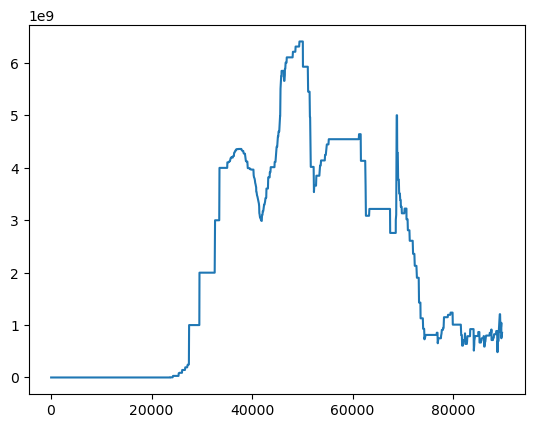

In [251]:
psm_usdc = vaultspsm[vaultspsm['ilk']=='PSM-USDC-A']
psm_usdc['dai_ceiling'].plot()

In [252]:
print(vaultspsm['ilk'].unique())
print(vaultslp['ilk'].unique())

['PSM-PAX-A' 'PSM-GUSD-A' 'PSM-USDC-A']
['UNIV2WBTCDAI-A' 'CRVV1ETHSTETH-A' 'UNIV2AAVEETH-A' 'UNIV2DAIETH-A'
 'UNIV2DAIUSDC-A' 'GUNIV3DAIUSDC1-A' 'UNIV2DAIUSDT-A' 'UNIV2USDCETH-A'
 'UNIV2WBTCETH-A' 'UNIV2LINKETH-A' 'GUNIV3DAIUSDC2-A' 'UNIV2UNIETH-A']


<Axes: >

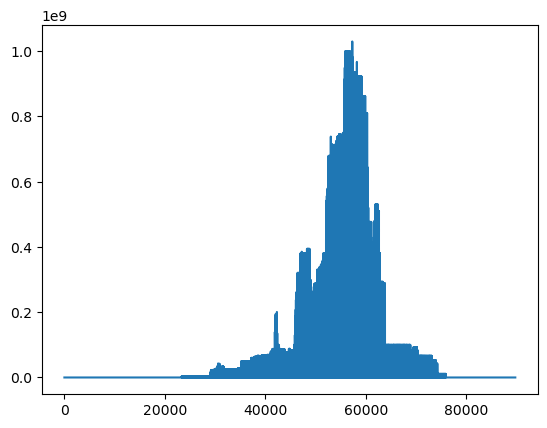

In [253]:
vaultslp['dai_ceiling'].plot()

In [254]:
vaultsbtc.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [255]:
print(vaultsbtc.columns)
print(vaultsbtc.index)


Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')
Index([    1,    28,    30,    34,    65,    67,    88,   102,   126,   135,
       ...
       89637, 89650, 89658, 89675, 89684, 89685, 89714, 89720, 89733, 89758],
      dtype='int64', length=6412)


In [256]:
btc_vault_daily_collateral_sum = vaultsbtc.groupby('day')['collateral_usd'].sum().reset_index()
btc_vault_daily_collateral_sum

,day,collateral_usd
0,2019-11-01 00:00:00+00:00,0.00000
1,2019-11-02 00:00:00+00:00,0.00000
2,2019-11-03 00:00:00+00:00,0.00000
3,2019-11-04 00:00:00+00:00,0.00000
4,2019-11-05 00:00:00+00:00,0.00000
...,...,...
1598,2024-03-17 00:00:00+00:00,"706,205,158.85654"
1599,2024-03-18 00:00:00+00:00,"700,133,609.78409"
1600,2024-03-19 00:00:00+00:00,"667,740,308.45439"
1601,2024-03-20 00:00:00+00:00,"689,743,944.46674"


In [257]:
vaultsbtc['liquidation_penalty'].describe()

count   6,412.00000
mean        0.05686
std         0.15854
min        -1.00000
25%         0.00000
50%         0.13000
75%         0.13000
max         0.13000
Name: liquidation_penalty, dtype: float64

In [258]:
btc_vault_data = comprehensive_vault_stats[comprehensive_vault_stats['BTC Vault']]
btc_vault_daily_sum = btc_vault_data.groupby('day')['collateral_usd'].sum().reset_index(name='BTC Vault_Collateral_usd')
btc_vault_daily_sum

,day,BTC Vault_Collateral_usd
0,2019-11-01 00:00:00+00:00,0.00000
1,2019-11-02 00:00:00+00:00,0.00000
2,2019-11-03 00:00:00+00:00,0.00000
3,2019-11-04 00:00:00+00:00,0.00000
4,2019-11-05 00:00:00+00:00,0.00000
...,...,...
1598,2024-03-17 00:00:00+00:00,"706,205,158.85654"
1599,2024-03-18 00:00:00+00:00,"700,133,609.78409"
1600,2024-03-19 00:00:00+00:00,"667,740,308.45439"
1601,2024-03-20 00:00:00+00:00,"689,743,944.46674"


In [259]:
sum_columns = [
    'dai_ceiling', 'dai_floor', 'debt_balance', 'daily_revenues',
    'annualized_revenues', 'dart', 
    'prev_dai_ceiling', 'collateral_usd', 'hypothetical_dai_ceiling'
]

btc_vault_data = comprehensive_vault_stats[comprehensive_vault_stats['BTC Vault']]

# Dictionary to hold the results with new column names
sum_results = {}

# Group by 'day' and sum each column, assigning new column names with f-string
for column in sum_columns:
    sum_results[f'BTC Vault_{column}'] = btc_vault_data.groupby('day')[column].sum()

# Convert the dictionary to a DataFrame
btc_vault_daily_sum = pd.DataFrame(sum_results)

# Resetting index to get 'day' as a column if needed
btc_vault_daily_sum.reset_index(inplace=True)

# Display the resulting DataFrame
btc_vault_daily_sum

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling
0,2019-11-01 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-02 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-03 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-04 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-05 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...
1598,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666"
1599,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986"
1600,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568"
1601,2024-03-20 00:00:00+00:00,"220,309,779.92933","51,000.00000","186,448,110.19433","121,966.07844","31,291,164.53273","186,448,110.19433","220,631,595.82640","689,743,944.46674","535,947,779.06571"


In [260]:

# Assuming 'comprehensive_vault_stats' is already loaded and available

# Columns to sum
sum_columns = [
    'dai_ceiling', 'dai_floor', 'debt_balance', 'daily_revenues',
    'annualized_revenues', 'dart', 
    'prev_dai_ceiling', 'collateral_usd', 'hypothetical_dai_ceiling'
]

categories = [
    'BTC Vault', 'ETH Vault', 'stETH Vault', 'Stablecoin Vault',
    'Altcoin Vault', 'LP Vault', 'RWA Vault','PSM Vault'
]

# Dictionary to hold DataFrames for each category
category_dfs = {}

# Loop through each category to filter data, sum by day, and create a DataFrame
for category in categories:
    # Filter data for the current category
    category_data = comprehensive_vault_stats[comprehensive_vault_stats[category]]

    # Dictionary to hold the results with new column names
    sum_results = {}

    # Group by 'day' and sum each column, assigning new column names with f-string
    for column in sum_columns:
        sum_results[f'{category}_{column}'] = category_data.groupby('day')[column].sum()

    # Convert the dictionary to a DataFrame and reset index to make 'day' a column
    category_df = pd.DataFrame(sum_results).reset_index()

    # Store the DataFrame in the dictionary using the category as the key
    category_dfs[category] = category_df




In [261]:
category_dfs.keys()

dict_keys(['BTC Vault', 'ETH Vault', 'stETH Vault', 'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault', 'PSM Vault'])

In [262]:
 category_dfs['BTC Vault']

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling
0,2019-11-01 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-02 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-03 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-04 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-05 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...
1598,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666"
1599,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986"
1600,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568"
1601,2024-03-20 00:00:00+00:00,"220,309,779.92933","51,000.00000","186,448,110.19433","121,966.07844","31,291,164.53273","186,448,110.19433","220,631,595.82640","689,743,944.46674","535,947,779.06571"


In [263]:
# Example to access the DataFrame for 'BTC Vault'
btc_vault_daily_sum = category_dfs['BTC Vault']
eth_vault_daily_sum = category_dfs['ETH Vault']
stETH_vault_daily_sum = category_dfs['stETH Vault']
Stablecoin_Vault = category_dfs['Stablecoin Vault']
Altcoin_Vault = category_dfs['Altcoin Vault']
LP_Vault = category_dfs['LP Vault']
RWA_Vault = category_dfs['RWA Vault']
PSM_vault = category_dfs['PSM Vault']

In [264]:
btc_vault_daily_sum.head(20)

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling
0,2019-11-01 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-02 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-03 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-04 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-05 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
5,2019-11-06 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
6,2019-11-07 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
7,2019-11-08 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
8,2019-11-09 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
9,2019-11-10 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [265]:
aggregated_vaults = pd.merge(btc_vault_daily_sum, eth_vault_daily_sum, on=['day'],how='inner')
aggregated_vaults = aggregated_vaults.merge(stETH_vault_daily_sum, on=['day'],how='inner')
aggregated_vaults = aggregated_vaults.merge(Stablecoin_Vault, on=['day'],how='inner')
aggregated_vaults = aggregated_vaults.merge(Altcoin_Vault, on=['day'],how='inner')
aggregated_vaults = aggregated_vaults.merge(LP_Vault, on=['day'],how='inner')
aggregated_vaults = aggregated_vaults.merge(RWA_Vault, on=['day'],how='inner')
aggregated_vaults = aggregated_vaults.merge(PSM_vault, on=['day'],how='inner')

In [266]:
aggregated_vaults.isna().sum().sum()

0

In [267]:
aggregated_vaults.columns

Index(['day', 'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor',
       'BTC Vault_debt_balance', 'BTC Vault_daily_revenues',
       'BTC Vault_annualized_revenues', 'BTC Vault_dart',
       'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd',
       'BTC Vault_hypothetical_dai_ceiling', 'ETH Vault_dai_ceiling',
       'ETH Vault_dai_floor', 'ETH Vault_debt_balance',
       'ETH Vault_daily_revenues', 'ETH Vault_annualized_revenues',
       'ETH Vault_dart', 'ETH Vault_prev_dai_ceiling',
       'ETH Vault_collateral_usd', 'ETH Vault_hypothetical_dai_ceiling',
       'stETH Vault_dai_ceiling', 'stETH Vault_dai_floor',
       'stETH Vault_debt_balance', 'stETH Vault_daily_revenues',
       'stETH Vault_annualized_revenues', 'stETH Vault_dart',
       'stETH Vault_prev_dai_ceiling', 'stETH Vault_collateral_usd',
       'stETH Vault_hypothetical_dai_ceiling', 'Stablecoin Vault_dai_ceiling',
       'Stablecoin Vault_dai_floor', 'Stablecoin Vault_debt_balance',
       'Stablecoin Vault_dai

In [268]:
aggregated_vaults['Vaults Total USD Value'] = aggregated_vaults[['BTC Vault_collateral_usd','ETH Vault_collateral_usd','stETH Vault_collateral_usd',
    'Stablecoin Vault_collateral_usd','Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd','RWA Vault_collateral_usd','PSM Vault_collateral_usd'
    ]].sum(axis=1)

aggregated_vaults['BTC Debt Ratio'] = aggregated_vaults['BTC Vault_debt_balance'] / aggregated_vaults['BTC Vault_collateral_usd']
aggregated_vaults['ETH Debt Ratio']
aggregated_vaults['stETH Debt Ratio']
aggregated_vaults['Stablecoin Debt Ratio']
aggregated_vaults['Altcoin Debt Ratio']
aggregated_vaults['LP Debt Ratio']
aggregated_vaults['RWA Debt Ratio']
aggregated_vaults['PSM Debt Ratio']

aggregated_vaults['BTC Debt Ratio'] = aggregated_vaults['BTC Vault_debt_balance'] / aggregated_vaults['BTC Vault_collateral_usd']
aggregated_vaults['BTC Debt Ratio'].describe()

In [269]:
# Calculate the percentage of total for each vault type
vault_types = ['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd',
               'Stablecoin Vault_collateral_usd', 'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd',
               'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd']

for vault in vault_types:
    aggregated_vaults[f'{vault} % of Total'] = (aggregated_vaults[vault] / aggregated_vaults['Vaults Total USD Value']) * 100

# This will add each vault's percentage of the total USD value as new columns in your DataFrame


In [270]:
aggregated_vaults.columns

Index(['day', 'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor',
       'BTC Vault_debt_balance', 'BTC Vault_daily_revenues',
       'BTC Vault_annualized_revenues', 'BTC Vault_dart',
       'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd',
       'BTC Vault_hypothetical_dai_ceiling', 'ETH Vault_dai_ceiling',
       'ETH Vault_dai_floor', 'ETH Vault_debt_balance',
       'ETH Vault_daily_revenues', 'ETH Vault_annualized_revenues',
       'ETH Vault_dart', 'ETH Vault_prev_dai_ceiling',
       'ETH Vault_collateral_usd', 'ETH Vault_hypothetical_dai_ceiling',
       'stETH Vault_dai_ceiling', 'stETH Vault_dai_floor',
       'stETH Vault_debt_balance', 'stETH Vault_daily_revenues',
       'stETH Vault_annualized_revenues', 'stETH Vault_dart',
       'stETH Vault_prev_dai_ceiling', 'stETH Vault_collateral_usd',
       'stETH Vault_hypothetical_dai_ceiling', 'Stablecoin Vault_dai_ceiling',
       'Stablecoin Vault_dai_floor', 'Stablecoin Vault_debt_balance',
       'Stablecoin Vault_dai

In [271]:
# Columns of interest
columns = ['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd',
           'Stablecoin Vault_collateral_usd', 'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd',
           'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd']

# Check for negative values in these columns
negative_values = (aggregated_vaults[columns] < 0).any()

print(negative_values)


BTC Vault_collateral_usd           False
ETH Vault_collateral_usd           False
stETH Vault_collateral_usd         False
Stablecoin Vault_collateral_usd    False
Altcoin Vault_collateral_usd       False
LP Vault_collateral_usd            False
RWA Vault_collateral_usd           False
PSM Vault_collateral_usd           False
dtype: bool


In [272]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,PSM Vault_hypothetical_dai_ceiling,Vaults Total USD Value,BTC Vault_collateral_usd % of Total,ETH Vault_collateral_usd % of Total,stETH Vault_collateral_usd % of Total,Stablecoin Vault_collateral_usd % of Total,Altcoin Vault_collateral_usd % of Total,LP Vault_collateral_usd % of Total,RWA Vault_collateral_usd % of Total,PSM Vault_collateral_usd % of Total
0,2019-11-01 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2019-11-02 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-11-03 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2019-11-04 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-11-05 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1598,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,"315,842,132.45950","7,937,782,740.70245",8.89676,47.91747,30.14839,0.00125,0.02450,1.22679,3.82691,7.95794
1599,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,"199,612,291.69732","7,534,867,709.00296",9.29192,49.15754,30.90111,0.00132,0.02581,1.29240,4.03155,5.29836
1600,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,"201,827,717.77557","7,076,723,446.57769",9.43573,48.53017,30.63257,0.00140,0.02748,1.37611,4.29255,5.70399
1601,2024-03-20 00:00:00+00:00,"220,309,779.92933","51,000.00000","186,448,110.19433","121,966.07844","31,291,164.53273","186,448,110.19433","220,631,595.82640","689,743,944.46674","535,947,779.06571",...,"225,333,220.98255","7,342,533,784.81053",9.39381,50.20292,28.78604,0.00135,0.02648,1.31449,4.13715,6.13775


In [273]:
aggregated_vaults.columns

Index(['day', 'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor',
       'BTC Vault_debt_balance', 'BTC Vault_daily_revenues',
       'BTC Vault_annualized_revenues', 'BTC Vault_dart',
       'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd',
       'BTC Vault_hypothetical_dai_ceiling', 'ETH Vault_dai_ceiling',
       'ETH Vault_dai_floor', 'ETH Vault_debt_balance',
       'ETH Vault_daily_revenues', 'ETH Vault_annualized_revenues',
       'ETH Vault_dart', 'ETH Vault_prev_dai_ceiling',
       'ETH Vault_collateral_usd', 'ETH Vault_hypothetical_dai_ceiling',
       'stETH Vault_dai_ceiling', 'stETH Vault_dai_floor',
       'stETH Vault_debt_balance', 'stETH Vault_daily_revenues',
       'stETH Vault_annualized_revenues', 'stETH Vault_dart',
       'stETH Vault_prev_dai_ceiling', 'stETH Vault_collateral_usd',
       'stETH Vault_hypothetical_dai_ceiling', 'Stablecoin Vault_dai_ceiling',
       'Stablecoin Vault_dai_floor', 'Stablecoin Vault_debt_balance',
       'Stablecoin Vault_dai

<Axes: >

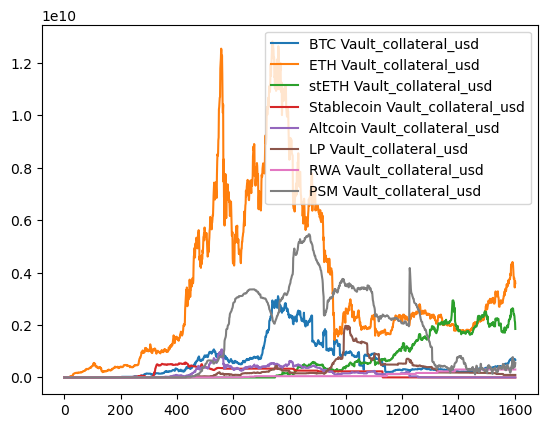

In [274]:
aggregated_vaults[['BTC Vault_collateral_usd','ETH Vault_collateral_usd','stETH Vault_collateral_usd','Stablecoin Vault_collateral_usd'
                  ,'Altcoin Vault_collateral_usd','LP Vault_collateral_usd','RWA Vault_collateral_usd','PSM Vault_collateral_usd']].plot()

<Axes: >

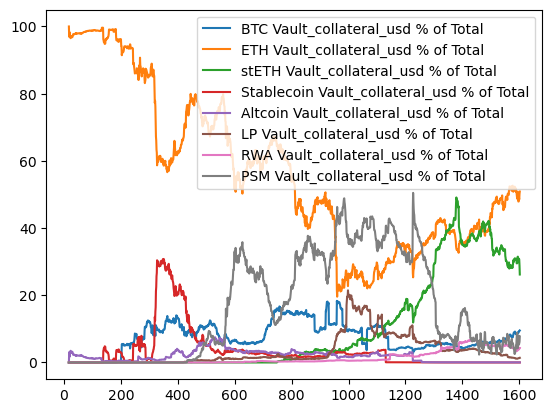

In [275]:
aggregated_vaults[['BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']].plot()

In [276]:

# Assuming comprehensive_vault_stats is your DataFrame

# Columns to sum
sum_columns = [
    'dai_ceiling', 'dai_floor', 'debt_balance', 'daily_revenues',
    'annualized_revenues', 'dart', 'total_ann_revenues', 
    'prev_dai_ceiling', 'collateral_usd', 'hypothetical_dai_ceiling'
]

# List of vault categories
categories = [
    'BTC Vault', 'ETH Vault', 'stETH Vault', 'Stablecoin Vault',
    'Altcoin Vault', 'LP Vault', 'RWA Vault'
]

# Melt the DataFrame to turn category columns into values
melted_data = comprehensive_vault_stats.melt(
    id_vars=['day'] + sum_columns + ['status'],  # Include 'status' to filter by open status in the next steps
    value_vars=categories,
    var_name='Vault Category',
    value_name='Is In Category'
)

# Filter only the entries marked as True for being in a category
filtered_data = melted_data[melted_data['Is In Category']]

# Calculate the sums for each category and each day
pivot_table = pd.pivot_table(
    filtered_data,
    index='day',
    columns='Vault Category',
    values=sum_columns,
    aggfunc='sum',  # Change to 'mean' or any other function as needed
    fill_value=0
)

# Optionally, handle open status here if necessary
# This can involve additional filtering or adjustments based on the 'status' column
# For example, you might want to exclude certain records or adjust weights before summing

# Reset index if needed to flatten the DataFrame after pivoting
pivot_table.reset_index(inplace=True)

# Display the results
print(pivot_table)


                                     day annualized_revenues                   \
Vault Category                                 Altcoin Vault        BTC Vault   
0              2019-11-01 00:00:00+00:00             0.00000          0.00000   
1              2019-11-02 00:00:00+00:00             0.00000          0.00000   
2              2019-11-03 00:00:00+00:00             0.00000          0.00000   
3              2019-11-04 00:00:00+00:00             0.00000          0.00000   
4              2019-11-05 00:00:00+00:00             0.00000          0.00000   
...                                  ...                 ...              ...   
1598           2024-03-17 00:00:00+00:00             0.00000 31,201,440.35276   
1599           2024-03-18 00:00:00+00:00             0.00000 31,326,911.58353   
1600           2024-03-19 00:00:00+00:00             0.00000 31,408,040.35523   
1601           2024-03-20 00:00:00+00:00             0.00000 31,291,164.53273   
1602           2024-03-21 00

In [277]:
# Assuming 'pivot_table' is your current DataFrame after pivoting
pivot_table.columns = ['_'.join(col).strip() for col in pivot_table.columns.values]

# Reset the index to flatten the DataFrame if necessary
pivot_table.reset_index(inplace=True)

# Show the result
pivot_table


,index,day_,annualized_revenues_Altcoin Vault,annualized_revenues_BTC Vault,annualized_revenues_ETH Vault,annualized_revenues_LP Vault,annualized_revenues_RWA Vault,annualized_revenues_Stablecoin Vault,annualized_revenues_stETH Vault,collateral_usd_Altcoin Vault,...,prev_dai_ceiling_RWA Vault,prev_dai_ceiling_Stablecoin Vault,prev_dai_ceiling_stETH Vault,total_ann_revenues_Altcoin Vault,total_ann_revenues_BTC Vault,total_ann_revenues_ETH Vault,total_ann_revenues_LP Vault,total_ann_revenues_RWA Vault,total_ann_revenues_Stablecoin Vault,total_ann_revenues_stETH Vault
0,0,2019-11-01 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,1,2019-11-02 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2,2019-11-03 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,3,2019-11-04 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,4,2019-11-05 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1598,1598,2024-03-17 00:00:00+00:00,0.00000,"31,201,440.35276","92,021,082.13680","47,256.77049","6,573,040.81107",0.00000,"79,470,923.72462","1,944,419.59103",...,"345,000,000.00000",0.00000,"608,732,014.19748","2,721,078,669.34457","837,254,975.18294","627,941,231.38721","2,511,764,925.54883","2,093,137,437.95736","1,255,882,462.77442","627,941,231.38721"
1599,1599,2024-03-18 00:00:00+00:00,0.00000,"31,326,911.58353","92,088,996.25641","47,256.77049","6,687,075.52573",0.00000,"76,091,427.76226","1,944,419.59103",...,"345,000,000.00000",0.00000,"608,732,014.19748","2,681,141,682.67951","824,966,671.59369","618,725,003.69527","2,474,900,014.78108","2,062,416,678.98424","1,237,450,007.39054","618,725,003.69527"
1600,1600,2024-03-19 00:00:00+00:00,0.00000,"31,408,040.35523","91,893,137.23388","47,256.77049","6,677,110.11846",0.00000,"69,353,812.45183","1,944,419.59103",...,"345,000,000.00000",0.00000,"587,778,544.53665","2,591,931,640.08849","797,517,427.71954","598,138,070.78965","2,392,552,283.15861","1,993,793,569.29884","1,196,276,141.57930","598,138,070.78965"
1601,1601,2024-03-20 00:00:00+00:00,0.00000,"31,291,164.53273","93,418,362.17435","47,087.69643","6,642,107.57914",0.00000,"58,724,006.19957","1,944,419.59103",...,"345,000,000.00000",0.00000,"544,519,564.17648","2,639,766,302.70345","812,235,785.44722","609,176,839.08541","2,436,707,356.34165","2,030,589,463.61804","1,218,353,678.17082","609,176,839.08541"


In [278]:
categories = [
    'BTC Vault', 'ETH Vault', 'stETH Vault', 'Stablecoin Vault',
    'Altcoin Vault', 'LP Vault', 'RWA Vault','PSM Vault'
]

sum_columns = [
    'dai_ceiling', 'dai_floor', 'debt_balance', 'daily_revenues',
    'annualized_revenues', 'dart', 'total_ann_revenues', 
    'prev_dai_ceiling', 'collateral_usd', 'hypothetical_dai_ceiling'
]

sums_by_category = comprehensive_vault_stats.groupby(['day'] + categories)[sum_columns].sum().reset_index()

In [279]:
sums_by_category

,day,BTC Vault,ETH Vault,stETH Vault,Stablecoin Vault,Altcoin Vault,LP Vault,RWA Vault,PSM Vault,dai_ceiling,dai_floor,debt_balance,daily_revenues,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,collateral_usd,hypothetical_dai_ceiling
0,2019-11-01 00:00:00+00:00,False,False,False,False,False,False,False,False,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-01 00:00:00+00:00,False,False,False,False,False,False,False,True,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-01 00:00:00+00:00,False,False,False,False,False,False,True,False,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-01 00:00:00+00:00,False,False,False,False,False,True,False,False,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-01 00:00:00+00:00,False,False,False,False,True,False,False,False,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14422,2024-03-21 00:00:00+00:00,False,False,False,False,True,False,False,False,"1,000,000.00000","245,000.00000",0.00000,0.00000,0.00000,0.00000,"2,296,367,584.20862","1,000,000.00000","1,944,419.59103","22,870,013.83909"
14423,2024-03-21 00:00:00+00:00,False,False,False,True,False,False,False,False,0.00000,"80,000.00000",0.00000,0.00000,0.00000,0.00000,"1,059,861,961.94244",0.00000,"99,227.46740","735,071.14706"
14424,2024-03-21 00:00:00+00:00,False,False,True,False,False,False,False,False,"383,086,426.79015","18,500.00000","278,409,969.18084","132,602.56603","45,039,179.33529","278,408,044.91276","529,930,980.97122","475,577,482.17504","1,850,684,284.12040","1,557,055,248.88320"
14425,2024-03-21 00:00:00+00:00,False,True,False,False,False,False,False,False,"967,253,018.36636","36,000.00000","592,206,539.73071","230,846.50420","93,511,367.76612","615,618,583.51221","529,930,980.97122","967,253,018.36636","3,596,025,005.51417","2,813,401,888.72613"


In [280]:
print(comprehensive_vault_stats.head())
print(comprehensive_vault_stats['status'].unique())  # Check unique statuses
print(comprehensive_vault_stats['day'].describe())   # Get an overview of the 'day' column


                        day  cumulative_collateral        ilk  safety_price  \
0 2019-11-01 00:00:00+00:00                0.00000  PSM-PAX-A       0.00000   
1 2019-11-01 00:00:00+00:00                0.00000     WBTC-B       0.00000   
2 2019-11-01 00:00:00+00:00                0.00000   RWA004-A       0.00000   
3 2019-11-01 00:00:00+00:00                0.00000     COMP-A       0.00000   
4 2019-11-01 00:00:00+00:00                0.00000     TUSD-A       0.00000   

   usd_safety_value  dai_ceiling  dai_floor  safety_collateral_ratio  \
0           0.00000      0.00000    0.00000                  0.00000   
1           0.00000      0.00000    0.00000                  0.00000   
2           0.00000      0.00000    0.00000                  0.00000   
3           0.00000      0.00000    0.00000                  0.00000   
4           0.00000      0.00000    0.00000                  0.00000   

   market_price  debt_balance  ...  hypothetical_dai_ceiling  \
0       0.00000       0.0000

In [281]:
comprehensive_vault_stats.columns


Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [282]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='GUNIV3DAIUSDC2-A']['annualized stability fee']

45      0.00000
73      0.00000
136     0.00000
211     0.00000
262     0.00000
          ...  
89504   0.00060
89565   0.00060
89630   0.00060
89703   0.00060
89759   0.00060
Name: annualized stability fee, Length: 1603, dtype: float64

In [283]:
wbtc['ilk'].unique()

array(['WBTC-A'], dtype=object)

In [284]:
def weighted_average(data, value_column, weight_column):
    d = data.dropna(subset=[value_column, weight_column])
    if d.empty:
        return np.nan
    numer = (d[value_column] * d[weight_column]).sum()
    denom = d[weight_column].sum()
    return numer / denom if denom != 0 else np.nan

In [285]:
# Test filtering for a single category

parameters = [
    'safety_collateral_ratio', 'liquidation_penalty',
    'liquidation_ratio', 'annualized stability fee',
    'market_collateral_ratio','market_price'
]
test_data = comprehensive_vault_stats[(comprehensive_vault_stats['BTC Vault']) & (comprehensive_vault_stats['status'] == 'Open')]
print(test_data.head())  # Check the output

# Test grouping and weighted calculation for one day
if not test_data.empty:
    example_group = test_data.groupby('day').get_group(list(test_data['day'])[0])
    example_result = {param: weighted_average(example_group, param, 'collateral_usd') for param in parameters}
    print(example_result)


                            day  cumulative_collateral     ilk  safety_price  \
10308 2020-05-03 00:00:00+00:00               21.57648  WBTC-A   5,900.40667   
10378 2020-05-04 00:00:00+00:00               25.81586  WBTC-A   5,956.66667   
10454 2020-05-05 00:00:00+00:00               31.46315  WBTC-A   5,998.06000   
10505 2020-05-06 00:00:00+00:00               39.49751  WBTC-A   6,193.02933   
10570 2020-05-07 00:00:00+00:00               54.01684  WBTC-A   6,590.72000   

       usd_safety_value      dai_ceiling  dai_floor  safety_collateral_ratio  \
10308     127,310.00018 10,000,000.00000   20.00000                  1.95645   
10378     153,776.45546 10,000,000.00000   20.00000                  2.00274   
10454     188,717.87522 10,000,000.00000   20.00000                  1.92754   
10505     244,609.20898 10,000,000.00000   20.00000                  1.90321   
10570     356,009.89264 10,000,000.00000   20.00000                  2.00713   

       market_price  debt_balance  ...

In [286]:
comprehensive_vault_stats['ilk'].unique()

array(['PSM-PAX-A', 'WBTC-B', 'RWA004-A', 'COMP-A', 'TUSD-A', 'MATIC-A',
       'KNC-A', 'WSTETH-B', 'USDC-A', 'UNIV2WBTCDAI-A', 'CRVV1ETHSTETH-A',
       'PSM-GUSD-A', 'RWA005-A', 'RWA013-A', 'RWA012-A', 'USDC-B',
       'RWA011-A', 'RWA009-A', 'RWA006-A', 'UNIV2AAVEETH-A', 'WSTETH-A',
       'RETH-A', 'UNIV2DAIETH-A', 'USDT-A', 'UNIV2DAIUSDC-A', 'LINK-A',
       'RWA002-A', 'PSM-USDC-A', 'WBTC-A', 'GUNIV3DAIUSDC1-A', 'RENBTC-A',
       'BAT-A', 'UNIV2DAIUSDT-A', 'GNO-A', 'WBTC-C', 'UNIV2USDCETH-A',
       'RWA001-A', 'UNIV2WBTCETH-A', 'LRC-A', 'ETH-B', 'RWA008-A',
       'PAXUSD-A', 'UNI-A', 'UNIV2LINKETH-A', 'AAVE-A',
       'GUNIV3DAIUSDC2-A', 'RWA003-A', 'GUSD-A', 'UNIV2UNIETH-A', 'ETH-C',
       'YFI-A', 'ZRX-A', 'BAL-A', 'RWA010-A', 'MANA-A', 'ETH-A'],
      dtype=object)

In [287]:
comprehensive_vault_stats['ilk'][comprehensive_vault_stats['status'] == 'Open'].unique()

array(['BAT-A', 'ETH-A', 'USDC-A', 'WBTC-A', 'TUSD-A', 'USDC-B', 'ZRX-A',
       'KNC-A', 'MANA-A', 'USDT-A', 'PAXUSD-A', 'LINK-A', 'LRC-A',
       'COMP-A', 'ETH-B', 'YFI-A', 'BAL-A', 'GUSD-A', 'UNI-A', 'RENBTC-A',
       'AAVE-A', 'UNIV2DAIETH-A', 'PSM-USDC-A', 'UNIV2USDCETH-A',
       'UNIV2WBTCETH-A', 'UNIV2LINKETH-A', 'UNIV2UNIETH-A',
       'UNIV2DAIUSDC-A', 'UNIV2WBTCDAI-A', 'UNIV2AAVEETH-A',
       'UNIV2DAIUSDT-A', 'ETH-C', 'RWA002-A', 'RWA001-A', 'RWA005-A',
       'RWA003-A', 'RWA004-A', 'MATIC-A', 'PSM-PAX-A', 'GUNIV3DAIUSDC1-A',
       'WSTETH-A', 'WBTC-B', 'WBTC-C', 'PSM-GUSD-A', 'GUNIV3DAIUSDC2-A',
       'CRVV1ETHSTETH-A', 'WSTETH-B', 'RWA009-A', 'RETH-A', 'RWA008-A',
       'GNO-A', 'RWA013-A', 'RWA012-A', 'RWA011-A', 'RWA010-A'],
      dtype=object)

In [288]:
parameters = [
    'safety_collateral_ratio', 'liquidation_penalty',
    'liquidation_ratio', 'annualized stability fee',
    'market_collateral_ratio', 'market_price'
]

categories = [
    'BTC Vault', 'ETH Vault', 'stETH Vault', 'Stablecoin Vault',
    'Altcoin Vault', 'LP Vault', 'RWA Vault', 'PSM Vault'
]

# Dictionary to store results
results = {category: [] for category in categories}

# Loop over each day and category
for day, day_group in comprehensive_vault_stats.groupby('day'):
    for category in categories:
        # Filter the day's data for open vaults in this category
        category_data = day_group[(day_group[category] == True) & (day_group['status'] == 'Open')]
        
        if not category_data.empty:
            # Calculate weighted averages for each parameter using the function
            daily_results = {}
            for param in parameters:
                if 'collateral_usd' in category_data.columns and param in category_data.columns:
                    weighted_avg = weighted_average(category_data, param, 'collateral_usd')
                    daily_results[f'{category}_{param}'] = weighted_avg
            
            daily_results['day'] = day
            results[category].append(daily_results)

# Convert list of dictionaries to DataFrames
for category in results:
    if results[category]:
        results[category] = pd.DataFrame(results[category])
        results[category]['day'] = pd.to_datetime(results[category]['day'])  # Convert 'day' to datetime if necessary

# Example: Output results for 'BTC Vault'
if 'BTC Vault' in results and not results['BTC Vault'].empty:
    print(results['BTC Vault'].tail())

      BTC Vault_safety_collateral_ratio  BTC Vault_liquidation_penalty  \
1414                            2.51175                        0.13000   
1415                            2.47718                        0.13000   
1416                            2.35993                        0.13000   
1417                            2.43846                        0.13000   
1418                            2.37241                        0.13000   

      BTC Vault_liquidation_ratio  BTC Vault_annualized stability fee  \
1414                      1.55184                             0.16738   
1415                      1.55065                             0.16741   
1416                      1.55252                             0.16738   
1417                      1.55219                             0.16740   
1418                      1.55104                             0.16740   

      BTC Vault_market_collateral_ratio  BTC Vault_market_price  \
1414                            3.89162          

In [289]:
results['BTC Vault'].tail()

,BTC Vault_safety_collateral_ratio,BTC Vault_liquidation_penalty,BTC Vault_liquidation_ratio,BTC Vault_annualized stability fee,BTC Vault_market_collateral_ratio,BTC Vault_market_price,day
1414,2.51175,0.13000,1.55184,0.16738,3.89162,"68,178.35601",2024-03-17 00:00:00+00:00
1415,2.47718,0.13000,1.55065,0.16741,3.83432,"67,550.80000",2024-03-18 00:00:00+00:00
1416,2.35993,0.13000,1.55252,0.16738,3.66257,"64,422.72070",2024-03-19 00:00:00+00:00
1417,2.43846,0.13000,1.55219,0.16740,3.78103,"66,624.21792",2024-03-20 00:00:00+00:00
1418,2.37241,0.13000,1.55104,0.16740,3.67429,"64,993.62544",2024-03-21 00:00:00+00:00


parameters = [
    'safety_collateral_ratio', 'liquidation_penalty',
    'liquidation_ratio', 'annualized stability fee',
    'market_collateral_ratio','market_price'
]

# Categories of vaults
categories = [
    'BTC Vault', 'ETH Vault', 'stETH Vault', 'Stablecoin Vault',
    'Altcoin Vault', 'LP Vault', 'RWA Vault','PSM Vault'
]

# Prepare a dictionary to store the results
results = {category: pd.DataFrame() for category in categories}

# Loop over each category
for category in categories:
    # Filter data for this category where status is 'Open'
    category_data = comprehensive_vault_stats[(comprehensive_vault_stats[category]) & (comprehensive_vault_stats['status'] == 'Open')]
    
    # Group by day
    grouped = category_data.groupby('day')
    
    # For each group, calculate the weighted average for each parameter
    for day, group in grouped:
        daily_results = {f'{category}_{param}': weighted_average(group, param, 'collateral_usd') for param in parameters}
        daily_results['day'] = day
        temp_df = pd.DataFrame([daily_results])  # Create a DataFrame from the dictionary
        results[category] = pd.concat([results[category], temp_df], ignore_index=True)

# Optionally, convert day columns back to datetime if they were converted to string in the process
for category in results:
    if not results[category].empty:
        results[category]['day'] = pd.to_datetime(results[category]['day'])

# Display results for one of the categories
print(results['BTC Vault'])


## Continuing with Vault Aggregations

In [290]:
results['BTC Vault']['BTC Vault_market_price']

0       8,850.61000
1       8,935.00000
2       8,997.09000
3       9,289.54400
4       9,886.08000
           ...     
1414   68,178.35601
1415   67,550.80000
1416   64,422.72070
1417   66,624.21792
1418   64,993.62544
Name: BTC Vault_market_price, Length: 1419, dtype: float64

In [291]:
btc_wa = results['BTC Vault']
eth_wa = results['ETH Vault']
steth_wa = results['stETH Vault']
stablecoin_wa = results['Stablecoin Vault']
altcoin_wa = results['Altcoin Vault']
lp_wa = results['LP Vault']
rwa_wa = results['RWA Vault']
psm_wa = results['PSM Vault']

In [292]:
lp_wa['LP Vault_market_price'].describe()

count           940.00000
mean    198,067,915.33919
std     253,076,052.30848
min              59.59939
25%       1,041,541.21985
50%      37,382,556.95707
75%     428,328,097.73751
max     842,992,192.41600
Name: LP Vault_market_price, dtype: float64

In [293]:
lp_wa['LP Vault_market_price'].pct_change().describe()

count         939.00000
mean        4,175.63649
std       127,954.50642
min            -0.99964
25%            -0.01945
50%             0.00000
75%             0.02141
max     3,920,923.61645
Name: LP Vault_market_price, dtype: float64

<Axes: >

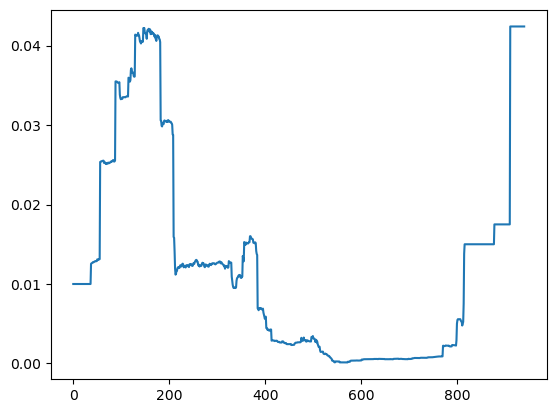

In [294]:
lp_wa['LP Vault_annualized stability fee'].plot()

In [295]:
eth_wa

,ETH Vault_safety_collateral_ratio,ETH Vault_liquidation_penalty,ETH Vault_liquidation_ratio,ETH Vault_annualized stability fee,ETH Vault_market_collateral_ratio,ETH Vault_market_price,day
0,1.99867,0.00000,1.50000,0.04000,2.99800,177.58000,2019-11-18 00:00:00+00:00
1,2.05616,0.00000,1.50000,0.04000,3.08424,173.77500,2019-11-19 00:00:00+00:00
2,2.14036,0.00000,1.50000,0.04000,3.21054,174.32500,2019-11-20 00:00:00+00:00
3,1.91420,0.00000,1.50000,0.04000,2.88029,159.78765,2019-11-21 00:00:00+00:00
4,2.02427,0.00000,1.50000,0.04000,3.03641,152.65526,2019-11-22 00:00:00+00:00
...,...,...,...,...,...,...,...
1581,4.08693,0.13000,1.56135,0.15167,6.36174,"3,630.80000",2024-03-17 00:00:00+00:00
1582,3.97679,0.13000,1.56142,0.15167,6.19132,"3,537.74675",2024-03-18 00:00:00+00:00
1583,3.69944,0.13000,1.56117,0.15168,5.75929,"3,280.75000",2024-03-19 00:00:00+00:00
1584,3.90588,0.13000,1.56201,0.15167,6.07934,"3,484.02500",2024-03-20 00:00:00+00:00


<Axes: >

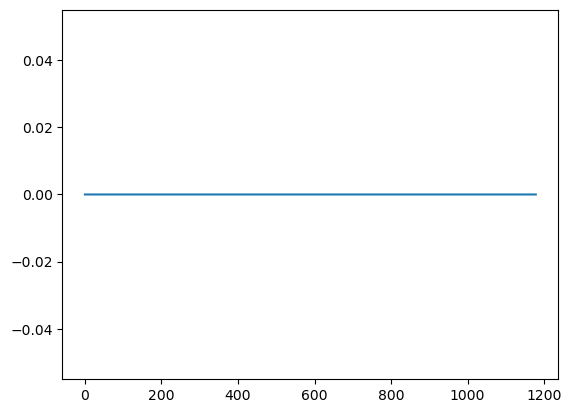

In [296]:
psm_wa['PSM Vault_annualized stability fee'].plot()

In [297]:
vault_wa = pd.merge(btc_wa, eth_wa, on=['day'], how='right')
vault_wa = vault_wa.merge(steth_wa, on=['day'], how='left')
vault_wa = vault_wa.merge(stablecoin_wa, on=['day'], how='left')
vault_wa = vault_wa.merge(altcoin_wa, on=['day'], how='left')
vault_wa = vault_wa.merge(lp_wa, on=['day'], how='left')
vault_wa = vault_wa.merge(rwa_wa, on=['day'], how='left')
vault_wa = vault_wa.merge(psm_wa, on=['day'], how='left')

vault_wa

,BTC Vault_safety_collateral_ratio,BTC Vault_liquidation_penalty,BTC Vault_liquidation_ratio,BTC Vault_annualized stability fee,BTC Vault_market_collateral_ratio,BTC Vault_market_price,day,ETH Vault_safety_collateral_ratio,ETH Vault_liquidation_penalty,ETH Vault_liquidation_ratio,...,RWA Vault_liquidation_ratio,RWA Vault_annualized stability fee,RWA Vault_market_collateral_ratio,RWA Vault_market_price,PSM Vault_safety_collateral_ratio,PSM Vault_liquidation_penalty,PSM Vault_liquidation_ratio,PSM Vault_annualized stability fee,PSM Vault_market_collateral_ratio,PSM Vault_market_price
0,NaN,NaN,NaN,NaN,NaN,NaN,2019-11-18 00:00:00+00:00,1.99867,0.00000,1.50000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,2019-11-19 00:00:00+00:00,2.05616,0.00000,1.50000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,2019-11-20 00:00:00+00:00,2.14036,0.00000,1.50000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,2019-11-21 00:00:00+00:00,1.91420,0.00000,1.50000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,2019-11-22 00:00:00+00:00,2.02427,0.00000,1.50000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1581,2.51175,0.13000,1.55184,0.16738,3.89162,"68,178.35601",2024-03-17 00:00:00+00:00,4.08693,0.13000,1.56135,...,1.00000,0.05012,3.43552,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000
1582,2.47718,0.13000,1.55065,0.16741,3.83432,"67,550.80000",2024-03-18 00:00:00+00:00,3.97679,0.13000,1.56142,...,1.00000,0.05012,3.16124,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000
1583,2.35993,0.13000,1.55252,0.16738,3.66257,"64,422.72070",2024-03-19 00:00:00+00:00,3.69944,0.13000,1.56117,...,1.00000,0.05012,3.18273,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000
1584,2.43846,0.13000,1.55219,0.16740,3.78103,"66,624.21792",2024-03-20 00:00:00+00:00,3.90588,0.13000,1.56201,...,1.00000,0.05012,3.18273,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000


In [298]:
vault_wa.fillna(0,inplace=True)

In [299]:
vault_wa.columns

Index(['BTC Vault_safety_collateral_ratio', 'BTC Vault_liquidation_penalty',
       'BTC Vault_liquidation_ratio', 'BTC Vault_annualized stability fee',
       'BTC Vault_market_collateral_ratio', 'BTC Vault_market_price', 'day',
       'ETH Vault_safety_collateral_ratio', 'ETH Vault_liquidation_penalty',
       'ETH Vault_liquidation_ratio', 'ETH Vault_annualized stability fee',
       'ETH Vault_market_collateral_ratio', 'ETH Vault_market_price',
       'stETH Vault_safety_collateral_ratio',
       'stETH Vault_liquidation_penalty', 'stETH Vault_liquidation_ratio',
       'stETH Vault_annualized stability fee',
       'stETH Vault_market_collateral_ratio', 'stETH Vault_market_price',
       'Stablecoin Vault_safety_collateral_ratio',
       'Stablecoin Vault_liquidation_penalty',
       'Stablecoin Vault_liquidation_ratio',
       'Stablecoin Vault_annualized stability fee',
       'Stablecoin Vault_market_collateral_ratio',
       'Stablecoin Vault_market_price',
       'Altcoin Vau

In [300]:
vault_wa[[
    'BTC Vault_safety_collateral_ratio', 'ETH Vault_safety_collateral_ratio','stETH Vault_safety_collateral_ratio','Stablecoin Vault_safety_collateral_ratio',
    'Altcoin Vault_safety_collateral_ratio','LP Vault_safety_collateral_ratio','RWA Vault_safety_collateral_ratio','PSM Vault_safety_collateral_ratio'
    
]]

,BTC Vault_safety_collateral_ratio,ETH Vault_safety_collateral_ratio,stETH Vault_safety_collateral_ratio,Stablecoin Vault_safety_collateral_ratio,Altcoin Vault_safety_collateral_ratio,LP Vault_safety_collateral_ratio,RWA Vault_safety_collateral_ratio,PSM Vault_safety_collateral_ratio
0,0.00000,1.99867,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,0.00000,2.05616,0.00000,0.00000,1.68434,0.00000,0.00000,0.00000
2,0.00000,2.14036,0.00000,0.00000,1.57679,0.00000,0.00000,0.00000
3,0.00000,1.91420,0.00000,0.00000,1.51710,0.00000,0.00000,0.00000
4,0.00000,2.02427,0.00000,0.00000,1.72583,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...
1581,2.51175,4.08693,4.77352,0.00000,"2,179,729,679,336.60693",0.00000,3.43552,1.00000
1582,2.47718,3.97679,4.70263,0.00000,"2,179,729,679,336.60693",0.00000,3.16124,1.00000
1583,2.35993,3.69944,4.54474,0.00000,"2,179,729,679,336.60693",0.00000,3.18273,1.00000
1584,2.43846,3.90588,4.97435,0.00000,"2,179,729,679,336.60693",0.00000,3.18273,1.00000


In [301]:
stablecoin_wa.set_index('day', inplace=True)

In [302]:
lp_wa

,LP Vault_safety_collateral_ratio,LP Vault_liquidation_penalty,LP Vault_liquidation_ratio,LP Vault_annualized stability fee,LP Vault_market_collateral_ratio,LP Vault_market_price,day
0,1.57944,0.00000,1.25000,0.01000,1.97430,60.35039,2020-12-21 00:00:00+00:00
1,1.41384,0.00000,1.25000,0.01000,1.76730,61.16495,2020-12-22 00:00:00+00:00
2,1.37488,0.00000,1.25000,0.01000,1.71860,60.13836,2020-12-23 00:00:00+00:00
3,1.35972,0.00000,1.25000,0.01000,1.69965,59.59939,2020-12-24 00:00:00+00:00
4,1.40850,0.00000,1.25000,0.01000,1.76063,60.91105,2020-12-25 00:00:00+00:00
...,...,...,...,...,...,...,...
935,1.54943,-1.00000,1.55000,0.04240,2.40162,"2,060.27428",2023-07-14 00:00:00+00:00
936,1.55678,-1.00000,1.55000,0.04240,2.41300,"2,078.91140",2023-07-15 00:00:00+00:00
937,1.55050,-1.00000,1.55000,0.04240,2.40328,"2,078.28033",2023-07-16 00:00:00+00:00
938,1.51440,-1.00000,1.55000,0.04240,2.34733,"2,029.89451",2023-07-17 00:00:00+00:00


In [303]:
stablecoin_wa.ffill()

,Stablecoin Vault_safety_collateral_ratio,Stablecoin Vault_liquidation_penalty,Stablecoin Vault_liquidation_ratio,Stablecoin Vault_annualized stability fee,Stablecoin Vault_market_collateral_ratio,Stablecoin Vault_market_price
day,,,,,,
2020-03-17 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN
2020-03-18 00:00:00+00:00,1.19237,0.00000,1.25000,0.20000,1.49046,1.00000
2020-03-19 00:00:00+00:00,1.16692,0.00000,1.25000,0.20000,1.45865,1.00000
2020-03-20 00:00:00+00:00,1.25095,0.00000,1.25000,0.20000,1.56368,1.00000
2020-03-21 00:00:00+00:00,1.25076,0.00000,1.25000,0.20000,1.56345,1.00000
...,...,...,...,...,...,...
2022-01-20 00:00:00+00:00,1.09052,0.13000,1.01000,0.01000,1.10143,1.00000
2022-01-21 00:00:00+00:00,1.09052,0.13000,1.01000,0.01000,1.10143,1.00000
2022-01-22 00:00:00+00:00,1.09739,0.13000,1.01000,0.01000,1.10837,1.00000


In [304]:
vault_wa['day']

0      2019-11-18 00:00:00+00:00
1      2019-11-19 00:00:00+00:00
2      2019-11-20 00:00:00+00:00
3      2019-11-21 00:00:00+00:00
4      2019-11-22 00:00:00+00:00
                  ...           
1581   2024-03-17 00:00:00+00:00
1582   2024-03-18 00:00:00+00:00
1583   2024-03-19 00:00:00+00:00
1584   2024-03-20 00:00:00+00:00
1585   2024-03-21 00:00:00+00:00
Name: day, Length: 1586, dtype: datetime64[ns, UTC]

In [305]:
vault_wa[['day','BTC Vault_market_price','ETH Vault_market_price','stETH Vault_market_price','Stablecoin Vault_market_price'
                  ,'Altcoin Vault_market_price','LP Vault_market_price','RWA Vault_market_price','PSM Vault_market_price']]

,day,BTC Vault_market_price,ETH Vault_market_price,stETH Vault_market_price,Stablecoin Vault_market_price,Altcoin Vault_market_price,LP Vault_market_price,RWA Vault_market_price,PSM Vault_market_price
0,2019-11-18 00:00:00+00:00,0.00000,177.58000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-19 00:00:00+00:00,0.00000,173.77500,0.00000,0.00000,0.24809,0.00000,0.00000,0.00000
2,2019-11-20 00:00:00+00:00,0.00000,174.32500,0.00000,0.00000,0.23422,0.00000,0.00000,0.00000
3,2019-11-21 00:00:00+00:00,0.00000,159.78765,0.00000,0.00000,0.22013,0.00000,0.00000,0.00000
4,2019-11-22 00:00:00+00:00,0.00000,152.65526,0.00000,0.00000,0.22333,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...
1581,2024-03-17 00:00:00+00:00,"68,178.35601","3,630.80000","4,200.86259",0.00000,0.37237,0.00000,"92,074,437.99635",1.00000
1582,2024-03-18 00:00:00+00:00,"67,550.80000","3,537.74675","4,086.74116",0.00000,0.37237,0.00000,"92,074,437.99635",1.00000
1583,2024-03-19 00:00:00+00:00,"64,422.72070","3,280.75000","3,791.39523",0.00000,0.37237,0.00000,"92,074,437.99635",1.00000
1584,2024-03-20 00:00:00+00:00,"66,624.21792","3,484.02500","3,966.09319",0.00000,0.37237,0.00000,"92,074,437.99635",1.00000


In [306]:
aggregated_vaults['day']

0      2019-11-01 00:00:00+00:00
1      2019-11-02 00:00:00+00:00
2      2019-11-03 00:00:00+00:00
3      2019-11-04 00:00:00+00:00
4      2019-11-05 00:00:00+00:00
                  ...           
1598   2024-03-17 00:00:00+00:00
1599   2024-03-18 00:00:00+00:00
1600   2024-03-19 00:00:00+00:00
1601   2024-03-20 00:00:00+00:00
1602   2024-03-21 00:00:00+00:00
Name: day, Length: 1603, dtype: datetime64[ns, UTC]

In [307]:
aggregated_vaults = aggregated_vaults.merge(vault_wa, on=['day'],how='inner')
list(aggregated_vaults.columns)

['day',
 'BTC Vault_dai_ceiling',
 'BTC Vault_dai_floor',
 'BTC Vault_debt_balance',
 'BTC Vault_daily_revenues',
 'BTC Vault_annualized_revenues',
 'BTC Vault_dart',
 'BTC Vault_prev_dai_ceiling',
 'BTC Vault_collateral_usd',
 'BTC Vault_hypothetical_dai_ceiling',
 'ETH Vault_dai_ceiling',
 'ETH Vault_dai_floor',
 'ETH Vault_debt_balance',
 'ETH Vault_daily_revenues',
 'ETH Vault_annualized_revenues',
 'ETH Vault_dart',
 'ETH Vault_prev_dai_ceiling',
 'ETH Vault_collateral_usd',
 'ETH Vault_hypothetical_dai_ceiling',
 'stETH Vault_dai_ceiling',
 'stETH Vault_dai_floor',
 'stETH Vault_debt_balance',
 'stETH Vault_daily_revenues',
 'stETH Vault_annualized_revenues',
 'stETH Vault_dart',
 'stETH Vault_prev_dai_ceiling',
 'stETH Vault_collateral_usd',
 'stETH Vault_hypothetical_dai_ceiling',
 'Stablecoin Vault_dai_ceiling',
 'Stablecoin Vault_dai_floor',
 'Stablecoin Vault_debt_balance',
 'Stablecoin Vault_daily_revenues',
 'Stablecoin Vault_annualized_revenues',
 'Stablecoin Vault_dart',

In [308]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,RWA Vault_liquidation_ratio,RWA Vault_annualized stability fee,RWA Vault_market_collateral_ratio,RWA Vault_market_price,PSM Vault_safety_collateral_ratio,PSM Vault_liquidation_penalty,PSM Vault_liquidation_ratio,PSM Vault_annualized stability fee,PSM Vault_market_collateral_ratio,PSM Vault_market_price
0,2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1581,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,1.00000,0.05012,3.43552,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000
1582,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,1.00000,0.05012,3.16124,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000
1583,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,1.00000,0.05012,3.18273,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000
1584,2024-03-20 00:00:00+00:00,"220,309,779.92933","51,000.00000","186,448,110.19433","121,966.07844","31,291,164.53273","186,448,110.19433","220,631,595.82640","689,743,944.46674","535,947,779.06571",...,1.00000,0.05012,3.18273,"92,074,437.99635",1.00000,0.13000,1.00000,0.00000,1.00000,1.00000


In [309]:
# Calculate the number of null values in each column
null_counts = aggregated_vaults.isna().sum()

# Display the number of nulls for each column
print(null_counts)


day                                   0
BTC Vault_dai_ceiling                 0
BTC Vault_dai_floor                   0
BTC Vault_debt_balance                0
BTC Vault_daily_revenues              0
                                     ..
PSM Vault_liquidation_penalty         0
PSM Vault_liquidation_ratio           0
PSM Vault_annualized stability fee    0
PSM Vault_market_collateral_ratio     0
PSM Vault_market_price                0
Length: 130, dtype: int64


In [310]:
# Display only those columns that have null values
null_columns = null_counts[null_counts > 0]
print(null_columns)


Series([], dtype: int64)


In [311]:
aggregated_vaults.isna().sum().sum()

0

In [312]:
no_nan_vaults = comprehensive_vault_stats.copy()
no_nan_vaults = no_nan_vaults.fillna(0)

In [313]:
no_nan_vaults.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [314]:
comprehensive_vault_stats.shape[0]

89768

In [315]:
comprehensive_vault_stats['safety_collateral_ratio'].describe()

count                    89,768.00000
mean        229,885,099,810,738.75000
std       8,373,076,821,567,564.00000
min                           0.00000
25%                           0.00000
50%                           0.00000
75%                           1.49470
max     308,852,816,242,278,400.00000
Name: safety_collateral_ratio, dtype: float64

In [316]:
comprehensive_vault_stats.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [317]:
comprehensive_vault_stats[comprehensive_vault_stats['ilk']=='ETH-A']

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,hypothetical_dai_ceiling,total_open_ilk_count,BTC Vault,ETH Vault,stETH Vault,Stablecoin Vault,Altcoin Vault,LP Vault,RWA Vault,PSM Vault
55,2019-11-01 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,True,False,False,False,False,False,False
110,2019-11-02 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,True,False,False,False,False,False,False
162,2019-11-03 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,True,False,False,False,False,False,False
193,2019-11-04 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,True,False,False,False,False,False,False
245,2019-11-05 00:00:00+00:00,0.00000,ETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,True,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89516,2024-03-17 00:00:00+00:00,"444,063.06945",ETH-A,"2,504.00000","1,111,933,925.89146","428,458,674.37487","7,500.00000",4.50630,"3,630.80000","246,751,192.26092",...,"1,168,920,539.59339",20,False,True,False,False,False,False,False,False
89544,2024-03-18 00:00:00+00:00,"443,694.77113",ETH-A,"2,439.82534","1,082,537,747.08583","428,458,674.37487","7,500.00000",4.37918,"3,537.74675","247,201,188.45861",...,"1,138,017,806.62398",20,False,True,False,False,False,False,False,False
89612,2024-03-19 00:00:00+00:00,"442,822.49879",ETH-A,"2,262.58621","1,001,924,077.87601","428,458,674.37487","7,500.00000",4.08200,"3,280.75000","245,449,240.76560",...,"1,053,272,686.86716",20,False,True,False,False,False,False,False,False
89691,2024-03-20 00:00:00+00:00,"444,855.53146",ETH-A,"2,402.77586","1,068,888,133.10945","428,458,674.37487","7,500.00000",4.35423,"3,484.02500","245,482,433.73907",...,"1,123,668,649.93131",20,False,True,False,False,False,False,False,False


In [318]:
no_nan_vaults[no_nan_vaults['ilk']=='WSTETH-A'].head()

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,hypothetical_dai_ceiling,total_open_ilk_count,BTC Vault,ETH Vault,stETH Vault,Stablecoin Vault,Altcoin Vault,LP Vault,RWA Vault,PSM Vault
20,2019-11-01 00:00:00+00:00,0.00000,WSTETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False
82,2019-11-02 00:00:00+00:00,0.00000,WSTETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False
138,2019-11-03 00:00:00+00:00,0.00000,WSTETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False
192,2019-11-04 00:00:00+00:00,0.00000,WSTETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False
259,2019-11-05 00:00:00+00:00,0.00000,WSTETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False


In [319]:
top_10_ilks = top_10_vaults.index.tolist()

In [320]:
top_10_ilks

['ETH-A',
 'WBTC-A',
 'WSTETH-A',
 'ETH-C',
 'ETH-B',
 'WSTETH-B',
 'USDC-A',
 'RWA013-A',
 'WBTC-C',
 'RWA012-A']

In [321]:
no_nan_vaults.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [322]:
topvaults = no_nan_vaults[no_nan_vaults['ilk'].isin(top_10_ilks)]

In [323]:
topvaults

,day,cumulative_collateral,ilk,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,...,hypothetical_dai_ceiling,total_open_ilk_count,BTC Vault,ETH Vault,stETH Vault,Stablecoin Vault,Altcoin Vault,LP Vault,RWA Vault,PSM Vault
7,2019-11-01 00:00:00+00:00,0.00000,WSTETH-B,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False
8,2019-11-01 00:00:00+00:00,0.00000,USDC-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,False,True,False,False,False,False
13,2019-11-01 00:00:00+00:00,0.00000,RWA013-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,False,False,False,False,True,False
14,2019-11-01 00:00:00+00:00,0.00000,RWA012-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,False,False,False,False,True,False
20,2019-11-01 00:00:00+00:00,0.00000,WSTETH-A,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0,False,False,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89723,2024-03-21 00:00:00+00:00,1.00000,RWA013-A,"85,165,703.00000","85,165,703.00000","70,000,000.00000",0.00000,1.42191,"85,165,703.00000","59,895,383.48177",...,"42,582,851.50000",20,False,False,False,False,False,False,True,False
89724,2024-03-21 00:00:00+00:00,"93,153.01725",USDC-A,0.06667,"6,210.20115",0.00000,"15,000.00000",0.00000,1.00000,0.00000,...,"698,647.62934",20,False,False,False,True,False,False,False,False
89736,2024-03-21 00:00:00+00:00,"525,634.66534",ETH-C,"2,054.81176","1,080,080,294.26988","431,463,554.35472","3,500.00000",3.64855,"3,493.18000","296,029,738.08301",...,"1,560,716,025.21998",20,False,True,False,False,False,False,False,False
89737,2024-03-21 00:00:00+00:00,"90,555.56461",ETH-B,"2,631.42620","238,290,285.16921","107,330,789.63677","25,000.00000",2.97297,"3,420.85406","80,152,355.76044",...,"201,355,290.96798",20,False,True,False,False,False,False,False,False


In [324]:
wbtc_a_vault = no_nan_vaults[no_nan_vaults['ilk']=='WBTC-A']
eth_a_vault = no_nan_vaults[no_nan_vaults['ilk']=='ETH-A']
wsteth_a_vault = no_nan_vaults[no_nan_vaults['ilk']=='WSTETH-A']
eth_c_vault = no_nan_vaults[no_nan_vaults['ilk']=='ETH-C']
eth_b_vault = no_nan_vaults[no_nan_vaults['ilk']=='ETH-B']

<Axes: >

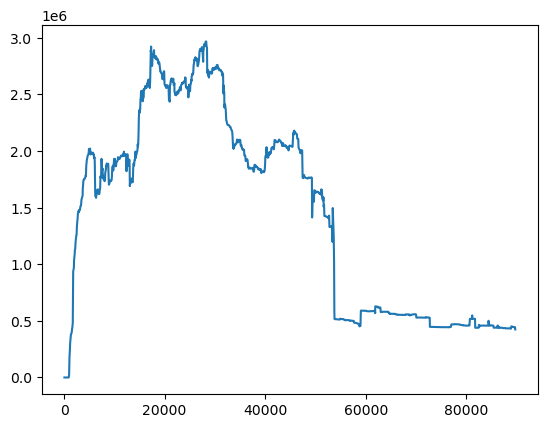

In [325]:
eth_a_vault['cumulative_collateral'].plot()

<Axes: >

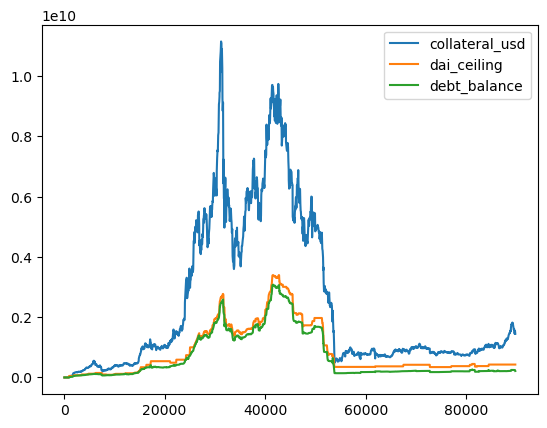

In [326]:
eth_a_vault[['collateral_usd','dai_ceiling','debt_balance']].plot()

<Axes: >

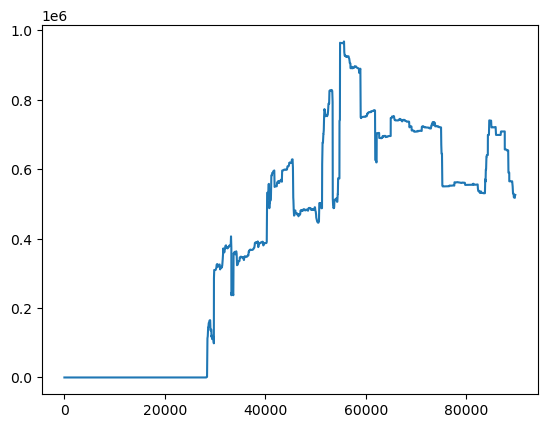

In [327]:
eth_c_vault['cumulative_collateral'].plot()

<Axes: >

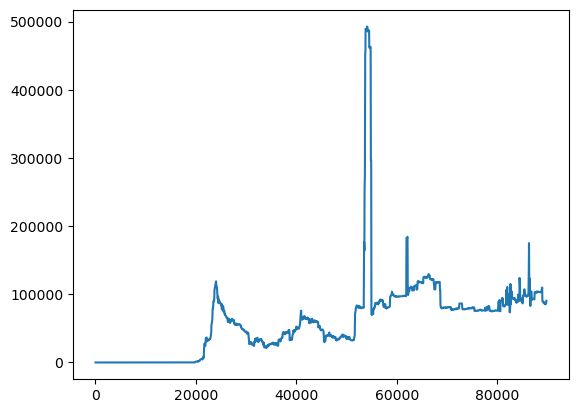

In [328]:
eth_b_vault['cumulative_collateral'].plot()

In [329]:
#We start with eth-a vault, which has long history and has generated most revenues 
eth_a_vault.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [330]:
eth_a_vault.describe()

,cumulative_collateral,safety_price,usd_safety_value,dai_ceiling,dai_floor,safety_collateral_ratio,market_price,debt_balance,liquidation_penalty,liquidation_ratio,daily_revenues,annualized stability fee,annualized_revenues,dart,total_ann_revenues,prev_dai_ceiling,market_collateral_ratio,collateral_usd,hypothetical_dai_ceiling,total_open_ilk_count
count,"1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000","1,603.00000"
mean,"1,431,358.58268","1,170.35587","1,643,344,705.72294","839,818,278.08597","7,315.58328",2.64130,"1,710.00689","679,839,916.32430",0.06720,1.45486,"68,713.83811",0.02911,"20,705,027.86609","679,963,872.24119","50,971,731.95699","839,550,992.57482",3.87790,"2,414,732,643.97386","1,774,592,580.07170",21.41547
std,"875,076.03958",783.10633,"1,751,111,490.79595","831,524,706.16147","5,707.35417",0.63518,"1,139.35422","784,159,835.66063",0.15483,0.15264,"97,104.29715",0.02211,"27,665,418.19606","784,353,984.31496","53,498,692.61189","831,725,853.83832",0.90511,"2,570,177,756.57576","1,887,643,578.23716",9.68065
min,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,-1.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
25%,"515,953.63795",391.94359,"520,227,309.31102","350,558,569.73245",500.00000,2.22632,587.91538,"178,630,954.93626",0.00000,1.45000,"10,190.40728",0.01500,"3,023,519.22749","178,630,954.93626","12,293,580.41515","350,558,569.73245",3.29691,"754,682,979.32255","547,328,955.58899",18.00000
50%,"1,658,770.72518","1,162.42414","668,125,081.92814","421,276,896.85485","7,500.00000",2.55973,"1,694.91500","214,983,480.53441",0.13000,1.45000,"25,778.33914",0.02250,"7,510,695.67566","214,983,480.53441","35,141,262.35758","421,276,896.85485",3.75353,"983,858,309.60357","722,294,065.19664",26.00000
75%,"2,064,879.63562","1,607.45759","3,074,214,334.45518","1,478,421,532.62812","15,000.00000",3.03136,"2,355.83000","1,331,895,332.19358",0.13000,1.50000,"106,317.33340",0.04000,"33,104,565.40703","1,331,895,332.19358","73,068,202.79115","1,478,421,532.62812",4.41807,"4,533,517,705.99147","3,370,126,682.53923",29.00000
max,"2,966,468.33510","3,298.34483","7,428,423,394.60300","3,395,556,201.44285","15,000.00000",5.26541,"4,782.60000","3,077,919,054.98573",0.13000,1.50000,"1,475,897.04401",0.15250,"142,209,506.83116","3,077,919,054.98573","351,700,458.60804","3,395,556,201.44285",7.63485,"11,142,635,091.90450","8,356,976,318.92837",33.00000


In [331]:
eth_a_vault.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault'],
      dtype='object')

In [332]:
def calculate_moving_averages(df, columns, windows=[7, 30, 90]):
    """
    Applies moving averages to specified columns of a DataFrame.

    Parameters:
    - df: pandas.DataFrame, the DataFrame containing the data.
    - columns: list, column names to apply the moving averages.
    - windows: list of integers, the window sizes for the moving averages.

    Returns:
    - df: pandas.DataFrame, the DataFrame with new columns for moving averages.
    """
    for window in windows:
        for column in columns:
            ma_column_name = f'{column}_{window}d_ma'
            df[ma_column_name] = df[column].rolling(window=window).mean()
    return df

In [333]:
eth_a_vault = calculate_moving_averages(eth_a_vault,['market_price','cumulative_collateral','collateral_usd','debt_balance','safety_collateral_ratio','market_collateral_ratio','daily_revenues','annualized stability fee'])
eth_b_vault = calculate_moving_averages(eth_b_vault,['market_price','cumulative_collateral','collateral_usd','debt_balance','safety_collateral_ratio','market_collateral_ratio','daily_revenues','annualized stability fee'])
wbtc_a_vault = calculate_moving_averages(wbtc_a_vault,['market_price','cumulative_collateral','collateral_usd','debt_balance','safety_collateral_ratio','market_collateral_ratio','daily_revenues','annualized stability fee'])
wsteth_a_vault = calculate_moving_averages(wsteth_a_vault,['market_price','cumulative_collateral','collateral_usd','debt_balance','safety_collateral_ratio','market_collateral_ratio','daily_revenues','annualized stability fee'])
eth_c_vault = calculate_moving_averages(eth_c_vault,['market_price','cumulative_collateral','collateral_usd','debt_balance','safety_collateral_ratio','market_collateral_ratio','daily_revenues','annualized stability fee'])

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3516753920.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[ma_column_name] = df[column].rolling(window=window).mean()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3516753920.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[ma_column_name] = df[column].rolling(window=window).mean()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3516753920.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice 

In [334]:
aggregated_vaults = calculate_moving_averages(aggregated_vaults, aggregated_vaults.drop(columns=['day']).columns)

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3516753920.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[ma_column_name] = df[column].rolling(window=window).mean()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3516753920.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[ma_column_name] = df[column].rolling(window=window).mean()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3516753920.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `fram

In [335]:
aggregated_vaults.columns

Index(['day', 'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor',
       'BTC Vault_debt_balance', 'BTC Vault_daily_revenues',
       'BTC Vault_annualized_revenues', 'BTC Vault_dart',
       'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd',
       'BTC Vault_hypothetical_dai_ceiling',
       ...
       'RWA Vault_liquidation_ratio_90d_ma',
       'RWA Vault_annualized stability fee_90d_ma',
       'RWA Vault_market_collateral_ratio_90d_ma',
       'RWA Vault_market_price_90d_ma',
       'PSM Vault_safety_collateral_ratio_90d_ma',
       'PSM Vault_liquidation_penalty_90d_ma',
       'PSM Vault_liquidation_ratio_90d_ma',
       'PSM Vault_annualized stability fee_90d_ma',
       'PSM Vault_market_collateral_ratio_90d_ma',
       'PSM Vault_market_price_90d_ma'],
      dtype='object', length=517)

In [336]:
eth_a_vault.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault', 'market_price_7d_ma', 'cumulative_collateral_7d_ma',
       'collateral_usd_7d_ma', 'debt_balance_7d_ma',
       'safety_collateral_ratio_7d_ma', 'market_collateral_ratio_7d_ma',
       'daily_revenues_7d_ma', 'annualized stability fee_7d_ma',
       'market_price_30d_ma', 'cumulative_collateral_30d_ma',
       'collateral_usd_30d_ma', 'debt_balance_30d_ma',
       'safety_collat

#7 day MA
eth_a_vault['market_price_7d_ma'] = eth_a_vault['market_price'].rolling(window=7).mean()
eth_a_vault['collateral_usd_7d_ma'] = eth_a_vault['collateral_usd'].rolling(window=7).mean()
eth_a_vault['debt_balance_7d_ma'] = eth_a_vault['debt_balance'].rolling(window=7).mean()
eth_a_vault['safety_collateral_ratio_7d_ma'] = eth_a_vault['safety_collateral_ratio'].rolling(window=7).mean()
eth_a_vault['market_collateral_ratio_7d_ma'] = eth_a_vault['market_collateral_ratio'].rolling(window=7).mean()
eth_a_vault['daily_revenues_7d_ma'] = eth_a_vault['daily_revenues'].rolling(window=7).mean()

# Calculate 30-day moving averages
eth_a_vault['market_price_30d_ma'] = eth_a_vault['market_price'].rolling(window=30).mean()
eth_a_vault['collateral_usd_30d_ma'] = eth_a_vault['collateral_usd'].rolling(window=30).mean()
eth_a_vault['debt_balance_30d_ma'] = eth_a_vault['debt_balance'].rolling(window=30).mean()
eth_a_vault['cumulative_collateral_30d_ma'] = eth_a_vault['cumulative_collateral'].rolling(window=30).mean()
eth_a_vault['safety_collateral_ratio_30d_ma'] = eth_a_vault['safety_collateral_ratio'].rolling(window=30).mean()
eth_a_vault['market_collateral_ratio_30d_ma'] = eth_a_vault['market_collateral_ratio'].rolling(window=30).mean()
eth_a_vault['daily_revenues_30d_ma'] = eth_a_vault['daily_revenues'].rolling(window=30).mean()

#calculate 90 day ma stability fee
eth_a_vault['annualized stability fee_90d_ma'] = eth_a_vault['annualized stability fee'].rolling(window=90).mean()

# Display the head of the DataFrame to verify the new columns
print(eth_a_vault[['market_price', 'market_price_7d_ma', 'market_price_30d_ma', 
                   'collateral_usd', 'collateral_usd_7d_ma', 'collateral_usd_30d_ma',
                   'debt_balance', 'debt_balance_7d_ma', 'debt_balance_30d_ma']].tail())

## Individual vault engingeering

In [337]:
eth_a_vault['status']

55       Closed
110      Closed
162      Closed
193      Closed
245      Closed
          ...  
89516      Open
89544      Open
89612      Open
89691      Open
89754      Open
Name: status, Length: 1603, dtype: object

In [338]:
def enhance_features(df, columns):
    """
    Enhances a DataFrame by calculating percent changes, rolling volatility, and lags for specified columns.

    Parameters:
    - df: pandas.DataFrame, the DataFrame containing the data.
    - columns: list, column names to apply the transformations.

    Returns:
    - df: pandas.DataFrame, the DataFrame with new columns for percent changes, volatility, and lags.
    """
    # Calculate percent change for selected columns
    for column in columns:
        pct_change_col = f'{column}_pct_change'
        df[pct_change_col] = df[column].pct_change()

    # Calculate volatility (standard deviation) of the percent changes over a 7-day rolling window
    for column in columns:
        pct_change_col = f'{column}_pct_change'
        volatility_col = f'{pct_change_col}_volatility_7d'
        df[volatility_col] = df[pct_change_col].rolling(window=7).std()

    # Calculate lag for selected columns (30-day lag as an example)
    for column in columns:
        lag_col = f'{column}_lag30'
        df[lag_col] = df[column].shift(30)

    return df

In [339]:
columns_to_enhance = ['debt_balance', 'cumulative_collateral', 
               'safety_price', 'safety_collateral_ratio', 
               'market_collateral_ratio','annualized stability fee','daily_revenues']

eth_a_vault = enhance_features(eth_a_vault, columns_to_enhance)
eth_b_vault = enhance_features(eth_b_vault, columns_to_enhance)
wbtc_a_vault = enhance_features(wbtc_a_vault, columns_to_enhance)
wsteth_a_vault = enhance_features(wsteth_a_vault, columns_to_enhance)
eth_c_vault = enhance_features(eth_c_vault, columns_to_enhance)

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2697348153.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[pct_change_col] = df[column].pct_change()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2697348153.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[pct_change_col] = df[column].pct_change()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2697348153.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[r

In [340]:
aggregated_vaults = enhance_features(aggregated_vaults, aggregated_vaults.drop(columns=['day']).columns)

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2697348153.py:15: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[pct_change_col] = df[column].pct_change()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2697348153.py:15: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[pct_change_col] = df[column].pct_change()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2697348153.py:15: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has po

In [341]:
eth_a_vault.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault', 'market_price_7d_ma', 'cumulative_collateral_7d_ma',
       'collateral_usd_7d_ma', 'debt_balance_7d_ma',
       'safety_collateral_ratio_7d_ma', 'market_collateral_ratio_7d_ma',
       'daily_revenues_7d_ma', 'annualized stability fee_7d_ma',
       'market_price_30d_ma', 'cumulative_collateral_30d_ma',
       'collateral_usd_30d_ma', 'debt_balance_30d_ma',
       'safety_collat

In [342]:
aggregated_vaults.columns

Index(['day', 'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor',
       'BTC Vault_debt_balance', 'BTC Vault_daily_revenues',
       'BTC Vault_annualized_revenues', 'BTC Vault_dart',
       'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd',
       'BTC Vault_hypothetical_dai_ceiling',
       ...
       'RWA Vault_liquidation_ratio_90d_ma_lag30',
       'RWA Vault_annualized stability fee_90d_ma_lag30',
       'RWA Vault_market_collateral_ratio_90d_ma_lag30',
       'RWA Vault_market_price_90d_ma_lag30',
       'PSM Vault_safety_collateral_ratio_90d_ma_lag30',
       'PSM Vault_liquidation_penalty_90d_ma_lag30',
       'PSM Vault_liquidation_ratio_90d_ma_lag30',
       'PSM Vault_annualized stability fee_90d_ma_lag30',
       'PSM Vault_market_collateral_ratio_90d_ma_lag30',
       'PSM Vault_market_price_90d_ma_lag30'],
      dtype='object', length=2065)

In [343]:
eth_b_vault.columns

Index(['day', 'cumulative_collateral', 'ilk', 'safety_price',
       'usd_safety_value', 'dai_ceiling', 'dai_floor',
       'safety_collateral_ratio', 'market_price', 'debt_balance',
       'liquidation_penalty', 'liquidation_ratio', 'daily_revenues',
       'annualized stability fee', 'annualized_revenues', 'dart',
       'total_ann_revenues', 'prev_dai_ceiling', 'status',
       'market_collateral_ratio', 'collateral_usd', 'hypothetical_dai_ceiling',
       'total_open_ilk_count', 'BTC Vault', 'ETH Vault', 'stETH Vault',
       'Stablecoin Vault', 'Altcoin Vault', 'LP Vault', 'RWA Vault',
       'PSM Vault', 'market_price_7d_ma', 'cumulative_collateral_7d_ma',
       'collateral_usd_7d_ma', 'debt_balance_7d_ma',
       'safety_collateral_ratio_7d_ma', 'market_collateral_ratio_7d_ma',
       'daily_revenues_7d_ma', 'annualized stability fee_7d_ma',
       'market_price_30d_ma', 'cumulative_collateral_30d_ma',
       'collateral_usd_30d_ma', 'debt_balance_30d_ma',
       'safety_collat

In [344]:
# Calculate percent change for selected columns
for column in ['debt_balance', 'cumulative_collateral', 
               'safety_price', 'safety_collateral_ratio', 
               'market_collateral_ratio','annualized stability fee','daily_revenues']:
    eth_a_vault[f'{column}_pct_change'] = eth_a_vault[column].pct_change()

# Calculate volatility (standard deviation) of the percent changes over a 7-day rolling window
for column in ['debt_balance_pct_change', 'cumulative_collateral_pct_change', 
               'safety_price_pct_change', 'safety_collateral_ratio_pct_change', 
               'market_collateral_ratio_pct_change','annualized stability fee_pct_change','daily_revenues_pct_change']:
    eth_a_vault[f'{column}_volatility_7d'] = eth_a_vault[column].rolling(window=7).std()

# Calculate lag for selected columns (1-day lag as an example)
for column in ['debt_balance', 'cumulative_collateral', 
               'safety_price', 'safety_collateral_ratio', 
               'market_collateral_ratio','annualized stability fee','daily_revenues']:
    eth_a_vault[f'{column}_lag30'] = eth_a_vault[column].shift(30)


C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\1500168907.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eth_a_vault[f'{column}_pct_change'] = eth_a_vault[column].pct_change()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\1500168907.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eth_a_vault[f'{column}_volatility_7d'] = eth_a_vault[column].rolling(window=7).std()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\1500168907.py:17: SettingWithCopyWarning: 
A value is trying 

In [345]:
eth_a_vault['status']

55       Closed
110      Closed
162      Closed
193      Closed
245      Closed
          ...  
89516      Open
89544      Open
89612      Open
89691      Open
89754      Open
Name: status, Length: 1603, dtype: object

In [346]:
eth_a_vault.columns = [f'eth_a_vault_{col}' if col != 'period' and not col.startswith('day') else col for col in eth_a_vault.columns]
eth_b_vault.columns = [f'eth_b_vault_{col}' if col != 'period' and not col.startswith('day') else col for col in eth_b_vault.columns]
wbtc_a_vault.columns = [f'wbtc_a_vault_{col}' if col != 'period' and not col.startswith('day') else col for col in wbtc_a_vault.columns]
wsteth_a_vault.columns = [f'wsteth_a_vault_{col}' if col != 'period' and not col.startswith('day') else col for col in wsteth_a_vault.columns]
eth_c_vault.columns = [f'eth_c_vault_{col}' if col != 'period' and not col.startswith('day') else col for col in eth_c_vault.columns]

In [347]:
eth_a_vault['eth_a_vault_status']

55       Closed
110      Closed
162      Closed
193      Closed
245      Closed
          ...  
89516      Open
89544      Open
89612      Open
89691      Open
89754      Open
Name: eth_a_vault_status, Length: 1603, dtype: object

In [348]:
eth_a_vault.set_index('day', inplace=True)
eth_b_vault.set_index('day', inplace=True)
wbtc_a_vault.set_index('day', inplace=True)
wsteth_a_vault.set_index('day', inplace=True)
eth_c_vault.set_index('day', inplace=True)
eth_a_vault = eth_a_vault.drop(columns=['eth_a_vault_ilk'])
eth_b_vault = eth_b_vault.drop(columns=['eth_b_vault_ilk'])
wbtc_a_vault = wbtc_a_vault.drop(columns=['wbtc_a_vault_ilk'])
wsteth_a_vault = wsteth_a_vault.drop(columns=['wsteth_a_vault_ilk'])
eth_c_vault = eth_c_vault.drop(columns=['eth_c_vault_ilk'])

In [349]:
aggregated_vaults = localize_or_convert(aggregated_vaults, 'day')
aggregated_vaults.set_index('day', inplace=True)

In [350]:
eth_a_vault.columns

Index(['eth_a_vault_cumulative_collateral', 'eth_a_vault_safety_price',
       'eth_a_vault_usd_safety_value', 'eth_a_vault_dai_ceiling',
       'eth_a_vault_dai_floor', 'eth_a_vault_safety_collateral_ratio',
       'eth_a_vault_market_price', 'eth_a_vault_debt_balance',
       'eth_a_vault_liquidation_penalty', 'eth_a_vault_liquidation_ratio',
       'eth_a_vault_daily_revenues', 'eth_a_vault_annualized stability fee',
       'eth_a_vault_annualized_revenues', 'eth_a_vault_dart',
       'eth_a_vault_total_ann_revenues', 'eth_a_vault_prev_dai_ceiling',
       'eth_a_vault_status', 'eth_a_vault_market_collateral_ratio',
       'eth_a_vault_collateral_usd', 'eth_a_vault_hypothetical_dai_ceiling',
       'eth_a_vault_total_open_ilk_count', 'eth_a_vault_BTC Vault',
       'eth_a_vault_ETH Vault', 'eth_a_vault_stETH Vault',
       'eth_a_vault_Stablecoin Vault', 'eth_a_vault_Altcoin Vault',
       'eth_a_vault_LP Vault', 'eth_a_vault_RWA Vault',
       'eth_a_vault_PSM Vault', 'eth_a_vault_

In [351]:
eth_a_vault = eth_a_vault.merge(eth_b_vault, left_index=True, right_index=True, how='left')
eth_a_vault = eth_a_vault.merge(wbtc_a_vault, left_index=True, right_index=True, how='left')
eth_a_vault = eth_a_vault.merge(wsteth_a_vault, left_index=True, right_index=True, how='left')
eth_a_vault = eth_a_vault.merge(eth_c_vault, left_index=True, right_index=True, how='left')

In [352]:
ethb_col = eth_b_vault.columns
wbtca_col = wbtc_a_vault.columns
wstetha_col = wsteth_a_vault.columns
ethc_col = eth_c_vault.columns

In [353]:
eth_a_vault[ethb_col] = eth_a_vault[ethb_col].fillna(0)
eth_a_vault[wbtca_col] = eth_a_vault[wbtca_col].fillna(0)
eth_a_vault[wstetha_col] = eth_a_vault[wstetha_col].fillna(0)
eth_a_vault[ethc_col] = eth_a_vault[ethc_col].fillna(0)

In [354]:
list(eth_a_vault.columns)

['eth_a_vault_cumulative_collateral',
 'eth_a_vault_safety_price',
 'eth_a_vault_usd_safety_value',
 'eth_a_vault_dai_ceiling',
 'eth_a_vault_dai_floor',
 'eth_a_vault_safety_collateral_ratio',
 'eth_a_vault_market_price',
 'eth_a_vault_debt_balance',
 'eth_a_vault_liquidation_penalty',
 'eth_a_vault_liquidation_ratio',
 'eth_a_vault_daily_revenues',
 'eth_a_vault_annualized stability fee',
 'eth_a_vault_annualized_revenues',
 'eth_a_vault_dart',
 'eth_a_vault_total_ann_revenues',
 'eth_a_vault_prev_dai_ceiling',
 'eth_a_vault_status',
 'eth_a_vault_market_collateral_ratio',
 'eth_a_vault_collateral_usd',
 'eth_a_vault_hypothetical_dai_ceiling',
 'eth_a_vault_total_open_ilk_count',
 'eth_a_vault_BTC Vault',
 'eth_a_vault_ETH Vault',
 'eth_a_vault_stETH Vault',
 'eth_a_vault_Stablecoin Vault',
 'eth_a_vault_Altcoin Vault',
 'eth_a_vault_LP Vault',
 'eth_a_vault_RWA Vault',
 'eth_a_vault_PSM Vault',
 'eth_a_vault_market_price_7d_ma',
 'eth_a_vault_cumulative_collateral_7d_ma',
 'eth_a_va

In [355]:
print(list(dai_maturity_df_reindexed['dai_maturity_outflow_surplus_buffer_1-block']))

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

In [356]:
print(list(dai_maturity_df_reindexed['dai_maturity_outflow_surplus_buffer_1-day']))

[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

In [357]:
dai_maturity_df_reindexed

,day,dai_maturity_outflow_1-block,dai_maturity_outflow_1-day,dai_maturity_outflow_1-month,dai_maturity_outflow_1-week,dai_maturity_outflow_1-year,dai_maturity_outflow_3-months,dai_maturity_outflow_dai_only_1-block,dai_maturity_outflow_dai_only_1-day,dai_maturity_outflow_dai_only_1-month,dai_maturity_outflow_dai_only_1-week,dai_maturity_outflow_dai_only_1-year,dai_maturity_outflow_dai_only_3-months,dai_maturity_outflow_surplus_buffer_1-block,dai_maturity_outflow_surplus_buffer_1-day,dai_maturity_outflow_surplus_buffer_1-month,dai_maturity_outflow_surplus_buffer_1-week,dai_maturity_outflow_surplus_buffer_1-year,dai_maturity_outflow_surplus_buffer_3-months
0,2019-11-13 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-14 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-15 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-16 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-17 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1585,2024-03-16 00:00:00+00:00,"453,757,132.16554","453,757,132.16554","136,277,964.29642","591,913,771.82219","2,850,066,310.39846","201,065,848.96193","453,757,132.16554","453,757,132.16554","136,277,964.29642","591,913,771.82219","2,781,519,501.85289","201,065,848.96193",0.00000,0.00000,0.00000,0.00000,"68,546,808.54557",0.00000
1586,2024-03-17 00:00:00+00:00,"455,307,007.69644","455,307,007.69644","137,425,908.65600","596,032,698.73347","2,849,349,624.77721","202,759,537.36131","455,307,007.69644","455,307,007.69644","137,425,908.65600","596,032,698.73347","2,780,461,988.11065","202,759,537.36131",0.00000,0.00000,0.00000,0.00000,"68,887,636.66657",0.00000
1587,2024-03-18 00:00:00+00:00,"461,095,932.80881","461,095,932.80881","140,439,203.62959","607,501,207.94779","2,863,252,281.52928","207,205,382.40431","461,095,932.80881","461,095,932.80881","140,439,203.62959","607,501,207.94779","2,796,227,598.03142","207,205,382.40431",0.00000,0.00000,0.00000,0.00000,"67,024,683.49786",0.00000
1588,2024-03-19 00:00:00+00:00,"455,524,838.31873","455,524,838.31873","137,117,144.95605","595,167,015.96846","2,854,314,452.32749","202,303,984.36139","455,524,838.31873","455,524,838.31873","137,117,144.95605","595,167,015.96846","2,787,586,179.25529","202,303,984.36139",0.00000,0.00000,0.00000,0.00000,"66,728,273.07220",0.00000


dai_maturity_outflow_surplus_buffer_1-block        nan
dai_maturity_outflow_surplus_buffer_1-day          nan
dai_maturity_outflow_surplus_buffer_1-month        nan
dai_maturity_outflow_surplus_buffer_1-week         nan
dai_maturity_outflow_surplus_buffer_3-months       nan
1 - PnL                                            nan
2 - Assets                                         nan
2.8 - Operating Reserves                           nan
3 - Liabilities & Equity                           nan
3.8 - Equity (Operating Reserves)                  nan

In [358]:
eth_a_vault = eth_a_vault.merge(dai_maturity_df_reindexed, on=['day'], how='inner')


In [359]:
aggregated_vaults = aggregated_vaults.merge(dai_maturity_df_reindexed, on=['day'], how='inner')

In [360]:
stable_coin_ratios.head()

,stablecoins_ratio,usdc_ratio
day,,
2024-03-21 00:00:00+00:00,0.10880,0.10865
2024-03-20 00:00:00+00:00,0.09675,0.09660
2024-03-19 00:00:00+00:00,0.08597,0.08582
2024-03-18 00:00:00+00:00,0.08430,0.08415
2024-03-17 00:00:00+00:00,0.13455,0.13440


In [361]:
#eth_a_vault = eth_a_vault.merge(stable_coin_ratios, on=['day'], how='inner')

In [362]:
eth_a_vault.head()

,day,eth_a_vault_cumulative_collateral,eth_a_vault_safety_price,eth_a_vault_usd_safety_value,eth_a_vault_dai_ceiling,eth_a_vault_dai_floor,eth_a_vault_safety_collateral_ratio,eth_a_vault_market_price,eth_a_vault_debt_balance,eth_a_vault_liquidation_penalty,...,dai_maturity_outflow_dai_only_1-month,dai_maturity_outflow_dai_only_1-week,dai_maturity_outflow_dai_only_1-year,dai_maturity_outflow_dai_only_3-months,dai_maturity_outflow_surplus_buffer_1-block,dai_maturity_outflow_surplus_buffer_1-day,dai_maturity_outflow_surplus_buffer_1-month,dai_maturity_outflow_surplus_buffer_1-week,dai_maturity_outflow_surplus_buffer_1-year,dai_maturity_outflow_surplus_buffer_3-months
0,2019-11-13 00:00:00+00:00,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-14 00:00:00+00:00,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-15 00:00:00+00:00,0.42000,119.74059,50.29105,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-16 00:00:00+00:00,0.42000,121.69333,51.11120,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-17 00:00:00+00:00,0.43000,123.31394,53.02499,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [363]:
start_date = eth_a_vault['day'].min()
end_date = eth_a_vault['day'].max()
date_range = pd.date_range(start=start_date, end=end_date)

psm_full_range_df = pd.DataFrame(index=date_range)



In [364]:
psm_full_range_df.head()

""
2019-11-13 00:00:00+00:00
2019-11-14 00:00:00+00:00
2019-11-15 00:00:00+00:00
2019-11-16 00:00:00+00:00
2019-11-17 00:00:00+00:00


In [365]:


psm_columns = ['psm_change', 'psm_change_excl_rwa', 'psm_change_excl_rwa_30d_avg', 'psm_change_excl_rwa_7d_avg', 'psm_fees', 'psm_inflow', 'psm_inflow_exl_rwa', 'psm_lifetime_fees', 'psm_lifetime_turnover', 'psm_outflow', 'psm_balance', 'psm_turnover']
for column in psm_columns:
    psm_full_range_df[column] = psm_stats_csv[column]

# Fill missing values with zeros
psm_full_range_df.fillna(0, inplace=True)

In [366]:
psm_stats_csv

,psm_change,psm_change_excl_rwa,psm_change_excl_rwa_30d_avg,psm_change_excl_rwa_7d_avg,psm_fees,psm_inflow,psm_inflow_exl_rwa,psm_lifetime_fees,psm_lifetime_turnover,psm_outflow,psm_balance,psm_turnover
day,,,,,,,,,,,,
2024-03-21 00:00:00+00:00,"59,125,692.01199","59,125,692.01199","-39,765,372.79715","15,853,783.28278",0.00000,"138,429,104.70462","138,429,104.70462","4,449,255.59143","100,329,058,375.20056","79,303,412.69263","510,492,745.87887","217,732,517.39725"
2024-03-20 00:00:00+00:00,"47,004,882.04850","47,004,882.04850","-43,689,564.71018","6,842,814.63474",0.00000,"114,637,705.11351","114,637,705.11351","4,449,255.59143","100,111,325,857.80330","67,632,823.06501","451,367,053.86688","182,270,528.17852"
2024-03-19 00:00:00+00:00,"4,430,852.15651","4,430,852.15651","-43,887,466.95750","-60,382,354.14689",0.00000,"191,755,292.35204","191,755,292.35204","4,449,255.59143","99,929,055,329.62476","187,324,440.19553","404,362,171.81837","379,079,732.54757"
2024-03-18 00:00:00+00:00,"-232,459,681.52437","-232,459,681.52437","-44,026,058.34381","-66,040,075.58503",0.00000,"144,111,445.81071","144,111,445.81071","4,449,255.59143","99,549,975,597.07719","376,571,127.33508","399,931,319.66186","520,682,573.14579"
2024-03-17 00:00:00+00:00,"64,591,276.21421","64,591,276.21421","-36,201,438.40599","-15,168,476.39546",0.00000,"85,172,448.88432","85,172,448.88432","4,449,255.59143","99,029,293,023.93140","20,581,172.67010","632,391,001.18623","105,753,621.55442"
...,...,...,...,...,...,...,...,...,...,...,...,...
2021-01-02 00:00:00+00:00,NaN,NaN,1.00000,1.00000,NaN,NaN,NaN,0.00854,1.00000,NaN,1.00000,NaN
2021-01-01 00:00:00+00:00,NaN,NaN,1.00000,1.00000,NaN,NaN,NaN,0.00854,1.00000,NaN,1.00000,NaN
2020-12-31 00:00:00+00:00,NaN,NaN,1.00000,1.00000,NaN,NaN,NaN,0.00854,1.00000,NaN,1.00000,NaN


In [367]:
eth_a_vault.describe()

,eth_a_vault_cumulative_collateral,eth_a_vault_safety_price,eth_a_vault_usd_safety_value,eth_a_vault_dai_ceiling,eth_a_vault_dai_floor,eth_a_vault_safety_collateral_ratio,eth_a_vault_market_price,eth_a_vault_debt_balance,eth_a_vault_liquidation_penalty,eth_a_vault_liquidation_ratio,...,dai_maturity_outflow_dai_only_1-month,dai_maturity_outflow_dai_only_1-week,dai_maturity_outflow_dai_only_1-year,dai_maturity_outflow_dai_only_3-months,dai_maturity_outflow_surplus_buffer_1-block,dai_maturity_outflow_surplus_buffer_1-day,dai_maturity_outflow_surplus_buffer_1-month,dai_maturity_outflow_surplus_buffer_1-week,dai_maturity_outflow_surplus_buffer_1-year,dai_maturity_outflow_surplus_buffer_3-months
count,"1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000",...,"1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000","1,590.00000"
mean,"1,442,794.90867","1,178.44104","1,656,151,878.38325","846,415,245.97323","7,370.67925",2.65998,"1,721.83659","685,262,491.46035",0.06767,1.46584,...,"121,854,200.94370","535,161,561.07710","2,653,643,631.28757","179,784,886.63825",0.00000,0.00000,0.00000,0.00000,"43,465,905.56861",0.00000
std,"869,356.67927",779.08518,"1,752,329,661.19047","831,633,184.88325","5,695.01237",0.59265,"1,133.43881","785,036,419.71927",0.15535,0.08594,...,"86,284,042.06500","369,831,768.59605","1,748,262,668.37393","127,304,324.35820",0.00000,0.00000,0.00000,0.00000,"30,283,851.24873",0.00000
min,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,-1.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"-5,674,219.65270",0.00000
25%,"517,495.99720",404.38333,"522,118,754.11009","350,558,569.73245",500.00000,2.23365,606.57500,"179,034,417.38019",0.00000,1.45000,...,"42,193,695.18938","171,460,954.37221","587,665,513.05500","62,252,992.90237",0.00000,0.00000,0.00000,0.00000,"4,002,822.11611",0.00000
50%,"1,680,804.27994","1,165.44782","669,006,842.13854","421,276,896.85485","7,500.00000",2.56199,"1,706.88750","215,281,205.19432",0.13000,1.45000,...,"118,533,474.85262","540,639,017.86044","3,215,839,528.91673","174,885,454.70059",0.00000,0.00000,0.00000,0.00000,"53,311,315.97153",0.00000
75%,"2,066,878.69450","1,609.45989","3,100,374,270.15975","1,485,906,445.79750","15,000.00000",3.03423,"2,359.11500","1,333,211,972.88318",0.13000,1.50000,...,"166,287,079.84959","739,352,264.11243","3,689,861,705.09297","245,341,593.22071",0.00000,0.00000,0.00000,0.00000,"69,883,765.35760",0.00000
max,"2,966,468.33510","3,298.34483","7,428,423,394.60300","3,395,556,201.44285","15,000.00000",5.26541,"4,782.60000","3,077,919,054.98573",0.13000,1.50000,...,"314,069,539.84859","1,342,922,289.47086","5,952,992,110.29562","463,381,288.30120",0.00000,0.00000,0.00000,0.00000,"83,550,327.25113",0.00000


In [368]:
eth_a_vault.columns

Index(['day', 'eth_a_vault_cumulative_collateral', 'eth_a_vault_safety_price',
       'eth_a_vault_usd_safety_value', 'eth_a_vault_dai_ceiling',
       'eth_a_vault_dai_floor', 'eth_a_vault_safety_collateral_ratio',
       'eth_a_vault_market_price', 'eth_a_vault_debt_balance',
       'eth_a_vault_liquidation_penalty',
       ...
       'dai_maturity_outflow_dai_only_1-month',
       'dai_maturity_outflow_dai_only_1-week',
       'dai_maturity_outflow_dai_only_1-year',
       'dai_maturity_outflow_dai_only_3-months',
       'dai_maturity_outflow_surplus_buffer_1-block',
       'dai_maturity_outflow_surplus_buffer_1-day',
       'dai_maturity_outflow_surplus_buffer_1-month',
       'dai_maturity_outflow_surplus_buffer_1-week',
       'dai_maturity_outflow_surplus_buffer_1-year',
       'dai_maturity_outflow_surplus_buffer_3-months'],
      dtype='object', length=389)

In [369]:
psm_full_range_df = psm_full_range_df.rename_axis('day')

In [370]:
psm_full_range_df.duplicated().sum()

424

In [371]:
aggregated_vaults = aggregated_vaults.merge(psm_stats_csv, on=['day'], how='left')

In [372]:
aggregated_vaults.fillna(0, inplace=True)

In [373]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,psm_change_excl_rwa_30d_avg,psm_change_excl_rwa_7d_avg,psm_fees,psm_inflow,psm_inflow_exl_rwa,psm_lifetime_fees,psm_lifetime_turnover,psm_outflow,psm_balance,psm_turnover
0,2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,2024-03-16 00:00:00+00:00,"211,833,342.37973","51,000.00000","185,519,611.37244","92,536.30924","31,136,193.81412","185,519,611.37244","209,364,042.65384","693,532,316.12871","538,340,768.50501",...,"-38,947,636.35463","1,363,926.43351",0.00000,"64,526,166.36573","64,526,166.36573","4,449,255.59143","98,923,539,402.37695","57,706,550.86194","567,799,724.97201","122,232,717.22767"
1581,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,"-36,201,438.40599","-15,168,476.39546",0.00000,"85,172,448.88432","85,172,448.88432","4,449,255.59143","99,029,293,023.93140","20,581,172.67010","632,391,001.18623","105,753,621.55442"
1582,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,"-44,026,058.34381","-66,040,075.58503",0.00000,"144,111,445.81071","144,111,445.81071","4,449,255.59143","99,549,975,597.07719","376,571,127.33508","399,931,319.66186","520,682,573.14579"
1583,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,"-43,887,466.95750","-60,382,354.14689",0.00000,"191,755,292.35204","191,755,292.35204","4,449,255.59143","99,929,055,329.62476","187,324,440.19553","404,362,171.81837","379,079,732.54757"


In [374]:
eth_a_vault= eth_a_vault.merge(psm_full_range_df, on=['day'], how='inner')

In [375]:
eth_a_vault[['day','psm_change']].tail()

,day,psm_change
1585,2024-03-16 00:00:00+00:00,"6,819,615.50378"
1586,2024-03-17 00:00:00+00:00,"64,591,276.21421"
1587,2024-03-18 00:00:00+00:00,"-232,459,681.52437"
1588,2024-03-19 00:00:00+00:00,"4,430,852.15651"
1589,2024-03-20 00:00:00+00:00,"47,004,882.04850"


In [376]:
where_is_dai_csv_table_full = pd.DataFrame(index=date_range)


where_is_dai_csv_table_columns = where_is_dai_csv_table.columns
for column in where_is_dai_csv_table_columns:
    where_is_dai_csv_table_full[column] = where_is_dai_csv_table[column]

# Fill missing values with zeros
where_is_dai_csv_table_full.fillna(0, inplace=True)

In [377]:
where_is_dai_csv_table_full = where_is_dai_csv_table_full.rename_axis('day')

In [378]:
where_is_dai_csv_table_full.head()

,where_is_dai_Bridge,where_is_dai_CeFi,where_is_dai_Dai Savings,where_is_dai_Dex,where_is_dai_EOA,where_is_dai_Lending,where_is_dai_Other,where_is_dai_Treasury
day,,,,,,,,
2019-11-13 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-14 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-15 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-16 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-17 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [379]:
eth_a_vault= eth_a_vault.merge(where_is_dai_csv_table_full, on=['day'], how='inner')

In [380]:
aggregated_vaults = aggregated_vaults.merge(where_is_dai_csv_table_full, on=['day'], how='left')
aggregated_vaults.fillna(0, inplace=True)

In [381]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,psm_balance,psm_turnover,where_is_dai_Bridge,where_is_dai_CeFi,where_is_dai_Dai Savings,where_is_dai_Dex,where_is_dai_EOA,where_is_dai_Lending,where_is_dai_Other,where_is_dai_Treasury
0,2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,2024-03-16 00:00:00+00:00,"211,833,342.37973","51,000.00000","185,519,611.37244","92,536.30924","31,136,193.81412","185,519,611.37244","209,364,042.65384","693,532,316.12871","538,340,768.50501",...,"567,799,724.97201","122,232,717.22767","342,261,845.93322","32,109,107.70193","1,362,199,521.70710","109,458,656.51907","2,332,357,743.67737","59,788,987.97566","384,559,660.50490","719,771.00401"
1581,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,"632,391,001.18623","105,753,621.55442","341,101,562.56894","31,510,036.75721","1,405,341,920.90512","116,990,698.21745","2,323,125,031.61885","61,038,698.31476","352,728,000.70116","719,771.00401"
1582,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,"399,931,319.66186","520,682,573.14579","343,816,406.33544","29,240,159.44327","1,440,743,920.84188","126,679,081.67360","2,321,774,310.26474","62,763,133.66138","353,008,358.69221","719,771.00401"
1583,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,"404,362,171.81837","379,079,732.54757","344,173,096.92080","33,172,644.85440","1,399,485,314.96027","125,380,900.52462","2,331,494,938.89885","57,010,995.26097","346,693,737.35350","719,771.00401"


In [382]:
eth_a_vault.head()

,day,eth_a_vault_cumulative_collateral,eth_a_vault_safety_price,eth_a_vault_usd_safety_value,eth_a_vault_dai_ceiling,eth_a_vault_dai_floor,eth_a_vault_safety_collateral_ratio,eth_a_vault_market_price,eth_a_vault_debt_balance,eth_a_vault_liquidation_penalty,...,psm_balance,psm_turnover,where_is_dai_Bridge,where_is_dai_CeFi,where_is_dai_Dai Savings,where_is_dai_Dex,where_is_dai_EOA,where_is_dai_Lending,where_is_dai_Other,where_is_dai_Treasury
0,2019-11-13 00:00:00+00:00,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-14 00:00:00+00:00,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-15 00:00:00+00:00,0.42000,119.74059,50.29105,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-16 00:00:00+00:00,0.42000,121.69333,51.11120,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-17 00:00:00+00:00,0.43000,123.31394,53.02499,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [383]:
daily_surplus_buffer_csv = daily_surplus_buffer_csv.fillna(0)

In [384]:
eth_a_vault= eth_a_vault.merge(daily_surplus_buffer_csv, on=['day'], how='inner')

In [385]:
aggregated_vaults = aggregated_vaults.merge(daily_surplus_buffer_csv, on=['day'], how='left')


In [386]:
list(aggregated_vaults.columns)

['day',
 'BTC Vault_dai_ceiling',
 'BTC Vault_dai_floor',
 'BTC Vault_debt_balance',
 'BTC Vault_daily_revenues',
 'BTC Vault_annualized_revenues',
 'BTC Vault_dart',
 'BTC Vault_prev_dai_ceiling',
 'BTC Vault_collateral_usd',
 'BTC Vault_hypothetical_dai_ceiling',
 'ETH Vault_dai_ceiling',
 'ETH Vault_dai_floor',
 'ETH Vault_debt_balance',
 'ETH Vault_daily_revenues',
 'ETH Vault_annualized_revenues',
 'ETH Vault_dart',
 'ETH Vault_prev_dai_ceiling',
 'ETH Vault_collateral_usd',
 'ETH Vault_hypothetical_dai_ceiling',
 'stETH Vault_dai_ceiling',
 'stETH Vault_dai_floor',
 'stETH Vault_debt_balance',
 'stETH Vault_daily_revenues',
 'stETH Vault_annualized_revenues',
 'stETH Vault_dart',
 'stETH Vault_prev_dai_ceiling',
 'stETH Vault_collateral_usd',
 'stETH Vault_hypothetical_dai_ceiling',
 'Stablecoin Vault_dai_ceiling',
 'Stablecoin Vault_dai_floor',
 'Stablecoin Vault_debt_balance',
 'Stablecoin Vault_daily_revenues',
 'Stablecoin Vault_annualized_revenues',
 'Stablecoin Vault_dart',

In [387]:
eth_a_vault['eth_a_vault_status']

0       Closed
1       Closed
2       Closed
3       Closed
4       Closed
         ...  
1585      Open
1586      Open
1587      Open
1588      Open
1589      Open
Name: eth_a_vault_status, Length: 1590, dtype: object

In [388]:
dsr_df.fillna(0, inplace=True)

In [389]:
dsr_df.head()

,dsr_inflow,dsr_interest,dsr_outflow,dsr_balance,dsr_rate,dai_circulating,dai_total_balance,dai_percent_in_dsr,dai_percent_out_dsr
day,,,,,,,,,
2024-03-27,"5,288,164.42811","146,319.97210",0.00000,"1,545,849,069.62107",0.15000,"3,198,754,360.76307","4,744,603,430.38415",0.32581,0.67419
2024-03-26,"24,182,507.40107","570,070.21101",0.00000,"1,510,137,336.76611",0.15000,"3,243,870,446.94073","4,754,007,783.70685",0.31766,0.68234
2024-03-25,0.00000,"591,988.67214","79,508,005.51819","1,485,384,759.15402",0.15000,"3,238,774,686.95415","4,724,159,446.10818",0.31442,0.68558
2024-03-24,"32,601,790.65334","589,190.34424",0.00000,"1,564,300,776.00007",0.15000,"3,258,196,717.18328","4,822,497,493.18336",0.32438,0.67562
2024-03-23,"42,441,802.18840","577,016.24223",0.00000,"1,531,109,795.00249",0.15000,"3,245,174,169.16159","4,776,283,964.16410",0.32057,0.67943


In [390]:
dsr_df.reset_index(inplace=True)
eth_a_vault.reset_index(inplace=True)
# Remove timezone information from both 'day' columns
eth_a_vault['day'] = eth_a_vault['day'].dt.tz_localize(None)
dsr_df['day'] = dsr_df['day'].dt.tz_localize(None)

In [391]:
dsr_df_full = pd.DataFrame(index=date_range)
dsr_df_full = dsr_df_full.rename_axis('day')

dsr_df_full.reset_index(inplace=True)
dsr_df_full['day'] = dsr_df_full['day'].dt.tz_localize(None)


In [392]:
dsr_df_full = dsr_df_full.merge(dsr_df, on=['day'], how='outer')

In [393]:
dsr_df_full.fillna(0, inplace=True)

In [394]:
dsr_df_full

,day,dsr_inflow,dsr_interest,dsr_outflow,dsr_balance,dsr_rate,dai_circulating,dai_total_balance,dai_percent_in_dsr,dai_percent_out_dsr
0,2019-11-13,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-14,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-15,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-16,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-17,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...
1592,2024-03-25,0.00000,"591,988.67214","79,508,005.51819","1,485,384,759.15402",0.15000,"3,238,774,686.95415","4,724,159,446.10818",0.31442,0.68558
1593,2024-03-24,"32,601,790.65334","589,190.34424",0.00000,"1,564,300,776.00007",0.15000,"3,258,196,717.18328","4,822,497,493.18336",0.32438,0.67562
1594,2024-03-23,"42,441,802.18840","577,016.24223",0.00000,"1,531,109,795.00249",0.15000,"3,245,174,169.16159","4,776,283,964.16410",0.32057,0.67943
1595,2024-03-22,"80,719,471.60047","542,875.90171",0.00000,"1,488,090,976.57187",0.15000,"3,217,359,661.10720","4,705,450,637.67908",0.31625,0.68375


In [395]:
dsr_df_full = dsr_df_full.set_index('day')

In [396]:
#dsr_df_full = dsr_df_full.drop(columns=['level_0','index'])

In [397]:
dsr_df_full.head()

,dsr_inflow,dsr_interest,dsr_outflow,dsr_balance,dsr_rate,dai_circulating,dai_total_balance,dai_percent_in_dsr,dai_percent_out_dsr
day,,,,,,,,,
2019-11-13,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-14,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-15,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-16,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-17,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [398]:
eth_a_vault= eth_a_vault.merge(dsr_df_full, on=['day'], how='inner')

In [399]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,where_is_dai_CeFi,where_is_dai_Dai Savings,where_is_dai_Dex,where_is_dai_EOA,where_is_dai_Lending,where_is_dai_Other,where_is_dai_Treasury,daily_surplus_buffer_delta_30d,daily_surplus_buffer_delta_90d,daily_surplus_buffer
0,2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,90.77555
1,2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,986.12184
2,2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"1,907.35096"
3,2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"8,561.36895"
4,2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"13,492.89802"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,2024-03-16 00:00:00+00:00,"211,833,342.37973","51,000.00000","185,519,611.37244","92,536.30924","31,136,193.81412","185,519,611.37244","209,364,042.65384","693,532,316.12871","538,340,768.50501",...,"32,109,107.70193","1,362,199,521.70710","109,458,656.51907","2,332,357,743.67737","59,788,987.97566","384,559,660.50490","719,771.00401","99,589,560.39768","-5,631,404.19335","49,924,678.77985"
1581,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,"31,510,036.75721","1,405,341,920.90512","116,990,698.21745","2,323,125,031.61885","61,038,698.31476","352,728,000.70116","719,771.00401","100,027,697.17957","-6,098,969.91775","49,562,348.55175"
1582,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,"29,240,159.44327","1,440,743,920.84188","126,679,081.67360","2,321,774,310.26474","62,763,133.66138","353,008,358.69221","719,771.00401","73,550,724.37995","-15,211,045.27852","47,072,652.83875"
1583,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,"33,172,644.85440","1,399,485,314.96027","125,380,900.52462","2,331,494,938.89885","57,010,995.26097","346,693,737.35350","719,771.00401","73,127,257.81588","-17,174,721.66454","46,776,242.41309"


In [400]:
dsr_df_full.reset_index(inplace=True)
dsr_df_full = localize_or_convert(dsr_df_full, 'day')


In [401]:
aggregated_vaults = aggregated_vaults.merge(dsr_df_full, on=['day'], how='left')

In [402]:
list(aggregated_vaults.columns)

['day',
 'BTC Vault_dai_ceiling',
 'BTC Vault_dai_floor',
 'BTC Vault_debt_balance',
 'BTC Vault_daily_revenues',
 'BTC Vault_annualized_revenues',
 'BTC Vault_dart',
 'BTC Vault_prev_dai_ceiling',
 'BTC Vault_collateral_usd',
 'BTC Vault_hypothetical_dai_ceiling',
 'ETH Vault_dai_ceiling',
 'ETH Vault_dai_floor',
 'ETH Vault_debt_balance',
 'ETH Vault_daily_revenues',
 'ETH Vault_annualized_revenues',
 'ETH Vault_dart',
 'ETH Vault_prev_dai_ceiling',
 'ETH Vault_collateral_usd',
 'ETH Vault_hypothetical_dai_ceiling',
 'stETH Vault_dai_ceiling',
 'stETH Vault_dai_floor',
 'stETH Vault_debt_balance',
 'stETH Vault_daily_revenues',
 'stETH Vault_annualized_revenues',
 'stETH Vault_dart',
 'stETH Vault_prev_dai_ceiling',
 'stETH Vault_collateral_usd',
 'stETH Vault_hypothetical_dai_ceiling',
 'Stablecoin Vault_dai_ceiling',
 'Stablecoin Vault_dai_floor',
 'Stablecoin Vault_debt_balance',
 'Stablecoin Vault_daily_revenues',
 'Stablecoin Vault_annualized_revenues',
 'Stablecoin Vault_dart',

In [403]:
eth_a_vault.columns

Index(['index', 'day', 'eth_a_vault_cumulative_collateral',
       'eth_a_vault_safety_price', 'eth_a_vault_usd_safety_value',
       'eth_a_vault_dai_ceiling', 'eth_a_vault_dai_floor',
       'eth_a_vault_safety_collateral_ratio', 'eth_a_vault_market_price',
       'eth_a_vault_debt_balance',
       ...
       'daily_surplus_buffer', 'dsr_inflow', 'dsr_interest', 'dsr_outflow',
       'dsr_balance', 'dsr_rate', 'dai_circulating', 'dai_total_balance',
       'dai_percent_in_dsr', 'dai_percent_out_dsr'],
      dtype='object', length=422)

In [404]:
eth_a_vault = eth_a_vault.drop(columns=['index'])

In [405]:
eth_a_vault.head()

,day,eth_a_vault_cumulative_collateral,eth_a_vault_safety_price,eth_a_vault_usd_safety_value,eth_a_vault_dai_ceiling,eth_a_vault_dai_floor,eth_a_vault_safety_collateral_ratio,eth_a_vault_market_price,eth_a_vault_debt_balance,eth_a_vault_liquidation_penalty,...,daily_surplus_buffer,dsr_inflow,dsr_interest,dsr_outflow,dsr_balance,dsr_rate,dai_circulating,dai_total_balance,dai_percent_in_dsr,dai_percent_out_dsr
0,2019-11-13,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-14,0.42000,0.00000,0.00000,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-15,0.42000,119.74059,50.29105,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-16,0.42000,121.69333,51.11120,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-17,0.43000,123.31394,53.02499,0.00000,20.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [406]:
pivoted_balance_sheet = pivoted_balance_sheet.rename_axis('day')

In [407]:
pivoted_income_statement.rename(columns={'period':'day'}, inplace=True)

In [408]:
pivoted_balance_sheet.reset_index(inplace=True)
pivoted_balance_sheet['day'] = pivoted_balance_sheet['day'].dt.tz_localize(None)

In [409]:
pivoted_balance_sheet = pivoted_balance_sheet.set_index('day')

In [410]:
pivoted_balance_sheet = pivoted_balance_sheet.fillna(0)

In [411]:
print(pivoted_balance_sheet.describe())

         b_s_Crypto-Loans              b_s_DAI              b_s_DSR  \
count         1,360.00000          1,360.00000          1,360.00000   
mean  2,290,165,150.68213 -4,741,579,818.96597   -317,918,673.72473   
std   1,259,469,727.42181  2,522,050,832.58684    522,223,094.30581   
min     144,805,383.35301 -9,951,190,219.64641 -1,750,756,886.51841   
25%   1,334,072,649.50086 -6,326,898,796.77476   -258,531,477.03208   
50%   2,176,102,429.50594 -4,846,370,252.24157    -92,004,368.45499   
75%   2,843,872,505.75691 -3,656,086,112.99824    -12,338,379.65691   
max   6,135,551,191.71599   -108,067,101.21321     -1,167,096.23327   

             b_s_Equity  b_s_Others assets  b_s_Real-World Assets  \
count       1,360.00000        1,360.00000            1,360.00000   
mean  -50,907,047.74592       30,392.82750      580,607,673.56722   
std    26,391,917.30845       23,045.94153      880,997,103.85663   
min   -83,598,090.63895            0.00000                0.00000   
25%   -70,867,0

In [412]:
eth_a_vault= eth_a_vault.merge(pivoted_balance_sheet, on=['day'], how='left') 

In [413]:
pivoted_balance_sheet.reset_index(inplace=True)
pivoted_balance_sheet = localize_or_convert(pivoted_balance_sheet, 'day')

In [414]:
aggregated_vaults = aggregated_vaults.merge(pivoted_balance_sheet, on=['day'], how='left') 

In [415]:
aggregated_vaults.fillna(0, inplace=True)

In [416]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,b_s_DSR_30d_rolling_avg_pct_chg,b_s_DSR_30d_volatility_pct_chg,b_s_Equity_30d_rolling_avg_pct_chg,b_s_Equity_30d_volatility_pct_chg,b_s_Others_assets_30d_rolling_avg_pct_chg,b_s_Others_assets_30d_volatility_pct_chg,b_s_Real-World_Assets_30d_rolling_avg_pct_chg,b_s_Real-World_Assets_30d_volatility_pct_chg,b_s_Stablecoins_30d_rolling_avg_pct_chg,b_s_Stablecoins_30d_volatility_pct_chg
0,2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,2024-03-16 00:00:00+00:00,"211,833,342.37973","51,000.00000","185,519,611.37244","92,536.30924","31,136,193.81412","185,519,611.37244","209,364,042.65384","693,532,316.12871","538,340,768.50501",...,0.00682,0.04815,0.00897,0.04000,0.00000,0.00000,-0.01815,0.03250,0.02593,0.17248
1581,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,0.00766,0.04836,0.00931,0.03991,0.00000,0.00000,-0.01815,0.03250,0.02895,0.17235
1582,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,0.00820,0.04847,0.00852,0.04040,0.00000,0.00000,-0.01809,0.03253,0.03273,0.17301
1583,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,0.00727,0.04891,0.00854,0.04040,0.00000,0.00000,-0.01809,0.03253,0.03285,0.17299


In [417]:
eth_a_vault = eth_a_vault.fillna(0)

In [418]:
eth_a_vault.shape[0]

1590

In [419]:
print(list(eth_a_vault.columns))

['day', 'eth_a_vault_cumulative_collateral', 'eth_a_vault_safety_price', 'eth_a_vault_usd_safety_value', 'eth_a_vault_dai_ceiling', 'eth_a_vault_dai_floor', 'eth_a_vault_safety_collateral_ratio', 'eth_a_vault_market_price', 'eth_a_vault_debt_balance', 'eth_a_vault_liquidation_penalty', 'eth_a_vault_liquidation_ratio', 'eth_a_vault_daily_revenues', 'eth_a_vault_annualized stability fee', 'eth_a_vault_annualized_revenues', 'eth_a_vault_dart', 'eth_a_vault_total_ann_revenues', 'eth_a_vault_prev_dai_ceiling', 'eth_a_vault_status', 'eth_a_vault_market_collateral_ratio', 'eth_a_vault_collateral_usd', 'eth_a_vault_hypothetical_dai_ceiling', 'eth_a_vault_total_open_ilk_count', 'eth_a_vault_BTC Vault', 'eth_a_vault_ETH Vault', 'eth_a_vault_stETH Vault', 'eth_a_vault_Stablecoin Vault', 'eth_a_vault_Altcoin Vault', 'eth_a_vault_LP Vault', 'eth_a_vault_RWA Vault', 'eth_a_vault_PSM Vault', 'eth_a_vault_market_price_7d_ma', 'eth_a_vault_cumulative_collateral_7d_ma', 'eth_a_vault_collateral_usd_7d_ma

In [420]:
eth_a_vault = eth_a_vault.sort_values(by='day')
pivoted_income_statement = pivoted_income_statement.sort_values(by='day')

In [421]:
pivoted_income_statement.tail()

item,day,1.1 - Lending Revenues,1.2 - Liquidations Revenues,1.3 - Trading Revenues,1.4 - Lending Expenses,1.5 - Liquidations Expenses,1.6 - Workforce Expenses,1.9 - Net Income,2.1 - Crypto Loans,2.2 - Trading Assets,...,debt_to_equity_Lag_11m,debt_ratio_Lag_11m,Total_Revenues_Lag_12m,Total_Expenses_Lag_12m,Net_Income_Lag_12m,profit_margin_Lag_12m,ROA_Lag_12m,ROE_Lag_12m,debt_to_equity_Lag_12m,debt_ratio_Lag_12m
48,2023-11-01,"29,666,040.78753",455.02627,0.00000,"-6,376,789.60409",0.00000,"-2,974,302.24767","20,315,403.96204","4,636,257,421.47005","707,478,489.39263",...,67.64840,0.98543,"1,169,462.76725","-1,941,130.26503","-771,667.49779",-0.00015,-0.00015,-0.01024,68.98648,0.98571
49,2023-12-01,"14,270,261.48143",0.00000,0.00000,"-6,484,200.84138",0.00000,"-2,658,930.55662","5,127,130.08344","4,820,477,732.34982","400,493,643.70898",...,69.23278,0.98576,"1,364,508.64490","-1,849,641.34466","-485,132.69976",-0.00009,-0.00009,-0.00648,67.64840,0.98543
50,2024-01-01,"20,751,255.62092","27,376.29516",0.00000,"-5,943,924.23480",0.00000,"-5,669,555.33271","9,165,152.34857","4,321,343,136.28758","563,679,392.71587",...,69.70243,0.98586,"1,540,089.05977","-2,003,227.01648","-463,137.95672",-0.00009,-0.00009,-0.00623,69.23278,0.98576
51,2024-02-01,"29,691,662.11849",0.00000,0.00000,"-4,567,709.03730",0.00000,"-1,581,115.16882","23,542,837.91237","4,083,073,663.20968","913,091,407.04291",...,72.85136,0.98646,"1,750,712.41881","-2,422,673.84315","-671,961.42434",-0.00013,-0.00013,-0.00911,69.70243,0.98586
52,2024-03-01,"18,130,771.84133","4,623.87785",0.00000,"-7,076,544.93907",0.00000,"-3,857,879.46039","7,200,971.31971","3,442,061,505.58450","1,232,860,684.32398",...,68.98981,0.98571,"2,286,044.03646","-4,456,169.85467","-2,170,125.81821",-0.00041,-0.00041,-0.03033,72.85136,0.98646


In [422]:
total_vault_data = pd.merge_asof(eth_a_vault, pivoted_income_statement, on='day')

In [423]:
aggregated_vaults

,day,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,...,b_s_DSR_30d_rolling_avg_pct_chg,b_s_DSR_30d_volatility_pct_chg,b_s_Equity_30d_rolling_avg_pct_chg,b_s_Equity_30d_volatility_pct_chg,b_s_Others_assets_30d_rolling_avg_pct_chg,b_s_Others_assets_30d_volatility_pct_chg,b_s_Real-World_Assets_30d_rolling_avg_pct_chg,b_s_Real-World_Assets_30d_volatility_pct_chg,b_s_Stablecoins_30d_rolling_avg_pct_chg,b_s_Stablecoins_30d_volatility_pct_chg
0,2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1580,2024-03-16 00:00:00+00:00,"211,833,342.37973","51,000.00000","185,519,611.37244","92,536.30924","31,136,193.81412","185,519,611.37244","209,364,042.65384","693,532,316.12871","538,340,768.50501",...,0.00682,0.04815,0.00897,0.04000,0.00000,0.00000,-0.01815,0.03250,0.02593,0.17248
1581,2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666",...,0.00766,0.04836,0.00931,0.03991,0.00000,0.00000,-0.01815,0.03250,0.02895,0.17235
1582,2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986",...,0.00820,0.04847,0.00852,0.04040,0.00000,0.00000,-0.01809,0.03253,0.03273,0.17301
1583,2024-03-19 00:00:00+00:00,"220,631,595.82640","51,000.00000","187,116,251.99823","155,386.48309","31,408,040.35523","187,116,251.99823","220,631,595.82640","667,740,308.45439","518,980,374.25568",...,0.00727,0.04891,0.00854,0.04040,0.00000,0.00000,-0.01809,0.03253,0.03285,0.17299


In [424]:
pivoted_income_statement

item,day,1.1 - Lending Revenues,1.2 - Liquidations Revenues,1.3 - Trading Revenues,1.4 - Lending Expenses,1.5 - Liquidations Expenses,1.6 - Workforce Expenses,1.9 - Net Income,2.1 - Crypto Loans,2.2 - Trading Assets,...,debt_to_equity_Lag_11m,debt_ratio_Lag_11m,Total_Revenues_Lag_12m,Total_Expenses_Lag_12m,Net_Income_Lag_12m,profit_margin_Lag_12m,ROA_Lag_12m,ROE_Lag_12m,debt_to_equity_Lag_12m,debt_ratio_Lag_12m
0,2019-11-01,"21,776.77546","26,353.76059",0.00000,"-1,578.69852",0.00000,0.00000,"46,551.83753","23,732,990.97703",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2019-12-01,"202,476.66420","50,591.30773",0.00000,"-56,094.60359",0.00000,0.00000,"196,973.36834","71,962,891.76456",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-01-01,"443,047.26918","1,410.71954",0.00000,"-191,025.94169",0.00000,0.00000,"253,432.04703","107,709,249.00283",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-02-01,"719,575.35050","31,227.41919",0.00000,"-385,437.99001",0.00000,0.00000,"365,364.77968","119,275,347.31669",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-03-01,"339,793.93945",0.00000,"39,300.34309","-193,413.66407","-5,787,399.49279",0.00000,"-5,601,718.87432","83,316,231.70835",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2020-04-01,"21,191.90318","11,799.08325","17,791.22192",0.00000,0.00000,0.00000,"50,782.20835","99,737,116.85066",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2020-05-01,"2,828.77295","32,573.16678","1,465.34227",0.00000,0.00000,0.00000,"36,867.28200","129,988,074.34640",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2020-06-01,"10,501.70131","109,196.43623",930.37056,0.00000,0.00000,0.00000,"120,628.50811","127,330,715.57274",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2020-07-01,"33,966.64235","2,163.76503","92,393.97692",0.00000,0.00000,0.00000,"128,524.38430","362,999,338.47932",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2020-08-01,"7,090.51796","20,103.94207","12,266.10865",0.00000,0.00000,0.00000,"39,460.56869","442,396,656.59973",0.00000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [425]:
pivoted_income_statement = localize_or_convert(pivoted_income_statement, 'day')

In [426]:
aggregated_vault_data = pd.merge_asof(aggregated_vaults, pivoted_income_statement, on='day')

In [427]:
print(list(total_vault_data.columns))

['day', 'eth_a_vault_cumulative_collateral', 'eth_a_vault_safety_price', 'eth_a_vault_usd_safety_value', 'eth_a_vault_dai_ceiling', 'eth_a_vault_dai_floor', 'eth_a_vault_safety_collateral_ratio', 'eth_a_vault_market_price', 'eth_a_vault_debt_balance', 'eth_a_vault_liquidation_penalty', 'eth_a_vault_liquidation_ratio', 'eth_a_vault_daily_revenues', 'eth_a_vault_annualized stability fee', 'eth_a_vault_annualized_revenues', 'eth_a_vault_dart', 'eth_a_vault_total_ann_revenues', 'eth_a_vault_prev_dai_ceiling', 'eth_a_vault_status', 'eth_a_vault_market_collateral_ratio', 'eth_a_vault_collateral_usd', 'eth_a_vault_hypothetical_dai_ceiling', 'eth_a_vault_total_open_ilk_count', 'eth_a_vault_BTC Vault', 'eth_a_vault_ETH Vault', 'eth_a_vault_stETH Vault', 'eth_a_vault_Stablecoin Vault', 'eth_a_vault_Altcoin Vault', 'eth_a_vault_LP Vault', 'eth_a_vault_RWA Vault', 'eth_a_vault_PSM Vault', 'eth_a_vault_market_price_7d_ma', 'eth_a_vault_cumulative_collateral_7d_ma', 'eth_a_vault_collateral_usd_7d_ma

In [428]:
aggregated_vault_data.fillna(0, inplace=True)

### Now for CoinGecko Crypto Market Data

In [429]:
#lets get price feeds for accepted collateral types

ir_csv['ilk'].unique()

array(['ETH-A', 'ETH-B', 'ETH-C', 'WBTC-A', 'WBTC-B', 'WBTC-C',
       'WSTETH-A', 'WSTETH-B', 'RWA002-A', 'RWA013-A', 'DIRECT-SPARK-DAI',
       'RWA014-A', 'RWA005-A', 'RWA012-A', 'RWA015-A', 'RWA007-A',
       'RETH-A', 'RWA003-A', 'GUNIV3DAIUSDC2-A', 'CRVV1ETHSTETH-A',
       'USDC-B', 'LINK-A', 'MATIC-A', 'UNIV2USDCETH-A', 'GNO-A',
       'UNIV2DAIUSDC-A', 'YFI-A', 'RWA004-A', 'GUNIV3DAIUSDC1-A',
       'GUSD-A', 'PAXUSD-A', 'USDC-A', 'DIRECT-AAVEV2-DAI',
       'DIRECT-COMPV2-DAI', 'RWA008-A', 'RENBTC-A', 'MANA-A', 'RWA009-A',
       'RWA001-A', 'UNI-A', 'UNIV2DAIETH-A', 'UNIV2WBTCETH-A',
       'UNIV2WBTCDAI-A', 'RWA-001', 'UNIV2UNIETH-A', 'TUSD-A', 'USDP-A',
       'BAT-A', 'BAL-A', 'ZRX-A', 'COMP-A', 'PSM-GUSD-A', 'AAVE-A',
       'UNIV2LINKETH-A', 'KNC-A', 'LRC-A', 'PSM-USDC-A', 'UNIV2AAVEETH-A',
       'UNIV2DAIUSDT-A', 'UNIV2ETHUSDT-A', 'USDT-A', 'PSM-PAX-A',
       'RWA006-A', 'PAX-A', nan, 'USDC', 'SAI'], dtype=object)

In [430]:
#need to use yfinance instead, coingecko clocked to 1 year historical

In [431]:
#sp = yf.Ticker("^GSPC")

In [432]:
#sp_from_nov_raw = sp.history(period="54mo")

In [433]:
sp_path = '../data/csv/sp500.csv'
#sp_from_nov_raw.to_csv(sp_path)
sp_from_nov = pd.read_csv(sp_path)

In [434]:
sp_from_nov.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
0,2019-10-11 00:00:00-04:00,"2,963.07007","2,993.28003","2,963.07007","2,970.27002",3581320000,0.00000,0.00000
1,2019-10-14 00:00:00-04:00,"2,965.81006","2,972.84009","2,962.93994","2,966.14990",2559270000,0.00000,0.00000
2,2019-10-15 00:00:00-04:00,"2,973.61011","3,003.28003","2,973.61011","2,995.67993",3345090000,0.00000,0.00000
3,2019-10-16 00:00:00-04:00,"2,989.67993","2,997.54004","2,985.19995","2,989.68994",3230320000,0.00000,0.00000
4,2019-10-17 00:00:00-04:00,"3,000.77002","3,008.29004","2,991.79004","2,997.94995",3103470000,0.00000,0.00000


In [435]:
sp_from_nov = sp_from_nov.drop(columns=['Dividends','Stock Splits','Open','Low','High'])

In [436]:
sp_from_nov.columns = [f's&p_500_market_{col}' if col != 'Date' else col for col in sp_from_nov.columns]

In [437]:
sp_from_nov

,Date,s&p_500_market_Close,s&p_500_market_Volume
0,2019-10-11 00:00:00-04:00,"2,970.27002",3581320000
1,2019-10-14 00:00:00-04:00,"2,966.14990",2559270000
2,2019-10-15 00:00:00-04:00,"2,995.67993",3345090000
3,2019-10-16 00:00:00-04:00,"2,989.68994",3230320000
4,2019-10-17 00:00:00-04:00,"2,997.94995",3103470000
...,...,...,...
1127,2024-04-05 00:00:00-04:00,"5,204.33984",3386780000
1128,2024-04-08 00:00:00-04:00,"5,202.39014",3278180000
1129,2024-04-09 00:00:00-04:00,"5,209.91016",3400680000
1130,2024-04-10 00:00:00-04:00,"5,160.64014",3845930000


In [438]:
#btc = yf.Ticker('BTC-USD')

In [439]:
#btc_from_nov = btc.history(period='54mo')
btc_path = '../data/csv/btc.csv'
#btc_from_nov.to_csv(btc_path)
btc_from_nov = pd.read_csv(btc_path)

In [440]:
btc_from_nov.head()

,Date,btc_market_Close,btc_market_Volume
0,2019-10-11 00:00:00+00:00,"8,321.75684",19604381101
1,2019-10-12 00:00:00+00:00,"8,336.55566",14532641605
2,2019-10-13 00:00:00+00:00,"8,321.00586",13808286059
3,2019-10-14 00:00:00+00:00,"8,374.68652",15151387859
4,2019-10-15 00:00:00+00:00,"8,205.36914",15220412632


In [441]:
#btc_from_nov = btc_from_nov.drop(columns=['Dividends','Stock Splits','Open','Low','High'])

In [442]:
#btc_from_nov.columns = [f'btc_market_{col}' if col != 'Date' else col for col in btc_from_nov.columns]

In [443]:
btc_from_nov.head()

,Date,btc_market_Close,btc_market_Volume
0,2019-10-11 00:00:00+00:00,"8,321.75684",19604381101
1,2019-10-12 00:00:00+00:00,"8,336.55566",14532641605
2,2019-10-13 00:00:00+00:00,"8,321.00586",13808286059
3,2019-10-14 00:00:00+00:00,"8,374.68652",15151387859
4,2019-10-15 00:00:00+00:00,"8,205.36914",15220412632


eth = yf.Ticker('ETH-USD')
eth_from_nov = eth.history(period='54mo')

In [444]:
eth_from_nov_path = '../data/csv/eth.csv'
#eth_from_nov.to_csv(eth_from_nov_path)
eth_from_nov = pd.read_csv(eth_from_nov_path)

In [445]:
eth_from_nov.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
0,2019-10-11 00:00:00+00:00,191.80107,195.31880,181.66183,182.56969,9128522970,0.00000,0.00000
1,2019-10-12 00:00:00+00:00,182.53403,186.30489,179.98483,180.82664,7494328840,0.00000,0.00000
2,2019-10-13 00:00:00+00:00,180.86131,185.07591,180.31715,182.07515,6733182273,0.00000,0.00000
3,2019-10-14 00:00:00+00:00,182.02847,187.30362,181.66228,186.96091,7276520699,0.00000,0.00000
4,2019-10-15 00:00:00+00:00,186.97705,187.75987,179.46278,181.40607,7731456579,0.00000,0.00000


In [446]:
eth_from_nov = eth_from_nov.drop(columns=['Dividends','Stock Splits','Open','Low','High'])

In [447]:
eth_from_nov.columns = [f'eth_market_{col}' if col != 'Date' else col for col in eth_from_nov.columns]

In [448]:
eth_from_nov.head()

,Date,eth_market_Close,eth_market_Volume
0,2019-10-11 00:00:00+00:00,182.56969,9128522970
1,2019-10-12 00:00:00+00:00,180.82664,7494328840
2,2019-10-13 00:00:00+00:00,182.07515,6733182273
3,2019-10-14 00:00:00+00:00,186.96091,7276520699
4,2019-10-15 00:00:00+00:00,181.40607,7731456579


mkr = yf.Ticker('MKR-USD')
mkr_from_nov = mkr.history(period='54mo')

In [449]:
mkr_from_nov_path = '../data/csv/mkr.csv'
#mkr_from_nov.to_csv(mkr_from_nov_path)
mkr_from_nov = pd.read_csv(mkr_from_nov_path)
mkr_from_nov.head()

,Unnamed: 0,Date,mkr_market_Close,mkr_market_Volume
0,0,2019-10-11 00:00:00+00:00,507.65472,13260531
1,1,2019-10-12 00:00:00+00:00,507.39453,16557071
2,2,2019-10-13 00:00:00+00:00,501.76334,16830548
3,3,2019-10-14 00:00:00+00:00,511.23972,14246216
4,4,2019-10-15 00:00:00+00:00,495.81003,11560592


In [450]:
mkr_from_nov = mkr_from_nov.drop(columns=['Unnamed: 0'])

In [451]:
#mkr_from_nov.columns = [f'mkr_market_{col}' if col != 'Date' else col for col in mkr_from_nov.columns]

In [452]:
mkr_from_nov.head()

,Date,mkr_market_Close,mkr_market_Volume
0,2019-10-11 00:00:00+00:00,507.65472,13260531
1,2019-10-12 00:00:00+00:00,507.39453,16557071
2,2019-10-13 00:00:00+00:00,501.76334,16830548
3,2019-10-14 00:00:00+00:00,511.23972,14246216
4,2019-10-15 00:00:00+00:00,495.81003,11560592


vix = yf.Ticker('^VIX')
vix_from_nov = vix.history(period='54mo')

In [453]:
vix_from_nov_path = '../data/csv/vix.csv'
#vix_from_nov.to_csv(vix_from_nov_path)
vix_from_nov = pd.read_csv(vix_from_nov_path)
vix_from_nov = vix_from_nov.drop(columns=['Dividends','Stock Splits','Open','Low','High'])
vix_from_nov.head()

,Date,Close,Volume
0,2019-10-11 00:00:00-05:00,15.58000,0
1,2019-10-14 00:00:00-05:00,14.57000,0
2,2019-10-15 00:00:00-05:00,13.54000,0
3,2019-10-16 00:00:00-05:00,13.68000,0
4,2019-10-17 00:00:00-05:00,13.79000,0


In [454]:
vix_from_nov.columns = [f'vix_market_{col}' if col != 'Date' else col for col in vix_from_nov.columns]

dai = yf.Ticker('DAI-USD')
dai_from_nov = dai.history(period='54mo')

In [455]:
dai_from_nov_path = '../data/csv/dai.csv'
#dai_from_nov.to_csv(dai_from_nov_path)
dai_from_nov = pd.read_csv(dai_from_nov_path)
dai_from_nov.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
0,2019-11-22 00:00:00+00:00,0.99736,1.02655,0.97216,0.99260,2104541,0.00000,0.00000
1,2019-11-23 00:00:00+00:00,0.99218,1.02875,0.98834,1.01628,311283,0.00000,0.00000
2,2019-11-24 00:00:00+00:00,1.01629,1.03514,0.99561,1.00227,255060,0.00000,0.00000
3,2019-11-25 00:00:00+00:00,1.00129,1.03471,0.98480,1.00702,958777,0.00000,0.00000
4,2019-11-26 00:00:00+00:00,1.00721,1.03143,0.99177,1.00610,217385,0.00000,0.00000


In [456]:
dai_from_nov = dai_from_nov.drop(columns=['Dividends','Stock Splits','Open','Low','High'])

In [457]:
dai_from_nov.columns = [f'dai_market_{col}' if col != 'Date' else col for col in dai_from_nov.columns]

In [458]:
dai_from_nov.head()

,Date,dai_market_Close,dai_market_Volume
0,2019-11-22 00:00:00+00:00,0.99260,2104541
1,2019-11-23 00:00:00+00:00,1.01628,311283
2,2019-11-24 00:00:00+00:00,1.00227,255060
3,2019-11-25 00:00:00+00:00,1.00702,958777
4,2019-11-26 00:00:00+00:00,1.00610,217385


In [459]:
dai_from_nov['dai_deviation'] = dai_from_nov['dai_market_Close'] - 1
dai_from_nov['dai_abs_deviation'] = dai_from_nov['dai_deviation'].abs()

average_deviation = dai_from_nov['dai_abs_deviation'].mean()
standard_deviation = dai_from_nov['dai_market_Close'].std()

print(f"DAI Average Deviation from $1: {average_deviation}")
print(f"Standard Deviation of DAI Price: {standard_deviation}")

DAI Average Deviation from $1: 0.002885558533802374
Standard Deviation of DAI Price: 0.006500104351783464


### Market Cap Stats

In [460]:
mcap_path = '../data/csv/cryptomarketcap.csv'
mcap = pd.read_csv(mcap_path)
mcap['Date'] = pd.to_datetime(mcap['snapped_at'], unit='ms')
mcap['Date'] = mcap['Date'].dt.tz_localize('UTC')
mcap.drop(columns=['snapped_at'], inplace=True)
#mcap.set_index('day', inplace=True)
mcap['Date'] = mcap['Date'].dt.normalize()  # This will set the time to 00:00:00
# Format the 'Date' to match 'dai_from_nov' which includes the colon in the timezone
mcap['Date'] = mcap['Date'].dt.strftime('%Y-%m-%d %H:%M:%S+00:00')


In [461]:
mcap.columns = [f'mcap_{col}' if col != 'Date' else col for col in mcap.columns]
mcap.columns


Index(['mcap_market_cap', 'mcap_total_volume', 'Date'], dtype='object')

### Defi APY

In [462]:
apy_path = '../data/csv/medianAPY.csv'
defi_apy = pd.read_csv(apy_path)
defi_apy['timestamp'] = pd.to_datetime(defi_apy['timestamp'])
defi_apy['timestamp'] = defi_apy['timestamp'].dt.strftime('%Y-%m-%d %H:%M:%S+00:00')
defi_apy.rename(columns={'timestamp': 'Date'}, inplace=True)

In [463]:
defi_apy.columns = [f'defi_apy_{col}' if col != 'Date' else col for col in defi_apy.columns]
defi_apy


,Date,defi_apy_medianAPY,defi_apy_avg7day
0,2022-02-11 00:00:00+00:00,7.17500,NaN
1,2022-02-12 00:00:00+00:00,7.27000,NaN
2,2022-02-13 00:00:00+00:00,5.29000,NaN
3,2022-02-14 00:00:00+00:00,5.79500,NaN
4,2022-02-15 00:00:00+00:00,6.16000,NaN
...,...,...,...
828,2024-05-22 00:00:00+00:00,3.45835,3.27434
829,2024-05-23 00:00:00+00:00,3.85256,3.35648
830,2024-05-24 00:00:00+00:00,3.27468,3.37187
831,2024-05-25 00:00:00+00:00,2.37956,3.34178


### Stablecoin Mcap

In [464]:
sbl_path = '../data/csv/stablecoins.csv'
stablecoin_tvl = pd.read_csv(sbl_path)
stablecoin_tvl['Date'] = pd.to_datetime(stablecoin_tvl['Date'])
stablecoin_tvl['Date'] = stablecoin_tvl['Date'].dt.strftime('%Y-%m-%d %H:%M:%S+00:00')
stablecoin_tvl = stablecoin_tvl[['Date', 'Total']]
stablecoin_tvl

,Date,Total
0,2021-03-31 00:00:00+00:00,"62,708,872,524.59998"
1,2021-04-01 00:00:00+00:00,"62,653,313,475.81002"
2,2021-04-02 00:00:00+00:00,"62,753,455,524.02000"
3,2021-04-03 00:00:00+00:00,"66,326,744,560.07000"
4,2021-04-04 00:00:00+00:00,"67,006,245,266.33000"
...,...,...
1149,2024-05-23 00:00:00+00:00,"160,832,919,179.53009"
1150,2024-05-24 00:00:00+00:00,"160,629,548,717.56018"
1151,2024-05-25 00:00:00+00:00,"161,066,679,804.69000"
1152,2024-05-26 00:00:00+00:00,"161,058,439,161.33023"


In [465]:
stablecoin_tvl.columns = [f'stablecoin_tvl_{col}' if col != 'Date' else col for col in stablecoin_tvl.columns]
stablecoin_tvl.columns


Index(['Date', 'stablecoin_tvl_Total'], dtype='object')

### DPI Index

In [466]:
dpi = yf.Ticker('DPI-USD') 
dpi_from_nov = dpi.history(period='5y')
dpi_from_nov = dpi_from_nov[[ 'Close','Volume']]
dpi_from_nov

,Close,Volume
Date,,
2020-09-15 00:00:00+00:00,116.57873,1764750
2020-09-16 00:00:00+00:00,113.65397,841446
2020-09-17 00:00:00+00:00,111.05150,137977
2020-09-18 00:00:00+00:00,110.12254,231525
2020-09-19 00:00:00+00:00,107.09208,255475
...,...,...
2024-05-24 00:00:00+00:00,113.79813,278140
2024-05-25 00:00:00+00:00,120.07088,321382
2024-05-26 00:00:00+00:00,121.91017,362550


In [467]:
dpi_from_nov.columns = [f'dpi_market_{col}' if col != 'Date' else col for col in dpi_from_nov.columns]
dpi_from_nov.reset_index(inplace=True)
dpi_from_nov

,Date,dpi_market_Close,dpi_market_Volume
0,2020-09-15 00:00:00+00:00,116.57873,1764750
1,2020-09-16 00:00:00+00:00,113.65397,841446
2,2020-09-17 00:00:00+00:00,111.05150,137977
3,2020-09-18 00:00:00+00:00,110.12254,231525
4,2020-09-19 00:00:00+00:00,107.09208,255475
...,...,...,...
1347,2024-05-24 00:00:00+00:00,113.79813,278140
1348,2024-05-25 00:00:00+00:00,120.07088,321382
1349,2024-05-26 00:00:00+00:00,121.91017,362550
1350,2024-05-27 00:00:00+00:00,125.97128,219700


In [468]:
mcap['Date'] 

0       2013-04-29 00:00:00+00:00
1       2013-04-30 00:00:00+00:00
2       2013-05-01 00:00:00+00:00
3       2013-05-02 00:00:00+00:00
4       2013-05-03 00:00:00+00:00
                  ...            
4004    2024-05-05 00:00:00+00:00
4005    2024-05-06 00:00:00+00:00
4006    2024-05-07 00:00:00+00:00
4007    2024-05-08 00:00:00+00:00
4008    2024-05-09 00:00:00+00:00
Name: Date, Length: 4009, dtype: object

In [469]:
dai_from_nov['Date']

0       2019-11-22 00:00:00+00:00
1       2019-11-23 00:00:00+00:00
2       2019-11-24 00:00:00+00:00
3       2019-11-25 00:00:00+00:00
4       2019-11-26 00:00:00+00:00
                  ...            
1598    2024-04-07 00:00:00+00:00
1599    2024-04-08 00:00:00+00:00
1600    2024-04-09 00:00:00+00:00
1601    2024-04-10 00:00:00+00:00
1602    2024-04-11 00:00:00+00:00
Name: Date, Length: 1603, dtype: object

In [470]:
crypto_market_data = pd.merge(dai_from_nov, eth_from_nov, on=['Date'], how='inner')

In [471]:
crypto_market_data = crypto_market_data.merge(mcap, on=['Date'], how='left')

In [472]:
crypto_market_data = crypto_market_data.merge(stablecoin_tvl, on=['Date'], how='left')

In [473]:
crypto_market_data[ 'stablecoin_tvl_Total'
].fillna(0, inplace=True)

In [474]:
crypto_market_data = crypto_market_data.merge(defi_apy, on=['Date'], how='left')

In [475]:
crypto_market_data[['defi_apy_medianAPY','defi_apy_avg7day']] = crypto_market_data[['defi_apy_medianAPY','defi_apy_avg7day']].fillna(0)

In [476]:
dpi_from_nov['Date'] = dpi_from_nov['Date'].astype(str)

In [477]:
crypto_market_data = crypto_market_data.merge(dpi_from_nov, on=['Date'], how='left')

In [478]:
crypto_market_data[['dpi_market_Close',	'dpi_market_Volume']] = crypto_market_data[['dpi_market_Close',	'dpi_market_Volume']].fillna(0)

In [479]:
crypto_market_data

,Date,dai_market_Close,dai_market_Volume,dai_deviation,dai_abs_deviation,eth_market_Close,eth_market_Volume,mcap_market_cap,mcap_total_volume,stablecoin_tvl_Total,defi_apy_medianAPY,defi_apy_avg7day,dpi_market_Close,dpi_market_Volume
0,2019-11-22 00:00:00+00:00,0.99260,2104541,-0.00740,0.00740,150.26817,12020749863,"197,989,161,779.32339","82,155,918,873.23746",0.00000,0.00000,0.00000,0.00000,0.00000
1,2019-11-23 00:00:00+00:00,1.01628,311283,0.01628,0.01628,153.41779,8289198330,"200,408,133,534.91364","49,382,158,021.47059",0.00000,0.00000,0.00000,0.00000,0.00000
2,2019-11-24 00:00:00+00:00,1.00227,255060,0.00227,0.00227,142.83470,7782769098,"192,454,926,454.45139","47,450,578,017.54558",0.00000,0.00000,0.00000,0.00000,0.00000
3,2019-11-25 00:00:00+00:00,1.00702,958777,0.00702,0.00702,146.47653,10962753356,"196,099,333,533.45499","65,582,148,320.01751",0.00000,0.00000,0.00000,0.00000,0.00000
4,2019-11-26 00:00:00+00:00,1.00610,217385,0.00610,0.00610,148.96507,7648516297,"195,142,339,233.39804","47,800,088,893.99670",0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1599,2024-04-07 00:00:00+00:00,0.99985,611101443,-0.00015,0.00015,"3,453.49463",9931108526,"2,710,800,044,119.38818","72,356,464,183.08917","154,824,734,863.44019",2.30000,3.01093,136.68408,"247,267.00000"
1600,2024-04-08 00:00:00+00:00,0.99998,528959914,-0.00002,0.00002,"3,695.29272",19055143129,"2,831,434,525,819.08740","110,981,666,660.45367","154,601,588,466.86011",2.51937,2.96645,144.30664,"352,840.00000"
1601,2024-04-09 00:00:00+00:00,0.99990,427618489,-0.00010,0.00010,"3,505.16333",18279773833,"2,728,832,818,102.95410","115,459,399,351.23779","154,635,032,809.32019",2.70966,2.88354,131.24635,"250,635.00000"
1602,2024-04-10 00:00:00+00:00,1.00011,350570100,0.00011,0.00011,"3,543.73706",16872482726,"2,755,916,630,740.85107","112,792,444,960.50836","154,412,491,093.43002",2.83228,2.86816,128.74852,"411,760.00000"


In [480]:
crypto_market_data = crypto_market_data.merge(btc_from_nov, on=['Date'], how='inner')

In [481]:
crypto_market_data = crypto_market_data.merge(mkr_from_nov, on=['Date'], how='inner')

In [482]:
crypto_market_data

,Date,dai_market_Close,dai_market_Volume,dai_deviation,dai_abs_deviation,eth_market_Close,eth_market_Volume,mcap_market_cap,mcap_total_volume,stablecoin_tvl_Total,defi_apy_medianAPY,defi_apy_avg7day,dpi_market_Close,dpi_market_Volume,btc_market_Close,btc_market_Volume,mkr_market_Close,mkr_market_Volume
0,2019-11-22 00:00:00+00:00,0.99260,2104541,-0.00740,0.00740,150.26817,12020749863,"197,989,161,779.32339","82,155,918,873.23746",0.00000,0.00000,0.00000,0.00000,0.00000,"7,296.57764",34242315785,519.70923,5702366
1,2019-11-23 00:00:00+00:00,1.01628,311283,0.01628,0.01628,153.41779,8289198330,"200,408,133,534.91364","49,382,158,021.47059",0.00000,0.00000,0.00000,0.00000,0.00000,"7,397.79688",21008924418,551.96210,5249182
2,2019-11-24 00:00:00+00:00,1.00227,255060,0.00227,0.00227,142.83470,7782769098,"192,454,926,454.45139","47,450,578,017.54558",0.00000,0.00000,0.00000,0.00000,0.00000,"7,047.91699",30433517289,480.05551,4311479
3,2019-11-25 00:00:00+00:00,1.00702,958777,0.00702,0.00702,146.47653,10962753356,"196,099,333,533.45499","65,582,148,320.01751",0.00000,0.00000,0.00000,0.00000,0.00000,"7,146.13379",42685231262,528.87903,6497521
4,2019-11-26 00:00:00+00:00,1.00610,217385,0.00610,0.00610,148.96507,7648516297,"195,142,339,233.39804","47,800,088,893.99670",0.00000,0.00000,0.00000,0.00000,0.00000,"7,218.37109",21129505542,527.03693,5182243
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1599,2024-04-07 00:00:00+00:00,0.99985,611101443,-0.00015,0.00015,"3,453.49463",9931108526,"2,710,800,044,119.38818","72,356,464,183.08917","154,824,734,863.44019",2.30000,3.01093,136.68408,"247,267.00000","69,362.55469",21204930369,"3,637.38794",69982639
1600,2024-04-08 00:00:00+00:00,0.99998,528959914,-0.00002,0.00002,"3,695.29272",19055143129,"2,831,434,525,819.08740","110,981,666,660.45367","154,601,588,466.86011",2.51937,2.96645,144.30664,"352,840.00000","71,631.35938",37261432669,"3,737.75903",104148315
1601,2024-04-09 00:00:00+00:00,0.99990,427618489,-0.00010,0.00010,"3,505.16333",18279773833,"2,728,832,818,102.95410","115,459,399,351.23779","154,635,032,809.32019",2.70966,2.88354,131.24635,"250,635.00000","69,139.01562",36426900409,"3,394.29321",100862751
1602,2024-04-10 00:00:00+00:00,1.00011,350570100,0.00011,0.00011,"3,543.73706",16872482726,"2,755,916,630,740.85107","112,792,444,960.50836","154,412,491,093.43002",2.83228,2.86816,128.74852,"411,760.00000","70,587.88281",38318601774,"3,338.57300",100824129


In [483]:
sp_from_nov['Date'] = pd.to_datetime(sp_from_nov['Date'],utc=True)
vix_from_nov['Date']= pd.to_datetime(vix_from_nov['Date'],utc=True)

In [484]:
sp_from_nov = localize_or_convert(sp_from_nov, 'Date')
vix_from_nov= localize_or_convert(vix_from_nov, 'Date')

In [485]:
sp_from_nov.describe()

,s&p_500_market_Close,s&p_500_market_Volume
count,"1,132.00000","1,132.00000"
mean,"3,989.32151","4,414,514,713.78092"
std,592.22602,"1,069,487,517.39506"
min,"2,237.39990","1,082,286,000.00000"
25%,"3,585.50256","3,777,510,000.00000"
50%,"4,090.60498","4,152,040,000.00000"
75%,"4,418.76758","4,774,665,000.00000"
max,"5,254.35010","9,976,520,000.00000"


In [486]:
crypto_market_data.set_index('Date', inplace=True)

In [487]:
crypto_market_data.index = pd.to_datetime(crypto_market_data.index)

In [488]:
sp_from_nov.set_index('Date', inplace=True)
vix_from_nov.set_index('Date', inplace=True)

In [489]:
#sp_from_nov.index = pd.to_datetime(sp_from_nov.index)

In [490]:
sp_from_nov_normalized = sp_from_nov.index.normalize()
crypto_market_data_normalized = crypto_market_data.index.normalize()
vix_from_nov_normalized = vix_from_nov.index.normalize()

In [491]:
sp_from_nov.index = sp_from_nov_normalized
crypto_market_data.index = crypto_market_data_normalized
vix_from_nov.index = vix_from_nov_normalized

In [492]:
sp_from_nov.head()

,s&p_500_market_Close,s&p_500_market_Volume
Date,,
2019-10-11 00:00:00+00:00,"2,970.27002",3581320000
2019-10-14 00:00:00+00:00,"2,966.14990",2559270000
2019-10-15 00:00:00+00:00,"2,995.67993",3345090000
2019-10-16 00:00:00+00:00,"2,989.68994",3230320000
2019-10-17 00:00:00+00:00,"2,997.94995",3103470000


In [493]:
vix_from_nov.head()

,vix_market_Close,vix_market_Volume
Date,,
2019-10-11 00:00:00+00:00,15.58000,0
2019-10-14 00:00:00+00:00,14.57000,0
2019-10-15 00:00:00+00:00,13.54000,0
2019-10-16 00:00:00+00:00,13.68000,0
2019-10-17 00:00:00+00:00,13.79000,0


In [494]:
crypto_market_data.head()

,dai_market_Close,dai_market_Volume,dai_deviation,dai_abs_deviation,eth_market_Close,eth_market_Volume,mcap_market_cap,mcap_total_volume,stablecoin_tvl_Total,defi_apy_medianAPY,defi_apy_avg7day,dpi_market_Close,dpi_market_Volume,btc_market_Close,btc_market_Volume,mkr_market_Close,mkr_market_Volume
Date,,,,,,,,,,,,,,,,,
2019-11-22 00:00:00+00:00,0.99260,2104541,-0.00740,0.00740,150.26817,12020749863,"197,989,161,779.32339","82,155,918,873.23746",0.00000,0.00000,0.00000,0.00000,0.00000,"7,296.57764",34242315785,519.70923,5702366
2019-11-23 00:00:00+00:00,1.01628,311283,0.01628,0.01628,153.41779,8289198330,"200,408,133,534.91364","49,382,158,021.47059",0.00000,0.00000,0.00000,0.00000,0.00000,"7,397.79688",21008924418,551.96210,5249182
2019-11-24 00:00:00+00:00,1.00227,255060,0.00227,0.00227,142.83470,7782769098,"192,454,926,454.45139","47,450,578,017.54558",0.00000,0.00000,0.00000,0.00000,0.00000,"7,047.91699",30433517289,480.05551,4311479
2019-11-25 00:00:00+00:00,1.00702,958777,0.00702,0.00702,146.47653,10962753356,"196,099,333,533.45499","65,582,148,320.01751",0.00000,0.00000,0.00000,0.00000,0.00000,"7,146.13379",42685231262,528.87903,6497521
2019-11-26 00:00:00+00:00,1.00610,217385,0.00610,0.00610,148.96507,7648516297,"195,142,339,233.39804","47,800,088,893.99670",0.00000,0.00000,0.00000,0.00000,0.00000,"7,218.37109",21129505542,527.03693,5182243


In [495]:
crypto_market_data = crypto_market_data.merge(sp_from_nov, on=['Date'], how='left')

In [496]:
crypto_market_data[['s&p_500_market_Close','s&p_500_market_Volume']] = crypto_market_data[['s&p_500_market_Close','s&p_500_market_Volume']].ffill()

In [497]:
crypto_market_data.isna().sum()

dai_market_Close         0
dai_market_Volume        0
dai_deviation            0
dai_abs_deviation        0
eth_market_Close         0
eth_market_Volume        0
mcap_market_cap          5
mcap_total_volume        5
stablecoin_tvl_Total     0
defi_apy_medianAPY       0
defi_apy_avg7day         0
dpi_market_Close         0
dpi_market_Volume        0
btc_market_Close         0
btc_market_Volume        0
mkr_market_Close         0
mkr_market_Volume        0
s&p_500_market_Close     0
s&p_500_market_Volume    0
dtype: int64

In [498]:
crypto_market_data = crypto_market_data.merge(vix_from_nov, on=['Date'], how='left')

In [499]:
crypto_market_data['vix_market_Close'] = crypto_market_data['vix_market_Close'].ffill()
crypto_market_data.drop(columns=['vix_market_Volume'], inplace=True)

In [500]:
crypto_market_data

,dai_market_Close,dai_market_Volume,dai_deviation,dai_abs_deviation,eth_market_Close,eth_market_Volume,mcap_market_cap,mcap_total_volume,stablecoin_tvl_Total,defi_apy_medianAPY,defi_apy_avg7day,dpi_market_Close,dpi_market_Volume,btc_market_Close,btc_market_Volume,mkr_market_Close,mkr_market_Volume,s&p_500_market_Close,s&p_500_market_Volume,vix_market_Close
Date,,,,,,,,,,,,,,,,,,,,
2019-11-22 00:00:00+00:00,0.99260,2104541,-0.00740,0.00740,150.26817,12020749863,"197,989,161,779.32339","82,155,918,873.23746",0.00000,0.00000,0.00000,0.00000,0.00000,"7,296.57764",34242315785,519.70923,5702366,"3,110.29004","3,235,270,000.00000",12.34000
2019-11-23 00:00:00+00:00,1.01628,311283,0.01628,0.01628,153.41779,8289198330,"200,408,133,534.91364","49,382,158,021.47059",0.00000,0.00000,0.00000,0.00000,0.00000,"7,397.79688",21008924418,551.96210,5249182,"3,110.29004","3,235,270,000.00000",12.34000
2019-11-24 00:00:00+00:00,1.00227,255060,0.00227,0.00227,142.83470,7782769098,"192,454,926,454.45139","47,450,578,017.54558",0.00000,0.00000,0.00000,0.00000,0.00000,"7,047.91699",30433517289,480.05551,4311479,"3,110.29004","3,235,270,000.00000",12.34000
2019-11-25 00:00:00+00:00,1.00702,958777,0.00702,0.00702,146.47653,10962753356,"196,099,333,533.45499","65,582,148,320.01751",0.00000,0.00000,0.00000,0.00000,0.00000,"7,146.13379",42685231262,528.87903,6497521,"3,133.63989","3,514,310,000.00000",11.87000
2019-11-26 00:00:00+00:00,1.00610,217385,0.00610,0.00610,148.96507,7648516297,"195,142,339,233.39804","47,800,088,893.99670",0.00000,0.00000,0.00000,0.00000,0.00000,"7,218.37109",21129505542,527.03693,5182243,"3,140.52002","4,600,450,000.00000",11.54000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-07 00:00:00+00:00,0.99985,611101443,-0.00015,0.00015,"3,453.49463",9931108526,"2,710,800,044,119.38818","72,356,464,183.08917","154,824,734,863.44019",2.30000,3.01093,136.68408,"247,267.00000","69,362.55469",21204930369,"3,637.38794",69982639,"5,204.33984","3,386,780,000.00000",16.03000
2024-04-08 00:00:00+00:00,0.99998,528959914,-0.00002,0.00002,"3,695.29272",19055143129,"2,831,434,525,819.08740","110,981,666,660.45367","154,601,588,466.86011",2.51937,2.96645,144.30664,"352,840.00000","71,631.35938",37261432669,"3,737.75903",104148315,"5,202.39014","3,278,180,000.00000",15.19000
2024-04-09 00:00:00+00:00,0.99990,427618489,-0.00010,0.00010,"3,505.16333",18279773833,"2,728,832,818,102.95410","115,459,399,351.23779","154,635,032,809.32019",2.70966,2.88354,131.24635,"250,635.00000","69,139.01562",36426900409,"3,394.29321",100862751,"5,209.91016","3,400,680,000.00000",14.98000


In [501]:
for col in crypto_market_data:
    crypto_market_data[f'{col}_daily_returns'] = crypto_market_data[col].pct_change()
    crypto_market_data[f'{col}_7d_ma']= crypto_market_data[col].rolling(window=7).mean()
    crypto_market_data[f'{col}_30d_ma'] = crypto_market_data[col].rolling(window=30).mean()



C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\1106101904.py:2: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  crypto_market_data[f'{col}_daily_returns'] = crypto_market_data[col].pct_change()
C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\1106101904.py:2: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  crypto_market_data[f'{col}_daily_returns'] = crypto_market_data[col].pct_change()


In [502]:
crypto_market_data.rename_axis('day',inplace=True)

In [503]:
crypto_market_data = crypto_market_data.fillna(0)

In [504]:
crypto_market_data.head(20)

,dai_market_Close,dai_market_Volume,dai_deviation,dai_abs_deviation,eth_market_Close,eth_market_Volume,mcap_market_cap,mcap_total_volume,stablecoin_tvl_Total,defi_apy_medianAPY,...,mkr_market_Volume_30d_ma,s&p_500_market_Close_daily_returns,s&p_500_market_Close_7d_ma,s&p_500_market_Close_30d_ma,s&p_500_market_Volume_daily_returns,s&p_500_market_Volume_7d_ma,s&p_500_market_Volume_30d_ma,vix_market_Close_daily_returns,vix_market_Close_7d_ma,vix_market_Close_30d_ma
day,,,,,,,,,,,,,,,,,,,,,
2019-11-22 00:00:00+00:00,0.99260,2104541,-0.00740,0.00740,150.26817,12020749863,"197,989,161,779.32339","82,155,918,873.23746",0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-23 00:00:00+00:00,1.01628,311283,0.01628,0.01628,153.41779,8289198330,"200,408,133,534.91364","49,382,158,021.47059",0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-24 00:00:00+00:00,1.00227,255060,0.00227,0.00227,142.83470,7782769098,"192,454,926,454.45139","47,450,578,017.54558",0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-25 00:00:00+00:00,1.00702,958777,0.00702,0.00702,146.47653,10962753356,"196,099,333,533.45499","65,582,148,320.01751",0.00000,0.00000,...,0.00000,0.00751,0.00000,0.00000,0.08625,0.00000,0.00000,-0.03809,0.00000,0.00000
2019-11-26 00:00:00+00:00,1.00610,217385,0.00610,0.00610,148.96507,7648516297,"195,142,339,233.39804","47,800,088,893.99670",0.00000,0.00000,...,0.00000,0.00220,0.00000,0.00000,0.30906,0.00000,0.00000,-0.02780,0.00000,0.00000
2019-11-27 00:00:00+00:00,0.99703,478836,-0.00297,0.00297,153.01056,8778095308,"204,275,377,046.08432","55,316,390,117.91791",0.00000,0.00000,...,0.00000,0.00417,0.00000,0.00000,-0.34018,0.00000,0.00000,0.01820,0.00000,0.00000
2019-11-28 00:00:00+00:00,1.00474,1295174,0.00474,0.00474,151.71758,7346531960,"201,040,841,856.18427","42,417,826,850.08951",0.00000,0.00000,...,0.00000,0.00000,"3,130.32711",0.00000,0.00000,"3,413,072,857.14286",0.00000,0.00000,11.99000,0.00000
2019-11-29 00:00:00+00:00,1.00476,1517444,0.00476,0.00476,155.30415,7503898278,"208,956,052,149.17017","45,559,917,728.71704",0.00000,0.00000,...,0.00000,-0.00401,"3,134.71139",0.00000,-0.42565,"3,199,951,428.57143",0.00000,0.07404,12.03000,0.00000
2019-11-30 00:00:00+00:00,1.00523,1099787,0.00523,0.00523,152.53969,6565950868,"204,457,695,597.67392","38,569,779,737.65672",0.00000,0.00000,...,0.00000,0.00000,"3,139.09567",0.00000,0.00000,"2,986,830,000.00000",0.00000,0.00000,12.07000,0.00000


In [505]:
nan_rows = crypto_market_data[crypto_market_data.isna().any(axis=1)]
print(nan_rows)


Empty DataFrame
Columns: [dai_market_Close, dai_market_Volume, dai_deviation, dai_abs_deviation, eth_market_Close, eth_market_Volume, mcap_market_cap, mcap_total_volume, stablecoin_tvl_Total, defi_apy_medianAPY, defi_apy_avg7day, dpi_market_Close, dpi_market_Volume, btc_market_Close, btc_market_Volume, mkr_market_Close, mkr_market_Volume, s&p_500_market_Close, s&p_500_market_Volume, vix_market_Close, dai_market_Close_daily_returns, dai_market_Close_7d_ma, dai_market_Close_30d_ma, dai_market_Volume_daily_returns, dai_market_Volume_7d_ma, dai_market_Volume_30d_ma, dai_deviation_daily_returns, dai_deviation_7d_ma, dai_deviation_30d_ma, dai_abs_deviation_daily_returns, dai_abs_deviation_7d_ma, dai_abs_deviation_30d_ma, eth_market_Close_daily_returns, eth_market_Close_7d_ma, eth_market_Close_30d_ma, eth_market_Volume_daily_returns, eth_market_Volume_7d_ma, eth_market_Volume_30d_ma, mcap_market_cap_daily_returns, mcap_market_cap_7d_ma, mcap_market_cap_30d_ma, mcap_total_volume_daily_returns,

In [506]:
nan_rows.columns

Index(['dai_market_Close', 'dai_market_Volume', 'dai_deviation',
       'dai_abs_deviation', 'eth_market_Close', 'eth_market_Volume',
       'mcap_market_cap', 'mcap_total_volume', 'stablecoin_tvl_Total',
       'defi_apy_medianAPY', 'defi_apy_avg7day', 'dpi_market_Close',
       'dpi_market_Volume', 'btc_market_Close', 'btc_market_Volume',
       'mkr_market_Close', 'mkr_market_Volume', 's&p_500_market_Close',
       's&p_500_market_Volume', 'vix_market_Close',
       'dai_market_Close_daily_returns', 'dai_market_Close_7d_ma',
       'dai_market_Close_30d_ma', 'dai_market_Volume_daily_returns',
       'dai_market_Volume_7d_ma', 'dai_market_Volume_30d_ma',
       'dai_deviation_daily_returns', 'dai_deviation_7d_ma',
       'dai_deviation_30d_ma', 'dai_abs_deviation_daily_returns',
       'dai_abs_deviation_7d_ma', 'dai_abs_deviation_30d_ma',
       'eth_market_Close_daily_returns', 'eth_market_Close_7d_ma',
       'eth_market_Close_30d_ma', 'eth_market_Volume_daily_returns',
       'et

for column in crypto_market_data[f'{col}_daily_returns']:
    crypto_market_data[f'{column}_volatility_7d'] = eth_a_vault[column].rolling(window=7).std()

for column in [ 'cumulative_collateral', 
               'safety_price', 'safety_collateral_ratio', 
               'market_collateral_ratio','annualized stability fee','daily_revenues']:
    eth_a_vault[f'{column}_lag30'] = eth_a_vault[column].shift(30)

## Now for Macro Economic Data from FRED Api

def fetch_and_process_tbill_data(api_url, data_key, date_column, value_column, date_format='datetime'):
    # Retrieve the API key from Streamlit secrets
    api_key = st.secrets["FRED_API_KEY"]

    # Append the API key to the URL
    api_url_with_key = f"{api_url}&api_key={api_key}"

    response = requests.get(api_url_with_key)
    if response.status_code == 200:
        data = response.json()
        df = pd.DataFrame(data[data_key])
        
        if date_format == 'datetime':
            df[date_column] = pd.to_datetime(df[date_column])
        
        df.set_index(date_column, inplace=True)
        df[value_column] = df[value_column].astype(float)
        return df
    else:
        print(f"Failed to retrieve data: {response.status_code}")
        return pd.DataFrame()  # Return an empty DataFrame in case of failure

three_month_tbill_historical_api = "https://api.stlouisfed.org/fred/series/observations?series_id=TB3MS&file_type=json"
three_month_tbill = fetch_and_process_tbill_data(three_month_tbill_historical_api, "observations", "date", "value")


three_month_tbill = three_month_tbill[three_month_tbill.index >= '2019-11-01']

three_month_tbill['3m_tbill'] = three_month_tbill['value'] / 100

three_month_tbill

In [507]:
tmo_path = '../data/csv/3mo_tbill.csv'
three_month_tbill = pd.read_csv(tmo_path)
three_month_tbill_csv = pd.read_csv(tmo_path, index_col='date', parse_dates=True)

In [508]:
three_month_tbill_csv.describe()

,value,3m_tbill
count,54.00000,54.00000
mean,2.11130,0.02111
std,2.22588,0.02226
min,0.02000,0.00020
25%,0.09250,0.00093
50%,1.23500,0.01235
75%,4.68000,0.04680
max,5.34000,0.05340


https://fred.stlouisfed.org/series/FEDTARMDLR

In [509]:
forecast_ffr_path = "../data/csv/FEDTARMDLR.csv"
forecast_ffr = pd.read_csv(forecast_ffr_path)
forecast_ffr.head()

,DATE,FEDTARMDLR
0,2019-09-18,2.50000
1,2019-12-11,2.50000
2,2020-06-10,2.50000
3,2020-09-16,2.50000
4,2020-12-16,2.50000


In [510]:
forecast_ffr=forecast_ffr.rename(columns={'DATE':'date'})
forecast_ffr=forecast_ffr.rename(columns={'FEDTARMDLR':'forecast_fed_funds'})
forecast_ffr['date'] = pd.to_datetime(forecast_ffr['date'])
forecast_ffr['date'] = forecast_ffr['date'].dt.tz_localize('UTC')

In [511]:
forecast_ffr.set_index('date',inplace=True)

In [512]:
forecast_ffr = forecast_ffr.resample('M').last().ffill()
forecast_ffr.reset_index(inplace=True)
forecast_ffr.head()

,date,forecast_fed_funds
0,2019-09-30 00:00:00+00:00,2.50000
1,2019-10-31 00:00:00+00:00,2.50000
2,2019-11-30 00:00:00+00:00,2.50000
3,2019-12-31 00:00:00+00:00,2.50000
4,2020-01-31 00:00:00+00:00,2.50000


In [513]:
#sticky_price_consumer_index

spi_path = "../data/csv/sticky_price_consumer_price_index.csv"
sticky_index = pd.read_csv(spi_path)

In [514]:
print(sticky_index.describe())

       CORESTICKM159SFRBATL
count              52.00000
mean                3.86476
std                 1.71566
min                 1.40057
25%                 2.31302
50%                 3.71098
75%                 5.39869
max                 6.53817


https://fred.stlouisfed.org/series/PCECTPIMDLR

In [515]:
pce_path = "../data/csv/PCECTPIMDLR.csv"
forecast_pce_inflation = pd.read_csv(pce_path)
forecast_pce_inflation.head()

,DATE,PCECTPIMDLR
0,2019-09-18,2.00000
1,2019-12-11,2.00000
2,2020-06-10,2.00000
3,2020-09-16,2.00000
4,2020-12-16,2.00000


In [516]:
forecast_pce_inflation=forecast_pce_inflation.rename(columns={'DATE':'date'})
forecast_pce_inflation=forecast_pce_inflation.rename(columns={'PCECTPIMDLR':'forecast_pce'})
forecast_pce_inflation['date'] = pd.to_datetime(forecast_pce_inflation['date'])
forecast_pce_inflation['date'] = forecast_pce_inflation['date'].dt.tz_localize('UTC')

In [517]:
forecast_pce_inflation.set_index('date',inplace=True)

In [518]:
forecast_pce_inflation = forecast_pce_inflation.resample('M').last().ffill()
forecast_pce_inflation.reset_index(inplace=True)
forecast_pce_inflation.head()

,date,forecast_pce
0,2019-09-30 00:00:00+00:00,2.00000
1,2019-10-31 00:00:00+00:00,2.00000
2,2019-11-30 00:00:00+00:00,2.00000
3,2019-12-31 00:00:00+00:00,2.00000
4,2020-01-31 00:00:00+00:00,2.00000


https://fred.stlouisfed.org/series/M1SL

In [519]:
m1_path =  "../data/csv/M1SL.csv"
m1 = pd.read_csv(m1_path)

In [520]:
m1.tail()

,DATE,M1SL
47,2023-10-01,"18,071.50000"
48,2023-11-01,"18,014.70000"
49,2023-12-01,"18,022.00000"
50,2024-01-01,"17,987.00000"
51,2024-02-01,"17,944.10000"


In [521]:
m1=m1.rename(columns={'DATE':'date'})
m1['date'] = pd.to_datetime(m1['date'])
m1['date'] = m1['date'].dt.tz_localize('UTC')

https://fred.stlouisfed.org/series/M1V

In [522]:
m1_v_path =  "../data/csv/M1V.csv"
m1_v = pd.read_csv(m1_v_path)

In [523]:
m1_v.tail()

,DATE,M1V
13,2022-10-01,1.32400
14,2023-01-01,1.39000
15,2023-04-01,1.45700
16,2023-07-01,1.51100
17,2023-10-01,1.55000


In [524]:
m1_v=m1_v.rename(columns={'DATE':'date'})
m1_v['date'] = pd.to_datetime(m1_v['date'])
m1_v['date'] = m1_v['date'].dt.tz_localize('UTC')

In [525]:
m1_v.set_index('date',inplace=True)
m1_v = m1_v.resample('M').last().ffill()
m1_v.reset_index(inplace=True)
m1_v.tail()

,date,M1V
47,2023-06-30 00:00:00+00:00,1.45700
48,2023-07-31 00:00:00+00:00,1.51100
49,2023-08-31 00:00:00+00:00,1.51100
50,2023-09-30 00:00:00+00:00,1.51100
51,2023-10-31 00:00:00+00:00,1.55000


https://fred.stlouisfed.org/series/WM2NS

In [526]:
m2_path =  "../data/csv/WM2NS.csv"
m2 = pd.read_csv(m2_path)

In [527]:
m2.tail()

,DATE,WM2NS
222,2024-02-05,"20,877.20000"
223,2024-02-12,"20,746.20000"
224,2024-02-19,"20,756.50000"
225,2024-02-26,"20,744.30000"
226,2024-03-04,"20,908.90000"


In [528]:
m2=m2.rename(columns={'DATE':'date'})
m2['date'] = pd.to_datetime(m2['date'])
m2['date'] = m2['date'].dt.tz_localize('UTC')

In [529]:
m2.set_index('date',inplace=True)
m2 = m2.resample('M').mean()
m2.reset_index(inplace=True)
m2.tail()

,date,WM2NS
48,2023-11-30 00:00:00+00:00,"20,709.37500"
49,2023-12-31 00:00:00+00:00,"20,877.40000"
50,2024-01-31 00:00:00+00:00,"20,871.80000"
51,2024-02-29 00:00:00+00:00,"20,781.05000"
52,2024-03-31 00:00:00+00:00,"20,908.90000"


https://fred.stlouisfed.org/series/M2V

In [530]:
m2_v_path =  "../data/csv/M2V.csv"
m2_v = pd.read_csv(m2_v_path)

In [531]:
m2_v.tail()

,DATE,M2V
13,2022-10-01,1.23600
14,2023-01-01,1.27200
15,2023-04-01,1.30200
16,2023-07-01,1.33000
17,2023-10-01,1.34800


In [532]:
m2_v=m2_v.rename(columns={'DATE':'date'})
m2_v['date'] = pd.to_datetime(m2_v['date'])
m2_v['date'] = m2_v['date'].dt.tz_localize('UTC')

In [533]:
m2_v.set_index('date',inplace=True)
m2_v = m2_v.resample('M').last().ffill()
m2_v.reset_index(inplace=True)
m2_v.tail()

,date,M2V
47,2023-06-30 00:00:00+00:00,1.30200
48,2023-07-31 00:00:00+00:00,1.33000
49,2023-08-31 00:00:00+00:00,1.33000
50,2023-09-30 00:00:00+00:00,1.33000
51,2023-10-31 00:00:00+00:00,1.34800


In [534]:
rgdp_path = "../data/csv/GDPC1.csv"
rgdp = pd.read_csv(rgdp_path)
rgdp.tail()

,DATE,GDPC1
13,2022-10-01,"21,989.98100"
14,2023-01-01,"22,112.32900"
15,2023-04-01,"22,225.35000"
16,2023-07-01,"22,490.69200"
17,2023-10-01,"22,679.25500"


In [535]:
rgdp=rgdp.rename(columns={'DATE':'date'})
rgdp=rgdp.rename(columns={'GDPC1':'real_gdp'})
rgdp['date'] = pd.to_datetime(rgdp['date'])
rgdp['date'] = rgdp['date'].dt.tz_localize('UTC')

In [536]:
rgdp.set_index('date',inplace=True)
rgdp = rgdp.resample('M').last().ffill()
rgdp.reset_index(inplace=True)
rgdp.tail()

,date,real_gdp
47,2023-06-30 00:00:00+00:00,"22,225.35000"
48,2023-07-31 00:00:00+00:00,"22,490.69200"
49,2023-08-31 00:00:00+00:00,"22,490.69200"
50,2023-09-30 00:00:00+00:00,"22,490.69200"
51,2023-10-31 00:00:00+00:00,"22,679.25500"


https://fred.stlouisfed.org/series/GDPC1MDLR

In [537]:
forecast_median_real_gdp_path = "../data/csv/GDPC1MDLR.csv"
forecast_median_real_gdp = pd.read_csv(forecast_median_real_gdp_path)
forecast_median_real_gdp.head()

,DATE,GDPC1MDLR
0,2019-09-18,1.90000
1,2019-12-11,1.90000
2,2020-06-10,1.80000
3,2020-09-16,1.90000
4,2020-12-16,1.80000


In [538]:
forecast_median_real_gdp=forecast_median_real_gdp.rename(columns={'DATE':'date'})
forecast_median_real_gdp=forecast_median_real_gdp.rename(columns={'GDPC1MDLR':'forecast_real_gdp'})
forecast_median_real_gdp['date'] = pd.to_datetime(forecast_median_real_gdp['date'])
forecast_median_real_gdp['date'] = forecast_median_real_gdp['date'].dt.tz_localize('UTC')

In [539]:
forecast_median_real_gdp.set_index('date',inplace=True)
forecast_median_real_gdp = forecast_median_real_gdp.resample('M').last().ffill()
forecast_median_real_gdp.reset_index(inplace=True)
forecast_median_real_gdp.tail()

,date,forecast_real_gdp
50,2023-11-30 00:00:00+00:00,1.80000
51,2023-12-31 00:00:00+00:00,1.80000
52,2024-01-31 00:00:00+00:00,1.80000
53,2024-02-29 00:00:00+00:00,1.80000
54,2024-03-31 00:00:00+00:00,1.80000


https://fred.stlouisfed.org/series/GDP

In [540]:
gdp_path = "../data/csv/GDP.csv"
gdp = pd.read_csv(gdp_path)
gdp.tail()

,DATE,GDP
13,2022-10-01,"26,408.40500"
14,2023-01-01,"26,813.60100"
15,2023-04-01,"27,063.01200"
16,2023-07-01,"27,610.12800"
17,2023-10-01,"27,956.99800"


In [541]:
gdp=gdp.rename(columns={'DATE':'date'})
gdp['date'] = pd.to_datetime(gdp['date'])
gdp['date'] = gdp['date'].dt.tz_localize('UTC')

In [542]:
gdp.set_index('date',inplace=True)
gdp = gdp.resample('M').last().ffill()
gdp.reset_index(inplace=True)
gdp.tail()

,date,GDP
47,2023-06-30 00:00:00+00:00,"27,063.01200"
48,2023-07-31 00:00:00+00:00,"27,610.12800"
49,2023-08-31 00:00:00+00:00,"27,610.12800"
50,2023-09-30 00:00:00+00:00,"27,610.12800"
51,2023-10-31 00:00:00+00:00,"27,956.99800"


https://fred.stlouisfed.org/series/QBPQYTNIYVENTKREV

In [543]:
#in millions

vcr_path = "../data/csv/QBPQYTNIYVENTKREV.csv"
vc_revenue = pd.read_csv(vcr_path)
vc_revenue.tail()

,DATE,QBPQYTNIYVENTKREV
13,2022-10-01,32.24200
14,2023-01-01,4.64700
15,2023-04-01,22.25600
16,2023-07-01,14.06600
17,2023-10-01,-10.10900


In [544]:
vc_revenue=vc_revenue.rename(columns={'DATE':'date'})
vc_revenue=vc_revenue.rename(columns={'QBPQYTNIYVENTKREV':'vc_revenue'})
vc_revenue['date'] = pd.to_datetime(vc_revenue['date'])
vc_revenue['date'] = vc_revenue['date'].dt.tz_localize('UTC')

In [545]:
vc_revenue.set_index('date',inplace=True)
vc_revenue = vc_revenue.resample('M').last().ffill()
vc_revenue.reset_index(inplace=True)
vc_revenue.tail()

,date,vc_revenue
47,2023-06-30 00:00:00+00:00,22.25600
48,2023-07-31 00:00:00+00:00,14.06600
49,2023-08-31 00:00:00+00:00,14.06600
50,2023-09-30 00:00:00+00:00,14.06600
51,2023-10-31 00:00:00+00:00,-10.10900


https://fred.stlouisfed.org/series/RRPTTLD

In [546]:
#in billions

reverse_repo_path = "../data/csv/RRPTTLD.csv"
reverse_repo = pd.read_csv(reverse_repo_path)
reverse_repo.tail(20)

,DATE,RRPTTLD
1137,2024-03-12,476.862
1138,2024-03-13,521.738
1139,2024-03-14,483.573
1140,2024-03-15,413.877
1141,2024-03-18,440.596
1142,2024-03-19,446.978
1143,2024-03-20,496.245
1144,2024-03-21,460.631
1145,2024-03-22,478.531
1146,2024-03-25,473.787


In [547]:
reverse_repo['RRPTTLD'] = reverse_repo['RRPTTLD'].replace('.', np.nan).astype(float)

In [548]:
reverse_repo=reverse_repo.rename(columns={'DATE':'date'})
reverse_repo=reverse_repo.rename(columns={'RRPTTLD':'fed_reverse_repo'})
reverse_repo['date'] = pd.to_datetime(reverse_repo['date'])
reverse_repo['date'] = reverse_repo['date'].dt.tz_localize('UTC')

In [549]:
reverse_repo.set_index('date',inplace=True)
reverse_repo = reverse_repo.resample('M').mean()
reverse_repo.reset_index(inplace=True)
reverse_repo.tail(20)

,date,fed_reverse_repo
34,2022-09-30 00:00:00+00:00,"2,257.80429"
35,2022-10-31 00:00:00+00:00,"2,224.45085"
36,2022-11-30 00:00:00+00:00,"2,146.82470"
37,2022-12-31 00:00:00+00:00,"2,184.70019"
38,2023-01-31 00:00:00+00:00,"2,131.08385"
39,2023-02-28 00:00:00+00:00,"2,079.45163"
40,2023-03-31 00:00:00+00:00,"2,185.68400"
41,2023-04-30 00:00:00+00:00,"2,268.10384"
42,2023-05-31 00:00:00+00:00,"2,233.55714"
43,2023-06-30 00:00:00+00:00,"2,053.83000"


https://fred.stlouisfed.org/series/RPTTLD

In [550]:
#multiply by 1 billion for real figure

repo_path = "../data/csv/RPTTLD.csv"
repo = pd.read_csv(repo_path)
repo.head()

,DATE,RPTTLD
0,2019-10-31,72.533
1,2019-11-01,104.583
2,2019-11-04,77.583
3,2019-11-05,102.143
4,2019-11-06,62.61


In [551]:
repo['RPTTLD'] = repo['RPTTLD'].replace('.', np.nan).astype(float)

In [552]:
repo=repo.rename(columns={'DATE':'date'})
repo=repo.rename(columns={'RPTTLD':'fed_repo'})
repo['date'] = pd.to_datetime(repo['date'])
repo['date'] = repo['date'].dt.tz_localize('UTC')

In [553]:
repo.head(20)

,date,fed_repo
0,2019-10-31 00:00:00+00:00,72.53300
1,2019-11-01 00:00:00+00:00,104.58300
2,2019-11-04 00:00:00+00:00,77.58300
3,2019-11-05 00:00:00+00:00,102.14300
4,2019-11-06 00:00:00+00:00,62.61000
5,2019-11-07 00:00:00+00:00,115.14200
6,2019-11-08 00:00:00+00:00,70.64300
7,2019-11-11 00:00:00+00:00,NaN
8,2019-11-12 00:00:00+00:00,111.90900
9,2019-11-13 00:00:00+00:00,77.09300


In [554]:
repo.set_index('date',inplace=True)
repo = repo.resample('M').mean()
repo.reset_index(inplace=True)
repo.head(20)

,date,fed_repo
0,2019-10-31 00:00:00+00:00,72.53300
1,2019-11-30 00:00:00+00:00,89.47516
2,2019-12-31 00:00:00+00:00,57.85181
3,2020-01-31 00:00:00+00:00,58.18619
4,2020-02-29 00:00:00+00:00,48.06816
5,2020-03-31 00:00:00+00:00,67.41073
6,2020-04-30 00:00:00+00:00,9.15952
7,2020-05-31 00:00:00+00:00,19.49750
8,2020-06-30 00:00:00+00:00,35.46364
9,2020-07-31 00:00:00+00:00,0.56818


https://fred.stlouisfed.org/series/QBPBSTAS

In [555]:
#in millions, multiply by 1 milion for real figure

fdic_assets_path = "../data/csv/QBPBSTAS.csv"
fdic_assets = pd.read_csv(fdic_assets_path)
fdic_assets.tail()

,DATE,QBPBSTAS
13,2022-10-01,"23,598,510.63400"
14,2023-01-01,"23,719,560.25800"
15,2023-04-01,"23,465,122.58500"
16,2023-07-01,"23,408,915.14200"
17,2023-10-01,"23,668,802.14500"


In [556]:
fdic_assets=fdic_assets.rename(columns={'DATE':'date'})
fdic_assets=fdic_assets.rename(columns={'QBPBSTAS':'FDIC_Assets'})
fdic_assets['date'] = pd.to_datetime(fdic_assets['date'])
fdic_assets['date'] = fdic_assets['date'].dt.tz_localize('UTC')

In [557]:
fdic_assets.set_index('date',inplace=True)
fdic_assets = fdic_assets.resample('M').last().ffill()
fdic_assets.reset_index(inplace=True)
fdic_assets.head(20)

,date,FDIC_Assets
0,2019-07-31 00:00:00+00:00,"18,481,914.69400"
1,2019-08-31 00:00:00+00:00,"18,481,914.69400"
2,2019-09-30 00:00:00+00:00,"18,481,914.69400"
3,2019-10-31 00:00:00+00:00,"18,645,728.25300"
4,2019-11-30 00:00:00+00:00,"18,645,728.25300"
5,2019-12-31 00:00:00+00:00,"18,645,728.25300"
6,2020-01-31 00:00:00+00:00,"20,255,187.95400"
7,2020-02-29 00:00:00+00:00,"20,255,187.95400"
8,2020-03-31 00:00:00+00:00,"20,255,187.95400"
9,2020-04-30 00:00:00+00:00,"21,139,330.99500"


https://fred.stlouisfed.org/series/QBPBSTLKTL

In [558]:
#in millions, multiply by 1 milion for real figure

fdic_liabilities_path = "../data/csv/QBPBSTLKTL.csv"
fdic_liabilities = pd.read_csv(fdic_liabilities_path)
fdic_liabilities.tail()

,DATE,QBPBSTLKTL
13,2022-10-01,"21,391,791.78300"
14,2023-01-01,"21,457,216.75700"
15,2023-04-01,"21,212,159.87200"
16,2023-07-01,"21,163,960.48700"
17,2023-10-01,"21,371,587.10200"


In [559]:
fdic_liabilities=fdic_liabilities.rename(columns={'DATE':'date'})
fdic_liabilities=fdic_liabilities.rename(columns={'QBPBSTLKTL':'FDIC_Liabilities'})
fdic_liabilities['date'] = pd.to_datetime(fdic_liabilities['date'])
fdic_liabilities['date'] = fdic_liabilities['date'].dt.tz_localize('UTC')

In [560]:
fdic_liabilities.set_index('date',inplace=True)
fdic_liabilities = fdic_liabilities.resample('M').last().ffill()
fdic_liabilities.reset_index(inplace=True)
fdic_liabilities.head(20)

,date,FDIC_Liabilities
0,2019-07-31 00:00:00+00:00,"16,380,533.26900"
1,2019-08-31 00:00:00+00:00,"16,380,533.26900"
2,2019-09-30 00:00:00+00:00,"16,380,533.26900"
3,2019-10-31 00:00:00+00:00,"16,532,063.89300"
4,2019-11-30 00:00:00+00:00,"16,532,063.89300"
5,2019-12-31 00:00:00+00:00,"16,532,063.89300"
6,2020-01-31 00:00:00+00:00,"18,137,301.40100"
7,2020-02-29 00:00:00+00:00,"18,137,301.40100"
8,2020-03-31 00:00:00+00:00,"18,137,301.40100"
9,2020-04-30 00:00:00+00:00,"18,989,844.27900"


https://fred.stlouisfed.org/series/QBPBSTLKTEQK

In [561]:
#in millions, multiply by 1 milion for real figure

fdic_equity_path = "../data/csv/QBPBSTLKTEQK.csv"
fdic_equity = pd.read_csv(fdic_equity_path)
fdic_equity.tail()

,DATE,QBPBSTLKTEQK
13,2022-10-01,"2,206,718.85100"
14,2023-01-01,"2,262,343.50100"
15,2023-04-01,"2,252,962.71300"
16,2023-07-01,"2,244,954.65500"
17,2023-10-01,"2,297,215.04300"


In [562]:
fdic_equity=fdic_equity.rename(columns={'DATE':'date'})
fdic_equity=fdic_equity.rename(columns={'QBPBSTLKTEQK':'FDIC_Equity'})
fdic_equity['date'] = pd.to_datetime(fdic_equity['date'])
fdic_equity['date'] = fdic_equity['date'].dt.tz_localize('UTC')

In [563]:
fdic_equity.set_index('date',inplace=True)
fdic_equity = fdic_equity.resample('M').last().ffill()
fdic_equity.reset_index(inplace=True)
fdic_equity.head(20)

,date,FDIC_Equity
0,2019-07-31 00:00:00+00:00,"2,101,381.39500"
1,2019-08-31 00:00:00+00:00,"2,101,381.39500"
2,2019-09-30 00:00:00+00:00,"2,101,381.39500"
3,2019-10-31 00:00:00+00:00,"2,113,664.33200"
4,2019-11-30 00:00:00+00:00,"2,113,664.33200"
5,2019-12-31 00:00:00+00:00,"2,113,664.33200"
6,2020-01-31 00:00:00+00:00,"2,117,886.52400"
7,2020-02-29 00:00:00+00:00,"2,117,886.52400"
8,2020-03-31 00:00:00+00:00,"2,117,886.52400"
9,2020-04-30 00:00:00+00:00,"2,149,486.67500"


In [564]:
eff_rate_path =  "../data/csv/effective_federal_funds_rate.csv"
fed_funds_rate = pd.read_csv(eff_rate_path)

In [565]:
fed_funds_rate.describe()

,DATE,EFFR
count,1152,1152
unique,1152,34
top,2019-11-01,5.33
freq,1,171


In [566]:
fed_funds_rate=fed_funds_rate.rename(columns={'DATE':'date'})
fed_funds_rate['date'] = pd.to_datetime(fed_funds_rate['date'])

In [567]:
fed_funds_rate['date'] = fed_funds_rate['date'].dt.tz_localize('UTC')

In [568]:
fed_funds_rate.describe()

,date,EFFR
count,1152,1152
unique,NaN,34
top,NaN,5.33
freq,NaN,171
mean,2022-01-15 12:00:00+00:00,NaN
min,2019-11-01 00:00:00+00:00,NaN
25%,2020-12-08 18:00:00+00:00,NaN
50%,2022-01-15 12:00:00+00:00,NaN
75%,2023-02-22 06:00:00+00:00,NaN
max,2024-04-01 00:00:00+00:00,NaN


In [569]:
three_month_tbill_csv.index = three_month_tbill_csv.index.tz_localize('UTC')

In [570]:
three_month_tbill_csv.tail()

,realtime_start,realtime_end,value,3m_tbill
date,,,,
2023-12-01 00:00:00+00:00,2024-05-08,2024-05-08,5.24000,0.05240
2024-01-01 00:00:00+00:00,2024-05-08,2024-05-08,5.22000,0.05220
2024-02-01 00:00:00+00:00,2024-05-08,2024-05-08,5.24000,0.05240
2024-03-01 00:00:00+00:00,2024-05-08,2024-05-08,5.24000,0.05240
2024-04-01 00:00:00+00:00,2024-05-08,2024-05-08,5.24000,0.05240


In [571]:
three_month_tbill_csv = three_month_tbill_csv.rename(columns={'value':'3_m_tbill_yield'})

In [572]:
three_month_tbill_csv.head()

,realtime_start,realtime_end,3_m_tbill_yield,3m_tbill
date,,,,
2019-11-01 00:00:00+00:00,2024-05-08,2024-05-08,1.54000,0.01540
2019-12-01 00:00:00+00:00,2024-05-08,2024-05-08,1.54000,0.01540
2020-01-01 00:00:00+00:00,2024-05-08,2024-05-08,1.52000,0.01520
2020-02-01 00:00:00+00:00,2024-05-08,2024-05-08,1.52000,0.01520
2020-03-01 00:00:00+00:00,2024-05-08,2024-05-08,0.29000,0.00290


In [573]:
print(three_month_tbill_csv.describe())

       3_m_tbill_yield  3m_tbill
count         54.00000  54.00000
mean           2.11130   0.02111
std            2.22588   0.02226
min            0.02000   0.00020
25%            0.09250   0.00093
50%            1.23500   0.01235
75%            4.68000   0.04680
max            5.34000   0.05340


In [574]:
fed_funds_rate['EFFR'] = fed_funds_rate['EFFR'].replace('.', np.nan).astype(float)

In [575]:
fed_funds_rate = fed_funds_rate.rename(columns={'EFFR':'effective_funds_rate'})
fed_funds_rate.set_index('date',inplace=True)
fed_funds_rate = fed_funds_rate.resample('M').mean().ffill()
fed_funds_rate.reset_index(inplace=True)
fed_funds_rate.head(20)

,date,effective_funds_rate
0,2019-11-30 00:00:00+00:00,1.55263
1,2019-12-31 00:00:00+00:00,1.55095
2,2020-01-31 00:00:00+00:00,1.55190
3,2020-02-29 00:00:00+00:00,1.58368
4,2020-03-31 00:00:00+00:00,0.62545
5,2020-04-30 00:00:00+00:00,0.04864
6,2020-05-31 00:00:00+00:00,0.05000
7,2020-06-30 00:00:00+00:00,0.07682
8,2020-07-31 00:00:00+00:00,0.09348
9,2020-08-31 00:00:00+00:00,0.09476


In [576]:
macro_data = pd.merge_asof(fed_funds_rate.sort_values('date'), three_month_tbill_csv.sort_values('date'), on='date', direction='nearest')


In [577]:
macro_data.head()

,date,effective_funds_rate,realtime_start,realtime_end,3_m_tbill_yield,3m_tbill
0,2019-11-30 00:00:00+00:00,1.55263,2024-05-08,2024-05-08,1.54000,0.01540
1,2019-12-31 00:00:00+00:00,1.55095,2024-05-08,2024-05-08,1.52000,0.01520
2,2020-01-31 00:00:00+00:00,1.55190,2024-05-08,2024-05-08,1.52000,0.01520
3,2020-02-29 00:00:00+00:00,1.58368,2024-05-08,2024-05-08,0.29000,0.00290
4,2020-03-31 00:00:00+00:00,0.62545,2024-05-08,2024-05-08,0.14000,0.00140


macro_data['effective_funds_rate'] = macro_data['effective_funds_rate'].replace('.', np.nan)

macro_data['effective_funds_rate'] = pd.to_numeric(macro_data['effective_funds_rate'], errors='coerce')

macro_data['effective_funds_rate'].ffill(inplace=True)



In [578]:
print(macro_data['effective_funds_rate'].describe())

count   54.00000
mean     2.04156
std      2.21550
min      0.04864
25%      0.08132
50%      0.97286
75%      4.63110
max      5.33000
Name: effective_funds_rate, dtype: float64


In [579]:
sticky_index.rename(columns={'DATE': 'date', 'CORESTICKM159SFRBATL': 'sticky_cpi'}, inplace=True)

In [580]:
sticky_index.tail()

,date,sticky_cpi
47,2023-10-01,4.88293
48,2023-11-01,4.68829
49,2023-12-01,4.55440
50,2024-01-01,4.60392
51,2024-02-01,4.40310


In [581]:
sticky_index['date']= pd.to_datetime(sticky_index['date'])

In [582]:
sticky_index = localize_or_convert(sticky_index, 'date')
sticky_index.set_index('date',inplace=True)
sticky_index = sticky_index.resample('M').last().ffill()
sticky_index.reset_index(inplace=True)
sticky_index.head(20)

,date,sticky_cpi
0,2019-11-30 00:00:00+00:00,2.77202
1,2019-12-31 00:00:00+00:00,2.75261
2,2020-01-31 00:00:00+00:00,2.79048
3,2020-02-29 00:00:00+00:00,2.80010
4,2020-03-31 00:00:00+00:00,2.60655
5,2020-04-30 00:00:00+00:00,2.17932
6,2020-05-31 00:00:00+00:00,2.01414
7,2020-06-30 00:00:00+00:00,1.99354
8,2020-07-31 00:00:00+00:00,2.28128
9,2020-08-31 00:00:00+00:00,2.21315


In [583]:
macro_data = macro_data.merge(sticky_index, on=['date'],how='inner')

In [584]:
print(macro_data['date'].dtype)
print(forecast_ffr['date'].dtype)

datetime64[ns, UTC]
datetime64[ns, UTC]


In [585]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), forecast_ffr.sort_values('date'), on='date', direction='nearest')

In [586]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), forecast_pce_inflation.sort_values('date'), on='date', direction='nearest')

In [587]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), m1.sort_values('date'), on='date', direction='nearest')

In [588]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), m1_v.sort_values('date'), on='date', direction='nearest')

In [589]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), m2.sort_values('date'), on='date', direction='nearest')

In [590]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), m2_v.sort_values('date'), on='date', direction='nearest')

In [591]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), rgdp.sort_values('date'), on='date', direction='nearest')

In [592]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), forecast_median_real_gdp.sort_values('date'), on='date', direction='nearest')

In [593]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), gdp.sort_values('date'), on='date', direction='nearest')

In [594]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), vc_revenue.sort_values('date'), on='date', direction='nearest')

In [595]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), reverse_repo.sort_values('date'), on='date', direction='nearest')

In [596]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), repo.sort_values('date'), on='date', direction='nearest')

In [597]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), fdic_assets.sort_values('date'), on='date', direction='nearest')

In [598]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), fdic_liabilities.sort_values('date'), on='date', direction='nearest')

In [599]:
macro_data = pd.merge_asof(macro_data.sort_values('date'), fdic_equity.sort_values('date'), on='date', direction='nearest')

In [600]:
macro_data

,date,effective_funds_rate,realtime_start,realtime_end,3_m_tbill_yield,3m_tbill,sticky_cpi,forecast_fed_funds,forecast_pce,M1SL,...,M2V,real_gdp,forecast_real_gdp,GDP,vc_revenue,fed_reverse_repo,fed_repo,FDIC_Assets,FDIC_Liabilities,FDIC_Equity
0,2019-11-30 00:00:00+00:00,1.55263,2024-05-08,2024-05-08,1.54000,0.01540,2.77202,2.50000,2.00000,"4,008.40000",...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
1,2019-12-31 00:00:00+00:00,1.55095,2024-05-08,2024-05-08,1.52000,0.01520,2.75261,2.50000,2.00000,"3,977.60000",...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.03310,57.85181,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2,2020-01-31 00:00:00+00:00,1.55190,2024-05-08,2024-05-08,1.52000,0.01520,2.79048,2.50000,2.00000,"3,979.60000",...,1.39200,"20,665.55300",1.90000,"21,706.51300",-24.89400,4.01410,58.18619,"20,255,187.95400","18,137,301.40100","2,117,886.52400"
3,2020-02-29 00:00:00+00:00,1.58368,2024-05-08,2024-05-08,0.29000,0.00290,2.80010,2.50000,2.00000,"4,260.90000",...,1.39200,"20,665.55300",1.90000,"21,706.51300",-24.89400,2.04474,48.06816,"20,255,187.95400","18,137,301.40100","2,117,886.52400"
4,2020-03-31 00:00:00+00:00,0.62545,2024-05-08,2024-05-08,0.14000,0.00140,2.60655,2.50000,2.00000,"4,788.80000",...,1.39200,"20,665.55300",1.90000,"21,706.51300",-24.89400,50.48350,67.41073,"20,255,187.95400","18,137,301.40100","2,117,886.52400"
5,2020-04-30 00:00:00+00:00,0.04864,2024-05-08,2024-05-08,0.13000,0.00130,2.17932,2.50000,2.00000,"16,245.50000",...,1.12800,"19,034.83000",1.90000,"19,913.14300",45.20300,44.60810,9.15952,"21,139,330.99500","18,989,844.27900","2,149,486.67500"
6,2020-05-31 00:00:00+00:00,0.05000,2024-05-08,2024-05-08,0.16000,0.00160,2.01414,2.50000,2.00000,"16,574.10000",...,1.12800,"19,034.83000",1.90000,"19,913.14300",45.20300,2.09845,19.49750,"21,139,330.99500","18,989,844.27900","2,149,486.67500"
7,2020-06-30 00:00:00+00:00,0.07682,2024-05-08,2024-05-08,0.13000,0.00130,1.99354,2.50000,2.00000,"16,774.50000",...,1.12800,"19,034.83000",1.80000,"19,913.14300",45.20300,0.41336,35.46364,"21,139,330.99500","18,989,844.27900","2,149,486.67500"
8,2020-07-31 00:00:00+00:00,0.09348,2024-05-08,2024-05-08,0.10000,0.00100,2.28128,2.50000,2.00000,"16,898.80000",...,1.17500,"20,511.78500",1.80000,"21,647.64000",68.87800,0.02141,0.56818,"21,209,356.27400","19,023,629.05600","2,185,727.18400"
9,2020-08-31 00:00:00+00:00,0.09476,2024-05-08,2024-05-08,0.11000,0.00110,2.21315,2.50000,2.00000,"17,171.20000",...,1.17500,"20,511.78500",1.80000,"21,647.64000",68.87800,0.02833,0.00000,"21,209,356.27400","19,023,629.05600","2,185,727.18400"


In [601]:
macro_data = macro_data.drop(columns=['3m_tbill','realtime_start','realtime_end'])

In [602]:
macro_data.set_index('date',inplace=True)

In [603]:
macro_data.rename_axis('day',inplace=True)

In [604]:
crypto_market_data = crypto_market_data.sort_values(by='day')
macro_data = macro_data.sort_values(by='day')



In [605]:
crypto_market_data.head()

,dai_market_Close,dai_market_Volume,dai_deviation,dai_abs_deviation,eth_market_Close,eth_market_Volume,mcap_market_cap,mcap_total_volume,stablecoin_tvl_Total,defi_apy_medianAPY,...,mkr_market_Volume_30d_ma,s&p_500_market_Close_daily_returns,s&p_500_market_Close_7d_ma,s&p_500_market_Close_30d_ma,s&p_500_market_Volume_daily_returns,s&p_500_market_Volume_7d_ma,s&p_500_market_Volume_30d_ma,vix_market_Close_daily_returns,vix_market_Close_7d_ma,vix_market_Close_30d_ma
day,,,,,,,,,,,,,,,,,,,,,
2019-11-22 00:00:00+00:00,0.99260,2104541,-0.00740,0.00740,150.26817,12020749863,"197,989,161,779.32339","82,155,918,873.23746",0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-23 00:00:00+00:00,1.01628,311283,0.01628,0.01628,153.41779,8289198330,"200,408,133,534.91364","49,382,158,021.47059",0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-24 00:00:00+00:00,1.00227,255060,0.00227,0.00227,142.83470,7782769098,"192,454,926,454.45139","47,450,578,017.54558",0.00000,0.00000,...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-25 00:00:00+00:00,1.00702,958777,0.00702,0.00702,146.47653,10962753356,"196,099,333,533.45499","65,582,148,320.01751",0.00000,0.00000,...,0.00000,0.00751,0.00000,0.00000,0.08625,0.00000,0.00000,-0.03809,0.00000,0.00000
2019-11-26 00:00:00+00:00,1.00610,217385,0.00610,0.00610,148.96507,7648516297,"195,142,339,233.39804","47,800,088,893.99670",0.00000,0.00000,...,0.00000,0.00220,0.00000,0.00000,0.30906,0.00000,0.00000,-0.02780,0.00000,0.00000


In [606]:
macro_data.head()

,effective_funds_rate,3_m_tbill_yield,sticky_cpi,forecast_fed_funds,forecast_pce,M1SL,M1V,WM2NS,M2V,real_gdp,forecast_real_gdp,GDP,vc_revenue,fed_reverse_repo,fed_repo,FDIC_Assets,FDIC_Liabilities,FDIC_Equity
day,,,,,,,,,,,,,,,,,,
2019-11-30 00:00:00+00:00,1.55263,1.54000,2.77202,2.50000,2.00000,"4,008.40000",5.52500,"15,238.72500",1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-12-31 00:00:00+00:00,1.55095,1.52000,2.75261,2.50000,2.00000,"3,977.60000",5.52500,"15,396.90000",1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.03310,57.85181,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2020-01-31 00:00:00+00:00,1.55190,1.52000,2.79048,2.50000,2.00000,"3,979.60000",5.33000,"15,409.60000",1.39200,"20,665.55300",1.90000,"21,706.51300",-24.89400,4.01410,58.18619,"20,255,187.95400","18,137,301.40100","2,117,886.52400"
2020-02-29 00:00:00+00:00,1.58368,0.29000,2.80010,2.50000,2.00000,"4,260.90000",5.33000,"15,360.25000",1.39200,"20,665.55300",1.90000,"21,706.51300",-24.89400,2.04474,48.06816,"20,255,187.95400","18,137,301.40100","2,117,886.52400"
2020-03-31 00:00:00+00:00,0.62545,0.14000,2.60655,2.50000,2.00000,"4,788.80000",5.33000,"15,947.68000",1.39200,"20,665.55300",1.90000,"21,706.51300",-24.89400,50.48350,67.41073,"20,255,187.95400","18,137,301.40100","2,117,886.52400"


In [607]:
macro_and_crypto = pd.merge_asof(crypto_market_data, macro_data, on='day')


In [608]:

columns_to_backfill = ['effective_funds_rate', '3_m_tbill_yield', 'sticky_cpi', 'forecast_fed_funds', 'forecast_pce', 'M1SL', 'M1V', 'WM2NS', 'M2V', 'real_gdp', 'forecast_real_gdp', 'GDP', 'vc_revenue', 'fed_reverse_repo', 'fed_repo', 'FDIC_Assets', 'FDIC_Liabilities', 'FDIC_Equity']
macro_and_crypto[columns_to_backfill] = macro_and_crypto[columns_to_backfill].fillna(method='bfill')


C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2829693949.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  macro_and_crypto[columns_to_backfill] = macro_and_crypto[columns_to_backfill].fillna(method='bfill')


In [609]:
macro_and_crypto = localize_or_convert(macro_and_crypto, 'day')

In [610]:
total_vault_data = localize_or_convert(total_vault_data, 'day')

In [611]:
total_vault_data[['dai_maturity_outflow_surplus_buffer_1-block','dai_maturity_outflow_surplus_buffer_1-day','dai_maturity_outflow_surplus_buffer_1-month','dai_maturity_outflow_surplus_buffer_1-week','dai_maturity_outflow_surplus_buffer_3-months']]








,dai_maturity_outflow_surplus_buffer_1-block,dai_maturity_outflow_surplus_buffer_1-day,dai_maturity_outflow_surplus_buffer_1-month,dai_maturity_outflow_surplus_buffer_1-week,dai_maturity_outflow_surplus_buffer_3-months
0,0.00000,0.00000,0.00000,0.00000,0.00000
1,0.00000,0.00000,0.00000,0.00000,0.00000
2,0.00000,0.00000,0.00000,0.00000,0.00000
3,0.00000,0.00000,0.00000,0.00000,0.00000
4,0.00000,0.00000,0.00000,0.00000,0.00000
...,...,...,...,...,...
1585,0.00000,0.00000,0.00000,0.00000,0.00000
1586,0.00000,0.00000,0.00000,0.00000,0.00000
1587,0.00000,0.00000,0.00000,0.00000,0.00000
1588,0.00000,0.00000,0.00000,0.00000,0.00000


1 - PnL                                            nan
2 - Assets                                         nan
2.8 - Operating Reserves                           nan
3 - Liabilities & Equity                           nan
3.8 - Equity (Operating Reserves)                  nan

In [612]:
dataset = total_vault_data.merge(macro_and_crypto, on=['day'],how='inner')

In [613]:
aggregated_vault_data = aggregated_vault_data.merge(macro_and_crypto, on=['day'],how='left')

In [614]:
aggregated_vault_data.fillna(0, inplace=True)

In [615]:
aggregated_vault_data.isna().sum().sum()

0

In [616]:
list(aggregated_vault_data.columns)

['day',
 'BTC Vault_dai_ceiling',
 'BTC Vault_dai_floor',
 'BTC Vault_debt_balance',
 'BTC Vault_daily_revenues',
 'BTC Vault_annualized_revenues',
 'BTC Vault_dart',
 'BTC Vault_prev_dai_ceiling',
 'BTC Vault_collateral_usd',
 'BTC Vault_hypothetical_dai_ceiling',
 'ETH Vault_dai_ceiling',
 'ETH Vault_dai_floor',
 'ETH Vault_debt_balance',
 'ETH Vault_daily_revenues',
 'ETH Vault_annualized_revenues',
 'ETH Vault_dart',
 'ETH Vault_prev_dai_ceiling',
 'ETH Vault_collateral_usd',
 'ETH Vault_hypothetical_dai_ceiling',
 'stETH Vault_dai_ceiling',
 'stETH Vault_dai_floor',
 'stETH Vault_debt_balance',
 'stETH Vault_daily_revenues',
 'stETH Vault_annualized_revenues',
 'stETH Vault_dart',
 'stETH Vault_prev_dai_ceiling',
 'stETH Vault_collateral_usd',
 'stETH Vault_hypothetical_dai_ceiling',
 'Stablecoin Vault_dai_ceiling',
 'Stablecoin Vault_dai_floor',
 'Stablecoin Vault_debt_balance',
 'Stablecoin Vault_daily_revenues',
 'Stablecoin Vault_annualized_revenues',
 'Stablecoin Vault_dart',

In [617]:
aggregated_vault_data.set_index('day', inplace=True)

In [618]:
dataset['real_gdp'].isna().sum()

0

## Preparing for Correlations

In [619]:
nan_rows = dataset[dataset.isna().any(axis=1)]
print(nan_rows)


                          day  eth_a_vault_cumulative_collateral  \
0   2019-11-22 00:00:00+00:00                      304,390.45197   
1   2019-11-23 00:00:00+00:00                      341,555.18994   
2   2019-11-24 00:00:00+00:00                      344,502.59234   
3   2019-11-25 00:00:00+00:00                      381,322.62944   
4   2019-11-26 00:00:00+00:00                      386,677.72112   
..                        ...                                ...   
856 2022-03-27 00:00:00+00:00                    1,765,246.47664   
857 2022-03-28 00:00:00+00:00                    1,763,916.77464   
858 2022-03-29 00:00:00+00:00                    1,765,298.96415   
859 2022-03-30 00:00:00+00:00                    1,762,742.40476   
860 2022-03-31 00:00:00+00:00                    1,412,614.99779   

     eth_a_vault_safety_price  eth_a_vault_usd_safety_value  \
0                   101.77017              30,977,868.42917   
1                   100.60381              34,361,754.740

In [620]:
# Checking for columns with NaN values and their count of NaNs
nan_columns = dataset.isna().sum()
print(nan_columns[nan_columns > 0])


Total Revenues_pct_chg                           9
Total Revenues_3m_rolling_avg_pct_chg           71
Total Revenues_3m_volatility_pct_chg            71
Total Revenues_3m_rolling_avg_pct_chg_lag_1    100
Total Revenues_3m_volatility_pct_chg_lag_1     100
                                              ... 
profit_margin_Lag_12m                          345
ROA_Lag_12m                                    345
ROE_Lag_12m                                    345
debt_to_equity_Lag_12m                         345
debt_ratio_Lag_12m                             345
Length: 177, dtype: int64


In [621]:
# Temporarily adjust the display settings to show more rows
with pd.option_context('display.max_rows', None):  # None means show all rows
    # Checking for columns with NaN values and their count of NaNs
    nan_columns = dataset.isna().sum()
    print(nan_columns[nan_columns > 0])


Total Revenues_pct_chg                              9
Total Revenues_3m_rolling_avg_pct_chg              71
Total Revenues_3m_volatility_pct_chg               71
Total Revenues_3m_rolling_avg_pct_chg_lag_1       100
Total Revenues_3m_volatility_pct_chg_lag_1        100
Total Revenues_3m_rolling_avg_pct_chg_lag_2       131
Total Revenues_3m_volatility_pct_chg_lag_2        131
Total Revenues_3m_rolling_avg_pct_chg_lag_3       161
Total Revenues_3m_volatility_pct_chg_lag_3        161
Total Revenues_3m_rolling_avg_pct_chg_lag_4       192
Total Revenues_3m_volatility_pct_chg_lag_4        192
Total Revenues_3m_rolling_avg_pct_chg_lag_5       222
Total Revenues_3m_volatility_pct_chg_lag_5        222
Total Revenues_3m_rolling_avg_pct_chg_lag_6       253
Total Revenues_3m_volatility_pct_chg_lag_6        253
Total Revenues_3m_rolling_avg_pct_chg_lag_7       284
Total Revenues_3m_volatility_pct_chg_lag_7        284
Total Revenues_3m_rolling_avg_pct_chg_lag_8       314
Total Revenues_3m_volatility

In [622]:
dataset_no_nan = dataset.fillna(0)

In [623]:
dataset_no_nan.isna().any().sum()

0

In [624]:
print(list(dataset_no_nan.columns))

['day', 'eth_a_vault_cumulative_collateral', 'eth_a_vault_safety_price', 'eth_a_vault_usd_safety_value', 'eth_a_vault_dai_ceiling', 'eth_a_vault_dai_floor', 'eth_a_vault_safety_collateral_ratio', 'eth_a_vault_market_price', 'eth_a_vault_debt_balance', 'eth_a_vault_liquidation_penalty', 'eth_a_vault_liquidation_ratio', 'eth_a_vault_daily_revenues', 'eth_a_vault_annualized stability fee', 'eth_a_vault_annualized_revenues', 'eth_a_vault_dart', 'eth_a_vault_total_ann_revenues', 'eth_a_vault_prev_dai_ceiling', 'eth_a_vault_status', 'eth_a_vault_market_collateral_ratio', 'eth_a_vault_collateral_usd', 'eth_a_vault_hypothetical_dai_ceiling', 'eth_a_vault_total_open_ilk_count', 'eth_a_vault_BTC Vault', 'eth_a_vault_ETH Vault', 'eth_a_vault_stETH Vault', 'eth_a_vault_Stablecoin Vault', 'eth_a_vault_Altcoin Vault', 'eth_a_vault_LP Vault', 'eth_a_vault_RWA Vault', 'eth_a_vault_PSM Vault', 'eth_a_vault_market_price_7d_ma', 'eth_a_vault_cumulative_collateral_7d_ma', 'eth_a_vault_collateral_usd_7d_ma

In [625]:
dataset_no_nan.set_index('day',inplace=True)

In [626]:
dataset_no_nan.head(20)

,eth_a_vault_cumulative_collateral,eth_a_vault_safety_price,eth_a_vault_usd_safety_value,eth_a_vault_dai_ceiling,eth_a_vault_dai_floor,eth_a_vault_safety_collateral_ratio,eth_a_vault_market_price,eth_a_vault_debt_balance,eth_a_vault_liquidation_penalty,eth_a_vault_liquidation_ratio,...,M2V,real_gdp,forecast_real_gdp,GDP,vc_revenue,fed_reverse_repo,fed_repo,FDIC_Assets,FDIC_Liabilities,FDIC_Equity
day,,,,,,,,,,,,,,,,,,,,,
2019-11-22 00:00:00+00:00,"304,390.45197",101.77017,"30,977,868.42917","50,000,000.00000",20.00000,2.02427,152.65526,"15,303,203.37321",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-23 00:00:00+00:00,"341,555.18994",100.60381,"34,361,754.74017","50,000,000.00000",20.00000,1.94696,150.90572,"15,270,216.20764",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-24 00:00:00+00:00,"344,502.59234",95.62477,"32,942,982.85260","50,000,000.00000",20.00000,1.86633,143.43716,"17,651,190.01644",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-25 00:00:00+00:00,"381,322.62944",98.11667,"37,414,105.32491","50,000,000.00000",20.00000,1.92066,147.17500,"19,603,299.56136",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-26 00:00:00+00:00,"386,677.72112",98.42000,"38,056,821.31305","50,000,000.00000",20.00000,1.93341,147.63000,"19,684,172.31099",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-27 00:00:00+00:00,"389,319.70935",102.50667,"39,907,865.67277","50,000,000.00000",20.00000,2.02380,153.76000,"19,719,540.20200",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-28 00:00:00+00:00,"416,455.79207",101.49333,"42,267,486.52281","50,000,000.00000",20.00000,2.00337,152.24000,"21,098,132.16249",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-29 00:00:00+00:00,"429,288.08398",101.76333,"43,685,786.38624","50,000,000.00000",20.00000,1.96933,152.64500,"22,183,067.78010",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
2019-11-30 00:00:00+00:00,"444,633.59236",100.80431,"44,820,981.05924","50,000,000.00000",20.00000,1.96369,151.20646,"22,824,828.48448",0.00000,1.50000,...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"


In [627]:
numeric_dataset = dataset_no_nan.select_dtypes(include=[np.number])

In [628]:
inf_mask = np.isinf(aggregated_vault_data)
rows_with_inf = numeric_dataset[inf_mask.any(axis=1)]
print("Rows with Infinite Values:")
print(rows_with_inf)

Rows with Infinite Values:
                           eth_a_vault_cumulative_collateral  \
day                                                            
2020-03-17 00:00:00+00:00                    1,800,492.23940   
2020-03-18 00:00:00+00:00                    1,782,522.37835   
2020-05-03 00:00:00+00:00                    1,867,300.21528   
2020-05-04 00:00:00+00:00                    1,894,599.28089   
2020-05-24 00:00:00+00:00                    1,958,362.27404   
...                                                      ...   
2024-03-06 00:00:00+00:00                      432,552.85330   
2024-03-10 00:00:00+00:00                      449,775.79941   
2024-03-13 00:00:00+00:00                      445,729.44496   
2024-03-17 00:00:00+00:00                      444,063.06945   
2024-03-20 00:00:00+00:00                      444,855.53146   

                           eth_a_vault_safety_price  \
day                                                   
2020-03-17 00:00:00+00:00     

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\1196523421.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  rows_with_inf = numeric_dataset[inf_mask.any(axis=1)]


In [629]:
inf_mask = np.isinf(numeric_dataset)

# Check which rows contain any infinite values
rows_with_inf = numeric_dataset[inf_mask.any(axis=1)]

# Display these rows
print("Rows with Infinite Values:")
print(rows_with_inf)

Rows with Infinite Values:
                           eth_a_vault_cumulative_collateral  \
day                                                            
2020-05-03 00:00:00+00:00                    1,867,300.21528   
2020-06-28 00:00:00+00:00                    1,743,455.41448   
2020-09-08 00:00:00+00:00                    2,750,500.52238   
2020-09-15 00:00:00+00:00                    2,889,449.92300   
2020-09-28 00:00:00+00:00                    2,807,896.50084   
...                                                      ...   
2024-02-05 00:00:00+00:00                      436,490.13171   
2024-02-07 00:00:00+00:00                      435,938.73579   
2024-02-11 00:00:00+00:00                      436,002.74267   
2024-02-24 00:00:00+00:00                      432,477.21136   
2024-02-26 00:00:00+00:00                      432,866.98775   

                           eth_a_vault_safety_price  \
day                                                   
2020-05-03 00:00:00+00:00     

In [630]:
# Iterate through rows that contain inf and display which columns have inf
for index, row in rows_with_inf.iterrows():
    columns_with_inf = row.index[row.apply(np.isinf)]
    print(f"Row {index} has infinite values in columns: {list(columns_with_inf)}")


Row 2020-05-03 00:00:00+00:00 has infinite values in columns: ['wbtc_a_vault_debt_balance_pct_change', 'wbtc_a_vault_cumulative_collateral_pct_change', 'wbtc_a_vault_safety_price_pct_change', 'wbtc_a_vault_safety_collateral_ratio_pct_change', 'wbtc_a_vault_market_collateral_ratio_pct_change', 'wbtc_a_vault_annualized stability fee_pct_change', 'wbtc_a_vault_daily_revenues_pct_change']
Row 2020-06-28 00:00:00+00:00 has infinite values in columns: ['eth_a_vault_annualized stability fee_pct_change', 'eth_a_vault_daily_revenues_pct_change']
Row 2020-09-08 00:00:00+00:00 has infinite values in columns: ['wbtc_a_vault_annualized stability fee_pct_change', 'wbtc_a_vault_daily_revenues_pct_change']
Row 2020-09-15 00:00:00+00:00 has infinite values in columns: ['dpi_market_Close_daily_returns', 'dpi_market_Volume_daily_returns']
Row 2020-09-28 00:00:00+00:00 has infinite values in columns: ['eth_a_vault_annualized stability fee_pct_change', 'eth_a_vault_daily_revenues_pct_change']
Row 2020-10-1

In [631]:
# Check if any row has at least one NaN value
rows_with_nan = numeric_dataset[numeric_dataset.isna().any(axis=1)]

# Print rows with NaN values if any
print("Rows with NaN values:")
print(rows_with_nan)




Rows with NaN values:
Empty DataFrame
Columns: [eth_a_vault_cumulative_collateral, eth_a_vault_safety_price, eth_a_vault_usd_safety_value, eth_a_vault_dai_ceiling, eth_a_vault_dai_floor, eth_a_vault_safety_collateral_ratio, eth_a_vault_market_price, eth_a_vault_debt_balance, eth_a_vault_liquidation_penalty, eth_a_vault_liquidation_ratio, eth_a_vault_daily_revenues, eth_a_vault_annualized stability fee, eth_a_vault_annualized_revenues, eth_a_vault_dart, eth_a_vault_total_ann_revenues, eth_a_vault_prev_dai_ceiling, eth_a_vault_market_collateral_ratio, eth_a_vault_collateral_usd, eth_a_vault_hypothetical_dai_ceiling, eth_a_vault_total_open_ilk_count, eth_a_vault_market_price_7d_ma, eth_a_vault_cumulative_collateral_7d_ma, eth_a_vault_collateral_usd_7d_ma, eth_a_vault_debt_balance_7d_ma, eth_a_vault_safety_collateral_ratio_7d_ma, eth_a_vault_market_collateral_ratio_7d_ma, eth_a_vault_daily_revenues_7d_ma, eth_a_vault_annualized stability fee_7d_ma, eth_a_vault_market_price_30d_ma, eth_a_va

In [632]:
numeric_dataset.replace([np.inf, -np.inf], np.nan, inplace=True)
numeric_dataset.fillna(method='ffill', inplace=True)

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\3489144351.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  numeric_dataset.fillna(method='ffill', inplace=True)


In [633]:
aggregated_vault_data.replace([np.inf, -np.inf], np.nan, inplace=True)
aggregated_vault_data.fillna(method='ffill', inplace=True)

C:\Users\brandyns pc\AppData\Local\Temp\ipykernel_14324\2648678659.py:2: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  aggregated_vault_data.fillna(method='ffill', inplace=True)


In [634]:
print(dataset_no_nan.isnull().sum())


eth_a_vault_cumulative_collateral    0
eth_a_vault_safety_price             0
eth_a_vault_usd_safety_value         0
eth_a_vault_dai_ceiling              0
eth_a_vault_dai_floor                0
                                    ..
fed_reverse_repo                     0
fed_repo                             0
FDIC_Assets                          0
FDIC_Liabilities                     0
FDIC_Equity                          0
Length: 760, dtype: int64


## Running Correlations for Feature Engineering

Check the pearson correlation, spearman correlation, and mutual information values.  Take the most correlated features (>0.5) and test each feature set with each ml model.  Feature set with highest score will be chosen.   

If the non-linear ml models perform better, assume non-linear relationship and focus on features from spearman/mutual information

## Pearson correlation

In [635]:
correlations = numeric_dataset.corr()
aggregated_correlations = aggregated_vault_data.corr()

In [636]:
agg_params = [
    'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor', 'BTC Vault_liquidation_penalty', 'BTC Vault_liquidation_ratio', 'BTC Vault_annualized stability fee',
    'ETH Vault_dai_ceiling', 'ETH Vault_dai_floor', 'ETH Vault_liquidation_penalty', 'ETH Vault_liquidation_ratio', 'ETH Vault_annualized stability fee',
    'stETH Vault_dai_ceiling', 'stETH Vault_dai_floor', 'stETH Vault_liquidation_penalty', 'stETH Vault_liquidation_ratio', 'stETH Vault_annualized stability fee',
    'Stablecoin Vault_dai_ceiling', 'Stablecoin Vault_dai_floor', 'Stablecoin Vault_liquidation_penalty', 'Stablecoin Vault_liquidation_ratio', 'Stablecoin Vault_annualized stability fee',
    'Altcoin Vault_dai_ceiling', 'Altcoin Vault_dai_floor', 'Altcoin Vault_liquidation_penalty', 'Altcoin Vault_liquidation_ratio', 'Altcoin Vault_annualized stability fee',
    'LP Vault_dai_ceiling', 'LP Vault_dai_floor', 'LP Vault_liquidation_penalty', 'LP Vault_liquidation_ratio', 'LP Vault_annualized stability fee',
    'RWA Vault_dai_ceiling', 'RWA Vault_dai_floor', 'RWA Vault_liquidation_penalty', 'RWA Vault_liquidation_ratio', 'RWA Vault_annualized stability fee',
    'PSM Vault_dai_ceiling', 'PSM Vault_dai_floor', 'PSM Vault_liquidation_penalty', 'PSM Vault_liquidation_ratio', 'PSM Vault_annualized stability fee'
]

eth_params = ['ETH Vault_dai_ceiling', 'ETH Vault_dai_floor', 'ETH Vault_liquidation_penalty', 'ETH Vault_liquidation_ratio', 'ETH Vault_annualized stability fee']
btc_params = ['BTC Vault_dai_ceiling', 'BTC Vault_dai_floor', 'BTC Vault_liquidation_penalty', 'BTC Vault_liquidation_ratio', 'BTC Vault_annualized stability fee']
steth_params = ['stETH Vault_dai_ceiling', 'stETH Vault_dai_floor', 'stETH Vault_liquidation_penalty', 'stETH Vault_liquidation_ratio', 'stETH Vault_annualized stability fee']
alt_params = ['Altcoin Vault_dai_ceiling', 'Altcoin Vault_dai_floor', 'Altcoin Vault_liquidation_penalty', 'Altcoin Vault_liquidation_ratio', 'Altcoin Vault_annualized stability fee']
stablecoin_params = ['Stablecoin Vault_dai_ceiling', 'Stablecoin Vault_dai_floor', 'Stablecoin Vault_liquidation_penalty', 'Stablecoin Vault_liquidation_ratio', 'Stablecoin Vault_annualized stability fee']
lp_params = ['LP Vault_dai_ceiling', 'LP Vault_dai_floor', 'LP Vault_liquidation_penalty', 'LP Vault_liquidation_ratio', 'LP Vault_annualized stability fee']
rwa_params = ['RWA Vault_dai_ceiling', 'RWA Vault_dai_floor', 'RWA Vault_liquidation_penalty', 'RWA Vault_liquidation_ratio', 'RWA Vault_annualized stability fee']
psm_params = ['PSM Vault_dai_ceiling', 'PSM Vault_dai_floor', 'PSM Vault_liquidation_penalty', 'PSM Vault_liquidation_ratio', 'PSM Vault_annualized stability fee']

In [637]:
# Assuming 'df' is your DataFrame
non_numeric_columns = dataset_no_nan.select_dtypes(exclude=[np.number])

# This will show you the columns that do not contain numeric data
print(non_numeric_columns.columns)


Index(['eth_a_vault_status', 'eth_a_vault_BTC Vault', 'eth_a_vault_ETH Vault',
       'eth_a_vault_stETH Vault', 'eth_a_vault_Stablecoin Vault',
       'eth_a_vault_Altcoin Vault', 'eth_a_vault_LP Vault',
       'eth_a_vault_RWA Vault', 'eth_a_vault_PSM Vault', 'eth_b_vault_status',
       'eth_b_vault_BTC Vault', 'eth_b_vault_ETH Vault',
       'eth_b_vault_stETH Vault', 'eth_b_vault_Stablecoin Vault',
       'eth_b_vault_Altcoin Vault', 'eth_b_vault_LP Vault',
       'eth_b_vault_RWA Vault', 'eth_b_vault_PSM Vault', 'wbtc_a_vault_status',
       'wbtc_a_vault_BTC Vault', 'wbtc_a_vault_ETH Vault',
       'wbtc_a_vault_stETH Vault', 'wbtc_a_vault_Stablecoin Vault',
       'wbtc_a_vault_Altcoin Vault', 'wbtc_a_vault_LP Vault',
       'wbtc_a_vault_RWA Vault', 'wbtc_a_vault_PSM Vault',
       'wsteth_a_vault_status', 'wsteth_a_vault_BTC Vault',
       'wsteth_a_vault_ETH Vault', 'wsteth_a_vault_stETH Vault',
       'wsteth_a_vault_Stablecoin Vault', 'wsteth_a_vault_Altcoin Vault',
      

BTC Vault_collateral_usd          
ETH Vault_collateral_usd          
stETH Vault_collateral_usd        
Stablecoin Vault_collateral_usd   
Altcoin Vault_collateral_usd      
LP Vault_collateral_usd           
RWA Vault_collateral_usd          
PSM Vault_collateral_usd          

## Aggregated Vaults

In [638]:
correlated_aggregated_eth_collateral_usd = aggregated_correlations['ETH Vault_collateral_usd']
correlated_aggregated_eth_collateral_usd_sorted = correlated_aggregated_eth_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_eth_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

ETH Vault_collateral_usd                           1.0
ETH Vault_hypothetical_dai_ceiling                 0.9997497261788183
ETH Vault_collateral_usd_7d_ma                     0.9947895034638047
ETH Vault_hypothetical_dai_ceiling_7d_ma           0.9944298433278657
ETH Vault_dart                                     0.9793242900688905
ETH Vault_debt_balance                             0.9792166584485221
ETH Vault_dai_ceiling                              0.9742744354258502
ETH Vault_dart_7d_ma                               0.9717086633859687
ETH Vault_debt_balance_7d_ma                       0.971558325822668
ETH Vault_prev_dai_ceiling                         0.9714274145587025
ETH Vault_collateral_usd_30d_ma                    0.9698411553459916
ETH Vault_hypothetical_dai_ceiling_30d_ma          0.9690998339434203
ETH Vault_dai_ceiling_7d_ma                        0.966182620930095
ETH Vault_prev_dai_ceiling_7d_ma                   0.9629863228868977
ETH Vault_dart_30d_ma                

In [639]:
for index, value in correlated_aggregated_eth_collateral_usd_sorted.items():
     if index in eth_params:
        print(f"{index:50} {value}")

ETH Vault_dai_ceiling                              0.9742744354258502
ETH Vault_dai_floor                                0.446308159831347
ETH Vault_annualized stability fee                 0.08404023676992946
ETH Vault_liquidation_penalty                      -0.0580872348042426
ETH Vault_liquidation_ratio                        -0.22294338827670787


In [640]:
correlated_aggregated_steth_collateral_usd = aggregated_correlations['stETH Vault_collateral_usd']
correlated_aggregated_steth_collateral_usd_sorted = correlated_aggregated_steth_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_steth_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

stETH Vault_collateral_usd                         1.0
stETH Vault_hypothetical_dai_ceiling               0.9993789325473538
stETH Vault_collateral_usd_7d_ma                   0.9977670009837571
stETH Vault_hypothetical_dai_ceiling_7d_ma         0.9974450032102304
stETH Vault_hypothetical_dai_ceiling_30d_ma        0.9895967439572184
stETH Vault_collateral_usd_30d_ma                  0.98893465200124
stETH Vault_collateral_usd % of Total              0.9797099933124469
stETH Vault_collateral_usd % of Total_7d_ma        0.9781532345827247
stETH Vault_hypothetical_dai_ceiling_90d_ma        0.9781159089730425
stETH Vault_collateral_usd_90d_ma                  0.9765916924713617
RWA Vault_prev_dai_ceiling_90d_ma_lag30            0.9762717620383461
RWA Vault_dai_ceiling_90d_ma_lag30                 0.9761766157737173
RWA Vault_annualized_revenues                      0.9761650725675941
RWA Vault_annualized_revenues_7d_ma                0.9757434239237721
RWA Vault_annualized_revenues_30d_ma 

In [641]:
for index, value in correlated_aggregated_steth_collateral_usd_sorted.items():
    if index in steth_params:
        print(f"{index:50} {value}")

stETH Vault_dai_ceiling                            0.9696059877419593
stETH Vault_annualized stability fee               0.7369677862447094
stETH Vault_liquidation_ratio                      0.7116789797878338
stETH Vault_dai_floor                              0.6251928076837558
stETH Vault_liquidation_penalty                    0.26404202280784406


In [642]:
correlated_aggregated_wbtc_collateral_usd = aggregated_correlations['BTC Vault_collateral_usd']
correlated_aggregated_wbtc_collateral_usd_sorted = correlated_aggregated_wbtc_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_wbtc_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

BTC Vault_collateral_usd                           1.0
BTC Vault_hypothetical_dai_ceiling                 0.9997783772830399
BTC Vault_collateral_usd_7d_ma                     0.9944362954779096
BTC Vault_hypothetical_dai_ceiling_7d_ma           0.9940735448467486
BTC Vault_dai_ceiling                              0.9745234900084908
BTC Vault_prev_dai_ceiling                         0.9725352861625484
BTC Vault_collateral_usd_30d_ma                    0.9718378462213006
BTC Vault_hypothetical_dai_ceiling_30d_ma          0.9710789332362283
BTC Vault_dai_ceiling_7d_ma                        0.969543319074168
BTC Vault_dart                                     0.9690273962935934
BTC Vault_debt_balance                             0.9690273539864338
BTC Vault_debt_balance_7d_ma                       0.9674731059954644
BTC Vault_dart_7d_ma                               0.9674724689612194
BTC Vault_prev_dai_ceiling_7d_ma                   0.9674197739960189
BTC Vault_dart_30d_ma               

In [643]:
for index, value in correlated_aggregated_wbtc_collateral_usd_sorted.items():
    if index in btc_params:
        print(f"{index:50} {value}")

BTC Vault_dai_ceiling                              0.9745234900084908
BTC Vault_dai_floor                                0.44429654349995745
BTC Vault_liquidation_ratio                        0.27277698842858594
BTC Vault_annualized stability fee                 0.14911153962546123
BTC Vault_liquidation_penalty                      0.1300543552362688


In [644]:
correlated_aggregated_stb_collateral_usd = aggregated_correlations['Stablecoin Vault_collateral_usd']
correlated_aggregated_stb_collateral_usd_sorted = correlated_aggregated_stb_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_stb_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

Stablecoin Vault_collateral_usd                    1.0
Stablecoin Vault_debt_balance                      0.9997591353282008
Stablecoin Vault_dart                              0.9997591353282008
Stablecoin Vault_hypothetical_dai_ceiling          0.9997410346825201
Stablecoin Vault_collateral_usd_7d_ma              0.9965589317931264
Stablecoin Vault_hypothetical_dai_ceiling_7d_ma    0.9964809518524721
Stablecoin Vault_dart_7d_ma                        0.9960826772586946
Stablecoin Vault_debt_balance_7d_ma                0.9960826772586946
Stablecoin Vault_hypothetical_dai_ceiling_30d_ma   0.9749215580016904
Stablecoin Vault_collateral_usd_30d_ma             0.9743318073580336
Stablecoin Vault_debt_balance_30d_ma               0.9730716819208972
Stablecoin Vault_dart_30d_ma                       0.9730716819208972
Stablecoin Vault_hypothetical_dai_ceiling_lag30    0.9152972435070109
Stablecoin Vault_hypothetical_dai_ceiling_90d_ma   0.914759663799364
Stablecoin Vault_collateral_usd_lag3

In [645]:
for index, value in correlated_aggregated_stb_collateral_usd_sorted.items():
    if index in stablecoin_params:
        print(f"{index:50} {value}")

Stablecoin Vault_dai_ceiling                       0.6155078723448157
Stablecoin Vault_liquidation_ratio                 0.5175830154515638
Stablecoin Vault_annualized stability fee          -0.010226717845171226
Stablecoin Vault_liquidation_penalty               -0.16806900304956088
Stablecoin Vault_dai_floor                         -0.1758233688502515


In [646]:
correlated_aggregated_alt_collateral_usd = aggregated_correlations['Altcoin Vault_collateral_usd']
correlated_aggregated_alt_collateral_usd_sorted = correlated_aggregated_alt_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_alt_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

Altcoin Vault_collateral_usd                       1.0
Altcoin Vault_hypothetical_dai_ceiling             0.9961770111923894
Altcoin Vault_collateral_usd_7d_ma                 0.9910417834743646
Altcoin Vault_hypothetical_dai_ceiling_7d_ma       0.9871245748873356
Altcoin Vault_dart                                 0.9796526125350031
Altcoin Vault_debt_balance                         0.9796124660210367
Altcoin Vault_dart_7d_ma                           0.9729103200157286
Altcoin Vault_debt_balance_7d_ma                   0.9728703583720812
Altcoin Vault_collateral_usd_30d_ma                0.9563630483660542
Altcoin Vault_dai_ceiling                          0.9523316145367133
Altcoin Vault_hypothetical_dai_ceiling_30d_ma      0.9514670822593385
Altcoin Vault_prev_dai_ceiling                     0.9502052466192499
Altcoin Vault_dart_30d_ma                          0.9501954770547035
Altcoin Vault_debt_balance_30d_ma                  0.9501113571456484
Altcoin Vault_dai_ceiling_7d_ma    

In [647]:
for index, value in correlated_aggregated_alt_collateral_usd_sorted.items():
    if index in alt_params:
        print(f"{index:50} {value}")

Altcoin Vault_dai_ceiling                          0.9523316145367133
Altcoin Vault_liquidation_ratio                    0.27585844942066423
Altcoin Vault_dai_floor                            -0.08663296920494384
Altcoin Vault_liquidation_penalty                  -0.11631085737020898
Altcoin Vault_annualized stability fee             -0.41079657854765


In [648]:
correlated_aggregated_lp_collateral_usd = aggregated_correlations['LP Vault_collateral_usd']
correlated_aggregated_lp_collateral_usd_sorted = correlated_aggregated_lp_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_lp_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

LP Vault_collateral_usd                            1.0
LP Vault_hypothetical_dai_ceiling                  0.9956867875030132
LP Vault_collateral_usd_7d_ma                      0.9934425624457233
LP Vault_hypothetical_dai_ceiling_7d_ma            0.9886952239228154
LP Vault_collateral_usd % of Total                 0.9676498861026195
LP Vault_collateral_usd % of Total_7d_ma           0.9603159901348111
LP Vault_collateral_usd_30d_ma                     0.9504729138750401
LP Vault_hypothetical_dai_ceiling_30d_ma           0.9440967890106097
LP Vault_dart_30d_ma                               0.9407456108297888
LP Vault_debt_balance_30d_ma                       0.940745449798405
LP Vault_dart_7d_ma                                0.9315954872721787
LP Vault_debt_balance_7d_ma                        0.9315954487223173
LP Vault_dart_lag30                                0.9265153514817326
LP Vault_debt_balance_lag30                        0.9265153381281999
LP Vault_dart_7d_ma_lag30           

In [649]:
for index, value in correlated_aggregated_lp_collateral_usd_sorted.items():
    if index in lp_params:
        print(f"{index:50} {value}")

LP Vault_dai_ceiling                               0.8738171325726493
LP Vault_dai_floor                                 0.5547701794559622
LP Vault_liquidation_ratio                         0.3599995838999476
LP Vault_liquidation_penalty                       0.07972331233957342
LP Vault_annualized stability fee                  -0.13113104043006568


In [650]:
correlated_aggregated_rwa_collateral_usd = aggregated_correlations['RWA Vault_collateral_usd']
correlated_aggregated_rwa_collateral_usd_sorted = correlated_aggregated_rwa_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_rwa_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

RWA Vault_collateral_usd                           1.0
RWA Vault_hypothetical_dai_ceiling                 0.9999351703740573
RWA Vault_collateral_usd_7d_ma                     0.9990690623877647
RWA Vault_hypothetical_dai_ceiling_7d_ma           0.9990356712662306
RWA Vault_hypothetical_dai_ceiling_30d_ma          0.9956611075096519
RWA Vault_collateral_usd_30d_ma                    0.9955726138650174
RWA Vault_hypothetical_dai_ceiling_90d_ma          0.9883517033933821
RWA Vault_market_price                             0.9881030407374704
RWA Vault_market_price_7d_ma                       0.9880487217287124
RWA Vault_collateral_usd_90d_ma                    0.9879762604297834
RWA Vault_market_price_30d_ma                      0.9877125772516592
RWA Vault_market_price_90d_ma                      0.987391763734036
RWA Vault_hypothetical_dai_ceiling_lag30           0.9864771725813233
RWA Vault_collateral_usd_lag30                     0.9861468391067654
RWA Vault_hypothetical_dai_ceiling_7

In [651]:
for index, value in correlated_aggregated_rwa_collateral_usd_sorted.items():
    if index in rwa_params:
        print(f"{index:50} {value}")

RWA Vault_dai_ceiling                              0.9545338807336674
RWA Vault_annualized stability fee                 0.623725145665582
RWA Vault_liquidation_ratio                        0.5219145319342435
RWA Vault_liquidation_penalty                      0.031868345783711005
RWA Vault_dai_floor                                nan


In [652]:
correlated_aggregated_psm_collateral_usd = aggregated_correlations['PSM Vault_collateral_usd']
correlated_aggregated_psm_collateral_usd_sorted = correlated_aggregated_psm_collateral_usd.sort_values(ascending=False)
for index, value in correlated_aggregated_psm_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

PSM Vault_hypothetical_dai_ceiling                 1.0
PSM Vault_collateral_usd                           1.0
PSM Vault_hypothetical_dai_ceiling_7d_ma           0.997769001580042
PSM Vault_collateral_usd_7d_ma                     0.997769001580042
psm_balance                                        0.9869642556855206
PSM Vault_dart                                     0.9869642556855202
PSM Vault_debt_balance                             0.9869642556855202
PSM Vault_dart_7d_ma                               0.983279970694015
PSM Vault_debt_balance_7d_ma                       0.983279970694015
PSM Vault_collateral_usd_30d_ma                    0.982987851998603
PSM Vault_hypothetical_dai_ceiling_30d_ma          0.982987851998603
b_s_Stablecoins                                    0.97771345075203
b_s_Stablecoins_7d_rolling_avg                     0.9738898619941176
2.2 - Trading Assets                               0.9716156543007649
PSM Vault_dai_ceiling                              0.97082

In [653]:
for index, value in correlated_aggregated_psm_collateral_usd_sorted.items():
    if index in psm_params:
        print(f"{index:50} {value}")

PSM Vault_dai_ceiling                              0.970828823575563
PSM Vault_liquidation_ratio                        0.5751240896327424
PSM Vault_liquidation_penalty                      0.12318042002338594
PSM Vault_dai_floor                                nan
PSM Vault_annualized stability fee                 nan


## Individual Vaults

In [654]:
correlations = numeric_dataset.corr()

collateral_target_correlations = correlations['eth_a_vault_cumulative_collateral']
collateral_sorted_correlations = collateral_target_correlations.sort_values(ascending=False)

# Display the sorted correlations
print(collateral_sorted_correlations)

eth_a_vault_cumulative_collateral              1.00000
eth_a_vault_cumulative_collateral_7d_ma        0.99835
eth_a_vault_cumulative_collateral_30d_ma       0.98660
eth_a_vault_cumulative_collateral_lag30        0.95308
eth_a_vault_cumulative_collateral_90d_ma       0.90734
                                                 ...  
dai_maturity_outflow_surplus_buffer_1-day          NaN
dai_maturity_outflow_surplus_buffer_1-month        NaN
dai_maturity_outflow_surplus_buffer_1-week         NaN
dai_maturity_outflow_surplus_buffer_3-months       NaN
forecast_pce                                       NaN
Name: eth_a_vault_cumulative_collateral, Length: 715, dtype: float64


In [655]:
for index, value in collateral_sorted_correlations.items():
    print(f"{index:50} {value}")

eth_a_vault_cumulative_collateral                  1.0
eth_a_vault_cumulative_collateral_7d_ma            0.9983517302602685
eth_a_vault_cumulative_collateral_30d_ma           0.9866004175338415
eth_a_vault_cumulative_collateral_lag30            0.9530804813008584
eth_a_vault_cumulative_collateral_90d_ma           0.9073430377244603
cumulative_expenses                                0.8238079276314888
debt_ratio                                         0.7490819064484454
eth_a_vault_liquidation_ratio                      0.738833153854325
b_s_Equity_7d_rolling_avg                          0.6834707490726316
b_s_Equity                                         0.6787101416761059
b_s_DAI_30d_rolling_avg_pct_chg                    0.6228727543125333
btc_market_Volume_30d_ma                           0.6134649238575991
eth_market_Volume_30d_ma                           0.5891912717559502
b_s_Equity_30d_rolling_avg_pct_chg                 0.5870089559120699
vc_revenue                          

In [656]:
# Select correlations of all features with the target variable, excluding the target variable itself
etha_target_correlations = correlations['eth_a_vault_liquidation_ratio'].drop('eth_a_vault_liquidation_ratio')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
etha_sorted_correlations = etha_target_correlations.sort_values(ascending=False)

for index, value in etha_sorted_correlations.items():
    print(f"{index:50} {value}")

b_s_Equity_7d_rolling_avg                          0.9009580234262732
b_s_Equity                                         0.8990336053099982
debt_ratio                                         0.77632075599122
cumulative_expenses                                0.7547840670993958
b_s_DAI_7d_rolling_avg                             0.751962650284352
b_s_DAI                                            0.7470314795386229
eth_a_vault_cumulative_collateral                  0.738833153854325
eth_a_vault_cumulative_collateral_7d_ma            0.7318050410091703
eth_a_vault_cumulative_collateral_30d_ma           0.7017557228167519
eth_a_vault_cumulative_collateral_lag30            0.6538107348909284
dai_abs_deviation_30d_ma                           0.6062165156760992
forecast_real_gdp                                  0.5990103925868593
1.6 - Workforce Expenses                           0.5980019814491896
Total_Expenses_Lag_2m                              0.5847157214364486
Total_Expenses_Lag_1m   

In [657]:
# Select correlations of all features with the target variable, excluding the target variable itself
dsr_target_correlations = correlations['dsr_rate'].drop('dsr_rate')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
dsr_sorted_correlations = dsr_target_correlations.sort_values(ascending=False)

for index, value in dsr_sorted_correlations.items():
    print(f"{index:50} {value}")

dsr_interest                                       0.9502490607468523
wsteth_a_vault_annualized_revenues                 0.9305463626315859
eth_c_vault_annualized_revenues                    0.9013043291611819
dai_percent_in_dsr                                 0.8948257104589561
wsteth_a_vault_daily_revenues_7d_ma                0.8870963087500682
eth_c_vault_annualized stability fee               0.886500620201082
wsteth_a_vault_daily_revenues_30d_ma               0.8845536689308302
wsteth_a_vault_daily_revenues_90d_ma               0.8789080485195924
dsr_balance                                        0.8778357656285345
eth_c_vault_annualized stability fee_7d_ma         0.8725815882661465
eth_c_vault_daily_revenues_7d_ma                   0.8695214938622655
where_is_dai_Dai Savings                           0.8606870975987387
eth_c_vault_daily_revenues_90d_ma                  0.8434732486011443
eth_c_vault_annualized stability fee_30d_ma        0.8409342292464701
eth_c_vault_daily_rev

In [658]:
# Select correlations of all features with the target variable, excluding the target variable itself
stability_fee_target_correlations = correlations['eth_a_vault_annualized stability fee'].drop('eth_a_vault_annualized stability fee')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
stability_fee_target_correlations = stability_fee_target_correlations.sort_values(ascending=False)

for index, value in stability_fee_target_correlations.items():
    print(f"{index:50} {value}")

eth_a_vault_annualized stability fee_7d_ma         0.9809548099778275
eth_a_vault_annualized stability fee_30d_ma        0.8955422805193642
eth_a_vault_annualized stability fee_lag30         0.7168758790964184
eth_c_vault_annualized stability fee               0.6963668925285785
eth_c_vault_annualized stability fee_7d_ma         0.6788063686943744
eth_c_vault_annualized_revenues                    0.6403432457621648
eth_c_vault_annualized stability fee_30d_ma        0.6351591996452104
eth_c_vault_daily_revenues_7d_ma                   0.6102019023593845
eth_a_vault_annualized stability fee_90d_ma        0.6066734114743788
wsteth_a_vault_annualized_revenues                 0.5971586904371733
eth_c_vault_daily_revenues                         0.5955365064832466
eth_c_vault_annualized stability fee_lag30         0.5829260652860733
eth_c_vault_annualized stability fee_90d_ma        0.5802911618107254
eth_c_vault_daily_revenues_30d_ma                  0.5771197542383543
eth_c_vault_daily_re

In [659]:
# Select correlations of all features with the target variable, excluding the target variable itself
safety_ratio_target_correlations = correlations['eth_a_vault_safety_collateral_ratio'].drop('eth_a_vault_safety_collateral_ratio')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
safety_ratio_target_correlations = safety_ratio_target_correlations.sort_values(ascending=False)

for index, value in safety_ratio_target_correlations.items():
    print(f"{index:50} {value}")

eth_a_vault_market_collateral_ratio                0.996989985442112
eth_a_vault_safety_collateral_ratio_7d_ma          0.9704805260000117
eth_a_vault_market_collateral_ratio_7d_ma          0.9677584912932887
eth_a_vault_safety_collateral_ratio_30d_ma         0.8526245222078129
eth_a_vault_market_collateral_ratio_30d_ma         0.8458259101566155
eth_b_vault_cumulative_collateral_90d_ma           0.659301665835
eth_b_vault_market_collateral_ratio                0.657973199834451
eth_b_vault_safety_collateral_ratio                0.6579036658517438
psm_lifetime_turnover                              0.6483408559921727
eth_b_vault_safety_collateral_ratio_7d_ma          0.6463443605735862
eth_b_vault_market_collateral_ratio_7d_ma          0.6463428020665425
eth_a_vault_safety_collateral_ratio_lag30          0.6328230287585599
cumulative_revenues                                0.6266737805325142
eth_a_vault_safety_collateral_ratio_90d_ma         0.6182081004350216
eth_a_vault_market_collate

In [660]:
# Select correlations of all features with the target variable, excluding the target variable itself
dai_target_correlations = correlations['dai_total_balance'].drop('dai_total_balance')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
dai_sorted_correlations = dai_target_correlations.sort_values(ascending=False)

for index, value in dai_sorted_correlations.items():
    print(f"{index:50} {value}")

dai_circulating                                    0.9829195173368602
dai_percent_out_dsr                                0.9790301181909175
3_m_tbill_yield                                    0.9297294962525504
effective_funds_rate                               0.9067348279723085
psm_lifetime_turnover                              0.8861716485210369
wsteth_a_vault_cumulative_collateral_90d_ma        0.8622858180858665
wsteth_a_vault_cumulative_collateral_30d_ma        0.8517726035651569
wsteth_a_vault_cumulative_collateral_7d_ma         0.8480741564227218
wsteth_a_vault_cumulative_collateral               0.847139729093514
wsteth_a_vault_cumulative_collateral_lag30         0.8344683118077183
sticky_cpi                                         0.8078738405542168
GDP                                                0.7969462357582284
cumulative_revenues                                0.7734284830291652
wsteth_a_vault_collateral_usd_90d_ma               0.7732561119048408
wsteth_a_vault_collat

In [661]:
# Select correlations of all features with the target variable, excluding the target variable itself
sb_target_correlations = correlations['daily_surplus_buffer'].drop('daily_surplus_buffer')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
sb_sorted_correlations = sb_target_correlations.sort_values(ascending=False)

for index, value in sb_sorted_correlations.items():
    print(f"{index:50} {value}")

dai_maturity_outflow_surplus_buffer_1-year         0.9959113261278852
3.7 - Equity (Surplus Buffer)                      0.9889802197796677
where_is_dai_EOA                                   0.9731917359424574
stablecoin_tvl_Total_30d_ma                        0.9579292424882
eth_b_vault_dai_floor                              0.9545807759019185
stablecoin_tvl_Total_7d_ma                         0.9528933953832511
stablecoin_tvl_Total                               0.9513053457496006
eth_c_vault_cumulative_collateral_30d_ma           0.949889454363515
eth_c_vault_cumulative_collateral_7d_ma            0.9467176642835923
eth_c_vault_cumulative_collateral                  0.9456781991144748
eth_c_vault_cumulative_collateral_90d_ma           0.9425484508218879
psm_lifetime_fees                                  0.9404978196588429
fed_reverse_repo                                   0.9401566694498666
eth_c_vault_cumulative_collateral_lag30            0.9351730853404756
wbtc_a_vault_dai_floor  

In [662]:

# Select correlations of all features with the target variable, excluding the target variable itself
ni_target_correlations = correlations['1.9 - Net Income'].drop('1.9 - Net Income')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
ni_sorted_correlations = ni_target_correlations.sort_values(ascending=False)

for index, value in ni_sorted_correlations.items():
    print(f"{index:50} {value}")

Total Revenues                                     0.9130179112032519
1.1 - Lending Revenues                             0.8226355443297511
eth_a_vault_total_ann_revenues                     0.7319718440833143
wsteth_a_vault_total_ann_revenues                  0.7319718440833143
eth_b_vault_total_ann_revenues                     0.7319718440833143
eth_c_vault_total_ann_revenues                     0.7319718440833143
wbtc_a_vault_total_ann_revenues                    0.7319718440833143
eth_b_vault_daily_revenues_7d_ma                   0.6854866341635567
eth_b_vault_daily_revenues_30d_ma                  0.6849021563559505
eth_b_vault_annualized stability fee_7d_ma         0.6511573148801874
eth_b_vault_annualized stability fee               0.645497637118146
eth_b_vault_annualized_revenues                    0.6450576351315713
wbtc_a_vault_safety_price_lag30                    0.6384318633760748
btc_market_Close_30d_ma                            0.6377447957624687
eth_b_vault_annualize

In [663]:
# Select correlations of all features with the target variable, excluding the target variable itself
dai_market_Volume_target_correlations = correlations['dai_market_Volume'].drop('dai_market_Volume')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
dai_market_Volume_sorted_correlations = dai_market_Volume_target_correlations.sort_values(ascending=False)

for index, value in dai_market_Volume_sorted_correlations.items():
    print(f"{index:50} {value}")

dai_market_Volume_7d_ma                            0.7859079958791938
dai_market_Volume_30d_ma                           0.6617652452940079
b_s_Crypto-Loans_7d_rolling_avg                    0.615835201533968
b_s_Crypto-Loans                                   0.6095184415783791
eth_b_vault_market_price_7d_ma                     0.5652566852452687
mcap_total_volume                                  0.5652373375061811
eth_a_vault_market_price_7d_ma                     0.563547452605753
eth_market_Close_7d_ma                             0.5630703980968021
eth_b_vault_market_price_30d_ma                    0.5548743882443964
eth_market_Close_30d_ma                            0.55365056074992
eth_a_vault_market_price_30d_ma                    0.5536304751570599
eth_b_vault_safety_price_pct_change_volatility_7d  0.5484502623038261
eth_a_vault_collateral_usd_7d_ma                   0.5477695675762865
eth_b_vault_safety_price                           0.5463390358763979
eth_b_vault_market_price

In [664]:
# Select correlations of all features with the target variable, excluding the target variable itself
dai_treasury_target_correlations = correlations['where_is_dai_Treasury'].drop('where_is_dai_Treasury')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
dai_t_sorted_correlations = dai_treasury_target_correlations.sort_values(ascending=False)

for index, value in dai_t_sorted_correlations.items():
    print(f"{index:50} {value}")

fed_reverse_repo                                   0.652073308120611
daily_surplus_buffer                               0.6175611851312909
Total_Revenues_Lag_8m                              0.6126275179639196
dai_maturity_outflow_surplus_buffer_1-year         0.5963889876573144
eth_b_vault_dai_floor                              0.5892522379021363
3.7 - Equity (Surplus Buffer)                      0.5890530396387843
eth_c_vault_cumulative_collateral_30d_ma           0.5889220472564075
eth_c_vault_cumulative_collateral_lag30            0.5885124620526119
eth_c_vault_cumulative_collateral_90d_ma           0.5873893603408
eth_a_vault_dai_floor                              0.5862722633350724
wbtc_a_vault_dai_floor                             0.5862597744620707
eth_c_vault_cumulative_collateral_7d_ma            0.5815493073797056
eth_c_vault_cumulative_collateral                  0.5775788914695825
b_s_Stablecoins_7d_rolling_avg                     0.5744020491758992
b_s_Stablecoins         

In [665]:
# Select correlations of all features with the target variable, excluding the target variable itself
dai_p_target_correlations = correlations['dai_market_Close'].drop('dai_market_Close')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
dai_p_sorted_correlations = dai_p_target_correlations.sort_values(ascending=False)

for index, value in dai_p_sorted_correlations.items():
    print(f"{index:50} {value}")

dai_deviation                                      1.0000000000000013
dai_abs_deviation                                  0.7872731256812048
dai_deviation_7d_ma                                0.72472126833382
dai_abs_deviation_7d_ma                            0.6545291744824272
dai_deviation_30d_ma                               0.5915396846149535
dai_abs_deviation_30d_ma                           0.5731830661845676
dai_market_Close_daily_returns                     0.4869787865099136
debt_ratio                                         0.44137072018958656
b_s_Equity                                         0.42766552177965145
b_s_Equity_7d_rolling_avg                          0.42714321115036197
b_s_DAI_7d_rolling_volatility                      0.4150109730453176
ROE_Lag_6m                                         0.39627811775056415
1.9 - Net Income_3m_volatility_pct_chg             0.3918039650786079
b_s_DAI                                            0.3854670440772069
b_s_DAI_7d_rolling

In [666]:
# Select correlations of all features with the target variable, excluding the target variable itself
mkr_target_correlations = correlations['mkr_market_Close'].drop('mkr_market_Close')

# Sort the correlations to see the most positive and negative correlations at the top and bottom, respectively
mkr_target_correlations = mkr_target_correlations.sort_values(ascending=False)

for index, value in mkr_target_correlations.items():
    print(f"{index:50} {value}")

mkr_market_Close_7d_ma                             0.9904176767779765
mkr_market_Close_30d_ma                            0.9468283818586731
dpi_market_Close                                   0.8954705681761006
dpi_market_Close_7d_ma                             0.8949595247590201
dpi_market_Close_30d_ma                            0.8895012179196676
eth_a_vault_hypothetical_dai_ceiling               0.8626691821895587
eth_a_vault_collateral_usd                         0.8577838697123715
eth_b_vault_annualized stability fee_90d_ma        0.8550787240233427
btc_market_Close_30d_ma                            0.8545715814065589
eth_a_vault_usd_safety_value                       0.852500728445285
eth_a_vault_annualized_revenues                    0.8510321199641591
eth_a_vault_collateral_usd_7d_ma                   0.8496396316688687
wbtc_a_vault_market_price_30d_ma                   0.8400711938458528
btc_market_Close_7d_ma                             0.8393814155124026
btc_market_Close     

Since the relationship appears to be nonlienar, need to try the spearman and mi features with high correlations instead of pearson

## Aggregated Vaults

BTC Vault_collateral_usd
ETH Vault_collateral_usd
stETH Vault_collateral_usd
Stablecoin Vault_collateral_usd
Altcoin Vault_collateral_usd
LP Vault_collateral_usd
RWA Vault_collateral_usd
PSM Vault_collateral_usd

In [667]:
aggregated_spearman_corr = aggregated_vault_data.corr(method='spearman')

In [668]:
eth_spearman_aggregated_usd = aggregated_spearman_corr['ETH Vault_collateral_usd']
eth_spearman_aggregated_usd_sorted = eth_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in eth_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

ETH Vault_collateral_usd                           1.0
ETH Vault_hypothetical_dai_ceiling                 0.9997910611720983
ETH Vault_collateral_usd_7d_ma                     0.9950456805654266
ETH Vault_hypothetical_dai_ceiling_7d_ma           0.9948611543255572
ETH Vault_collateral_usd_30d_ma                    0.9713212730931284
ETH Vault_hypothetical_dai_ceiling_30d_ma          0.9705336096285312
ETH Vault_dart                                     0.9678551875550689
ETH Vault_debt_balance                             0.9678379399198268
ETH Vault_dart_7d_ma                               0.9636696383737874
ETH Vault_debt_balance_7d_ma                       0.9636568154454699
ETH Vault_dai_ceiling                              0.9569780318654192
ETH Vault_prev_dai_ceiling                         0.9553562212970061
ETH Vault_dai_ceiling_7d_ma                        0.9528858760520079
ETH Vault_prev_dai_ceiling_7d_ma                   0.9511693215492526
ETH Vault_dart_30d_ma              

In [669]:
steth_spearman_aggregated_usd = aggregated_spearman_corr['stETH Vault_collateral_usd']
steth_spearman_aggregated_usd_sorted = steth_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in steth_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

stETH Vault_collateral_usd                         1.0
stETH Vault_hypothetical_dai_ceiling               0.9996434921235008
stETH Vault_collateral_usd_7d_ma                   0.9990228100073274
stETH Vault_hypothetical_dai_ceiling_7d_ma         0.9987867443420321
stETH Vault_hypothetical_dai_ceiling_30d_ma        0.9950621545873346
stETH Vault_collateral_usd_30d_ma                  0.9949625286016891
stETH Vault_collateral_usd % of Total              0.9928344882588043
stETH Vault_collateral_usd % of Total_7d_ma        0.9924590422884896
stETH Vault_collateral_usd % of Total_30d_ma       0.9910490349413796
stETH Vault_dart                                   0.9886563536778411
stETH Vault_debt_balance                           0.988656207561326
stETH Vault_dart_7d_ma                             0.9876052573006662
stETH Vault_debt_balance_7d_ma                     0.987604797365846
b_s_Others_assets_7d_rolling_avg                   0.9871826803063244
stETH Vault_dai_ceiling              

In [670]:
wbtc_spearman_aggregated_usd = aggregated_spearman_corr['BTC Vault_collateral_usd']
wbtc_spearman_aggregated_usd_sorted = wbtc_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in wbtc_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

BTC Vault_collateral_usd                           1.0
BTC Vault_hypothetical_dai_ceiling                 0.9992830485140997
BTC Vault_collateral_usd_7d_ma                     0.9950127402492592
BTC Vault_hypothetical_dai_ceiling_7d_ma           0.9942556495757504
BTC Vault_collateral_usd_30d_ma                    0.9772636344510421
BTC Vault_hypothetical_dai_ceiling_30d_ma          0.976618204729068
BTC Vault_dart_30d_ma                              0.9600790867369773
BTC Vault_debt_balance_30d_ma                      0.9600787494518505
BTC Vault_dai_ceiling                              0.9577010691032976
BTC Vault_prev_dai_ceiling                         0.9570748192544188
BTC Vault_dai_ceiling_7d_ma                        0.9558720090520545
BTC Vault_prev_dai_ceiling_7d_ma                   0.9547688600089225
BTC Vault_debt_balance_7d_ma                       0.9505885126686194
BTC Vault_dart_7d_ma                               0.9505883590834279
BTC Vault_dart_90d_ma               

In [671]:
alt_spearman_aggregated_usd = aggregated_spearman_corr['Altcoin Vault_collateral_usd']
alt_spearman_aggregated_usd_sorted = alt_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in alt_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

Altcoin Vault_collateral_usd                       1.0
Altcoin Vault_collateral_usd_7d_ma                 0.9956178488159819
Altcoin Vault_collateral_usd_30d_ma                0.9737899931252164
Altcoin Vault_dart_7d_ma                           0.9640151800417275
Altcoin Vault_debt_balance_7d_ma                   0.9639904184435134
Altcoin Vault_dart                                 0.9633532793239762
Altcoin Vault_debt_balance                         0.963320236188226
Altcoin Vault_dart_30d_ma                          0.9558599315827855
Altcoin Vault_debt_balance_30d_ma                  0.9557699261915877
Altcoin Vault_dai_ceiling_30d_ma                   0.9400614321468318
Altcoin Vault_prev_dai_ceiling_7d_ma               0.939933315338549
Altcoin Vault_prev_dai_ceiling_30d_ma              0.9398519677009735
Altcoin Vault_dai_ceiling_7d_ma                    0.939811235479612
Altcoin Vault_prev_dai_ceiling                     0.9375222454020846
Altcoin Vault_dai_ceiling             

In [672]:
stb_spearman_aggregated_usd = aggregated_spearman_corr['Stablecoin Vault_collateral_usd']
stb_spearman_aggregated_usd_sorted = stb_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in stb_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

Stablecoin Vault_collateral_usd                    1.0
Stablecoin Vault_hypothetical_dai_ceiling          0.9978289476616532
Stablecoin Vault_collateral_usd_7d_ma              0.9958361249665707
Stablecoin Vault_hypothetical_dai_ceiling_7d_ma    0.9949494108912557
Stablecoin Vault_debt_balance                      0.9929876413385021
Stablecoin Vault_dart                              0.99298762468735
Stablecoin Vault_dart_7d_ma                        0.990550482811029
Stablecoin Vault_debt_balance_7d_ma                0.9905502837163449
Stablecoin Vault_collateral_usd_30d_ma             0.9794338618018749
Stablecoin Vault_hypothetical_dai_ceiling_30d_ma   0.978744750827583
Stablecoin Vault_debt_balance_30d_ma               0.9744168041304149
Stablecoin Vault_dart_30d_ma                       0.9744166238348493
Stablecoin Vault_collateral_usd_90d_ma             0.9424785789083743
Stablecoin Vault_collateral_usd_lag30              0.9409659616272231
Stablecoin Vault_hypothetical_dai_ceili

In [673]:
lp_spearman_aggregated_usd = aggregated_spearman_corr['LP Vault_collateral_usd']
lp_spearman_aggregated_usd_sorted = lp_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in lp_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

LP Vault_collateral_usd                            1.0
LP Vault_collateral_usd_7d_ma                      0.9974103563618624
LP Vault_hypothetical_dai_ceiling                  0.9931893632956177
LP Vault_hypothetical_dai_ceiling_7d_ma            0.9913940391394795
LP Vault_collateral_usd_30d_ma                     0.9883571833804944
LP Vault_hypothetical_dai_ceiling_30d_ma           0.9838731657776024
LP Vault_collateral_usd % of Total                 0.9635071895555697
LP Vault_collateral_usd % of Total_7d_ma           0.962353523561115
LP Vault_hypothetical_dai_ceiling_90d_ma           0.9614718087767958
LP Vault_collateral_usd_lag30                      0.9606042200669178
LP Vault_collateral_usd_90d_ma                     0.9601503721374534
LP Vault_hypothetical_dai_ceiling_lag30            0.9569775382717695
LP Vault_collateral_usd_7d_ma_lag30                0.9566164946682589
PSM Vault_collateral_usd % of Total_90d_ma_lag30   0.953861529361161
LP Vault_collateral_usd % of Total_30

In [674]:
rwa_spearman_aggregated_usd = aggregated_spearman_corr['RWA Vault_collateral_usd']
rwa_spearman_aggregated_usd_sorted = rwa_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in rwa_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

RWA Vault_collateral_usd                           1.0
RWA Vault_hypothetical_dai_ceiling                 0.9996503344306717
RWA Vault_hypothetical_dai_ceiling_7d_ma           0.9935256323787809
RWA Vault_collateral_usd_7d_ma                     0.9933601061365332
RWA Vault_hypothetical_dai_ceiling_30d_ma          0.9881090320153028
RWA Vault_collateral_usd_30d_ma                    0.9876073951218926
RWA Vault_dai_ceiling_30d_ma                       0.9866278483306368
RWA Vault_dai_ceiling_7d_ma                        0.9865745441222835
RWA Vault_prev_dai_ceiling_30d_ma                  0.9863525860192077
RWA Vault_prev_dai_ceiling_7d_ma                   0.9863492283062013
RWA Vault_dai_ceiling                              0.9863234052343814
RWA Vault_prev_dai_ceiling                         0.986091506625728
RWA Vault_dai_ceiling_90d_ma                       0.9858386231167366
RWA Vault_prev_dai_ceiling_90d_ma                  0.9855698566253632
RWA Vault_collateral_usd_90d_ma     

In [675]:
psm_spearman_aggregated_usd = aggregated_spearman_corr['PSM Vault_collateral_usd']
psm_spearman_aggregated_usd_sorted = psm_spearman_aggregated_usd.sort_values(ascending=False)
for index, value in psm_spearman_aggregated_usd_sorted.items():
    print(f"{index:50} {value}")

PSM Vault_hypothetical_dai_ceiling                 1.0
PSM Vault_collateral_usd                           1.0
PSM Vault_collateral_usd_7d_ma                     0.9962268233808796
PSM Vault_hypothetical_dai_ceiling_7d_ma           0.9962268233808796
psm_balance                                        0.9870470690800704
PSM Vault_dart                                     0.9870470690800704
PSM Vault_debt_balance                             0.9870470690800704
PSM Vault_dart_7d_ma                               0.9823717413362728
PSM Vault_debt_balance_7d_ma                       0.9823717413362728
PSM Vault_collateral_usd_30d_ma                    0.9823611166452326
PSM Vault_hypothetical_dai_ceiling_30d_ma          0.9823611166452326
b_s_Stablecoins                                    0.9820058119153697
PSM Vault_dai_ceiling                              0.9787423476203281
2.2 - Trading Assets                               0.9780684078140485
b_s_Stablecoins_7d_rolling_avg                    

## Individual Vaults

In [676]:


# Assuming 'df' is your DataFrame
# Calculate Spearman's correlation
spearman_corr = numeric_dataset.corr(method='spearman')

# Prepare data for mutual information calculation
X = numeric_dataset.drop('eth_a_vault_cumulative_collateral', axis=1)  # features
y = numeric_dataset['eth_a_vault_cumulative_collateral']               # target variable

# Calculate mutual information
mi = mutual_info_regression(X, y)
mi /= np.max(mi)  # Normalize results to scale from 0 to 1

# Convert to DataFrame for better visualization
mi_df = pd.DataFrame(mi, index=X.columns, columns=['Mutual Information'])

# Display results
print(spearman_corr)


                                   eth_a_vault_cumulative_collateral  \
eth_a_vault_cumulative_collateral                            1.00000   
eth_a_vault_safety_price                                    -0.11532   
eth_a_vault_usd_safety_value                                 0.42373   
eth_a_vault_dai_ceiling                                      0.43656   
eth_a_vault_dai_floor                                       -0.34135   
...                                                              ...   
fed_reverse_repo                                            -0.65452   
fed_repo                                                    -0.38777   
FDIC_Assets                                                 -0.41708   
FDIC_Liabilities                                            -0.49414   
FDIC_Equity                                                 -0.02581   

                                   eth_a_vault_safety_price  \
eth_a_vault_cumulative_collateral                  -0.11532   
eth_a_vau

In [677]:
print(mi_df.sort_values(by='Mutual Information', ascending=False))

                                                 Mutual Information
eth_a_vault_cumulative_collateral_7d_ma                     1.00000
eth_a_vault_dart                                            0.93350
eth_a_vault_debt_balance                                    0.93230
eth_a_vault_annualized_revenues                             0.90528
WM2NS                                                       0.89273
...                                                             ...
eth_c_vault_annualized stability fee_pct_change             0.00000
eth_a_vault_market_collateral_ratio_pct_change              0.00000
mkr_market_Close_daily_returns                              0.00000
mcap_market_cap_daily_returns                               0.00000
eth_a_vault_safety_collateral_ratio_pct_change              0.00000

[714 rows x 1 columns]


In [678]:
spear_corr = spearman_corr['eth_a_vault_cumulative_collateral']
spear_corr_sorted = spear_corr.sort_values(ascending=False)

# Print each feature with its sorted mutual information
for index, value in spear_corr_sorted.items():
    print(f"{index:50} {value:.5f}")


eth_a_vault_cumulative_collateral                  1.00000
eth_a_vault_cumulative_collateral_7d_ma            0.99506
eth_a_vault_cumulative_collateral_30d_ma           0.97208
eth_a_vault_cumulative_collateral_lag30            0.92409
eth_a_vault_cumulative_collateral_90d_ma           0.88752
cumulative_expenses                                0.77756
debt_ratio_Lag_2m                                  0.76238
ROE_Lag_9m                                         0.76025
ROE_Lag_8m                                         0.75495
dai_abs_deviation_30d_ma                           0.74725
debt_ratio_Lag_1m                                  0.74353
ROE_Lag_10m                                        0.74109
debt_ratio_Lag_3m                                  0.73967
ROE_Lag_7m                                         0.73472
ROE_Lag_6m                                         0.73379
debt_to_equity_Lag_2m                              0.73025
debt_to_equity_Lag_1m                              0.728

In [679]:
# Convert DataFrame to a dictionary
mi_dict = mi_df['Mutual Information'].to_dict()

# Sort the dictionary by values (mutual information scores) in descending order
sorted_mi_dict = dict(sorted(mi_dict.items(), key=lambda item: item[1], reverse=True))

# Print each feature with its sorted mutual information
for index, value in sorted_mi_dict.items():
    print(f"{index:50} {value:.5f}")



eth_a_vault_cumulative_collateral_7d_ma            1.00000
eth_a_vault_dart                                   0.93350
eth_a_vault_debt_balance                           0.93230
eth_a_vault_annualized_revenues                    0.90528
WM2NS                                              0.89273
2.1 - Crypto Loans                                 0.88968
debt_ratio                                         0.88948
wbtc_a_vault_dart                                  0.88416
wbtc_a_vault_debt_balance                          0.88396
3.1 - Liabilities (DAI)                            0.87436
eth_a_vault_cumulative_collateral_lag30            0.87106
sticky_cpi                                         0.87045
Total Revenues                                     0.86910
3.9 - Total Liabilities & Equity                   0.86657
cumulative_revenues                                0.86631
2.9 - Total Assets                                 0.86630
1.9 - Net Income                                   0.863

# Features for Forecasting/Simulating Balances 

## Individual Vault

Now, we need to forecast the balances.  Having accurate forecasting on backtesting will infer that it will accurately simulate vault balance changes as result of key parameter changes, namely Liquidation Ratio and Dai Ceiling.

Correlation analysis with collateral balance shows that parameters with most correlation are Liquidation Ratio, Dai Ceiling
Therefore, we will see which data science methods will work best for the forecasting portion

In [680]:
#linear correlated features
significant_correlations = collateral_sorted_correlations[(collateral_sorted_correlations > 0.6) | (collateral_sorted_correlations < -0.6)]
for index, value in significant_correlations.items():
    print(f"{index:50} {value}")

eth_a_vault_cumulative_collateral                  1.0
eth_a_vault_cumulative_collateral_7d_ma            0.9983517302602685
eth_a_vault_cumulative_collateral_30d_ma           0.9866004175338415
eth_a_vault_cumulative_collateral_lag30            0.9530804813008584
eth_a_vault_cumulative_collateral_90d_ma           0.9073430377244603
cumulative_expenses                                0.8238079276314888
debt_ratio                                         0.7490819064484454
eth_a_vault_liquidation_ratio                      0.738833153854325
b_s_Equity_7d_rolling_avg                          0.6834707490726316
b_s_Equity                                         0.6787101416761059
b_s_DAI_30d_rolling_avg_pct_chg                    0.6228727543125333
btc_market_Volume_30d_ma                           0.6134649238575991
eth_a_vault_safety_collateral_ratio                -0.6016424598507376
stablecoin_tvl_Total_30d_ma                        -0.6043131704015505
wsteth_a_vault_daily_revenues_90d_

filtered_spear_corr = spear_corr_sorted[(spear_corr_sorted.abs() > 0.6)]
for index, value in filtered_spear_corr.items():
    print(f"{index:50} {value:.5f}")

In [681]:
filtered_aggregated_eth_usd = eth_spearman_aggregated_usd_sorted[(eth_spearman_aggregated_usd_sorted.abs() > 0.8)]
for index, value in filtered_aggregated_eth_usd.items():
    print(f"{index:50} {value:.5f}")

ETH Vault_collateral_usd                           1.00000
ETH Vault_hypothetical_dai_ceiling                 0.99979
ETH Vault_collateral_usd_7d_ma                     0.99505
ETH Vault_hypothetical_dai_ceiling_7d_ma           0.99486
ETH Vault_collateral_usd_30d_ma                    0.97132
ETH Vault_hypothetical_dai_ceiling_30d_ma          0.97053
ETH Vault_dart                                     0.96786
ETH Vault_debt_balance                             0.96784
ETH Vault_dart_7d_ma                               0.96367
ETH Vault_debt_balance_7d_ma                       0.96366
ETH Vault_dai_ceiling                              0.95698
ETH Vault_prev_dai_ceiling                         0.95536
ETH Vault_dai_ceiling_7d_ma                        0.95289
ETH Vault_prev_dai_ceiling_7d_ma                   0.95117
ETH Vault_dart_30d_ma                              0.94542
ETH Vault_debt_balance_30d_ma                      0.94538
mcap_market_cap                                    0.937

In [682]:
aggregated_vault_data

,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,ETH Vault_dai_ceiling,...,M2V,real_gdp,forecast_real_gdp,GDP,vc_revenue,fed_reverse_repo,fed_repo,FDIC_Assets,FDIC_Liabilities,FDIC_Equity
day,,,,,,,,,,,,,,,,,,,,,
2019-11-18 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"50,000,000.00000",...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"50,000,000.00000",...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"50,000,000.00000",...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-21 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"50,000,000.00000",...,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-22 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,"50,000,000.00000",...,1.43700,"20,951.08800",1.90000,"21,902.39000",42.44500,6.57347,89.47516,"18,645,728.25300","16,532,063.89300","2,113,664.33200"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,"211,833,342.37973","51,000.00000","185,519,611.37244","92,536.30924","31,136,193.81412","185,519,611.37244","209,364,042.65384","693,532,316.12871","538,340,768.50501","967,253,018.36636",...,1.34800,"22,679.25500",1.80000,"27,956.99800",-10.10900,539.55665,0.00625,"23,668,802.14500","21,371,587.10200","2,297,215.04300"
2024-03-17 00:00:00+00:00,"212,059,110.70835","51,000.00000","185,917,080.82365","144,652.65059","31,201,440.35276","185,917,080.82365","211,833,342.37973","706,205,158.85654","548,596,823.71666","967,253,018.36636",...,1.34800,"22,679.25500",1.80000,"27,956.99800",-10.10900,539.55665,0.00625,"23,668,802.14500","21,371,587.10200","2,297,215.04300"
2024-03-18 00:00:00+00:00,"220,631,595.82640","51,000.00000","186,657,257.72316","102,022.88781","31,326,911.58353","186,657,257.72316","212,059,110.70835","700,133,609.78409","543,471,920.84986","967,253,018.36636",...,1.34800,"22,679.25500",1.80000,"27,956.99800",-10.10900,539.55665,0.00625,"23,668,802.14500","21,371,587.10200","2,297,215.04300"


In [683]:
significant_eth_aggregated_columns = list(filtered_aggregated_eth_usd.index)
significant_eth_aggregated_df = aggregated_vault_data[significant_eth_aggregated_columns]


In [684]:
filtered_mi_dict = {key: val for key, val in sorted_mi_dict.items() if val > 0.6}

# Now print each feature with its mutual information that meets the condition
for index, value in filtered_mi_dict.items():
    print(f"{index:50} {value:.5f}")

eth_a_vault_cumulative_collateral_7d_ma            1.00000
eth_a_vault_dart                                   0.93350
eth_a_vault_debt_balance                           0.93230
eth_a_vault_annualized_revenues                    0.90528
WM2NS                                              0.89273
2.1 - Crypto Loans                                 0.88968
debt_ratio                                         0.88948
wbtc_a_vault_dart                                  0.88416
wbtc_a_vault_debt_balance                          0.88396
3.1 - Liabilities (DAI)                            0.87436
eth_a_vault_cumulative_collateral_lag30            0.87106
sticky_cpi                                         0.87045
Total Revenues                                     0.86910
3.9 - Total Liabilities & Equity                   0.86657
cumulative_revenues                                0.86631
2.9 - Total Assets                                 0.86630
1.9 - Net Income                                   0.863

In [685]:
significant_columns = list(significant_correlations.index)  # List of significant columns
significant_dataset = dataset_no_nan[significant_columns]
print(significant_dataset.head())


                           eth_a_vault_cumulative_collateral  \
day                                                            
2019-11-22 00:00:00+00:00                      304,390.45197   
2019-11-23 00:00:00+00:00                      341,555.18994   
2019-11-24 00:00:00+00:00                      344,502.59234   
2019-11-25 00:00:00+00:00                      381,322.62944   
2019-11-26 00:00:00+00:00                      386,677.72112   

                           eth_a_vault_cumulative_collateral_7d_ma  \
day                                                                  
2019-11-22 00:00:00+00:00                            124,694.63693   
2019-11-23 00:00:00+00:00                            173,488.17549   
2019-11-24 00:00:00+00:00                            222,702.77011   
2019-11-25 00:00:00+00:00                            273,418.37640   
2019-11-26 00:00:00+00:00                            310,471.34180   

                           eth_a_vault_cumulative_collateral

## Aggregated Vaults

<Axes: xlabel='day'>

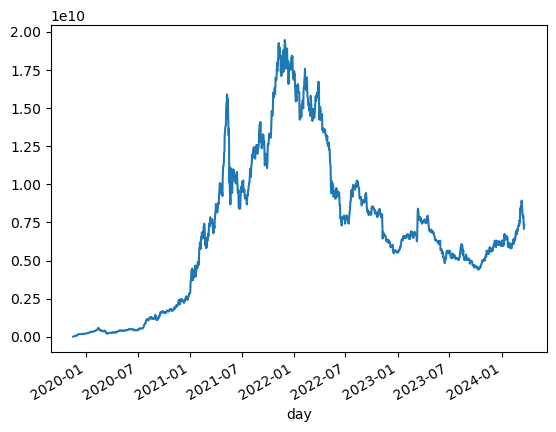

In [686]:
aggregated_vault_data['Vaults Total USD Value'].plot()

### Spearman

In [687]:
st_high_corr = steth_spearman_aggregated_usd_sorted[steth_spearman_aggregated_usd_sorted.abs() > .95]
st_high_corr_no_target = st_high_corr.drop('stETH Vault_collateral_usd', axis=0)
st_high_corr_no_target



stETH Vault_hypothetical_dai_ceiling              0.99964
stETH Vault_collateral_usd_7d_ma                  0.99902
stETH Vault_hypothetical_dai_ceiling_7d_ma        0.99879
stETH Vault_hypothetical_dai_ceiling_30d_ma       0.99506
stETH Vault_collateral_usd_30d_ma                 0.99496
                                                    ...  
RWA Vault_hypothetical_dai_ceiling_90d_ma         0.95209
RWA Vault_annualized_revenues_30d_ma              0.95167
RWA Vault_hypothetical_dai_ceiling_30d_ma_lag30   0.95130
RWA Vault_collateral_usd % of Total_90d_ma        0.95055
RWA Vault_annualized_revenues_7d_ma               0.95014
Name: stETH Vault_collateral_usd, Length: 111, dtype: float64

In [688]:
filtered_aggregated_eth_usd_allvaults_spearman = eth_spearman_aggregated_usd_sorted[(eth_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_steth_usd_allvaults_spearman = steth_spearman_aggregated_usd_sorted[(steth_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_wbtc_usd_allvaults_spearman = wbtc_spearman_aggregated_usd_sorted[(wbtc_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_stb_usd_allvaults_spearman = stb_spearman_aggregated_usd_sorted[(stb_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_alt_usd_allvaults_spearman = alt_spearman_aggregated_usd_sorted[(alt_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_lp_usd_allvaults_spearman = lp_spearman_aggregated_usd_sorted[(lp_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_rwa_usd_allvaults_spearman = rwa_spearman_aggregated_usd_sorted[(rwa_spearman_aggregated_usd_sorted.abs() > 0.8)]
filtered_aggregated_psm_usd_allvaults_spearman = psm_spearman_aggregated_usd_sorted[(psm_spearman_aggregated_usd_sorted.abs() > 0.8)]

print('eth spearman features:',filtered_aggregated_eth_usd_allvaults_spearman.shape[0])
print('stETH spearman features:',filtered_aggregated_steth_usd_allvaults_spearman.shape[0])
print('BTC spearman features:',filtered_aggregated_wbtc_usd_allvaults_spearman.shape[0])
print('stablecoin spearman features:',filtered_aggregated_stb_usd_allvaults_spearman.shape[0])
print('altcoin spearman features:',filtered_aggregated_alt_usd_allvaults_spearman.shape[0])
print('LP spearman features:',filtered_aggregated_lp_usd_allvaults_spearman.shape[0])
print('RWA spearman features:',filtered_aggregated_rwa_usd_allvaults_spearman.shape[0])
print('PSM spearman features:',filtered_aggregated_psm_usd_allvaults_spearman.shape[0])

eth spearman features: 171
stETH spearman features: 271
BTC spearman features: 180
stablecoin spearman features: 63
altcoin spearman features: 121
LP spearman features: 174
RWA spearman features: 285
PSM spearman features: 231


filtered_aggregated_steth_usd_allvaults_spearman.drop(index = st_high_corr_no_target.index, inplace=True)

In [689]:
significant_eth_aggregated_columns_av_s = list(filtered_aggregated_eth_usd_allvaults_spearman.index)
significant_eth_aggregated_df_av_s = aggregated_vault_data[significant_eth_aggregated_columns_av_s]


In [690]:
significant_steth_aggregated_columns_av_s = list(filtered_aggregated_steth_usd_allvaults_spearman.index)
significant_steth_aggregated_df_av_s = aggregated_vault_data[significant_steth_aggregated_columns_av_s]


In [691]:
significant_wbtc_aggregated_columns_av_s = list(filtered_aggregated_wbtc_usd_allvaults_spearman.index)
significant_wbtc_aggregated_df_av_s = aggregated_vault_data[significant_wbtc_aggregated_columns_av_s]


In [692]:
significant_stb_aggregated_columns_av_s = list(filtered_aggregated_stb_usd_allvaults_spearman.index)
significant_stb_aggregated_df_av_s = aggregated_vault_data[significant_stb_aggregated_columns_av_s]


In [693]:
significant_alt_aggregated_columns_av_s = list(filtered_aggregated_alt_usd_allvaults_spearman.index)
significant_alt_aggregated_df_av_s = aggregated_vault_data[significant_alt_aggregated_columns_av_s]


In [694]:
significant_lp_aggregated_columns_av_s = list(filtered_aggregated_lp_usd_allvaults_spearman.index)
significant_lp_aggregated_df_av_s = aggregated_vault_data[significant_lp_aggregated_columns_av_s]


In [695]:
significant_rwa_aggregated_columns_av_s = list(filtered_aggregated_rwa_usd_allvaults_spearman.index)
significant_rwa_aggregated_df_av_s = aggregated_vault_data[significant_rwa_aggregated_columns_av_s]


In [696]:
significant_psm_aggregated_columns_av_s = list(filtered_aggregated_psm_usd_allvaults_spearman.drop(columns=[['PSM Vault_hypothetical_dai_ceiling','psm_balance']]).index)
significant_psm_aggregated_df_av_s = aggregated_vault_data[significant_psm_aggregated_columns_av_s]


In [697]:
significant_eth_aggregated_all_vaults_spearman = significant_eth_aggregated_df_av_s[significant_eth_aggregated_df_av_s.index > '2021-11-18']
significant_steth_aggregated_all_vaults_spearman = significant_steth_aggregated_df_av_s[significant_steth_aggregated_df_av_s.index > '2021-11-18']
significant_wbtc_aggregated_all_vaults_spearman = significant_wbtc_aggregated_df_av_s[significant_wbtc_aggregated_df_av_s.index > '2021-11-18']
significant_stb_aggregated_all_vaults_spearman = significant_stb_aggregated_df_av_s[significant_stb_aggregated_df_av_s.index > '2021-11-18']
significant_alt_aggregated_all_vaults_spearman = significant_alt_aggregated_df_av_s[significant_alt_aggregated_df_av_s.index > '2021-11-18']
significant_lp_aggregated_all_vaults_spearman = significant_lp_aggregated_df_av_s[significant_lp_aggregated_df_av_s.index > '2021-11-18']
significant_psm_aggregated_all_vaults_spearman = significant_psm_aggregated_df_av_s[significant_psm_aggregated_df_av_s.index > '2021-11-18']
significant_rwa_aggregated_all_vaults_spearman = significant_rwa_aggregated_df_av_s[significant_rwa_aggregated_df_av_s.index > '2021-11-18']




### Pearson

In [698]:
filtered_aggregated_eth_usd_allvaults_pearson = correlated_aggregated_eth_collateral_usd_sorted[(correlated_aggregated_eth_collateral_usd_sorted.abs() > 0.8)]
filtered_aggregated_steth_usd_allvaults_pearson = correlated_aggregated_steth_collateral_usd[(correlated_aggregated_steth_collateral_usd.abs() > 0.8)]
filtered_aggregated_wbtc_usd_allvaults_pearson = correlated_aggregated_wbtc_collateral_usd[(correlated_aggregated_wbtc_collateral_usd.abs() > 0.8)]
filtered_aggregated_stb_usd_allvaults_pearson = correlated_aggregated_stb_collateral_usd[(correlated_aggregated_stb_collateral_usd.abs() > 0.8)]
filtered_aggregated_alt_usd_allvaults_pearson = correlated_aggregated_alt_collateral_usd[(correlated_aggregated_alt_collateral_usd.abs() > 0.8)]
filtered_aggregated_lp_usd_allvaults_pearson = correlated_aggregated_lp_collateral_usd[(correlated_aggregated_lp_collateral_usd.abs() > 0.8)]
filtered_aggregated_rwa_usd_allvaults_pearson = correlated_aggregated_rwa_collateral_usd[(correlated_aggregated_rwa_collateral_usd.abs() > 0.8)]
filtered_aggregated_psm_usd_allvaults_pearson = correlated_aggregated_psm_collateral_usd[(correlated_aggregated_psm_collateral_usd.abs() > 0.8)]


print('eth pearson features:',filtered_aggregated_eth_usd_allvaults_pearson.shape[0])
print('stETH pearson features:',filtered_aggregated_steth_usd_allvaults_pearson.shape[0])
print('BTC pearson features:',filtered_aggregated_wbtc_usd_allvaults_pearson.shape[0])
print('stablecoin pearson features:',filtered_aggregated_stb_usd_allvaults_pearson.shape[0])
print('altcoin pearson features:',filtered_aggregated_alt_usd_allvaults_pearson.shape[0])
print('LP pearson features:',filtered_aggregated_lp_usd_allvaults_pearson.shape[0])
print('RWA pearson features:',filtered_aggregated_rwa_usd_allvaults_pearson.shape[0])
print('PSM pearson features:',filtered_aggregated_psm_usd_allvaults_pearson.shape[0])

eth pearson features: 142
stETH pearson features: 184
BTC pearson features: 123
stablecoin pearson features: 32
altcoin pearson features: 95
LP pearson features: 48
RWA pearson features: 199
PSM pearson features: 119


In [699]:
significant_eth_aggregated_columns_av = list(filtered_aggregated_eth_usd_allvaults_pearson.index)
significant_eth_aggregated_df_av = aggregated_vault_data[significant_eth_aggregated_columns_av]

In [700]:
significant_steth_aggregated_columns_av = list(filtered_aggregated_steth_usd_allvaults_pearson.index)
significant_steth_aggregated_df_av = aggregated_vault_data[significant_steth_aggregated_columns_av]

In [701]:
significant_wbtc_aggregated_columns_av = list(filtered_aggregated_wbtc_usd_allvaults_pearson.index)
significant_wbtc_aggregated_df_av = aggregated_vault_data[significant_wbtc_aggregated_columns_av]

In [702]:
significant_stb_aggregated_columns_av = list(filtered_aggregated_stb_usd_allvaults_pearson.index)
significant_stb_aggregated_df_av = aggregated_vault_data[significant_stb_aggregated_columns_av]

In [703]:
significant_alt_aggregated_columns_av = list(filtered_aggregated_alt_usd_allvaults_pearson.index)
significant_alt_aggregated_df_av = aggregated_vault_data[significant_alt_aggregated_columns_av]

In [704]:
significant_lp_aggregated_columns_av = list(filtered_aggregated_lp_usd_allvaults_pearson.index)
significant_lp_aggregated_df_av = aggregated_vault_data[significant_lp_aggregated_columns_av]

In [705]:
significant_rwa_aggregated_columns_av = list(filtered_aggregated_rwa_usd_allvaults_pearson.index)
significant_rwa_aggregated_df_av = aggregated_vault_data[significant_rwa_aggregated_columns_av]

In [706]:
significant_psm_aggregated_columns_av = list(filtered_aggregated_psm_usd_allvaults_pearson.drop(columns=[['PSM Vault_hypothetical_dai_ceiling','psm_balance']]).index)
significant_psm_aggregated_df_av = aggregated_vault_data[significant_psm_aggregated_columns_av]

In [707]:
significant_eth_aggregated_all_vaults_pearson = significant_eth_aggregated_df_av[significant_eth_aggregated_df_av.index > '2021-11-18']
significant_steth_aggregated_all_vaults_pearson = significant_steth_aggregated_df_av[significant_steth_aggregated_df_av.index > '2021-11-18']
significant_wbtc_aggregated_all_vaults_pearson = significant_wbtc_aggregated_df_av[significant_wbtc_aggregated_df_av.index > '2021-11-18']
significant_stb_aggregated_all_vaults_pearson = significant_stb_aggregated_df_av[significant_stb_aggregated_df_av.index > '2021-11-18']
significant_alt_aggregated_all_vaults_pearson = significant_alt_aggregated_df_av[significant_alt_aggregated_df_av.index > '2021-11-18']
significant_lp_aggregated_all_vaults_pearson = significant_lp_aggregated_df_av[significant_lp_aggregated_df_av.index > '2021-11-18']
significant_psm_aggregated_all_vaults_pearson = significant_psm_aggregated_df_av[significant_psm_aggregated_df_av.index > '2021-11-18']
significant_rwa_aggregated_all_vaults_pearson = significant_rwa_aggregated_df_av[significant_rwa_aggregated_df_av.index > '2021-11-18']

# Individual Regressor Models

## ETH Vault

In [708]:
def plot_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, title_base):
    # Assuming y_train and y_test are DataFrame with multiple columns for each target
    num_targets = y_train.shape[1]  # Number of target variables
    
    for i in range(num_targets):
        # Create DataFrames for plotting
        target_name = y_train.columns[i]
        train_df = pd.DataFrame({
            'Actual': y_train.iloc[:, i],
            'Predicted': y_train_pred[:, i]
        }, index=X_train.index)
        
        test_df = pd.DataFrame({
            'Actual': y_test.iloc[:, i],
            'Predicted': y_test_pred[:, i]
        }, index=X_test.index)
        
        # Combine and sort the DataFrames
        combined_df = pd.concat([train_df, test_df])
        combined_df.sort_index(inplace=True)
        
        # Plotting
        plt.figure(figsize=(12, 6))
        plt.plot(combined_df.index, combined_df['Actual'], label='Actual Values', color='blue')
        plt.plot(combined_df.index, combined_df['Predicted'], label='Predicted Values', linestyle='--', color='red')
        plt.title(f"{title_base} for {target_name}")
        plt.xlabel('Date')
        plt.ylabel('Collateral in USD')
        plt.legend()
        plt.show()



In [709]:
def plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, title):
    y_train_df = pd.DataFrame({'Actual': y_train, 'Predicted': y_train_pred}, index=X_train.index)
    y_test_df = pd.DataFrame({'Actual': y_test, 'Predicted': y_test_pred}, index=X_test.index)
    
    # Combine and sort the DataFrames
    combined_df = pd.concat([y_train_df, y_test_df])
    combined_df.sort_index(inplace=True)
    
    # Plotting
    plt.figure(figsize=(12, 6))
    plt.plot(combined_df.index, combined_df['Actual'], label='Actual Values', color='blue')
    plt.plot(combined_df.index, combined_df['Predicted'], label='Predicted Values', linestyle='--', color='orange')
    plt.title(title)
    plt.xlabel('Date')
    plt.ylabel('Collateral in USD')
    plt.legend()
    plt.show()



In [710]:
st_aggregated_vault_data = aggregated_vault_data[aggregated_vault_data.index > '2021-11-18']
st_aggregated_vault_data.isna().sum().sum()

0

<Axes: xlabel='day'>

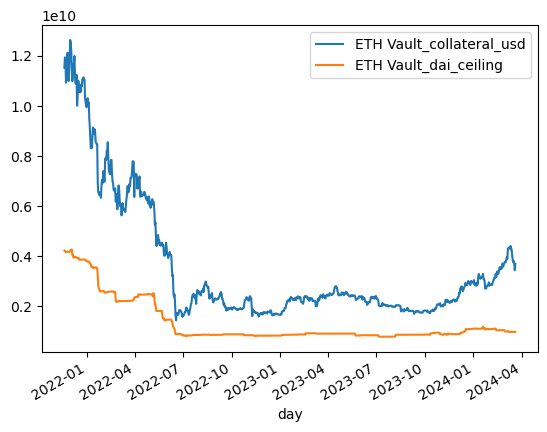

In [711]:
significant_eth_aggregated_all_vaults_spearman[['ETH Vault_collateral_usd','ETH Vault_dai_ceiling']].plot()

Train MAE: 334838601.0689575
Train R-squared: 0.9659796248648873
Test MAE: 357734836.56601
Test R-squared: 0.9618616037354737


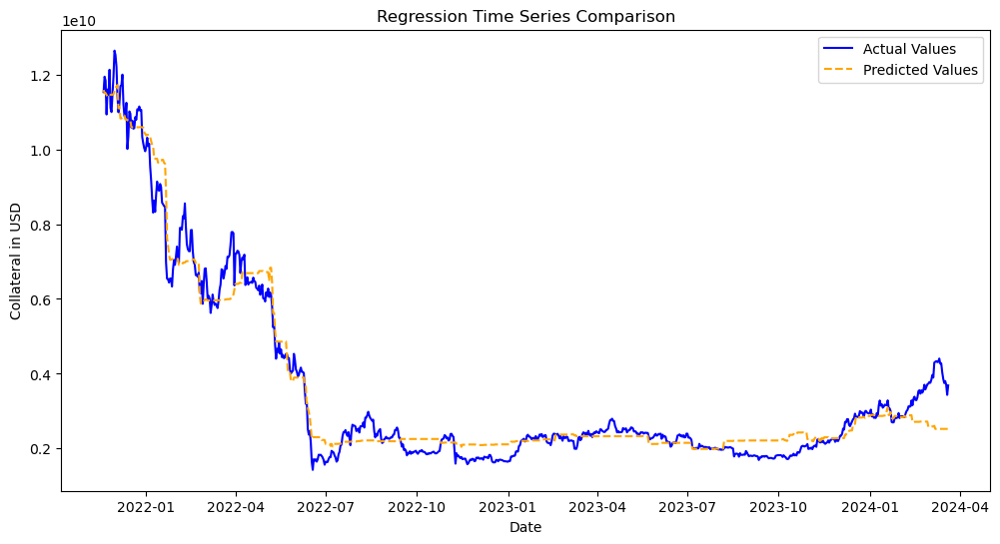

In [712]:



# Ensure x_st and y_st are pandas Series with appropriate indices
x_st = st_aggregated_vault_data['ETH Vault_dai_ceiling']
y_st = st_aggregated_vault_data['ETH Vault_collateral_usd']

# Split the data, ensuring it retains its DataFrame structure
X_train, X_test, y_train, y_test = train_test_split(x_st.to_frame(), y_st, test_size=0.2, random_state=42)

# Fit the model
model_st = LinearRegression()
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)



# Call the plotting function
plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


Train MAE: 97413677.50922455
Train R-squared: 0.9964549758160838
Test MAE: 112878664.89282517
Test R-squared: 0.9947158550097747


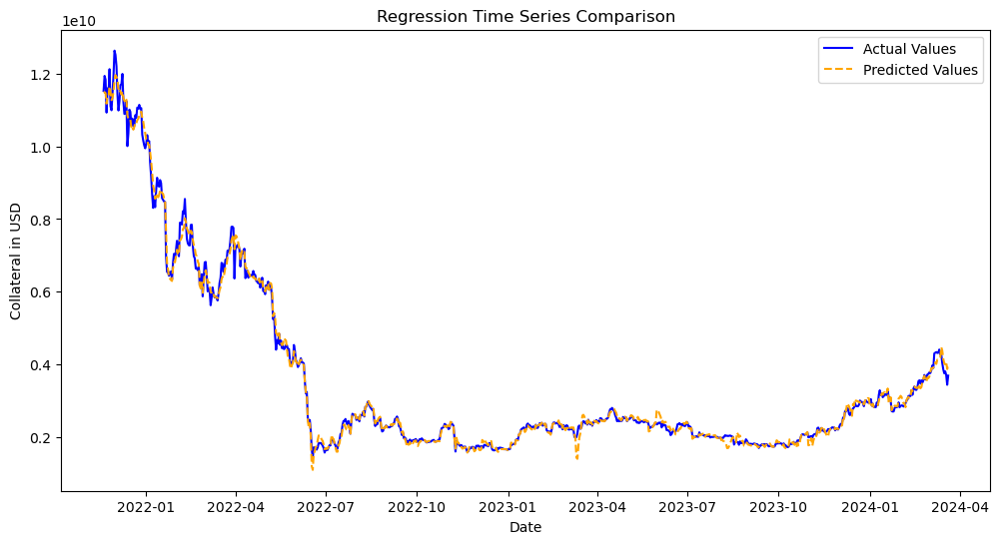

Cross-validated MAE scores: [739253095.3968576, 86469581.70634745, 82122275.7891142, 44440881.58373333, 85557203.37255277]
Cross-validated R-squared scores: [0.727326647474467, 0.8003860003260936, 0.2757482647587919, 0.8786780872412934, 0.9630283954566218]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.87793e-19): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=9.94767e-20): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=6.85807e-20): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=6.05526e-20): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

In [713]:


# Assuming 'st_aggregated_vault_data' contains your dataset
x_st = st_aggregated_vault_data[['ETH Vault_dai_ceiling','ETH Vault_dai_ceiling_7d_ma','ETH Vault_collateral_usd_7d_ma', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total','ETH Vault_collateral_usd % of Total_7d_ma','ETH Vault_collateral_usd % of Total_30d_ma',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['ETH Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=550.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

In [714]:






def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_eth_aggregated_all_vaults_spearman.drop(columns=['ETH Vault_collateral_usd','ETH Vault_hypothetical_dai_ceiling'])

target = significant_eth_aggregated_all_vaults_spearman['ETH Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(45, return_sequences=True, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.08)),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=40,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv_eth = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv_eth = scaler_target.inverse_transform(test_predict)
y_train_multi_inv_eth = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv_eth = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse_eth = np.sqrt(mean_squared_error(y_train_multi_inv_eth, train_predict_multi_inv_eth))
test_rmse_eth = np.sqrt(mean_squared_error(y_test_multi_inv_eth, test_predict_multi_inv_eth))

# Calculate R-squared
train_r2_eth = r2_score(y_train_multi_inv_eth, train_predict_multi_inv_eth)
test_r2_eth = r2_score(y_test_multi_inv_eth, test_predict_multi_inv_eth)

# Calculate MAE
train_mae_eth = mean_absolute_error(y_train_multi_inv_eth, train_predict_multi_inv_eth)
test_mae_eth = mean_absolute_error(y_test_multi_inv_eth, test_predict_multi_inv_eth)

# Calculate MAPE
train_mape_eth = mean_absolute_percentage_error(y_train_multi_inv_eth, train_predict_multi_inv_eth)
test_mape_eth = mean_absolute_percentage_error(y_test_multi_inv_eth, test_predict_multi_inv_eth)

# Output the metrics
print(f"Train RMSE: {train_rmse_eth}, Test RMSE: {test_rmse_eth}")
print(f"Train R²: {train_r2_eth}, Test R²: {test_r2_eth}")
print(f"Train MAE: {train_mae_eth}, Test MAE: {test_mae_eth}")
print(f"Train MAPE: {train_mape_eth}%, Test MAPE: {test_mape_eth}%")


Epoch 1/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 62ms/step - loss: 14.0516 - val_loss: 10.8062
Epoch 2/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 9.9480 - val_loss: 7.5077
Epoch 3/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - loss: 6.8838 - val_loss: 5.1235
Epoch 4/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 4.6835 - val_loss: 3.4520
Epoch 5/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 3.1486 - val_loss: 2.3024
Epoch 6/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 2.0967 - val_loss: 1.5233
Epoch 7/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.3867 - val_loss: 1.0018
Epoch 8/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.9117 - val_loss: 0.6569
Epoch 9/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.5996 - val_loss: 0.4321
Epoch 10/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.3964 - val_loss: 0.2861
Epoch 11/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.2633 - val_loss: 0.1921
Epoch 12/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/st

## stETH vault

<Axes: xlabel='day'>

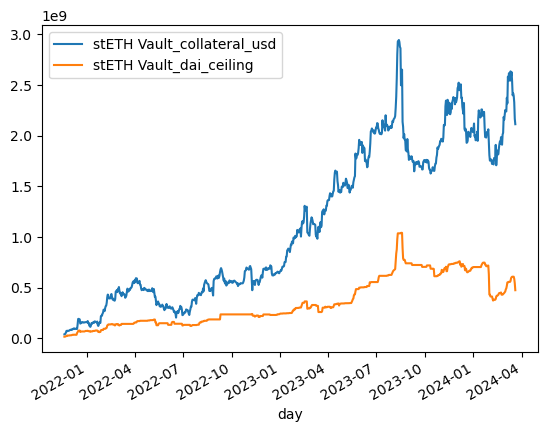

In [715]:
significant_steth_aggregated_all_vaults_spearman[['stETH Vault_collateral_usd','stETH Vault_dai_ceiling']].plot()

Train MAE: 196481702.0611163
Train R-squared: 0.8834805983480893
Test MAE: 201811560.3632739
Test R-squared: 0.8745487448408177


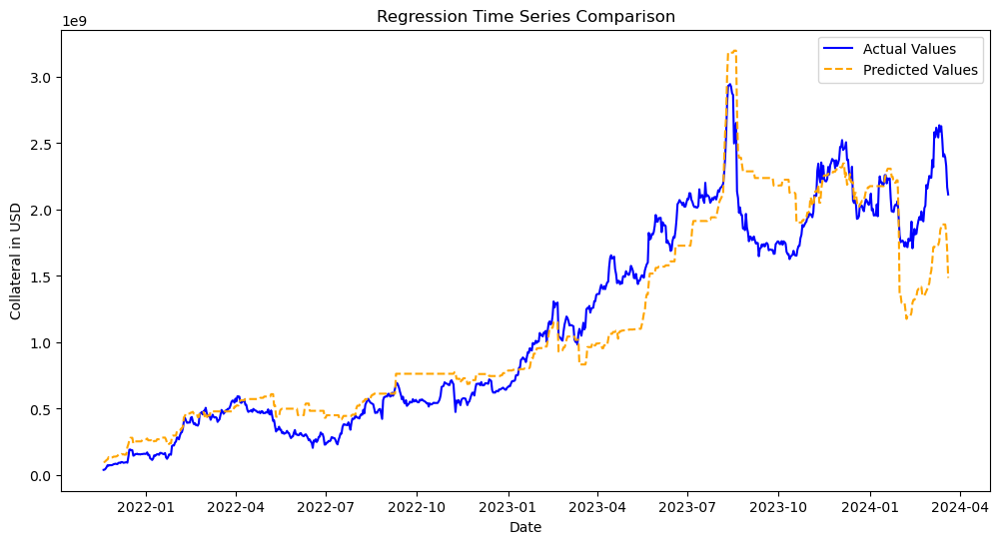

In [716]:
# Ensure x_st and y_st are pandas Series with appropriate indices
x_st = st_aggregated_vault_data['stETH Vault_dai_ceiling']
y_st = st_aggregated_vault_data['stETH Vault_collateral_usd']

# Split the data, ensuring it retains its DataFrame structure
X_train, X_test, y_train, y_test = train_test_split(x_st.to_frame(), y_st, test_size=0.2, random_state=42)

# Fit the model
model_st = LinearRegression()
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)



# Call the plotting function
plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


Train MAE: 34528209.09321831
Train R-squared: 0.9958234939700427
Test MAE: 36164675.68006395
Test R-squared: 0.9949945774758483


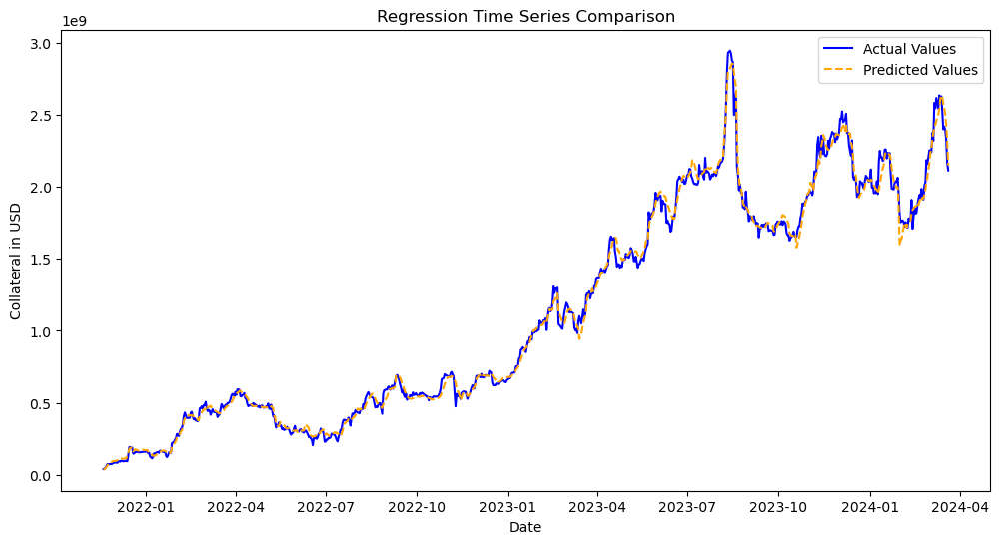

Cross-validated MAE scores: [24623879.11892887, 23072241.86574899, 43890713.753799625, 63606082.14023609, 76035172.93011782]
Cross-validated R-squared scores: [0.9060987467313419, 0.8527944555945434, 0.9587006609259766, 0.9303446972096732, 0.8229962094360905]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.51326e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=2.83163e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.0184e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.58534e-18): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\sit

In [717]:


# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['stETH Vault_dai_ceiling','stETH Vault_dai_ceiling_7d_ma','stETH Vault_collateral_usd_7d_ma', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total', 
       'stETH Vault_collateral_usd % of Total','stETH Vault_collateral_usd % of Total_30d_ma','stETH Vault_collateral_usd % of Total_30d_ma',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['stETH Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=300.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Input
from keras.optimizers import Adam
from keras.regularizers import l2
import tensorflow as tf
from keras.optimizers import RMSprop
from keras.optimizers import SGD
from keras.callbacks import ReduceLROnPlateau
from scipy import signal
from keras.callbacks import EarlyStopping





np.random.seed(42)
tf.random.set_seed(42)

def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_steth_aggregated_all_vaults_spearman['stETH Vault_dai_ceiling']
target = significant_steth_aggregated_all_vaults_spearman['stETH Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(40, return_sequences=True, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.005), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=12,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv_steth = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv_steth = scaler_target.inverse_transform(test_predict)
y_train_multi_inv_steth = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv_steth = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse_steth = np.sqrt(mean_squared_error(y_train_multi_inv_steth, train_predict_multi_inv_steth))
test_rmse_steth = np.sqrt(mean_squared_error(y_test_multi_inv_steth, test_predict_multi_inv_steth))

# Calculate R-squared
train_r2_steth = r2_score(y_train_multi_inv_steth, train_predict_multi_inv_steth)
test_r2_steth = r2_score(y_test_multi_inv_steth, test_predict_multi_inv_steth)

# Calculate MAE
train_mae_steth = mean_absolute_error(y_train_multi_inv_steth, train_predict_multi_inv_steth)
test_mae_steth = mean_absolute_error(y_test_multi_inv_steth, test_predict_multi_inv_steth)

# Calculate MAPE
train_mape_steth = mean_absolute_percentage_error(y_train_multi_inv_steth, train_predict_multi_inv_steth)
test_mape_steth = mean_absolute_percentage_error(y_test_multi_inv_steth, test_predict_multi_inv_steth)

# Output the metrics
print(f"Train RMSE: {train_rmse_steth}, Test RMSE: {test_rmse_steth}")
print(f"Train R²: {train_r2_steth}, Test R²: {test_r2_steth}")
print(f"Train MAE: {train_mae_steth}, Test MAE: {test_mae_steth}")
print(f"Train MAPE: {train_mape_steth}%, Test MAPE: {test_mape_steth}%")


import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Input
from keras.optimizers import Adam
from keras.regularizers import l2
import tensorflow as tf
from keras.optimizers import RMSprop
from keras.optimizers import SGD
from keras.callbacks import ReduceLROnPlateau
from scipy import signal
from keras.callbacks import EarlyStopping





np.random.seed(42)
tf.random.set_seed(42)

def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_steth_aggregated_all_vaults_spearman.drop(columns=['stETH Vault_collateral_usd'])

target = significant_steth_aggregated_all_vaults_spearman['stETH Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 100
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(40, return_sequences=False, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    #LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.005), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=12,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv_steth = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv_steth = scaler_target.inverse_transform(test_predict)
y_train_multi_inv_steth = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv_steth = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse_steth = np.sqrt(mean_squared_error(y_train_multi_inv_steth, train_predict_multi_inv_steth))
test_rmse_steth = np.sqrt(mean_squared_error(y_test_multi_inv_steth, test_predict_multi_inv_steth))

# Calculate R-squared
train_r2_steth = r2_score(y_train_multi_inv_steth, train_predict_multi_inv_steth)
test_r2_steth = r2_score(y_test_multi_inv_steth, test_predict_multi_inv_steth)

# Calculate MAE
train_mae_steth = mean_absolute_error(y_train_multi_inv_steth, train_predict_multi_inv_steth)
test_mae_steth = mean_absolute_error(y_test_multi_inv_steth, test_predict_multi_inv_steth)

# Calculate MAPE
train_mape_steth = mean_absolute_percentage_error(y_train_multi_inv_steth, train_predict_multi_inv_steth)
test_mape_steth = mean_absolute_percentage_error(y_test_multi_inv_steth, test_predict_multi_inv_steth)

# Output the metrics
print(f"Train RMSE: {train_rmse_steth}, Test RMSE: {test_rmse_steth}")
print(f"Train R²: {train_r2_steth}, Test R²: {test_r2_steth}")
print(f"Train MAE: {train_mae_steth}, Test MAE: {test_mae_steth}")
print(f"Train MAPE: {train_mape_steth}%, Test MAPE: {test_mape_steth}%")


## BTC vault

<Axes: xlabel='day'>

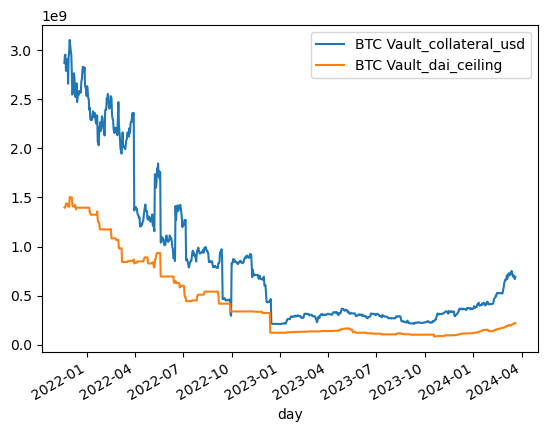

In [718]:
significant_wbtc_aggregated_all_vaults_spearman[['BTC Vault_collateral_usd', 'BTC Vault_dai_ceiling']].plot()

In [719]:
for index, value in correlated_aggregated_wbtc_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

BTC Vault_collateral_usd                           1.0
BTC Vault_hypothetical_dai_ceiling                 0.9997783772830399
BTC Vault_collateral_usd_7d_ma                     0.9944362954779096
BTC Vault_hypothetical_dai_ceiling_7d_ma           0.9940735448467486
BTC Vault_dai_ceiling                              0.9745234900084908
BTC Vault_prev_dai_ceiling                         0.9725352861625484
BTC Vault_collateral_usd_30d_ma                    0.9718378462213006
BTC Vault_hypothetical_dai_ceiling_30d_ma          0.9710789332362283
BTC Vault_dai_ceiling_7d_ma                        0.969543319074168
BTC Vault_dart                                     0.9690273962935934
BTC Vault_debt_balance                             0.9690273539864338
BTC Vault_debt_balance_7d_ma                       0.9674731059954644
BTC Vault_dart_7d_ma                               0.9674724689612194
BTC Vault_prev_dai_ceiling_7d_ma                   0.9674197739960189
BTC Vault_dart_30d_ma               

Train MAE: 122714767.37199529
Train R-squared: 0.9451143232479313
Test MAE: 119907107.2965007
Test R-squared: 0.950151835576848


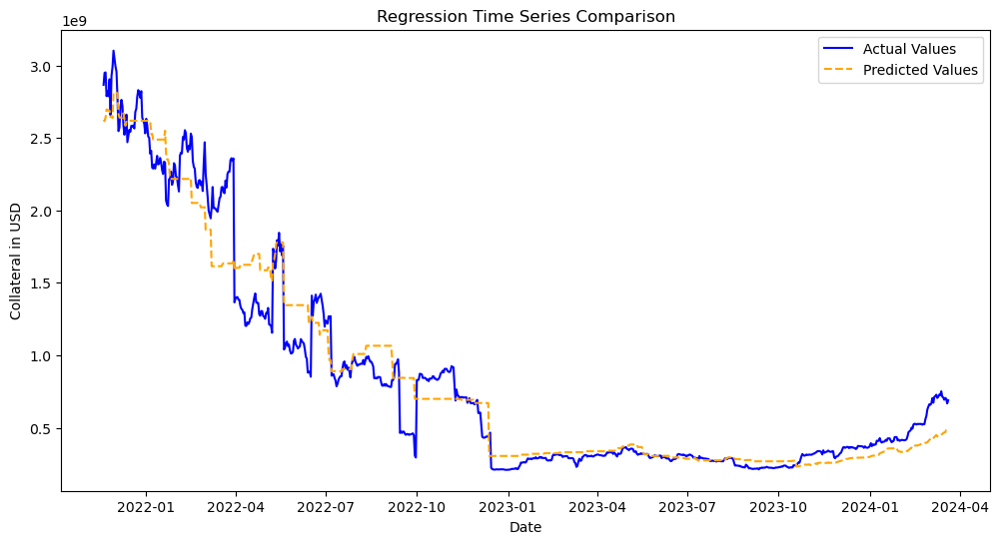

In [720]:
# Make sure x_st and y_st are pandas Series with the right indices (assuming they are columns in a DataFrame)
x_st = st_aggregated_vault_data['BTC Vault_dai_ceiling'].to_frame()  # Convert to DataFrame
y_st = st_aggregated_vault_data['BTC Vault_collateral_usd']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Model training
model_st = LinearRegression()
model_st.fit(X_train, y_train)

# Predictions
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Performance metrics
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


Train MAE: 24865719.649497762
Train R-squared: 0.996725125820663
Test MAE: 32652548.19929471
Test R-squared: 0.9949809821135405


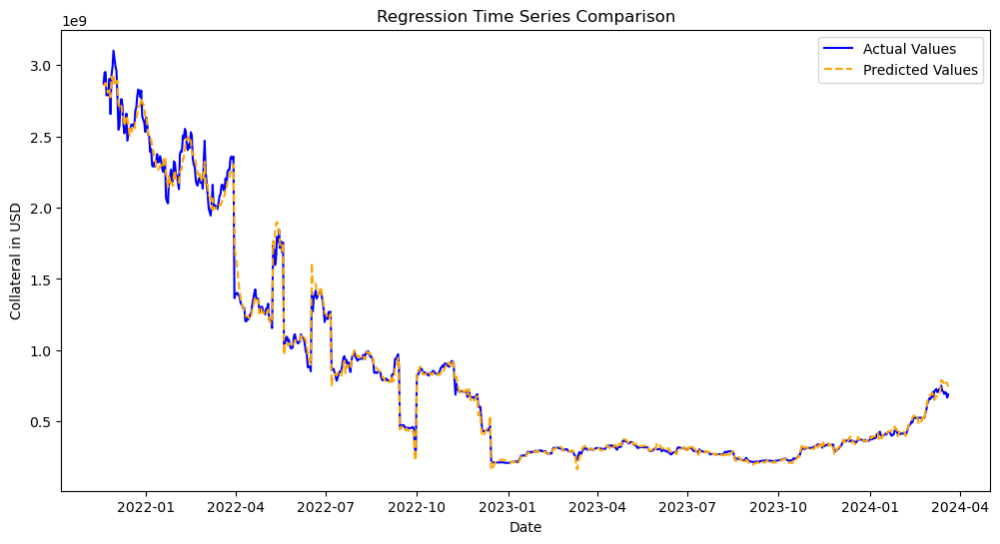

Cross-validated MAE scores: [83360325.42037997, 64424977.170429915, 8679268.344357943, 14158076.318145726, 18540754.263949934]
Cross-validated R-squared scores: [0.8184649614131166, 0.8610324567563704, 0.7539882076933166, 0.7575197381044785, 0.962928215917921]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.33323e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=6.19058e-18): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=2.98392e-18): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=2.07845e-18): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

In [721]:


# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['BTC Vault_dai_ceiling', 'BTC Vault_dai_ceiling_7d_ma','BTC Vault_collateral_usd_7d_ma','BTC Vault_collateral_usd % of Total',
                                 'BTC Vault_collateral_usd % of Total_7d_ma','BTC Vault_collateral_usd % of Total_30d_ma',
       'ETH Vault_collateral_usd % of Total','BTC Vault_dart','BTC Vault_dart_7d_ma','BTC Vault_prev_dai_ceiling',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['BTC Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)


plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=3000.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

In [722]:







def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_wbtc_aggregated_all_vaults_spearman.drop(columns=['BTC Vault_collateral_usd'])

target = significant_wbtc_aggregated_all_vaults_spearman['BTC Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(45, return_sequences=True, dropout=0.2, recurrent_dropout=0.2),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.002), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=40,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv_btc = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv_btc = scaler_target.inverse_transform(test_predict)
y_train_multi_inv_btc = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv_btc = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse_btc = np.sqrt(mean_squared_error(y_train_multi_inv_btc, train_predict_multi_inv_btc))
test_rmse_btc = np.sqrt(mean_squared_error(y_test_multi_inv_btc, test_predict_multi_inv_btc))

# Calculate R-squared
train_r2_btc = r2_score(y_train_multi_inv_btc, train_predict_multi_inv_btc)
test_r2_btc = r2_score(y_test_multi_inv_btc, test_predict_multi_inv_btc)

# Calculate MAE
train_mae_btc = mean_absolute_error(y_train_multi_inv_btc, train_predict_multi_inv_btc)
test_mae_btc = mean_absolute_error(y_test_multi_inv_btc, test_predict_multi_inv_btc)

# Calculate MAPE
train_mape_btc = mean_absolute_percentage_error(y_train_multi_inv_btc, train_predict_multi_inv_btc)
test_mape_btc = mean_absolute_percentage_error(y_test_multi_inv_btc, test_predict_multi_inv_btc)

# Output the metrics
print(f"Train RMSE: {train_rmse_btc}, Test RMSE: {test_rmse_btc}")
print(f"Train R²: {train_r2_btc}, Test R²: {test_r2_btc}")
print(f"Train MAE: {train_mae_btc}, Test MAE: {test_mae_btc}")
print(f"Train MAPE: {train_mape_btc}%, Test MAPE: {test_mape_btc}%")


Epoch 1/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - loss: 1.1370 - val_loss: 0.7600
Epoch 2/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.7087 - val_loss: 0.5079
Epoch 3/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.4707 - val_loss: 0.3313
Epoch 4/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 0.3076 - val_loss: 0.2143
Epoch 5/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.2029 - val_loss: 0.1377
Epoch 6/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.1326 - val_loss: 0.0887
Epoch 7/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0869 - val_loss: 0.0576
Epoch 8/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.0590 - val_loss: 0.0374
Epoch 9/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0408 - val_loss: 0.0256
Epoch 10/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0294 - val_loss: 0.0171
Epoch 11/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.0225 - val_loss: 0.0117
Epoch 12/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step

## Altcoin Vault

<Axes: xlabel='day'>

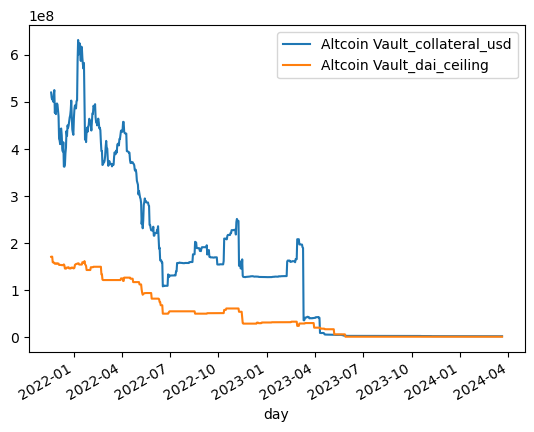

In [723]:
st_aggregated_vault_data[['Altcoin Vault_collateral_usd','Altcoin Vault_dai_ceiling']].plot()

In [724]:
for index, value in correlated_aggregated_alt_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

Altcoin Vault_collateral_usd                       1.0
Altcoin Vault_hypothetical_dai_ceiling             0.9961770111923894
Altcoin Vault_collateral_usd_7d_ma                 0.9910417834743646
Altcoin Vault_hypothetical_dai_ceiling_7d_ma       0.9871245748873356
Altcoin Vault_dart                                 0.9796526125350031
Altcoin Vault_debt_balance                         0.9796124660210367
Altcoin Vault_dart_7d_ma                           0.9729103200157286
Altcoin Vault_debt_balance_7d_ma                   0.9728703583720812
Altcoin Vault_collateral_usd_30d_ma                0.9563630483660542
Altcoin Vault_dai_ceiling                          0.9523316145367133
Altcoin Vault_hypothetical_dai_ceiling_30d_ma      0.9514670822593385
Altcoin Vault_prev_dai_ceiling                     0.9502052466192499
Altcoin Vault_dart_30d_ma                          0.9501954770547035
Altcoin Vault_debt_balance_30d_ma                  0.9501113571456484
Altcoin Vault_dai_ceiling_7d_ma    

Train MAE: 22833768.64112138
Train R-squared: 0.9574194941255589
Test MAE: 23078556.89741541
Test R-squared: 0.9570142172826701


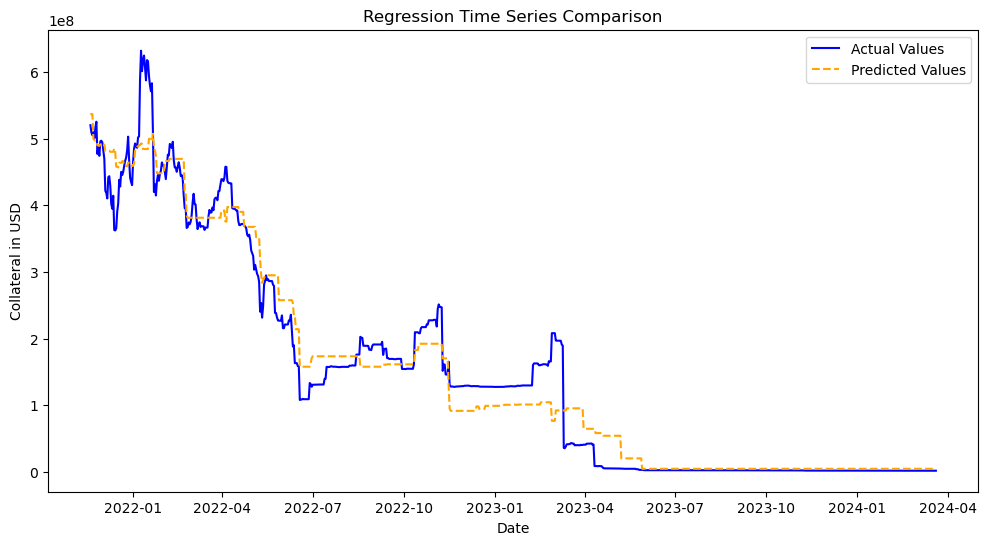

In [725]:
x_st = st_aggregated_vault_data['Altcoin Vault_dai_ceiling'].to_frame()
y_st = st_aggregated_vault_data['Altcoin Vault_collateral_usd']

X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)  # Assuming 'y' is your target variable




model_st = LinearRegression()
model_st.fit(X_train, y_train)

y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


In [726]:
#need to see if these vaults are closed 

st_aggregated_vault_data[['Altcoin Vault_dai_ceiling','Altcoin Vault_collateral_usd','Altcoin Vault_market_price']]

,Altcoin Vault_dai_ceiling,Altcoin Vault_collateral_usd,Altcoin Vault_market_price
day,,,
2021-11-19 00:00:00+00:00,"170,858,309.36176","520,045,444.90519","9,897.55075"
2021-11-20 00:00:00+00:00,"171,141,983.01782","508,972,390.70129","9,677.81932"
2021-11-21 00:00:00+00:00,"171,131,567.49223","505,016,705.04971","10,522.22054"
2021-11-22 00:00:00+00:00,"159,239,990.91266","509,504,043.07337","10,504.39908"
2021-11-23 00:00:00+00:00,"158,801,066.38277","500,427,709.74620","10,292.28950"
...,...,...,...
2024-03-16 00:00:00+00:00,"1,000,000.00000","1,944,419.59103",0.37237
2024-03-17 00:00:00+00:00,"1,000,000.00000","1,944,419.59103",0.37237
2024-03-18 00:00:00+00:00,"1,000,000.00000","1,944,419.59103",0.37237


Train MAE: 6901196.209992148
Train R-squared: 0.9950104368879407
Test MAE: 7971655.285810959
Test R-squared: 0.9919507852087525


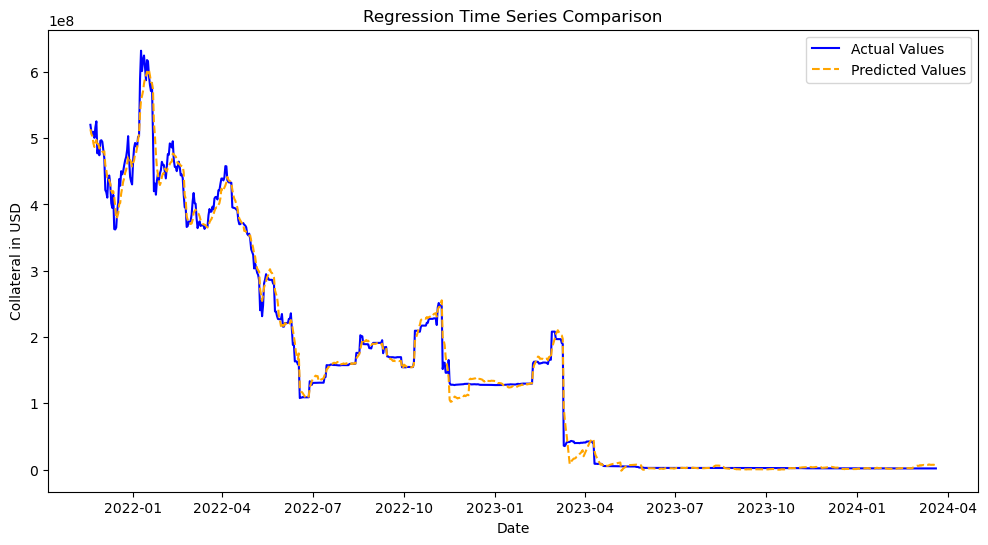

Cross-validated MAE scores: [19020435.412171975, 8953958.972727817, 15351694.317451477, 4477800.727679886, 1717120.5236767966]
Cross-validated R-squared scores: [0.9335441125404441, 0.8846892873322282, 0.8949504616169139, -7679.014357625705, -428.0555868177288]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.08672e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.14114e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T


In [727]:


# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['Altcoin Vault_dai_ceiling','Altcoin Vault_dai_ceiling_7d_ma','Altcoin Vault_collateral_usd_7d_ma', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total','Altcoin Vault_dart','stETH Vault_collateral_usd',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total','Altcoin Vault_collateral_usd % of Total_30d_ma','Altcoin Vault_collateral_usd % of Total_30d_ma',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['Altcoin Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=20000.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

In [728]:








def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_alt_aggregated_all_vaults_spearman.drop(columns=['Altcoin Vault_collateral_usd'])

target = significant_alt_aggregated_all_vaults_spearman['Altcoin Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(45, return_sequences=True, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.08)),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=40,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv = scaler_target.inverse_transform(test_predict)
y_train_multi_inv = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse = np.sqrt(mean_squared_error(y_train_multi_inv, train_predict_multi_inv))
test_rmse = np.sqrt(mean_squared_error(y_test_multi_inv, test_predict_multi_inv))

# Calculate R-squared
train_r2 = r2_score(y_train_multi_inv, train_predict_multi_inv)
test_r2 = r2_score(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAE
train_mae = mean_absolute_error(y_train_multi_inv, train_predict_multi_inv)
test_mae = mean_absolute_error(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAPE
train_mape = mean_absolute_percentage_error(y_train_multi_inv, train_predict_multi_inv)
test_mape = mean_absolute_percentage_error(y_test_multi_inv, test_predict_multi_inv)

# Output the metrics
print(f"Train RMSE: {train_rmse}, Test RMSE: {test_rmse}")
print(f"Train R²: {train_r2}, Test R²: {test_r2}")
print(f"Train MAE: {train_mae}, Test MAE: {test_mae}")
print(f"Train MAPE: {train_mape}%, Test MAPE: {test_mape}%")


Epoch 1/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 63ms/step - loss: 11.8560 - val_loss: 9.2905
Epoch 2/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 8.6279 - val_loss: 6.6780
Epoch 3/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 6.1675 - val_loss: 4.7172
Epoch 4/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 4.3525 - val_loss: 3.2995
Epoch 5/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 3.0385 - val_loss: 2.2873
Epoch 6/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.1073 - val_loss: 1.5740
Epoch 7/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 1.4513 - val_loss: 1.0775
Epoch 8/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.9936 - val_loss: 0.7353
Epoch 9/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.6800 - val_loss: 0.5012
Epoch 10/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - loss: 0.4671 - val_loss: 0.3429
Epoch 11/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.3215 - val_loss: 0.2361
Epoch 12/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/ste

## Stablecoin Vault

<Axes: xlabel='day'>

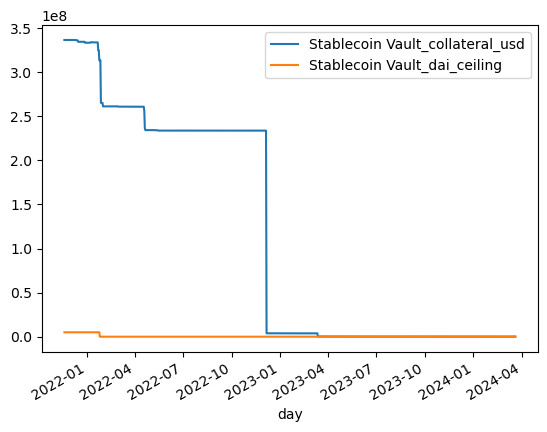

In [729]:
st_aggregated_vault_data[['Stablecoin Vault_collateral_usd','Stablecoin Vault_dai_ceiling']].plot()

In [730]:
for index, value in correlated_aggregated_stb_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

Stablecoin Vault_collateral_usd                    1.0
Stablecoin Vault_debt_balance                      0.9997591353282008
Stablecoin Vault_dart                              0.9997591353282008
Stablecoin Vault_hypothetical_dai_ceiling          0.9997410346825201
Stablecoin Vault_collateral_usd_7d_ma              0.9965589317931264
Stablecoin Vault_hypothetical_dai_ceiling_7d_ma    0.9964809518524721
Stablecoin Vault_dart_7d_ma                        0.9960826772586946
Stablecoin Vault_debt_balance_7d_ma                0.9960826772586946
Stablecoin Vault_hypothetical_dai_ceiling_30d_ma   0.9749215580016904
Stablecoin Vault_collateral_usd_30d_ma             0.9743318073580336
Stablecoin Vault_debt_balance_30d_ma               0.9730716819208972
Stablecoin Vault_dart_30d_ma                       0.9730716819208972
Stablecoin Vault_hypothetical_dai_ceiling_lag30    0.9152972435070109
Stablecoin Vault_hypothetical_dai_ceiling_90d_ma   0.914759663799364
Stablecoin Vault_collateral_usd_lag3

Train MAE: 106208975.22959134
Train R-squared: 0.24143032290729183
Test MAE: 107064594.26190154
Test R-squared: 0.23213486550382045


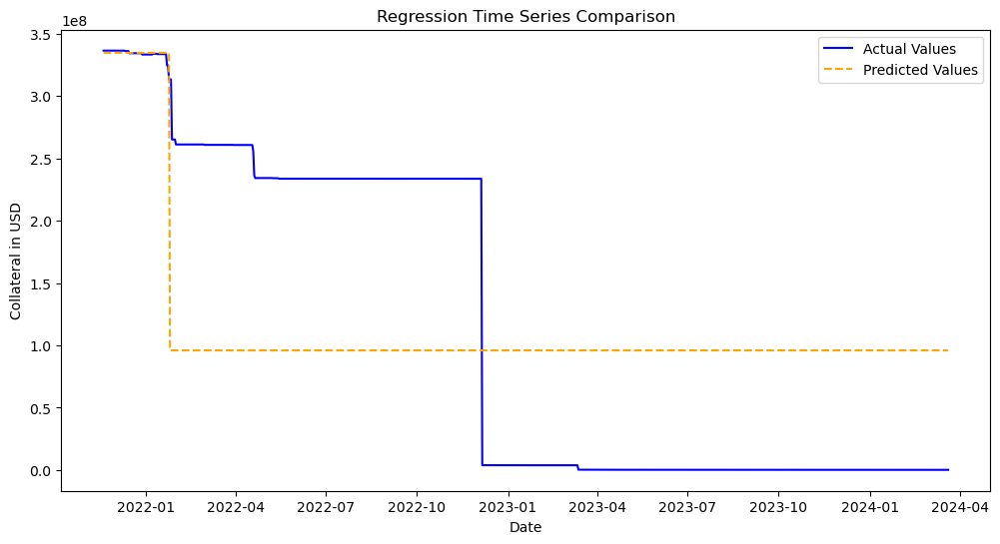

In [731]:
x_st = st_aggregated_vault_data['Stablecoin Vault_dai_ceiling'].to_frame()
y_st = st_aggregated_vault_data['Stablecoin Vault_collateral_usd']

X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)  # Assuming 'y' is your target variable




model_st = LinearRegression()
model_st.fit(X_train, y_train)

y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


In [732]:
#need to add status for aggregated vaults; dai ceiling is 0 so vault is closed.  model has trouble

st_aggregated_vault_data['Stablecoin Vault_dai_ceiling']

day
2021-11-19 00:00:00+00:00   5,000,000.00000
2021-11-20 00:00:00+00:00   5,000,000.00000
2021-11-21 00:00:00+00:00   5,000,000.00000
2021-11-22 00:00:00+00:00   5,000,000.00000
2021-11-23 00:00:00+00:00   5,000,000.00000
                                  ...      
2024-03-16 00:00:00+00:00           0.00000
2024-03-17 00:00:00+00:00           0.00000
2024-03-18 00:00:00+00:00           0.00000
2024-03-19 00:00:00+00:00           0.00000
2024-03-20 00:00:00+00:00           0.00000
Name: Stablecoin Vault_dai_ceiling, Length: 854, dtype: float64

Train MAE: 62120.47005886963
Train R-squared: 0.9999972212091992
Test MAE: 59125.92840695896
Test R-squared: 0.9999993905431772


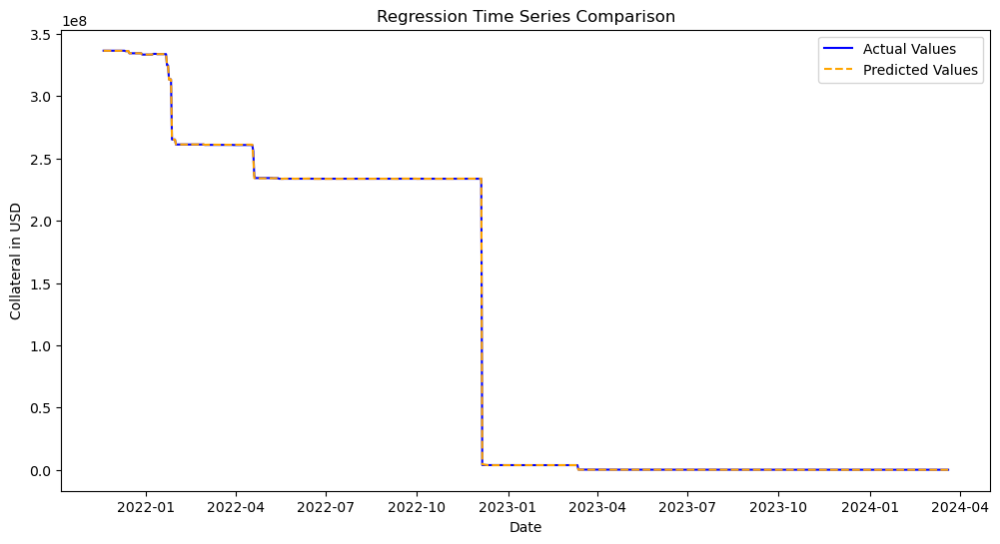

Cross-validated MAE scores: [379323.3542122173, 1161817.6184643172, 68650.57388177683, 68013.3489115698, 24078.745701168213]
Cross-validated R-squared scores: [0.9909358095669826, 0.9996229308798738, 0.9973905195156544, -65808510.48356618, -1330522.7389071733]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.69093e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.23497e-18): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=6.44087e-19): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.8784e-19): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\sit

In [733]:


# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['Stablecoin Vault_dai_ceiling', 'Stablecoin Vault_dai_ceiling_7d_ma','Stablecoin Vault_collateral_usd_7d_ma', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total','Stablecoin Vault_dart',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total','Stablecoin Vault_collateral_usd % of Total_7d_ma','Stablecoin Vault_collateral_usd % of Total_30d_ma',
       'Altcoin Vault_collateral_usd % of Total','Vaults Total USD Value',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['Stablecoin Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=5000.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

In [734]:







def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_stb_aggregated_all_vaults_spearman.drop(columns=['Stablecoin Vault_collateral_usd'])

target = significant_stb_aggregated_all_vaults_spearman['Stablecoin Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(45, return_sequences=True, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.08)),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=40,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv = scaler_target.inverse_transform(test_predict)
y_train_multi_inv = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse = np.sqrt(mean_squared_error(y_train_multi_inv, train_predict_multi_inv))
test_rmse = np.sqrt(mean_squared_error(y_test_multi_inv, test_predict_multi_inv))

# Calculate R-squared
train_r2 = r2_score(y_train_multi_inv, train_predict_multi_inv)
test_r2 = r2_score(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAE
train_mae = mean_absolute_error(y_train_multi_inv, train_predict_multi_inv)
test_mae = mean_absolute_error(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAPE
train_mape = mean_absolute_percentage_error(y_train_multi_inv, train_predict_multi_inv)
test_mape = mean_absolute_percentage_error(y_test_multi_inv, test_predict_multi_inv)

# Output the metrics
print(f"Train RMSE: {train_rmse}, Test RMSE: {test_rmse}")
print(f"Train R²: {train_r2}, Test R²: {test_r2}")
print(f"Train MAE: {train_mae}, Test MAE: {test_mae}")
print(f"Train MAPE: {train_mape}%, Test MAPE: {test_mape}%")


Epoch 1/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 6s 60ms/step - loss: 8.2129 - val_loss: 6.6268
Epoch 2/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 6.2590 - val_loss: 5.0067
Epoch 3/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 4.7051 - val_loss: 3.7348
Epoch 4/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step - loss: 3.5060 - val_loss: 2.7634
Epoch 5/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 2.5946 - val_loss: 2.0323
Epoch 6/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - loss: 1.9075 - val_loss: 1.4859
Epoch 7/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.3970 - val_loss: 1.0814
Epoch 8/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.0172 - val_loss: 0.7846
Epoch 9/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.7428 - val_loss: 0.5685
Epoch 10/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.5403 - val_loss: 0.4125
Epoch 11/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.3958 - val_loss: 0.3004
Epoch 12/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step

## LP Vault

<Axes: xlabel='day'>

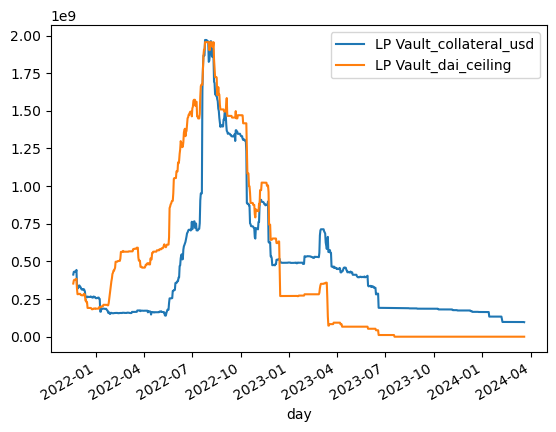

In [735]:
st_aggregated_vault_data[['LP Vault_collateral_usd','LP Vault_dai_ceiling']].plot()

In [736]:
for index, value in correlated_aggregated_lp_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

LP Vault_collateral_usd                            1.0
LP Vault_hypothetical_dai_ceiling                  0.9956867875030132
LP Vault_collateral_usd_7d_ma                      0.9934425624457233
LP Vault_hypothetical_dai_ceiling_7d_ma            0.9886952239228154
LP Vault_collateral_usd % of Total                 0.9676498861026195
LP Vault_collateral_usd % of Total_7d_ma           0.9603159901348111
LP Vault_collateral_usd_30d_ma                     0.9504729138750401
LP Vault_hypothetical_dai_ceiling_30d_ma           0.9440967890106097
LP Vault_dart_30d_ma                               0.9407456108297888
LP Vault_debt_balance_30d_ma                       0.940745449798405
LP Vault_dart_7d_ma                                0.9315954872721787
LP Vault_debt_balance_7d_ma                        0.9315954487223173
LP Vault_dart_lag30                                0.9265153514817326
LP Vault_debt_balance_lag30                        0.9265153381281999
LP Vault_dart_7d_ma_lag30           

Train MAE: 168329171.1898944
Train R-squared: 0.6883729403596168
Test MAE: 171465509.86546615
Test R-squared: 0.7496874114219214


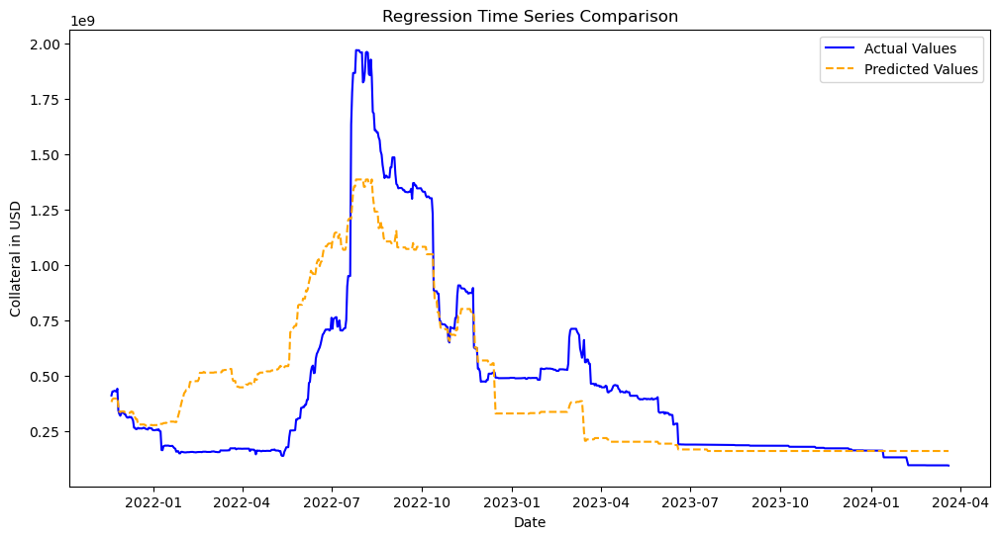

In [737]:
x_st = st_aggregated_vault_data['LP Vault_dai_ceiling'].to_frame()
y_st = st_aggregated_vault_data['LP Vault_collateral_usd']

X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)  # Assuming 'y' is your target variable




model_st = LinearRegression()
model_st.fit(X_train, y_train)

y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


In [738]:
st_aggregated_vault_data[['LP Vault_collateral_usd','LP Vault_dai_ceiling']]

,LP Vault_collateral_usd,LP Vault_dai_ceiling
day,,
2021-11-19 00:00:00+00:00,"412,562,137.86644","352,901,603.86001"
2021-11-20 00:00:00+00:00,"430,562,322.97248","372,841,835.68929"
2021-11-21 00:00:00+00:00,"431,500,082.06578","378,293,238.31257"
2021-11-22 00:00:00+00:00,"433,806,450.38492","378,299,770.81950"
2021-11-23 00:00:00+00:00,"432,619,037.81609","378,879,291.14350"
...,...,...
2024-03-16 00:00:00+00:00,"97,377,612.28187",0.00000
2024-03-17 00:00:00+00:00,"97,379,575.13498",0.00000
2024-03-18 00:00:00+00:00,"97,380,556.52498",0.00000


Train MAE: 10768354.668175746
Train R-squared: 0.9979945629471559
Test MAE: 15424130.233594984
Test R-squared: 0.9958190749789274


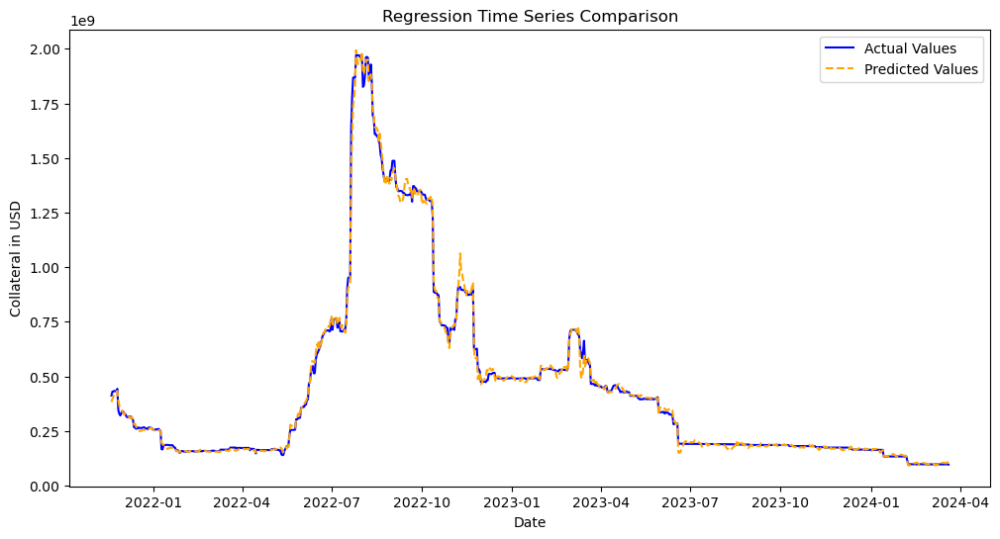

Cross-validated MAE scores: [47772998.55292113, 30171076.116604716, 18627784.409502823, 4784678.960633711, 5139529.505947298]
Cross-validated R-squared scores: [0.9753809426704027, 0.9781131157522834, 0.900493130293924, 0.8699560357153215, 0.9646338060023368]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=3.11473e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.92706e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.45151e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.13557e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T


In [739]:


# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['LP Vault_dai_ceiling','LP Vault_dai_ceiling_7d_ma','LP Vault_collateral_usd_7d_ma','LP Vault_collateral_usd_30d_ma', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total','LP Vault_collateral_usd % of Total_7d_ma','LP Vault_collateral_usd % of Total_30d_ma',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['LP Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=10000.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Input
from keras.optimizers import Adam
from keras.regularizers import l2
import tensorflow as tf
from keras.optimizers import RMSprop
from keras.optimizers import SGD
from keras.callbacks import ReduceLROnPlateau
from scipy import signal
from keras.callbacks import EarlyStopping





np.random.seed(42)
tf.random.set_seed(42)

def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = significant_lp_aggregated_all_vaults.drop(columns=['LP Vault_collateral_usd'])

target = significant_lp_aggregated_all_vaults['LP Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(45, return_sequences=True, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.08)),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=40,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv = scaler_target.inverse_transform(test_predict)
y_train_multi_inv = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse = np.sqrt(mean_squared_error(y_train_multi_inv, train_predict_multi_inv))
test_rmse = np.sqrt(mean_squared_error(y_test_multi_inv, test_predict_multi_inv))

# Calculate R-squared
train_r2 = r2_score(y_train_multi_inv, train_predict_multi_inv)
test_r2 = r2_score(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAE
train_mae = mean_absolute_error(y_train_multi_inv, train_predict_multi_inv)
test_mae = mean_absolute_error(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAPE
train_mape = mean_absolute_percentage_error(y_train_multi_inv, train_predict_multi_inv)
test_mape = mean_absolute_percentage_error(y_test_multi_inv, test_predict_multi_inv)

# Output the metrics
print(f"Train RMSE: {train_rmse}, Test RMSE: {test_rmse}")
print(f"Train R²: {train_r2}, Test R²: {test_r2}")
print(f"Train MAE: {train_mae}, Test MAE: {test_mae}")
print(f"Train MAPE: {train_mape}%, Test MAPE: {test_mape}%")


## RWA Vault 

<Axes: xlabel='day'>

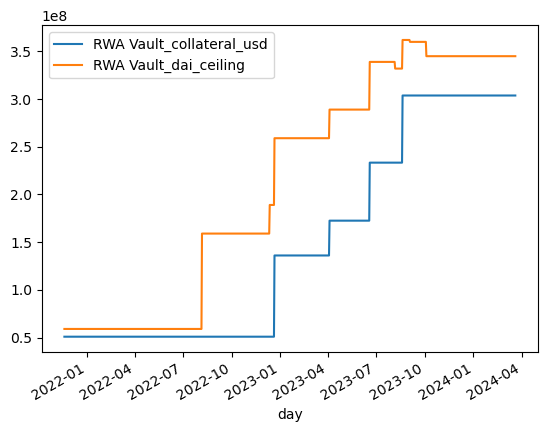

In [740]:
st_aggregated_vault_data[['RWA Vault_collateral_usd','RWA Vault_dai_ceiling']].plot()

In [741]:
for index, value in correlated_aggregated_rwa_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

RWA Vault_collateral_usd                           1.0
RWA Vault_hypothetical_dai_ceiling                 0.9999351703740573
RWA Vault_collateral_usd_7d_ma                     0.9990690623877647
RWA Vault_hypothetical_dai_ceiling_7d_ma           0.9990356712662306
RWA Vault_hypothetical_dai_ceiling_30d_ma          0.9956611075096519
RWA Vault_collateral_usd_30d_ma                    0.9955726138650174
RWA Vault_hypothetical_dai_ceiling_90d_ma          0.9883517033933821
RWA Vault_market_price                             0.9881030407374704
RWA Vault_market_price_7d_ma                       0.9880487217287124
RWA Vault_collateral_usd_90d_ma                    0.9879762604297834
RWA Vault_market_price_30d_ma                      0.9877125772516592
RWA Vault_market_price_90d_ma                      0.987391763734036
RWA Vault_hypothetical_dai_ceiling_lag30           0.9864771725813233
RWA Vault_collateral_usd_lag30                     0.9861468391067654
RWA Vault_hypothetical_dai_ceiling_7

Train MAE: 38888268.31804741
Train R-squared: 0.8480998965443696
Test MAE: 40178602.00781003
Test R-squared: 0.8406933937359939


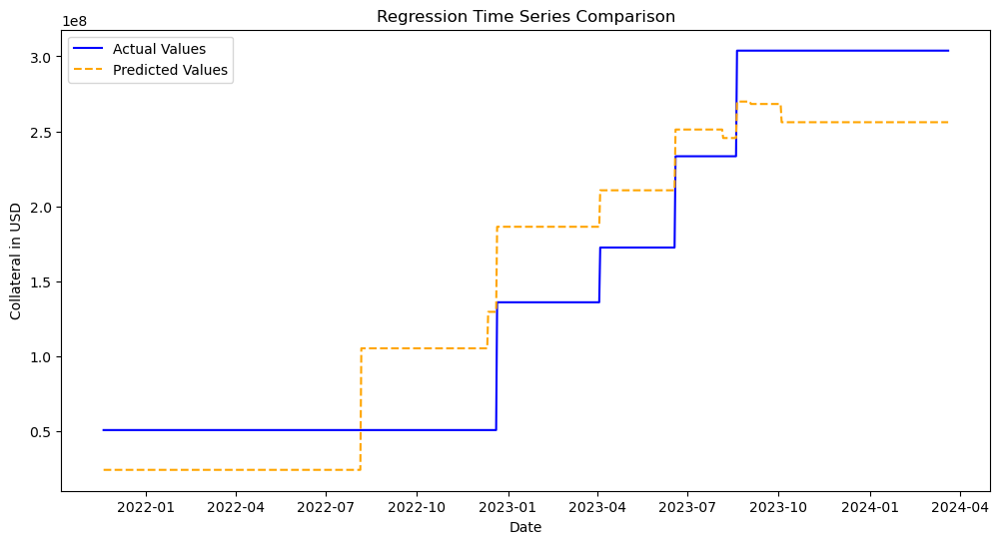

In [742]:
x_st = st_aggregated_vault_data['RWA Vault_dai_ceiling'].to_frame()
y_st = st_aggregated_vault_data['RWA Vault_collateral_usd']

X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)  # Assuming 'y' is your target variable

model_st = LinearRegression()
model_st.fit(X_train, y_train)

y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


Train MAE: 1782524.9360317925
Train R-squared: 0.9991326535074149
Test MAE: 1993010.0457025687
Test R-squared: 0.9986701460432788


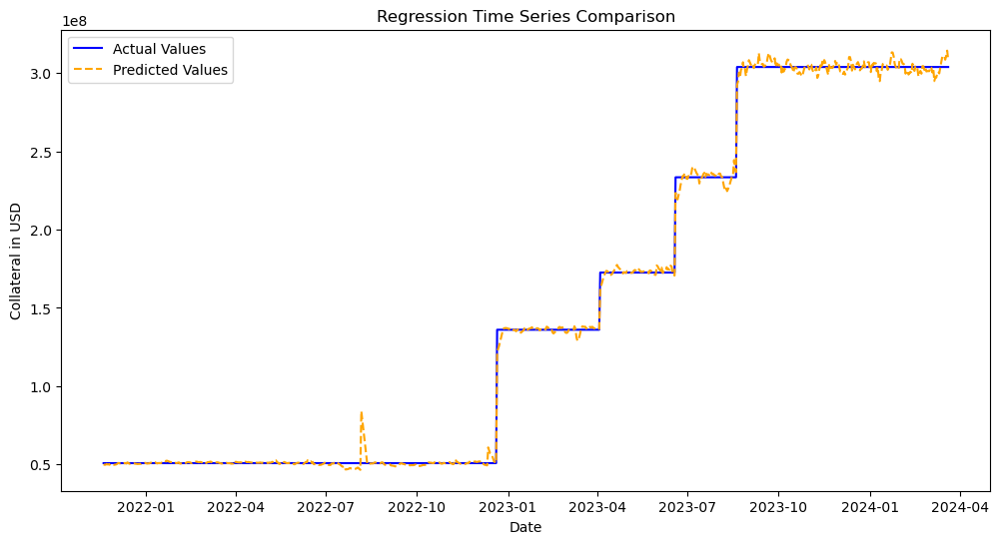

Cross-validated MAE scores: [7.083298454821949e-09, 18592512.626760576, 3063817.592170256, 3779287.122297542, 676938.138276909]
Cross-validated R-squared scores: [-2.8828828828828827, -0.27927927927928, 0.9431301148099286, 0.9558054782206459, -1.6884341709238847e+25]


In [743]:


# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['RWA Vault_dai_ceiling','RWA Vault_dai_ceiling_7d_ma', 'RWA Vault_collateral_usd_7d_ma', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total','RWA Vault_dart',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total','RWA Vault_collateral_usd % of Total_7d_ma','RWA Vault_collateral_usd % of Total_30d_ma',
       'PSM Vault_collateral_usd % of Total']]

y_st = st_aggregated_vault_data['RWA Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")

model_st = Ridge(alpha=4000.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

In [744]:







def to_sequences(X, y, time_steps=1):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:(i + time_steps)])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Load and prepare the dataset
#data = significant_spearman_df_no_collat.drop(columns=['eth_a_vault_cumulative_collateral'])

data_multi = st_aggregated_vault_data[['RWA Vault_dai_ceiling', 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]

target = st_aggregated_vault_data['RWA Vault_collateral_usd']

# performs .74 '3_m_tbill_yield','eth_a_vault_liquidation_ratio','debt_ratio_Lag_2m','dsr_rate','vc_revenue','dai_abs_deviation_30d_ma','b_s_DAI_30d_rolling_avg_pct_chg','M2V','psm_lifetime_fees'

# Ensure data is in the correct shape for scaling
if data_multi.ndim == 1:
    data_multi = data_multi.values.reshape(-1, 1)  # Reshape data to 2D if it's 1D
else:
    data_multi = data_multi.values

# Scale features and target
scaler_feature = MinMaxScaler(feature_range=(0, 1))
data_scaled_multi = scaler_feature.fit_transform(data_multi)
scaler_target = MinMaxScaler(feature_range=(0, 1))
target_scaled = scaler_target.fit_transform(target.values.reshape(-1, 1))

# Create sequences for LSTM
time_step = 15
X, y = to_sequences(data_scaled_multi, target_scaled, time_step)

# Split into train and test sets
train_size = int(len(X) * 0.67)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]


# Define the LSTM model with dropout and L2 regularization
model = Sequential([
    Input(shape=(X_train.shape[1], X_train.shape[2])),
    LSTM(45, return_sequences=True, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.08)),
    LSTM(20, dropout=0.2, recurrent_dropout=0.2, kernel_regularizer=l2(0.02)),
    Dense(1)
])
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')

# Implement early stopping
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Fit the model with early stopping
history = model.fit(
    X_train, y_train, epochs=100, batch_size=40,
    validation_data=(X_test, y_test), verbose=1, callbacks=[early_stopping]
)

# Predict on training and test data
train_predict = model.predict(X_train)
test_predict = model.predict(X_test)

# Inverse transform predictions and targets
train_predict_multi_inv = scaler_target.inverse_transform(train_predict)
test_predict_multi_inv = scaler_target.inverse_transform(test_predict)
y_train_multi_inv = scaler_target.inverse_transform(y_train.reshape(-1, 1))
y_test_multi_inv = scaler_target.inverse_transform(y_test.reshape(-1, 1))

# Calculate RMSE
train_rmse = np.sqrt(mean_squared_error(y_train_multi_inv, train_predict_multi_inv))
test_rmse = np.sqrt(mean_squared_error(y_test_multi_inv, test_predict_multi_inv))

# Calculate R-squared
train_r2 = r2_score(y_train_multi_inv, train_predict_multi_inv)
test_r2 = r2_score(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAE
train_mae = mean_absolute_error(y_train_multi_inv, train_predict_multi_inv)
test_mae = mean_absolute_error(y_test_multi_inv, test_predict_multi_inv)

# Calculate MAPE
train_mape = mean_absolute_percentage_error(y_train_multi_inv, train_predict_multi_inv)
test_mape = mean_absolute_percentage_error(y_test_multi_inv, test_predict_multi_inv)

# Output the metrics
print(f"Train RMSE: {train_rmse}, Test RMSE: {test_rmse}")
print(f"Train R²: {train_r2}, Test R²: {test_r2}")
print(f"Train MAE: {train_mae}, Test MAE: {test_mae}")
print(f"Train MAPE: {train_mape}%, Test MAPE: {test_mape}%")


Epoch 1/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 7s 61ms/step - loss: 2.4361 - val_loss: 2.2886
Epoch 2/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.9183 - val_loss: 1.8622
Epoch 3/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 1.5058 - val_loss: 1.4839
Epoch 4/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step - loss: 1.1690 - val_loss: 1.1913
Epoch 5/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.9040 - val_loss: 0.9282
Epoch 6/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.6968 - val_loss: 0.8064
Epoch 7/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.5336 - val_loss: 0.6222
Epoch 8/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - loss: 0.4064 - val_loss: 0.5244
Epoch 9/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.3091 - val_loss: 0.4425
Epoch 10/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.2352 - val_loss: 0.3724
Epoch 11/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - loss: 0.1770 - val_loss: 0.3473
Epoch 12/100
15/15 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step

## PSM Vault

<Axes: xlabel='day'>

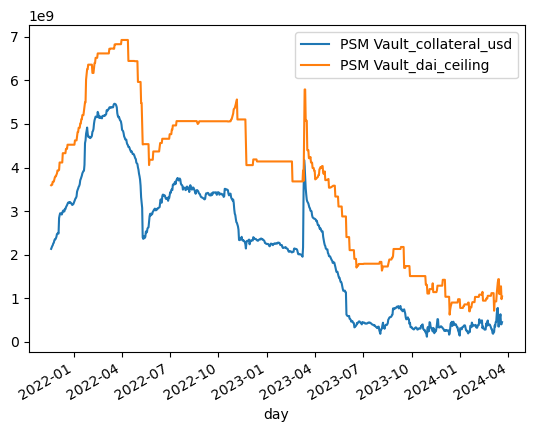

In [745]:
st_aggregated_vault_data[['PSM Vault_collateral_usd','PSM Vault_dai_ceiling']].plot()

In [746]:
for index, value in correlated_aggregated_psm_collateral_usd_sorted.items():
    print(f"{index:50} {value}")

PSM Vault_hypothetical_dai_ceiling                 1.0
PSM Vault_collateral_usd                           1.0
PSM Vault_hypothetical_dai_ceiling_7d_ma           0.997769001580042
PSM Vault_collateral_usd_7d_ma                     0.997769001580042
psm_balance                                        0.9869642556855206
PSM Vault_dart                                     0.9869642556855202
PSM Vault_debt_balance                             0.9869642556855202
PSM Vault_dart_7d_ma                               0.983279970694015
PSM Vault_debt_balance_7d_ma                       0.983279970694015
PSM Vault_collateral_usd_30d_ma                    0.982987851998603
PSM Vault_hypothetical_dai_ceiling_30d_ma          0.982987851998603
b_s_Stablecoins                                    0.97771345075203
b_s_Stablecoins_7d_rolling_avg                     0.9738898619941176
2.2 - Trading Assets                               0.9716156543007649
PSM Vault_dai_ceiling                              0.97082

Train MAE: 296035590.9794238
Train R-squared: 0.9488600722449351
Test MAE: 299174132.4559256
Test R-squared: 0.941759879053923


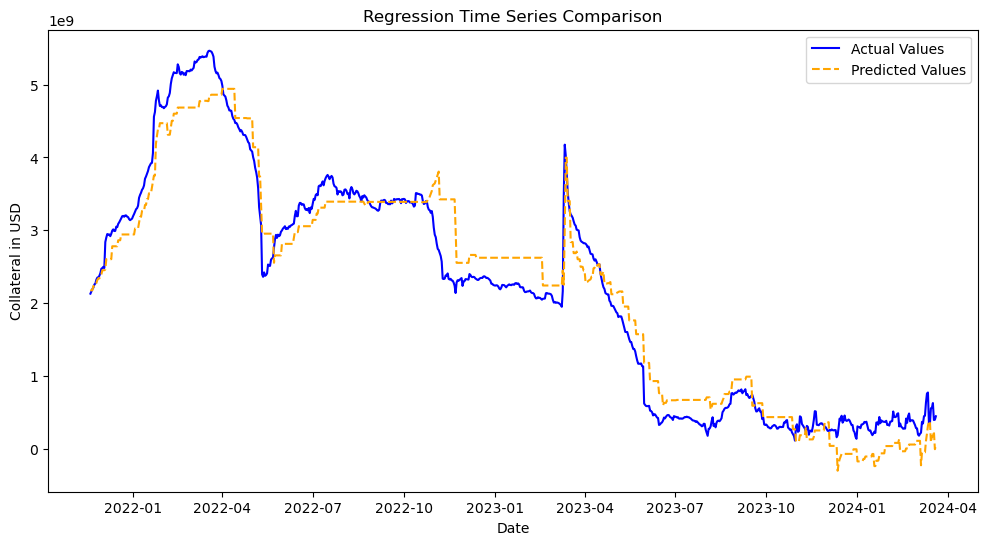

In [747]:
x_st = st_aggregated_vault_data['PSM Vault_dai_ceiling'].to_frame()
y_st = st_aggregated_vault_data['PSM Vault_collateral_usd']

X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)  # Assuming 'y' is your target variable




model_st = LinearRegression()
model_st.fit(X_train, y_train)

y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")


<Axes: xlabel='day'>

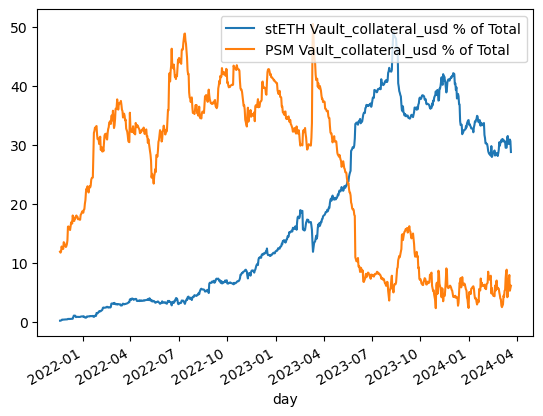

In [748]:
st_aggregated_vault_data[['stETH Vault_collateral_usd % of Total','PSM Vault_collateral_usd % of Total']].plot()

Train MAE: 41849211.095320195
Train R-squared: 0.998333225740126
Test MAE: 51461337.669040225
Test R-squared: 0.9971270080982297


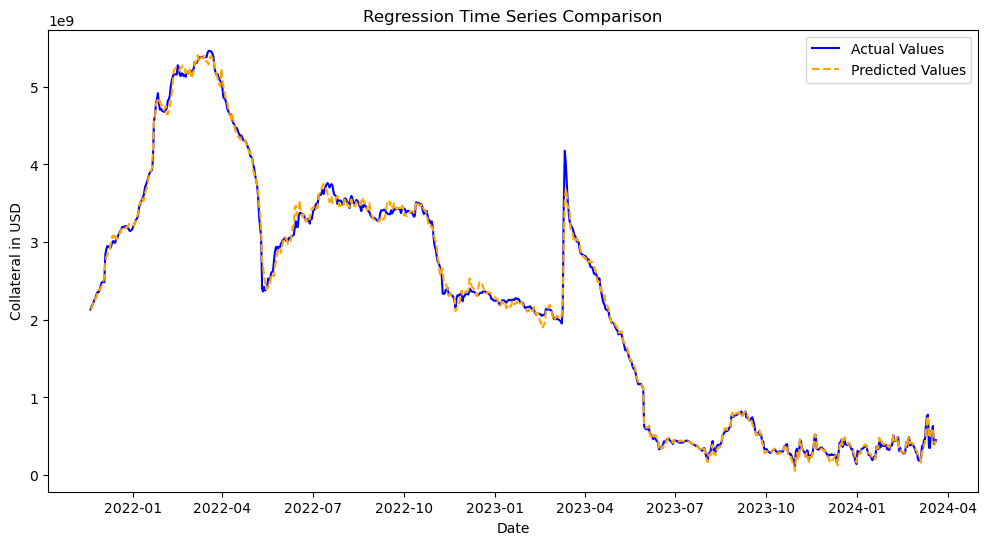

Cross-validated MAE scores: [113751538.99680921, 170805940.33060744, 76755108.89867395, 42846559.7725798, 37642455.310299054]
Cross-validated R-squared scores: [0.9222193909357127, 0.8398707196621855, 0.9541369006510033, 0.8916964423251184, 0.7787564807058799]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=2.60153e-19): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=2.05744e-19): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.44645e-19): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=8.8078e-20): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\sit

In [749]:



# Assuming 'st_aggregated_vault_data' contains your dataset

x_st = st_aggregated_vault_data[['PSM Vault_dai_ceiling','PSM Vault_dai_ceiling_7d_ma',
                                 
                                 'PSM Vault_collateral_usd_7d_ma',
                            
                                 'BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total',
       'stETH Vault_collateral_usd % of Total','where_is_dai_Bridge',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total','PSM Vault_collateral_usd % of Total_7d_ma','PSM Vault_collateral_usd % of Total_30d_ma']]

y_st = st_aggregated_vault_data['PSM Vault_collateral_usd']

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(x_st, y_st, test_size=0.2, random_state=42)

# Initialize the linear regression model
model_st = LinearRegression()

# Fit the model to the training data
model_st.fit(X_train, y_train)

# Predict on training and test sets
y_train_pred = model_st.predict(X_train)
y_test_pred = model_st.predict(X_test)

# Calculate MAE and R-squared for training set
mae_train = mean_absolute_error(y_train, y_train_pred)
r2_train = r2_score(y_train, y_train_pred)

# Calculate MAE and R-squared for test set
mae_test = mean_absolute_error(y_test, y_test_pred)
r2_test = r2_score(y_test, y_test_pred)

print("Train MAE:", mae_train)
print("Train R-squared:", r2_train)
print("Test MAE:", mae_test)
print("Test R-squared:", r2_test)

plot_single_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")
# Initialize the linear regression model
model_st = Ridge(alpha=200.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)

# LSTM Multivariate Cross Validation

In [750]:
list(dataset_no_nan.columns)

['eth_a_vault_cumulative_collateral',
 'eth_a_vault_safety_price',
 'eth_a_vault_usd_safety_value',
 'eth_a_vault_dai_ceiling',
 'eth_a_vault_dai_floor',
 'eth_a_vault_safety_collateral_ratio',
 'eth_a_vault_market_price',
 'eth_a_vault_debt_balance',
 'eth_a_vault_liquidation_penalty',
 'eth_a_vault_liquidation_ratio',
 'eth_a_vault_daily_revenues',
 'eth_a_vault_annualized stability fee',
 'eth_a_vault_annualized_revenues',
 'eth_a_vault_dart',
 'eth_a_vault_total_ann_revenues',
 'eth_a_vault_prev_dai_ceiling',
 'eth_a_vault_status',
 'eth_a_vault_market_collateral_ratio',
 'eth_a_vault_collateral_usd',
 'eth_a_vault_hypothetical_dai_ceiling',
 'eth_a_vault_total_open_ilk_count',
 'eth_a_vault_BTC Vault',
 'eth_a_vault_ETH Vault',
 'eth_a_vault_stETH Vault',
 'eth_a_vault_Stablecoin Vault',
 'eth_a_vault_Altcoin Vault',
 'eth_a_vault_LP Vault',
 'eth_a_vault_RWA Vault',
 'eth_a_vault_PSM Vault',
 'eth_a_vault_market_price_7d_ma',
 'eth_a_vault_cumulative_collateral_7d_ma',
 'eth_a_va

<Axes: xlabel='day'>

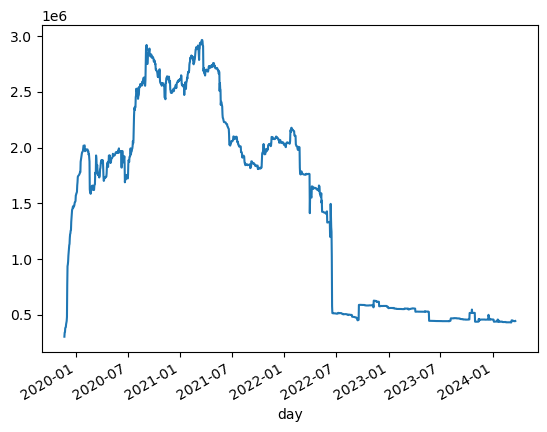

In [751]:
dataset_no_nan['eth_a_vault_cumulative_collateral'].plot()

# MVO

We will compare MVO with varying targets, including sharpe ratio, sortino ratio, and pure returns

## Sharpe ratios

In [752]:
portfolio = aggregated_vault_data[['BTC Vault_collateral_usd','ETH Vault_collateral_usd','stETH Vault_collateral_usd','Stablecoin Vault_collateral_usd'
                  ,'Altcoin Vault_collateral_usd','LP Vault_collateral_usd','RWA Vault_collateral_usd','PSM Vault_collateral_usd']]

In [753]:
portfolio = portfolio[portfolio.index > '2021-11-18']
portfolio

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,"2,866,222,769.09959","11,530,810,569.93515","39,769,944.75450","336,521,697.42675","520,045,444.90519","412,562,137.86644","50,870,409.00000","2,132,251,251.20941"
2021-11-20 00:00:00+00:00,"2,948,959,833.37399","11,943,278,353.68762","41,280,230.12684","336,521,697.42675","508,972,390.70129","430,562,322.97248","50,870,409.00000","2,164,546,578.27289"
2021-11-21 00:00:00+00:00,"2,951,818,107.21472","11,839,472,041.02766","48,477,796.29037","336,521,697.42675","505,016,705.04971","431,500,082.06578","50,870,409.00000","2,195,743,029.10143"
2021-11-22 00:00:00+00:00,"2,788,017,226.13774","10,933,452,742.14960","59,724,075.18165","336,503,182.74675","509,504,043.07337","433,806,450.38492","50,870,409.00000","2,215,601,174.20796"
2021-11-23 00:00:00+00:00,"2,821,788,807.21326","11,600,116,135.99997","74,570,808.78308","336,503,182.74675","500,427,709.74620","432,619,037.81609","50,870,409.00000","2,258,244,677.18063"
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,"693,532,316.12871","3,752,247,535.61763","2,417,541,115.80447","99,227.46740","1,944,419.59103","97,377,612.28187","303,771,975.92692","567,092,988.70479"
2024-03-17 00:00:00+00:00,"706,205,158.85654","3,803,584,313.35047","2,393,113,805.45610","99,227.46740","1,944,419.59103","97,379,575.13498","303,771,975.92692","631,684,264.91900"
2024-03-18 00:00:00+00:00,"700,133,609.78409","3,703,955,421.92055","2,328,357,914.39336","99,227.46740","1,944,419.59103","97,380,556.52498","303,771,975.92692","399,224,583.39463"


From 2020-12-29 through 2021-01-02 there is one stablecoin in the psm vault, on 2021-01-03 the balance jumps to 2964388.545068.  This skews returns for this vault, so decided to replace 1 with 0 for more accurate returns.  The 1 was likely a test.

portfolio['PSM Vault_collateral_usd'].replace(1.0, 0.0)

In [754]:
portfolio 

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,"2,866,222,769.09959","11,530,810,569.93515","39,769,944.75450","336,521,697.42675","520,045,444.90519","412,562,137.86644","50,870,409.00000","2,132,251,251.20941"
2021-11-20 00:00:00+00:00,"2,948,959,833.37399","11,943,278,353.68762","41,280,230.12684","336,521,697.42675","508,972,390.70129","430,562,322.97248","50,870,409.00000","2,164,546,578.27289"
2021-11-21 00:00:00+00:00,"2,951,818,107.21472","11,839,472,041.02766","48,477,796.29037","336,521,697.42675","505,016,705.04971","431,500,082.06578","50,870,409.00000","2,195,743,029.10143"
2021-11-22 00:00:00+00:00,"2,788,017,226.13774","10,933,452,742.14960","59,724,075.18165","336,503,182.74675","509,504,043.07337","433,806,450.38492","50,870,409.00000","2,215,601,174.20796"
2021-11-23 00:00:00+00:00,"2,821,788,807.21326","11,600,116,135.99997","74,570,808.78308","336,503,182.74675","500,427,709.74620","432,619,037.81609","50,870,409.00000","2,258,244,677.18063"
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,"693,532,316.12871","3,752,247,535.61763","2,417,541,115.80447","99,227.46740","1,944,419.59103","97,377,612.28187","303,771,975.92692","567,092,988.70479"
2024-03-17 00:00:00+00:00,"706,205,158.85654","3,803,584,313.35047","2,393,113,805.45610","99,227.46740","1,944,419.59103","97,379,575.13498","303,771,975.92692","631,684,264.91900"
2024-03-18 00:00:00+00:00,"700,133,609.78409","3,703,955,421.92055","2,328,357,914.39336","99,227.46740","1,944,419.59103","97,380,556.52498","303,771,975.92692","399,224,583.39463"


In [755]:
portfolio.columns

Index(['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd',
       'stETH Vault_collateral_usd', 'Stablecoin Vault_collateral_usd',
       'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd',
       'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd'],
      dtype='object')

In [756]:
returns = portfolio.pct_change()
returns.replace([np.inf, -np.inf], np.nan, inplace=True)

returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-11-20 00:00:00+00:00,0.02887,0.03577,0.03798,0.00000,-0.02129,0.04363,-0.00000,0.01515
2021-11-21 00:00:00+00:00,0.00097,-0.00869,0.17436,0.00000,-0.00777,0.00218,0.00000,0.01441
2021-11-22 00:00:00+00:00,-0.05549,-0.07653,0.23199,-0.00006,0.00889,0.00535,0.00000,0.00904
2021-11-23 00:00:00+00:00,0.01211,0.06097,0.24859,0.00000,-0.01781,-0.00274,0.00000,0.01925
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02211,-0.02931,0.00770,0.00000,0.00000,0.00003,0.00000,0.01217
2024-03-17 00:00:00+00:00,0.01827,0.01368,-0.01010,0.00000,0.00000,0.00002,0.00000,0.11390
2024-03-18 00:00:00+00:00,-0.00860,-0.02619,-0.02706,-0.00000,0.00000,0.00001,0.00000,-0.36800


In [757]:
returns.fillna(0, inplace=True)


In [758]:
returns.isna().sum().sum()

0

In [759]:
returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02887,0.03577,0.03798,0.00000,-0.02129,0.04363,-0.00000,0.01515
2021-11-21 00:00:00+00:00,0.00097,-0.00869,0.17436,0.00000,-0.00777,0.00218,0.00000,0.01441
2021-11-22 00:00:00+00:00,-0.05549,-0.07653,0.23199,-0.00006,0.00889,0.00535,0.00000,0.00904
2021-11-23 00:00:00+00:00,0.01211,0.06097,0.24859,0.00000,-0.01781,-0.00274,0.00000,0.01925
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02211,-0.02931,0.00770,0.00000,0.00000,0.00003,0.00000,0.01217
2024-03-17 00:00:00+00:00,0.01827,0.01368,-0.01010,0.00000,0.00000,0.00002,0.00000,0.11390
2024-03-18 00:00:00+00:00,-0.00860,-0.02619,-0.02706,-0.00000,0.00000,0.00001,0.00000,-0.36800


In [760]:
returns['PSM Vault_collateral_usd'].describe()

count   854.00000
mean      0.00389
std       0.11954
min      -0.54546
25%      -0.01326
50%      -0.00144
75%       0.00904
max       1.67512
Name: PSM Vault_collateral_usd, dtype: float64

In [761]:
# Calculate covariance matrix and mean returns
covariance_matrix = returns.cov()
mean_returns = returns.mean()

In [762]:
covariance_matrix

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
BTC Vault_collateral_usd,0.00689,0.00057,0.00060,0.00003,0.00038,-0.00002,-0.00000,-0.00004
ETH Vault_collateral_usd,0.00057,0.00155,0.00119,-0.00009,0.00049,0.00006,0.00001,-0.00009
stETH Vault_collateral_usd,0.00060,0.00119,0.00298,-0.00013,0.00042,-0.00007,-0.00006,-0.00003
Stablecoin Vault_collateral_usd,0.00003,-0.00009,-0.00013,0.00243,0.00001,0.00001,0.00001,0.00004
Altcoin Vault_collateral_usd,0.00038,0.00049,0.00042,0.00001,0.00300,0.00014,0.00000,-0.00045
LP Vault_collateral_usd,-0.00002,0.00006,-0.00007,0.00001,0.00014,0.00210,-0.00014,-0.00014
RWA Vault_collateral_usd,-0.00000,0.00001,-0.00006,0.00001,0.00000,-0.00014,0.00361,0.00003
PSM Vault_collateral_usd,-0.00004,-0.00009,-0.00003,0.00004,-0.00045,-0.00014,0.00003,0.01429


In [763]:
mean_returns 

BTC Vault_collateral_usd           0.00092
ETH Vault_collateral_usd          -0.00054
stETH Vault_collateral_usd         0.00607
Stablecoin Vault_collateral_usd   -0.00353
Altcoin Vault_collateral_usd      -0.00387
LP Vault_collateral_usd           -0.00068
RWA Vault_collateral_usd           0.00304
PSM Vault_collateral_usd           0.00389
dtype: float64

In [764]:
#This gets sharpe ratio for each individual vault, not considering correlations between assets


# Assume risk-free rate is close to 0 for simplification in the crypto context
risk_free_rate = 0.00

# Calculate daily returns


# Calculate mean returns and standard deviation of returns
mean_daily_returns = returns.mean()
std_daily_returns = returns.std()

# Annualize the mean returns and standard deviation
annual_mean_returns = mean_daily_returns * 365  # 365 days, assuming daily data
annual_std_returns = std_daily_returns * np.sqrt(365)  # Square root of days to annualize

# Calculate Sharpe Ratio for each asset
non_cov_sharpe_ratios = (annual_mean_returns - risk_free_rate) / annual_std_returns

# Display the Sharpe ratios
print("Sharpe Ratios for each asset:")
print(non_cov_sharpe_ratios)


Sharpe Ratios for each asset:
BTC Vault_collateral_usd           0.21283
ETH Vault_collateral_usd          -0.26434
stETH Vault_collateral_usd         2.12287
Stablecoin Vault_collateral_usd   -1.36707
Altcoin Vault_collateral_usd      -1.35068
LP Vault_collateral_usd           -0.28563
RWA Vault_collateral_usd           0.96640
PSM Vault_collateral_usd           0.62239
dtype: float64


In [765]:
#We can see, not considering covariance, stETH vault has generated highest return

In [766]:
aggregated_vaults.columns

Index(['day', 'BTC Vault_dai_ceiling', 'BTC Vault_dai_floor',
       'BTC Vault_debt_balance', 'BTC Vault_daily_revenues',
       'BTC Vault_annualized_revenues', 'BTC Vault_dart',
       'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd',
       'BTC Vault_hypothetical_dai_ceiling',
       ...
       'b_s_DSR_30d_rolling_avg_pct_chg', 'b_s_DSR_30d_volatility_pct_chg',
       'b_s_Equity_30d_rolling_avg_pct_chg',
       'b_s_Equity_30d_volatility_pct_chg',
       'b_s_Others_assets_30d_rolling_avg_pct_chg',
       'b_s_Others_assets_30d_volatility_pct_chg',
       'b_s_Real-World_Assets_30d_rolling_avg_pct_chg',
       'b_s_Real-World_Assets_30d_volatility_pct_chg',
       'b_s_Stablecoins_30d_rolling_avg_pct_chg',
       'b_s_Stablecoins_30d_volatility_pct_chg'],
      dtype='object', length=2157)

In [767]:
#Now we look at returns and variance based on solely the market price, not usd value of vaults 

In [768]:
portfolio_market_prices = aggregated_vaults[['day','BTC Vault_market_price','ETH Vault_market_price','stETH Vault_market_price','Stablecoin Vault_market_price'
                  ,'Altcoin Vault_market_price','LP Vault_market_price','RWA Vault_market_price','PSM Vault_market_price']]
portfolio_market_prices.set_index('day',inplace=True)

In [769]:
portfolio_market_prices = portfolio_market_prices[portfolio_market_prices.index > '2021-11-18']

In [770]:
portfolio_market_prices['LP Vault_market_price'].describe()

count           853.00000
mean     39,649,942.34046
std     114,659,039.33535
min               0.00000
25%               0.00000
50%         997,723.83205
75%       3,116,664.23331
max     561,812,824.67343
Name: LP Vault_market_price, dtype: float64

In [771]:
market_price_returns = portfolio_market_prices.pct_change()
market_price_returns['LP Vault_market_price'].describe()

count   607.00000
mean     -0.00651
std       0.10042
min      -1.00000
25%      -0.01284
50%       0.00000
75%       0.00839
max       0.56092
Name: LP Vault_market_price, dtype: float64

In [772]:
market_price_returns['LP Vault_market_price'].fillna(0).describe()

count   853.00000
mean     -0.00463
std       0.08474
min      -1.00000
25%      -0.00156
50%       0.00000
75%       0.00102
max       0.56092
Name: LP Vault_market_price, dtype: float64

In [773]:
market_price_returns.replace([np.inf, -np.inf], np.nan, inplace=True)
market_price_returns['LP Vault_market_price'].describe()

count   607.00000
mean     -0.00651
std       0.10042
min      -1.00000
25%      -0.01284
50%       0.00000
75%       0.00839
max       0.56092
Name: LP Vault_market_price, dtype: float64

In [774]:
market_price_returns.fillna(0, inplace=True)
market_price_returns

,BTC Vault_market_price,ETH Vault_market_price,stETH Vault_market_price,Stablecoin Vault_market_price,Altcoin Vault_market_price,LP Vault_market_price,RWA Vault_market_price,PSM Vault_market_price
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02449,0.03569,0.02052,0.00000,-0.02220,-0.00468,-0.00000,0.00000
2021-11-21 00:00:00+00:00,-0.00135,-0.00822,0.00216,0.00000,0.08725,-0.00926,0.00000,0.00000
2021-11-22 00:00:00+00:00,-0.04786,-0.07087,-0.02954,0.00000,-0.00169,-0.00879,0.00000,0.00000
2021-11-23 00:00:00+00:00,0.01171,0.06008,0.01902,0.00000,-0.02019,-0.02564,0.00000,0.00000
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.01942,-0.01991,0.00426,0.00000,0.00000,0.00000,0.00000,0.00000
2024-03-17 00:00:00+00:00,0.01772,0.01571,-0.01056,0.00000,0.00000,0.00000,0.00000,0.00000
2024-03-18 00:00:00+00:00,-0.00920,-0.02563,-0.02717,0.00000,0.00000,0.00000,0.00000,0.00000


In [775]:
# Calculate covariance matrix and mean returns for each weighted average market price 
mp_covariance_matrix = market_price_returns.cov()
mp_mean_returns = market_price_returns.mean()
mp_mean_returns

BTC Vault_market_price           0.00057
ETH Vault_market_price           0.00042
stETH Vault_market_price         0.00059
Stablecoin Vault_market_price   -0.00117
Altcoin Vault_market_price       0.09536
LP Vault_market_price           -0.00463
RWA Vault_market_price           0.00344
PSM Vault_market_price           0.00000
dtype: float64

In [776]:
mp_covariance_matrix

,BTC Vault_market_price,ETH Vault_market_price,stETH Vault_market_price,Stablecoin Vault_market_price,Altcoin Vault_market_price,LP Vault_market_price,RWA Vault_market_price,PSM Vault_market_price
BTC Vault_market_price,0.00082,0.00082,0.00082,-0.00000,0.00083,0.00038,0.00001,0.00000
ETH Vault_market_price,0.00082,0.00131,0.00122,-0.00001,0.00171,0.00036,-0.00001,0.00000
stETH Vault_market_price,0.00082,0.00122,0.00143,-0.00001,0.00139,0.00041,-0.00001,0.00000
Stablecoin Vault_market_price,-0.00000,-0.00001,-0.00001,0.00117,0.00015,-0.00020,0.00000,0.00000
Altcoin Vault_market_price,0.00083,0.00171,0.00139,0.00015,4.68799,0.00590,-0.00039,0.00000
LP Vault_market_price,0.00038,0.00036,0.00041,-0.00020,0.00590,0.00718,0.00001,0.00000
RWA Vault_market_price,0.00001,-0.00001,-0.00001,0.00000,-0.00039,0.00001,0.00716,0.00000
PSM Vault_market_price,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000


In [777]:
# Sharpe ratios based on market price, accounting for covariance 
individual_volatilities = np.sqrt(np.diag(mp_covariance_matrix))

# Individual Sharpe ratios
asset_sharpe_ratios = (mp_mean_returns - risk_free_rate) / individual_volatilities
print("Individual Sharpe Ratios:\n", asset_sharpe_ratios)


Individual Sharpe Ratios:
 BTC Vault_market_price           0.02001
ETH Vault_market_price           0.01170
stETH Vault_market_price         0.01550
Stablecoin Vault_market_price   -0.03424
Altcoin Vault_market_price       0.04404
LP Vault_market_price           -0.05466
RWA Vault_market_price           0.04070
PSM Vault_market_price               NaN
dtype: float64


In [778]:
#calculate avaerage composition for each asset historically, use that as bound for psm/rwa/stablecoin weightings 

composition = aggregated_vaults[['day','BTC Vault_collateral_usd % of Total',
       'ETH Vault_collateral_usd % of Total',
       'stETH Vault_collateral_usd % of Total',
       'Stablecoin Vault_collateral_usd % of Total',
       'Altcoin Vault_collateral_usd % of Total',
       'LP Vault_collateral_usd % of Total',
       'RWA Vault_collateral_usd % of Total',
       'PSM Vault_collateral_usd % of Total']]


In [779]:
composition.set_index('day', inplace=True)
composition

,BTC Vault_collateral_usd % of Total,ETH Vault_collateral_usd % of Total,stETH Vault_collateral_usd % of Total,Stablecoin Vault_collateral_usd % of Total,Altcoin Vault_collateral_usd % of Total,LP Vault_collateral_usd % of Total,RWA Vault_collateral_usd % of Total,PSM Vault_collateral_usd % of Total
day,,,,,,,,
2019-11-18 00:00:00+00:00,0.00000,100.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2019-11-19 00:00:00+00:00,0.00000,96.93245,0.00000,0.00000,3.06755,0.00000,0.00000,0.00000
2019-11-20 00:00:00+00:00,0.00000,97.77632,0.00000,0.00000,2.22368,0.00000,0.00000,0.00000
2019-11-21 00:00:00+00:00,0.00000,98.24848,0.00000,0.00000,1.75152,0.00000,0.00000,0.00000
2019-11-22 00:00:00+00:00,0.00000,97.41017,0.00000,0.00000,2.58983,0.00000,0.00000,0.00000
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,8.85329,47.89936,30.86115,0.00127,0.02482,1.24307,3.87780,7.23923
2024-03-17 00:00:00+00:00,8.89676,47.91747,30.14839,0.00125,0.02450,1.22679,3.82691,7.95794
2024-03-18 00:00:00+00:00,9.29192,49.15754,30.90111,0.00132,0.02581,1.29240,4.03155,5.29836


In [780]:
composition = composition[composition.index > '2021-11-18']
composition = composition / 100
composition

,BTC Vault_collateral_usd % of Total,ETH Vault_collateral_usd % of Total,stETH Vault_collateral_usd % of Total,Stablecoin Vault_collateral_usd % of Total,Altcoin Vault_collateral_usd % of Total,LP Vault_collateral_usd % of Total,RWA Vault_collateral_usd % of Total,PSM Vault_collateral_usd % of Total
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.16022,0.64457,0.00222,0.01881,0.02907,0.02306,0.00284,0.11919
2021-11-20 00:00:00+00:00,0.16005,0.64821,0.00224,0.01826,0.02762,0.02337,0.00276,0.11748
2021-11-21 00:00:00+00:00,0.16078,0.64487,0.00264,0.01833,0.02751,0.02350,0.00277,0.11960
2021-11-22 00:00:00+00:00,0.16090,0.63099,0.00345,0.01942,0.02940,0.02504,0.00294,0.12787
2021-11-23 00:00:00+00:00,0.15611,0.64177,0.00413,0.01862,0.02769,0.02393,0.00281,0.12494
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,0.08853,0.47899,0.30861,0.00001,0.00025,0.01243,0.03878,0.07239
2024-03-17 00:00:00+00:00,0.08897,0.47917,0.30148,0.00001,0.00024,0.01227,0.03827,0.07958
2024-03-18 00:00:00+00:00,0.09292,0.49158,0.30901,0.00001,0.00026,0.01292,0.04032,0.05298


In [781]:
historical_bounds = composition.mean()
historical_bounds

latest_composition = composition.iloc[-1]
latest_composition

BTC Vault_collateral_usd % of Total          0.09394
ETH Vault_collateral_usd % of Total          0.50203
stETH Vault_collateral_usd % of Total        0.28786
Stablecoin Vault_collateral_usd % of Total   0.00001
Altcoin Vault_collateral_usd % of Total      0.00026
LP Vault_collateral_usd % of Total           0.01314
RWA Vault_collateral_usd % of Total          0.04137
PSM Vault_collateral_usd % of Total          0.06138
Name: 2024-03-20 00:00:00+00:00, dtype: float64

In [782]:
returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02887,0.03577,0.03798,0.00000,-0.02129,0.04363,-0.00000,0.01515
2021-11-21 00:00:00+00:00,0.00097,-0.00869,0.17436,0.00000,-0.00777,0.00218,0.00000,0.01441
2021-11-22 00:00:00+00:00,-0.05549,-0.07653,0.23199,-0.00006,0.00889,0.00535,0.00000,0.00904
2021-11-23 00:00:00+00:00,0.01211,0.06097,0.24859,0.00000,-0.01781,-0.00274,0.00000,0.01925
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02211,-0.02931,0.00770,0.00000,0.00000,0.00003,0.00000,0.01217
2024-03-17 00:00:00+00:00,0.01827,0.01368,-0.01010,0.00000,0.00000,0.00002,0.00000,0.11390
2024-03-18 00:00:00+00:00,-0.00860,-0.02619,-0.02706,-0.00000,0.00000,0.00001,0.00000,-0.36800


In [783]:
composition.columns = returns.columns

In [784]:
print("Returns columns:", returns.columns)
print("Covariance matrix columns:", covariance_matrix.columns)
print("Composition columns:", composition.columns)

Returns columns: Index(['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd',
       'stETH Vault_collateral_usd', 'Stablecoin Vault_collateral_usd',
       'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd',
       'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd'],
      dtype='object')
Covariance matrix columns: Index(['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd',
       'stETH Vault_collateral_usd', 'Stablecoin Vault_collateral_usd',
       'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd',
       'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd'],
      dtype='object')
Composition columns: Index(['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd',
       'stETH Vault_collateral_usd', 'Stablecoin Vault_collateral_usd',
       'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd',
       'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd'],
      dtype='object')


In [785]:
print("Composition shape:", composition.shape)
print("Covariance matrix shape:", covariance_matrix.shape)

Composition shape: (853, 8)
Covariance matrix shape: (8, 8)


In [786]:


# Assume returns and composition are already loaded DataFrames
# Calculate daily portfolio returns
daily_portfolio_returns = (returns * composition).sum(axis=1)

# Calculate mean return and standard deviation of portfolio returns
mean_portfolio_return = daily_portfolio_returns.mean()
std_dev_portfolio = daily_portfolio_returns.std()

# Define the risk-free rate (annualized if your returns are daily)
# Example: 0.5% annualized risk-free rate
risk_free_rate = 0

# Calculate the Sharpe Ratio
sharpe_ratio = (mean_portfolio_return - risk_free_rate) / std_dev_portfolio

print("Mean Portfolio Return:",mean_portfolio_return)
print("Standard Deviation of Portfolio:", std_dev_portfolio)
print("Portfolio Sharpe Ratio:", sharpe_ratio)


Mean Portfolio Return: 0.0010769774032340722
Standard Deviation of Portfolio: 0.026960595769615306
Portfolio Sharpe Ratio: 0.03994635031202945


<Axes: xlabel='day'>

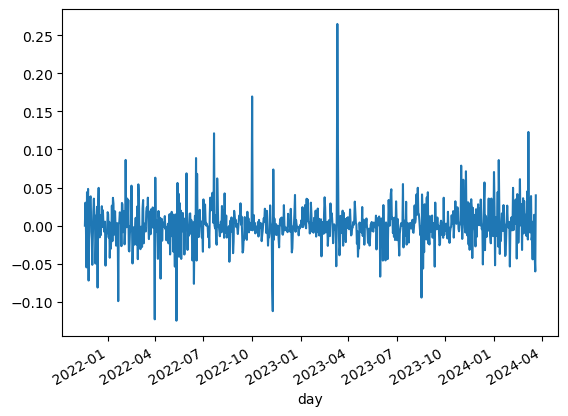

In [787]:
daily_portfolio_returns.plot()

In [788]:
#Now we calculate weights targeting best sharpe ratio



# Number of assets
num_assets = len(portfolio.columns)

# Calculate returns and covariance
mean_returns = returns.mean()
covariance_matrix = returns.cov()

# Objective function (Minimize risk for a given return)
def objective(weights): 
    return - (weights.T @ mean_returns) / (np.sqrt(weights.T @ covariance_matrix @ weights))  # Negative Sharpe Ratio for minimization

# Constraints
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})  # Sum of weights must be 1

# Bounds with custom limits
bounds = [(0.1, 1), (0.1, 1), (0.1, 1), (0, 0.2), (0.05, 0.25), (0.1, 1), (0, 0.02), (0.05, 0.16)]
# Adjusted bounds to prioritize certain assets:
# BTC, ETH, stETH, LP: Minimum 10%, no maximum (up to 1 or 100%)
# Stablecoin, RWA: Maximum 20%
# Altcoin, PSM: Moderate flexibility with a minimum of 5% and a maximum of 25%

# Initial guess
initial_weights = np.array(num_assets * [1. / num_assets,])  # Equal weight for start

# Minimize the objective function
opt_result = minimize(objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints)

# Output the results
if opt_result.success:
    sharpe_optimal_weights = opt_result.x
    print("Adjusted Optimal Weights:", sharpe_optimal_weights)
else:
    print("Optimization failed:", opt_result.message)


Adjusted Optimal Weights: [0.1        0.1        0.55436566 0.         0.05       0.1
 0.02       0.07563434]


In [789]:
# Calculate portfolio standard deviation (volatility)
optimized_portfolio_std_dev = np.sqrt(sharpe_optimal_weights.T @ covariance_matrix @ sharpe_optimal_weights)

# Calculate portfolio return
optimized_portfolio_return = sharpe_optimal_weights.T @ mean_returns

# Risk-free rate assumption (can be set to a fixed value, e.g., 0 if not provided)
risk_free_rate = 0

# Calculate portfolio Sharpe ratio
optimized_portfolio_sharpe_ratio = (optimized_portfolio_return) / optimized_portfolio_std_dev
print("Optimized Portfolio Return:", optimized_portfolio_return)
print("Optimized Portfolio Standard Deviation:", optimized_portfolio_std_dev)
print("Optimized Portfolio Sharpe Ratio:", optimized_portfolio_sharpe_ratio)


Optimized Portfolio Return: 0.0034939628323667946
Optimized Portfolio Standard Deviation: 0.03655734971548218
Optimized Portfolio Sharpe Ratio: 0.09557483952090454


In [790]:
# Individual vault sharpe ratios
individual_volatilities = np.sqrt(np.diag(covariance_matrix))

# Individual Sharpe ratios
vault_sharpe_ratios = (mean_returns - risk_free_rate) / individual_volatilities
print("Individual Sharpe Ratios:\n", vault_sharpe_ratios)


Individual Sharpe Ratios:
 BTC Vault_collateral_usd           0.01114
ETH Vault_collateral_usd          -0.01384
stETH Vault_collateral_usd         0.11112
Stablecoin Vault_collateral_usd   -0.07156
Altcoin Vault_collateral_usd      -0.07070
LP Vault_collateral_usd           -0.01495
RWA Vault_collateral_usd           0.05058
PSM Vault_collateral_usd           0.03258
dtype: float64


In [791]:
# individual asset sharpe ratios (based on market price)

asset_sharpe_ratios.fillna(0, inplace=True)
asset_sharpe_ratios

BTC Vault_market_price           0.02001
ETH Vault_market_price           0.01170
stETH Vault_market_price         0.01550
Stablecoin Vault_market_price   -0.03424
Altcoin Vault_market_price       0.04404
LP Vault_market_price           -0.05466
RWA Vault_market_price           0.04070
PSM Vault_market_price           0.00000
dtype: float64

## Sortino Ratio

In [792]:
returns


,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02887,0.03577,0.03798,0.00000,-0.02129,0.04363,-0.00000,0.01515
2021-11-21 00:00:00+00:00,0.00097,-0.00869,0.17436,0.00000,-0.00777,0.00218,0.00000,0.01441
2021-11-22 00:00:00+00:00,-0.05549,-0.07653,0.23199,-0.00006,0.00889,0.00535,0.00000,0.00904
2021-11-23 00:00:00+00:00,0.01211,0.06097,0.24859,0.00000,-0.01781,-0.00274,0.00000,0.01925
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02211,-0.02931,0.00770,0.00000,0.00000,0.00003,0.00000,0.01217
2024-03-17 00:00:00+00:00,0.01827,0.01368,-0.01010,0.00000,0.00000,0.00002,0.00000,0.11390
2024-03-18 00:00:00+00:00,-0.00860,-0.02619,-0.02706,-0.00000,0.00000,0.00001,0.00000,-0.36800


In [793]:
composition 

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.16022,0.64457,0.00222,0.01881,0.02907,0.02306,0.00284,0.11919
2021-11-20 00:00:00+00:00,0.16005,0.64821,0.00224,0.01826,0.02762,0.02337,0.00276,0.11748
2021-11-21 00:00:00+00:00,0.16078,0.64487,0.00264,0.01833,0.02751,0.02350,0.00277,0.11960
2021-11-22 00:00:00+00:00,0.16090,0.63099,0.00345,0.01942,0.02940,0.02504,0.00294,0.12787
2021-11-23 00:00:00+00:00,0.15611,0.64177,0.00413,0.01862,0.02769,0.02393,0.00281,0.12494
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,0.08853,0.47899,0.30861,0.00001,0.00025,0.01243,0.03878,0.07239
2024-03-17 00:00:00+00:00,0.08897,0.47917,0.30148,0.00001,0.00024,0.01227,0.03827,0.07958
2024-03-18 00:00:00+00:00,0.09292,0.49158,0.30901,0.00001,0.00026,0.01292,0.04032,0.05298


### Portfolio Sortino Ratio

In [794]:

# Annual risk-free rate
annual_risk_free_rate = 0.05

# Convert to daily risk-free rate
daily_risk_free_rate = (1 + annual_risk_free_rate)**(1/365) - 1

# Now use this daily rate in your calculations
# Assuming you use it as the Minimum Acceptable Return (MAR)
MAR = daily_risk_free_rate  # This could also be set to zero if you're only measuring against downside deviation

# Ensure that 'returns' and 'composition' are aligned and sorted by 'day'
returns.sort_index(inplace=True)
composition.sort_index(inplace=True)

# Calculate daily portfolio returns by weighting the returns by their composition percentages
portfolio_daily_returns = (returns * composition).sum(axis=1)

# Excess returns and downside deviation
excess_returns = portfolio_daily_returns - MAR
downside_returns = excess_returns[excess_returns < 0]  # Only consider negative excess returns for downside deviation

# Calculate downside deviation and average excess returns
downside_deviation = np.sqrt((downside_returns**2).mean())
average_excess_return = excess_returns.mean()

# Calculate Sortino Ratio
portfolio_sortino_ratio = average_excess_return / downside_deviation if downside_deviation != 0 else np.inf

print('Daily Risk-Free Rate:', daily_risk_free_rate)
print('Minimum Acceptable Return (MAR):', MAR)
print('Average Excess Return:', average_excess_return)
print('Downside Deviation:', downside_deviation)
print("Portfolio Sortino Ratio:", portfolio_sortino_ratio)

Daily Risk-Free Rate: 0.00013368061711349633
Minimum Acceptable Return (MAR): 0.00013368061711349633
Average Excess Return: 0.000943296786120576
Downside Deviation: 0.02443108737042727
Portfolio Sortino Ratio: 0.03861051175570655


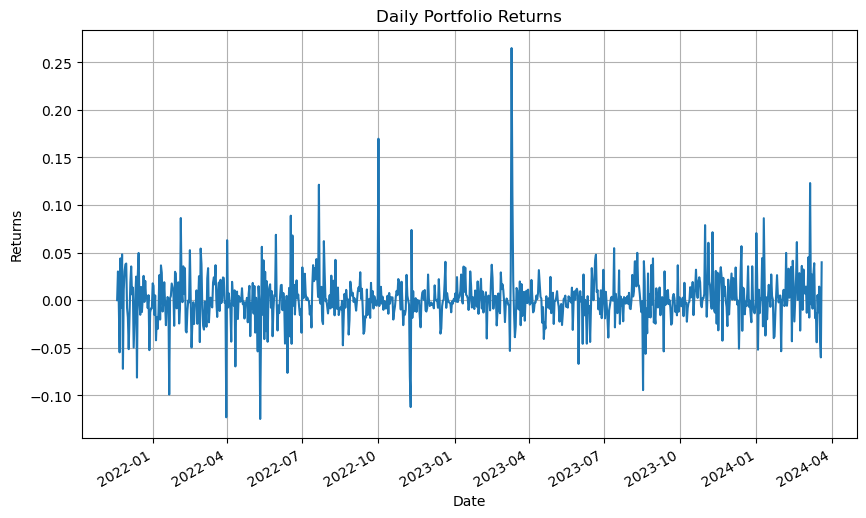

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


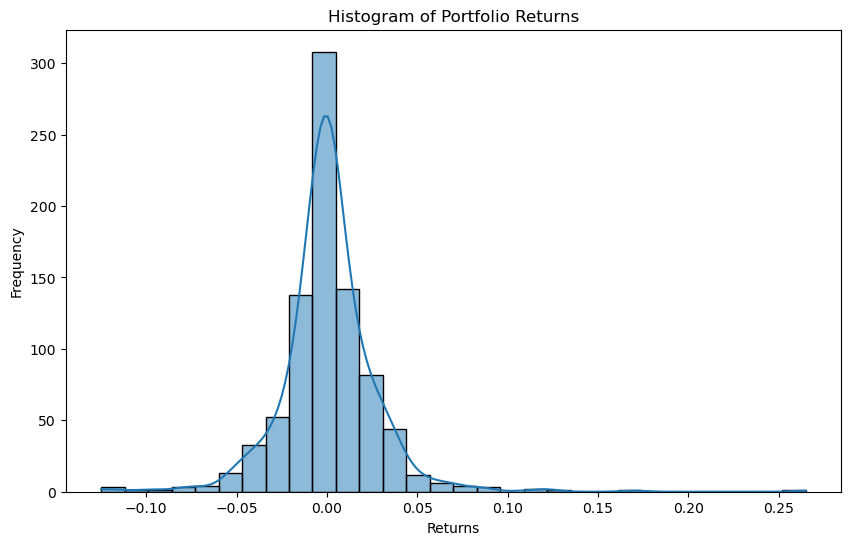

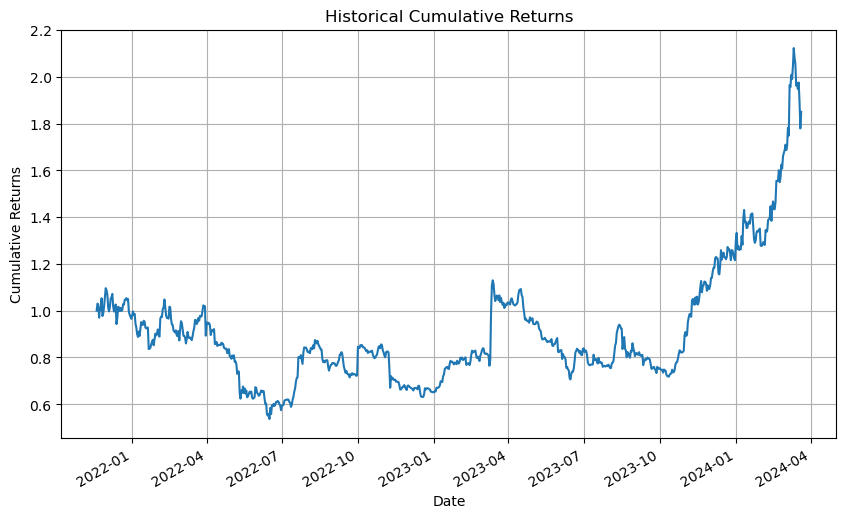

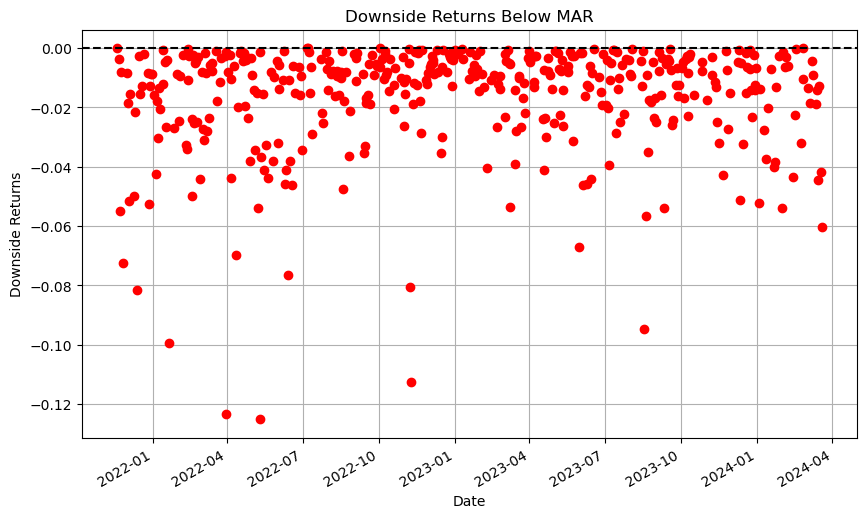

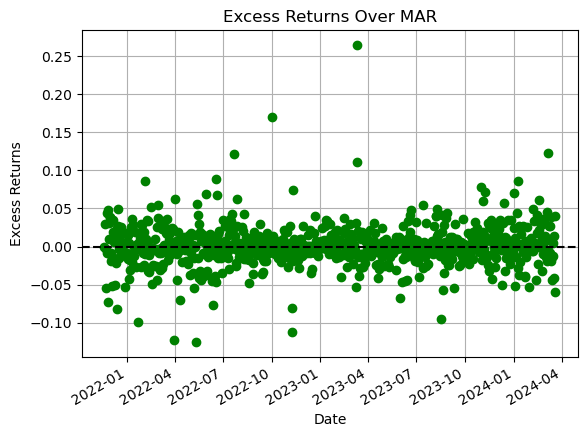

In [795]:


# Ensure your data is in a pandas DataFrame for easier plotting
# Assuming 'portfolio_daily_returns' is already a pandas Series with datetime index

# 1. Time Series Plot of Portfolio Returns
plt.figure(figsize=(10, 6))
portfolio_daily_returns.plot(title='Daily Portfolio Returns')
plt.xlabel('Date')
plt.ylabel('Returns')
plt.grid(True)
plt.show()

# 2. Histogram of Portfolio Returns
plt.figure(figsize=(10, 6))
sns.histplot(portfolio_daily_returns, kde=True, bins=30)
plt.title('Histogram of Portfolio Returns')
plt.xlabel('Returns')
plt.ylabel('Frequency')
plt.show()

# 3. Cumulative Returns Plot
cumulative_returns = (1 + portfolio_daily_returns).cumprod()
plt.figure(figsize=(10, 6))
cumulative_returns.plot(title='Historical Cumulative Returns')
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')
plt.grid(True)
plt.show()

# 4. Downside Returns Plot
plt.figure(figsize=(10, 6))
downside_returns.plot(style='ro', title='Downside Returns Below MAR')
plt.axhline(0, color='k', linestyle='--')  # Add a line at 0 for reference
plt.xlabel('Date')
plt.ylabel('Downside Returns')
plt.grid(True)
plt.show()

# 5. Excess Returns Over MAR
excess_returns.plot(style='go', title='Excess Returns Over MAR')
plt.axhline(0, color='k', linestyle='--')  # Add a line at MAR for reference
plt.xlabel('Date')
plt.ylabel('Excess Returns')
plt.grid(True)
plt.show()


### MVO with Sortino Ratio Objective

In [796]:
historical_bounds

BTC Vault_collateral_usd % of Total          0.08408
ETH Vault_collateral_usd % of Total          0.38833
stETH Vault_collateral_usd % of Total        0.17903
Stablecoin Vault_collateral_usd % of Total   0.01071
Altcoin Vault_collateral_usd % of Total      0.01374
LP Vault_collateral_usd % of Total           0.05750
RWA Vault_collateral_usd % of Total          0.02382
PSM Vault_collateral_usd % of Total          0.24280
dtype: float64

In [797]:
MAR

0.00013368061711349633

In [798]:
returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02887,0.03577,0.03798,0.00000,-0.02129,0.04363,-0.00000,0.01515
2021-11-21 00:00:00+00:00,0.00097,-0.00869,0.17436,0.00000,-0.00777,0.00218,0.00000,0.01441
2021-11-22 00:00:00+00:00,-0.05549,-0.07653,0.23199,-0.00006,0.00889,0.00535,0.00000,0.00904
2021-11-23 00:00:00+00:00,0.01211,0.06097,0.24859,0.00000,-0.01781,-0.00274,0.00000,0.01925
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02211,-0.02931,0.00770,0.00000,0.00000,0.00003,0.00000,0.01217
2024-03-17 00:00:00+00:00,0.01827,0.01368,-0.01010,0.00000,0.00000,0.00002,0.00000,0.11390
2024-03-18 00:00:00+00:00,-0.00860,-0.02619,-0.02706,-0.00000,0.00000,0.00001,0.00000,-0.36800


In [799]:
# Calculate excess returns below MAR
excess_returns = returns - MAR

# Downside deviation
downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
downside_deviation = np.sqrt(downside_returns.mean())

# Average excess returns
average_excess_returns = excess_returns.mean()

# Calculate Sortino Ratio for each asset
sortino_ratios = average_excess_returns / downside_deviation
print("Sortino Ratios for each asset:\n", sortino_ratios)

# Implementing MVO based on Sortino Ratio

def sortino_ratio_objective(weights):
    portfolio_returns = np.dot(returns, weights)
    excess_portfolio_returns = portfolio_returns - MAR
    downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
    portfolio_downside_deviation = np.sqrt(np.mean(downside_portfolio_returns) + 1e-6)  # Adding epsilon to avoid division by zero
    portfolio_return = np.mean(excess_portfolio_returns)
    return -portfolio_return / portfolio_downside_deviation

# Relax bounds to give more flexibility
bounds = [(0.01, .4),(0.2, .4),(0.01, .2),(0.01, 0.02),(0.01, .4),(0.01, 0.25),(0.01, 0.02),(0.01,0.25)]  # Minimum bound slightly above zero

# Initial weights more evenly distributed
initial_weights = np.full(num_assets, 1/num_assets)

# Optimization settings
options = {
    'maxiter': 1000,  # Increase the maximum number of iterations
    'disp': True      # Display progress
}

# Redo the optimization with updated settings
result = minimize(sortino_ratio_objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints, options=options)

# Output the results
if result.success:
    sortino_optimized_weights = result.x
    print("Optimized Weights for Maximum Sortino Ratio:", sortino_optimized_weights)
else:
    print("Optimization failed:", result.message)

Sortino Ratios for each asset:
 BTC Vault_collateral_usd           0.01988
ETH Vault_collateral_usd          -0.01704
stETH Vault_collateral_usd         0.14906
Stablecoin Vault_collateral_usd   -0.09198
Altcoin Vault_collateral_usd      -0.10060
LP Vault_collateral_usd           -0.02057
RWA Vault_collateral_usd           0.07305
PSM Vault_collateral_usd           0.09450
dtype: float64
Optimization terminated successfully    (Exit mode 0)
            Current function value: -0.09381168146957561
            Iterations: 4
            Function evaluations: 36
            Gradient evaluations: 4
Optimized Weights for Maximum Sortino Ratio: [0.17879656 0.2        0.2        0.01       0.01       0.13120344
 0.02       0.25      ]


In [800]:

# Assuming `returns` is a DataFrame with each column representing an asset's returns
# and `optimized_weights` is a NumPy array with the optimized weights for each asset.

# Step 1: Calculate portfolio returns
optimized_portfolio_daily_returns = np.dot(returns, sortino_optimized_weights)

# Step 2: Calculate excess returns relative to MAR

optimized_excess_returns = optimized_portfolio_daily_returns - MAR

# Step 3: Identify downside returns
optimized_downside_returns = np.where(optimized_excess_returns < 0, optimized_excess_returns**2, 0)

# Step 4: Calculate downside deviation
optimized_downside_deviation = np.sqrt(np.mean(optimized_downside_returns))

# Step 5: Calculate average excess return above MAR
optimized_average_excess_return = np.mean(excess_returns[excess_returns > 0])

# Step 6: Compute the Sortino Ratio
optimized_portfolio_sortino_ratio = optimized_average_excess_return / optimized_downside_deviation

print('Minimum Acceptable Return (MAR):', MAR)

print("Average Excess Return:",optimized_average_excess_return)
print("Downside Deviation:",optimized_downside_deviation)
print("Portfolio Sortino Ratio:", optimized_portfolio_sortino_ratio)


Minimum Acceptable Return (MAR): 0.00013368061711349633
Average Excess Return: 0.03511023881869633
Downside Deviation: 0.021365203908918096
Portfolio Sortino Ratio: 1.6433374082632035


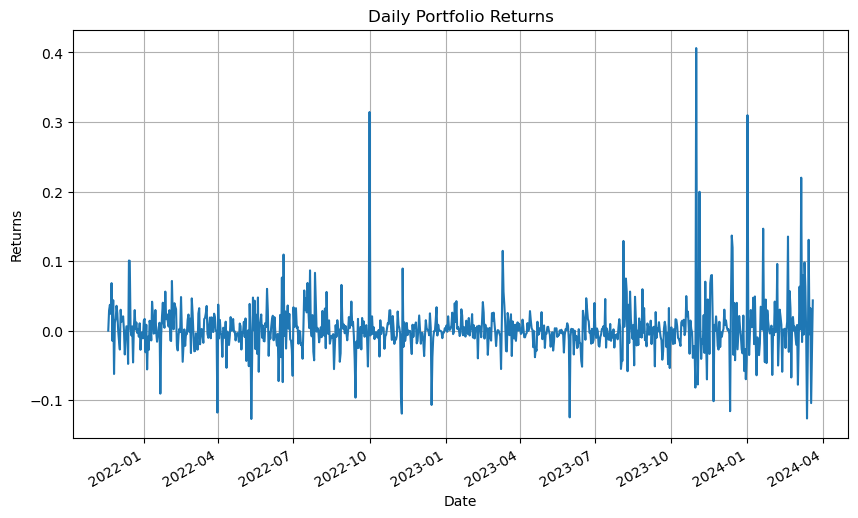

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


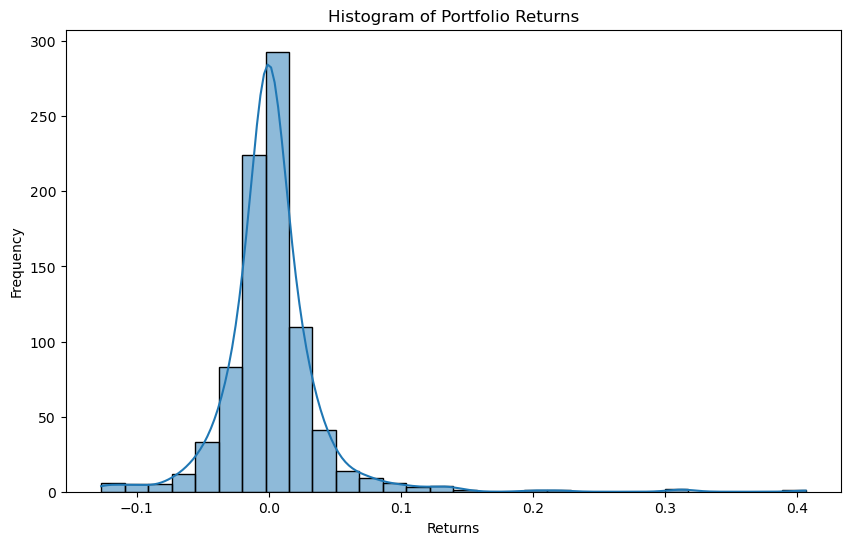

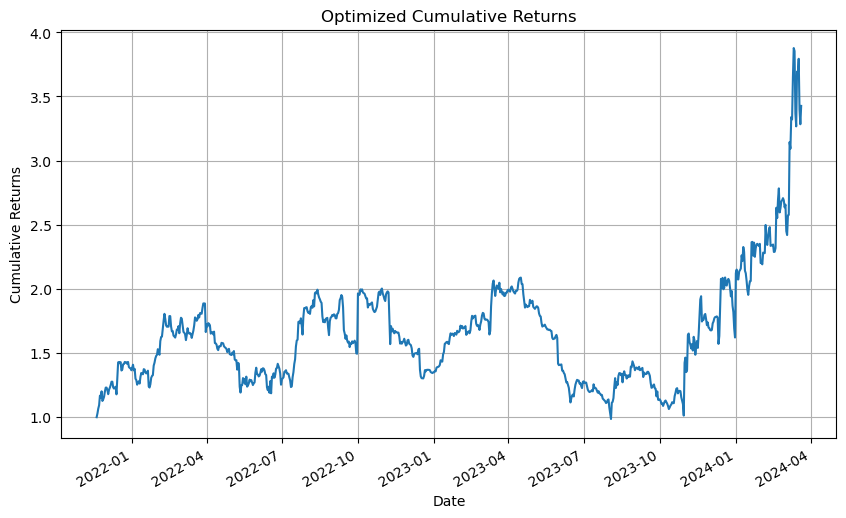

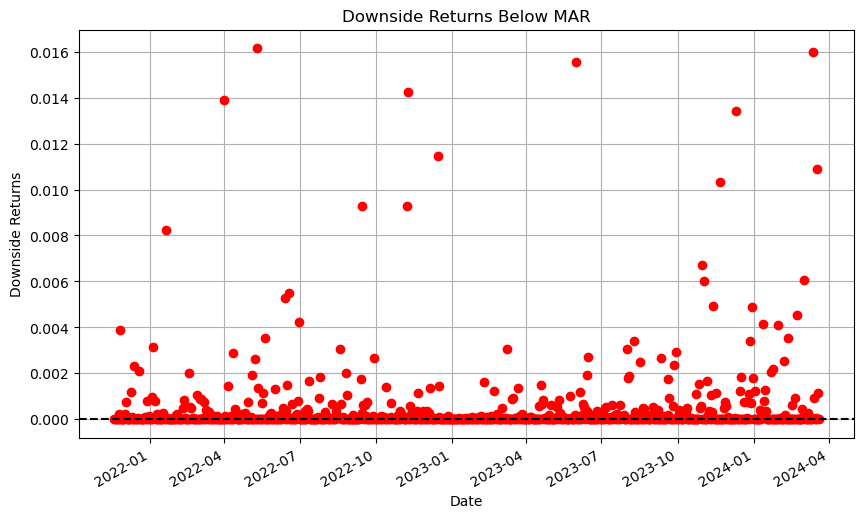

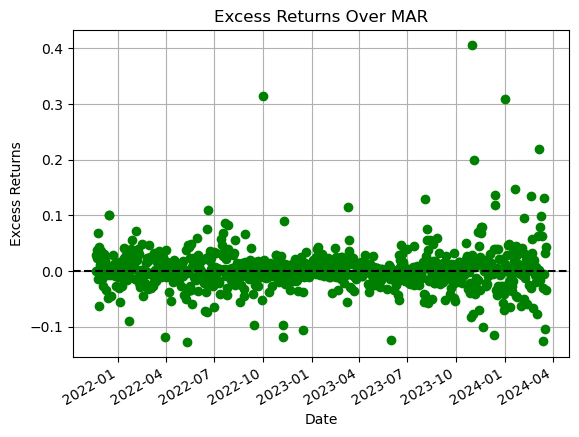

In [801]:


# Ensure your data is in a pandas DataFrame for easier plotting
# Assuming 'portfolio_daily_returns' is already a pandas Series with datetime index
optimized_portfolio_daily_returns_series = pd.Series(optimized_portfolio_daily_returns, index=returns.index)


# 1. Time Series Plot of Portfolio Returns
plt.figure(figsize=(10, 6))
optimized_portfolio_daily_returns_series.plot(title='Daily Portfolio Returns')
plt.xlabel('Date')
plt.ylabel('Returns')
plt.grid(True)
plt.show()

# 2. Histogram of Portfolio Returns
plt.figure(figsize=(10, 6))
sns.histplot(optimized_portfolio_daily_returns, kde=True, bins=30)
plt.title('Histogram of Portfolio Returns')
plt.xlabel('Returns')
plt.ylabel('Frequency')
plt.show()

# 3. Cumulative Returns Plot
optimized_cumulative_returns = (1 + optimized_portfolio_daily_returns_series).cumprod()
plt.figure(figsize=(10, 6))
optimized_cumulative_returns.plot(title='Optimized Cumulative Returns')
plt.xlabel('Date')
plt.ylabel('Cumulative Returns')
plt.grid(True)
plt.show()

optimized_downside_returns_series = pd.Series(optimized_downside_returns, index=returns.index)

# 4. Downside Returns Plot
plt.figure(figsize=(10, 6))
optimized_downside_returns_series.plot(style='ro', title='Downside Returns Below MAR')
plt.axhline(0, color='k', linestyle='--')  # Add a line at 0 for reference
plt.xlabel('Date')
plt.ylabel('Downside Returns')
plt.grid(True)
plt.show()

optimized_excess_returns_series = pd.Series(optimized_excess_returns, index=returns.index)

# 5. Excess Returns Over MAR
optimized_excess_returns_series.plot(style='go', title='Excess Returns Over MAR')
plt.axhline(0, color='k', linestyle='--')  # Add a line at MAR for reference
plt.xlabel('Date')
plt.ylabel('Excess Returns')
plt.grid(True)
plt.show()


In [802]:
cumulative_returns

day
2021-11-19 00:00:00+00:00   1.00000
2021-11-20 00:00:00+00:00   1.03010
2021-11-21 00:00:00+00:00   1.02657
2021-11-22 00:00:00+00:00   0.97025
2021-11-23 00:00:00+00:00   1.01284
                              ...  
2024-03-16 00:00:00+00:00   1.94785
2024-03-17 00:00:00+00:00   1.97550
2024-03-18 00:00:00+00:00   1.89345
2024-03-19 00:00:00+00:00   1.77950
2024-03-20 00:00:00+00:00   1.85023
Length: 854, dtype: float64

In [803]:
optimized_cumulative_returns

day
2021-11-19 00:00:00+00:00   1.00000
2021-11-20 00:00:00+00:00   1.02921
2021-11-21 00:00:00+00:00   1.06741
2021-11-22 00:00:00+00:00   1.09326
2021-11-23 00:00:00+00:00   1.16799
                              ...  
2024-03-16 00:00:00+00:00   3.67412
2024-03-17 00:00:00+00:00   3.79338
2024-03-18 00:00:00+00:00   3.39816
2024-03-19 00:00:00+00:00   3.28315
2024-03-20 00:00:00+00:00   3.42600
Length: 854, dtype: float64

In [804]:
optimized_portfolio_daily_returns_series

day
2021-11-19 00:00:00+00:00    0.00000
2021-11-20 00:00:00+00:00    0.02921
2021-11-21 00:00:00+00:00    0.03712
2021-11-22 00:00:00+00:00    0.02422
2021-11-23 00:00:00+00:00    0.06835
                              ...   
2024-03-16 00:00:00+00:00   -0.00523
2024-03-17 00:00:00+00:00    0.03246
2024-03-18 00:00:00+00:00   -0.10419
2024-03-19 00:00:00+00:00   -0.03384
2024-03-20 00:00:00+00:00    0.04351
Length: 854, dtype: float64

In [805]:
portfolio_daily_returns

day
2021-11-19 00:00:00+00:00    0.00000
2021-11-20 00:00:00+00:00    0.03010
2021-11-21 00:00:00+00:00   -0.00343
2021-11-22 00:00:00+00:00   -0.05487
2021-11-23 00:00:00+00:00    0.04389
                              ...   
2024-03-16 00:00:00+00:00   -0.01274
2024-03-17 00:00:00+00:00    0.01420
2024-03-18 00:00:00+00:00   -0.04153
2024-03-19 00:00:00+00:00   -0.06018
2024-03-20 00:00:00+00:00    0.03975
Length: 854, dtype: float64

In [806]:
returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02887,0.03577,0.03798,0.00000,-0.02129,0.04363,-0.00000,0.01515
2021-11-21 00:00:00+00:00,0.00097,-0.00869,0.17436,0.00000,-0.00777,0.00218,0.00000,0.01441
2021-11-22 00:00:00+00:00,-0.05549,-0.07653,0.23199,-0.00006,0.00889,0.00535,0.00000,0.00904
2021-11-23 00:00:00+00:00,0.01211,0.06097,0.24859,0.00000,-0.01781,-0.00274,0.00000,0.01925
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02211,-0.02931,0.00770,0.00000,0.00000,0.00003,0.00000,0.01217
2024-03-17 00:00:00+00:00,0.01827,0.01368,-0.01010,0.00000,0.00000,0.00002,0.00000,0.11390
2024-03-18 00:00:00+00:00,-0.00860,-0.02619,-0.02706,-0.00000,0.00000,0.00001,0.00000,-0.36800


# RDL 

## State Space Features

In [807]:
state_space = st_aggregated_vault_data[['ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling',
'PSM Vault_collateral_usd_7d_ma','BTC Vault_collateral_usd_7d_ma','ETH Vault_collateral_usd_7d_ma','stETH Vault_collateral_usd_7d_ma','Altcoin Vault_collateral_usd_7d_ma','LP Vault_collateral_usd_7d_ma','Stablecoin Vault_collateral_usd_7d_ma','RWA Vault_collateral_usd_7d_ma',
'BTC Vault_market_price', 'ETH Vault_market_price', 'stETH Vault_market_price', 'Stablecoin Vault_market_price', 'Altcoin Vault_market_price', 'LP Vault_market_price', 'PSM Vault_market_price', 'effective_funds_rate',
'M1V', 'WM2NS', 'fed_reverse_repo',
'ETH Vault_liquidation_ratio', 'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio', 'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio', 'LP Vault_liquidation_ratio', 'PSM Vault_liquidation_ratio',
'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total', 'where_is_dai_Bridge',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma',
'where_is_dai_Bridge', 'dai_market_Volume_30d_ma', 'dai_market_Volume_7d_ma','eth_market_Close_7d_ma','eth_market_Volume_30d_ma','btc_market_Close_7d_ma','btc_market_Volume_30d_ma',
'btc_market_Volume_30d_ma','eth_market_Volume_30d_ma','ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']]

environment = state_space.copy()

In [808]:
state_space

,ETH Vault_dai_ceiling,stETH Vault_dai_ceiling,BTC Vault_dai_ceiling,Altcoin Vault_dai_ceiling,Stablecoin Vault_dai_ceiling,LP Vault_dai_ceiling,PSM Vault_dai_ceiling,PSM Vault_collateral_usd_7d_ma,BTC Vault_collateral_usd_7d_ma,ETH Vault_collateral_usd_7d_ma,...,btc_market_Volume_30d_ma,btc_market_Volume_30d_ma,eth_market_Volume_30d_ma,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,,,,,,,,,,,,,,
2021-11-19 00:00:00+00:00,"4,215,499,587.09872","16,779,001.87837","1,398,087,189.04925","170,858,309.36176","5,000,000.00000","352,901,603.86001","3,593,103,707.31785","2,087,989,128.99971","2,797,216,365.73992","11,764,650,156.64727",...,"35,938,937,154.73333","35,938,937,154.73333","19,097,892,226.93333","11,530,810,569.93515","39,769,944.75450","2,866,222,769.09959","520,045,444.90519","336,521,697.42675","412,562,137.86644","2,132,251,251.20941"
2021-11-20 00:00:00+00:00,"4,185,875,620.48578","17,284,635.75812","1,393,749,077.71651","171,141,983.01782","5,000,000.00000","372,841,835.68929","3,604,384,386.93336","2,095,894,278.03591","2,810,626,553.33763","11,686,361,716.76668",...,"35,429,475,271.16666","35,429,475,271.16666","18,672,145,542.16667","11,943,278,353.68762","41,280,230.12684","2,948,959,833.37399","508,972,390.70129","336,521,697.42675","430,562,322.97248","2,164,546,578.27289"
2021-11-21 00:00:00+00:00,"4,185,229,052.82756","19,140,998.34184","1,407,300,021.86314","171,131,567.49223","5,000,000.00000","378,293,238.31257","3,604,384,386.93336","2,111,854,155.01873","2,825,455,786.71808","11,641,751,704.71843",...,"35,019,120,765.50000","35,019,120,765.50000","18,494,208,657.00000","11,839,472,041.02766","48,477,796.29037","2,951,818,107.21472","505,016,705.04971","336,521,697.42675","431,500,082.06578","2,195,743,029.10143"
2021-11-22 00:00:00+00:00,"4,167,338,922.83872","22,170,168.94489","1,437,967,464.63631","159,239,990.91266","5,000,000.00000","378,299,770.81950","3,674,297,040.97279","2,132,391,088.44761","2,820,168,046.72430","11,458,889,198.47886",...,"35,290,906,623.80000","35,290,906,623.80000","18,659,898,026.50000","10,933,452,742.14960","59,724,075.18165","2,788,017,226.13774","509,504,043.07337","336,503,182.74675","433,806,450.38492","2,215,601,174.20796"
2021-11-23 00:00:00+00:00,"4,152,215,276.92244","23,065,851.72446","1,435,093,757.47548","158,801,066.38277","5,000,000.00000","378,879,291.14350","3,670,722,718.34453","2,161,821,212.57792","2,845,182,196.03813","11,479,291,732.82739",...,"35,629,893,957.70000","35,629,893,957.70000","18,898,411,807.20000","11,600,116,135.99997","74,570,808.78308","2,821,788,807.21326","500,427,709.74620","336,503,182.74675","432,619,037.81609","2,258,244,677.18063"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,"967,253,018.36636","608,732,014.19748","211,833,342.37973","1,000,000.00000",0.00000,0.00000,"1,191,410,955.71145","572,243,845.20727","719,718,313.61811","4,132,087,593.23641",...,"44,076,475,716.16666","44,076,475,716.16666","21,816,958,204.30000","3,752,247,535.61763","2,417,541,115.80447","693,532,316.12871","1,944,419.59103","99,227.46740","97,377,612.28187","567,092,988.70479"
2024-03-17 00:00:00+00:00,"967,253,018.36636","608,732,014.19748","212,059,110.70835","1,000,000.00000",0.00000,0.00000,"1,191,410,955.71145","571,329,660.81181","718,525,006.82250","4,058,656,482.11356",...,"44,900,068,159.90000","44,900,068,159.90000","21,883,837,442.70000","3,803,584,313.35047","2,393,113,805.45610","706,205,158.85654","1,944,419.59103","99,227.46740","97,379,575.13498","631,684,264.91900"
2024-03-18 00:00:00+00:00,"967,253,018.36636","587,778,544.53665","220,631,595.82640","1,000,000.00000",0.00000,0.00000,"1,273,620,575.48603","519,543,877.22678","714,433,480.10772","3,958,516,370.16250",...,"45,955,608,232.60000","45,955,608,232.60000","21,81

In [809]:
composition.iloc[0]

BTC Vault_collateral_usd          0.16022
ETH Vault_collateral_usd          0.64457
stETH Vault_collateral_usd        0.00222
Stablecoin Vault_collateral_usd   0.01881
Altcoin Vault_collateral_usd      0.02907
LP Vault_collateral_usd           0.02306
RWA Vault_collateral_usd          0.00284
PSM Vault_collateral_usd          0.11919
Name: 2021-11-19 00:00:00+00:00, dtype: float64

## MVO Functions

def mvo(data):
    portfolio = data[['BTC Vault_collateral_usd','ETH Vault_collateral_usd','stETH Vault_collateral_usd','Stablecoin Vault_collateral_usd'
                  ,'Altcoin Vault_collateral_usd','LP Vault_collateral_usd','RWA Vault_collateral_usd','PSM Vault_collateral_usd']]
    
    returns = portfolio.pct_change()
    returns.replace([np.inf, -np.inf], np.nan, inplace=True)
    returns.fillna(0, inplace=True)

    total_portfolio_value = portfolio.sum(axis=1)
    composition = portfolio.divide(total_portfolio_value, axis=0)

    composition.columns = returns.columns

    
    
    annual_risk_free_rate = 0.05
    
    # Convert to daily risk-free rate
    daily_risk_free_rate = (1 + annual_risk_free_rate)**(1/365) - 1
    
    # Now use this daily rate in your calculations
    # Assuming you use it as the Minimum Acceptable Return (MAR)
    MAR = daily_risk_free_rate  # This could also be set to zero if you're only measuring against downside deviation

    excess_returns = returns - MAR

    # Downside deviation
    downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
    downside_deviation = np.sqrt(downside_returns.mean())
    
    # Average excess returns
    average_excess_returns = excess_returns.mean()
    
    # Calculate Sortino Ratio for each asset
    sortino_ratios = average_excess_returns / downside_deviation
    print("Sortino Ratios for each asset:\n", sortino_ratios)
    
    # Implementing MVO based on Sortino Ratio
    
    def sortino_ratio_objective(weights):
        portfolio_returns = np.dot(returns, weights)
        excess_portfolio_returns = portfolio_returns - MAR
        downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
        portfolio_downside_deviation = np.sqrt(np.mean(downside_portfolio_returns) + 1e-6)  # Adding epsilon to avoid division by zero
        portfolio_return = np.mean(excess_portfolio_returns)
        return -portfolio_return / portfolio_downside_deviation

    # Relax bounds to give more flexibility
    bounds = [(0.01, .4),(0.2, .4),(0.01, .4),(0.01, 0.02),(0.01, .4),(0.01, 0.25),(0.01, 0.02),(0.01,0.25)]  # Minimum bound slightly above zero
    
    # Initial weights more evenly distributed
    initial_weights = composition.iloc[-1]
    
    # Optimization settings
    options = {
        'maxiter': 1000,  # Increase the maximum number of iterations
        'disp': True      # Display progress
    }
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    # Redo the optimization with updated settings
    result = minimize(sortino_ratio_objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints, options=options)
    
    # Output the results
    if result.success:
        sortino_optimized_weights = result.x
        print(sortino_optimized_weights)
        return sortino_optimized_weights, returns, composition
    else:
        print("Optimization failed:", result.message)

    

def mvo(data,  annual_risk_free_rate = 0.05):
    portfolio = data[['BTC Vault_collateral_usd','ETH Vault_collateral_usd','stETH Vault_collateral_usd','Stablecoin Vault_collateral_usd',
                      'Altcoin Vault_collateral_usd','LP Vault_collateral_usd','RWA Vault_collateral_usd','PSM Vault_collateral_usd']]
    
    returns = portfolio.pct_change()
    returns.replace([np.inf, -np.inf], np.nan, inplace=True)
    returns.fillna(0, inplace=True)

    composition = data[['BTC Vault_collateral_usd % of Total',
                        'ETH Vault_collateral_usd % of Total',
                        'stETH Vault_collateral_usd % of Total',
                        'Stablecoin Vault_collateral_usd % of Total',
                        'Altcoin Vault_collateral_usd % of Total',
                        'LP Vault_collateral_usd % of Total',
                        'RWA Vault_collateral_usd % of Total',
                        'PSM Vault_collateral_usd % of Total']]
    composition = composition / 100
    composition.columns = returns.columns
    
   
    daily_risk_free_rate = (1 + annual_risk_free_rate)**(1/365) - 1
    MAR = daily_risk_free_rate

    excess_returns = returns - MAR
    downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
    daily_downside_deviation = np.sqrt(downside_returns.mean())

    # Annualizing downside deviation and excess returns
    annual_downside_deviation = daily_downside_deviation * np.sqrt(365)
    annual_average_excess_returns = excess_returns.mean() * 365

    # Calculate Sortino Ratio for each asset annually
    sortino_ratios = annual_average_excess_returns / annual_downside_deviation
    print("Sortino Ratios for each asset:\n", sortino_ratios)
    
    def sortino_ratio_objective(weights):
        portfolio_returns = np.dot(returns, weights)
        excess_portfolio_returns = portfolio_returns - MAR
        downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
        portfolio_downside_deviation = np.sqrt(np.mean(downside_portfolio_returns) + 1e-6)  # Avoid division by zero
        portfolio_return = np.mean(excess_portfolio_returns) * 365  # Annualizing
        portfolio_annual_downside_deviation = portfolio_downside_deviation * np.sqrt(365)
        return -portfolio_return / portfolio_annual_downside_deviation

    bounds = [(0.01, .4),(0.2, .4),(0.01, .2),(0.01, 0.02),(0.01, .4),(0.01, 0.25),(0.01, 0.02),(0.01,0.25)]
    initial_weights = composition.iloc[-1]
    options = {'maxiter': 1000, 'disp': True}
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})

    result = minimize(sortino_ratio_objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints, options=options)
    
    if result.success:
        sortino_optimized_weights = result.x
        print("Optimized Weights:\n", sortino_optimized_weights)
        return sortino_optimized_weights, returns, composition
    else:
        print("Optimization failed:", result.message)

#With % columns

import numpy as np
import pandas as pd
from scipy.optimize import minimize

def mvo(data, annual_risk_free_rate=0.05):
    portfolio = data[['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd', 'Stablecoin Vault_collateral_usd',
                      'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd', 'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd']]
    
    returns = portfolio.pct_change()
    returns.replace([np.inf, -np.inf], np.nan, inplace=True)
    returns.fillna(0, inplace=True)

    composition = data[['BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total',
                        'stETH Vault_collateral_usd % of Total', 'Stablecoin Vault_collateral_usd % of Total',
                        'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
                        'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total']] / 100
    print('composition', composition)
    composition.columns = returns.columns
    
    daily_risk_free_rate = (1 + annual_risk_free_rate)**(1/365) - 1

    excess_returns = returns - daily_risk_free_rate
    downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
    daily_downside_deviation = np.sqrt(downside_returns.mean())

    # Compounding returns and annualizing downside deviation
    compounding_return = (1 + excess_returns).prod()**(365 / len(returns)) - 1
    annual_downside_deviation = daily_downside_deviation * np.sqrt(365)

    sortino_ratios = compounding_return / annual_downside_deviation
    print("Sortino Ratios for each asset:\n", sortino_ratios)

    def sortino_ratio_objective(weights):
        portfolio_returns = np.dot(returns, weights)
        excess_portfolio_returns = portfolio_returns - daily_risk_free_rate
        downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
        portfolio_downside_deviation = np.sqrt(np.mean(downside_portfolio_returns) + 1e-6)
        annual_portfolio_return = (1 + excess_portfolio_returns).prod()**(365 / len(returns)) - 1
        portfolio_annual_downside_deviation = portfolio_downside_deviation * np.sqrt(365)
        return -annual_portfolio_return / portfolio_annual_downside_deviation

    bounds = [(0.01, .4),(0.2, .4),(0.01, .2),(0.01, 0.02),(0.01, .4),(0.01, 0.25),(0.01, 0.02),(0.01,0.25)]
    initial_weights = composition.iloc[0].values  # ensure it's a numpy array
    options = {'maxiter': 1000, 'disp': True}
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})

    result = minimize(sortino_ratio_objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints, options=options)
    
    if result.success:
        optimized_weights = result.x
        print("Optimized Weights:\n", optimized_weights)
        return optimized_weights, returns, composition
    else:
        print("Optimization failed:", result.message)



### Returns w/ fill for NaN, replace 0

from scipy.optimize import minimize, Bounds, LinearConstraint
import numpy as np

def mvo(data, annual_risk_free_rate=0.05):
    try:
        # Extract the portfolio data
        portfolio = data[['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd', 
                          'Stablecoin Vault_collateral_usd', 'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd', 
                          'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd']]
        print("Portfolio Data through date:\n", portfolio.index.min(), ' - ', portfolio.index.max())

        # Handle zero balances by replacing them with NaNs to prevent calculation errors
        portfolio = portfolio.replace(0, np.nan).ffill().bfill()  # forward and backward fill to handle NaNs initially
        
        # Calculate percentage returns only where data is not NaN
        returns = portfolio.pct_change().fillna(0)

        # Calculate asset composition
        total_portfolio_value = portfolio.sum(axis=1)
        print('mvo portfolio value', total_portfolio_value)
        composition = portfolio.divide(total_portfolio_value, axis=0)
        print("Latest Asset Composition:\n", composition.iloc[-1])

        # Calculate daily risk-free rate
        daily_risk_free_rate = (1 + annual_risk_free_rate) ** (1/365) - 1
        print('daily risk free', daily_risk_free_rate)

        # Calculate excess returns
        excess_returns = returns - daily_risk_free_rate
        
        # Calculate downside returns
        downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
        daily_downside_deviation = np.sqrt(downside_returns.mean())
        print('daily downside deviation', daily_downside_deviation)

        # Compounding returns and annualizing based on the actual days with data
        active_days = (portfolio != 0).sum()
        # Using actual days with returns
        print('active days', active_days)
        annual_factor = 365 / active_days
        print('annual factor', annual_factor)
        compounding_return = (1 + excess_returns).prod() ** annual_factor - 1
        print('vault compounding return', compounding_return)

        # Annual downside deviation
        annual_downside_deviation = daily_downside_deviation * np.sqrt(365)
        print('annual downside deivation', annual_downside_deviation)

        # Calculate Sortino ratios
        sortino_ratio = compounding_return / annual_downside_deviation
        print("Sortino Ratio:", sortino_ratio)

        # Define the optimization objective function
        def sortino_ratio_objective(weights):
            portfolio_returns = np.dot(returns, weights)
            excess_portfolio_returns = portfolio_returns - daily_risk_free_rate
            downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
            portfolio_downside_deviation = np.sqrt(downside_portfolio_returns.mean())
            annual_portfolio_return = (1 + excess_portfolio_returns).prod() ** (365 / len(excess_portfolio_returns)) - 1
            portfolio_annual_downside_deviation = portfolio_downside_deviation * np.sqrt(365)
            return -annual_portfolio_return / portfolio_annual_downside_deviation

        # Set optimization parameters
        lower_bounds = [0.05, 0.1, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01]  # Set ETH minimum to 0.1
        upper_bounds = [0.5, 0.5, 0.3, 0.03, 0.5, 0.3, 0.03, 0.3]
        bounds = Bounds(lower_bounds, upper_bounds)
        constraints = LinearConstraint([1]*8, [1], [1])
        options = {'verbose': 1, 'maxiter': 5000}

        # Run the optimization
        result = minimize(sortino_ratio_objective, composition.mean().values, method='trust-constr',
                          bounds=bounds, constraints=constraints, options=options)

        if result.success:
            optimized_weights = result.x
            print("Optimized Weights:\n", optimized_weights)
            return optimized_weights, returns, composition, total_portfolio_value
        else:
            print("Optimization failed:", result.message)

    except Exception as e:
        print(f"Error during MVO computation: {e}")



### Log Returns MVO

def mvo(data, annual_risk_free_rate=0.05):
    try:
        # Extract the portfolio data
        portfolio = data[['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd', 
                          'Stablecoin Vault_collateral_usd', 'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd', 
                          'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd']]
        print("Portfolio Data through date:\n", portfolio.index.min(), ' - ', portfolio.index.max())

        # Ensure all values are positive before log transformation
        portfolio = portfolio.clip(lower=0.01)
        
        # Calculate log returns safely
        returns = np.log(portfolio / portfolio.shift(1)).replace([np.inf, -np.inf], np.nan).fillna(0)
        print("Log returns:\n", returns)
        if returns.isnull().values.any() or np.isinf(returns.values).any():
            print("Warning: NaN or Inf found in log returns.")

        # Calculate asset composition
        total_portfolio_value = portfolio.sum(axis=1)
        composition = portfolio.divide(total_portfolio_value, axis=0)
        print("Latest Asset Composition:\n", composition.iloc[-1])

        # Calculate daily risk-free rate
        daily_risk_free_rate = (1 + annual_risk_free_rate) ** (1/365) - 1
        print('daily risk free', daily_risk_free_rate)

        excess_returns = returns - daily_risk_free_rate
        print("Excess returns:\n", excess_returns)
        if excess_returns.isnull().values.any() or np.isinf(excess_returns.values).any():
            print("Warning: NaN or Inf found in excess returns.")

        # Calculate downside returns
        downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
        daily_downside_deviation = np.sqrt(downside_returns.mean())
        print('daily downside deviation', daily_downside_deviation)

        # Compounding returns and annualizing based on the actual days with data
        active_days = (portfolio != 0).sum()
        print('active days', active_days)
        annual_factor = 365 / active_days
        print('annual factor', annual_factor)
        try:
            compounding_return = (1 + excess_returns).prod() ** (365 / len(excess_returns)) - 1
        except Exception as e:
            print(f"Error during compounding return calculation: {e}")
            compounding_return = np.nan  # Use NaN if error occurs

        if np.isnan(compounding_return).any():
            print("NaN found in compounding returns")
        print('vault compounding return', compounding_return)

        # Annual downside deviation
        annual_downside_deviation = daily_downside_deviation * np.sqrt(365)
        print('annual downside deviation', annual_downside_deviation)

        sortino_ratio = compounding_return / annual_downside_deviation
        print("Sortino Ratio:\n", sortino_ratio)
        if np.isnan(sortino_ratio).any() or np.isinf(sortino_ratio).any():
            print("Warning: NaN or Inf found in Sortino Ratio calculations.")

        # Define the optimization objective function
        def sortino_ratio_objective(weights):
            portfolio_returns = np.dot(returns, weights)
            excess_portfolio_returns = portfolio_returns - daily_risk_free_rate
            
            # Ensuring that (1 + excess_portfolio_returns) is positive before the power operation
            adjusted_excess = 1 + excess_portfolio_returns
            adjusted_excess[adjusted_excess <= 0] = 0.01  # Setting a lower bound to avoid log(0) or negative power
        
            annual_portfolio_return = adjusted_excess.prod() ** (365 / len(excess_portfolio_returns)) - 1
            if np.isnan(annual_portfolio_return):
                print("NaN in annual portfolio return after adjustment")
        
            downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
            portfolio_downside_deviation = np.sqrt(downside_portfolio_returns.mean())
            portfolio_annual_downside_deviation = portfolio_downside_deviation * np.sqrt(365)
            return -annual_portfolio_return / portfolio_annual_downside_deviation

        # Set optimization parameters
        bounds = Bounds([0.05, 0.2, 0.01, 0.01, 0.01, 0.01, 0.01, 0.01], [0.5, 0.5, 0.3, 0.03, 0.5, 0.3, 0.03, 0.3])
        constraints = LinearConstraint([1]*8, [1], [1])
        options = {'verbose': 1, 'maxiter': 10000}

        # Run the optimization
        result = minimize(sortino_ratio_objective, composition.iloc[-1].values, method='trust-constr', bounds=bounds, constraints=constraints, options=options)
        if result.success:
            optimized_weights = result.x
            print("Optimized Weights:\n", optimized_weights)
            return optimized_weights, returns, composition, total_portfolio_value
        else:
            print("Optimization failed:", result.message)

    except Exception as e:
        print(f"Error during MVO computation: {e}")

In [810]:
import numpy as np
import pandas as pd
from scipy.optimize import minimize

def mvo(data, annual_risk_free_rate=0.05, penalty_factor=10000):  # Increased penalty factor
    portfolio = data[['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd', 
                      'Stablecoin Vault_collateral_usd', 'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd', 
                      'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd']]
    log_returns = np.log(portfolio / portfolio.shift(1))
    log_returns.fillna(0, inplace=True)
    
    total_portfolio_value = portfolio.sum(axis=1)
    composition = portfolio.divide(total_portfolio_value, axis=0)
    
    daily_risk_free_rate = (1 + annual_risk_free_rate) ** (1/365) - 1
    excess_returns = log_returns.subtract(daily_risk_free_rate, axis=0)
    
    downside_returns = np.where(log_returns < daily_risk_free_rate, log_returns - daily_risk_free_rate, 0)
    daily_downside_deviation = np.sqrt((downside_returns ** 2).mean())
    annual_downside_deviation = daily_downside_deviation * np.sqrt(365)
    
    annualized_returns = excess_returns.mean() * 365
    sortino_ratios = annualized_returns / annual_downside_deviation if annual_downside_deviation != 0 else np.inf
    print("Individual Sortino Ratios:", sortino_ratios)

    def sortino_ratio(weights):
        portfolio_returns = np.sum(weights * excess_returns, axis=1)
        annualized_returns = np.mean(portfolio_returns) * 365
        downside_deviation = np.sqrt(np.mean(np.minimum(0, portfolio_returns - daily_risk_free_rate) ** 2)) * np.sqrt(365)
        
        lower_bounds, upper_bounds = np.array([b[0] for b in bounds]), np.array([b[1] for b in bounds])
        penalties = penalty_factor * (np.sum(np.maximum(0, lower_bounds - weights) ** 2) +
                                     np.sum(np.maximum(0, weights - upper_bounds) ** 2))
        
        return -(annualized_returns / downside_deviation) + penalties if downside_deviation != 0 else -np.inf

    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bounds = [(0.1, 0.5), (0.05, 0.3), (0.05, 0.5), (0.1, 0.1), (0.01, 0.2), (0.01, 0.3), (0.01, 0.02), (0.01, 0.25)]
    initial_weights = np.clip(composition.iloc[-1].values, a_min=[b[0] for b in bounds], a_max=[b[1] for b in bounds])

    result = minimize(sortino_ratio, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints)
    if result.success:
        optimized_weights = result.x
        print('Optimized weights:', optimized_weights)
        return optimized_weights, log_returns, composition, total_portfolio_value
    else:
        raise Exception('Optimization did not converge')

# Example usage with your data variable
# all_data_mvo, all_data_returns, all_data_composition, all_data_portfolio_value = mvo(your_data_variable)


In [811]:
## w/o percent columsn


def mvo_no_rwa(data, annual_risk_free_rate=0.05):
    # Extract the portfolio data
    portfolio = data[['BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd', 
                      'Stablecoin Vault_collateral_usd', 'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd', 
                      'PSM Vault_collateral_usd']]
    
    # Calculate percentage returns
    returns = portfolio.pct_change()
    returns.replace([np.inf, -np.inf], np.nan, inplace=True)
    returns.fillna(0, inplace=True)
    
    # Calculate composition of each asset as a percentage of total portfolio value
    total_portfolio_value = portfolio.sum(axis=1)
    composition = portfolio.divide(total_portfolio_value, axis=0)
    
    # Convert composition to correct scale if needed (no need to divide by 100 since it's already a ratio)
    composition.columns = returns.columns  # Ensure the composition columns match the returns columns for consistency
    
    daily_risk_free_rate = (1 + annual_risk_free_rate)**(1/365) - 1
    excess_returns = returns - daily_risk_free_rate
    downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
    daily_downside_deviation = np.sqrt(downside_returns.mean())

    # Compounding returns and annualizing downside deviation
    compounding_return = (1 + excess_returns).prod()**(365 / len(excess_returns)) - 1
    print('excess return', excess_returns)
    print('')
    print('compounding return', compounding_return)
    annual_downside_deviation = daily_downside_deviation * np.sqrt(365)

    sortino_ratios = compounding_return / annual_downside_deviation
    print("Sortino Ratios for each asset:\n", sortino_ratios)

    def sortino_ratio_objective(weights):
        portfolio_returns = np.dot(returns, weights)
        excess_portfolio_returns = portfolio_returns - daily_risk_free_rate
        downside_portfolio_returns = np.where(excess_portfolio_returns < 0, excess_portfolio_returns**2, 0)
        portfolio_downside_deviation = np.sqrt(np.mean(downside_portfolio_returns) + 1e-6)  # Ensure no division by zero
        annual_portfolio_return = (1 + excess_portfolio_returns).prod()**(365 / len(excess_portfolio_returns)) - 1
        portfolio_annual_downside_deviation = portfolio_downside_deviation * np.sqrt(365)
        return -annual_portfolio_return / portfolio_annual_downside_deviation


    bounds = [(0.01, .4),(0.2, .4),(0.01, .2),(0.01, 0.02),(0.01, .4),(0.01, 0.25),(0.01,0.25)]
    initial_weights = composition.mean() # ensure it's a numpy array
    options = {'maxiter': 1000, 'disp': True}
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})

    result = minimize(sortino_ratio_objective, initial_weights, method='SLSQP', bounds=bounds, constraints=constraints, options=options)
    
    if result.success:
        optimized_weights = result.x
        print("Optimized Weights:\n", optimized_weights)
        return optimized_weights, returns, composition, total_portfolio_value
    else:
        print("Optimization failed:", result.message)


In [812]:
def optimized_sortino_daily(returns, sortino_optimized_weights):
    # Step 1: Calculate portfolio returns
    # Annual risk-free rate
    annual_risk_free_rate = 0.05
    
    # Convert to daily risk-free rate
    daily_risk_free_rate = (1 + annual_risk_free_rate)**(1/365) - 1
    
    # Now use this daily rate in your calculations
    # Assuming you use it as the Minimum Acceptable Return (MAR)
    MAR = daily_risk_free_rate  # This could also be set to zero if you're only measuring against downside deviation
    
    optimized_portfolio_daily_returns = np.dot(returns, sortino_optimized_weights)
    
    # Step 2: Calculate excess returns relative to MAR
    
    optimized_excess_returns = optimized_portfolio_daily_returns - MAR
    
    # Step 3: Identify downside returns
    optimized_downside_returns = np.where(optimized_excess_returns < 0, optimized_excess_returns**2, 0)
    
    # Step 4: Calculate downside deviation
    optimized_downside_deviation = np.sqrt(np.mean(optimized_downside_returns))
    
    # Step 5: Calculate average excess return above MAR
    optimized_average_excess_return = optimized_excess_returns.mean()
    
    # Step 6: Compute the Sortino Ratio
    optimized_portfolio_sortino_ratio = optimized_average_excess_return / optimized_downside_deviation
    
    print('Minimum Acceptable Return (MAR):', MAR)
    print("Average Excess Return:",optimized_average_excess_return)
    print("Downside Deviation:",optimized_downside_deviation)
    print("Portfolio Sortino Ratio:", optimized_portfolio_sortino_ratio)


In [813]:
import numpy as np

def optimized_sortino(returns_df, weights, annual_risk_free_rate=0.05):
    """
    Calculate the Sortino Ratio for a given set of returns and weights.
    
    Parameters:
        returns_df (DataFrame): DataFrame of returns.
        weights (array): Asset weights in the portfolio.
        annual_risk_free_rate (float): Annual risk-free rate, default is 5%.
        
    Returns:
        tuple: Contains daily returns, downside returns, excess returns, and the Sortino Ratio.
    """
    # Calculate daily risk-free rate
    daily_risk_free_rate = (1 + annual_risk_free_rate) ** (1/365) - 1
    
    # Portfolio daily returns
    daily_returns = returns_df.dot(weights)
    
    # Excess returns over the risk-free rate
    excess_returns = daily_returns - daily_risk_free_rate
    
    # Calculate downside returns
    downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
    
    # Daily and annualized downside deviation
    daily_downside_deviation = np.sqrt(downside_returns.mean())
    annualized_downside_deviation = daily_downside_deviation * np.sqrt(365)
    
    # Annualized excess return calculation
    if len(excess_returns) > 0:
        annualized_excess_return = ((1 + excess_returns).prod())**(365 / len(excess_returns)) - 1
    else:
        annualized_excess_return = -1  # Handle case with no returns
    
    # Calculate Sortino Ratio
    target_sortino_ratio = (annualized_excess_return / annualized_downside_deviation if annualized_downside_deviation != 0 else np.inf)
    
    # Debugging prints can be commented out in production
    print('Daily downside deviation:', daily_downside_deviation)
    print('Annualized downside deviation:', annualized_downside_deviation)
    print('Annualized excess return:', annualized_excess_return)
    print("Sortino Ratio:", target_sortino_ratio)

    return daily_returns, downside_returns, excess_returns, target_sortino_ratio


In [814]:
import numpy as np

def historical_sortino(returns, composition, annual_risk_free_rate=0.05):
    """
    Calculate the Sortino Ratio for a portfolio based on historical returns and asset composition.
    
    Parameters:
        returns (DataFrame): DataFrame of returns.
        composition (DataFrame): DataFrame of asset weights in the portfolio.
        annual_risk_free_rate (float): Annual risk-free rate, default is 5%.
        
    Returns:
        tuple: Contains portfolio daily returns, downside returns, excess returns, and the Sortino Ratio.
    """
    # Calculate daily risk-free rate
    daily_risk_free_rate = (1 + annual_risk_free_rate) ** (1/365) - 1
    
    # Portfolio daily returns
    portfolio_daily_returns = (returns * composition).sum(axis=1)
    
    # Excess returns over the risk-free rate
    excess_returns = portfolio_daily_returns - daily_risk_free_rate
    
    # Calculate downside returns
    downside_returns = np.where(excess_returns < 0, excess_returns**2, 0)
    
    # Daily and annualized downside deviation
    daily_downside_deviation = np.sqrt(downside_returns.mean())
    annualized_downside_deviation = daily_downside_deviation * np.sqrt(365)
    
    # Annualized excess return calculation
    if len(excess_returns) > 0:
        annualized_excess_return = ((1 + excess_returns).prod())**(365 / len(excess_returns)) - 1
    else:
        annualized_excess_return = -1  # Handle case with no returns
    
    # Calculate Sortino Ratio
    sortino_ratio = annualized_excess_return / annualized_downside_deviation if annualized_downside_deviation != 0 else np.inf
    
    # Debugging prints can be commented out in production
    print('Daily downside deviation:', daily_downside_deviation)
    print('Annualized downside deviation:', annualized_downside_deviation)
    print('Annualized excess return:', annualized_excess_return)
    print("Portfolio Sortino Ratio:", sortino_ratio)

    return portfolio_daily_returns, downside_returns, excess_returns, sortino_ratio


In [815]:
def visualize_mvo_results(daily_returns, downside_returns, excess_returns):

    # 1. Time Series Plot of Portfolio Returns
    plt.figure(figsize=(10, 6))
    daily_returns.plot(title='Daily Portfolio Returns')
    plt.xlabel('Date')
    plt.ylabel('Returns')
    plt.grid(True)
    plt.show()
    
    # 2. Histogram of Portfolio Returns
    plt.figure(figsize=(10, 6))
    sns.histplot(daily_returns, kde=True, bins=30)
    plt.title('Histogram of Portfolio Returns')
    plt.xlabel('Returns')
    plt.ylabel('Frequency')
    plt.show()
    
    # 3. Cumulative Returns Plot
    optimized_cumulative_returns = (1 + daily_returns).cumprod()
    plt.figure(figsize=(10, 6))
    optimized_cumulative_returns.plot(title='Cumulative Returns')
    plt.xlabel('Date')
    plt.ylabel('Cumulative Returns')
    plt.grid(True)
    plt.show()

    downside_returns = pd.Series(downside_returns, index=daily_returns.index)
    
    # 4. Downside Returns Plot
    plt.figure(figsize=(10, 6))
    downside_returns.plot(style='ro', title='Downside Returns Below MAR')
    plt.axhline(0, color='k', linestyle='--')  # Add a line at 0 for reference
    plt.xlabel('Date')
    plt.ylabel('Downside Returns')
    plt.grid(True)
    plt.show()
    
    excess_returns = pd.Series(excess_returns, index=daily_returns.index)

    # 5. Excess Returns Over MAR
    excess_returns.plot(style='go', title='Excess Returns Over MAR')
    plt.axhline(0, color='k', linestyle='--')  # Add a line at MAR for reference
    plt.xlabel('Date')
    plt.ylabel('Excess Returns')
    plt.grid(True)
    plt.show()

    return optimized_cumulative_returns

## MVO Tests

In [816]:
first_year = st_aggregated_vault_data[st_aggregated_vault_data.index < '2022-11-20']
second_year = st_aggregated_vault_data[(st_aggregated_vault_data.index > '2022-11-19') & (st_aggregated_vault_data.index < '2023-11-20')]
second_year

,BTC Vault_dai_ceiling,BTC Vault_dai_floor,BTC Vault_debt_balance,BTC Vault_daily_revenues,BTC Vault_annualized_revenues,BTC Vault_dart,BTC Vault_prev_dai_ceiling,BTC Vault_collateral_usd,BTC Vault_hypothetical_dai_ceiling,ETH Vault_dai_ceiling,...,M2V,real_gdp,forecast_real_gdp,GDP,vc_revenue,fed_reverse_repo,fed_repo,FDIC_Assets,FDIC_Liabilities,FDIC_Equity
day,,,,,,,,,,,,,,,,,,,,,
2022-11-20 00:00:00+00:00,"335,810,802.02847","67,500.00000","78,097,935.07900","1,630.90262","1,225,330.78314","78,097,935.07900","335,810,802.02847","709,704,433.07361","533,595,908.24650","815,568,724.25542",...,1.23600,"21,989.98100",1.80000,"26,408.40500",32.24200,"2,224.45085",0.00100,"23,598,510.63400","21,391,791.78300","2,206,718.85100"
2022-11-21 00:00:00+00:00,"335,810,802.02847","67,500.00000","77,828,513.69145","23,771.47247","1,221,753.76482","77,828,513.69145","335,810,802.02847","672,042,453.84391","505,370,818.34468","817,777,314.55884",...,1.23600,"21,989.98100",1.80000,"26,408.40500",32.24200,"2,224.45085",0.00100,"23,598,510.63400","21,391,791.78300","2,206,718.85100"
2022-11-22 00:00:00+00:00,"335,810,802.02847","67,500.00000","77,597,999.84729","8,097.02999","1,214,931.15179","77,597,999.84729","335,810,802.02847","689,102,621.71143","518,237,940.60661","817,777,314.55884",...,1.23600,"21,989.98100",1.80000,"26,408.40500",32.24200,"2,224.45085",0.00100,"23,598,510.63400","21,391,791.78300","2,206,718.85100"
2022-11-23 00:00:00+00:00,"335,810,802.02847","67,500.00000","77,660,448.60796","1,594.47052","1,214,751.87798","77,660,448.60796","335,810,802.02847","704,046,243.32565","529,499,090.31466","817,525,396.04478",...,1.23600,"21,989.98100",1.80000,"26,408.40500",32.24200,"2,224.45085",0.00100,"23,598,510.63400","21,391,791.78300","2,206,718.85100"
2022-11-24 00:00:00+00:00,"335,810,802.02847","67,500.00000","70,314,357.25534","8,139.66382","1,154,568.32757","70,314,357.25534","335,810,802.02847","672,137,701.22831","501,439,553.61456","817,525,396.04478",...,1.23600,"21,989.98100",1.80000,"26,408.40500",32.24200,"2,224.45085",0.00100,"23,598,510.63400","21,391,791.78300","2,206,718.85100"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-15 00:00:00+00:00,"95,691,358.79166","51,000.00000","82,836,942.52554","28,623.65725","4,836,852.65331","82,836,942.52554","94,687,168.91025","344,305,110.02852","265,275,530.52748","869,323,366.70248",...,1.34800,"22,679.25500",1.80000,"27,956.99800",-10.10900,"1,180.22533",0.00076,"23,668,802.14500","21,371,587.10200","2,297,215.04300"
2023-11-16 00:00:00+00:00,"95,917,942.59071","51,000.00000","82,324,552.97924","21,192.79891","4,807,706.98843","82,324,552.97924","95,691,358.79166","327,753,780.82652","252,746,442.58490","886,899,139.98894",...,1.34800,"22,679.25500",1.80000,"27,956.99800",-10.10900,"1,180.22533",0.00076,"23,668,802.14500","21,371,587.10200","2,297,215.04300"
2023-11-17 00:00:00+00:00,"96,128,232.58597","51,000.00000","82,377,042.54493","25,151.35235","4,810,745.74292","82,377,042.54493","95,917,942.59071","331,215,665.24118","255,356,407.29241","886,899,139.98894",...,1.34800,"22,679.25500",1.80000,"27,956.99800",-10.10900,"1,180.22533",0.00076,"23,668,802.14500","21,371,587.10200","2,297,215.04300"


In [817]:
all_data_mvo, all_data_returns, all_data_composition, all_data_portfolio_value = mvo(st_aggregated_vault_data)

Individual Sortino Ratios: BTC Vault_collateral_usd          -0.44860
ETH Vault_collateral_usd          -0.36580
stETH Vault_collateral_usd         1.12511
Stablecoin Vault_collateral_usd   -2.40341
Altcoin Vault_collateral_usd      -1.66282
LP Vault_collateral_usd           -0.45683
RWA Vault_collateral_usd           0.48774
PSM Vault_collateral_usd          -0.48644
dtype: float64
Optimized weights: [0.1      0.191222 0.5      0.1      0.01     0.068778 0.02     0.01    ]


In [818]:
all_data_returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2021-11-19 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2021-11-20 00:00:00+00:00,0.02846,0.03515,0.03727,0.00000,-0.02152,0.04271,-0.00000,0.01503
2021-11-21 00:00:00+00:00,0.00097,-0.00873,0.16072,0.00000,-0.00780,0.00218,0.00000,0.01431
2021-11-22 00:00:00+00:00,-0.05709,-0.07961,0.20863,-0.00006,0.00885,0.00533,0.00000,0.00900
2021-11-23 00:00:00+00:00,0.01204,0.05919,0.22201,0.00000,-0.01797,-0.00274,0.00000,0.01906
...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,-0.02236,-0.02975,0.00767,0.00000,0.00000,0.00003,0.00000,0.01210
2024-03-17 00:00:00+00:00,0.01811,0.01359,-0.01016,0.00000,0.00000,0.00002,0.00000,0.10787
2024-03-18 00:00:00+00:00,-0.00863,-0.02654,-0.02743,-0.00000,0.00000,0.00001,0.00000,-0.45887


In [819]:
optimized_daily_returns, optimized_downside_returns, optimized_excess_returns, optimized_sortino_ratio = optimized_sortino(all_data_returns, all_data_mvo)

Daily downside deviation: 0.028361776415584742
Annualized downside deviation: 0.5418509776021271
Annualized excess return: -0.03478818814952078
Sortino Ratio: -0.06420250140263697


In [820]:
optimized_daily_returns

day
2021-11-19 00:00:00+00:00    0.00000
2021-11-20 00:00:00+00:00    0.03107
2021-11-21 00:00:00+00:00    0.07900
2021-11-22 00:00:00+00:00    0.08392
2021-11-23 00:00:00+00:00    0.12335
                              ...   
2024-03-16 00:00:00+00:00   -0.00397
2024-03-17 00:00:00+00:00    0.00041
2024-03-18 00:00:00+00:00   -0.02424
2024-03-19 00:00:00+00:00   -0.05481
2024-03-20 00:00:00+00:00    0.00461
Length: 854, dtype: float64

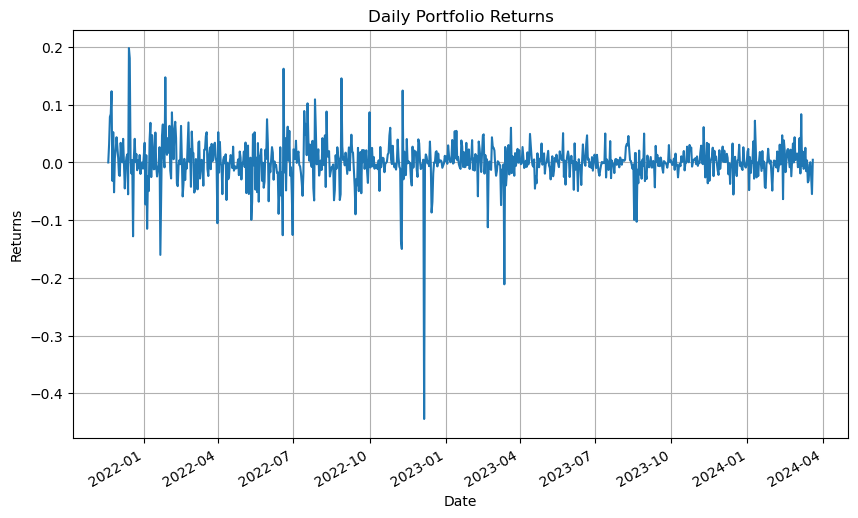

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


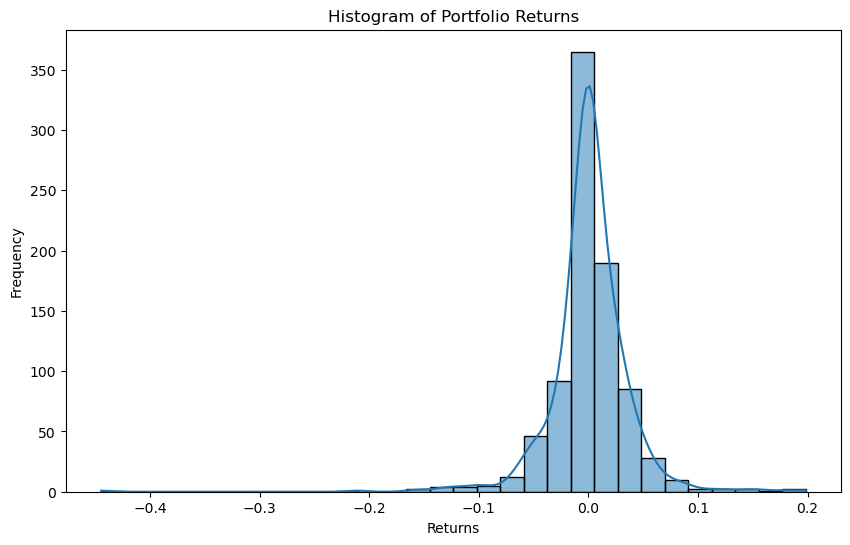

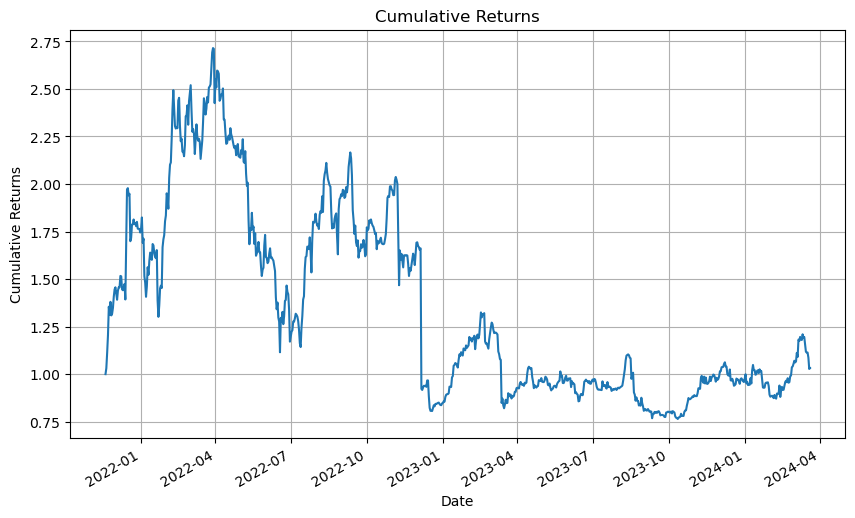

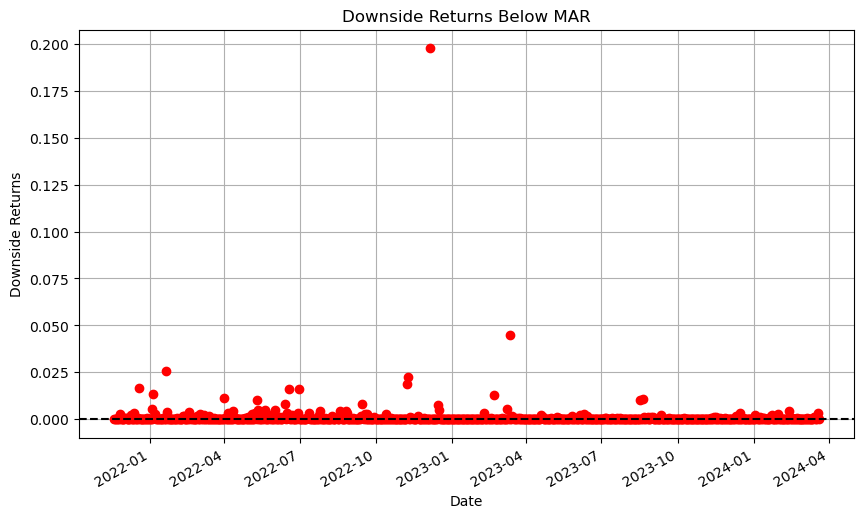

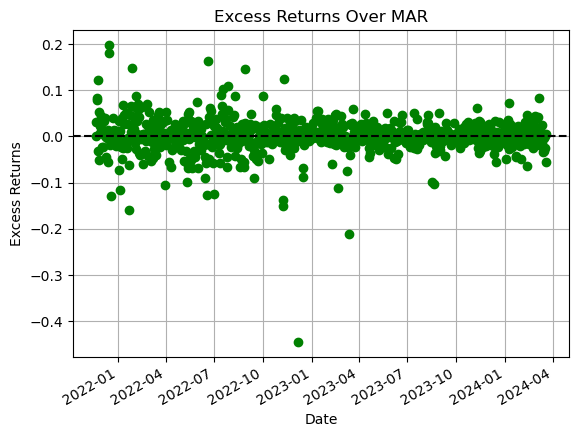

day
2021-11-19 00:00:00+00:00   1.00000
2021-11-20 00:00:00+00:00   1.03107
2021-11-21 00:00:00+00:00   1.11253
2021-11-22 00:00:00+00:00   1.20590
2021-11-23 00:00:00+00:00   1.35465
                              ...  
2024-03-16 00:00:00+00:00   1.11328
2024-03-17 00:00:00+00:00   1.11374
2024-03-18 00:00:00+00:00   1.08674
2024-03-19 00:00:00+00:00   1.02718
2024-03-20 00:00:00+00:00   1.03192
Length: 854, dtype: float64

In [821]:
#optimized portfolio on whole data set

visualize_mvo_results(optimized_daily_returns, optimized_downside_returns, optimized_excess_returns)

In [822]:
historical_daily_returns, historical_downside_returns, historical_excess_returns, historical_sortino_ratio = historical_sortino(all_data_returns, all_data_composition)

Daily downside deviation: 0.01854356399089347
Annualized downside deviation: 0.35427429260643756
Annualized excess return: -0.2048068875310305
Portfolio Sortino Ratio: -0.5781025939653769


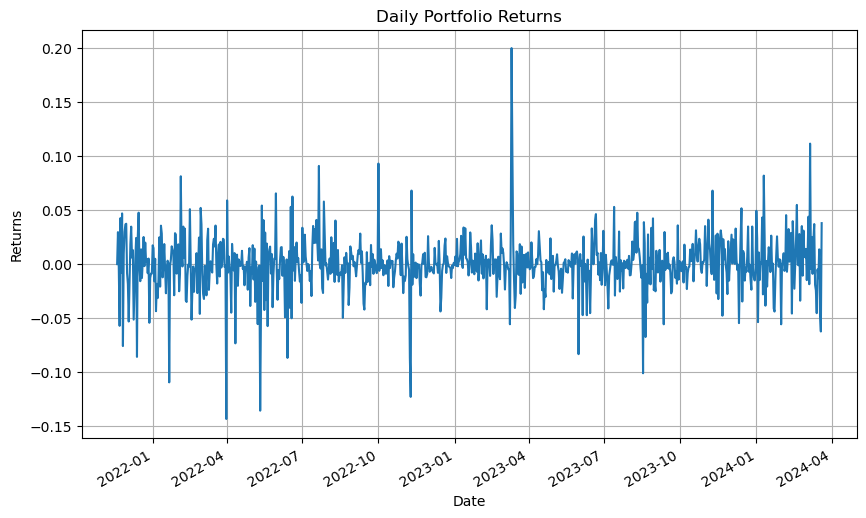

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


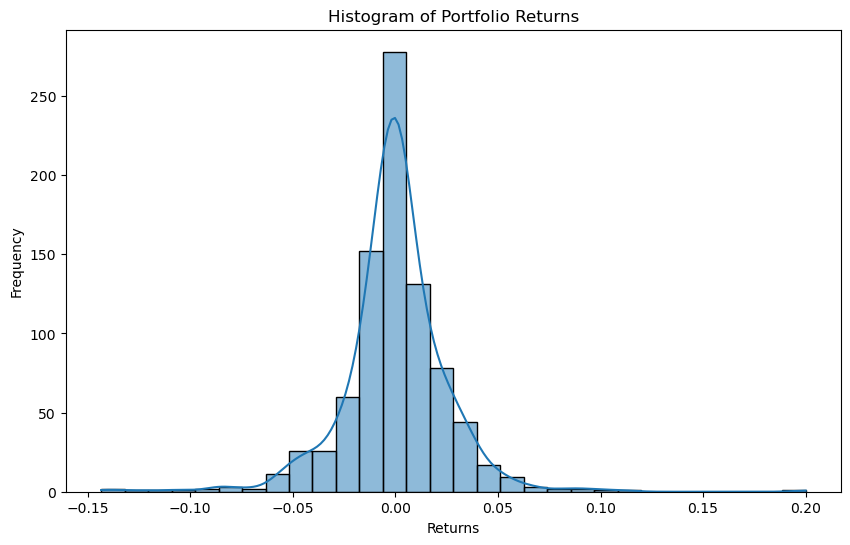

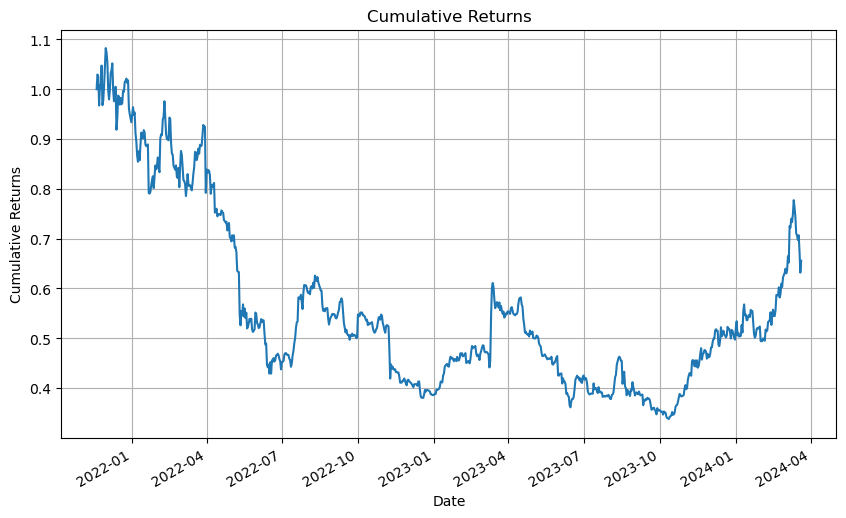

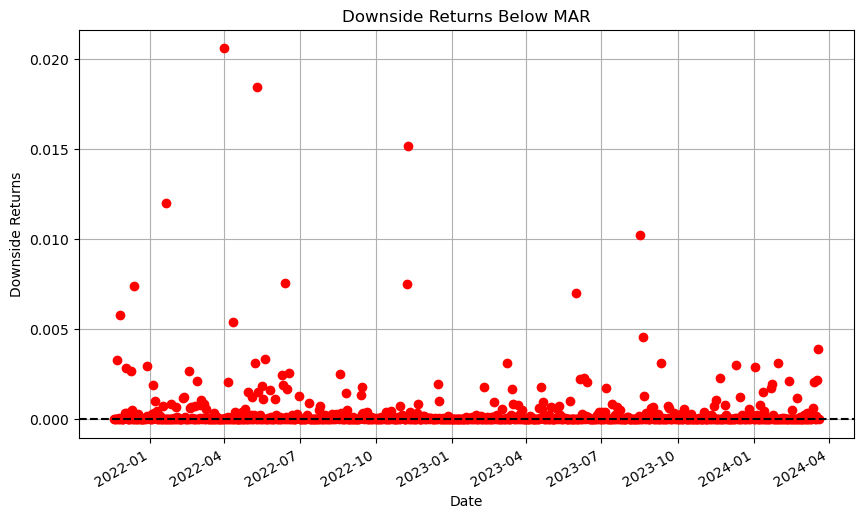

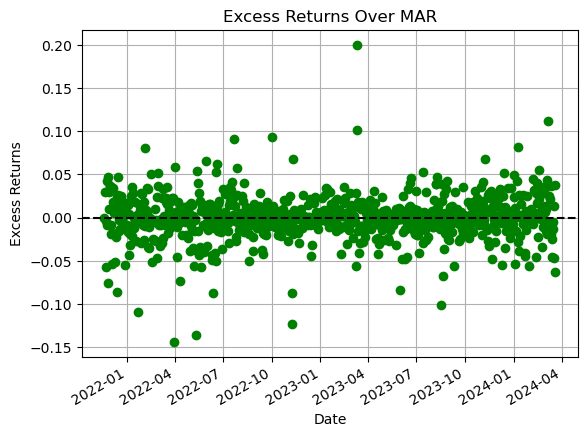

day
2021-11-19 00:00:00+00:00   1.00000
2021-11-20 00:00:00+00:00   1.02959
2021-11-21 00:00:00+00:00   1.02598
2021-11-22 00:00:00+00:00   0.96734
2021-11-23 00:00:00+00:00   1.00855
                              ...  
2024-03-16 00:00:00+00:00   0.69732
2024-03-17 00:00:00+00:00   0.70683
2024-03-18 00:00:00+00:00   0.67387
2024-03-19 00:00:00+00:00   0.63181
2024-03-20 00:00:00+00:00   0.65578
Length: 854, dtype: float64

In [823]:
#historical mvo on whole dataset 

visualize_mvo_results(historical_daily_returns, historical_downside_returns, historical_excess_returns)

In [824]:
first_year_mvo, first_year_returns, first_year_composition, first_year_portfolio_val = mvo(first_year)

Individual Sortino Ratios: BTC Vault_collateral_usd          -1.98971
ETH Vault_collateral_usd          -2.68098
stETH Vault_collateral_usd         3.61447
Stablecoin Vault_collateral_usd   -0.56935
Altcoin Vault_collateral_usd      -1.99591
LP Vault_collateral_usd            0.97012
RWA Vault_collateral_usd          -0.06737
PSM Vault_collateral_usd           0.04349
dtype: float64
Optimized weights: [0.1  0.05 0.5  0.1  0.01 0.22 0.01 0.01]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


In [825]:
optimized_sortino(first_year_returns, first_year_mvo)

Daily downside deviation: 0.025759344087783895
Annualized downside deviation: 0.492131577790929
Annualized excess return: 1.3929079561348057
Sortino Ratio: 2.8303567968291423


(day
 2021-11-19 00:00:00+00:00    0.00000
 2021-11-20 00:00:00+00:00    0.03257
 2021-11-21 00:00:00+00:00    0.08057
 2021-11-22 00:00:00+00:00    0.09597
 2021-11-23 00:00:00+00:00    0.11458
                               ...   
 2022-11-15 00:00:00+00:00    0.03679
 2022-11-16 00:00:00+00:00    0.00321
 2022-11-17 00:00:00+00:00    0.00026
 2022-11-18 00:00:00+00:00   -0.00084
 2022-11-19 00:00:00+00:00   -0.00022
 Length: 366, dtype: float64,
 array([1.78705074e-08, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 9.88190900e-04, 0.00000000e+00, 5.99173026e-03,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 5.37450106e-04, 2.07891618e-04, 0.00000000e+00,
        0.00000000e+00, 3.32687456e-05, 0.00000000e+00, 3.41826985e-05,
        1.23990995e-03, 4.89480324e-06, 0.00000000e+00, 5.63828686e-05,
        1.57426952e-03, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        2.61596714e-04, 0.00000000e+00, 1.5

In [826]:
historical_sortino(first_year_returns, first_year_composition)

Daily downside deviation: 0.022358852399151287
Annualized downside deviation: 0.4271652752993472
Annualized excess return: -0.5883791427867286
Portfolio Sortino Ratio: -1.3774039623759367


(day
 2021-11-19 00:00:00+00:00    0.00000
 2021-11-20 00:00:00+00:00    0.02959
 2021-11-21 00:00:00+00:00   -0.00350
 2021-11-22 00:00:00+00:00   -0.05716
 2021-11-23 00:00:00+00:00    0.04260
                               ...   
 2022-11-15 00:00:00+00:00    0.00139
 2022-11-16 00:00:00+00:00   -0.01299
 2022-11-17 00:00:00+00:00    0.00025
 2022-11-18 00:00:00+00:00   -0.00170
 2022-11-19 00:00:00+00:00   -0.00043
 Length: 366, dtype: float64,
 array([1.78705074e-08, 0.00000000e+00, 1.32139680e-05, 3.28226590e-03,
        0.00000000e+00, 6.64893865e-05, 0.00000000e+00, 5.77662027e-03,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        7.17330721e-05, 3.46858754e-04, 2.84073879e-03, 3.35253387e-04,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        2.65810663e-03, 4.88204929e-04, 0.00000000e+00, 0.00000000e+00,
        7.40295441e-03, 0.00000000e+00, 0.00000000e+00, 7.94177674e-06,
        2.54734840e-04, 0.00000000e+00, 1.6

In [827]:
second_year_mvo, second_year_returns, second_year_composition, second_year_portfolio_val = mvo(second_year)

Individual Sortino Ratios: BTC Vault_collateral_usd          -0.38803
ETH Vault_collateral_usd           0.10737
stETH Vault_collateral_usd         0.65682
Stablecoin Vault_collateral_usd   -3.82012
Altcoin Vault_collateral_usd      -2.02633
LP Vault_collateral_usd           -0.81361
RWA Vault_collateral_usd           0.84991
PSM Vault_collateral_usd          -0.74684
dtype: float64
Optimized weights: [0.1  0.25 0.5  0.1  0.01 0.01 0.02 0.01]


C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


In [828]:
second_year_returns

,BTC Vault_collateral_usd,ETH Vault_collateral_usd,stETH Vault_collateral_usd,Stablecoin Vault_collateral_usd,Altcoin Vault_collateral_usd,LP Vault_collateral_usd,RWA Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,
2022-11-20 00:00:00+00:00,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000,0.00000
2022-11-21 00:00:00+00:00,-0.05453,-0.04816,-0.05007,0.00000,-0.00210,-0.00019,-0.00000,-0.01987
2022-11-22 00:00:00+00:00,0.02507,0.01661,0.04066,0.00000,0.00351,0.02542,0.00000,-0.04529
2022-11-23 00:00:00+00:00,0.02145,0.03718,0.01098,0.00000,0.00083,-0.35466,0.00000,0.06439
2022-11-24 00:00:00+00:00,-0.04638,0.02106,0.04335,-0.00000,0.00011,-0.00839,0.00000,0.01427
...,...,...,...,...,...,...,...,...
2023-11-15 00:00:00+00:00,0.08601,0.01263,0.04420,-0.00000,-0.00033,-0.01303,0.00000,-0.00115
2023-11-16 00:00:00+00:00,-0.04927,-0.02309,-0.04416,0.00000,0.00000,0.00001,0.00000,-0.04772
2023-11-17 00:00:00+00:00,0.01051,-0.01066,-0.00654,0.00000,0.00000,0.00000,0.00000,0.24609


In [829]:
optimized_sortino(second_year_returns, second_year_mvo)

Daily downside deviation: 0.030724041375039982
Annualized downside deviation: 0.5869819862836819
Annualized excess return: -0.35640974212648735
Sortino Ratio: -0.6071902553313424


(day
 2022-11-20 00:00:00+00:00    0.00000
 2022-11-21 00:00:00+00:00   -0.04275
 2022-11-22 00:00:00+00:00    0.02682
 2022-11-23 00:00:00+00:00    0.01404
 2022-11-24 00:00:00+00:00    0.02236
                               ...   
 2023-11-15 00:00:00+00:00    0.03371
 2023-11-16 00:00:00+00:00   -0.03325
 2023-11-17 00:00:00+00:00   -0.00242
 2023-11-18 00:00:00+00:00    0.00577
 2023-11-19 00:00:00+00:00    0.01014
 Length: 365, dtype: float64,
 array([1.78705074e-08, 1.83883817e-03, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 7.52393427e-06,
        7.38168112e-04, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        1.26959442e-04, 2.46717571e-05, 7.62769029e-05, 0.00000000e+00,
        1.99212352e-01, 5.53685083e-05, 0.00000000e+00, 0.00000000e+00,
        4.06461441e-06, 0.00000000e+00, 6.40167850e-05, 0.00000000e+00,
        7.98094645e-08, 7.41512444e-03, 5.25866700e-03, 3.94871388e-04,
        1.02483098e-08, 5.78584798e-07, 0.0

In [830]:
historical_sortino(second_year_returns, second_year_composition)

Daily downside deviation: 0.01425607796304451
Annualized downside deviation: 0.2723619870581561
Annualized excess return: 0.05441483627634813
Portfolio Sortino Ratio: 0.19978865943847443


(day
 2022-11-20 00:00:00+00:00    0.00000
 2022-11-21 00:00:00+00:00   -0.02919
 2022-11-22 00:00:00+00:00   -0.00118
 2022-11-23 00:00:00+00:00    0.00112
 2022-11-24 00:00:00+00:00    0.00914
                               ...   
 2023-11-15 00:00:00+00:00    0.02815
 2023-11-16 00:00:00+00:00   -0.03238
 2023-11-17 00:00:00+00:00    0.00771
 2023-11-18 00:00:00+00:00    0.02343
 2023-11-19 00:00:00+00:00    0.03119
 Length: 365, dtype: float64,
 array([1.78705074e-08, 8.59755255e-04, 1.71685967e-06, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 1.44164052e-04,
        1.52782519e-04, 8.24565312e-05, 0.00000000e+00, 0.00000000e+00,
        5.21260738e-05, 2.89262510e-05, 7.22604301e-06, 3.78719535e-05,
        5.49304955e-05, 7.72782190e-05, 0.00000000e+00, 0.00000000e+00,
        4.36319969e-07, 0.00000000e+00, 6.74677128e-05, 0.00000000e+00,
        0.00000000e+00, 1.93489639e-03, 9.74276560e-04, 4.19205759e-05,
        3.35873740e-07, 0.00000000e+00, 0.0

## Action Space

Model will not adjust RWA vault as that is a special vault.  

### Discrete Action Space

# Generate all possible combinations of actions for the vaults
def get_action_space():
    # Number of vault types
    vault_names = ['ETH', 'stETH', 'BTC', 'Altcoin', 'Stablecoin', 'LP', 'PSM']
        for vault in vault_names:
    
    # Actions percentages
    action_percentages = [-0.1, -0.05, 0, 0.05, 0.1]
    actions = [{f'{vault_name} Vault': {action_percentage}' for _ in range(24), f'{vault_name} Vault': {action_percentage}' for _ in range(24)]  # Example: Adjust stETH up 5%, ETH down 5%
    #[{'stETH Vault': 5, 'ETH Vault': -5} for _ in range(24)]  # Example: Adjust stETH up 5%, ETH down 5%
    action_space = np.array(np.meshgrid(action_percentages, action_percentages, action_percentages)).T.reshape(-1, num_vaults)
    return action_space

    action_space = get_action_space()
    print("Action Space:")
    print(action_space)


### Continuos Action Space

import gym
from gym import spaces

class DaiCeilingEnv(gym.Env):
    def __init__(self):
        super(DaiCeilingEnv, self).__init__()

        # Number of vaults
        self.num_vaults = 3
        
        # Define action and observation space
        # Actions of the format (-0.1 to 0.1 for each vault)
        self.action_space = spaces.Box(low=-0.1, high=0.1, shape=(self.num_vaults,), dtype=np.float32)
        
        # Example observation space which you will need to define based on your state features
        self.observation_space = spaces.Box(low=0, high=np.inf, shape=(num_features,), dtype=np.float32)

    def step(self, action):
        # Implement what happens when an action is taken
        pass

    def reset(self):
        # Reset the state of the environment to an initial state
        pass

    def render(self, mode='human'):
        # Render the environment to the screen
        pass


### Reward Function 

In [831]:
def reward_function(portfolio_returns):
    #Calculate MVO weightings
    optimized_weights, returns, composition = mvo(portfolio_returns)
    target_weights = optimized_weights
    #calculate current weightings
    current_weights = composition.iloc[-1] #from mvo() function, this is the latest composition
    print('current weights', current_weights)
    #Calculate actual sortino
    current_daily_returns,  current_downside_returns, current_excess_returns, current_sortino_ratio = historical_sortino(returns, composition)
    target_daily_returns, target_downside_returns, target_excess_returns, target_sortino_ratio = optimized_sortino(returns, optimized_weights)
    print('current sortino',current_sortino_ratio)
    print('target sortino',target_sortino_ratio)
    
    # Distance from target weights
    distance_penalty = np.sum(np.abs(current_weights - target_weights))

    # Combining the metrics into a single reward
    reward = current_sortino_ratio - distance_penalty  # Higher Sortino and lower distance yield higher rewards
    return reward


## Multiregressor Testing

In [832]:
state_space

,ETH Vault_dai_ceiling,stETH Vault_dai_ceiling,BTC Vault_dai_ceiling,Altcoin Vault_dai_ceiling,Stablecoin Vault_dai_ceiling,LP Vault_dai_ceiling,PSM Vault_dai_ceiling,PSM Vault_collateral_usd_7d_ma,BTC Vault_collateral_usd_7d_ma,ETH Vault_collateral_usd_7d_ma,...,btc_market_Volume_30d_ma,btc_market_Volume_30d_ma,eth_market_Volume_30d_ma,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,,,,,,,,,,,,,,,
2021-11-19 00:00:00+00:00,"4,215,499,587.09872","16,779,001.87837","1,398,087,189.04925","170,858,309.36176","5,000,000.00000","352,901,603.86001","3,593,103,707.31785","2,087,989,128.99971","2,797,216,365.73992","11,764,650,156.64727",...,"35,938,937,154.73333","35,938,937,154.73333","19,097,892,226.93333","11,530,810,569.93515","39,769,944.75450","2,866,222,769.09959","520,045,444.90519","336,521,697.42675","412,562,137.86644","2,132,251,251.20941"
2021-11-20 00:00:00+00:00,"4,185,875,620.48578","17,284,635.75812","1,393,749,077.71651","171,141,983.01782","5,000,000.00000","372,841,835.68929","3,604,384,386.93336","2,095,894,278.03591","2,810,626,553.33763","11,686,361,716.76668",...,"35,429,475,271.16666","35,429,475,271.16666","18,672,145,542.16667","11,943,278,353.68762","41,280,230.12684","2,948,959,833.37399","508,972,390.70129","336,521,697.42675","430,562,322.97248","2,164,546,578.27289"
2021-11-21 00:00:00+00:00,"4,185,229,052.82756","19,140,998.34184","1,407,300,021.86314","171,131,567.49223","5,000,000.00000","378,293,238.31257","3,604,384,386.93336","2,111,854,155.01873","2,825,455,786.71808","11,641,751,704.71843",...,"35,019,120,765.50000","35,019,120,765.50000","18,494,208,657.00000","11,839,472,041.02766","48,477,796.29037","2,951,818,107.21472","505,016,705.04971","336,521,697.42675","431,500,082.06578","2,195,743,029.10143"
2021-11-22 00:00:00+00:00,"4,167,338,922.83872","22,170,168.94489","1,437,967,464.63631","159,239,990.91266","5,000,000.00000","378,299,770.81950","3,674,297,040.97279","2,132,391,088.44761","2,820,168,046.72430","11,458,889,198.47886",...,"35,290,906,623.80000","35,290,906,623.80000","18,659,898,026.50000","10,933,452,742.14960","59,724,075.18165","2,788,017,226.13774","509,504,043.07337","336,503,182.74675","433,806,450.38492","2,215,601,174.20796"
2021-11-23 00:00:00+00:00,"4,152,215,276.92244","23,065,851.72446","1,435,093,757.47548","158,801,066.38277","5,000,000.00000","378,879,291.14350","3,670,722,718.34453","2,161,821,212.57792","2,845,182,196.03813","11,479,291,732.82739",...,"35,629,893,957.70000","35,629,893,957.70000","18,898,411,807.20000","11,600,116,135.99997","74,570,808.78308","2,821,788,807.21326","500,427,709.74620","336,503,182.74675","432,619,037.81609","2,258,244,677.18063"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-03-16 00:00:00+00:00,"967,253,018.36636","608,732,014.19748","211,833,342.37973","1,000,000.00000",0.00000,0.00000,"1,191,410,955.71145","572,243,845.20727","719,718,313.61811","4,132,087,593.23641",...,"44,076,475,716.16666","44,076,475,716.16666","21,816,958,204.30000","3,752,247,535.61763","2,417,541,115.80447","693,532,316.12871","1,944,419.59103","99,227.46740","97,377,612.28187","567,092,988.70479"
2024-03-17 00:00:00+00:00,"967,253,018.36636","608,732,014.19748","212,059,110.70835","1,000,000.00000",0.00000,0.00000,"1,191,410,955.71145","571,329,660.81181","718,525,006.82250","4,058,656,482.11356",...,"44,900,068,159.90000","44,900,068,159.90000","21,883,837,442.70000","3,803,584,313.35047","2,393,113,805.45610","706,205,158.85654","1,944,419.59103","99,227.46740","97,379,575.13498","631,684,264.91900"
2024-03-18 00:00:00+00:00,"967,253,018.36636","587,778,544.53665","220,631,595.82640","1,000,000.00000",0.00000,0.00000,"1,273,620,575.48603","519,543,877.22678","714,433,480.10772","3,958,516,370.16250",...,"45,955,608,232.60000","45,955,608,232.60000","21,81

In [833]:
print(list(st_aggregated_vault_data.columns))

['BTC Vault_dai_ceiling', 'BTC Vault_dai_floor', 'BTC Vault_debt_balance', 'BTC Vault_daily_revenues', 'BTC Vault_annualized_revenues', 'BTC Vault_dart', 'BTC Vault_prev_dai_ceiling', 'BTC Vault_collateral_usd', 'BTC Vault_hypothetical_dai_ceiling', 'ETH Vault_dai_ceiling', 'ETH Vault_dai_floor', 'ETH Vault_debt_balance', 'ETH Vault_daily_revenues', 'ETH Vault_annualized_revenues', 'ETH Vault_dart', 'ETH Vault_prev_dai_ceiling', 'ETH Vault_collateral_usd', 'ETH Vault_hypothetical_dai_ceiling', 'stETH Vault_dai_ceiling', 'stETH Vault_dai_floor', 'stETH Vault_debt_balance', 'stETH Vault_daily_revenues', 'stETH Vault_annualized_revenues', 'stETH Vault_dart', 'stETH Vault_prev_dai_ceiling', 'stETH Vault_collateral_usd', 'stETH Vault_hypothetical_dai_ceiling', 'Stablecoin Vault_dai_ceiling', 'Stablecoin Vault_dai_floor', 'Stablecoin Vault_debt_balance', 'Stablecoin Vault_daily_revenues', 'Stablecoin Vault_annualized_revenues', 'Stablecoin Vault_dart', 'Stablecoin Vault_prev_dai_ceiling', 'S

In [834]:
pearson_y_correlations = st_aggregated_vault_data[['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']].corr()
spearman_y_correlations = st_aggregated_vault_data[['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']].corr('spearman')

R² on the training set: [0.99961389 0.99782754 0.99797011 0.99567256 0.99768812 0.99550128
 0.99926   ]
R² on the testing set: [0.99931985 0.9960579  0.99636177 0.99126761 0.98167332 0.99118365
 0.99869674]
MAE on test set: [47122182.83452615 30170052.20920849 29707626.77325191  9021091.42411598
  4391382.01097354 19956717.98590583 34680764.83828258]
MAE on test set: [35985269.24485278 25340303.793663   23318927.1406252   6493071.83043291
  2568625.53825334 14721013.5456189  28349788.47134456]


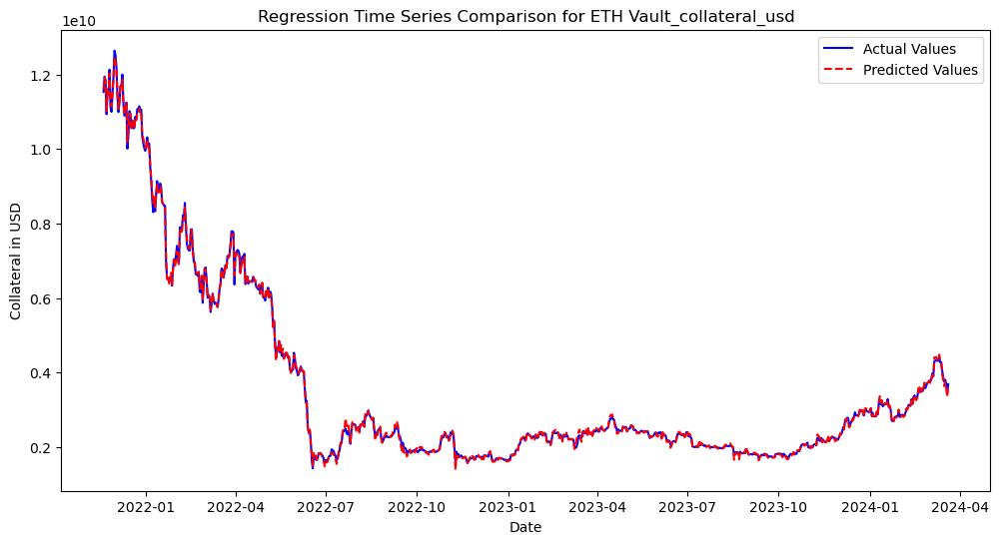

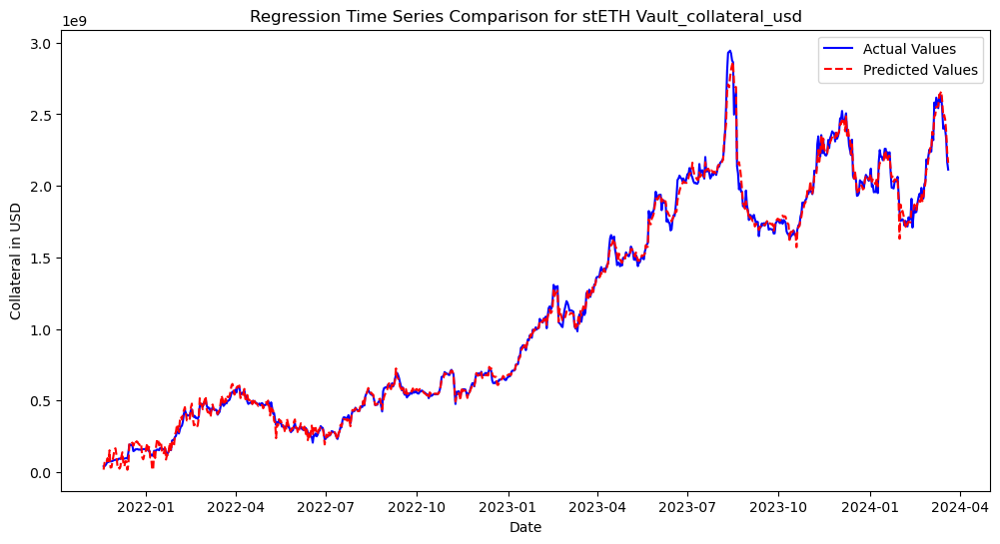

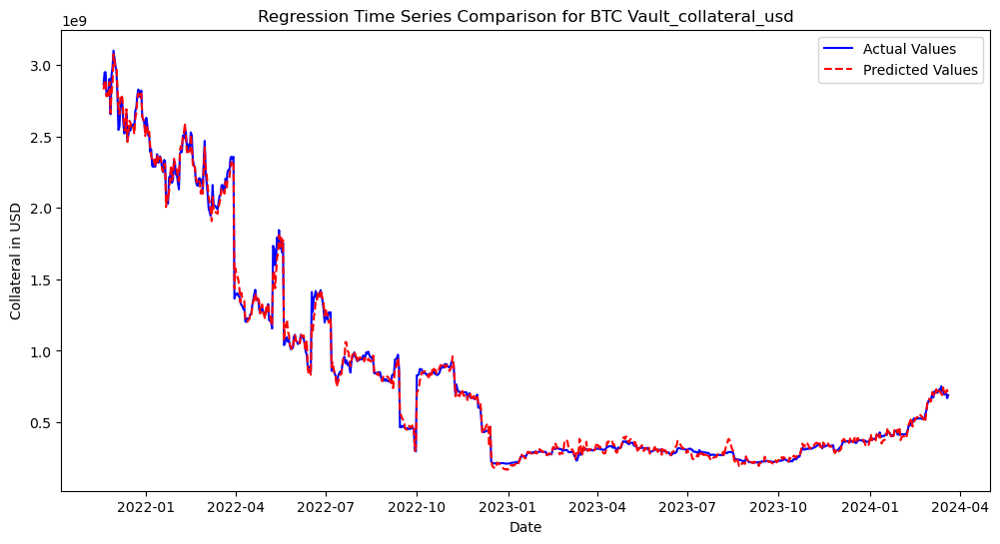

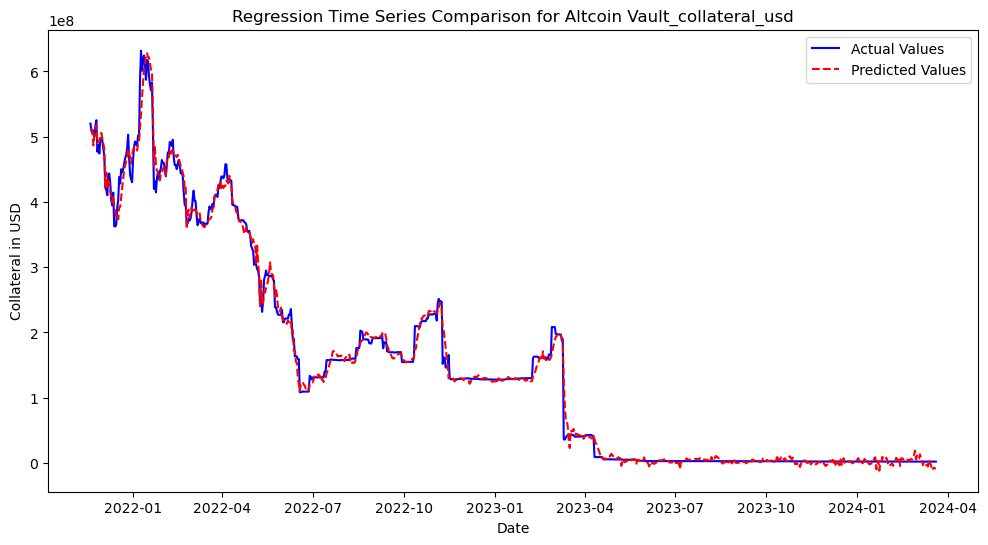

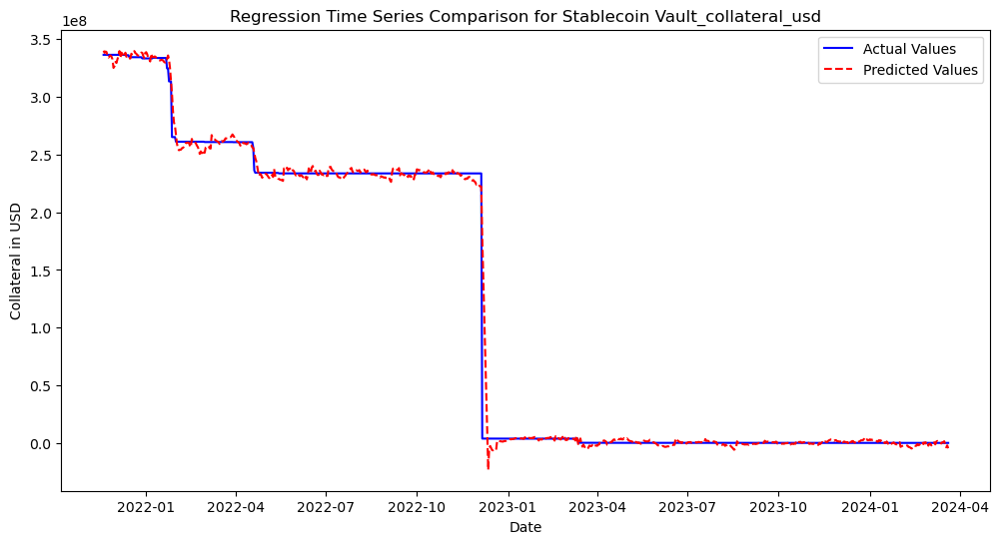

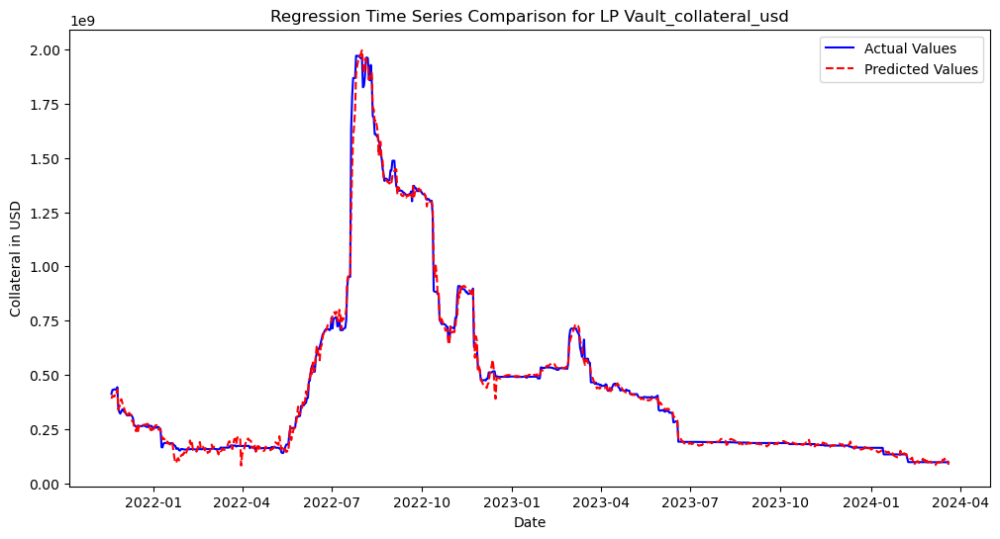

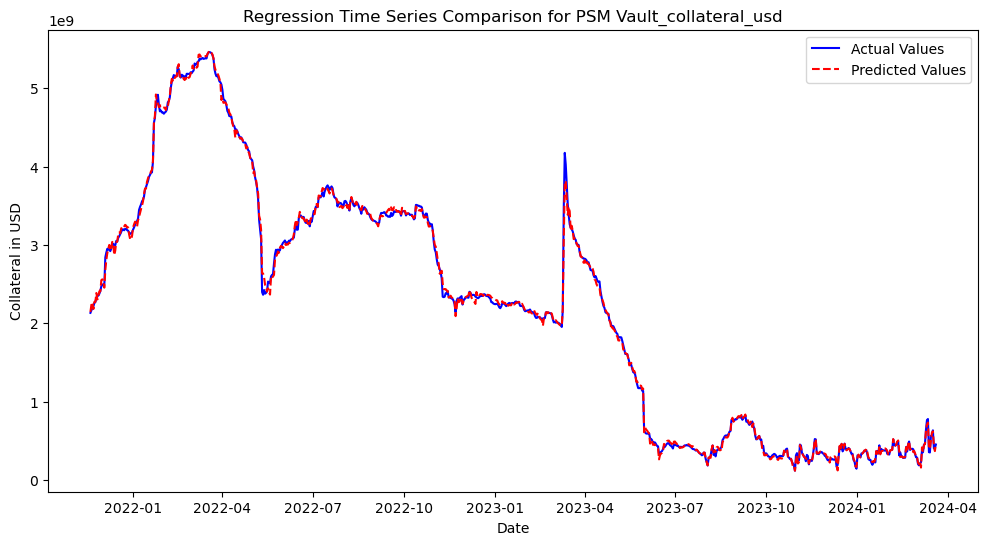

In [835]:
## Multiple Regression


# Example data
# X represents features including one Dai ceiling and possibly other market conditions
# y represents multiple vault balances (multi-output)
X = st_aggregated_vault_data[['ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling',
'PSM Vault_collateral_usd_7d_ma','BTC Vault_collateral_usd_7d_ma','ETH Vault_collateral_usd_7d_ma','stETH Vault_collateral_usd_7d_ma','Altcoin Vault_collateral_usd_7d_ma','LP Vault_collateral_usd_7d_ma','Stablecoin Vault_collateral_usd_7d_ma','RWA Vault_collateral_usd_7d_ma',
'BTC Vault_market_price', 'ETH Vault_market_price', 'stETH Vault_market_price', 'Stablecoin Vault_market_price', 'Altcoin Vault_market_price', 'LP Vault_market_price', 'PSM Vault_market_price', 'effective_funds_rate',
'M1V', 'WM2NS', 'fed_reverse_repo',
'ETH Vault_liquidation_ratio', 'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio', 'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio', 'LP Vault_liquidation_ratio', 'PSM Vault_liquidation_ratio',
'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total', 'where_is_dai_Bridge',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma',
'where_is_dai_Bridge', 'dai_market_Volume_30d_ma', 'dai_market_Volume_7d_ma','eth_market_Close_7d_ma','eth_market_Volume_30d_ma','btc_market_Close_7d_ma','btc_market_Volume_30d_ma',
'btc_market_Volume_30d_ma','eth_market_Volume_30d_ma']]

y = st_aggregated_vault_data[['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']] #maybe don't forecast psm since maybe cant capture usd vault 

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the MultiOutput Regressor with a RandomForest
model = MultiOutputRegressor(Ridge(alpha=300))

# Train the model
model.fit(X_train, y_train)




# Assuming 'model', 'X_train', 'X_test', 'y_train', 'y_test' are already defined and model is trained

# Make predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Compute R² score for each target on the training set
r2_scores_train = r2_score(y_train, y_train_pred, multioutput='raw_values')
print("R² on the training set:", r2_scores_train)

# Compute R² score for each target on the testing set
r2_scores_test = r2_score(y_test, y_test_pred, multioutput='raw_values')
print("R² on the testing set:", r2_scores_test)

# Evaluate the model
error = mean_absolute_error(y_test, y_test_pred, multioutput='raw_values')
print("MAE on test set:", error)

error = mean_absolute_error(y_train, y_train_pred, multioutput='raw_values')
print("MAE on test set:", error)

plot_regression_time_series(X_train, X_test, y_train, y_test, y_train_pred, y_test_pred, "Regression Time Series Comparison")
# Initialize the linear regression model


### Regressor Feature Ranking



X = st_aggregated_vault_data.drop(columns=['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd'])

y = st_aggregated_vault_data[['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']] #maybe don't forecast psm since maybe cant capture usd vault 

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Assuming X_train and y_train are already defined
forest = RandomForestRegressor(n_estimators=100)
forest.fit(X_train, y_train)

# Get feature importances
importances = forest.feature_importances_
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")
for f in range(X_train.shape[1]):
    print(f"{f + 1}. feature {X_train.columns[indices[f]]} ({importances[indices[f]]})")


# Absolute threshold
threshold = 0  # Keep features with importance greater than 0.01
important_features = X_train.columns[importances > threshold]
print("Important features:", important_features)


### PCA



# Create a pipeline that includes PCA, scaling, and regression
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=0.95)),  # Retain 95% of variance
    ('regressor', MultiTaskLassoCV(cv=5, random_state=0))
])

# Fit the pipeline
pipeline.fit(X_train, y_train)

# You can access individual steps if you need, for example:
print("PCA Components Shape:", pipeline.named_steps['pca'].components_.shape)
print("Regression Coefficients:", pipeline.named_steps['regressor'].coef_)


### variance_inflation_factor

### Multiregressor CV

C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.06154e-16): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=7.625e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=4.41815e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.8096e-17): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-

Cross-validated MAE scores: [290174821.3943269, 56154640.09343232, 125539464.22454114, 64405922.338996686, 80180262.07464717]
Cross-validated R-squared scores: [0.5850721763769579, 0.9648673915770304, 0.9240521651840629, 0.7987567346901993, 0.09926013068498707]


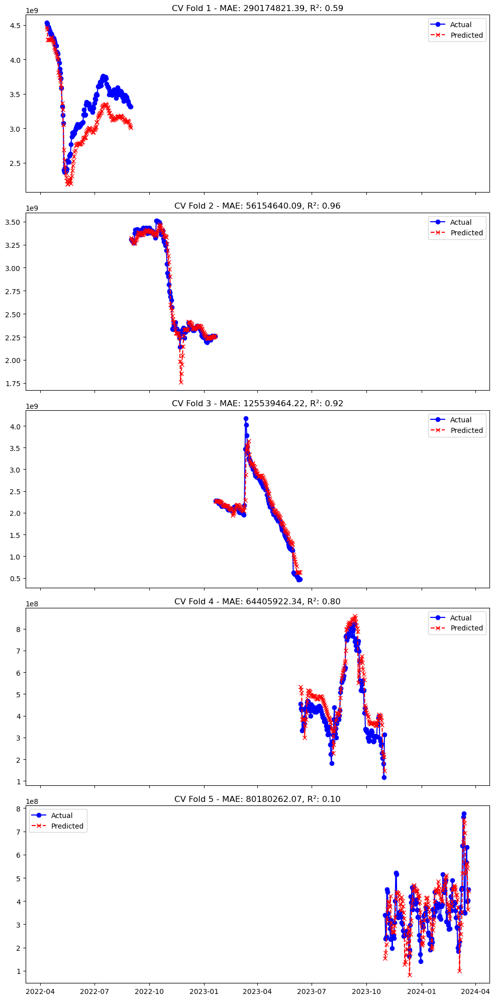

In [836]:
# Assuming 'x_st' has a datetime index or similar for plotting
def plot_cv_results(x_st, y_st, model, cv, title_base="CV Fold"):
    fig, axes = plt.subplots(nrows=cv.get_n_splits(), ncols=1, figsize=(10, 20), sharex=True)
    
    for idx, (train_index, test_index) in enumerate(cv.split(x_st)):
        X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
        y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

        # Fit the model
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Plot
        ax = axes[idx]
        ax.plot(X_test.index, y_test, label='Actual', color='blue', marker='o')
        ax.plot(X_test.index, y_pred, label='Predicted', linestyle='--', color='red', marker='x')
        ax.set_title(f"{title_base} {idx+1} - MAE: {mean_absolute_error(y_test, y_pred):.2f}, R²: {r2_score(y_test, y_pred):.2f}")
        ax.legend()
    
    plt.tight_layout()
    plt.show()
    
model_st = Ridge(alpha=100000.0)

tscv = TimeSeriesSplit(n_splits=5)
mae_scores, r2_scores = [], []

for train_index, test_index in tscv.split(x_st):
    X_train, X_test = x_st.iloc[train_index], x_st.iloc[test_index]
    y_train, y_test = y_st.iloc[train_index], y_st.iloc[test_index]

    model_st.fit(X_train, y_train)
    y_pred = model_st.predict(X_test)

    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))

print("Cross-validated MAE scores:", mae_scores)
print("Cross-validated R-squared scores:", r2_scores)



model_st = Ridge(alpha=100000.0)
tscv = TimeSeriesSplit(n_splits=5)

# Call the function to plot CV results
plot_cv_results(x_st, y_st, model_st, tscv)


In [837]:


def plot_multioutput_cv_results(X, y, n_splits=5, alpha=100, title="CV Results with Ridge Regularization"):
    tscv = TimeSeriesSplit(n_splits=n_splits)
    fig, axes = plt.subplots(nrows=n_splits, ncols=1, figsize=(15, 3 * n_splits))

    # Using Ridge with regularization
    for idx, (train_index, test_index) in enumerate(tscv.split(X)):
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = y.iloc[train_index], y.iloc[test_index]

        # Multioutput with Ridge regression
        model = MultiOutputRegressor(Ridge(alpha=alpha))
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        mae = mean_absolute_error(y_test, y_pred, multioutput='raw_values')
        r2 = r2_score(y_test, y_pred, multioutput='raw_values')

        ax = axes[idx]
        # Assuming the first output for simplicity in plotting
        ax.plot(y_test.index, y_test.iloc[:, 0], label='Actual', marker='o', linestyle='-', color='blue')
        ax.plot(y_test.index, y_pred[:, 0], label='Predicted', marker='x', linestyle='--', color='red')
        ax.set_title(f"{title} {idx+1} - MAE: {mae[0]:.2f}, R²: {r2[0]:.2f}")
        ax.legend()

    plt.tight_layout()
    plt.show()



### Nan checker

In [838]:

X = st_aggregated_vault_data[['ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling',
'PSM Vault_collateral_usd_7d_ma','BTC Vault_collateral_usd_7d_ma','ETH Vault_collateral_usd_7d_ma','stETH Vault_collateral_usd_7d_ma','Altcoin Vault_collateral_usd_7d_ma','LP Vault_collateral_usd_7d_ma','Stablecoin Vault_collateral_usd_7d_ma','RWA Vault_collateral_usd_7d_ma',
'BTC Vault_market_price', 'ETH Vault_market_price', 'stETH Vault_market_price', 'Stablecoin Vault_market_price', 'Altcoin Vault_market_price', 'LP Vault_market_price', 'PSM Vault_market_price', 'effective_funds_rate',
'M1V', 'WM2NS', 'fed_reverse_repo',
'ETH Vault_liquidation_ratio', 'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio', 'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio', 'LP Vault_liquidation_ratio', 'PSM Vault_liquidation_ratio',
'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total', 'where_is_dai_Bridge',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma',
'where_is_dai_Bridge', 'dai_market_Volume_30d_ma', 'dai_market_Volume_7d_ma','eth_market_Close_7d_ma','eth_market_Volume_30d_ma','btc_market_Close_7d_ma','btc_market_Volume_30d_ma',
'btc_market_Volume_30d_ma','eth_market_Volume_30d_ma','Altcoin Vault_prev_dai_ceiling_7d_ma']]
# Check for NaNs across the DataFrame
na_columns = X.isna().any()

# Columns that contain at least one NaN value
na_cols = na_columns[na_columns].index.tolist()

# Display columns with NaNs and the rows in those columns that contain NaNs
for col in na_cols:
    # Display rows where NaN values are found in the specific column
    print(f"NaNs in column '{col}':")
    display(X[X[col].isna()])


### Best Regressor on 20% Test

Final Test MAE: [47053844.57916605 30142935.76557475 29408512.15814584  9013439.75447148
  4373559.05117562 19925800.20195042 33910994.36083271]
Final Test R²: [0.99932159 0.99606809 0.99638503 0.9913098  0.98168917 0.99121122
 0.99875326]


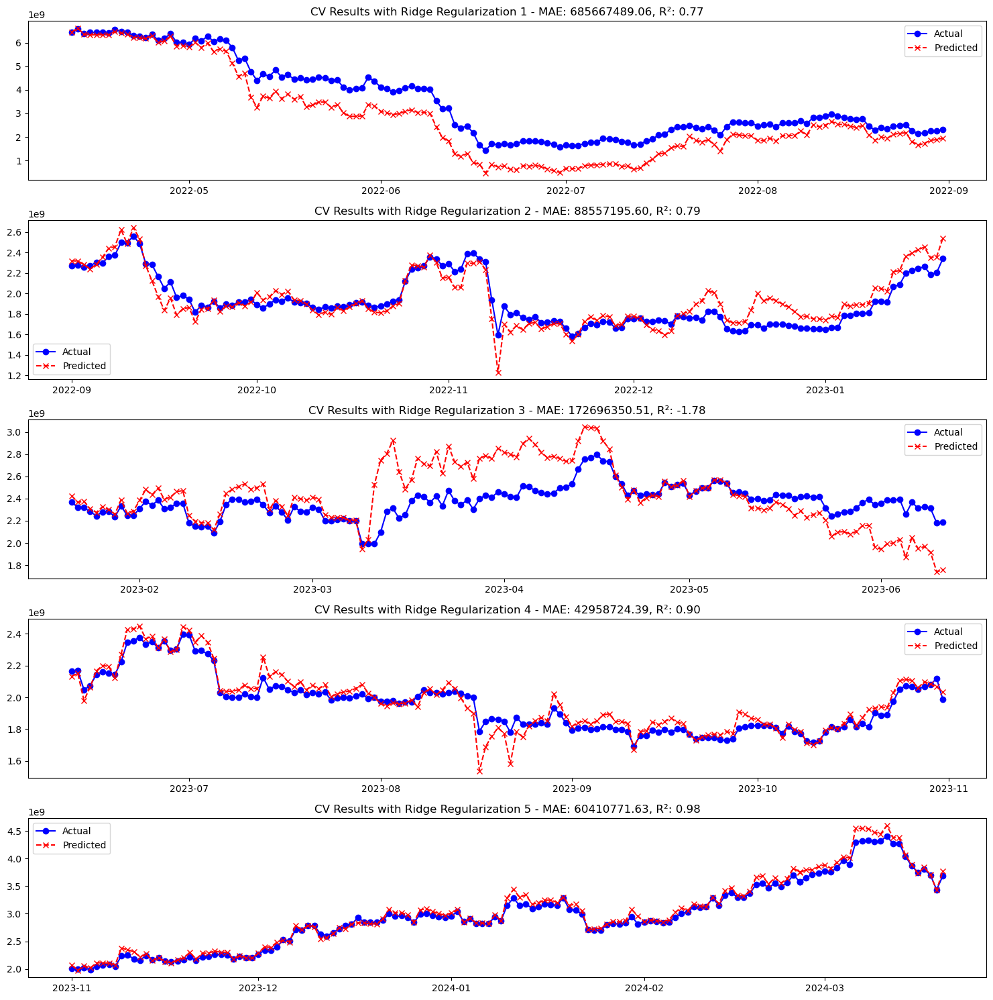

In [839]:


X = state_space[['ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling',
'PSM Vault_collateral_usd_7d_ma','BTC Vault_collateral_usd_7d_ma','ETH Vault_collateral_usd_7d_ma','stETH Vault_collateral_usd_7d_ma','Altcoin Vault_collateral_usd_7d_ma','LP Vault_collateral_usd_7d_ma','Stablecoin Vault_collateral_usd_7d_ma','RWA Vault_collateral_usd_7d_ma',
'BTC Vault_market_price', 'ETH Vault_market_price', 'stETH Vault_market_price', 'Stablecoin Vault_market_price', 'Altcoin Vault_market_price', 'LP Vault_market_price', 'effective_funds_rate',
'M1V', 'WM2NS', 'fed_reverse_repo',
'ETH Vault_liquidation_ratio', 'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio', 'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio', 'LP Vault_liquidation_ratio', 'PSM Vault_liquidation_ratio',
'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total', 'where_is_dai_Bridge',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma',
'where_is_dai_Bridge', 'dai_market_Volume_30d_ma', 'dai_market_Volume_7d_ma','eth_market_Close_7d_ma','eth_market_Volume_30d_ma','btc_market_Close_7d_ma','btc_market_Volume_30d_ma',
'btc_market_Volume_30d_ma','eth_market_Volume_30d_ma']]

y = state_space[['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']] #maybe don't forecast psm since maybe cant capture usd vault 

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

final_model = MultiOutputRegressor(Ridge(alpha=300))
final_model.fit(X_train, y_train)

# Predict on test data
y_pred_test = final_model.predict(X_test)

# Evaluate the final model on test data
final_test_mae = mean_absolute_error(y_test, y_pred_test, multioutput='raw_values')
final_test_r2 = r2_score(y_test, y_pred_test, multioutput='raw_values')

print("Final Test MAE:", final_test_mae)
print("Final Test R²:", final_test_r2)

plot_multioutput_cv_results(X, y, n_splits=5, alpha=300)

### Best Regressor on 80% Test

In [840]:
st_aggregated_vault_data[['mcap_market_cap', 'mcap_total_volume']]

,mcap_market_cap,mcap_total_volume
day,,
2021-11-19 00:00:00+00:00,"2,724,030,910,878.06689","148,816,900,268.08923"
2021-11-20 00:00:00+00:00,"2,802,897,963,229.93701","129,054,430,634.73094"
2021-11-21 00:00:00+00:00,"2,783,091,419,511.58691","119,273,368,298.65698"
2021-11-22 00:00:00+00:00,"2,675,984,959,163.48682","144,878,354,973.50381"
2021-11-23 00:00:00+00:00,"2,734,922,482,471.47314","154,531,715,413.08652"
...,...,...
2024-03-16 00:00:00+00:00,"2,630,249,413,779.42480","157,322,483,727.65988"
2024-03-17 00:00:00+00:00,"2,720,378,999,407.15332","157,140,337,241.97678"
2024-03-18 00:00:00+00:00,"2,666,873,636,094.64893","165,358,124,996.38553"


Final Test MAE: [67089503.63312876 47164643.4341255  51691217.21971465 18705096.35133917
 12984581.03438854 42351847.6833401  72155009.01253672]
Final Test R²: [0.99862061 0.99270292 0.99078732 0.97430022 0.97740114 0.97001598
 0.99550416]


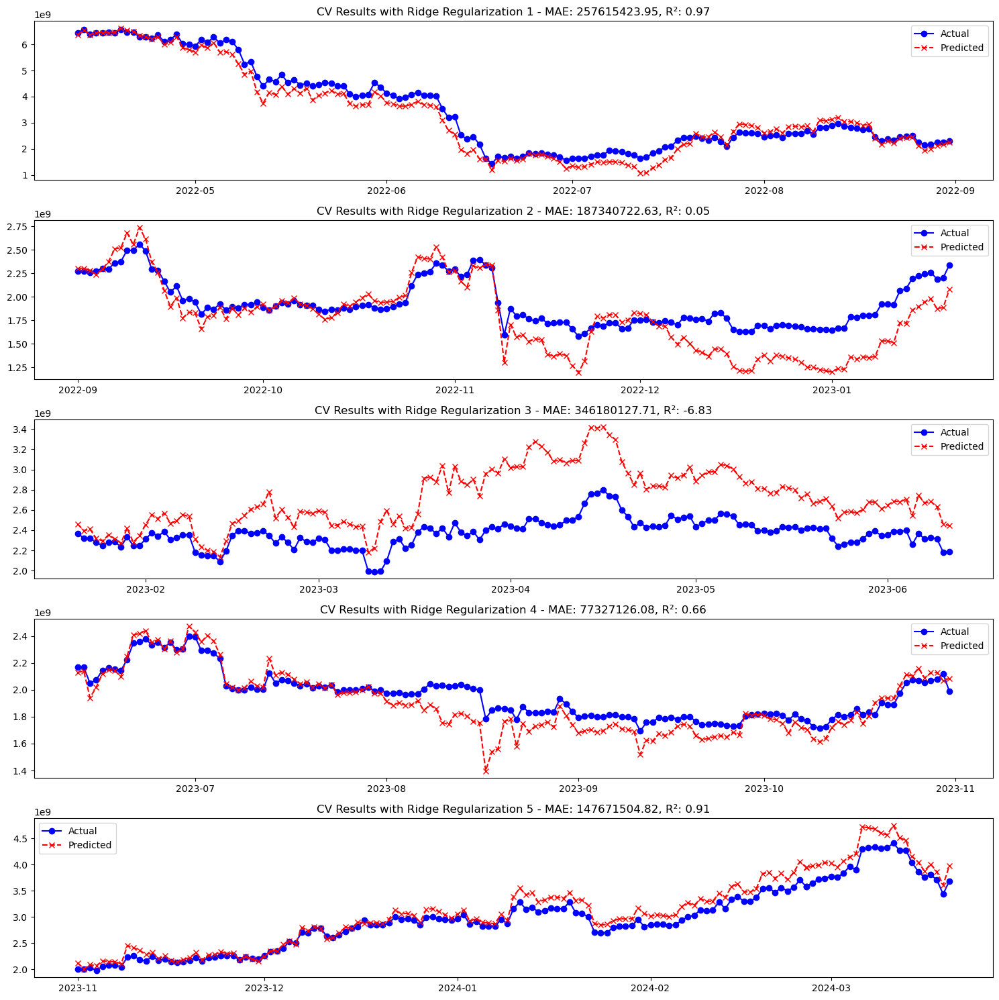

In [841]:


X = st_aggregated_vault_data[['ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling',
'mcap_total_volume', 'defi_apy_medianAPY', 'defi_apy_avg7day', 'dpi_market_Volume', 
'BTC Vault_market_price', 'ETH Vault_market_price', 'stETH Vault_market_price', 'Stablecoin Vault_market_price', 'Altcoin Vault_market_price', 'LP Vault_market_price', 'effective_funds_rate',
'M1V', 'WM2NS', 'fed_reverse_repo',
'ETH Vault_liquidation_ratio', 'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio', 'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio', 'LP Vault_liquidation_ratio', 
'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total', 'where_is_dai_Bridge',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma',
'where_is_dai_Bridge', 'dai_market_Volume_30d_ma', 'dai_market_Volume_7d_ma','eth_market_Close_7d_ma','eth_market_Volume_30d_ma','btc_market_Close_7d_ma','btc_market_Volume_30d_ma',
'btc_market_Volume_30d_ma','LP Vault_dai_floor_90d_ma_pct_change']]

y = st_aggregated_vault_data[['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']] #maybe don't forecast psm since maybe cant capture usd vault 

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8, random_state=42)

final_model = MultiOutputRegressor(Ridge(alpha=300))
final_model.fit(X_train, y_train)

# Predict on test data
y_pred_test = final_model.predict(X_test)

# Evaluate the final model on test data
final_test_mae = mean_absolute_error(y_test, y_pred_test, multioutput='raw_values')
final_test_r2 = r2_score(y_test, y_pred_test, multioutput='raw_values')

print("Final Test MAE:", final_test_mae)
print("Final Test R²:", final_test_r2)

plot_multioutput_cv_results(X, y, n_splits=5, alpha=400)

## Forecast Set Up

In [842]:
targets = ['ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd']
features = ['ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling',

'BTC Vault_market_price', 'ETH Vault_market_price', 'stETH Vault_market_price', 'Stablecoin Vault_market_price', 'Altcoin Vault_market_price', 'LP Vault_market_price', 'effective_funds_rate',
'M1V', 'WM2NS', 'fed_reverse_repo','mcap_total_volume','defi_apy_medianAPY', 'defi_apy_avg7day', 'dpi_market_Volume',
'ETH Vault_liquidation_ratio', 'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio', 'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio', 'LP Vault_liquidation_ratio', 
'RWA Vault_dai_ceiling',
'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma',
'where_is_dai_Bridge', 'dai_market_Volume_30d_ma', 'dai_market_Volume_7d_ma','eth_market_Close_7d_ma','eth_market_Volume_30d_ma','btc_market_Close_7d_ma',
'btc_market_Volume_30d_ma','LP Vault_dai_floor_90d_ma_pct_change'


       ]
l = ['PSM Vault_collateral_usd_7d_ma','BTC Vault_collateral_usd_7d_ma','ETH Vault_collateral_usd_7d_ma','stETH Vault_collateral_usd_7d_ma','Altcoin Vault_collateral_usd_7d_ma','LP Vault_collateral_usd_7d_ma','Stablecoin Vault_collateral_usd_7d_ma','RWA Vault_collateral_usd_7d_ma',]


temporal_features = ['ETH Vault_collateral_usd % of Total_7d_ma', 'ETH Vault_collateral_usd % of Total_30d_ma',
'stETH Vault_collateral_usd % of Total_7d_ma', 'stETH Vault_collateral_usd % of Total_30d_ma',
'BTC Vault_collateral_usd % of Total_7d_ma', 'BTC Vault_collateral_usd % of Total_30d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 'Altcoin Vault_collateral_usd % of Total_30d_ma',
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 'Stablecoin Vault_collateral_usd % of Total_30d_ma',
'LP Vault_collateral_usd % of Total_7d_ma', 'LP Vault_collateral_usd % of Total_30d_ma',
'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 'RWA Vault_collateral_usd % of Total_30d_ma']
descripts = [


'ETH Vault_collateral_usd','stETH Vault_collateral_usd','BTC Vault_collateral_usd','Altcoin Vault_collateral_usd','Stablecoin Vault_collateral_usd','LP Vault_collateral_usd','PSM Vault_collateral_usd',
'ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','PSM Vault_dai_ceiling'



]
temporals = [
 'BTC Vault_collateral_usd % of Total', 'ETH Vault_collateral_usd % of Total', 'stETH Vault_collateral_usd % of Total', 'where_is_dai_Bridge',
'Stablecoin Vault_collateral_usd % of Total', 'Altcoin Vault_collateral_usd % of Total', 'LP Vault_collateral_usd % of Total',
'RWA Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total', 'PSM Vault_collateral_usd % of Total_7d_ma', 'PSM Vault_collateral_usd % of Total_30d_ma',
'ETH Vault_collateral_usd % of Total_7d_ma', 
'stETH Vault_collateral_usd % of Total_7d_ma', 
'BTC Vault_collateral_usd % of Total_7d_ma',
'Altcoin Vault_collateral_usd % of Total_7d_ma', 
'Stablecoin Vault_collateral_usd % of Total_7d_ma', 
'LP Vault_collateral_usd % of Total_7d_ma', 
'PSM Vault_collateral_usd % of Total_7d_ma', 
'RWA Vault_collateral_usd % of Total_7d_ma', 'Vaults Total USD Value',
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling',
'RWA Vault_collateral_usd', 'RWA Vault_collateral_usd % of Total_7d_ma', 
'BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling'
]

prev_ceiling = ['BTC Vault_prev_dai_ceiling', 'ETH Vault_prev_dai_ceiling', 'stETH Vault_prev_dai_ceiling', 'Altcoin Vault_prev_dai_ceiling',
'LP Vault_prev_dai_ceiling', 'Stablecoin Vault_prev_dai_ceiling', 'PSM Vault_prev_dai_ceiling']

In [843]:
test_data = st_aggregated_vault_data[targets + features]

In [844]:
test_data.index = pd.to_datetime(test_data.index)

In [845]:
test_data.isna().sum().sum()

0

In [846]:
test_data_copy = test_data.copy()

In [847]:
# Check for all duplicated columns (including the first occurrence)
all_duplicated_columns = test_data_copy.columns.duplicated(keep=False)

# Print out the names of all duplicated columns
print("All duplicate columns:")
for idx, is_duplicate in enumerate(all_duplicated_columns):
    if is_duplicate:
        print(test_data_copy.columns[idx])


All duplicate columns:


In [848]:
temporals

['BTC Vault_collateral_usd % of Total',
 'ETH Vault_collateral_usd % of Total',
 'stETH Vault_collateral_usd % of Total',
 'where_is_dai_Bridge',
 'Stablecoin Vault_collateral_usd % of Total',
 'Altcoin Vault_collateral_usd % of Total',
 'LP Vault_collateral_usd % of Total',
 'RWA Vault_collateral_usd % of Total',
 'PSM Vault_collateral_usd % of Total',
 'PSM Vault_collateral_usd % of Total_7d_ma',
 'PSM Vault_collateral_usd % of Total_30d_ma',
 'ETH Vault_collateral_usd % of Total_7d_ma',
 'stETH Vault_collateral_usd % of Total_7d_ma',
 'BTC Vault_collateral_usd % of Total_7d_ma',
 'Altcoin Vault_collateral_usd % of Total_7d_ma',
 'Stablecoin Vault_collateral_usd % of Total_7d_ma',
 'LP Vault_collateral_usd % of Total_7d_ma',
 'PSM Vault_collateral_usd % of Total_7d_ma',
 'RWA Vault_collateral_usd % of Total_7d_ma',
 'Vaults Total USD Value',
 'BTC Vault_prev_dai_ceiling',
 'ETH Vault_prev_dai_ceiling',
 'stETH Vault_prev_dai_ceiling',
 'Altcoin Vault_prev_dai_ceiling',
 'LP Vault_pre

In [849]:
test_data_copy.columns

Index(['ETH Vault_collateral_usd', 'stETH Vault_collateral_usd',
       'BTC Vault_collateral_usd', 'Altcoin Vault_collateral_usd',
       'Stablecoin Vault_collateral_usd', 'LP Vault_collateral_usd',
       'PSM Vault_collateral_usd', 'ETH Vault_dai_ceiling',
       'stETH Vault_dai_ceiling', 'BTC Vault_dai_ceiling',
       'Altcoin Vault_dai_ceiling', 'Stablecoin Vault_dai_ceiling',
       'LP Vault_dai_ceiling', 'PSM Vault_dai_ceiling',
       'BTC Vault_market_price', 'ETH Vault_market_price',
       'stETH Vault_market_price', 'Stablecoin Vault_market_price',
       'Altcoin Vault_market_price', 'LP Vault_market_price',
       'effective_funds_rate', 'M1V', 'WM2NS', 'fed_reverse_repo',
       'mcap_total_volume', 'defi_apy_medianAPY', 'defi_apy_avg7day',
       'dpi_market_Volume', 'ETH Vault_liquidation_ratio',
       'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio',
       'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio',
       'LP Vault_liq

## Final Forecasting Model - Baseline w/o actions

Model trained.
Current state ETH Vault_collateral_usd          4,415,031,780.64779
stETH Vault_collateral_usd          311,290,483.72759
BTC Vault_collateral_usd          1,039,675,445.37914
Altcoin Vault_collateral_usd        286,308,957.87683
Stablecoin Vault_collateral_usd     233,744,057.91675
LP Vault_collateral_usd             254,504,107.76096
PSM Vault_collateral_usd          2,598,230,934.72841
Name: 2022-05-20 00:00:00+00:00, dtype: float64
Current temporal BTC Vault_collateral_usd % of Total                           11.31354
ETH Vault_collateral_usd % of Total                           48.04349
stETH Vault_collateral_usd % of Total                          3.38740
where_is_dai_Bridge                                  700,405,073.09613
Stablecoin Vault_collateral_usd % of Total                     2.54356
Altcoin Vault_collateral_usd % of Total                        3.11556
LP Vault_collateral_usd % of Total                             2.76946
RWA Vault_collateral_usd % of T

C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=5.00752e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=5.00752e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=5.00752e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=5.00752e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

Current state ETH Vault_collateral_usd          4,473,830,113.09779
stETH Vault_collateral_usd          334,903,347.41405
BTC Vault_collateral_usd          1,240,758,718.48997
Altcoin Vault_collateral_usd        238,999,273.73184
Stablecoin Vault_collateral_usd     193,442,986.98972
LP Vault_collateral_usd             -10,028,037.02689
PSM Vault_collateral_usd          2,666,879,365.34002
Name: 2022-05-20 00:00:00+00:00, dtype: float64
Current temporal BTC Vault_collateral_usd % of Total                            0.13502
ETH Vault_collateral_usd % of Total                            0.48683
stETH Vault_collateral_usd % of Total                          0.03644
where_is_dai_Bridge                                  700,405,073.09613
Stablecoin Vault_collateral_usd % of Total                     0.02105
Altcoin Vault_collateral_usd % of Total                        0.02601
LP Vault_collateral_usd % of Total                            -0.00109
RWA Vault_collateral_usd % of Total           

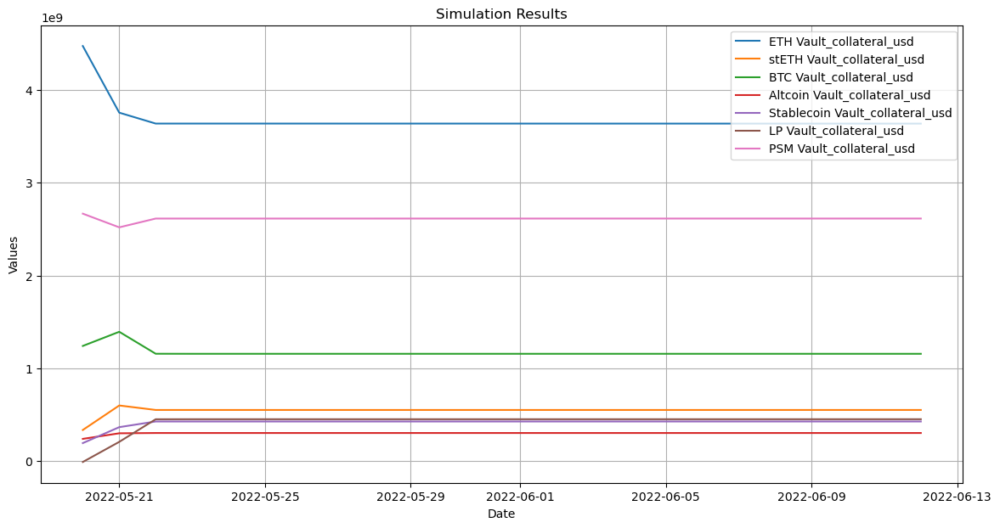

In [850]:
### import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import Ridge
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt
from datetime import timedelta

class VaultSimulator_baseline:
    def __init__(self, data, initial_data, features, targets, temporals, start_date, alpha=300):
        self.data = data[data.index <= pd.to_datetime(start_date).tz_localize('UTC')]
        self.features = features
        self.targets = targets
        self.alpha = alpha
        self.model = None
        self.temporals = temporals
        self.results = pd.DataFrame()
        self.initial_data = initial_data
        self.start_date = start_date

    def train_model(self):
        X = self.initial_data[self.features]
        y = self.initial_data[self.targets]
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8, random_state=42)
        self.model = MultiOutputRegressor(Ridge(alpha=self.alpha))
        self.model.fit(X_train, y_train)
        print("Model trained.")

    def run_simulation(self, actions=None):
        start_date = pd.to_datetime(self.start_date).tz_localize('UTC')
        periods = 1  # Forecast period in days
        cycles = 24  # Use number of actions or default to 24 cycles

        for cycle in range(cycles):
            start = start_date + timedelta(days=periods * cycle)
            if start <= self.data.index.max():
                X_test = self.data.loc[[self.data.index.max()], self.features]
            else:
                X_test = self.data.tail(1)[self.features]

            # Apply actions to the data before prediction
            if actions:
                self.apply_action(actions[cycle])

            predictions = self.forecast(X_test)
            future_index = pd.DatetimeIndex([start])
            self.update_state(future_index, predictions)
            self.recalculate_temporal_features(future_index)
            print(f"Cycle {cycle + 1} completed. Data updated for {start}.")

    def apply_action(self, action):
        for vault, percentage_change in action.items():
            dai_ceiling_key = f'{vault}_dai_ceiling'
            if dai_ceiling_key in self.data.columns:
                print('current_ceiling', self.data[dai_ceiling_key])
                self.data[dai_ceiling_key] *= (1 + percentage_change / 100)
                print(f"Adjusted {dai_ceiling_key} by {percentage_change}%")
                print('adjusted ceiling', self.data[dai_ceiling_key])

    def forecast(self, X):
        return self.model.predict(X)

    def update_state(self, indices, predictions):
        print('Current state', self.data[self.targets].iloc[-1])
        print('Current temporal', self.data[self.temporals].iloc[-1])
        # Create a new DataFrame for the predictions
        new_data = pd.DataFrame(predictions, index=indices, columns=self.targets)
        # Append new data to results
        self.results = pd.concat([self.results, new_data])
        # Update the main data with predictions
        self.data.update(new_data)
        # Append new data if the index does not already exist
        if not self.data.index.isin(indices).any():
            self.data = self.data.reindex(self.data.index.union(new_data.index), method='nearest')
            for column in new_data.columns:
                self.data.loc[new_data.index, column] = new_data[column]
            self.data.sort_index(inplace=True)  # Ensure the index is sorted
        else:
            self.data.update(new_data)
        print('new state update:', self.data[self.targets].iloc[-1], self.data[self.temporals].iloc[-1])
    
        # Recalculate temporal features right after updating the state
        self.recalculate_temporal_features(indices)

    def recalculate_temporal_features(self, start_index):
        # Ensure start_index is a DatetimeIndex
        if not isinstance(start_index, pd.DatetimeIndex):
            start_index = pd.to_datetime(start_index)
        
        vault_names = ['ETH Vault', 'stETH Vault', 'BTC Vault', 'Altcoin Vault', 'Stablecoin Vault', 'LP Vault', 'PSM Vault', 'RWA Vault']
        total_usd_col = 'Vaults Total USD Value'
        self.data[total_usd_col] = self.data[[f'{vault}_collateral_usd' for vault in vault_names]].sum(axis=1)

        for vault in vault_names:
            usd_col = f'{vault}_collateral_usd'
            pct_col = f'{vault}_collateral_usd % of Total'
            self.data[pct_col] = self.data[usd_col] / self.data[total_usd_col]  # Update the percentage column
            print('new pct:', self.data[pct_col])
            # Calculate the 7-day moving average for the USD collateral
            ma_col_usd_7d = f'{usd_col}_7d_ma'
            self.data[ma_col_usd_7d] = self.data[usd_col].rolling(window=7, min_periods=1).mean()
            for window in [30]:
                ma_col_pct = f'{pct_col}_{window}d_ma'
                self.data[ma_col_pct] = self.data[pct_col].rolling(window=window, min_periods=1).mean()

            dai_ceiling_col = f'{vault}_dai_ceiling'
            if dai_ceiling_col in self.data.columns:
                prev_dai_ceiling_col = f'{vault}_prev_dai_ceiling'
                self.data[prev_dai_ceiling_col] = self.data[dai_ceiling_col].shift(1)

    def plot_vault_data(self, column):
        plt.figure(figsize=(10, 6))
        plt.plot(self.data.index, self.data[column], label=column)
        plt.title(f"Time Series for {column}")
        plt.xlabel("Date")
        plt.ylabel("Value")
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_simulation_results(self):
        plt.figure(figsize=(14, 7))
        for target in self.targets:
            plt.plot(self.results.index, self.results[target], label=target)
        plt.title("Simulation Results")
        plt.xlabel('Date')
        plt.ylabel('Values')
        plt.legend()
        plt.grid(True)
        plt.show()

    def print_summary_statistics(self, pre_data):
        for column in self.data.columns:
            if column not in pre_data.columns:
                pre_data[column] = pd.NA  # Handle missing column in pre_data
            pre_stats = pre_data.describe()
            post_stats = self.data.describe()
            print(f"--- {column} ---")
            print("Pre-Simulation:\n", pre_stats)
            print("Post-Simulation:\n", post_stats, "\n")

    def plot_dai_ceilings_and_usd_balances(self, start_simulation_date, vault_names):
        if isinstance(start_simulation_date, str):
            start_simulation_date = pd.to_datetime(start_simulation_date)
        if not isinstance(self.data.index, pd.DatetimeIndex):
            self.data.index = pd.to_datetime(self.data.index)
        fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 10), sharex=True)
        for vault in vault_names:
            axes[0].plot(self.data.index, self.data[f'{vault} Vault_dai_ceiling'], label=f'{vault} Dai Ceiling')
        axes[0].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[0].set_title('Dai Ceilings Over Time')
        axes[0].set_ylabel('Dai Ceiling')
        axes[0].legend()
        for vault in vault_names:
            axes[1].plot(self.data.index, self.data[f'{vault} Vault_collateral_usd'], label=f'{vault} USD Balance')
        axes[1].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[1].set_title('USD Balances Per Vault Over Time')
        axes[1].set_ylabel('USD Balance')
        axes[1].set_xlabel('Date')
        axes[1].legend()
        plt.show()

    def calculate_error_metrics(self, actual_data):
        vault_names = ['ETH', 'stETH', 'BTC', 'Altcoin', 'Stablecoin', 'LP', 'PSM']
        for vault in vault_names:
            column = f'{vault} Vault_collateral_usd'
            try:
                mse = mean_squared_error(actual_data[column], self.data[column])
                mae = mean_absolute_error(actual_data[column], self.data[column])
                rmse = sqrt(mse)
                print(f"--- Metrics for {vault} Vault ---")
                print(f"MSE: {mse}")
                print(f"MAE: {mae}")
                print(f"RMSE: {rmse}\n")
            except KeyError:
                print(f"Data for {vault} Vault not available in the dataset.")

# Run the simulation
simulation_data = test_data_copy
start_date = '2022-05-20'
simulation = VaultSimulator_baseline(simulation_data, test_data_copy, features, targets, temporals, start_date)
simulation.train_model()
simulation.run_simulation()
simulation.plot_simulation_results()


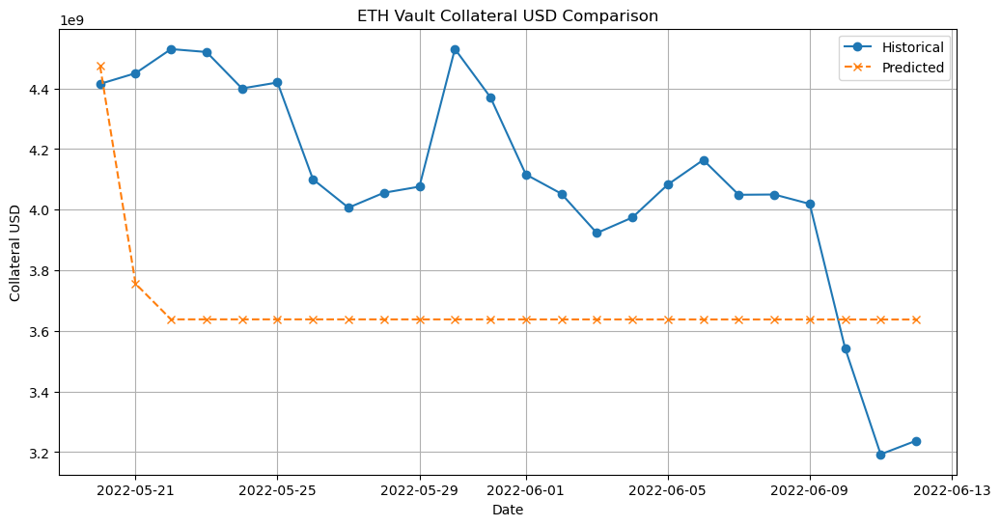

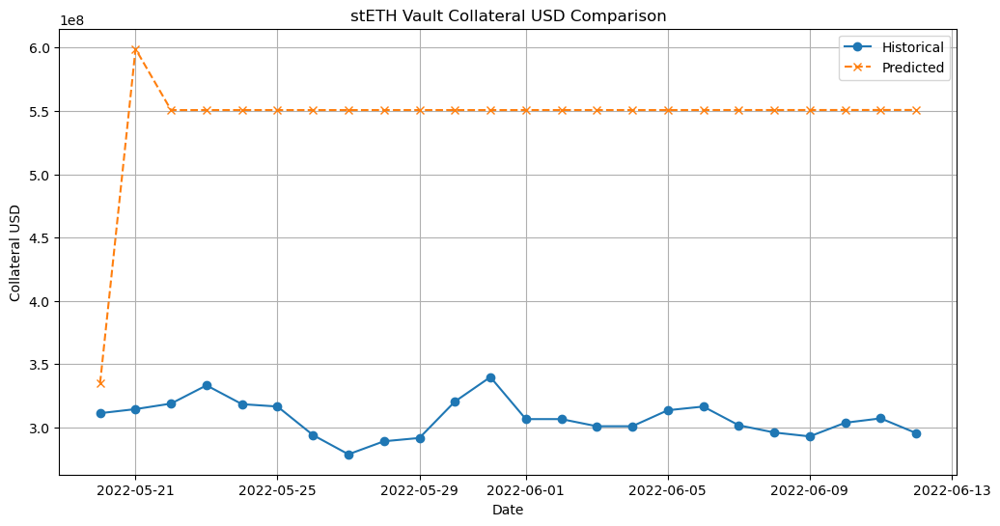

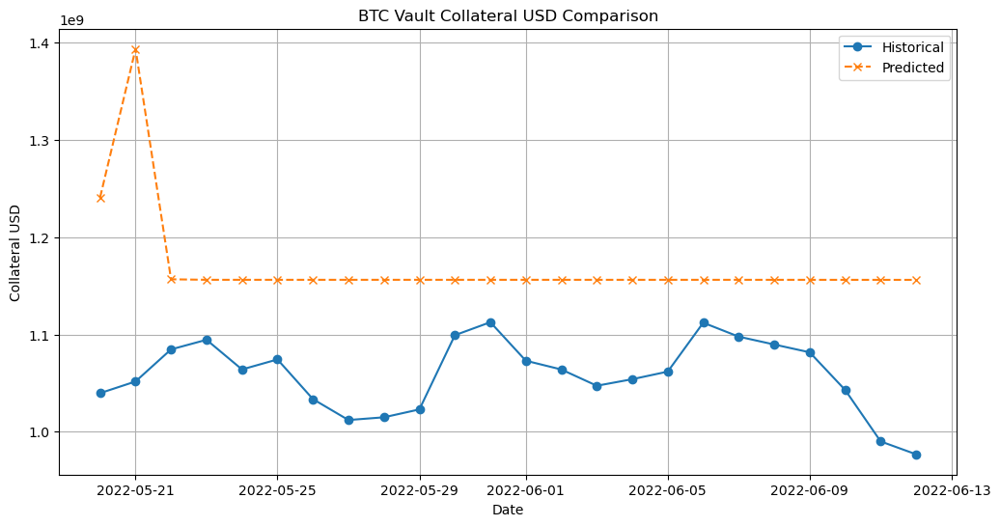

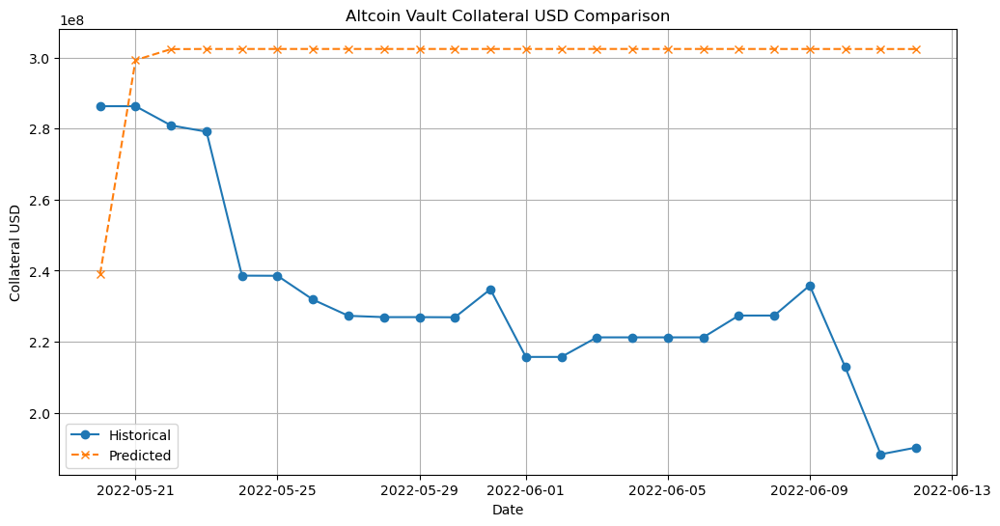

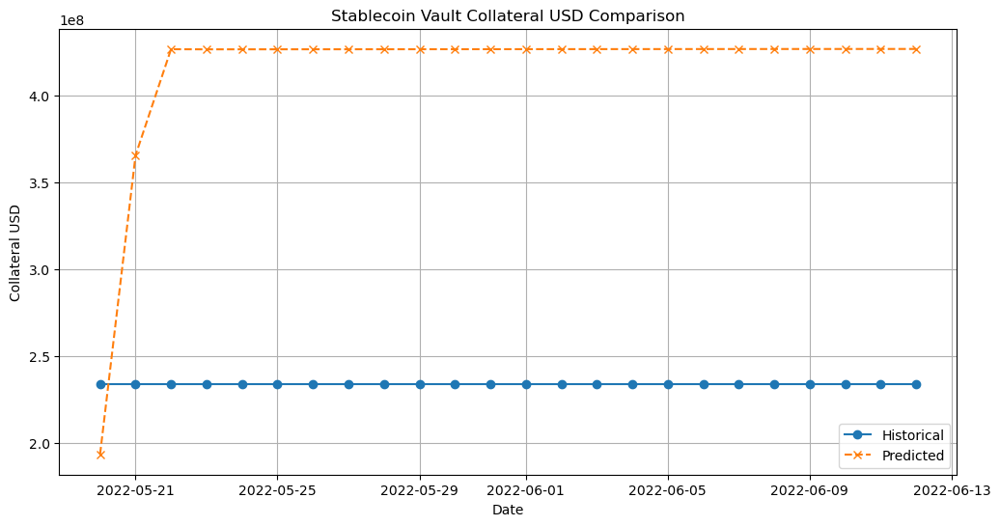

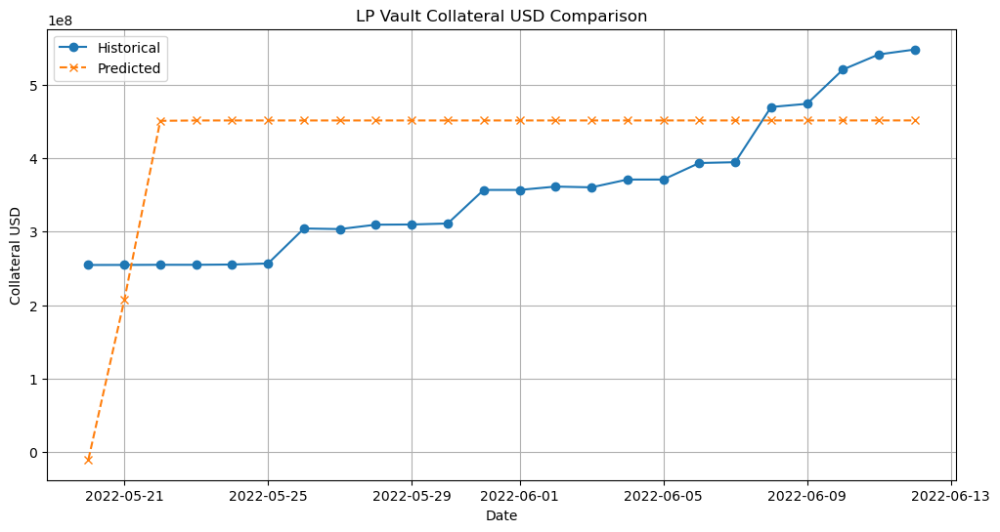

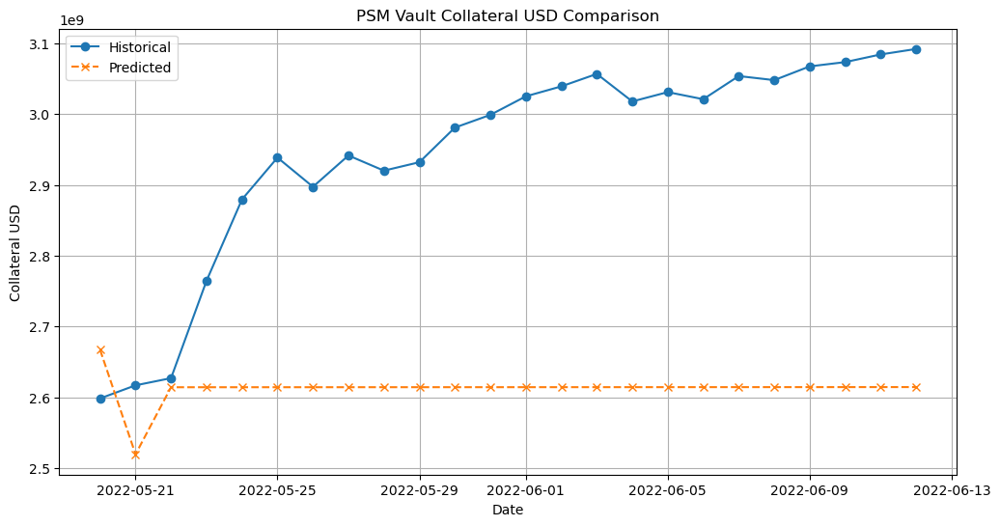

{'ETH Vault': {'MSE': 3.01006934073868e+17,
  'MAE': 500655731.62773323,
  'RMSE': 548640988.328313,
  'R2': -1.4168832925546755},
 'stETH Vault': {'MSE': 5.823758123174817e+16,
  'MAE': 236666446.22254983,
  'RMSE': 241324638.67526698,
  'R2': -303.00433866892166},
 'BTC Vault': {'MSE': 1.643957649482584e+16,
  'MAE': 111462912.41408819,
  'RMSE': 128216911.89084941,
  'R2': -11.683147170948677},
 'Altcoin Vault': {'MSE': 5612318962704987.0,
  'MAE': 70997870.1312914,
  'RMSE': 74915412.05055864,
  'R2': -7.535257694638071},
 'Stablecoin Vault': {'MSE': 3.4835241754007684e+16,
  'MAE': 183823496.27460647,
  'RMSE': 186642014.97521314,
  'R2': -45226297685847.984},
 'LP Vault': {'MSE': 1.6878886745414074e+16,
  'MAE': 114750868.28418829,
  'RMSE': 129918769.79641576,
  'R2': -1.0174527309195573},
 'PSM Vault': {'MSE': 1.321662566392189e+17,
  'MAE': 339371810.25234884,
  'RMSE': 363546773.6608577,
  'R2': -5.16383960326288}}

In [851]:
historical = test_data[targets]
result = simulation.results

def evaluate_predictions(predictions, historical):
    # Ensure indexes are properly aligned
    predictions.index = pd.to_datetime(predictions.index).tz_localize(None)
    historical.index = pd.to_datetime(historical.index).tz_localize(None)
    
    if not predictions.index.equals(historical.index):
        print("Warning: Indexes do not match, aligning them...")
        # Align the data by index
        combined = predictions.join(historical, lsuffix='_pred', rsuffix='_hist', how='inner')
    else:
        combined = predictions.join(historical, lsuffix='_pred', rsuffix='_hist')
    
    vault_names = ['ETH Vault', 'stETH Vault', 'BTC Vault', 'Altcoin Vault', 'Stablecoin Vault', 'LP Vault', 'PSM Vault']
    metrics = {}

    
    
    for vault in vault_names:
        pred_col = f'{vault}_collateral_usd_pred'
        hist_col = f'{vault}_collateral_usd_hist'
        
        if pred_col in combined.columns and hist_col in combined.columns:
            mse = mean_squared_error(combined[hist_col], combined[pred_col])
            mae = mean_absolute_error(combined[hist_col], combined[pred_col])
            rmse = np.sqrt(mse)
            r2 = r2_score(combined[hist_col], combined[pred_col])
            metrics[vault] = {'MSE': mse, 'MAE': mae, 'RMSE': rmse, 'R2': r2}
            
            # Plotting
            plt.figure(figsize=(12, 6))
            plt.plot(combined.index, combined[hist_col], label='Historical', marker='o')
            plt.plot(combined.index, combined[pred_col], label='Predicted', linestyle='--', marker='x')
            plt.title(f'{vault} Collateral USD Comparison')
            plt.xlabel('Date')
            plt.ylabel('Collateral USD')
            plt.legend()
            plt.grid(True)
            plt.show()
        else:
            print(f"Missing columns for {vault}")
            metrics[vault] = 'Missing data'
    
    return metrics

evaluate_predictions(result, historical)

<Axes: xlabel='day'>

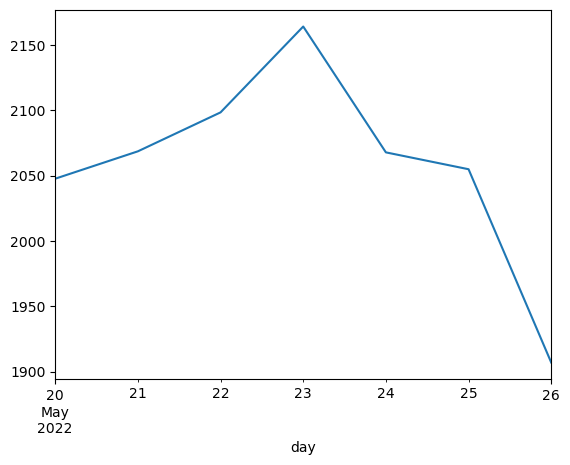

In [852]:
filter = test_data[(test_data.index <= '2022-05-26') & (test_data.index >='2022-05-20')]

filter[targets]
filter['stETH Vault_market_price'].plot()

In [853]:
filter

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd,ETH Vault_dai_ceiling,stETH Vault_dai_ceiling,BTC Vault_dai_ceiling,...,RWA Vault_collateral_usd % of Total_7d_ma,RWA Vault_collateral_usd % of Total_30d_ma,where_is_dai_Bridge,dai_market_Volume_30d_ma,dai_market_Volume_7d_ma,eth_market_Close_7d_ma,eth_market_Volume_30d_ma,btc_market_Close_7d_ma,btc_market_Volume_30d_ma,LP Vault_dai_floor_90d_ma_pct_change
day,,,,,,,,,,,,,,,,,,,,,
2022-05-20 00:00:00+00:00,"4,415,031,780.64779","311,290,483.72759","1,039,675,445.37914","286,308,957.87683","233,744,057.91675","254,504,107.76096","2,598,230,934.72841","1,805,368,930.88345","149,815,023.30913","694,725,332.88445",...,0.51984,0.44360,"700,405,073.09613","496,988,394.46667","480,657,451.85714","2,030.20340","20,637,201,495.40000","29,990.07143","35,617,902,996.23333",0.00086
2022-05-21 00:00:00+00:00,"4,450,359,015.18771","314,510,167.49100","1,051,677,783.23436","286,308,655.80782","233,744,057.91675","254,571,179.69679","2,616,753,105.24542","1,805,368,930.88345","149,815,023.30913","694,725,332.88445",...,0.52404,0.44939,"685,882,724.56450","495,962,263.50000","442,582,436.57143","2,018.52403","20,229,309,205.83333","29,894.49442","35,014,638,131.13333",0.00086
2022-05-22 00:00:00+00:00,"4,529,921,207.19761","318,874,818.25281","1,084,643,625.48467","280,890,624.68389","233,744,057.91675","254,758,470.79382","2,626,906,171.09868","1,805,368,930.88345","149,815,023.30913","695,100,525.11711",...,0.53017,0.45469,"686,226,739.48230","492,440,267.83333","393,758,629.57143","2,003.87594","20,034,586,803.36666","29,754.29576","34,801,965,315.30000",0.00086
2022-05-23 00:00:00+00:00,"4,520,264,640.78370","333,276,478.16383","1,094,524,244.79833","279,135,138.24917","233,744,057.91675","254,758,470.79382","2,764,433,420.34203","1,651,072,065.91098","149,815,023.30913","695,100,525.11711",...,0.53192,0.45967,"685,355,417.85923","495,549,680.60000","385,696,770.85714","1,996.65536","20,278,505,940.00000","29,645.15179","35,313,479,758.90000",0.00086
2022-05-24 00:00:00+00:00,"4,400,057,808.28714","318,422,394.88726","1,064,035,697.02676","238,586,434.93975","233,744,057.91675","255,131,711.91511","2,879,427,800.06594","1,511,738,412.23976","149,815,023.30913","695,100,525.11711",...,0.53655,0.46478,"682,105,552.45888","499,180,128.70000","381,889,666.42857","1,980.73730","20,390,515,254.26667","29,535.11300","35,601,883,361.50000",0.00086
2022-05-25 00:00:00+00:00,"4,419,662,586.02997","316,558,271.25057","1,074,324,604.95365","238,549,255.12251","233,744,057.91675","256,529,286.96418","2,938,530,503.56348","1,511,738,412.23976","149,815,023.30913","695,100,525.11711",...,0.53799,0.46974,"676,628,252.51452","497,512,841.56667","373,249,383.00000","1,984.76184","20,091,577,091.46667","29,655.41155","35,337,861,127.53333",0.00085
2022-05-26 00:00:00+00:00,"4,100,236,861.20399","294,029,307.92460","1,033,532,642.82570","231,838,918.50767","233,744,057.91675","304,159,575.44914","2,897,297,162.68226","1,511,738,412.23976","149,815,023.30913","695,100,525.11711",...,0.54400,0.47513,"677,911,012.83338","505,486,195.33333","398,392,037.85714","1,954.13000","20,238,464,972.10000","29,505.82450","35,411,369,025.40000",0.00085


In [854]:
filtered_columns = filter.columns[~filter.columns.isin(temporals)]
filtered_data = filter[filtered_columns]
filtered_data.columns
filtered_data

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd,ETH Vault_dai_ceiling,stETH Vault_dai_ceiling,BTC Vault_dai_ceiling,...,Stablecoin Vault_collateral_usd % of Total_30d_ma,LP Vault_collateral_usd % of Total_30d_ma,RWA Vault_collateral_usd % of Total_30d_ma,dai_market_Volume_30d_ma,dai_market_Volume_7d_ma,eth_market_Close_7d_ma,eth_market_Volume_30d_ma,btc_market_Close_7d_ma,btc_market_Volume_30d_ma,LP Vault_dai_floor_90d_ma_pct_change
day,,,,,,,,,,,,,,,,,,,,,
2022-05-20 00:00:00+00:00,"4,415,031,780.64779","311,290,483.72759","1,039,675,445.37914","286,308,957.87683","233,744,057.91675","254,504,107.76096","2,598,230,934.72841","1,805,368,930.88345","149,815,023.30913","694,725,332.88445",...,2.04163,1.47375,0.44360,"496,988,394.46667","480,657,451.85714","2,030.20340","20,637,201,495.40000","29,990.07143","35,617,902,996.23333",0.00086
2022-05-21 00:00:00+00:00,"4,450,359,015.18771","314,510,167.49100","1,051,677,783.23436","286,308,655.80782","233,744,057.91675","254,571,179.69679","2,616,753,105.24542","1,805,368,930.88345","149,815,023.30913","694,725,332.88445",...,2.06810,1.52572,0.44939,"495,962,263.50000","442,582,436.57143","2,018.52403","20,229,309,205.83333","29,894.49442","35,014,638,131.13333",0.00086
2022-05-22 00:00:00+00:00,"4,529,921,207.19761","318,874,818.25281","1,084,643,625.48467","280,890,624.68389","233,744,057.91675","254,758,470.79382","2,626,906,171.09868","1,805,368,930.88345","149,815,023.30913","695,100,525.11711",...,2.09233,1.57523,0.45469,"492,440,267.83333","393,758,629.57143","2,003.87594","20,034,586,803.36666","29,754.29576","34,801,965,315.30000",0.00086
2022-05-23 00:00:00+00:00,"4,520,264,640.78370","333,276,478.16383","1,094,524,244.79833","279,135,138.24917","233,744,057.91675","254,758,470.79382","2,764,433,420.34203","1,651,072,065.91098","149,815,023.30913","695,100,525.11711",...,2.11509,1.62342,0.45967,"495,549,680.60000","385,696,770.85714","1,996.65536","20,278,505,940.00000","29,645.15179","35,313,479,758.90000",0.00086
2022-05-24 00:00:00+00:00,"4,400,057,808.28714","318,422,394.88726","1,064,035,697.02676","238,586,434.93975","233,744,057.91675","255,131,711.91511","2,879,427,800.06594","1,511,738,412.23976","149,815,023.30913","695,100,525.11711",...,2.13840,1.67244,0.46478,"499,180,128.70000","381,889,666.42857","1,980.73730","20,390,515,254.26667","29,535.11300","35,601,883,361.50000",0.00086
2022-05-25 00:00:00+00:00,"4,419,662,586.02997","316,558,271.25057","1,074,324,604.95365","238,549,255.12251","233,744,057.91675","256,529,286.96418","2,938,530,503.56348","1,511,738,412.23976","149,815,023.30913","695,100,525.11711",...,2.16105,1.72124,0.46974,"497,512,841.56667","373,249,383.00000","1,984.76184","20,091,577,091.46667","29,655.41155","35,337,861,127.53333",0.00085
2022-05-26 00:00:00+00:00,"4,100,236,861.20399","294,029,307.92460","1,033,532,642.82570","231,838,918.50767","233,744,057.91675","304,159,575.44914","2,897,297,162.68226","1,511,738,412.23976","149,815,023.30913","695,100,525.11711",...,2.18570,1.78998,0.47513,"505,486,195.33333","398,392,037.85714","1,954.13000","20,238,464,972.10000","29,505.82450","35,411,369,025.40000",0.00085


In [855]:
historical = test_data[targets]

filter['mcap_total_volume']

day
2022-05-20 00:00:00+00:00    86,285,624,317.15132
2022-05-21 00:00:00+00:00    56,789,096,709.83930
2022-05-22 00:00:00+00:00    65,327,924,533.40676
2022-05-23 00:00:00+00:00    90,568,364,068.74232
2022-05-24 00:00:00+00:00    82,639,853,292.49004
2022-05-25 00:00:00+00:00    78,394,396,296.51625
2022-05-26 00:00:00+00:00   108,498,437,838.02876
Name: mcap_total_volume, dtype: float64

In [856]:
list(filter[[f for f in filter.columns if not 'ma' in f and not 'ceiling' in f]].columns)

['ETH Vault_collateral_usd',
 'stETH Vault_collateral_usd',
 'BTC Vault_collateral_usd',
 'Altcoin Vault_collateral_usd',
 'Stablecoin Vault_collateral_usd',
 'LP Vault_collateral_usd',
 'PSM Vault_collateral_usd',
 'effective_funds_rate',
 'M1V',
 'WM2NS',
 'fed_reverse_repo',
 'mcap_total_volume',
 'defi_apy_medianAPY',
 'defi_apy_avg7day',
 'ETH Vault_liquidation_ratio',
 'BTC Vault_liquidation_ratio',
 'stETH Vault_liquidation_ratio',
 'Altcoin Vault_liquidation_ratio',
 'Stablecoin Vault_liquidation_ratio',
 'LP Vault_liquidation_ratio',
 'BTC Vault_collateral_usd % of Total',
 'ETH Vault_collateral_usd % of Total',
 'stETH Vault_collateral_usd % of Total',
 'Stablecoin Vault_collateral_usd % of Total',
 'Altcoin Vault_collateral_usd % of Total',
 'LP Vault_collateral_usd % of Total',
 'RWA Vault_collateral_usd % of Total',
 'PSM Vault_collateral_usd % of Total',
 'Vaults Total USD Value',
 'RWA Vault_collateral_usd',
 'where_is_dai_Bridge']

<Axes: xlabel='day'>

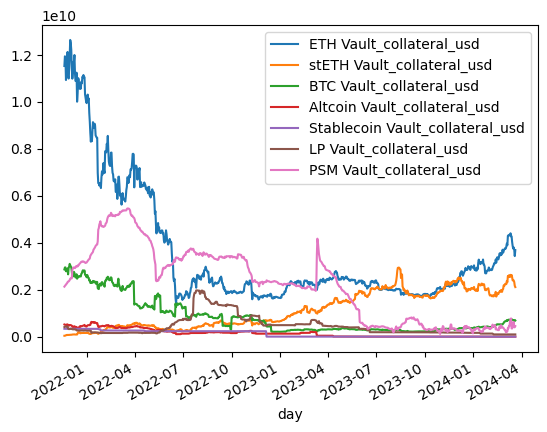

In [857]:
historical.plot()

In [858]:
result = simulation.results
result

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd
2022-05-20,"4,473,830,113.09779","334,903,347.41405","1,240,758,718.48997","238,999,273.73184","193,442,986.98972","-10,028,037.02689","2,666,879,365.34002"
2022-05-21,"3,755,609,053.91898","598,955,657.82916","1,393,430,545.72676","299,292,678.60810","365,407,942.91493","206,815,871.11995","2,519,274,017.91708"
2022-05-22,"3,637,979,306.60062","550,697,189.35701","1,156,707,741.68221","302,385,974.98340","426,429,915.31580","450,545,051.45965","2,614,040,588.63561"
2022-05-23,"3,638,076,984.64290","550,688,614.10567","1,156,171,925.21390","302,427,450.69185","426,349,612.44884","451,014,888.03669","2,614,056,292.89377"
2022-05-24,"3,638,053,875.70357","550,690,364.79748","1,156,169,916.53804","302,428,007.96972","426,360,434.47445","451,017,426.67151","2,614,065,741.87820"
2022-05-25,"3,638,030,296.00089","550,691,972.52964","1,156,169,174.92269","302,428,548.64497","426,371,374.28164","451,018,819.25215","2,614,075,582.40032"
2022-05-26,"3,638,005,805.29203","550,693,215.94693","1,156,169,142.64382","302,428,919.14954","426,383,156.38814","451,020,374.73625","2,614,085,153.87492"
2022-05-27,"3,637,982,724.87858","550,694,088.77010","1,156,169,223.37325","302,429,692.77641","426,394,296.60793","451,021,405.96235","2,614,094,335.66235"
2022-05-28,"3,637,958,855.18233","550,695,506.17206","1,156,168,845.27704","302,430,133.14066","426,405,549.95752","451,022,954.63564","2,614,103,923.66503"
2022-05-29,"3,637,933,424.88900","550,697,402.54389","1,156,168,286.93600","302,430,119.86577","426,417,513.91206","451,025,072.41768","2,614,113,947.46522"


## Final Simulation Model

### Non Q Sim



class MVO_VaultSimulator:
    def __init__(self, data, initial_data, features, targets, temporals, start_date, end_date, alpha=300):
        self.data = data[data.index <= pd.to_datetime(start_date).tz_localize(None)]
        self.features = features
        self.targets = targets
        self.alpha = alpha
        self.model = None
        self.temporals = temporals
        self.results = pd.DataFrame()
        self.initial_data = initial_data
        self.start_date = pd.to_datetime(start_date).tz_localize(None)
        self.end_date = pd.to_datetime(end_date).tz_localize(None)
        self.current_date = self.start_date
        self.dai_ceilings_history = pd.DataFrame()


    def get_latest_data(self):
        # Return the latest data that the environment will use
        return self.data
        
    def reset(self):
        self.data = self.initial_data[self.initial_data.index <= self.start_date]
        self.results = pd.DataFrame()
        self.train_model()
        print('sim reset current date', self.current_date)
        print("Simulation reset and model retrained.")

    def train_model(self):
        X = self.initial_data[self.features]
        y = self.initial_data[self.targets]
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8, random_state=42)
        self.model = MultiOutputRegressor(Ridge(alpha=self.alpha))
        self.model.fit(X_train, y_train)
        print("Model trained.")
        
    def update_dai_ceilings(self):
        # Extract the current DAI ceilings
        current_ceilings = self.data.loc[self.current_date, ['ETH Vault_dai_ceiling', 'BTC Vault_dai_ceiling', 'stETH Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling', 'Stablecoin Vault_dai_ceiling', 'LP Vault_dai_ceiling','RWA Vault_dai_ceiling','PSM Vault_dai_ceiling']]
        current_ceilings['timestamp'] = self.current_date  # Adding a timestamp for reference

        # Append to the historical DataFrame
        self.dai_ceilings_history = pd.concat([self.dai_ceilings_history, current_ceilings.to_frame().T.set_index('timestamp')])



    def run_simulation(self, simulation_date, action=None):
        # Ensure the date is timezone-aware. Localize if it is naive.
        #if pd.to_datetime(simulation_date).tzinfo is None:
           # self.current_date = pd.to_datetime(simulation_date).tz_localize('UTC')
        #else:
            #self.current_date = pd.to_datetime(simulation_date).tz_convert('UTC')
    
        cycle_start_date = self.current_date
        end_date = min(cycle_start_date + timedelta(days=24), self.end_date)
    
        while self.current_date <= end_date and self.current_date <= self.initial_data.index.max():
            if self.current_date in self.data.index:
                X_test = self.data.loc[[self.current_date], self.features]
            else:
                X_test = self.data.tail(1)[self.features]
    
            volatilities = self.calculate_historical_volatility()
            predictions = self.forecast(X_test, volatilities)
            future_index = pd.DatetimeIndex([self.current_date])
            self.update_state(future_index, predictions)
    
            # Update the DAI ceilings history right after updating the state
            self.update_dai_ceilings()
    
            print('current state', self.data.iloc[-1])
            if action:
                self.apply_action(action)
                print(f"Action applied on: {self.current_date}")
    
            print(f"Day completed: {self.current_date}")
            self.current_date += timedelta(days=1)
    
        print(f"Cycle completed up to: {self.current_date - timedelta(days=1)}")
        if self.current_date > self.end_date:
            print(f"Simulation completed up to: {self.end_date}")
        else:
            print(f"Simulation completed up to: {self.current_date - timedelta(days=1)}")




    def apply_action(self, action):
        if action:
            for vault, percentage_change in action.items():
                # Append the suffix '_dai_ceiling' to the vault name to match the DataFrame columns
                dai_ceiling_key = vault.replace('_collateral_usd', '_dai_ceiling') 
                print('vault', vault)
                print('Applying action to:', dai_ceiling_key)
                if dai_ceiling_key in self.data.columns:
                    original_value = self.data[dai_ceiling_key].iloc[-1]
                    new_value = original_value * (1 + percentage_change / 100)
                    self.data.at[self.data.index[-1], dai_ceiling_key] = new_value
                    
                    print(f"Simulator Adjusted {dai_ceiling_key} by {percentage_change}% from {original_value} to {new_value}")
                else:
                    print(f"Simulator No 'dai_ceiling' column found for {dai_ceiling_key}, no action applied.")
        else:
            print("Simulator No action provided; no adjustments made.")

#scale_factor=300000000, minimum_value_factor=0.05, volatility_window=250
    def forecast(self, X, volatilities):
        predictions = self.model.predict(X)
        predictions = np.maximum(predictions, 0)  # Ensure predictions are non-negative before adjustment
        
        # Scale factor for volatility should be set based on historical volatility analysis
        #try different scale factor; optimal @ 500000000 or 4, 453000000, 467000000
        scale_factor = 453000000  # This should be calibrated based on your data
        noise = np.random.normal(0, volatilities * scale_factor, predictions.shape)
        
        # Apply noise and ensure predictions do not fall below a realistic minimum
        # Example: Set a floor at 1% of the mean historical asset value or a fixed value known to be a plausible minimum
        #0.2, 0.15 optimal, 0.12
        minimum_value = 0.12 * self.initial_data[self.targets].mean()  # This is an example and should be adjusted
        adjusted_predictions = np.maximum(predictions + noise, minimum_value)
        
        return adjusted_predictions
        # try scale 453000000, min val .12 or .1, window 25 or 15


    def calculate_historical_volatility(self, window=365): #try 365 for straightish lines, maybe try longer?
        # try different window; optimal @ 280, 25, 15, 380, 360
        # 180, 150 also good, 60 for smaller scale and min val
    
        # Assuming daily data, calculate percentage change
        daily_returns = self.data[self.targets].pct_change()
    
        # Handling possible NaN values in daily returns
        daily_returns = daily_returns.dropna()
    
        # Calculate volatility as the standard deviation of returns
        volatility = daily_returns.rolling(window=window, min_periods=1).std()
    
        # Return the average volatility over the window
        return volatility.mean(axis=0)  # Use axis=0 to average volatilities across columns if needed



    
    def update_state(self, indices, predictions):
        #print('Current state', self.data[self.targets].iloc[-1])
        #print('Current temporal', self.data[self.temporals].iloc[-1])
        # Create a new DataFrame for the predictions
        new_data = pd.DataFrame(predictions, index=indices, columns=self.targets)
        new_data = new_data.clip(lower=0)
        #print('New data', new_data)
        self.results = pd.concat([self.results, new_data])  # Append new data to results
        self.data.update(new_data)
        # Append new data if the index does not already exist
        if not self.data.index.isin(indices).any():
            # Directly assign the new data to the respective index positions
            self.data = self.data.reindex(self.data.index.union(new_data.index), method='nearest')
            for column in new_data.columns:
                self.data.loc[new_data.index, column] = new_data[column]
            self.data.sort_index(inplace=True)  # Ensure the index is sorted
        else:
            # If indices overlap, directly update the values
            self.data.update(new_data)
        #print('new state update:',self.data[self.targets].iloc[-1],self.data[self.temporals].iloc[-1])
    
        # Recalculate temporal features right after updating the state
        self.recalculate_temporal_features(indices)


    

    def recalculate_temporal_features(self, start_index):
        vault_names = ['ETH Vault', 'stETH Vault', 'BTC Vault', 'Altcoin Vault', 'Stablecoin Vault', 'LP Vault', 'PSM Vault', 'RWA Vault']
        total_usd_col = 'Vaults Total USD Value'
        self.data[total_usd_col] = self.data[[f'{vault}_collateral_usd' for vault in vault_names]].sum(axis=1)
    
        for vault in vault_names:
            usd_col = f'{vault}_collateral_usd'
            pct_col = f'{vault}_collateral_usd % of Total'
            self.data[pct_col] = self.data[usd_col] / self.data[total_usd_col]  # Update the percentage column
            # Calculate the 7-day moving average for the USD collateral
            #ma_col_usd_7d = f'{usd_col}_7d_ma'
            #self.data[ma_col_usd_7d] = self.data[usd_col].rolling(window=7, min_periods=1).mean()
            ma_col_usd_30d = f'{usd_col}_30d_ma'
            self.data[ma_col_usd_30d] = self.data[usd_col].rolling(window=30, min_periods=1).mean()
            # Calculate the 7-day and 30-day moving averages for the percentage of total
            for window in [7,30]:
                ma_col_pct = f'{pct_col}_{window}d_ma'
                self.data[ma_col_pct] = self.data[pct_col].rolling(window=window, min_periods=1).mean()
             
            dai_ceiling_col = f'{vault}_dai_ceiling'
            if dai_ceiling_col in self.data.columns:
                prev_dai_ceiling_col = f'{vault}_prev_dai_ceiling'
                self.data[prev_dai_ceiling_col] = self.data[dai_ceiling_col].shift(1)
           
# Call this method with the correct index during your simulation
# For instance, after updating the state in your simulation:
# simulation.recalculate_temporal_features(current_index)


    
    def plot_vault_data(self, column):
        plt.figure(figsize=(10, 6))
        plt.plot(self.data.index, self.data[column], label=column)
        plt.title(f"Time Series for {column}")
        plt.xlabel("Date")
        plt.ylabel("Value")
        plt.legend()
        plt.grid(True)
        plt.show()
    def plot_simulation_results(self):
        plt.figure(figsize=(14, 7))
        for target in self.targets:
            plt.plot(self.results.index, self.results[target], label=target)
        plt.title("Simulation Results")
        plt.xlabel('Date')
        plt.ylabel('Values')
        plt.legend()
        plt.grid(True)
        plt.show()
    def print_summary_statistics(self, pre_data):
        for column in self.data.columns:
            if column not in pre_data.columns:
                pre_data[column] = pd.NA  # Handle missing column in pre_data
            pre_stats = pre_data.describe()
            post_stats = self.data.describe()
            print(f"--- {column} ---")
            print("Pre-Simulation:\n", pre_stats)
            print("Post-Simulation:\n", post_stats, "\n")
    def plot_dai_ceilings_and_usd_balances(self, start_simulation_date, vault_names):
        if isinstance(start_simulation_date, str):
            start_simulation_date = pd.to_datetime(start_simulation_date)
        if not isinstance(self.data.index, pd.DatetimeIndex):
            self.data.index = pd.to_datetime(self.data.index)
        fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 10), sharex=True)
        for vault in vault_names:
            axes[0].plot(self.data.index, self.data[f'{vault} Vault_dai_ceiling'], label=f'{vault} Dai Ceiling')
        axes[0].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[0].set_title('Dai Ceilings Over Time')
        axes[0].set_ylabel('Dai Ceiling')
        axes[0].legend()
        for vault in vault_names:
            axes[1].plot(self.data.index, self.data[f'{vault} Vault_collateral_usd'], label=f'{vault} USD Balance')
        axes[1].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[1].set_title('USD Balances Per Vault Over Time')
        axes[1].set_ylabel('USD Balance')
        axes[1].set_xlabel('Date')
        axes[1].legend()
        plt.show()

    def calculate_error_metrics(self, actual_data):
        vault_names = ['ETH', 'stETH', 'BTC', 'Altcoin', 'Stablecoin', 'LP', 'PSM']
        for vault in vault_names:
            column = f'{vault} Vault_collateral_usd'
            try:
                mse = mean_squared_error(actual_data[column], self.data[column])
                mae = mean_absolute_error(actual_data[column], self.data[column])
                rmse = sqrt(mse)
                print(f"--- Metrics for {vault} Vault ---")
                print(f"MSE: {mse}")
                print(f"MAE: {mae}")
                print(f"RMSE: {rmse}\n")
            except KeyError:
                print(f"Data for {vault} Vault not available in the dataset.")


    # Additional methods would remain unchanged

## Usage example:
simulation_data = test_data_copy  # Assuming this is defined with your actual data
start_date = '2022-05-20'
end_date = '2022-06-20'  # Define an end date
#actions = {'stETH Vault': 5, 'ETH Vault': -5}

simulation = MVO_VaultSimulator(simulation_data, simulation_data, features, targets, temporals, start_date, end_date)
simulation.train_model()
simulation.run_simulation(start_date)
simulation.plot_simulation_results()


### Q Sim

In [861]:
class RL_VaultSimulator:
    def __init__(self, data, initial_data, features, targets, temporals, start_date, end_date, scale_factor=300000000,minimum_value_factor=0.05,volatility_window=250, alpha=100):
        self.data = data[data.index <= pd.to_datetime(start_date).tz_localize(None)]
        self.features = features
        self.targets = targets
        self.alpha = alpha
        self.model = None
        self.temporals = temporals
        self.results = pd.DataFrame()
        self.initial_data = initial_data
        self.start_date = pd.to_datetime(start_date).tz_localize(None)
        self.end_date = pd.to_datetime(end_date).tz_localize(None)
        self.current_date = self.start_date
        self.dai_ceilings_history = pd.DataFrame()
        self.volatility_window = volatility_window
        self.scale_factor = scale_factor
        self.minimum_value_factor = minimum_value_factor


    def get_latest_data(self):
        # Return the latest data that the environment will use
        return self.data
        
    def reset(self):
        self.data = self.initial_data[self.initial_data.index <= self.start_date]
        self.results = pd.DataFrame()
        self.train_model()
        print('sim reset current date', self.current_date)
        print("Simulation reset and model retrained.")

    def train_model(self):
        X = self.initial_data[self.features]
        y = self.initial_data[self.targets]
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8, random_state=42)
        self.model = MultiOutputRegressor(Ridge(alpha=self.alpha))
        self.model.fit(X_train, y_train)
        print("Model trained.")
        
    def update_dai_ceilings(self):
        # Extract the current DAI ceilings
        current_ceilings = self.data.loc[self.current_date, ['ETH Vault_dai_ceiling', 'BTC Vault_dai_ceiling', 'stETH Vault_dai_ceiling', 'Altcoin Vault_dai_ceiling', 'Stablecoin Vault_dai_ceiling', 'LP Vault_dai_ceiling','RWA Vault_dai_ceiling','PSM Vault_dai_ceiling']]
        current_ceilings['timestamp'] = self.current_date  # Adding a timestamp for reference

        # Append to the historical DataFrame
        self.dai_ceilings_history = pd.concat([self.dai_ceilings_history, current_ceilings.to_frame().T.set_index('timestamp')])



    def run_simulation(self, simulation_date, action=None):
        # Ensure the date is timezone-aware. Localize if it is naive.
        #if pd.to_datetime(simulation_date).tzinfo is None:
           # self.current_date = pd.to_datetime(simulation_date).tz_localize('UTC')
        #else:
            #self.current_date = pd.to_datetime(simulation_date).tz_convert('UTC')
    
        cycle_start_date = self.current_date
        end_date = min(cycle_start_date + timedelta(days=24), self.end_date)
    
        while self.current_date <= end_date and self.current_date <= self.initial_data.index.max():
            if self.current_date in self.data.index:
                X_test = self.data.loc[[self.current_date], self.features]
            else:
                X_test = self.data.tail(1)[self.features]
    
            volatilities = self.calculate_historical_volatility()
            predictions = self.forecast(X_test, volatilities)
            future_index = pd.DatetimeIndex([self.current_date])
            self.update_state(future_index, predictions)
    
            # Update the DAI ceilings history right after updating the state
            self.update_dai_ceilings()
    
            print('current state', self.data.iloc[-1])
            if action:
                self.apply_action(action)
                print(f"Action applied on: {self.current_date}")
    
            print(f"Day completed: {self.current_date}")
            self.current_date += timedelta(days=1)
    
        print(f"Cycle completed up to: {self.current_date - timedelta(days=1)}")
        if self.current_date > self.end_date:
            print(f"Simulation completed up to: {self.end_date}")
        else:
            print(f"Simulation completed up to: {self.current_date - timedelta(days=1)}")




    def apply_action(self, action):
        if action:
            for vault, percentage_change in action.items():
                # Append the suffix '_dai_ceiling' to the vault name to match the DataFrame columns
                dai_ceiling_key = vault.replace('_collateral_usd', '_dai_ceiling') 
                print('vault', vault)
                print('Applying action to:', dai_ceiling_key)
                if dai_ceiling_key in self.data.columns:
                    original_value = self.data[dai_ceiling_key].iloc[-1]
                    new_value = original_value * (1 + percentage_change / 100)
                    self.data.at[self.data.index[-1], dai_ceiling_key] = new_value
                    
                    print(f"Simulator Adjusted {dai_ceiling_key} by {percentage_change}% from {original_value} to {new_value}")
                else:
                    print(f"Simulator No 'dai_ceiling' column found for {dai_ceiling_key}, no action applied.")
        else:
            print("Simulator No action provided; no adjustments made.")


    def forecast(self, X, volatilities):
        predictions = self.model.predict(X)
        predictions = np.maximum(predictions, 0)  # Ensure predictions are non-negative before adjustment
        
        # Scale factor for volatility should be set based on historical volatility analysis
        #try different scale factor; optimal @ 500000000 or 4, 453000000, 467000000
        scale_factor = self.scale_factor  # This should be calibrated based on your data
        noise = np.random.normal(0, volatilities * scale_factor, predictions.shape)
        
        # Apply noise and ensure predictions do not fall below a realistic minimum
        # Example: Set a floor at 1% of the mean historical asset value or a fixed value known to be a plausible minimum
        #0.2, 0.15 optimal, 0.12
        minimum_value =  self.minimum_value_factor * self.initial_data[self.targets].mean()  # This is an example and should be adjusted
        adjusted_predictions = np.maximum(predictions + noise, minimum_value)
        
        return adjusted_predictions
        # try scale 453000000, min val .12 or .1, window 25 or 15


    def calculate_historical_volatility(self): #try 365 for straightish lines, maybe try longer?
        # try different window; optimal @ 280, 25, 15, 380, 360
        # 180, 150 also good, 60 for smaller scale and min val
        window=self.volatility_window
    
        # Assuming daily data, calculate percentage change
        daily_returns = self.data[self.targets].pct_change()
    
        # Handling possible NaN values in daily returns
        daily_returns = daily_returns.dropna()
    
        # Calculate volatility as the standard deviation of returns
        volatility = daily_returns.rolling(window=window, min_periods=1).std()
    
        # Return the average volatility over the window
        return volatility.mean(axis=0)  # Use axis=0 to average volatilities across columns if needed



    
    def update_state(self, indices, predictions):
        #print('Current state', self.data[self.targets].iloc[-1])
        #print('Current temporal', self.data[self.temporals].iloc[-1])
        # Create a new DataFrame for the predictions
        new_data = pd.DataFrame(predictions, index=indices, columns=self.targets)
        new_data = new_data.clip(lower=0)
        #print('New data', new_data)
        self.results = pd.concat([self.results, new_data])  # Append new data to results
        self.data.update(new_data)
        # Append new data if the index does not already exist
        if not self.data.index.isin(indices).any():
            # Directly assign the new data to the respective index positions
            self.data = self.data.reindex(self.data.index.union(new_data.index), method='nearest')
            for column in new_data.columns:
                self.data.loc[new_data.index, column] = new_data[column]
            self.data.sort_index(inplace=True)  # Ensure the index is sorted
        else:
            # If indices overlap, directly update the values
            self.data.update(new_data)
        #print('new state update:',self.data[self.targets].iloc[-1],self.data[self.temporals].iloc[-1])
    
        # Recalculate temporal features right after updating the state
        self.recalculate_temporal_features(indices)


    

    def recalculate_temporal_features(self, start_index):
        vault_names = ['ETH Vault', 'stETH Vault', 'BTC Vault', 'Altcoin Vault', 'Stablecoin Vault', 'LP Vault', 'PSM Vault', 'RWA Vault']
        total_usd_col = 'Vaults Total USD Value'
        self.data[total_usd_col] = self.data[[f'{vault}_collateral_usd' for vault in vault_names]].sum(axis=1)
    
        for vault in vault_names:
            usd_col = f'{vault}_collateral_usd'
            pct_col = f'{vault}_collateral_usd % of Total'
            self.data[pct_col] = self.data[usd_col] / self.data[total_usd_col]  # Update the percentage column
            # Calculate the 7-day moving average for the USD collateral
            #ma_col_usd_7d = f'{usd_col}_7d_ma'
            #self.data[ma_col_usd_7d] = self.data[usd_col].rolling(window=7, min_periods=1).mean()
            ma_col_usd_30d = f'{usd_col}_30d_ma'
            self.data[ma_col_usd_30d] = self.data[usd_col].rolling(window=30, min_periods=1).mean()
            # Calculate the 7-day and 30-day moving averages for the percentage of total
            for window in [7,30]:
                ma_col_pct = f'{pct_col}_{window}d_ma'
                self.data[ma_col_pct] = self.data[pct_col].rolling(window=window, min_periods=1).mean()
             
            dai_ceiling_col = f'{vault}_dai_ceiling'
            if dai_ceiling_col in self.data.columns:
                prev_dai_ceiling_col = f'{vault}_prev_dai_ceiling'
                self.data[prev_dai_ceiling_col] = self.data[dai_ceiling_col].shift(1)
           
# Call this method with the correct index during your simulation
# For instance, after updating the state in your simulation:
# simulation.recalculate_temporal_features(current_index)


    
    def plot_vault_data(self, column):
        plt.figure(figsize=(10, 6))
        plt.plot(self.data.index, self.data[column], label=column)
        plt.title(f"Time Series for {column}")
        plt.xlabel("Date")
        plt.ylabel("Value")
        plt.legend()
        plt.grid(True)
        plt.show()
    def plot_simulation_results(self):
        plt.figure(figsize=(14, 7))
        for target in self.targets:
            plt.plot(self.results.index, self.results[target], label=target)
        plt.title("Simulation Results")
        plt.xlabel('Date')
        plt.ylabel('Values')
        plt.legend()
        plt.grid(True)
        plt.show()
    def print_summary_statistics(self, pre_data):
        for column in self.data.columns:
            if column not in pre_data.columns:
                pre_data[column] = pd.NA  # Handle missing column in pre_data
            pre_stats = pre_data.describe()
            post_stats = self.data.describe()
            print(f"--- {column} ---")
            print("Pre-Simulation:\n", pre_stats)
            print("Post-Simulation:\n", post_stats, "\n")
    def plot_dai_ceilings_and_usd_balances(self, start_simulation_date, vault_names):
        if isinstance(start_simulation_date, str):
            start_simulation_date = pd.to_datetime(start_simulation_date)
        if not isinstance(self.data.index, pd.DatetimeIndex):
            self.data.index = pd.to_datetime(self.data.index)
        fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 10), sharex=True)
        for vault in vault_names:
            axes[0].plot(self.data.index, self.data[f'{vault} Vault_dai_ceiling'], label=f'{vault} Dai Ceiling')
        axes[0].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[0].set_title('Dai Ceilings Over Time')
        axes[0].set_ylabel('Dai Ceiling')
        axes[0].legend()
        for vault in vault_names:
            axes[1].plot(self.data.index, self.data[f'{vault} Vault_collateral_usd'], label=f'{vault} USD Balance')
        axes[1].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[1].set_title('USD Balances Per Vault Over Time')
        axes[1].set_ylabel('USD Balance')
        axes[1].set_xlabel('Date')
        axes[1].legend()
        plt.show()

    def calculate_error_metrics(self, actual_data):
        vault_names = ['ETH', 'stETH', 'BTC', 'Altcoin', 'Stablecoin', 'LP', 'PSM']
        for vault in vault_names:
            column = f'{vault} Vault_collateral_usd'
            try:
                mse = mean_squared_error(actual_data[column], self.data[column])
                mae = mean_absolute_error(actual_data[column], self.data[column])
                rmse = sqrt(mse)
                print(f"--- Metrics for {vault} Vault ---")
                print(f"MSE: {mse}")
                print(f"MAE: {mae}")
                print(f"RMSE: {rmse}\n")
            except KeyError:
                print(f"Data for {vault} Vault not available in the dataset.")


    # Additional methods would remain unchanged


## Usage example:
simulation_data = test_data_copy  # Assuming this is defined with your actual data
start_date = '2022-05-20'
end_date = '2022-07-20'  # Define an end date
#actions = {'stETH Vault': 5, 'ETH Vault': -5}

simulation_data = test_data_copy  # Assuming this is defined with your actual data
simulation_data.index = simulation_data.index.tz_localize(None)  # Remove timezone information

simulation = RL_VaultSimulator(simulation_data, simulation_data, features, targets, temporals, start_date, end_date)
simulation.train_model()
simulation.run_simulation(start_date)
simulation.plot_simulation_results()

### Parameters Tuning

import numpy as np
import pandas as pd
from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt

class Test_VaultSimulator:
    def __init__(self, data, initial_data, features, targets, temporals, start_date, end_date, alpha=100):
        self.start_date = pd.to_datetime(start_date).tz_localize(None)  # Ensure timezone-naive
        self.end_date = pd.to_datetime(end_date).tz_localize(None)  # Ensure timezone-naive
        self.data = data[data.index <= self.start_date]
        self.features = features
        self.targets = targets
        self.alpha = alpha
        self.model = None
        self.temporals = temporals
        self.results = pd.DataFrame()
        self.initial_data = initial_data
        self.current_date = self.start_date
        self.dai_ceilings_history = pd.DataFrame()
        self.scale_factor = 500000000
        self.minimum_value_factor = 0.0001
        self.volatility_window = 380

    def set_parameters(self, scale_factor, minimum_value_factor, volatility_window):
        self.scale_factor = scale_factor
        self.minimum_value_factor = minimum_value_factor
        self.volatility_window = volatility_window

    def get_latest_data(self):
        return self.data

    def reset(self):
        self.data = self.initial_data[self.initial_data.index <= self.start_date]
        self.results = pd.DataFrame()
        self.train_model()
        print('Simulation reset and model retrained.')

    def train_model(self):
        X = self.initial_data[self.features]
        y = self.initial_data[self.targets]
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.8, random_state=42)
        self.model = MultiOutputRegressor(Ridge(alpha=self.alpha))
        self.model.fit(X_train, y_train)
        print("Model trained.")

    def update_dai_ceilings(self):
        current_ceilings = self.data.loc[self.current_date, [f'{vault}_dai_ceiling' for vault in ['ETH Vault', 'BTC Vault', 'stETH Vault', 'Altcoin Vault', 'Stablecoin Vault', 'LP Vault', 'RWA Vault', 'PSM Vault']]]
        current_ceilings['timestamp'] = self.current_date
        self.dai_ceilings_history = pd.concat([self.dai_ceilings_history, current_ceilings.to_frame().T.set_index('timestamp')])

    def run_simulation(self, simulation_date, action=None):
        self.current_date = pd.to_datetime(simulation_date).tz_localize(None)  # Ensure timezone-naive

        while self.current_date <= self.end_date:
            cycle_start_date = self.current_date
            cycle_end_date = min(cycle_start_date + pd.Timedelta(days=24), self.end_date)

            while self.current_date <= cycle_end_date and self.current_date <= self.initial_data.index.max():
                if self.current_date in self.data.index:
                    X_test = self.data.loc[[self.current_date], self.features]
                else:
                    X_test = self.data.tail(1)[self.features]

                volatilities = self.calculate_historical_volatility()
                predictions = self.forecast(X_test, volatilities)
                future_index = pd.DatetimeIndex([self.current_date])
                self.update_state(future_index, predictions)
                self.update_dai_ceilings()

                print('Current state:', self.data.iloc[-1])
                if action:
                    self.apply_action(action)
                    print(f"Action applied on: {self.current_date}")

                print(f"Day completed: {self.current_date}")
                self.current_date += pd.Timedelta(days=1)

            print(f"Cycle completed up to: {self.current_date - pd.Timedelta(days=1)}")

        print(f"Simulation completed up to: {self.current_date - pd.Timedelta(days=1)}")

    def apply_action(self, action):
        if action:
            for vault, percentage_change in action.items():
                dai_ceiling_key = vault.replace('_collateral_usd', '_dai_ceiling')
                if dai_ceiling_key in self.data.columns:
                    original_value = self.data[dai_ceiling_key].iloc[-1]
                    new_value = original_value * (1 + percentage_change / 100)
                    self.data.at[self.data.index[-1], dai_ceiling_key] = new_value
                    print(f"Adjusted {dai_ceiling_key} by {percentage_change}% from {original_value} to {new_value}")
                else:
                    print(f"No 'dai_ceiling' column found for {dai_ceiling_key}, no action applied.")
        else:
            print("No action provided; no adjustments made.")

    def forecast(self, X, volatilities):
        predictions = self.model.predict(X)
        predictions = np.maximum(predictions, 0)
        noise = np.random.normal(0, volatilities * self.scale_factor, predictions.shape)
        minimum_value = self.minimum_value_factor * self.initial_data[self.targets].mean()
        adjusted_predictions = np.maximum(predictions + noise, minimum_value)
        return adjusted_predictions

    def calculate_historical_volatility(self):
        daily_returns = self.data[self.targets].pct_change().dropna()
        volatility = daily_returns.rolling(window=self.volatility_window, min_periods=1).std()
        return volatility.mean(axis=0)

    def update_state(self, indices, predictions):
        new_data = pd.DataFrame(predictions, index=indices, columns=self.targets).clip(lower=0)
        self.results = pd.concat([self.results, new_data])
        self.data.update(new_data)

        if not self.data.index.isin(indices).any():
            self.data = self.data.reindex(self.data.index.union(new_data.index), method='nearest')
            for column in new_data.columns:
                self.data.loc[new_data.index, column] = new_data[column]
            self.data.sort_index(inplace=True)
        else:
            self.data.update(new_data)

        self.recalculate_temporal_features(indices)

    def recalculate_temporal_features(self, start_index):
        vault_names = ['ETH Vault', 'stETH Vault', 'BTC Vault', 'Altcoin Vault', 'Stablecoin Vault', 'LP Vault', 'PSM Vault', 'RWA Vault']
        total_usd_col = 'Vaults Total USD Value'
        self.data[total_usd_col] = self.data[[f'{vault}_collateral_usd' for vault in vault_names]].sum(axis=1)

        for vault in vault_names:
            usd_col = f'{vault}_collateral_usd'
            pct_col = f'{vault}_collateral_usd % of Total'
            self.data[pct_col] = self.data[usd_col] / self.data[total_usd_col]
            ma_col_usd_30d = f'{usd_col}_30d_ma'
            #ma_col_usd_7d = f'{usd_col}_7d_ma'
            self.data[ma_col_usd_30d] = self.data[usd_col].rolling(window=30, min_periods=1).mean()
            #self.data[ma_col_usd_7d] = self.data[usd_col].rolling(window=7, min_periods=1).mean()
            for window in [7, 30]:
                ma_col_pct = f'{pct_col}_{window}d_ma'
                self.data[ma_col_pct] = self.data[pct_col].rolling(window=window, min_periods=1).mean()

            dai_ceiling_col = f'{vault}_dai_ceiling'
            if dai_ceiling_col in self.data.columns:
                prev_dai_ceiling_col = f'{vault}_prev_dai_ceiling'
                self.data[prev_dai_ceiling_col] = self.data[dai_ceiling_col].shift(1)

    def plot_vault_data(self, column):
        plt.figure(figsize=(10, 6))
        plt.plot(self.data.index, self.data[column], label=column)
        plt.title(f"Time Series for {column}")
        plt.xlabel("Date")
        plt.ylabel("Value")
        plt.legend()
        plt.grid(True)
        plt.show()

    def plot_simulation_results(self):
        plt.figure(figsize=(14, 7))
        for target in self.targets:
            plt.plot(self.results.index, self.results[target], label=target)
        plt.title("Simulation Results")
        plt.xlabel('Date')
        plt.ylabel('Values')
        plt.legend()
        plt.grid(True)
        plt.show()

    def print_summary_statistics(self, pre_data):
        for column in self.data.columns:
            if column not in pre_data.columns:
                pre_data[column] = pd.NA
            pre_stats = pre_data.describe()
            post_stats = self.data.describe()
            print(f"--- {column} ---")
            print("Pre-Simulation:\n", pre_stats)
            print("Post-Simulation:\n", post_stats, "\n")

    def plot_dai_ceilings_and_usd_balances(self, start_simulation_date, vault_names):
        start_simulation_date = pd.to_datetime(start_simulation_date)
        fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(14, 10), sharex=True)
        for vault in vault_names:
            axes[0].plot(self.data.index, self.data[f'{vault} Vault_dai_ceiling'], label=f'{vault} Dai Ceiling')
        axes[0].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[0].set_title('Dai Ceilings Over Time')
        axes[0].set_ylabel('Dai Ceiling')
        axes[0].legend()
        for vault in vault_names:
            axes[1].plot(self.data.index, self.data[f'{vault} Vault_collateral_usd'], label=f'{vault} USD Balance')
        axes[1].axvline(x=start_simulation_date, color='r', linestyle='--', label='Start of Simulation')
        axes[1].set_title('USD Balances Per Vault Over Time')
        axes[1].set_ylabel('USD Balance')
        axes[1].set_xlabel('Date')
        axes[1].legend()
        plt.show()

    def calculate_error_metrics(self, actual_data):
        vault_names = ['ETH', 'stETH', 'BTC', 'Altcoin', 'Stablecoin', 'LP', 'PSM']
        for vault in vault_names:
            column = f'{vault} Vault_collateral_usd'
            try:
                mse = mean_squared_error(actual_data[column], self.data[column])
                mae = mean_absolute_error(actual_data[column], self.data[column])
                rmse = np.sqrt(mse)
                print(f"--- Metrics for {vault} Vault ---")
                print(f"MSE: {mse}")
                print(f"MAE: {mae}")
                print(f"RMSE: {rmse}\n")
            except KeyError:
                print(f"Data for {vault} Vault not available in the dataset.")



# Calculate error metrics against actual data (if available)
# Replace 'actual_data' with your actual data DataFrame if you have it
# simulation.calculate_error_metrics(actual_data)

# Assuming the necessary variables (simulation_data, features, targets, temporals) are defined and correct
simulator_simulation_data = test_data_copy  # Assuming this is correctly defined with your actual data

start_date = '2022-05-20'
end_date = '2022-07-01'
actions = {'stETH Vault_dai_ceiling': 5, 'ETH Vault_dai_ceiling': -5}  # Example action

test_simulator = RL_VaultSimulator(simulator_simulation_data, test_data_copy, features, targets, temporals, start_date, end_date)
simulator.train_model()

test_environment = SimulationEnvironment(test_simulator, start_date, end_date)
test_environment.run(actions)

test_simulator.plot_simulation_results()

from sklearn.model_selection import GridSearchCV
from sklearn.multioutput import MultiOutputRegressor
from sklearn.linear_model import Ridge
import numpy as np

def tune_model_hyperparameters(simulator, param_grid):
    X = simulator.initial_data[simulator.features]
    y = simulator.initial_data[simulator.targets]

    model = MultiOutputRegressor(Ridge())

    # Define grid search
    grid_search = GridSearchCV(model, param_grid, cv=3, scoring='neg_mean_squared_error', verbose=1, n_jobs=-1)
    
    # Fit grid search
    grid_search.fit(X, y)

    # Update simulator model with best parameters
    simulator.model = grid_search.best_estimator_
    simulator.alpha = grid_search.best_params_['estimator__alpha']

    print("Best parameters found for the model: ", grid_search.best_params_)

# Example usage
model_param_grid = {
    'estimator__alpha': [100, 300, 500],
}

simulation_data = test_data_copy  # Assuming this is defined with your actual data
start_date = '2022-05-20'
end_date = '2023-06-20'  # Define an end date

simulation = RL_VaultSimulator(simulation_data, simulation_data, features, targets, temporals, start_date, end_date)
simulation.train_model()
tune_model_hyperparameters(simulation, model_param_grid)

# Manually set simulator-specific parameters
simulation.scale_factor = 300000000  # Example value
simulation.minimum_value_factor = 0.05  # Example value
simulation.volatility_window = 250  # Example value

# Run the simulation
simulation.run_simulation(start_date)
simulation.plot_simulation_results()

def custom_grid_search(simulator, param_grid):
    kf = KFold(n_splits=3, shuffle=True, random_state=42)
    best_params = None
    best_score = float('inf')

    for scale_factor in param_grid['scale_factor']:
        for minimum_value_factor in param_grid['minimum_value_factor']:
            for window in param_grid['volatility_window']:
                scores = []

                for train_index, test_index in kf.split(simulator.initial_data):
                    train_data = simulator.initial_data.iloc[train_index]
                    test_data = simulator.initial_data.iloc[test_index]

                    temp_simulator = RL_VaultSimulator(
                        train_data,
                        simulator.initial_data,
                        simulator.features,
                        simulator.targets,
                        simulator.temporals,
                        simulator.start_date,
                        simulator.end_date,
                        simulator.alpha
                    )
                    temp_simulator.scale_factor = scale_factor
                    temp_simulator.minimum_value_factor = minimum_value_factor
                    temp_simulator.volatility_window = window

                    temp_simulator.train_model()
                    temp_simulator.run_simulation(simulator.start_date)

                    # Reindex results to match test_data index
                    y_pred = temp_simulator.results.reindex(test_data.index)
                    y_true = test_data[simulator.targets]

                    # Drop rows with NaN values that might have been introduced by reindexing
                    common_index = y_pred.dropna().index
                    y_pred = y_pred.loc[common_index]
                    y_true = y_true.loc[common_index]

                    score = mean_squared_error(y_true, y_pred)
                    scores.append(score)

                mean_score = np.mean(scores)
                if mean_score < best_score:
                    best_score = mean_score
                    best_params = {
                        'scale_factor': scale_factor,
                        'minimum_value_factor': minimum_value_factor,
                        'volatility_window': window
                    }

    return best_params, best_score

# Usage example
simulation_data = test_data_copy
if simulation_data.index.tz is not None:
    simulation_data.index = simulation_data.index.tz_convert(None)
else:
    simulation_data.index = pd.to_datetime(simulation_data.index)

# Now remove timezone information
simulation_data.index = simulation_data.index.tz_localize(None)

# Define the parameter grid
param_grid = {
    'scale_factor': [10000000, 50000000, 100000000, 300000000, 453000000],
    'minimum_value_factor': [0.001, 0.008,0.05, 0.1, 0.12],
    'volatility_window': [60, 150, 180, 250, 280, 360, 380]
}


# Usage example
start_date = '2022-05-20'
end_date = '2024-03-20'

simulation = VaultSimulator(simulation_data, simulation_data, features, targets, temporals, start_date, end_date)
simulation.train_model()
best_params, best_score = custom_grid_search(simulation, param_grid)



print("Best parameters found: ", best_params)
print("Best score: ", best_score)

C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

Model trained.
current state ETH Vault_collateral_usd                 4,517,497,296.76300
stETH Vault_collateral_usd                 303,695,380.07289
BTC Vault_collateral_usd                 1,171,186,256.36879
Altcoin Vault_collateral_usd               244,731,431.49715
Stablecoin Vault_collateral_usd            202,854,993.64627
                                                 ...        
Stablecoin Vault_collateral_usd_30d_ma     233,120,506.37707
LP Vault_collateral_usd_30d_ma             162,862,723.02863
PSM Vault_collateral_usd_30d_ma          3,450,764,977.49808
RWA Vault_collateral_usd_30d_ma             50,870,409.00000
RWA Vault_prev_dai_ceiling                  59,000,000.00000
Name: 2022-05-20 00:00:00, Length: 85, dtype: float64
Day completed: 2022-05-20 00:00:00
current state ETH Vault_collateral_usd                 3,241,639,797.26804
stETH Vault_collateral_usd                 711,159,284.18016
BTC Vault_collateral_usd                 1,499,847,794.67016
Altcoin Vault_

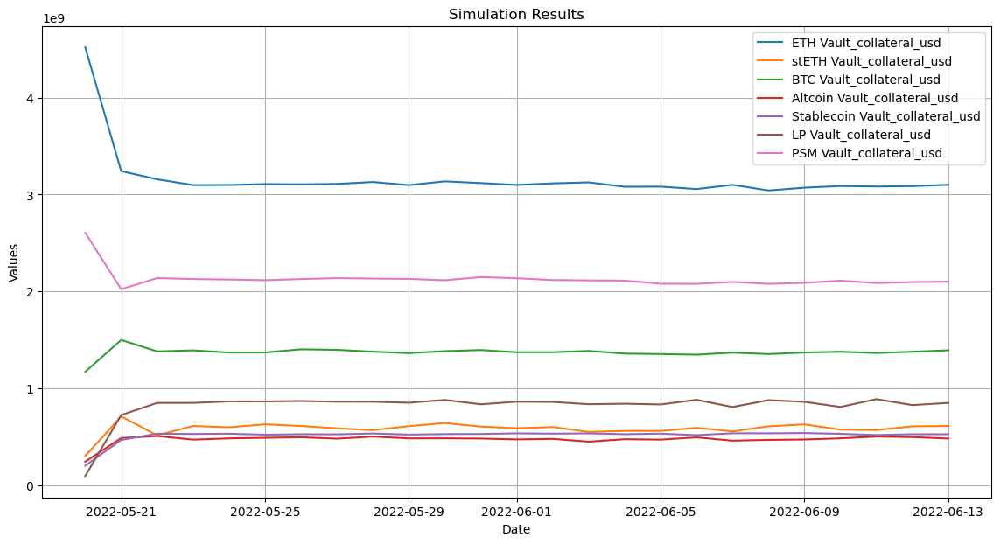

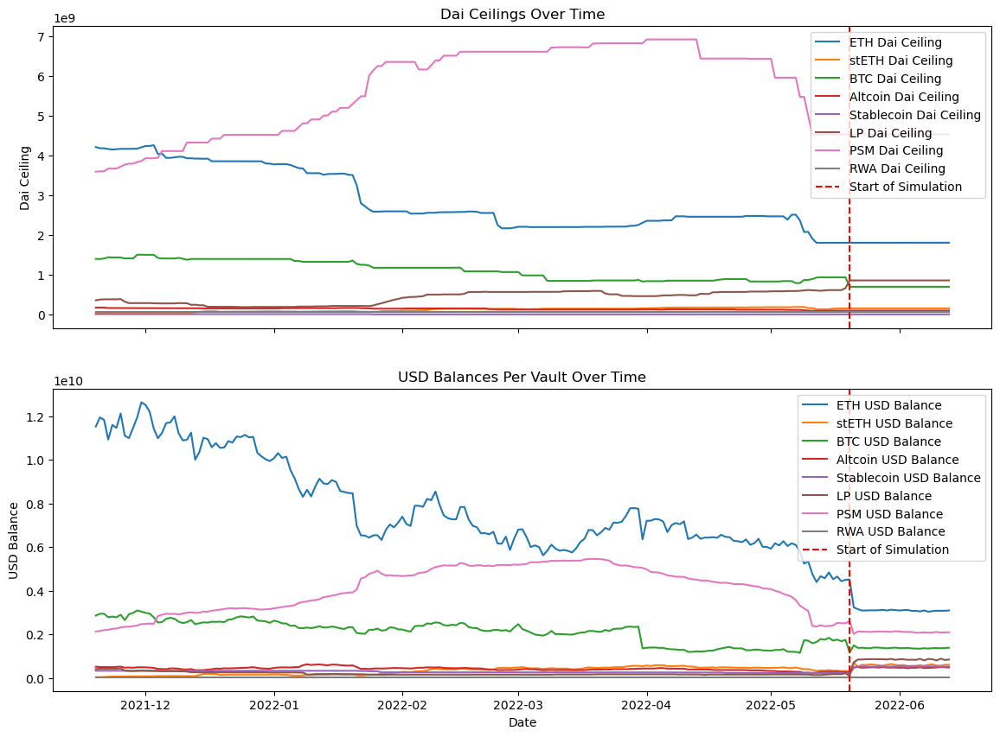

In [863]:


simulation_data = test_data_copy  # Assuming this is defined with your actual data
simulation_data.index = simulation_data.index.tz_localize(None)  # Remove timezone information
start_date = '2022-05-20'
end_date = '2024-03-20'

simulation = RL_VaultSimulator(simulation_data, simulation_data, features, targets, temporals, start_date, end_date, scale_factor=300000000, minimum_value_factor=0.05, volatility_window=250)
simulation.train_model()
simulation.run_simulation(start_date)
simulation.plot_simulation_results()


# Plot Dai ceilings and USD balances
vault_names = ['ETH', 'stETH', 'BTC', 'Altcoin', 'Stablecoin', 'LP', 'PSM', 'RWA']
simulation.plot_dai_ceilings_and_usd_balances(start_date, vault_names)

# Calculate error metrics against actual data (if available)
# Replace 'actual_data' with your actual data DataFrame if you have it
# simulation.calculate_error_metrics(actual_data)


result = simulation.results
evaluate_predictions(result, historical)

### Filter for MVO

In [865]:
historical_data = historical[historical.index <= '2022-05-19']

In [866]:
historical_data_mvo = historical_data.copy()

historical_data_mvo.index= historical_data_mvo.index.tz_localize(None)


In [867]:
result.index

DatetimeIndex(['2022-05-20', '2022-05-21', '2022-05-22', '2022-05-23',
               '2022-05-24', '2022-05-25', '2022-05-26', '2022-05-27',
               '2022-05-28', '2022-05-29', '2022-05-30', '2022-05-31',
               '2022-06-01', '2022-06-02', '2022-06-03', '2022-06-04',
               '2022-06-05', '2022-06-06', '2022-06-07', '2022-06-08',
               '2022-06-09', '2022-06-10', '2022-06-11', '2022-06-12'],
              dtype='datetime64[ns]', freq=None)

In [868]:
combined_data = pd.concat([historical_data_mvo, result])

# Optional: Sort the DataFrame by index if it's not already sorted
combined_data.sort_index(inplace=True)

# Now 'combined_data' contains both historical and simulation data in one DataFrame
print(combined_data)

            ETH Vault_collateral_usd  stETH Vault_collateral_usd  \
2021-11-19      11,530,810,569.93515            39,769,944.75450   
2021-11-20      11,943,278,353.68762            41,280,230.12684   
2021-11-21      11,839,472,041.02766            48,477,796.29037   
2021-11-22      10,933,452,742.14960            59,724,075.18165   
2021-11-23      11,600,116,135.99997            74,570,808.78308   
...                              ...                         ...   
2022-06-08       3,637,672,415.81178           550,722,733.28982   
2022-06-09       3,637,644,711.37109           550,732,825.32270   
2022-06-10       3,637,615,116.25696           550,743,668.82683   
2022-06-11       3,637,581,679.40944           550,758,021.54378   
2022-06-12       3,637,550,545.40515           550,773,133.39234   

            BTC Vault_collateral_usd  Altcoin Vault_collateral_usd  \
2021-11-19       2,866,222,769.09959             520,045,444.90519   
2021-11-20       2,948,959,833.37399       

In [869]:
historical_comparison = historical[historical.index <= '2022-06-12']
historical_comparison

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd
day,,,,,,,
2021-11-19 00:00:00+00:00,"11,530,810,569.93515","39,769,944.75450","2,866,222,769.09959","520,045,444.90519","336,521,697.42675","412,562,137.86644","2,132,251,251.20941"
2021-11-20 00:00:00+00:00,"11,943,278,353.68762","41,280,230.12684","2,948,959,833.37399","508,972,390.70129","336,521,697.42675","430,562,322.97248","2,164,546,578.27289"
2021-11-21 00:00:00+00:00,"11,839,472,041.02766","48,477,796.29037","2,951,818,107.21472","505,016,705.04971","336,521,697.42675","431,500,082.06578","2,195,743,029.10143"
2021-11-22 00:00:00+00:00,"10,933,452,742.14960","59,724,075.18165","2,788,017,226.13774","509,504,043.07337","336,503,182.74675","433,806,450.38492","2,215,601,174.20796"
2021-11-23 00:00:00+00:00,"11,600,116,135.99997","74,570,808.78308","2,821,788,807.21326","500,427,709.74620","336,503,182.74675","432,619,037.81609","2,258,244,677.18063"
...,...,...,...,...,...,...,...
2022-06-08 00:00:00+00:00,"4,050,060,265.43443","296,041,082.29670","1,089,669,916.28878","227,352,366.03357","233,744,001.91675","469,330,116.49566","3,047,997,695.49500"
2022-06-09 00:00:00+00:00,"4,019,070,946.78803","292,957,067.73844","1,081,641,959.07623","235,816,356.83017","233,743,991.91675","473,692,781.18026","3,067,429,845.05810"
2022-06-10 00:00:00+00:00,"3,541,923,869.83355","303,737,780.74378","1,042,921,620.89711","212,844,964.38839","233,743,991.91675","520,271,255.49190","3,073,483,141.21037"


In [870]:
result

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd
2022-05-20,"4,473,830,113.09779","334,903,347.41405","1,240,758,718.48997","238,999,273.73184","193,442,986.98972","-10,028,037.02689","2,666,879,365.34002"
2022-05-21,"3,755,609,053.91898","598,955,657.82916","1,393,430,545.72676","299,292,678.60810","365,407,942.91493","206,815,871.11995","2,519,274,017.91708"
2022-05-22,"3,637,979,306.60062","550,697,189.35701","1,156,707,741.68221","302,385,974.98340","426,429,915.31580","450,545,051.45965","2,614,040,588.63561"
2022-05-23,"3,638,076,984.64290","550,688,614.10567","1,156,171,925.21390","302,427,450.69185","426,349,612.44884","451,014,888.03669","2,614,056,292.89377"
2022-05-24,"3,638,053,875.70357","550,690,364.79748","1,156,169,916.53804","302,428,007.96972","426,360,434.47445","451,017,426.67151","2,614,065,741.87820"
2022-05-25,"3,638,030,296.00089","550,691,972.52964","1,156,169,174.92269","302,428,548.64497","426,371,374.28164","451,018,819.25215","2,614,075,582.40032"
2022-05-26,"3,638,005,805.29203","550,693,215.94693","1,156,169,142.64382","302,428,919.14954","426,383,156.38814","451,020,374.73625","2,614,085,153.87492"
2022-05-27,"3,637,982,724.87858","550,694,088.77010","1,156,169,223.37325","302,429,692.77641","426,394,296.60793","451,021,405.96235","2,614,094,335.66235"
2022-05-28,"3,637,958,855.18233","550,695,506.17206","1,156,168,845.27704","302,430,133.14066","426,405,549.95752","451,022,954.63564","2,614,103,923.66503"
2022-05-29,"3,637,933,424.88900","550,697,402.54389","1,156,168,286.93600","302,430,119.86577","426,417,513.91206","451,025,072.41768","2,614,113,947.46522"


## Environment Final

In [871]:
dai_ceilings = [
            'ETH Vault_dai_ceiling','stETH Vault_dai_ceiling','BTC Vault_dai_ceiling', 
    'Altcoin Vault_dai_ceiling','Stablecoin Vault_dai_ceiling','LP Vault_dai_ceiling','RWA Vault_dai_ceiling','PSM Vault_dai_ceiling'
        ]

class SimulationEnvironment:
    def __init__(self, simulator, start_date, end_date, agent=None):
        self.simulator = simulator
        self.start_date = pd.to_datetime(start_date).tz_localize(None)
        self.end_date = pd.to_datetime(end_date).tz_localize(None)
        self.current_date = self.start_date
        self.agent = agent
        self.action_log = []
        self.dai_ceiling = None
    
    def run(self, predefined_actions=None):
        state = self.reset()  # Ensures starting from a clean state every time
        done = False
        reward = 0
        while self.current_date <= self.end_date:
            next_cycle_date = min(self.current_date + pd.DateOffset(days=24), self.end_date)
            print(f"Running simulation from {self.current_date} to {next_cycle_date}")
            
            if predefined_actions:
                action = predefined_actions
            else:
                action = self.agent.agent_policy(state, self.dai_ceiling) if self.agent else None

            if action:
                print(f"Action at {self.current_date}: {action}")
                self.action_log.append({'date': self.current_date, 'action': action})
            else:
                print(f"No action taken at {self.current_date}")

            self.simulator.run_simulation(self.current_date.strftime('%Y-%m-%d'), action)
            state = self.get_state(self.current_date)
            print('state in run as of self.current_date', state)
            reward, current_weights = self.reward_function()  # Assumes this function is defined to handle rewards
            print(f"Reward at the end of the cycle on {next_cycle_date}: {reward}")

            self.current_date = next_cycle_date + pd.DateOffset(days=1)
            if self.current_date > self.end_date:
                done = True
                print(f"Reached or passed end date: stopping simulation at {self.current_date}")
                break
            
            print(f"Completed cycle up to {next_cycle_date}")
        return state, reward, done, {}

    def reset(self):
        self.simulator.reset()
        self.current_date = self.start_date
        print("Environment and simulator reset.")
        self.action_log.append({'date': self.current_date, 'env reset start date': self.start_date})
        self.simulator.current_date = self.current_date
        return self.get_state(self.current_date)

    def get_state(self, simulation_date):
        print('self date', self.current_date)
        print('self.simulator date', self.simulator.current_date)
        self.current_date = self.simulator.current_date
        simulation_date = self.simulator.current_date

        if simulation_date in self.simulator.data.index:
            state_data = self.simulator.data.loc[simulation_date, self.simulator.targets]
        else:
            previous_dates = self.simulator.data.index[self.simulator.data.index < simulation_date]
            if not previous_dates.empty:
                last_available_date = previous_dates[-1]
                state_data = self.simulator.data.loc[last_available_date, self.simulator.targets]
            else:
                state_data = self.simulator.data[self.simulator.targets].iloc[-1]

        total_value = state_data.sum()
        self.action_log.append({'date': self.current_date, 'get state calculated portfolio value': total_value})
        relative_weights = state_data / total_value if total_value != 0 else state_data
        print('relative weights:', relative_weights)
        print(f"Current state fetched for date {simulation_date}: {relative_weights}")
        return relative_weights.to_dict()

    def run_daily_simulation(self, simulation_date):
        volatilities = self.simulator.calculate_historical_volatility()
        if simulation_date in self.simulator.data.index:
            X_test = self.simulator.data.loc[[simulation_date], self.simulator.features]
        else:
            X_test = self.simulator.data.loc[self.simulator.data.index < simulation_date, self.simulator.features].iloc[-1].to_frame().T

        predictions = self.simulator.forecast(X_test, volatilities)
        self.simulator.update_state(pd.DatetimeIndex([simulation_date]), predictions)
        print(f"Simulation date {simulation_date} updated. Current data index: {self.simulator.data.index}")

    def step(self, action=None):
        reward = 0
        if action:
            print('action', action)
            self.simulator.apply_action(action)
            self.action_log.append({'date': self.current_date, 'action': action})

        if not hasattr(self, 'current_simulation_date') or self.current_simulation_date < self.start_date:
            self.current_simulation_date = self.start_date
        
        self.current_simulation_date += pd.DateOffset(days=1)
        
        if self.current_simulation_date <= self.end_date:
            self.run_daily_simulation(self.current_simulation_date)
            done = False
        else:
            done = True
            reward, current_weights = self.reward_function()

        current_state = self.get_state(self.current_simulation_date)
        return current_state, reward, done, {}

    def apply_action(self, action):
        for vault_name, adjustment in action.items():
            ...

        self.action_log.append({
            'date': self.current_date,
            'action': action,
            'additional_info': {}
        })

    def generate_action_dataframe(self):
        return pd.DataFrame(self.action_log)

    def reward_function(self):
        print('Simulator data for MVO:', self.simulator.data[self.simulator.targets])
        optimized_weights, returns, composition, total_portfolio_value = mvo(self.simulator.data)
        self.action_log.append({'date': self.current_date, 'mvo calculated current portfolio value': total_portfolio_value.iloc[-1]})
        self.action_log.append({'date': self.current_date, 'calculated optimized weights': optimized_weights})
        self.action_log.append({'date': self.current_date, 'current composition': composition.iloc[-1]})

        if self.agent is None:
            current_weights = composition.iloc[-1].to_dict()
            target_weights = {k: v for k, v in zip(composition.columns, optimized_weights)}
            print('Target weights (no agent):', target_weights)
        else:
            current_weights = composition.iloc[-1].to_dict()
            self.agent.target_weights = {k: v for k, v in zip(composition.columns, optimized_weights)}
            target_weights = self.agent.target_weights
            self.action_log.append({'date': self.current_date, 'agent weights updated to': target_weights})
            print('Agent weights updated:', target_weights)

        current_daily_returns, current_downside_returns, current_excess_returns, current_sortino_ratio = historical_sortino(returns, composition)
        self.action_log.append({'date': self.current_date, 'current sortino ratio': current_sortino_ratio})
        target_daily_returns, target_downside_returns, target_excess_returns, target_sortino_ratio = optimized_sortino(returns, optimized_weights)
        self.action_log.append({'date': self.current_date, 'target sortino ratio': target_sortino_ratio})
        self.action_log.append({'date': self.current_date, 'current weights': current_weights})
        self.action_log.append({'date': self.current_date, 'target weights': target_weights})
        print('Current Financials:')
        cumulative_return = visualize_mvo_results(current_daily_returns, current_downside_returns, current_excess_returns)
        self.action_log.append({'date': self.current_date, 'current cumulative return': cumulative_return.iloc[-1]})

        max_distance = sum(abs(1 - value) for value in target_weights.values())
        distance_penalty = sum(abs(current_weights.get(key, 0) - value) for key, value in target_weights.items()) / max_distance if max_distance != 0 else 0
        self.action_log.append({'date': self.current_date, 'Distance penalty': distance_penalty})

        sortino_scale = 100000
        scaled_sortino_diff = (target_sortino_ratio - current_sortino_ratio) / sortino_scale
        print('Sortino ratio:', current_sortino_ratio)
        print('Scaled Sortino diff:', scaled_sortino_diff)
        self.action_log.append({'date': self.current_date, 'Scaled Sortino diff': scaled_sortino_diff})

        reward = scaled_sortino_diff - distance_penalty
        reward_no_scale = current_sortino_ratio - distance_penalty
        self.action_log.append({'date': self.current_date, 'Reward': reward})
        self.action_log.append({'date': self.current_date, 'Reward no scale': reward_no_scale})

        self.dai_ceiling = self.simulator.data[dai_ceilings]
        self.action_log.append({'date': self.current_date, 'dai ceilings': self.dai_ceiling})
        print('reward', reward)
        
        return reward_no_scale, current_weights

# Assuming the necessary variables (simulation_data, features, targets, temporals) are defined and correct
simulator_simulation_data = test_data_copy  # Assuming this is correctly defined with your actual data

start_date = '2022-05-20'
end_date = '2022-07-01'
actions = {'stETH Vault_dai_ceiling': 5, 'ETH Vault_dai_ceiling': -5}  # Example action

test_simulator = MVO_VaultSimulator(simulator_simulation_data, test_data_copy, features, targets, temporals, start_date, end_date)
test_simulator.train_model()

test_environment = SimulationEnvironment(test_simulator, start_date, end_date)
test_environment.run(actions)

test_simulator.plot_simulation_results()

sim_results = test_simulator.results
duplicates = sim_results.index.duplicated()
if duplicates.any():
    print(f"Duplicated indexes found: {sim_results.index[duplicates]}")


In [872]:
class SimulationEnvironment:
    def __init__(self, simulator, start_date, end_date, agent=None):
        self.simulator = simulator
        self.start_date = pd.to_datetime(start_date).tz_localize(None)
        self.end_date = pd.to_datetime(end_date).tz_localize(None)
        self.current_date = self.start_date 
        self.agent = agent
        self.action_log = []
        self.dai_ceiling = None
    
    def run(self, predefined_actions=None):
        state = self.reset()  # Ensures starting from a clean state every time
        done = False
        reward = 0
        while self.current_date <= self.end_date:
            next_cycle_date = min(self.current_date + pd.DateOffset(days=24), self.end_date)
            print(f"Running simulation from {self.current_date} to {next_cycle_date}")
            
            if predefined_actions:
                action = predefined_actions
            else:
                action = self.agent.agent_policy(state, self.dai_ceiling) if self.agent else None

            if action:
                print(f"Action at {self.current_date}: {action}")
                self.action_log.append({'date': self.current_date, 'action': action})
            else:
                print(f"No action taken at {self.current_date}")

            self.simulator.run_simulation(self.current_date.strftime('%Y-%m-%d'), action)
            state = self.get_state(self.current_date)
            print('state in run as of self.current_date', state)
            reward, current_weights = self.reward_function()  # Assumes this function is defined to handle rewards
            print(f"Reward at the end of the cycle on {next_cycle_date}: {reward}")

            self.current_date = next_cycle_date + pd.DateOffset(days=1)
            if self.current_date > self.end_date:
                done = True
                print(f"Reached or passed end date: stopping simulation at {self.current_date}")
                break
            
            print(f"Completed cycle up to {next_cycle_date}")
        return state, reward, done, {}

    def reset(self):
        self.simulator.reset()
        self.current_date = self.start_date
        print("Environment and simulator reset.")
        self.action_log.append({'date': self.current_date, 'env reset start date': self.start_date})
        self.simulator.current_date = self.current_date
        return self.get_state(self.current_date)

    def get_state(self, simulation_date):
        print('self date', self.current_date)
        print('self.simulator date', self.simulator.current_date)
        self.current_date = self.simulator.current_date
        print('new self date', self.current_date)
        simulation_date = self.simulator.current_date

        if simulation_date in self.simulator.data.index:
            state_data = self.simulator.data.loc[simulation_date, self.simulator.targets]
        else:
            previous_dates = self.simulator.data.index[self.simulator.data.index < simulation_date]
            if not previous_dates.empty:
                last_available_date = previous_dates[-1]
                state_data = self.simulator.data.loc[last_available_date, self.simulator.targets]
            else:
                state_data = self.simulator.data[self.simulator.targets].iloc[-1]

        total_value = state_data.sum()
        self.action_log.append({'date': self.current_date, 'get state calculated portfolio value': total_value})
        relative_weights = state_data / total_value if total_value != 0 else state_data
        print('relative weights:', relative_weights)
        print(f"Current state fetched for date {simulation_date}: {relative_weights}")
        return relative_weights.to_dict()

    def run_daily_simulation(self, simulation_date):
        volatilities = self.simulator.calculate_historical_volatility()
        if simulation_date in self.simulator.data.index:
            X_test = self.simulator.data.loc[[simulation_date], self.simulator.features]
        else:
            X_test = self.simulator.data.loc[self.simulator.data.index < simulation_date, self.simulator.features].iloc[-1].to_frame().T

        predictions = self.simulator.forecast(X_test, volatilities)
        self.simulator.update_state(pd.DatetimeIndex([simulation_date]), predictions)
   
    def step(self, action=None):
        reward = 0
        if action:
            print('action', action)
            self.simulator.apply_action(action)
            self.action_log.append({'date': self.current_date, 'action': action})

        if not hasattr(self, 'current_simulation_date') or self.current_simulation_date < self.start_date:
            self.current_simulation_date = self.start_date
        
        self.current_simulation_date += pd.DateOffset(days=1)
        
        if self.current_simulation_date <= self.end_date:
            self.run_daily_simulation(self.current_simulation_date)
            done = False
        else:
            done = True
            reward, current_weights = self.reward_function()

        current_state = self.get_state(self.current_simulation_date)
        return current_state, reward, done, {}

    def apply_action(self, action):
        for vault_name, adjustment in action.items():
            ...

        self.action_log.append({
            'date': self.current_date,
            'action': action,
            'additional_info': {}
        })

    def generate_action_dataframe(self):
        return pd.DataFrame(self.action_log)

    def reward_function(self):
        print('Simulator data for MVO:', self.simulator.data[self.simulator.targets])
        optimized_weights, returns, composition, total_portfolio_value = mvo(self.simulator.data)
        self.action_log.append({'date': self.current_date, 'mvo calculated current portfolio value': total_portfolio_value.iloc[-1]})
        self.action_log.append({'date': self.current_date, 'calculated optimized weights': optimized_weights})
        self.action_log.append({'date': self.current_date, 'current composition': composition.iloc[-1]})

        if self.agent is None:
            current_weights = composition.iloc[-1].to_dict()
            target_weights = {k: v for k, v in zip(composition.columns, optimized_weights)}
            print('Target weights (no agent):', target_weights)
        else:
            current_weights = composition.iloc[-1].to_dict()
            self.agent.target_weights = {k: v for k, v in zip(composition.columns, optimized_weights)}
            target_weights = self.agent.target_weights
            self.action_log.append({'date': self.current_date, 'agent weights updated to': target_weights})
            print('Agent weights updated:', target_weights)

        current_daily_returns, current_downside_returns, current_excess_returns, current_sortino_ratio = historical_sortino(returns, composition)
        self.action_log.append({'date': self.current_date, 'current sortino ratio': current_sortino_ratio})
        target_daily_returns, target_downside_returns, target_excess_returns, target_sortino_ratio = optimized_sortino(returns, optimized_weights)
        self.action_log.append({'date': self.current_date, 'target sortino ratio': target_sortino_ratio})
        self.action_log.append({'date': self.current_date, 'current weights': current_weights})
        self.action_log.append({'date': self.current_date, 'target weights': target_weights})
        print('Current Financials:')
        cumulative_return = visualize_mvo_results(current_daily_returns, current_downside_returns, current_excess_returns)
        self.action_log.append({'date': self.current_date, 'current cumulative return': cumulative_return.iloc[-1]})

        max_distance = sum(abs(1 - value) for value in target_weights.values())
        distance_penalty = sum(abs(current_weights.get(key, 0) - value) for key, value in target_weights.items()) / max_distance if max_distance != 0 else 0
        self.action_log.append({'date': self.current_date, 'Distance penalty': distance_penalty})

        sortino_scale = 100000
        scaled_sortino_diff = (target_sortino_ratio - current_sortino_ratio) / sortino_scale
        print('Sortino ratio:', current_sortino_ratio)
        print('Scaled Sortino diff:', scaled_sortino_diff)
        self.action_log.append({'date': self.current_date, 'Scaled Sortino diff': scaled_sortino_diff})

        reward = scaled_sortino_diff - distance_penalty
        reward_no_scale = current_sortino_ratio - distance_penalty
        self.action_log.append({'date': self.current_date, 'Reward': reward})
        self.action_log.append({'date': self.current_date, 'Reward no scale': reward_no_scale})

        self.dai_ceiling = self.simulator.data[dai_ceilings]
        self.action_log.append({'date': self.current_date, 'dai ceilings': self.dai_ceiling})
        print('reward', reward)
        
        return reward_no_scale, current_weights


Model trained.
Model trained.
sim reset current date 2022-05-20 00:00:00
Simulation reset and model retrained.
Environment and simulator reset.
self date 2022-05-20 00:00:00
self.simulator date 2022-05-20 00:00:00
new self date 2022-05-20 00:00:00
relative weights: ETH Vault_collateral_usd          0.48311
stETH Vault_collateral_usd        0.03406
BTC Vault_collateral_usd          0.11377
Altcoin Vault_collateral_usd      0.03133
Stablecoin Vault_collateral_usd   0.02558
LP Vault_collateral_usd           0.02785
PSM Vault_collateral_usd          0.28431
Name: 2022-05-20 00:00:00, dtype: float64
Current state fetched for date 2022-05-20 00:00:00: ETH Vault_collateral_usd          0.48311
stETH Vault_collateral_usd        0.03406
BTC Vault_collateral_usd          0.11377
Altcoin Vault_collateral_usd      0.03133
Stablecoin Vault_collateral_usd   0.02558
LP Vault_collateral_usd           0.02785
PSM Vault_collateral_usd          0.28431
Name: 2022-05-20 00:00:00, dtype: float64
Running si

C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

current state ETH Vault_collateral_usd                 4,503,301,377.11990
stETH Vault_collateral_usd                 358,439,103.34638
BTC Vault_collateral_usd                 1,205,040,236.73481
Altcoin Vault_collateral_usd               269,140,410.15991
Stablecoin Vault_collateral_usd            199,286,310.02766
                                                 ...        
Stablecoin Vault_collateral_usd_30d_ma     233,001,550.25645
LP Vault_collateral_usd_30d_ma             162,294,137.81397
PSM Vault_collateral_usd_30d_ma          3,450,426,903.35166
RWA Vault_collateral_usd_30d_ma             50,870,409.00000
RWA Vault_prev_dai_ceiling                  59,000,000.00000
Name: 2022-05-20 00:00:00, Length: 85, dtype: float64
vault stETH Vault_dai_ceiling
Applying action to: stETH Vault_dai_ceiling
Simulator Adjusted stETH Vault_dai_ceiling by 5% from 149815023.30912796 to 157305774.47458437
vault ETH Vault_dai_ceiling
Applying action to: ETH Vault_dai_ceiling
Simulator Adjusted ETH

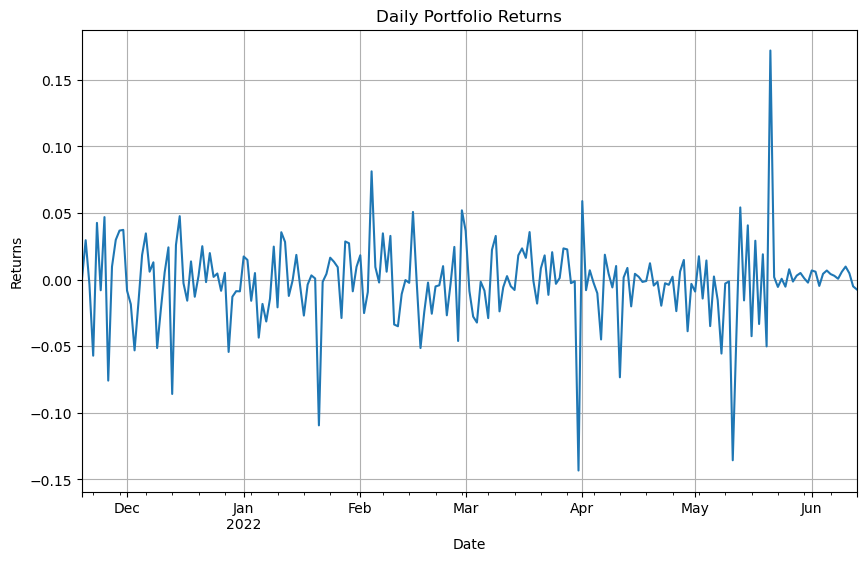

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


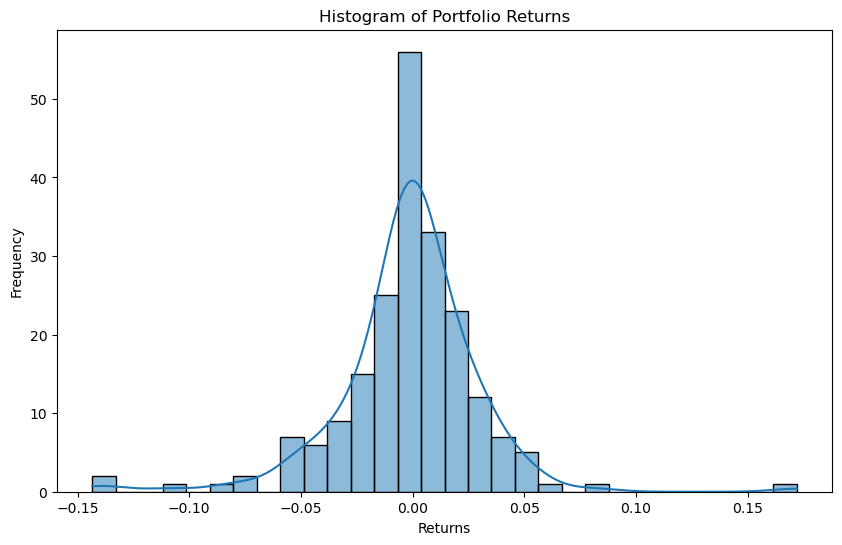

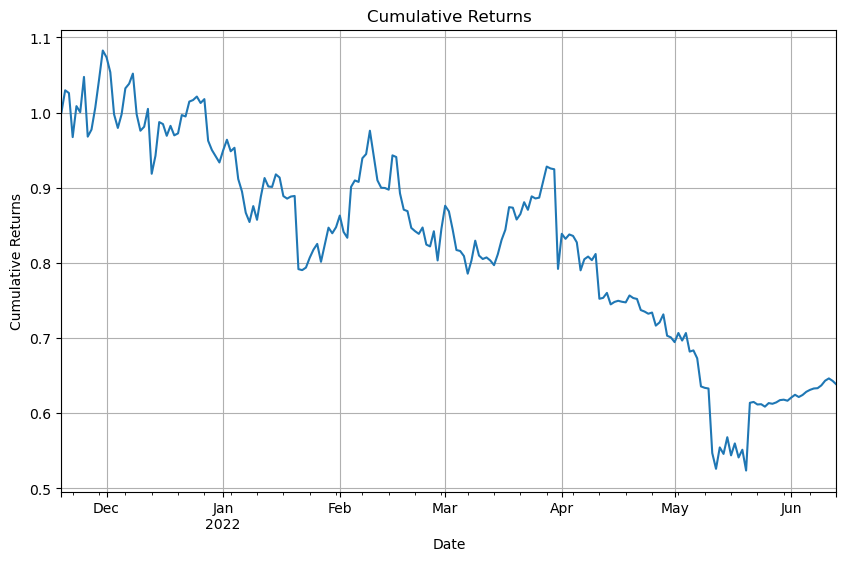

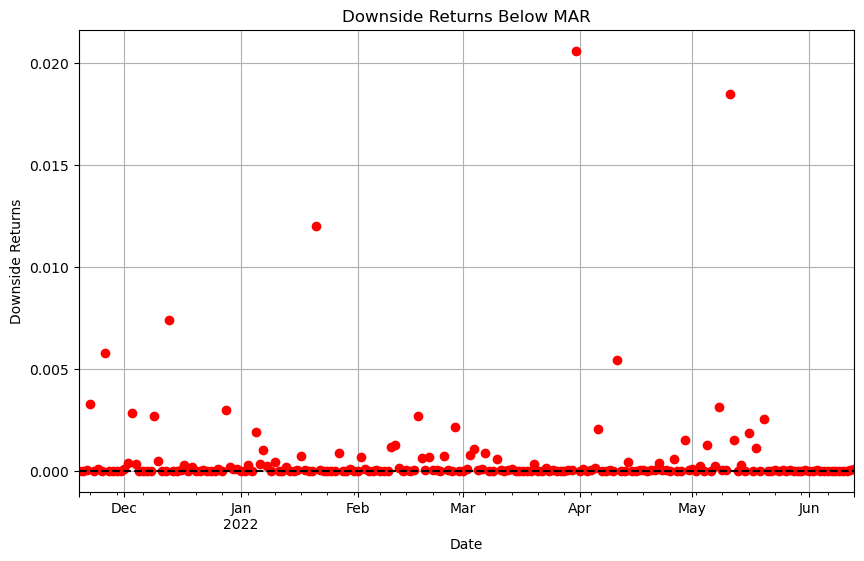

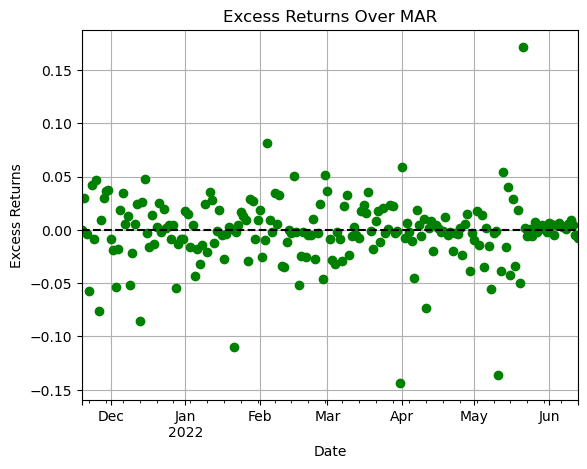

Sortino ratio: -1.2303971696510003
Scaled Sortino diff: 0.0001850219419518569
reward -0.13441858375474863
Reward at the end of the cycle on 2022-06-13 00:00:00: -1.365000775347701
Completed cycle up to 2022-06-13 00:00:00
Running simulation from 2022-06-14 00:00:00 to 2022-07-01 00:00:00
Action at 2022-06-14 00:00:00: {'stETH Vault_dai_ceiling': 5, 'ETH Vault_dai_ceiling': -5}
current state ETH Vault_collateral_usd                 2,248,372,080.37455
stETH Vault_collateral_usd                 953,948,826.23931
BTC Vault_collateral_usd                 1,643,155,985.11730
Altcoin Vault_collateral_usd               550,654,019.13066
Stablecoin Vault_collateral_usd            484,793,216.84576
                                                 ...        
Stablecoin Vault_collateral_usd_30d_ma     456,498,507.28427
LP Vault_collateral_usd_30d_ma             728,943,083.76453
PSM Vault_collateral_usd_30d_ma          2,478,833,443.43353
RWA Vault_collateral_usd_30d_ma             50,870,409.00

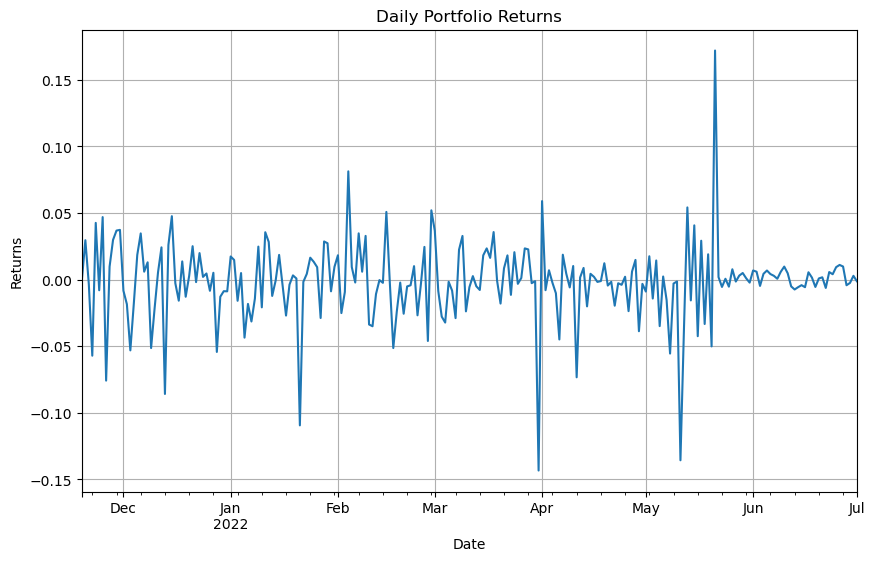

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


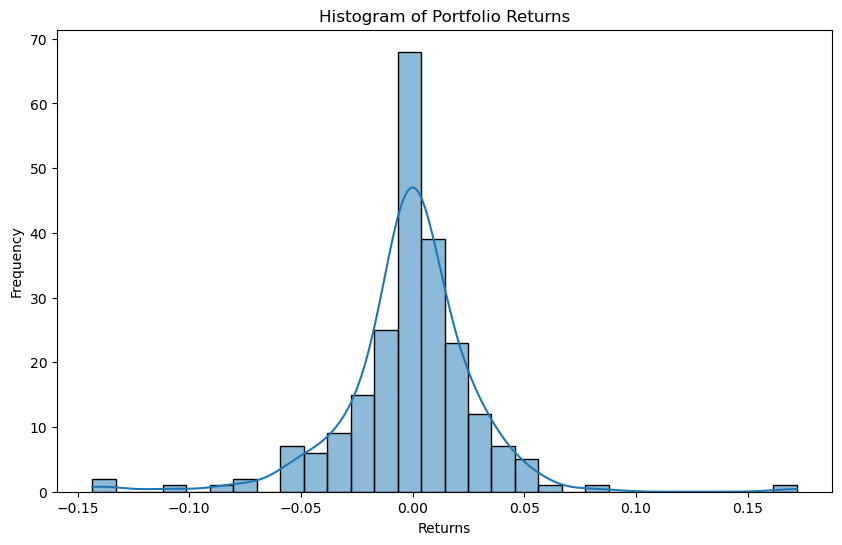

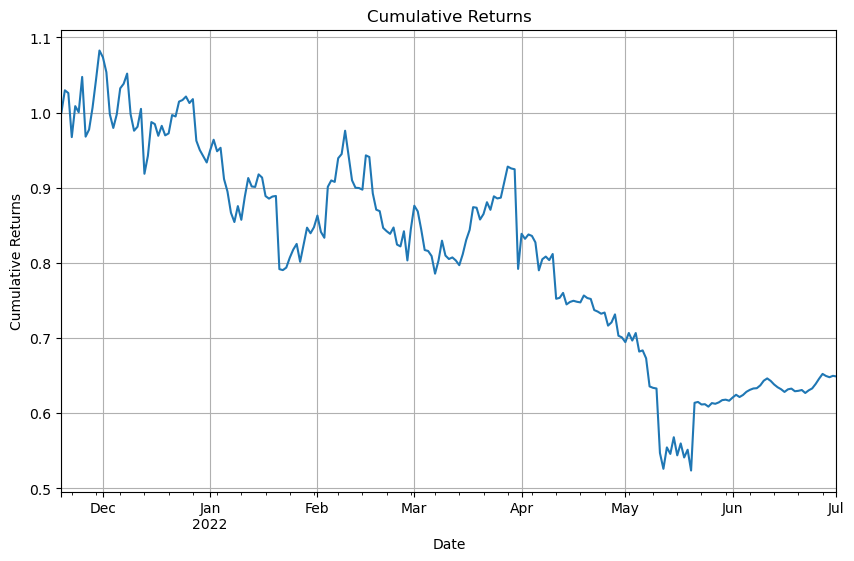

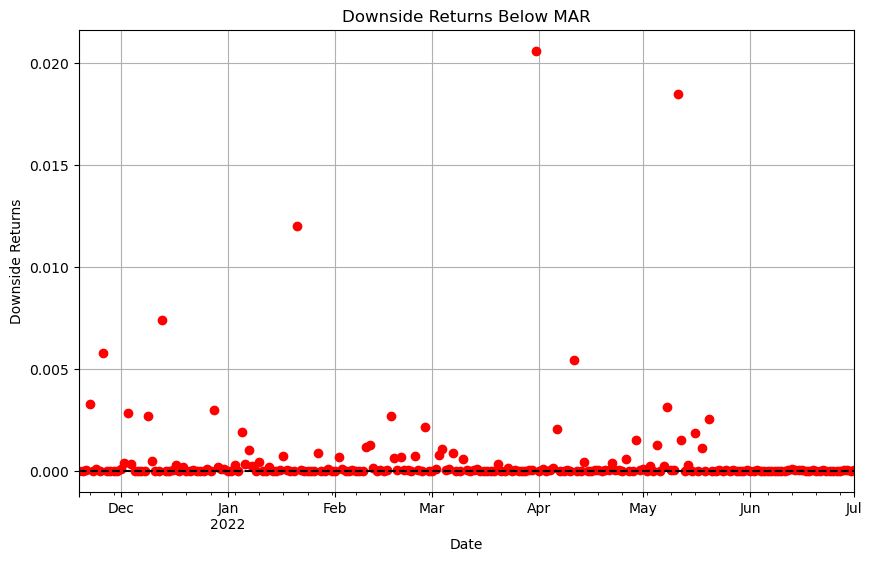

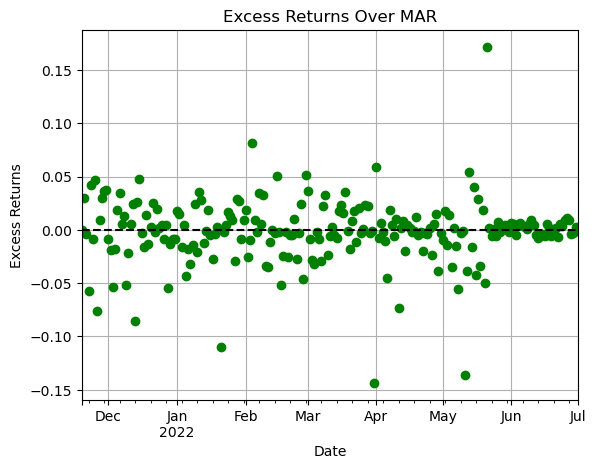

Sortino ratio: -1.1898676905840537
Scaled Sortino diff: 0.0002087091672023721
reward -0.12415542587554387
Reward at the end of the cycle on 2022-07-01 00:00:00: -1.3142318256268
Reached or passed end date: stopping simulation at 2022-07-02 00:00:00


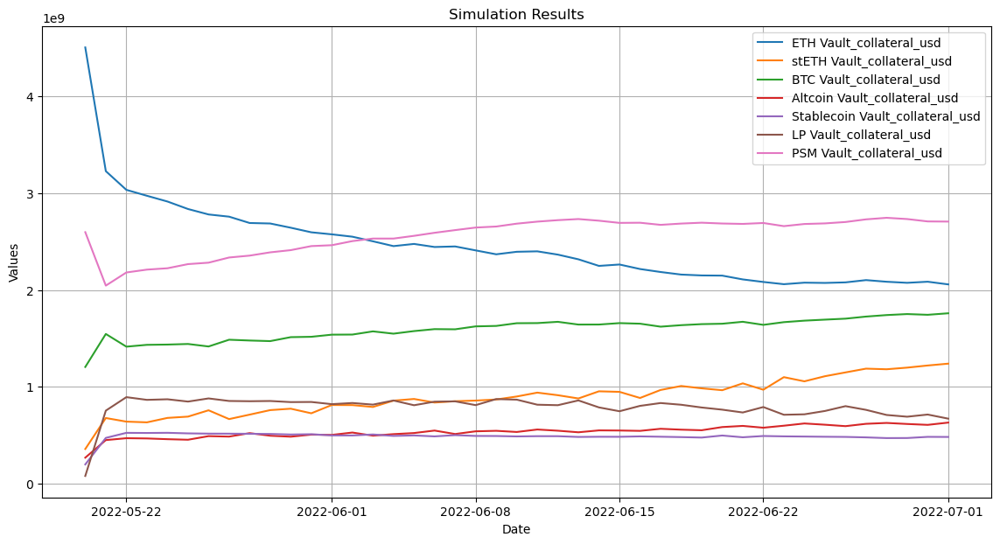

In [873]:
test_data_copy.index = test_data_copy.index.tz_localize(None)

# Assuming the necessary variables (simulation_data, features, targets, temporals) are defined and correct
simulator_simulation_data = test_data_copy  # Assuming this is correctly defined with your actual data

start_date = '2022-05-20'
end_date = '2022-07-01'
actions = {'stETH Vault_dai_ceiling': 5, 'ETH Vault_dai_ceiling': -5}  # Example action
 
test_simulator = RL_VaultSimulator(simulation_data, simulation_data, features, targets, temporals, start_date, end_date, scale_factor=300000000, minimum_value_factor=0.05, volatility_window=250)

#test_simulator.set_parameters(scale_factor=300000000, minimum_value_factor=0.05, volatility_window=250)
test_simulator.train_model()

test_environment = SimulationEnvironment(test_simulator, start_date, end_date)
test_environment.run(actions)

test_simulator.plot_simulation_results()


### Results of Sim

In [874]:
test_data_copy[['mcap_total_volume']]

,mcap_total_volume
day,
2021-11-19,"148,816,900,268.08923"
2021-11-20,"129,054,430,634.73094"
2021-11-21,"119,273,368,298.65698"
2021-11-22,"144,878,354,973.50381"
2021-11-23,"154,531,715,413.08652"
...,...
2024-03-16,"157,322,483,727.65988"
2024-03-17,"157,140,337,241.97678"
2024-03-18,"165,358,124,996.38553"


In [875]:
sim_results = test_simulator.results
sim_results.describe()

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd
count,43.00000,43.00000,43.00000,43.00000,43.00000,43.00000,43.00000
mean,"2,455,350,670.82112","894,145,375.46430","1,592,972,075.06555","536,131,719.06015","487,863,475.46451","788,708,281.04102","2,563,689,603.81962"
std,"442,135,347.02255","187,846,348.28322","113,996,670.50211","65,621,132.90207","47,524,492.08571","124,462,386.66549","185,228,208.72376"
min,"2,057,560,899.08817","358,439,103.34638","1,205,040,236.73481","269,140,410.15991","199,286,310.02766","80,051,731.10751","2,044,861,970.06970"
25%,"2,128,470,883.48990","767,183,937.08872","1,527,676,271.21941","500,095,794.10294","483,533,690.32071","758,558,935.72292","2,457,325,818.10304"
50%,"2,394,096,853.88092","880,056,880.22073","1,628,782,495.98720","545,694,442.35632","490,710,186.91595","815,282,536.61048","2,658,769,444.81549"
75%,"2,618,800,794.97561","996,696,949.43161","1,662,857,491.11884","581,584,415.70247","504,815,502.96831","850,949,915.57360","2,694,099,165.72668"
max,"4,503,301,377.11990","1,239,398,386.35405","1,759,344,329.16613","631,178,012.95117","525,642,137.77995","893,656,292.42322","2,744,736,978.39083"


In [876]:
sim_results.index.duplicated()

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False])

### Backtesting to Historical Data 

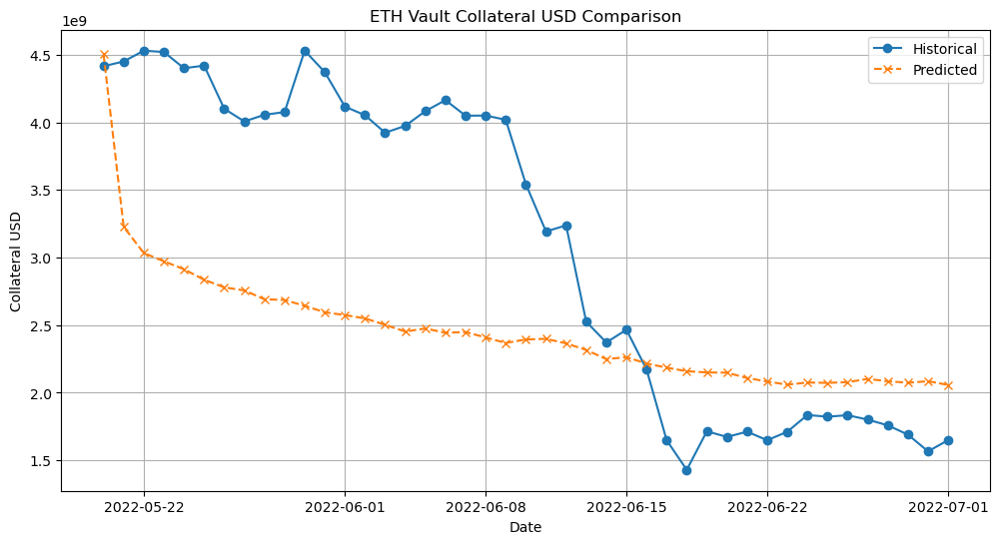

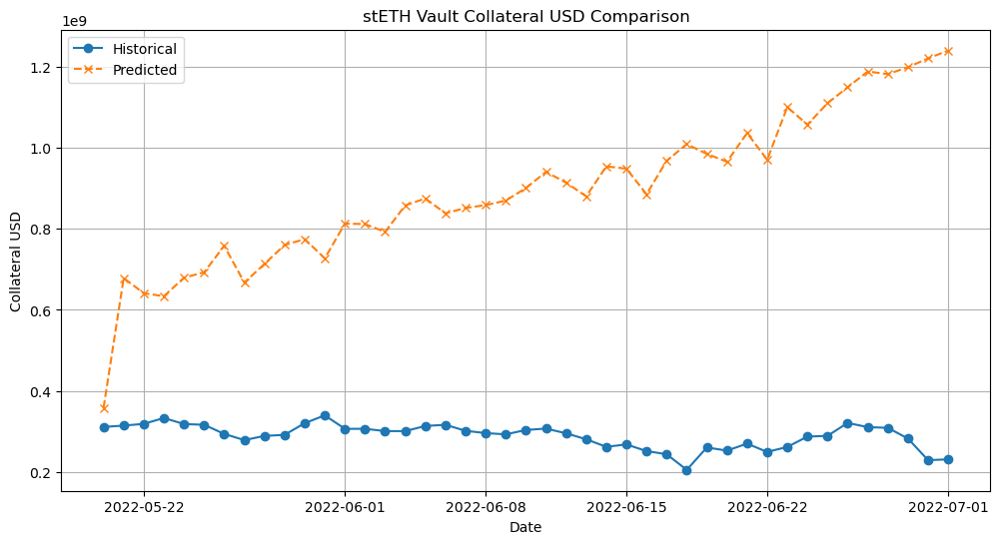

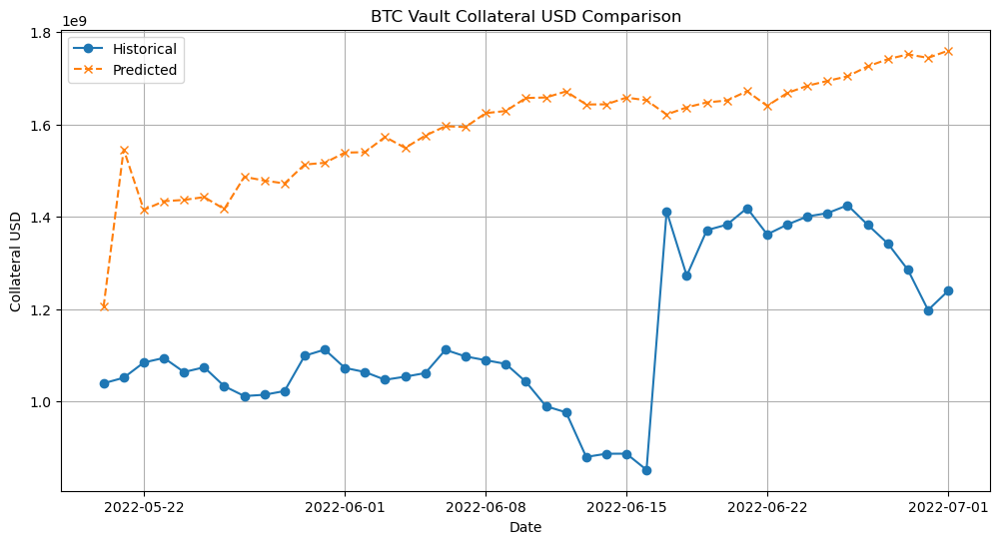

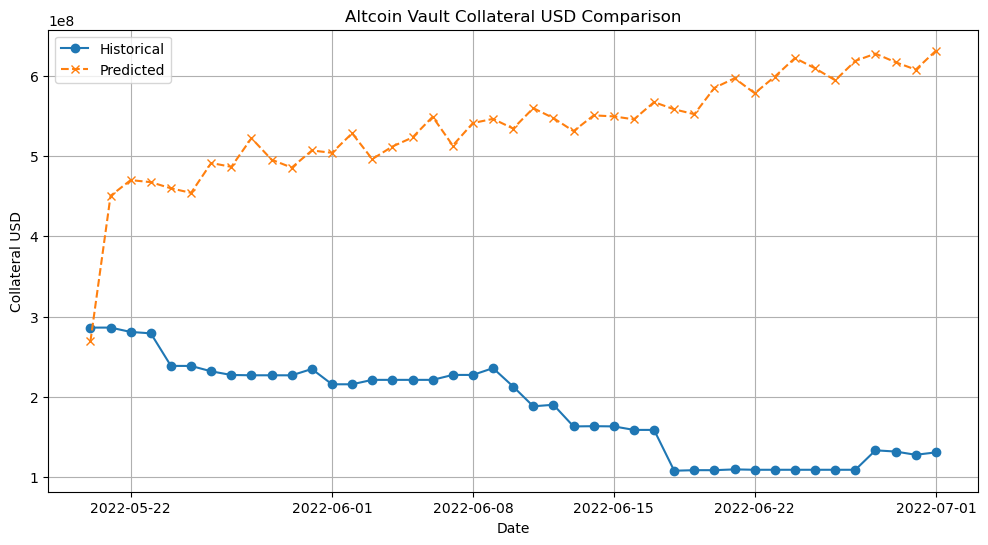

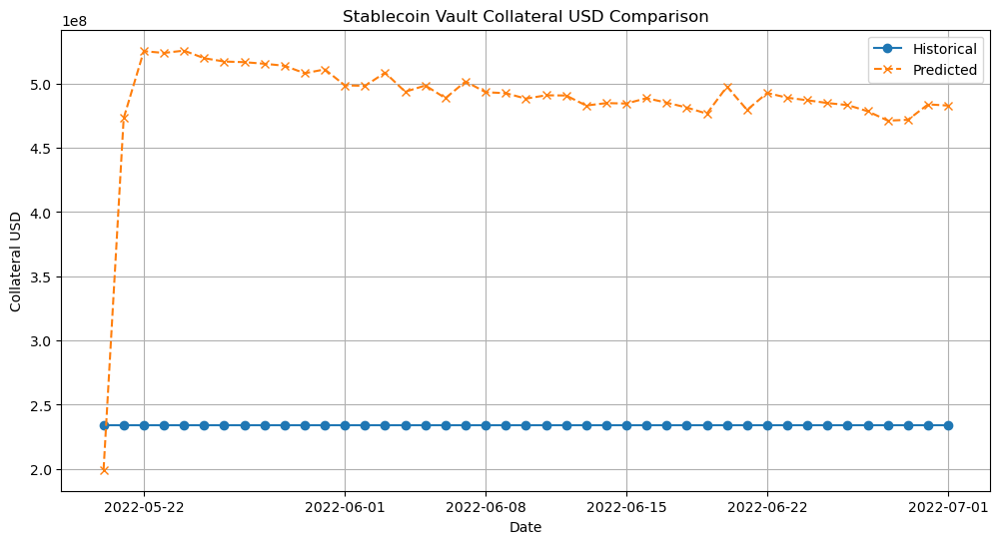

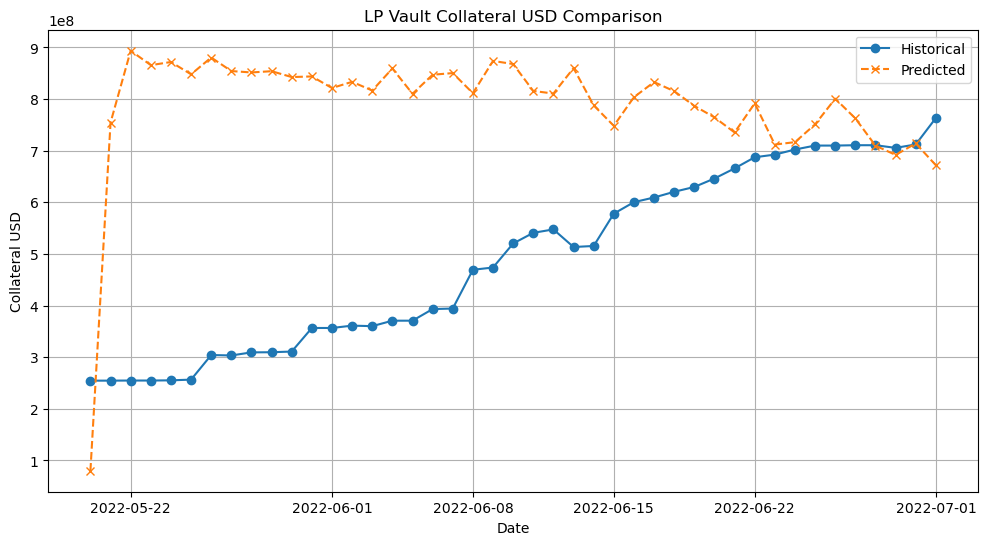

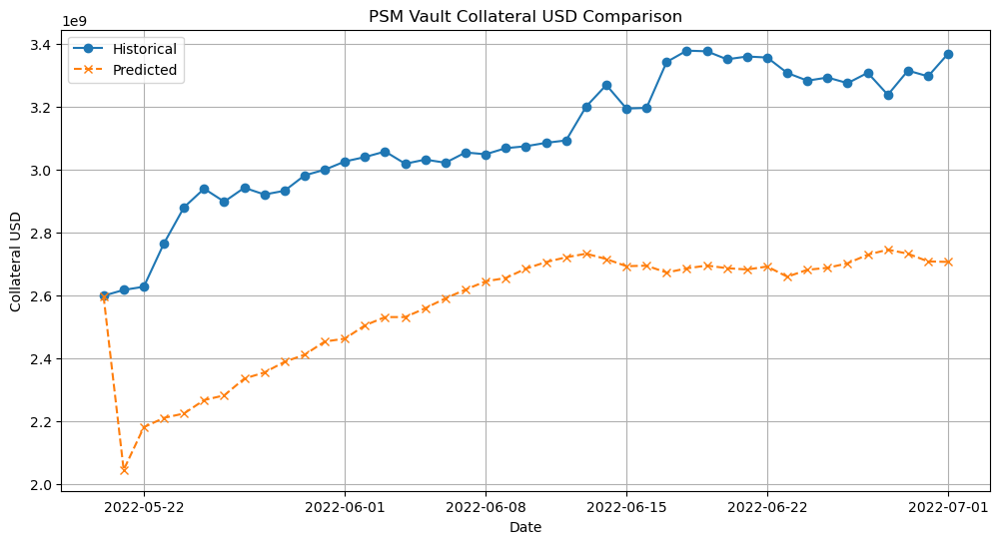

{'ETH Vault': {'MSE': 1.2245943644233068e+18,
  'MAE': 931393666.3340057,
  'RMSE': 1106613918.412066,
  'R2': 0.09921348411896824},
 'stETH Vault': {'MSE': 4.0675939577453606e+17,
  'MAE': 604897888.7397858,
  'RMSE': 637776916.934547,
  'R2': -463.4287762377452},
 'BTC Vault': {'MSE': 2.2614685310638237e+17,
  'MAE': 449138477.2767387,
  'RMSE': 475549001.7930669,
  'R2': -7.012997574619368},
 'Altcoin Vault': {'MSE': 1.3616152711982394e+17,
  'MAE': 350779819.4513159,
  'RMSE': 369000714.25381273,
  'R2': -40.160411745968},
 'Stablecoin Vault': {'MSE': 6.678275560155817e+16,
  'MAE': 255722152.0619665,
  'RMSE': 258423597.2227733,
  'R2': -121824596960766.88},
 'LP Vault': {'MSE': 1.3960772280156814e+17,
  'MAE': 311879366.4352535,
  'RMSE': 373641168.5047141,
  'R2': -3.848526298122402},
 'PSM Vault': {'MSE': 3.0504508183958816e+17,
  'MAE': 538537570.6377187,
  'RMSE': 552308864.5310594,
  'R2': -5.884787417807406}}

In [877]:
evaluate_predictions(sim_results, historical)

### MVO Comparison cleaning

In [878]:
test_data['RWA Vault_collateral_usd']

day
2021-11-19 00:00:00+00:00    50,870,409.00000
2021-11-20 00:00:00+00:00    50,870,409.00000
2021-11-21 00:00:00+00:00    50,870,409.00000
2021-11-22 00:00:00+00:00    50,870,409.00000
2021-11-23 00:00:00+00:00    50,870,409.00000
                                   ...       
2024-03-16 00:00:00+00:00   303,771,975.92692
2024-03-17 00:00:00+00:00   303,771,975.92692
2024-03-18 00:00:00+00:00   303,771,975.92692
2024-03-19 00:00:00+00:00   303,771,975.92692
2024-03-20 00:00:00+00:00   303,771,975.92692
Name: RWA Vault_collateral_usd, Length: 854, dtype: float64

In [879]:
start_date_dt = pd.to_datetime(start_date)  # Convert string to datetime
historical_cutoff = start_date_dt - pd.DateOffset(days=1)
historical_cutoff

Timestamp('2022-05-19 00:00:00')

In [880]:
historical_data = historical[historical.index <= historical_cutoff]
combined_data = pd.concat([historical_data, sim_results])
print(combined_data)


            ETH Vault_collateral_usd  stETH Vault_collateral_usd  \
2021-11-19      11,530,810,569.93515            39,769,944.75450   
2021-11-20      11,943,278,353.68762            41,280,230.12684   
2021-11-21      11,839,472,041.02766            48,477,796.29037   
2021-11-22      10,933,452,742.14960            59,724,075.18165   
2021-11-23      11,600,116,135.99997            74,570,808.78308   
...                              ...                         ...   
2022-06-27       2,101,752,851.81285         1,187,935,648.14714   
2022-06-28       2,084,786,413.49586         1,181,503,128.25820   
2022-06-29       2,073,730,359.89241         1,198,411,199.60860   
2022-06-30       2,085,073,071.75428         1,220,368,773.40459   
2022-07-01       2,057,560,899.08817         1,239,398,386.35405   

            BTC Vault_collateral_usd  Altcoin Vault_collateral_usd  \
2021-11-19       2,866,222,769.09959             520,045,444.90519   
2021-11-20       2,948,959,833.37399       

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd,RWA Vault_collateral_usd
2021-11-19,"11,530,810,569.93515","39,769,944.75450","2,866,222,769.09959","520,045,444.90519","336,521,697.42675","412,562,137.86644","2,132,251,251.20941","50,870,409.00000"
2021-11-20,"11,943,278,353.68762","41,280,230.12684","2,948,959,833.37399","508,972,390.70129","336,521,697.42675","430,562,322.97248","2,164,546,578.27289","50,870,409.00000"
2021-11-21,"11,839,472,041.02766","48,477,796.29037","2,951,818,107.21472","505,016,705.04971","336,521,697.42675","431,500,082.06578","2,195,743,029.10143","50,870,409.00000"
2021-11-22,"10,933,452,742.14960","59,724,075.18165","2,788,017,226.13774","509,504,043.07337","336,503,182.74675","433,806,450.38492","2,215,601,174.20796","50,870,409.00000"
2021-11-23,"11,600,116,135.99997","74,570,808.78308","2,821,788,807.21326","500,427,709.74620","336,503,182.74675","432,619,037.81609","2,258,244,677.18063","50,870,409.00000"
...,...,...,...,...,...,...,...,...
2022-06-27,"2,101,752,851.81285","1,187,935,648.14714","1,725,283,903.66500","618,520,965.71669","478,455,213.08252","762,535,017.07658","2,728,764,446.95093","50,870,409.00000"
2022-06-28,"2,084,786,413.49586","1,181,503,128.25820","1,740,871,115.42213","627,530,488.23138","471,133,551.60450","709,712,057.85816","2,744,736,978.39083","50,870,409.00000"
2022-06-29,"2,073,730,359.89241","1,198,411,199.60860","1,751,293,953.15124","616,820,012.81307","471,784,007.14583","691,815,625.53165","2,731,907,845.15394","50,870,409.00000"
2022-06-30,"2,085,073,071.75428","1,220,368,773.40459","1,743,699,435.70783","607,636,539.14171","483,811,850.95631","714,115,627.37163","2,707,367,027.15168","50,870,409.00000"


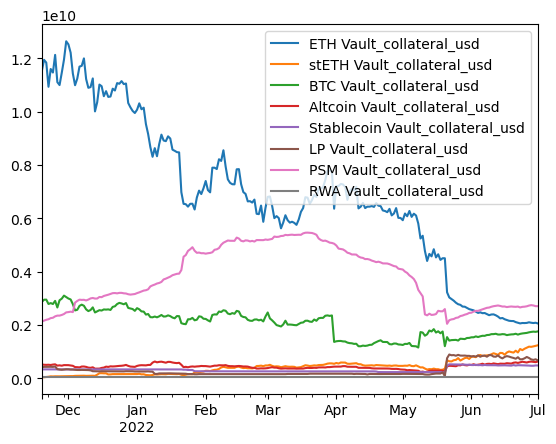

In [881]:
combined_data.index = combined_data.index.tz_localize(None)
test_data['RWA Vault_collateral_usd'].index = test_data['RWA Vault_collateral_usd'].index.tz_localize(None)


#Since RWA is not a target, we need to add back in for MVO calculations
sim_w_RWA = combined_data.merge(test_data['RWA Vault_collateral_usd'], left_index=True, right_index=True, how='left')
# Optional: Sort the DataFrame by index if it's not already sorted
sim_w_RWA.sort_index(inplace=True)

# Now 'combined_data' contains both historical and simulation data in one DataFrame
sim_w_RWA.plot()
sim_w_RWA

In [882]:
sim_cutoff = sim_w_RWA.index.max()
sim_cutoff

Timestamp('2022-07-01 00:00:00')

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd,RWA Vault_collateral_usd
day,,,,,,,,
2021-11-19,"11,530,810,569.93515","39,769,944.75450","2,866,222,769.09959","520,045,444.90519","336,521,697.42675","412,562,137.86644","2,132,251,251.20941","50,870,409.00000"
2021-11-20,"11,943,278,353.68762","41,280,230.12684","2,948,959,833.37399","508,972,390.70129","336,521,697.42675","430,562,322.97248","2,164,546,578.27289","50,870,409.00000"
2021-11-21,"11,839,472,041.02766","48,477,796.29037","2,951,818,107.21472","505,016,705.04971","336,521,697.42675","431,500,082.06578","2,195,743,029.10143","50,870,409.00000"
2021-11-22,"10,933,452,742.14960","59,724,075.18165","2,788,017,226.13774","509,504,043.07337","336,503,182.74675","433,806,450.38492","2,215,601,174.20796","50,870,409.00000"
2021-11-23,"11,600,116,135.99997","74,570,808.78308","2,821,788,807.21326","500,427,709.74620","336,503,182.74675","432,619,037.81609","2,258,244,677.18063","50,870,409.00000"
...,...,...,...,...,...,...,...,...
2022-06-27,"1,800,714,480.55214","310,731,600.93738","1,382,529,579.79071","109,208,152.59284","233,743,997.45382","710,606,118.37480","3,306,970,942.69320","50,870,409.00000"
2022-06-28,"1,758,510,425.99820","309,030,872.67378","1,342,063,737.36939","133,438,431.51392","233,743,997.45382","710,606,118.37480","3,236,933,835.07079","50,870,409.00000"
2022-06-29,"1,689,810,873.49484","282,629,563.78562","1,284,948,326.66461","131,910,945.34577","233,743,997.45382","705,466,717.68136","3,313,992,929.35301","50,870,409.00000"


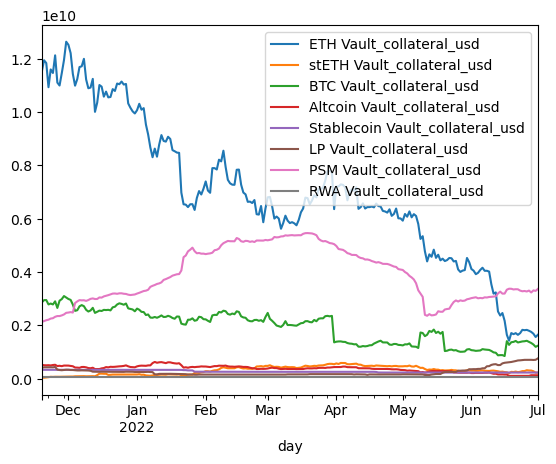

In [883]:
# Assuming 'test_data' is the DataFrame with the timezone-aware index
test_data.index = pd.to_datetime(test_data.index).tz_localize(None)

# Now perform the merge
historical_sim = test_data[test_data.index <= sim_cutoff]
historical_sim = historical_sim[targets].merge(test_data['RWA Vault_collateral_usd'], left_index=True, right_index=True, how='left')
historical_sim.plot()
historical_sim

### Simulation MVO Scores

In [884]:
# Optimized Weights for Simulation

portfolio_mvo_weights, portfolio_returns, portfolio_composition, total_portfolio_value = mvo(sim_w_RWA)
print('optimized weights:', portfolio_mvo_weights)
print('current composition:', portfolio_composition.iloc[-1])
print(f'current portfolio value: ${total_portfolio_value.iloc[-1]:,.2f}')

Individual Sortino Ratios: BTC Vault_collateral_usd          -1.04728
ETH Vault_collateral_usd          -3.54445
stETH Vault_collateral_usd         6.89089
Stablecoin Vault_collateral_usd    0.66909
Altcoin Vault_collateral_usd       0.33067
LP Vault_collateral_usd            0.92459
RWA Vault_collateral_usd          -0.06080
PSM Vault_collateral_usd           0.42073
dtype: float64
Optimized weights: [0.1        0.05       0.5        0.1        0.01       0.02316337
 0.02       0.19683663]
optimized weights: [0.1        0.05       0.5        0.1        0.01       0.02316337
 0.02       0.19683663]
current composition: BTC Vault_collateral_usd          0.18329
ETH Vault_collateral_usd          0.21436
stETH Vault_collateral_usd        0.12912
Stablecoin Vault_collateral_usd   0.05031
Altcoin Vault_collateral_usd      0.06576
LP Vault_collateral_usd           0.06998
RWA Vault_collateral_usd          0.00530
PSM Vault_collateral_usd          0.28189
Name: 2022-07-01 00:00:00, dtype: flo

In [885]:
sim_portfolio_daily_returns,  sim_downside_returns, sim_excess_returns, sim_sortino_ratio = historical_sortino(portfolio_returns,portfolio_composition)

Daily downside deviation: 0.023221924658670744
Annualized downside deviation: 0.44365424766515854
Annualized excess return: -0.5278898550871481
Portfolio Sortino Ratio: -1.189867690584054


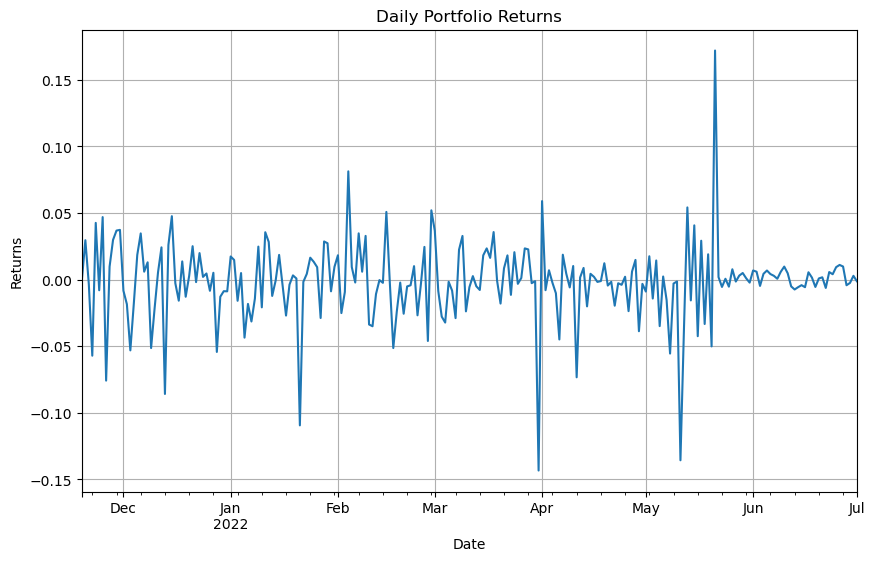

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


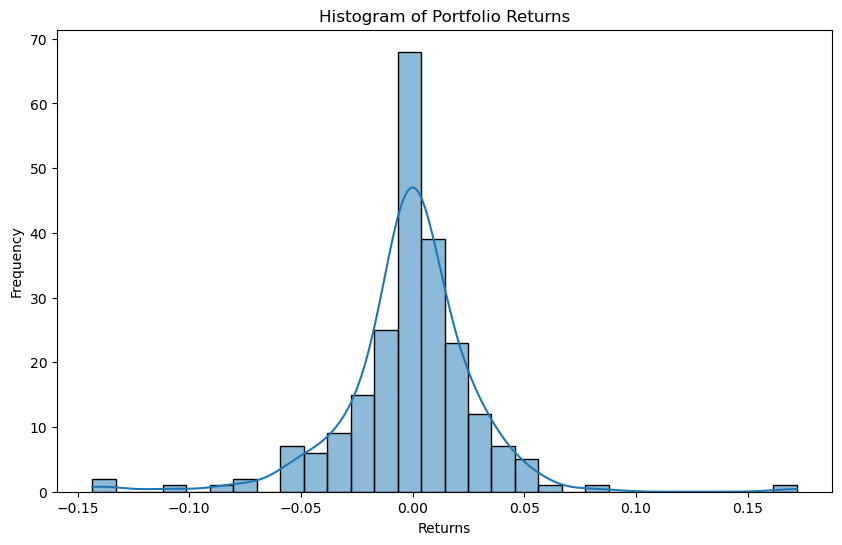

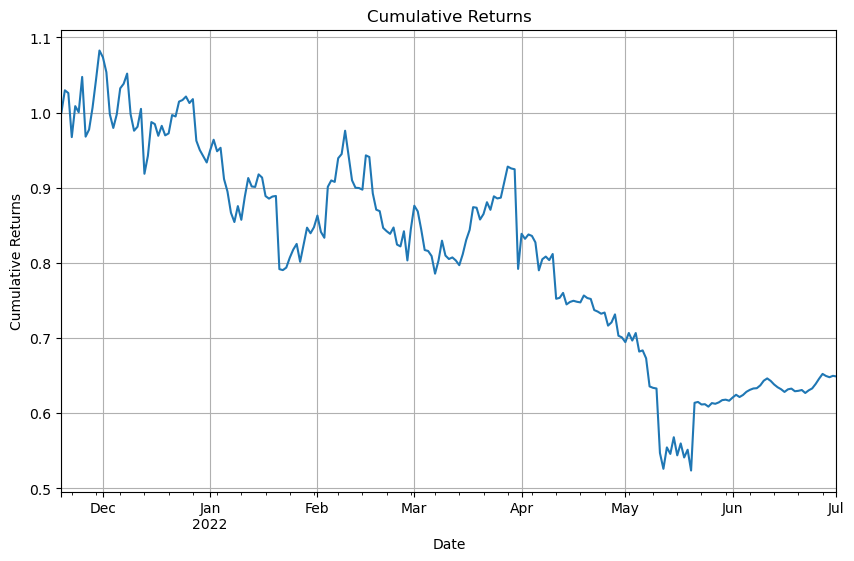

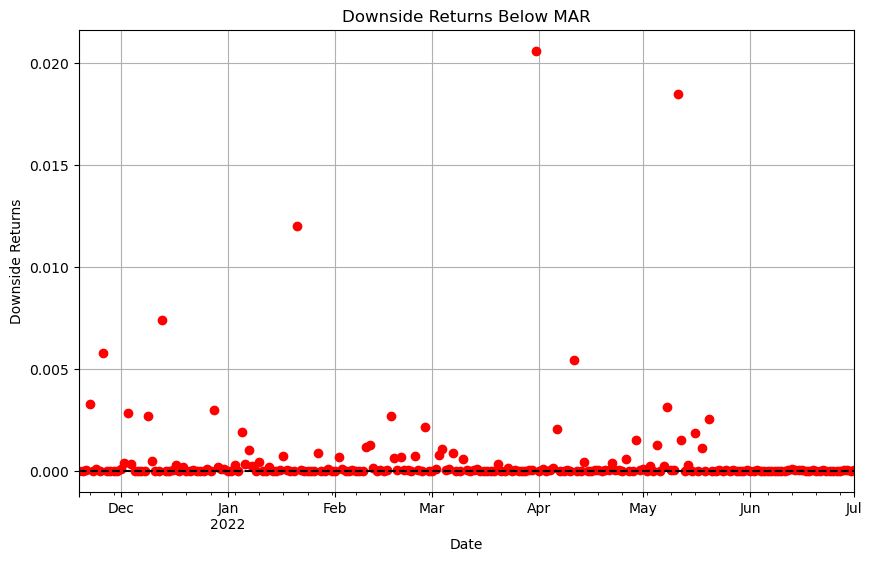

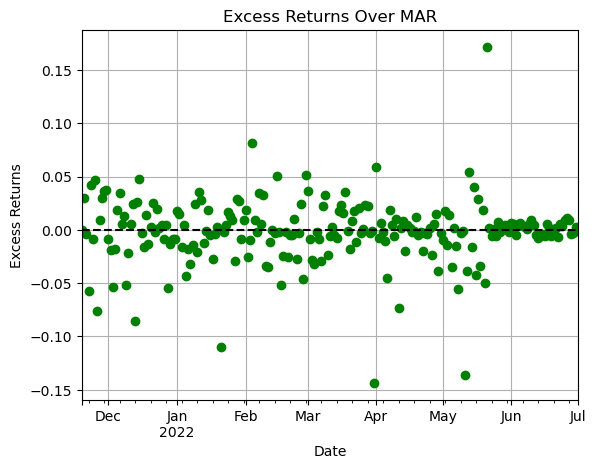

In [886]:
optimized_returns = visualize_mvo_results(sim_portfolio_daily_returns, sim_downside_returns, sim_excess_returns)

sim cumulative return 0.6488775327209052


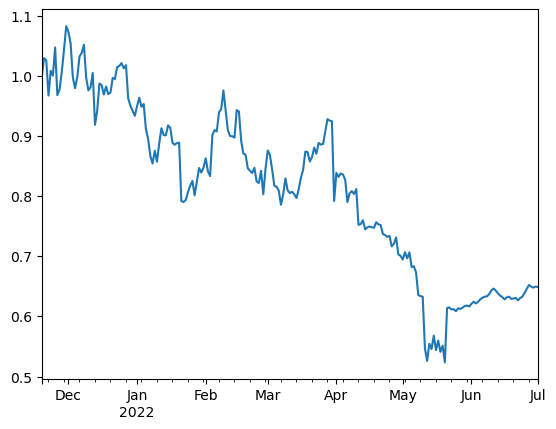

In [887]:
optimized_returns.plot()
print('sim cumulative return', optimized_returns.iloc[-1])

### Historical MVO Scores

In [888]:
historical_optimized_weights, historical_portfolio_returns, historical_portfolio_composition, historical_total_portfolio_value = mvo(historical_sim)
print('average daily return per vault:', historical_portfolio_returns.mean())
print('current composition:', historical_portfolio_composition.iloc[-1])
print(f'current portfolio value: ${historical_total_portfolio_value.iloc[-1]:,.2f}')

Individual Sortino Ratios: BTC Vault_collateral_usd          -1.95794
ETH Vault_collateral_usd          -4.45386
stETH Vault_collateral_usd         3.90225
Stablecoin Vault_collateral_usd   -0.88969
Altcoin Vault_collateral_usd      -3.17905
LP Vault_collateral_usd            1.31992
RWA Vault_collateral_usd          -0.06783
PSM Vault_collateral_usd           0.96307
dtype: float64
Optimized weights: [0.1  0.05 0.5  0.1  0.01 0.22 0.01 0.01]
average daily return per vault: BTC Vault_collateral_usd          -0.00373
ETH Vault_collateral_usd          -0.00864
stETH Vault_collateral_usd         0.00782
Stablecoin Vault_collateral_usd   -0.00162
Altcoin Vault_collateral_usd      -0.00613
LP Vault_collateral_usd            0.00273
RWA Vault_collateral_usd          -0.00000
PSM Vault_collateral_usd           0.00203
dtype: float64
current composition: BTC Vault_collateral_usd          0.16170
ETH Vault_collateral_usd          0.21508
stETH Vault_collateral_usd        0.03016
Stablecoin Vaul

In [889]:
historical_portfolio_daily_returns,  historical_downside_returns, historical_excess_returns, historical_sortino_ratio = historical_sortino(historical_portfolio_returns,historical_portfolio_composition)

Daily downside deviation: 0.025226921213977786
Annualized downside deviation: 0.4819596530693503
Annualized excess return: -0.7371302553896542
Portfolio Sortino Ratio: -1.5294439082094424


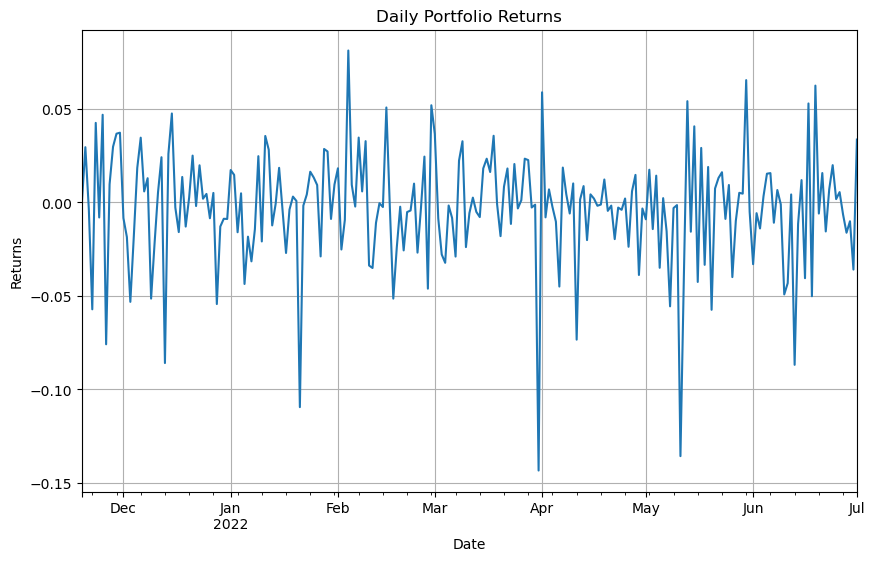

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


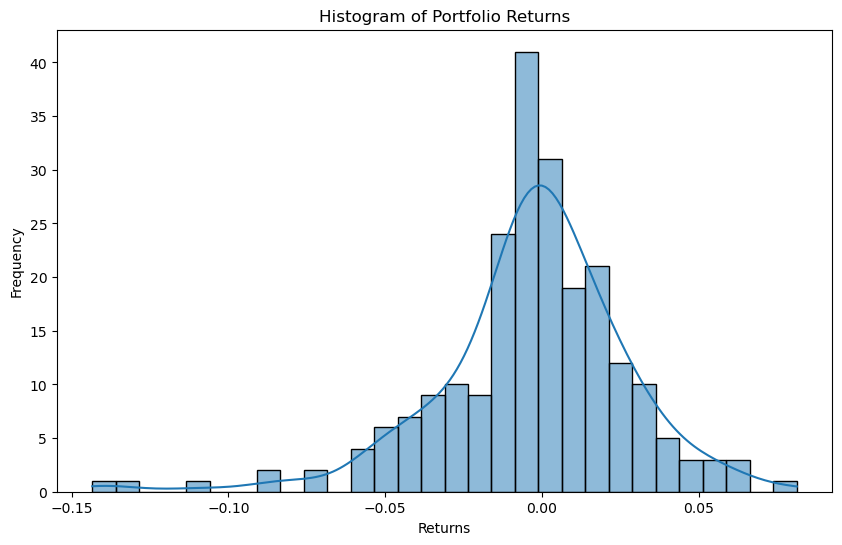

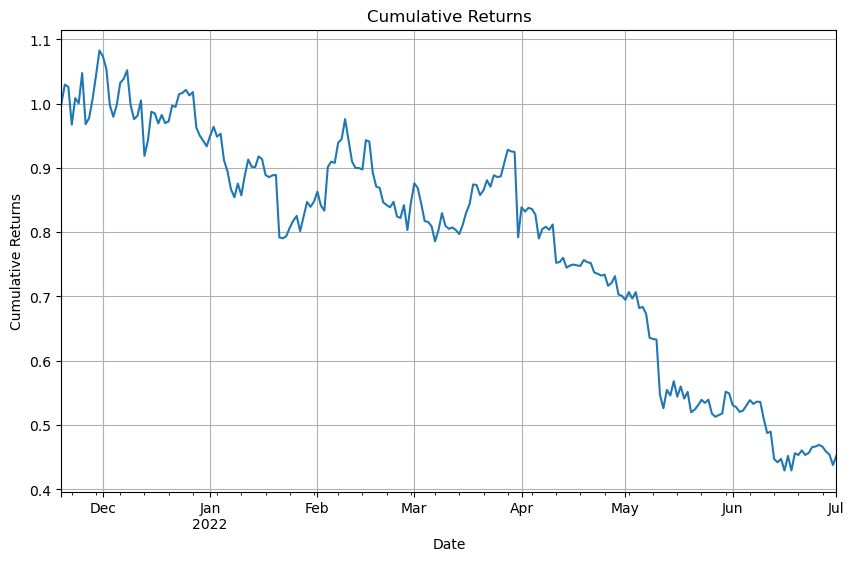

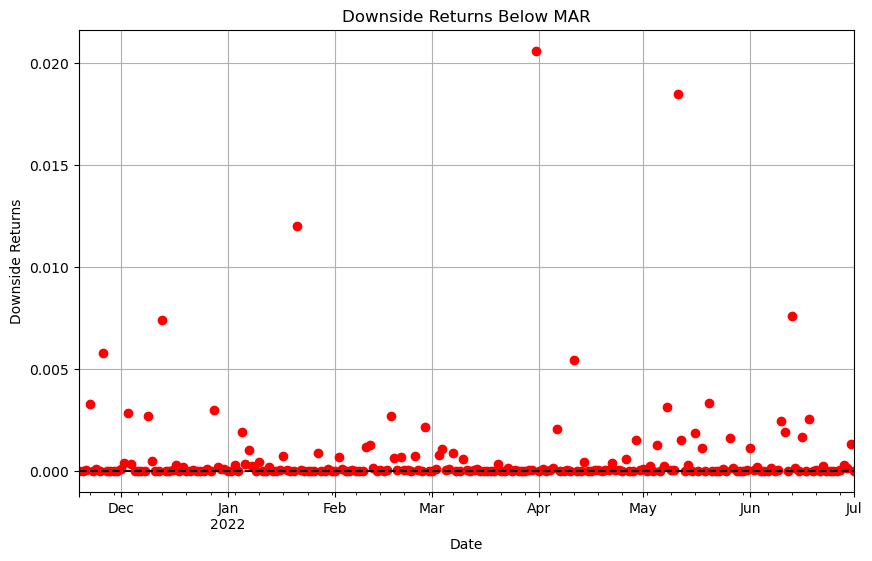

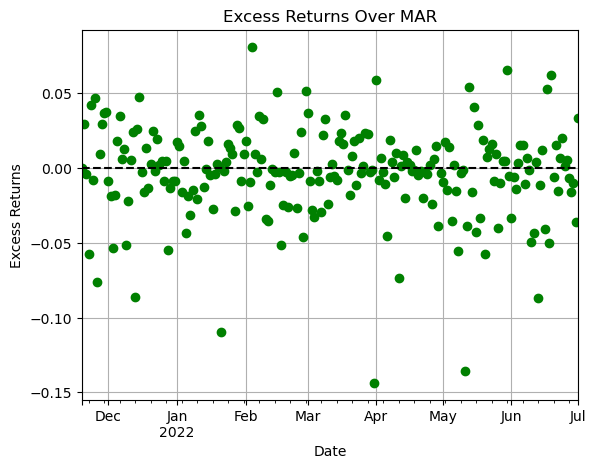

In [890]:
historical_returns = visualize_mvo_results(historical_portfolio_daily_returns, historical_downside_returns, historical_excess_returns)

historical cumulative return 0.4522953137071426


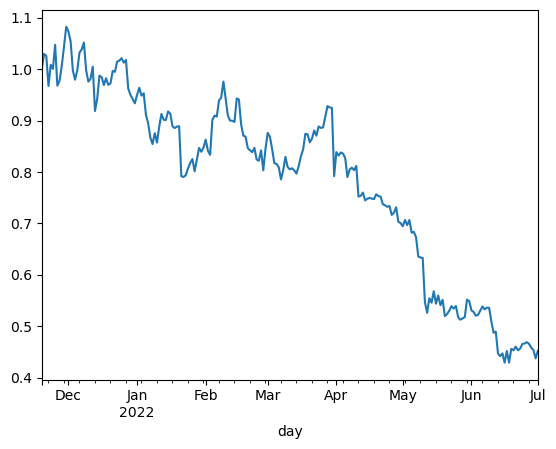

In [891]:
historical_returns.plot()
print('historical cumulative return', historical_returns.iloc[-1])

## Agent

### Non Q Table

In [892]:
class MVOAgent:
    def __init__(self, action_space, target_weights, vault_action_ranges, learning_rate=0.01, discount_factor=0.95, exploration_rate=1.0, exploration_decay=0.995, min_exploration_rate=0.01, initial_strategy_period=0, adjustment_scale=10):
        self.q_table = {}
        self.actions = action_space
        self.target_weights = target_weights
        self.vault_action_ranges = vault_action_ranges  # Ensure this is a non-default argument
        self.lr = learning_rate
        self.gamma = discount_factor
        self.epsilon = exploration_rate
        self.epsilon_decay = exploration_decay
        self.epsilon_min = min_exploration_rate
        self.initial_strategy_period = initial_strategy_period
        self.current_cycle = 0
        self.adjustment_scale = adjustment_scale
        self.dai_ceilings = None
        

    def get_state_representation(self, state):
        return tuple(state.values())

    def calculate_adjustment(self, current, target, vault):
        print('vault', vault)
        # Simplify the vault name to match the keys in the action ranges dictionary
        simplified_vault_name = vault.replace('_collateral_usd', '_dai_ceiling')  # Adjusts 'ETH Vault_collateral_usd' to 'ETH Vault'
        print('vault', simplified_vault_name)
        print('target weights in calc', target)
    
        # Access current dai ceiling
        #current_dai_ceiling = self.dai_ceilings.get(simplified_vault_name, None)
        #print(f'Current {simplified_vault_name} dai ceiling:', current_dai_ceiling)
    
        difference = target - current
        desired_adjustment = difference * self.adjustment_scale
        print('weight difference', difference)
        print('Desired adjustment', desired_adjustment)
        print('adjustment scale', self.adjustment_scale)
    
        # Fetch the correct adjustment options based on the simplified vault name
        legal_adjustments = self.vault_action_ranges.get(simplified_vault_name, [])
        print('legal adjustments', legal_adjustments)
    
        if legal_adjustments:
            # If the adjustment is a decrease and the current dai ceiling is zero, prevent the adjustment
            closest_adjustment = min(legal_adjustments, key=lambda x: abs(x - desired_adjustment))
            print('closest adjustment', closest_adjustment)
            return closest_adjustment
        else:
            print(f"No action range defined for {simplified_vault_name}")
            return 0  # Return zero adjustment if no action range is defined



    def initial_strategy(self, state):
        print("Calculating initial strategy...")
        action_dict = {}
        print('items in state', state.items())
        for vault, current_weight in state.items():
            print('vault', vault)
            simplified_vault_name = vault.replace( '_collateral_usd','_dai_ceiling')
            print('simplified vault name initial strategy', simplified_vault_name)
            target_weight = self.target_weights.get(vault, 0)
            adjustment = self.calculate_adjustment(current_weight, target_weight, vault)
            if adjustment != 0:  # Only add adjustments if they are non-zero
                action_dict[simplified_vault_name] = adjustment
            print(f"Vault: {vault},'simplified vault initial strategy {simplified_vault_name}, Current: {current_weight}, Target: {target_weight}, Adjustment: {adjustment}")
        self.initial_actions = action_dict  # Save the computed actions
        print("Initial Actions: ", action_dict)
        return action_dict
    


    def calculate_dynamic_strategy(self, current_weights):
        action_dict = {}
        print("Calculating dynamic strategy based on optimized weights...")
        for vault, current_weight in current_weights.items():
            target_weight = self.target_weights.get(vault, 0)
            adjustment = self.calculate_adjustment(current_weight, target_weight, vault)
            
            # Change the action key from collateral to ceiling for dynamic adjustments
            adjusted_vault_name = vault.replace('_collateral_usd', '_dai_ceiling')
            
            if adjustment != 0:
                action_dict[adjusted_vault_name] = adjustment
            
            print(f"Vault: {vault}, Current: {current_weight}, Target: {target_weight}, Adjustment: {adjustment}")
            
        return action_dict




    def agent_policy(self, state, dai_ceilings):
        self.current_cycle += 1
        self.dai_ceilings = dai_ceilings
        state_key = self.get_state_representation(state)
        print(f"Cycle Number: {self.current_cycle}, Epsilon: {self.epsilon}")

        # Determine action based on the phase of the strategy
        if self.current_cycle <= self.initial_strategy_period:
            action = self.initial_strategy(state)
            reason = 'initial strategy'
        else:
            # Dynamic adjustment based on MVO optimized weights
            action = self.calculate_dynamic_strategy(state)
            reason = 'dynamic strategy adjustment'
        print('agent policy state', state)
        print(f"Chosen Action: {action}, Reason: {reason}")
        return action


    def update_q_table(self, old_state, action_index, reward, new_state):
        old_state_key = self.get_state_representation(old_state)
        new_state_key = self.get_state_representation(new_state)
        if new_state_key not in self.q_table:
            self.q_table[new_state_key] = np.zeros(len(self.actions))
        
        old_value = self.q_table[old_state_key][action_index]
        next_max = np.max(self.q_table[new_state_key])
        new_value = (1 - self.lr) * old_value + self.lr * (reward + self.gamma * next_max)
        self.q_table[old_state_key][action_index] = new_value
        print('q table updated', self.q_table)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay
        print('Epsilon after decay:', self.epsilon)


### Q Table

In [893]:
class RlAgent:
    def __init__(self, action_space, target_weights, vault_action_ranges, learning_rate=0.01, discount_factor=0.95,
                 exploration_rate=0.9, exploration_decay=0.95, min_exploration_rate=0.01, initial_strategy_period=0,
                 adjustment_scale=10):
        self.q_table = {}
        self.actions = action_space
        self.target_weights = target_weights
        self.vault_action_ranges = vault_action_ranges
        self.lr = learning_rate
        self.gamma = discount_factor
        self.epsilon = exploration_rate
        self.epsilon_decay = exploration_decay
        self.epsilon_min = min_exploration_rate
        self.initial_strategy_period = initial_strategy_period
        self.current_cycle = 0
        self.adjustment_scale = adjustment_scale
        self.dai_ceilings = None


    def random_action(self, state):
        """
        Generate a random action for exploration.
        """
        # Assuming each action is defined by a ceiling adjustment for each vault
        action = {}
        for vault, range_options in self.vault_action_ranges.items():
            # Randomly select an adjustment from the available range options for each vault
            action[vault] = random.choice(range_options)
        return action
        

    def get_state_representation(self, state):
        return tuple(state.values())

    def calculate_adjustment(self, current, target, vault):
        print('vault', vault)
        # Simplify the vault name to match the keys in the action ranges dictionary
        simplified_vault_name = vault.replace('_collateral_usd', '_dai_ceiling')  # Adjusts 'ETH Vault_collateral_usd' to 'ETH Vault'
        print('vault', simplified_vault_name)
        print('target weights in calc', target)
    
        # Access current dai ceiling
        #current_dai_ceiling = self.dai_ceilings.get(simplified_vault_name, None)
        #print(f'Current {simplified_vault_name} dai ceiling:', current_dai_ceiling)
    
        difference = target - current
        desired_adjustment = difference * self.adjustment_scale
        print('weight difference', difference)
        print('Desired adjustment', desired_adjustment)
        print('adjustment scale', self.adjustment_scale)
    
        # Fetch the correct adjustment options based on the simplified vault name
        legal_adjustments = self.vault_action_ranges.get(simplified_vault_name, [])
        print('legal adjustments', legal_adjustments)
    
        if legal_adjustments:
            # If the adjustment is a decrease and the current dai ceiling is zero, prevent the adjustment
            closest_adjustment = min(legal_adjustments, key=lambda x: abs(x - desired_adjustment))
            print('closest adjustment', closest_adjustment)
            return closest_adjustment
        else:
            print(f"No action range defined for {simplified_vault_name}")
            return 0  # Return zero adjustment if no action range is defined



    def initial_strategy(self, state):
        print("Calculating initial strategy...")
        action_dict = {}
        print('items in state', state.items())
        for vault, current_weight in state.items():
            print('vault', vault)
            simplified_vault_name = vault.replace( '_collateral_usd','_dai_ceiling')
            print('simplified vault name initial strategy', simplified_vault_name)
            target_weight = self.target_weights.get(vault, 0)
            adjustment = self.calculate_adjustment(current_weight, target_weight, vault)
            if adjustment != 0:  # Only add adjustments if they are non-zero
                action_dict[simplified_vault_name] = adjustment
            print(f"Vault: {vault},'simplified vault initial strategy {simplified_vault_name}, Current: {current_weight}, Target: {target_weight}, Adjustment: {adjustment}")
        self.initial_actions = action_dict  # Save the computed actions
        print("Initial Actions: ", action_dict)
        return action_dict
    


    def calculate_dynamic_strategy(self, current_weights):
        action_dict = {}
        print("Calculating dynamic strategy based on optimized weights...")
        for vault, current_weight in current_weights.items():
            target_weight = self.target_weights.get(vault, 0)
            adjustment = self.calculate_adjustment(current_weight, target_weight, vault)
            
            # Change the action key from collateral to ceiling for dynamic adjustments
            adjusted_vault_name = vault.replace('_collateral_usd', '_dai_ceiling')
            
            if adjustment != 0:
                action_dict[adjusted_vault_name] = adjustment
            
            print(f"Vault: {vault}, Current: {current_weight}, Target: {target_weight}, Adjustment: {adjustment}")
            
        return action_dict




    def agent_policy(self, state, dai_ceilings):
        self.current_cycle += 1
        self.dai_ceilings = dai_ceilings
        state_key = self.get_state_representation(state)
        print(f"Cycle Number: {self.current_cycle}, Epsilon: {self.epsilon}")
    
        if self.current_cycle <= self.initial_strategy_period:
            action = self.random_action(state)
            reason = 'exploration (random selection for initial strategy period)'
        elif np.random.rand() < self.epsilon:
            action = self.random_action(state)
            reason = 'exploration (random selection for wider state exploration)'
        else:
            action = self.calculate_dynamic_strategy(state)
            reason = 'exploitation (based on learned values aiming for optimal performance)'
    
        # Decrement epsilon with decay more aggressively after initial period
        if self.current_cycle > self.initial_strategy_period:
            self.epsilon *= (self.epsilon_decay ** 2)  # Example of more aggressive decay
        elif self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay
    
        print('State:', state)
        print(f"Chosen Action: {action}, Reason: {reason}")
        return action


    
    def exploit_best_known_action(self, state_key):
        if state_key in self.q_table and not self.q_table[state_key].all() == 0:
            # Choose the best known action from Q-table
            action_index = np.argmax(self.q_table[state_key])
            action = self.actions[action_index]
        else:
            # Fallback to the calculated dynamic strategy if no useful data in Q-table
            action = self.calculate_dynamic_strategy(self.current_state_weights)
        return action



    def update_q_table(self, old_state, action_index, reward, new_state):
        old_state_key = self.get_state_representation(old_state)
        new_state_key = self.get_state_representation(new_state)
        if new_state_key not in self.q_table:
            self.q_table[new_state_key] = np.zeros(len(self.actions))
        
        old_value = self.q_table[old_state_key][action_index]
        next_max = np.max(self.q_table[new_state_key])
        new_value = (1 - self.lr) * old_value + self.lr * (reward + self.gamma * next_max)
        self.q_table[old_state_key][action_index] = new_value
        
        # Apply epsilon decay after each update
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay
        print(f'Epsilon after decay: {self.epsilon}')




### Agent Set Up

In [894]:
portfolio_mvo_weights, portfolio_returns, portfolio_composition, total_portfolio_value = mvo(simulation_data)

Individual Sortino Ratios: BTC Vault_collateral_usd          -0.44860
ETH Vault_collateral_usd          -0.36580
stETH Vault_collateral_usd         1.12511
Stablecoin Vault_collateral_usd   -2.40341
Altcoin Vault_collateral_usd      -1.66282
LP Vault_collateral_usd           -0.45683
RWA Vault_collateral_usd           0.48774
PSM Vault_collateral_usd          -0.48644
dtype: float64
Optimized weights: [0.1      0.191222 0.5      0.1      0.01     0.068778 0.02     0.01    ]


In [895]:

# Assuming you have these vault names as keys in optimized_weight_dict
vault_names = [
    'BTC Vault_collateral_usd', 'ETH Vault_collateral_usd', 'stETH Vault_collateral_usd', 'Stablecoin Vault_collateral_usd', 
    'Altcoin Vault_collateral_usd', 'LP Vault_collateral_usd', 'RWA Vault_collateral_usd', 'PSM Vault_collateral_usd'
]

# Map from the detailed keys to simplified keys used in optimized_weight_dict
key_mapping = {
    'BTC Vault_collateral_usd',
    'ETH Vault_collateral_usd',
    'stETH Vault_collateral_usd',
    'Stablecoin Vault_collateral_usd'
    'Altcoin Vault_collateral_usd',
    'LP Vault_collateral_usd',
    'RWA Vault_collateral_usd',
    'PSM Vault_collateral_usd'
}

# Apply this mapping to the initial_weights to align with optimized_weight_dict
initial_weights = dict(portfolio_composition.loc['2022-05-20'].to_dict())

optimized_weight_dict = dict(zip(vault_names, portfolio_mvo_weights))

# Now both dictionaries use the same keys:
print("Initial Weights on 2022-05-20:", initial_weights)
print("Optimized Weights:", optimized_weight_dict)

# Your RlAgent can now be initialized and used with these dictionaries


Initial Weights on 2022-05-20: {'BTC Vault_collateral_usd': 0.1131354019508382, 'ETH Vault_collateral_usd': 0.48043492548500283, 'stETH Vault_collateral_usd': 0.03387400765933107, 'Stablecoin Vault_collateral_usd': 0.025435560745005616, 'Altcoin Vault_collateral_usd': 0.031155567995268595, 'LP Vault_collateral_usd': 0.0276946278356852, 'RWA Vault_collateral_usd': 0.005535616134052087, 'PSM Vault_collateral_usd': 0.2827342921948164}
Optimized Weights: {'BTC Vault_collateral_usd': 0.10000000000001205, 'ETH Vault_collateral_usd': 0.1912220038087577, 'stETH Vault_collateral_usd': 0.49999999999998834, 'Stablecoin Vault_collateral_usd': 0.1, 'Altcoin Vault_collateral_usd': 0.010000000000010488, 'LP Vault_collateral_usd': 0.06877799619124783, 'RWA Vault_collateral_usd': 0.01999999999998404, 'PSM Vault_collateral_usd': 0.01}


In [896]:
def generate_action_space(vault_action_ranges):
    action_space = {}
    for vault, limits in vault_action_ranges.items():
        if isinstance(limits, list):  # If specific steps are provided, use them
            action_space[vault] = limits
        else:  # Generate a range between min and max with the given step
            min_val, max_val, step = limits
            action_space[vault] = list(np.arange(min_val, max_val + step, step))
    return action_space

### Sets Up Action Space: for Some Reason, need to run this first for decent predictions on first try: think related to how some variables are initialized

In [897]:
str(simulation_data.index.max())

'2024-03-20 00:00:00'

test_ceilings = test_data[dai_ceilings]


start_date_dt = pd.to_datetime(start_date)  # Convert string to datetime
historical_cutoff = start_date_dt - pd.DateOffset(days=1)
test_historical_data = test_ceilings[test_ceilings.index <= historical_cutoff]

test_historical_data
last_dai_ceiling = test_historical_data.iloc[-1]
last_dai_ceiling

<Axes: xlabel='day'>

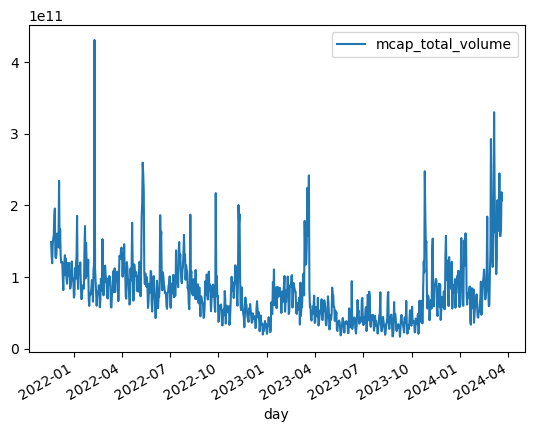

In [898]:
test_data_copy[['mcap_total_volume']].plot()

### Non Q Sim

In [899]:
mvo_data = test_data_copy.copy()
mvo_data.index = mvo_data.index.tz_localize('UTC')

Calculating initial strategy...
items in state dict_items([('BTC Vault_collateral_usd', 0.1131354019508382), ('ETH Vault_collateral_usd', 0.48043492548500283), ('stETH Vault_collateral_usd', 0.03387400765933107), ('Stablecoin Vault_collateral_usd', 0.025435560745005616), ('Altcoin Vault_collateral_usd', 0.031155567995268595), ('LP Vault_collateral_usd', 0.0276946278356852), ('RWA Vault_collateral_usd', 0.005535616134052087), ('PSM Vault_collateral_usd', 0.2827342921948164)])
vault BTC Vault_collateral_usd
simplified vault name initial strategy BTC Vault_dai_ceiling
vault BTC Vault_collateral_usd
vault BTC Vault_dai_ceiling
target weights in calc 0.10000000000001205
weight difference -0.013135401950826145
Desired adjustment -0.13135401950826145
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25]
closest adjustment -0.25
Vault: BTC Vault_collateral_usd,'simplified vault initial strategy BTC Vault_dai_ceiling, Current: 0.1131354019508382, Target: 0.10000000000001205, Adjustme

C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

current state ETH Vault_collateral_usd                 3,270,557,783.32717
stETH Vault_collateral_usd                 681,219,278.94620
BTC Vault_collateral_usd                 1,544,036,880.54325
Altcoin Vault_collateral_usd               494,098,236.32510
Stablecoin Vault_collateral_usd            468,565,409.37192
                                                 ...        
Stablecoin Vault_collateral_usd_30d_ma     240,742,358.26086
LP Vault_collateral_usd_30d_ma             181,661,269.17804
PSM Vault_collateral_usd_30d_ma          3,373,570,950.75050
RWA Vault_collateral_usd_30d_ma             50,870,409.00000
RWA Vault_prev_dai_ceiling                  59,000,000.00000
Name: 2022-05-21 00:00:00, Length: 85, dtype: float64
vault ETH Vault_dai_ceiling
Applying action to: ETH Vault_dai_ceiling
Simulator Adjusted ETH Vault_dai_ceiling by -1.5% from 1778288396.9201953 to 1751614070.9663923
vault stETH Vault_dai_ceiling
Applying action to: stETH Vault_dai_ceiling
Simulator Adjusted st

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


Optimized weights: [0.1       0.05      0.5       0.1       0.01      0.0914109 0.02
 0.1285891]
Agent weights updated: {'BTC Vault_collateral_usd': 0.1, 'ETH Vault_collateral_usd': 0.05, 'stETH Vault_collateral_usd': 0.5, 'Stablecoin Vault_collateral_usd': 0.1, 'Altcoin Vault_collateral_usd': 0.01, 'LP Vault_collateral_usd': 0.0914108960820578, 'RWA Vault_collateral_usd': 0.02, 'PSM Vault_collateral_usd': 0.1285891039178924}
Daily downside deviation: 0.024198293468520038
Annualized downside deviation: 0.4623077475857896
Annualized excess return: -0.5884203339372465
Portfolio Sortino Ratio: -1.27278925566363
Daily downside deviation: 0.02498578261770896
Annualized downside deviation: 0.47735270665628743
Annualized excess return: 6.536107119906381
Sortino Ratio: 13.692406115574062
Current Financials:


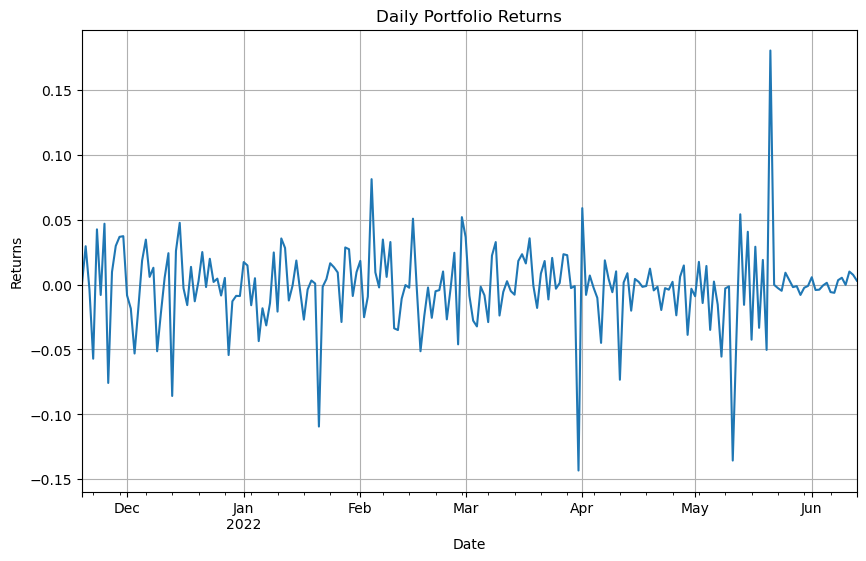

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


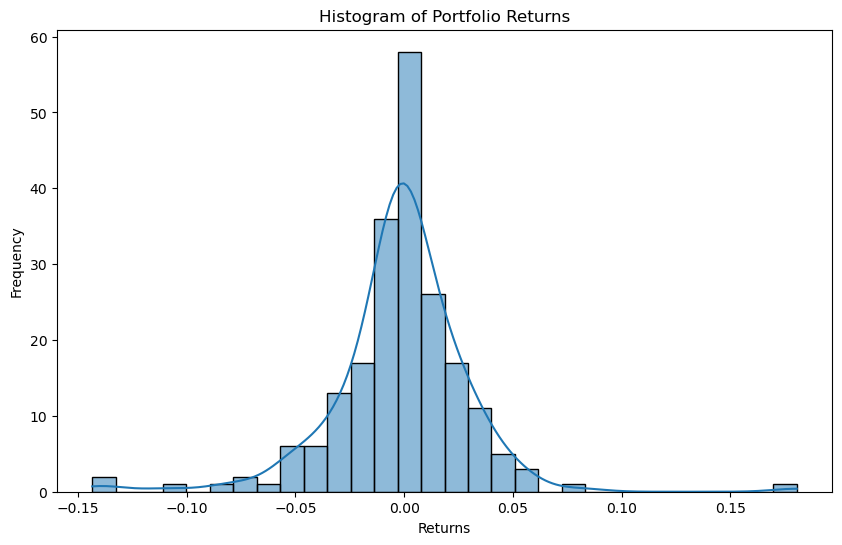

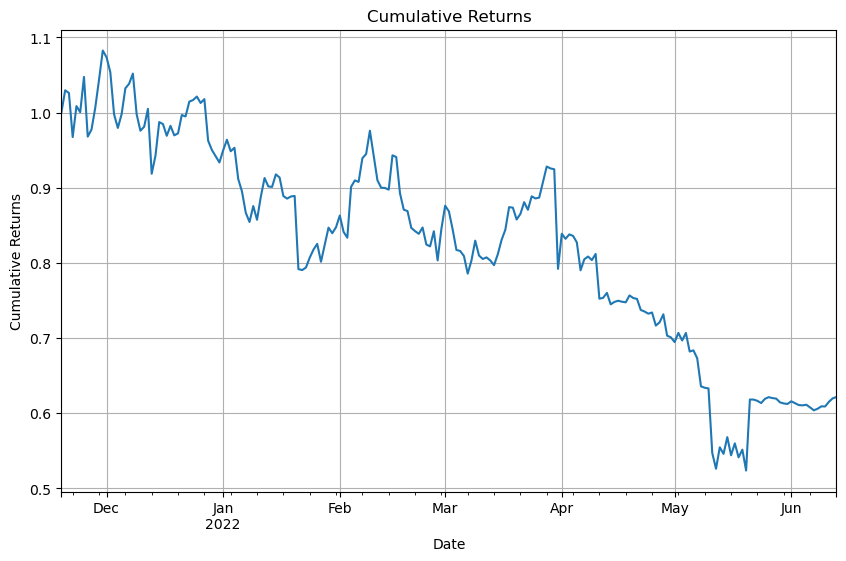

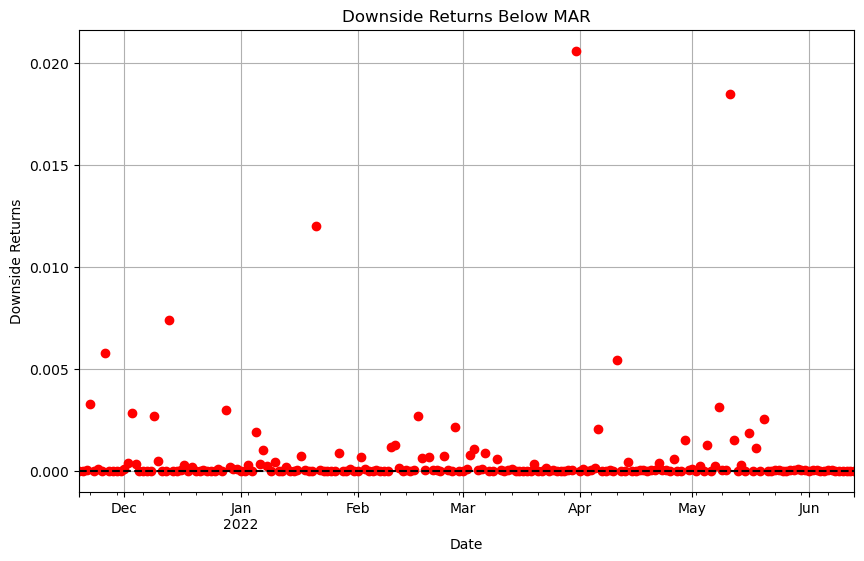

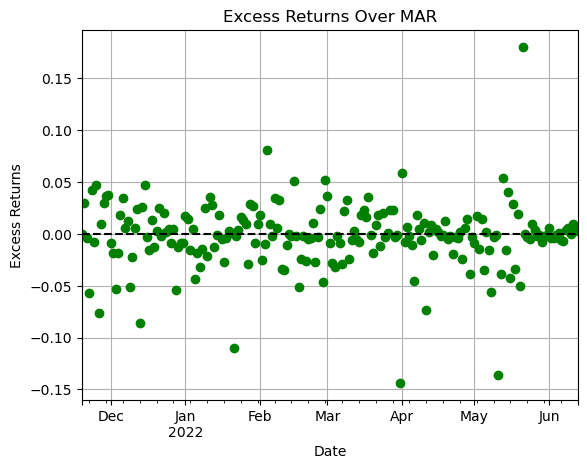

Sortino ratio: -1.27278925566363
Scaled Sortino diff: 0.00014965195371237692
reward -0.13670195702124419
Reward at the end of the cycle on 2022-06-13 00:00:00: -1.4096408646385865
Completed cycle up to 2022-06-13 00:00:00
Running simulation from 2022-06-14 00:00:00 to 2022-07-08 00:00:00
Cycle Number: 2, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.2587637224875315
Desired adjustment -2.587637224875315
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.3087637224875315, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.4162105157989071
Desired adjustment 4.162105157989071
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vault: 

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


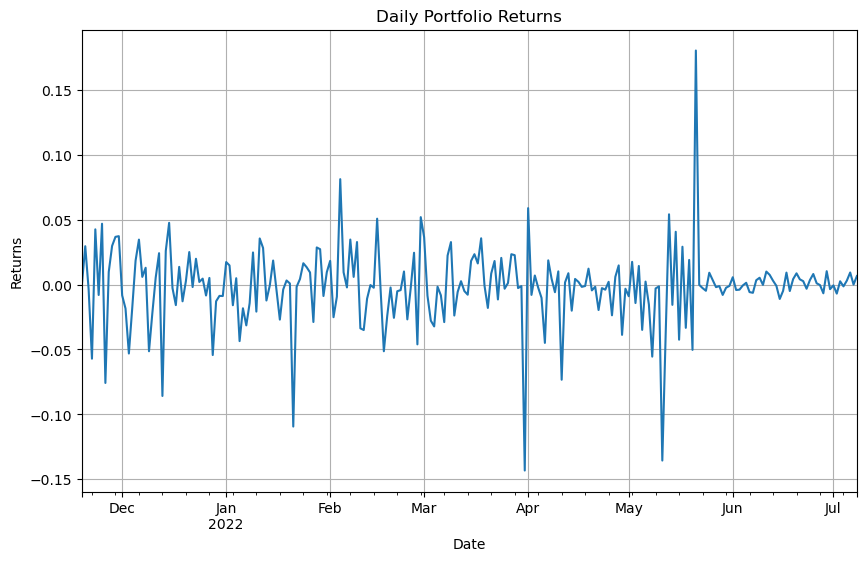

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


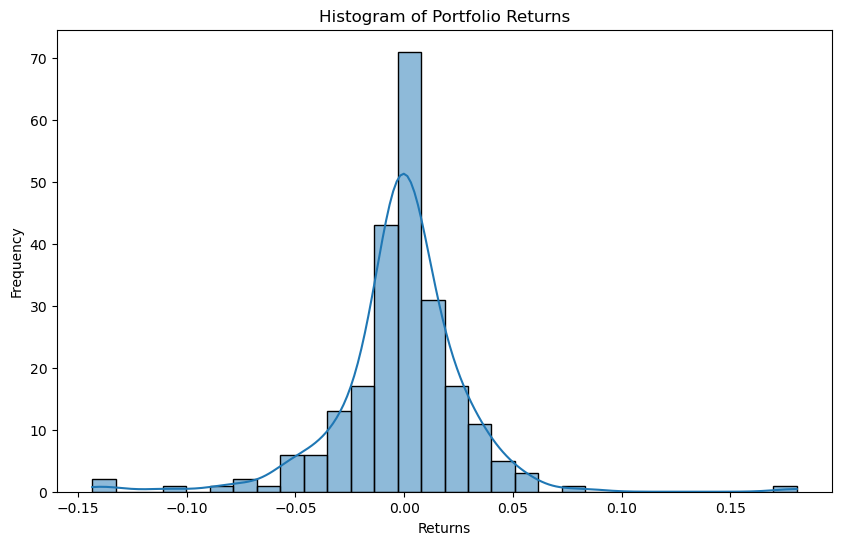

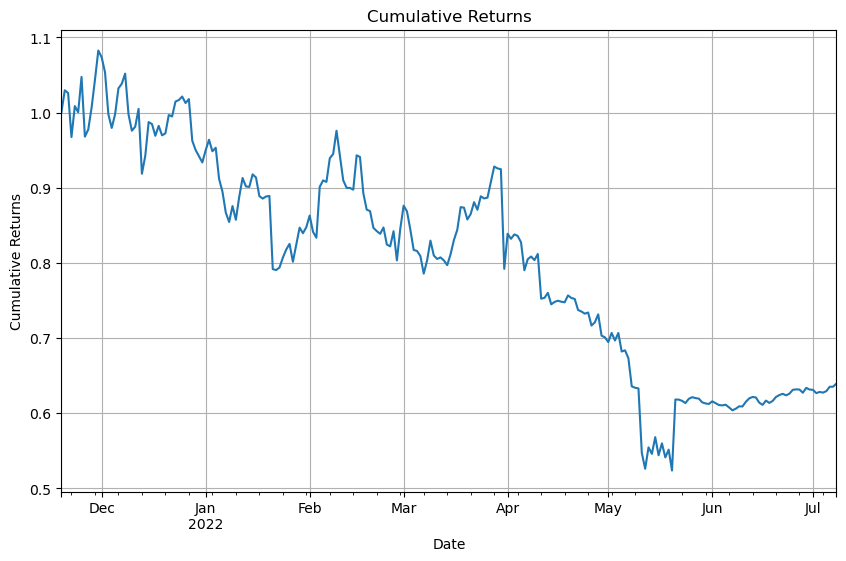

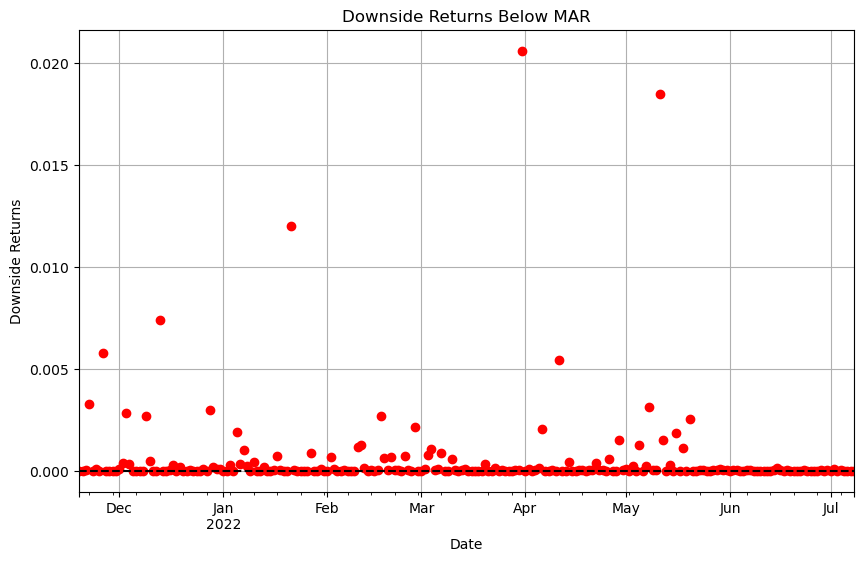

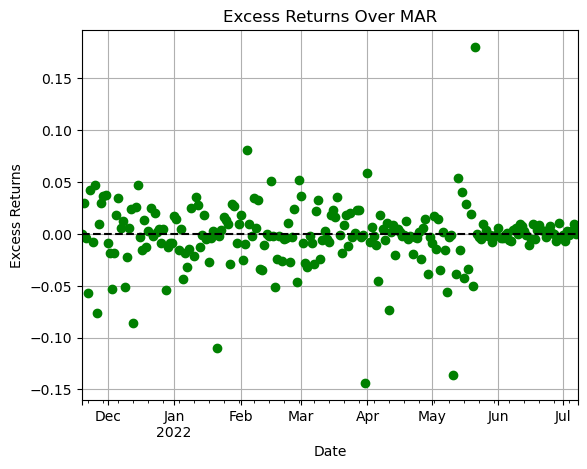

Sortino ratio: -1.2097291452341508
Scaled Sortino diff: 0.00013533370905821352
reward -0.13469831966650167
Reward at the end of the cycle on 2022-07-08 00:00:00: -1.3445627986097106
Completed cycle up to 2022-07-08 00:00:00
Running simulation from 2022-07-09 00:00:00 to 2022-08-02 00:00:00
Cycle Number: 3, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000068316
weight difference -0.2315618473988183
Desired adjustment -2.315618473988183
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2815618473988866, Target: 0.050000000000068316, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999352
weight difference 0.4038192985908962
Desired adjustment 4.038192985908962
adjustment scale 10
legal adjustments [-1, -0.5, -0

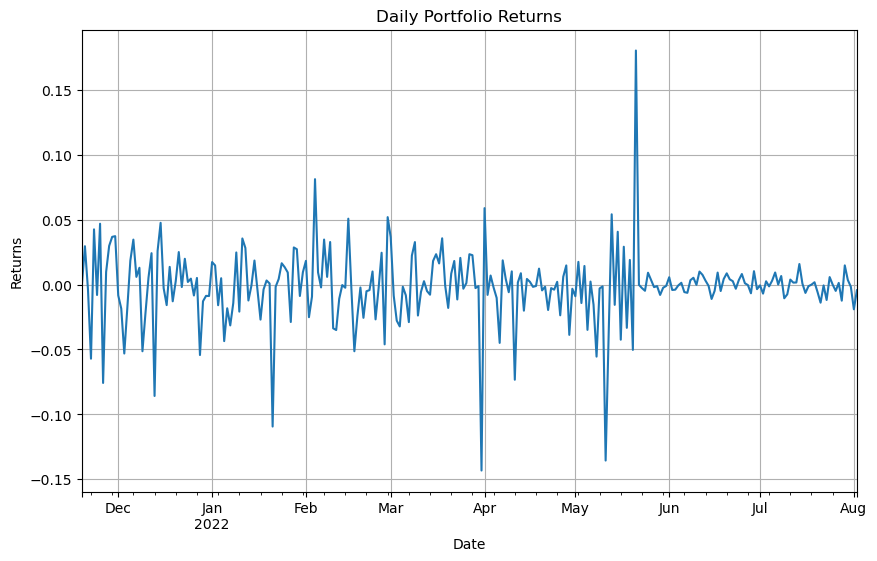

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


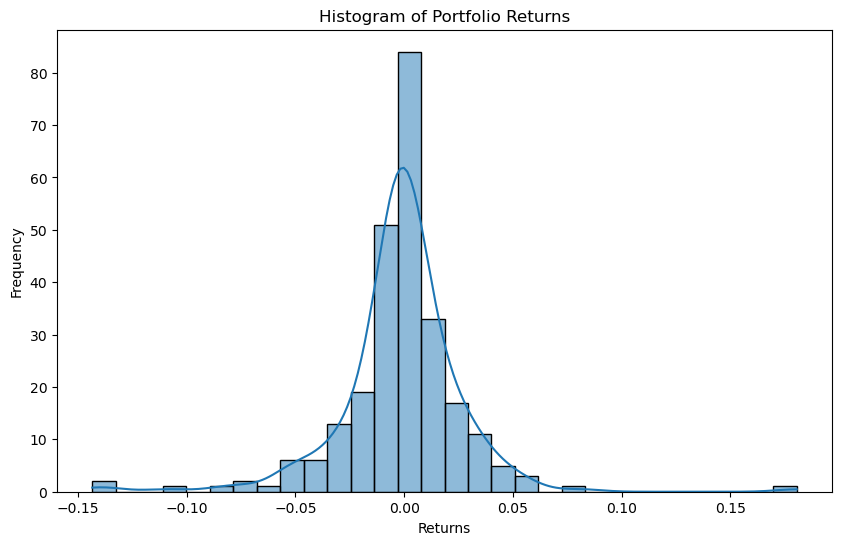

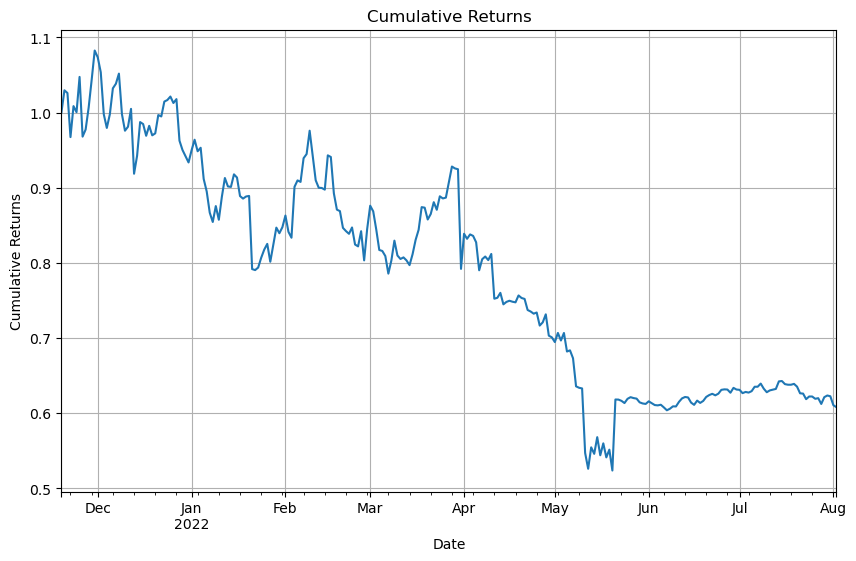

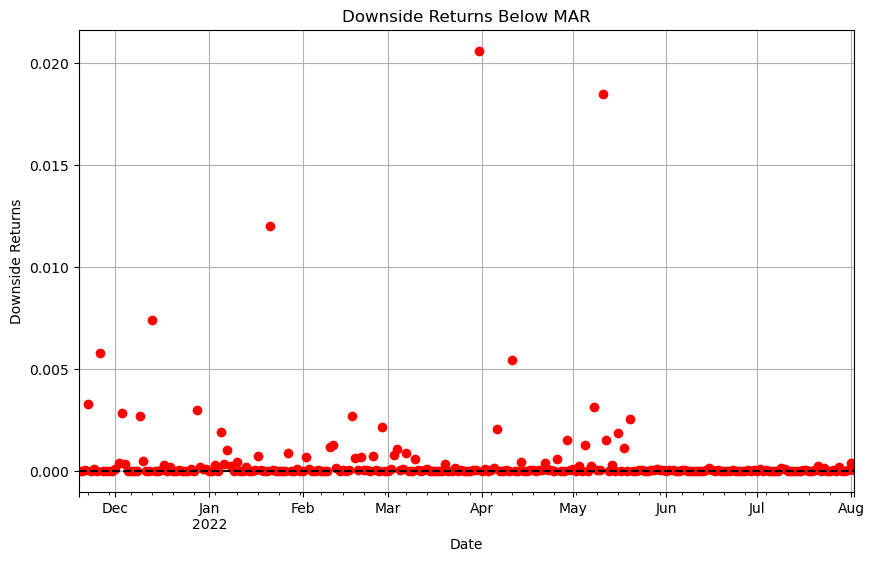

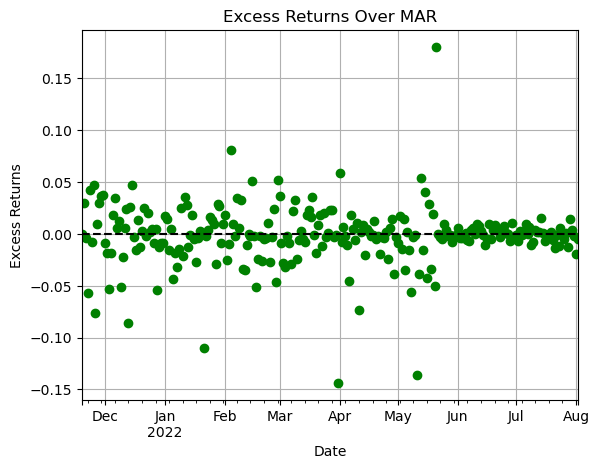

Sortino ratio: -1.270681547153479
Scaled Sortino diff: 0.00011133846169174683
reward -0.13186178448786434
Reward at the end of the cycle on 2022-08-02 00:00:00: -1.402654670103035
Completed cycle up to 2022-08-02 00:00:00
Running simulation from 2022-08-03 00:00:00 to 2022-08-27 00:00:00
Cycle Number: 4, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.21106654328067215
Desired adjustment -2.1106654328067216
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.26106654328067214, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.3930056688579169
Desired adjustment 3.930056688579169
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vaul

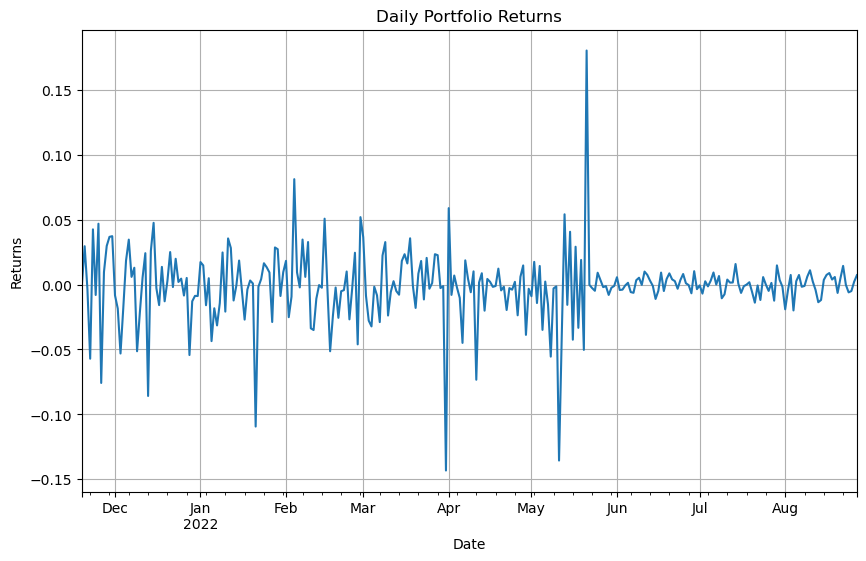

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


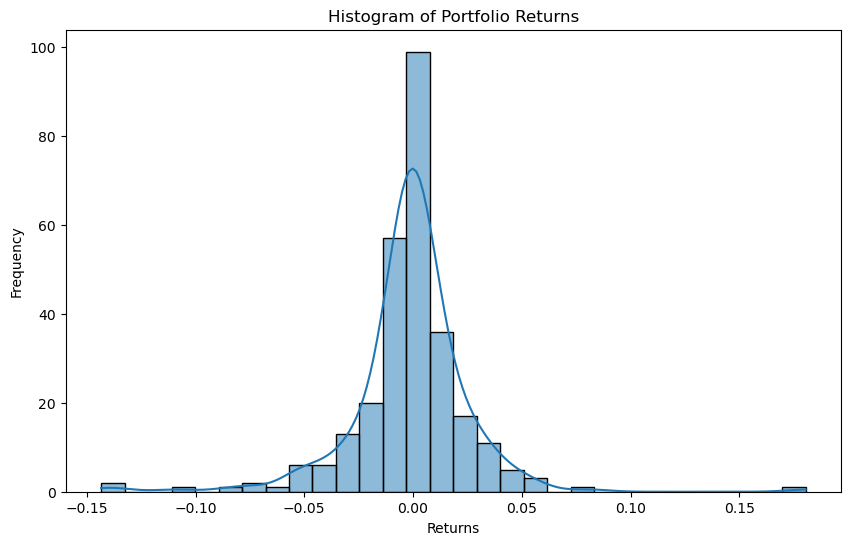

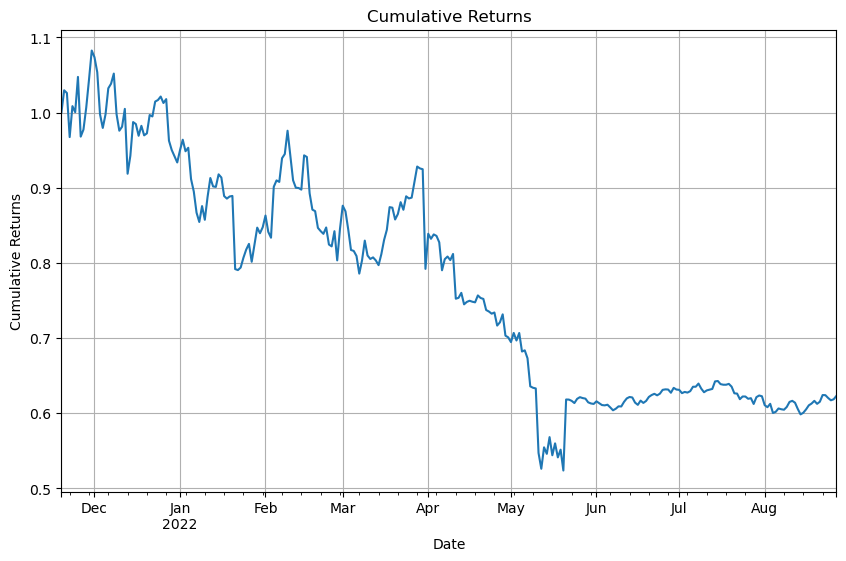

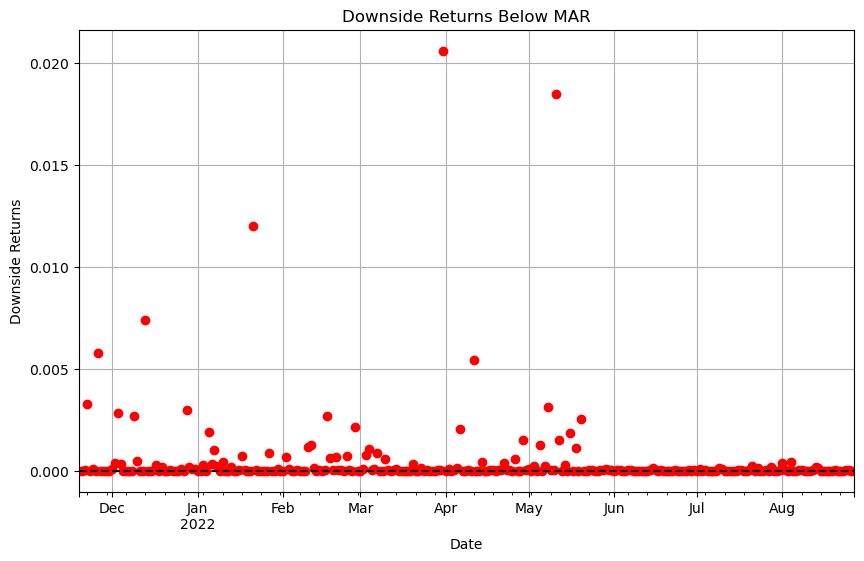

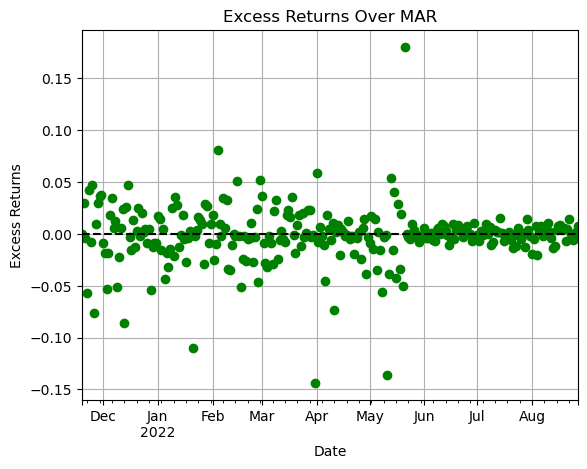

Sortino ratio: -1.2102858196955246
Scaled Sortino diff: 0.00010364335929643003
reward -0.12949377216896768
Reward at the end of the cycle on 2022-08-27 00:00:00: -1.3398832352237888
Completed cycle up to 2022-08-27 00:00:00
Running simulation from 2022-08-28 00:00:00 to 2022-09-21 00:00:00
Cycle Number: 5, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000001873
weight difference -0.19922367569736732
Desired adjustment -1.9922367569736732
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.24922367569738604, Target: 0.05000000000001873, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999998657
weight difference 0.38152556186214714
Desired adjustment 3.8152556186214714
adjustment scale 10
legal adjustments [-1, -0.5

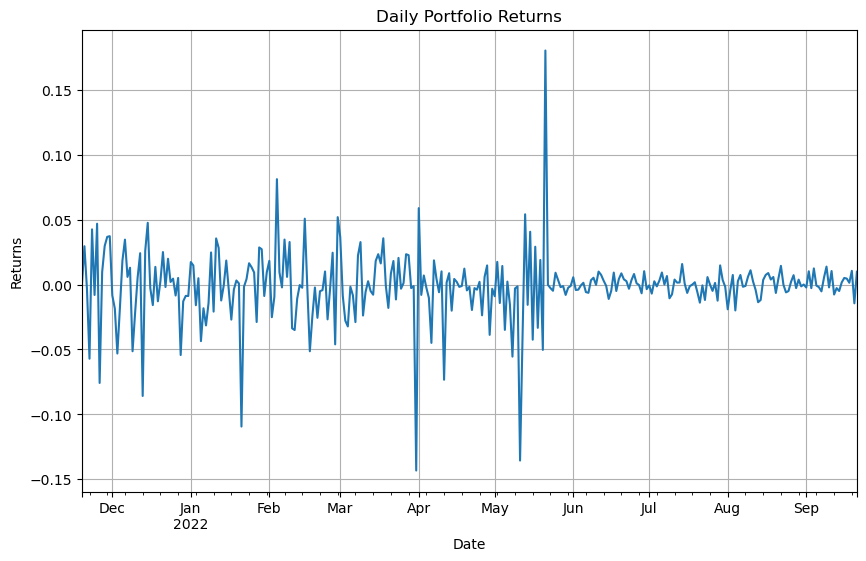

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


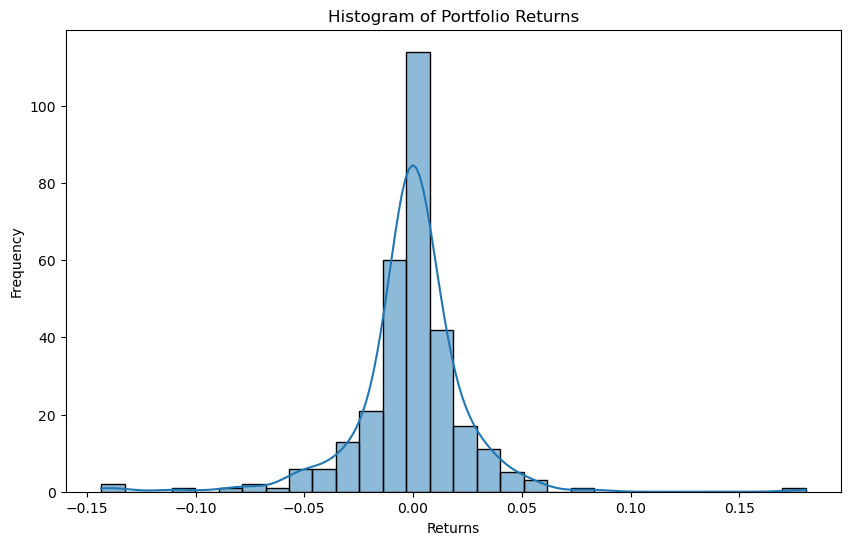

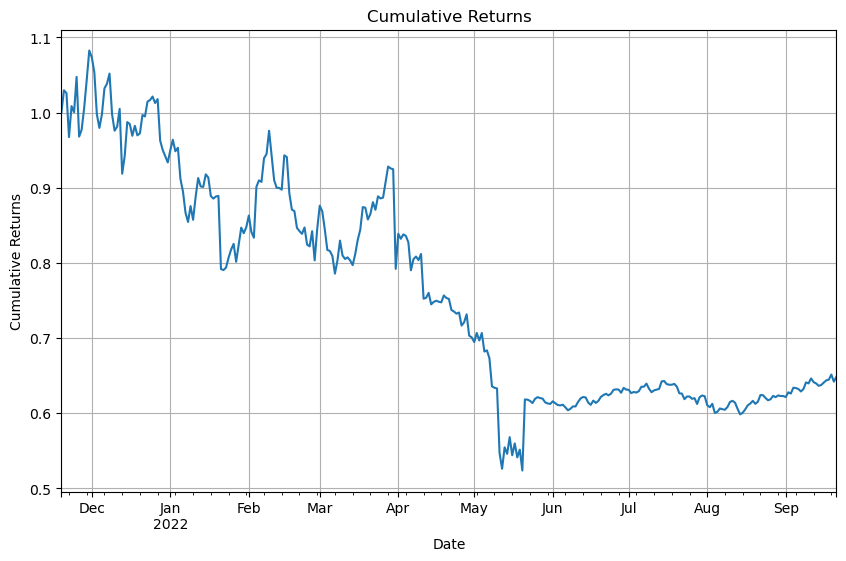

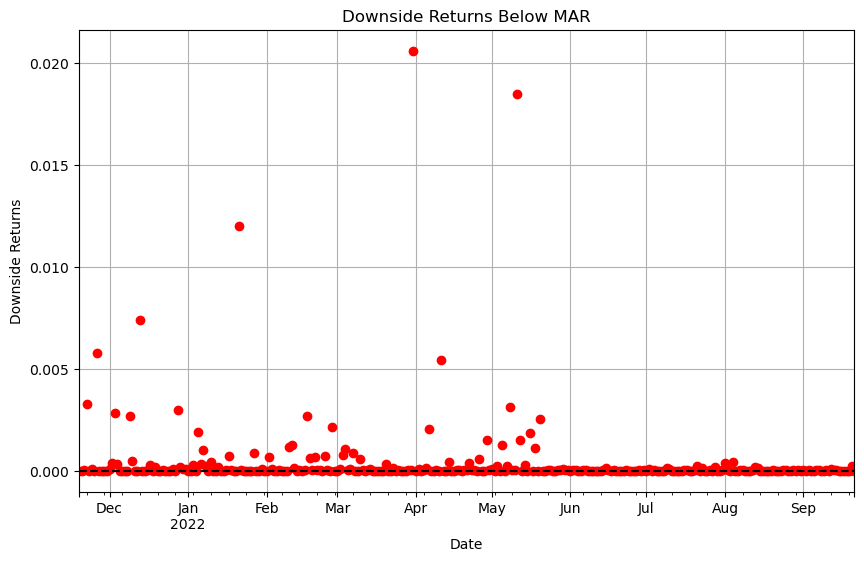

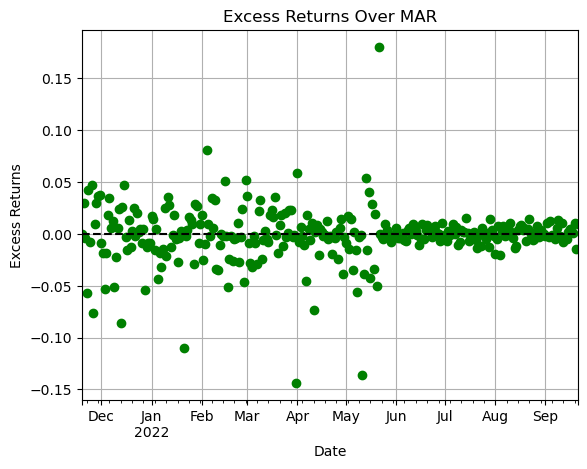

Sortino ratio: -1.123365477547398
Scaled Sortino diff: 9.844520514319237e-05
reward -0.1273940641412022
Reward at the end of the cycle on 2022-09-21 00:00:00: -1.2508579868937435
Completed cycle up to 2022-09-21 00:00:00
Running simulation from 2022-09-22 00:00:00 to 2022-10-16 00:00:00
Cycle Number: 6, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.19198004888403464
Desired adjustment -1.9198004888403464
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.24198004888403465, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.37017666029156493
Desired adjustment 3.701766602915649
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vaul

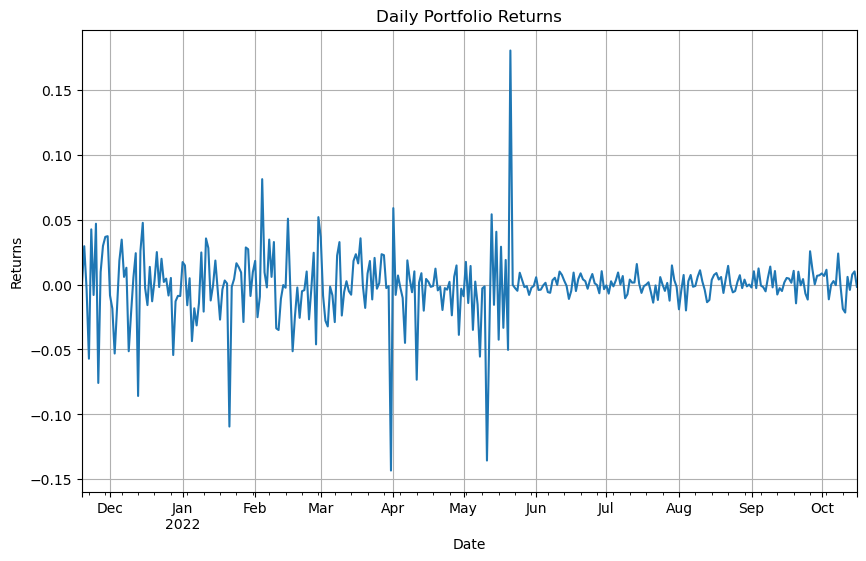

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


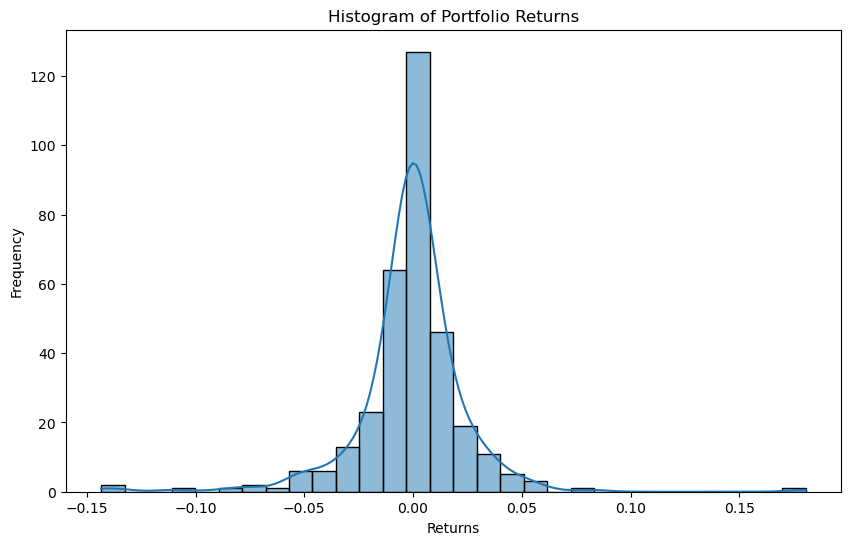

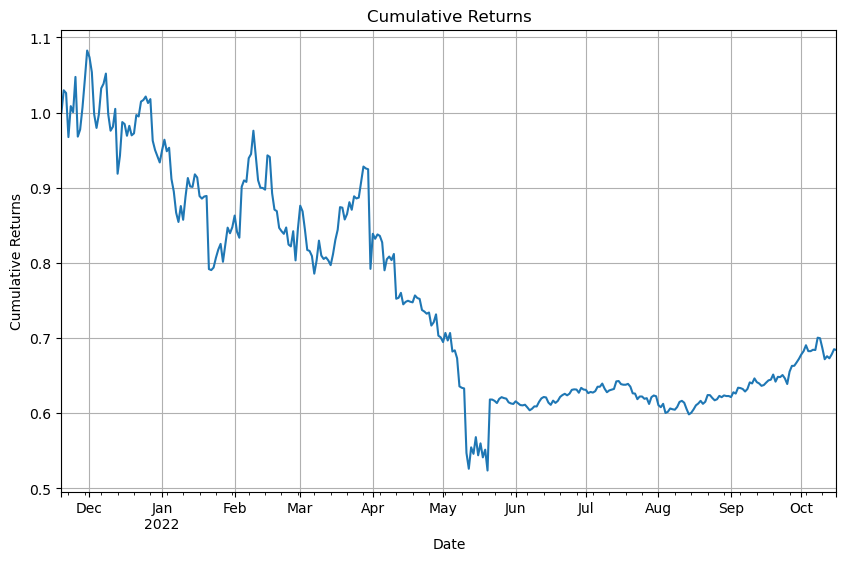

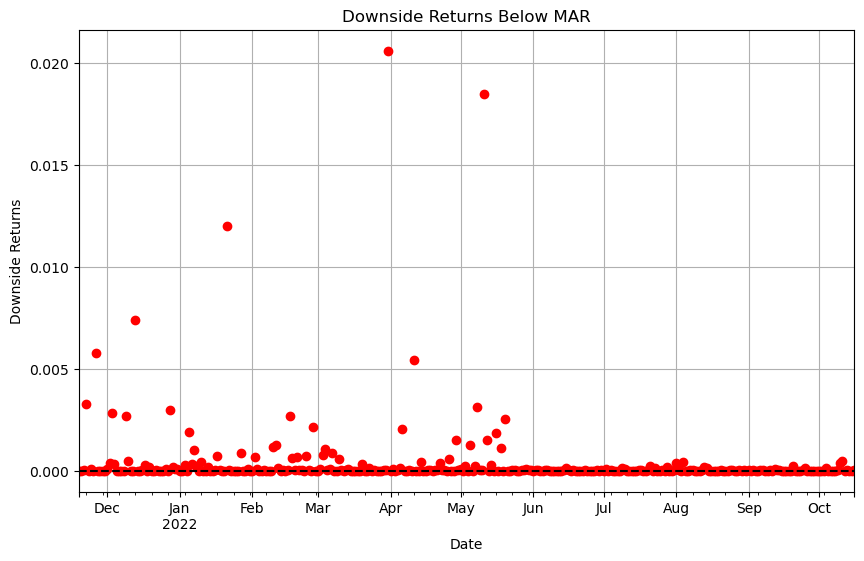

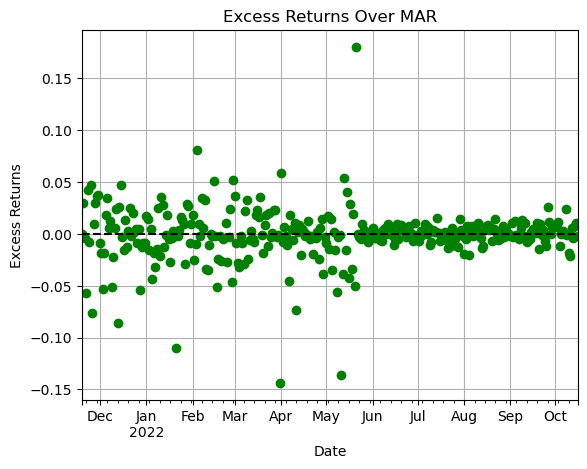

Sortino ratio: -1.00554467367495
Scaled Sortino diff: 9.208139028423108e-05
reward -0.12645797329422837
Reward at the end of the cycle on 2022-10-16 00:00:00: -1.1320947283594627
Completed cycle up to 2022-10-16 00:00:00
Running simulation from 2022-10-17 00:00:00 to 2022-11-10 00:00:00
Cycle Number: 7, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000185285
weight difference -0.1929357449848637
Desired adjustment -1.929357449848637
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.242935744985049, Target: 0.050000000000185285, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999990424
weight difference 0.3637281513195752
Desired adjustment 3.637281513195752
adjustment scale 10
legal adjustments [-1, -0.5, -0.25

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


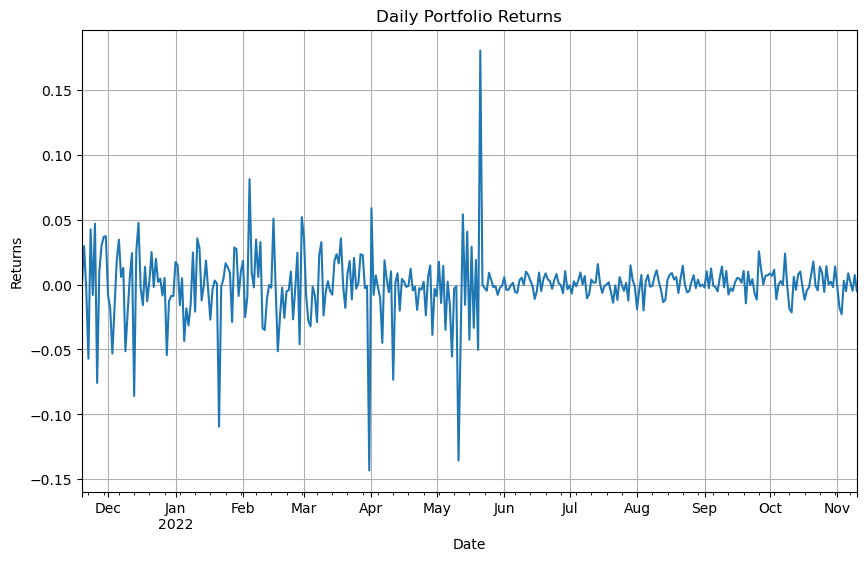

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


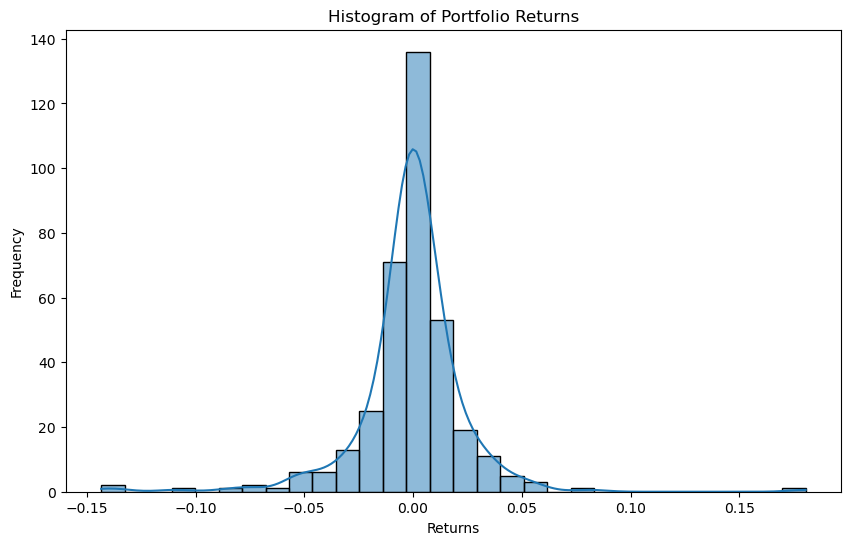

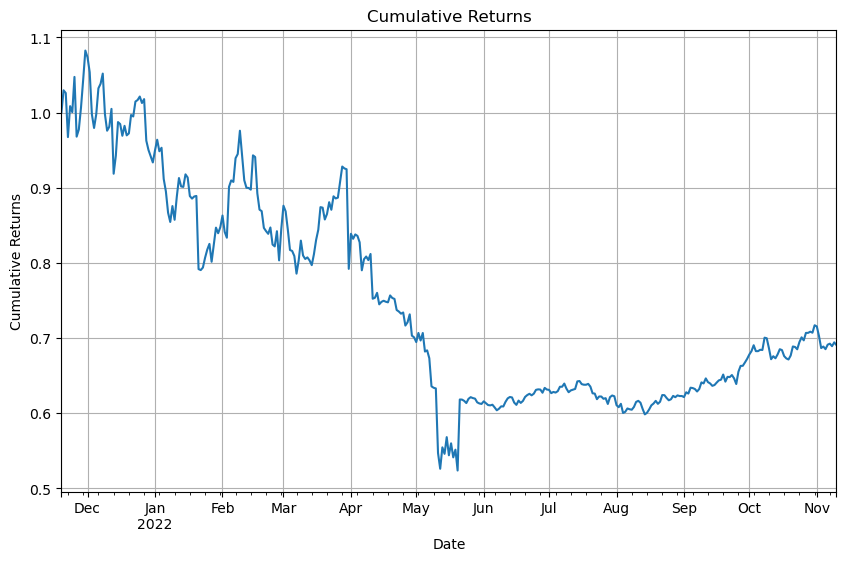

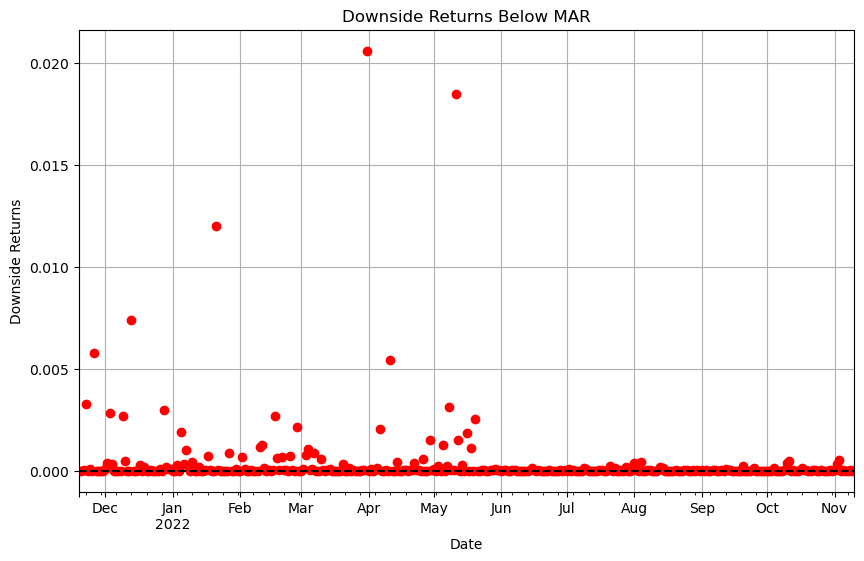

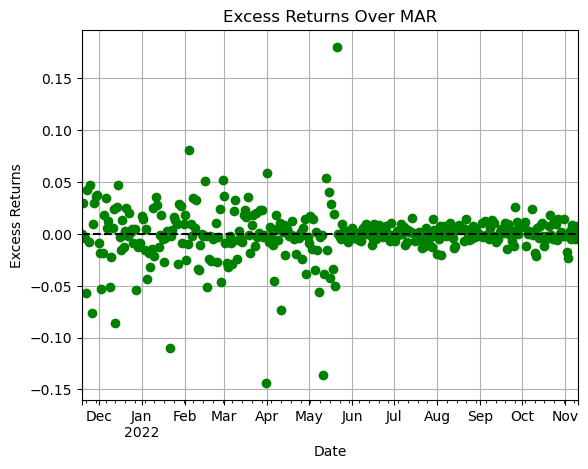

Sortino ratio: -0.9678571149163105
Scaled Sortino diff: 8.297679819606499e-05
reward -0.12591945506651714
Reward at the end of the cycle on 2022-11-10 00:00:00: -1.0938595467810237
Completed cycle up to 2022-11-10 00:00:00
Running simulation from 2022-11-11 00:00:00 to 2022-12-05 00:00:00
Cycle Number: 8, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.18931442336493925
Desired adjustment -1.8931442336493927
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.23931442336493924, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.36097965505046703
Desired adjustment 3.6097965505046705
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
V

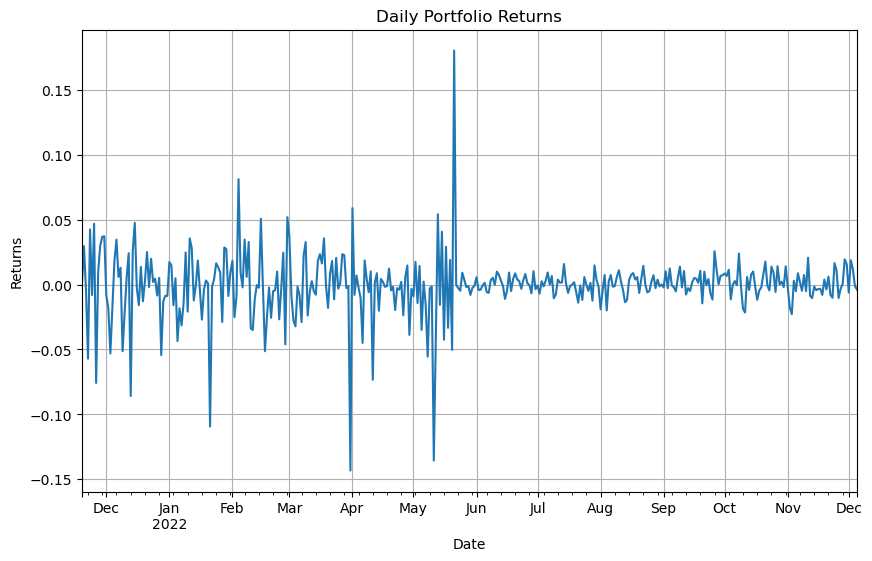

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


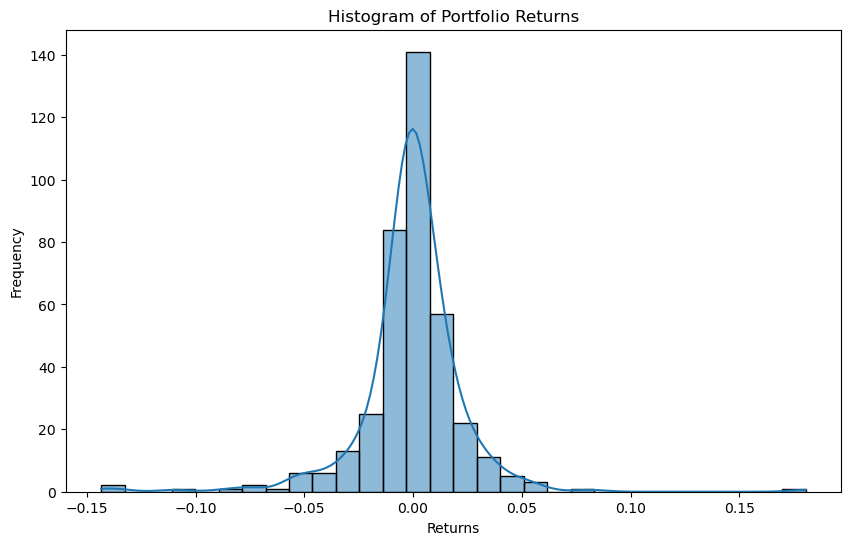

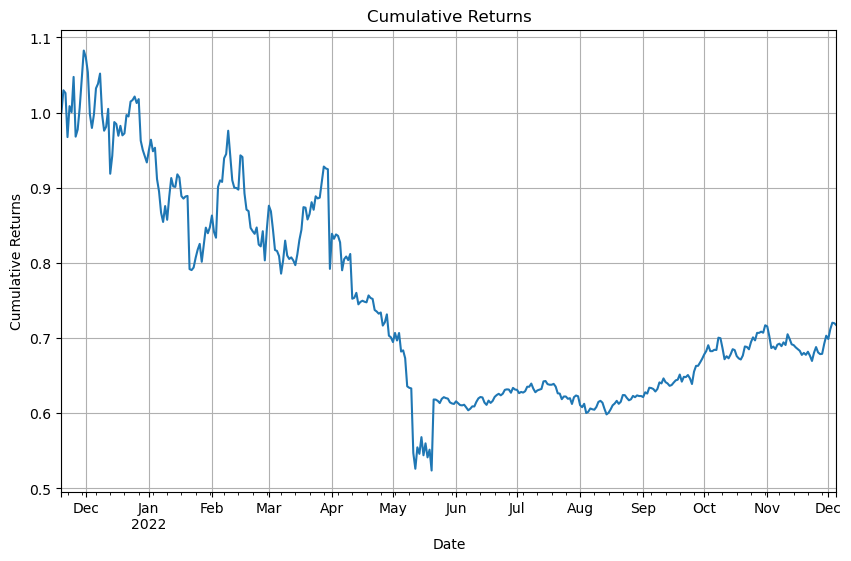

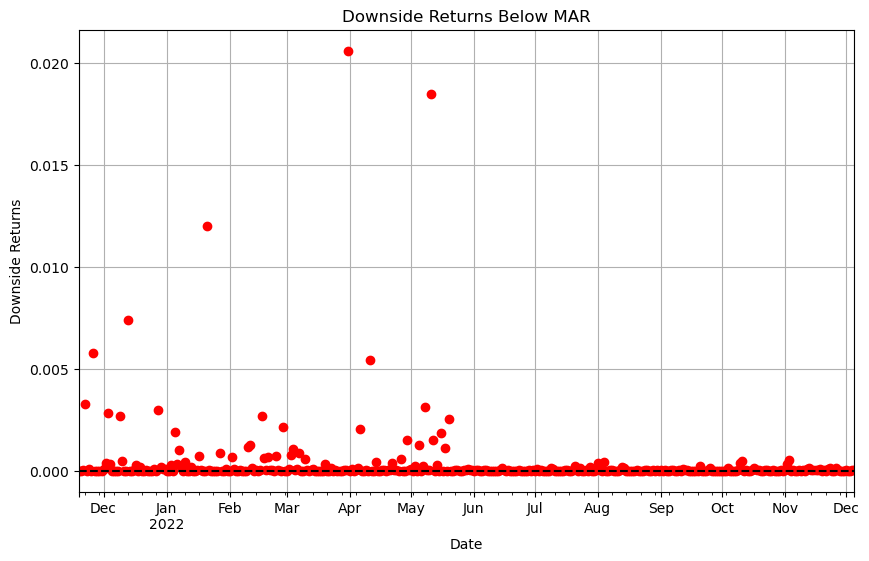

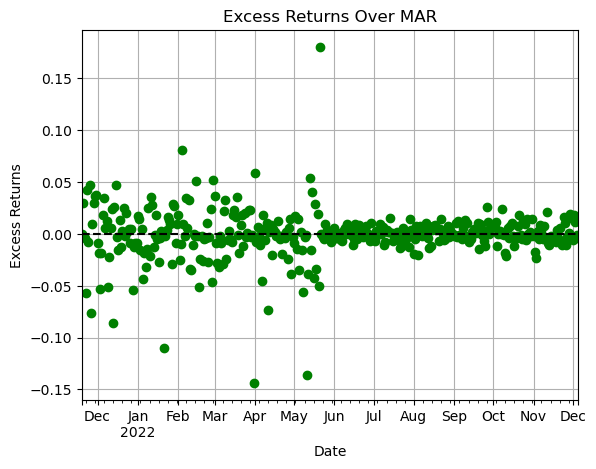

Sortino ratio: -0.8819172560213533
Scaled Sortino diff: 7.883207158319288e-05
reward -0.12360887130646533
Reward at the end of the cycle on 2022-12-05 00:00:00: -1.0056049593994019
Completed cycle up to 2022-12-05 00:00:00
Running simulation from 2022-12-06 00:00:00 to 2022-12-30 00:00:00
Cycle Number: 9, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000000238
weight difference -0.18546033281021634
Desired adjustment -1.8546033281021634
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.23546033281021872, Target: 0.05000000000000238, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999999895
weight difference 0.3495704259014546
Desired adjustment 3.4957042590145457
adjustment scale 10
legal adjustments [-1, -0.5, 

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


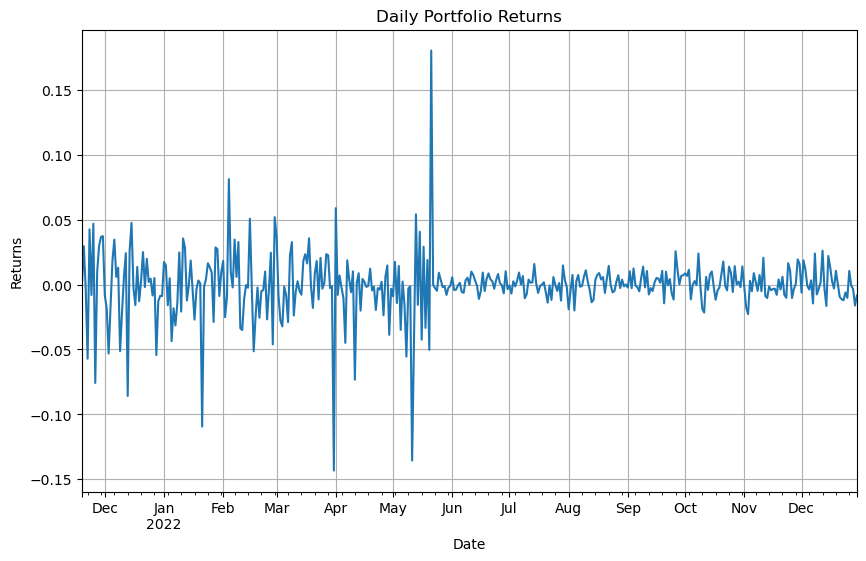

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


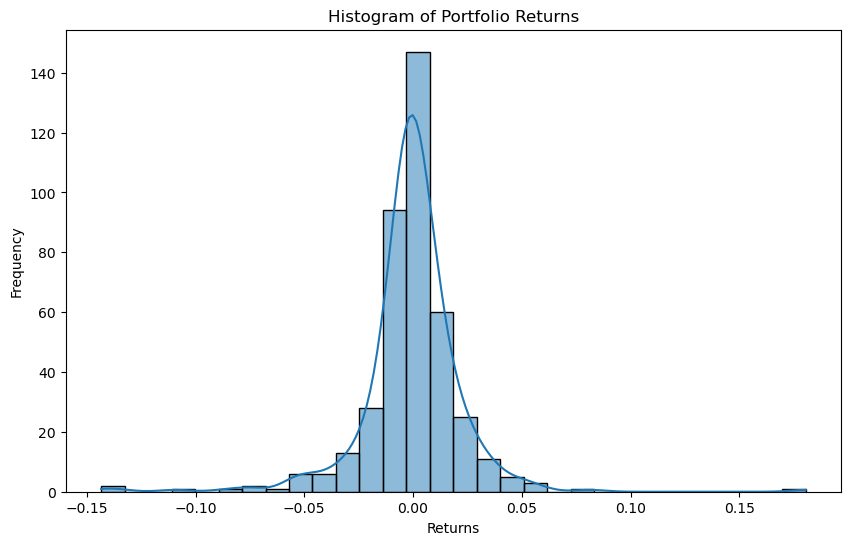

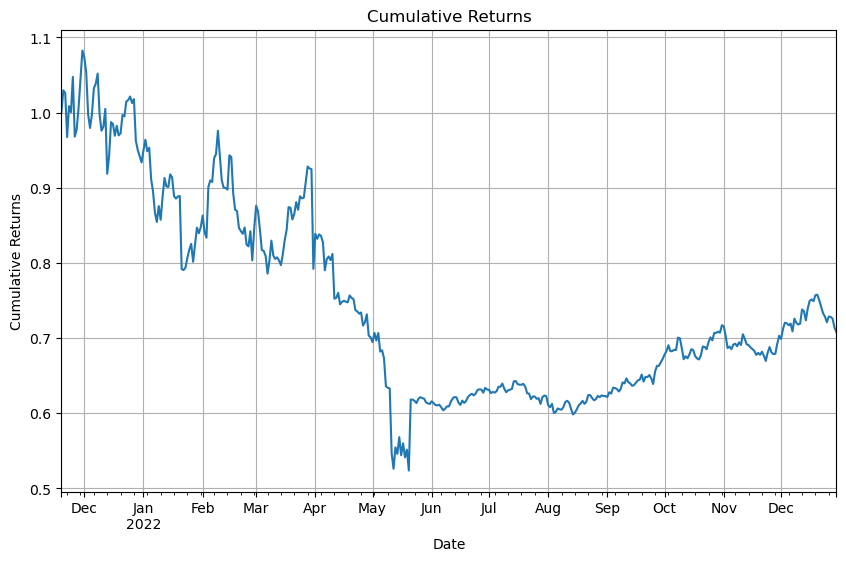

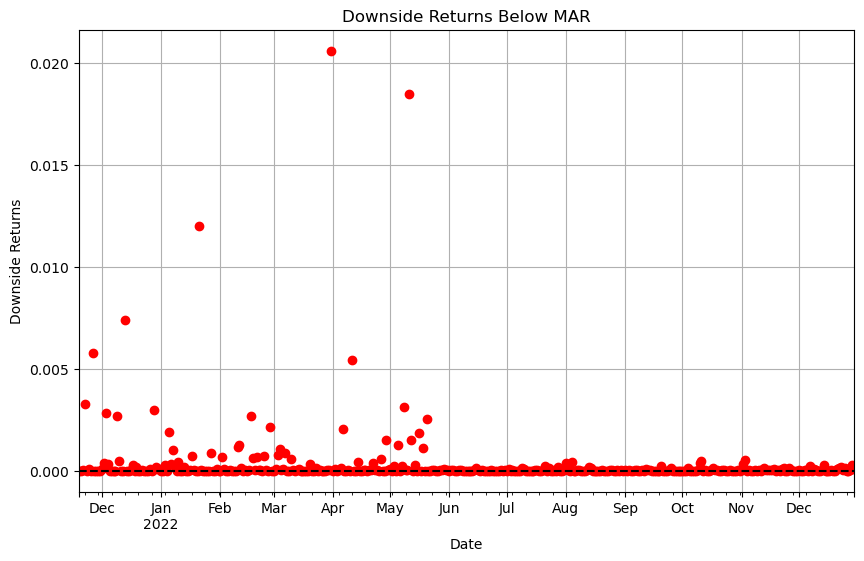

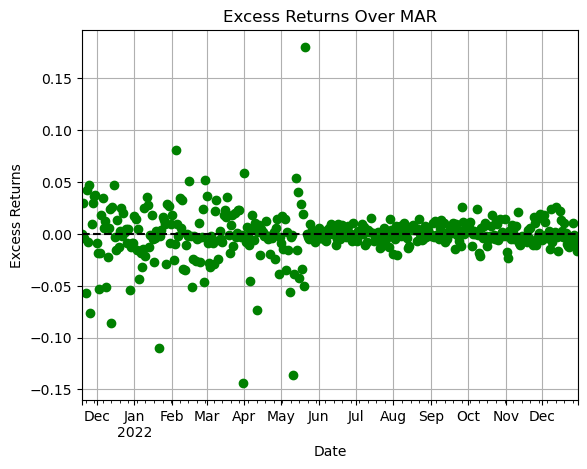

Sortino ratio: -0.8885221966052947
Scaled Sortino diff: 7.046245839694234e-05
reward -0.12127987928579774
Reward at the end of the cycle on 2022-12-30 00:00:00: -1.0098725383494895
Completed cycle up to 2022-12-30 00:00:00
Running simulation from 2022-12-31 00:00:00 to 2023-01-24 00:00:00
Cycle Number: 10, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.1834084122788744
Desired adjustment -1.8340841227887439
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2334084122788744, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.3401074515615874
Desired adjustment 3.401074515615874
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vaul

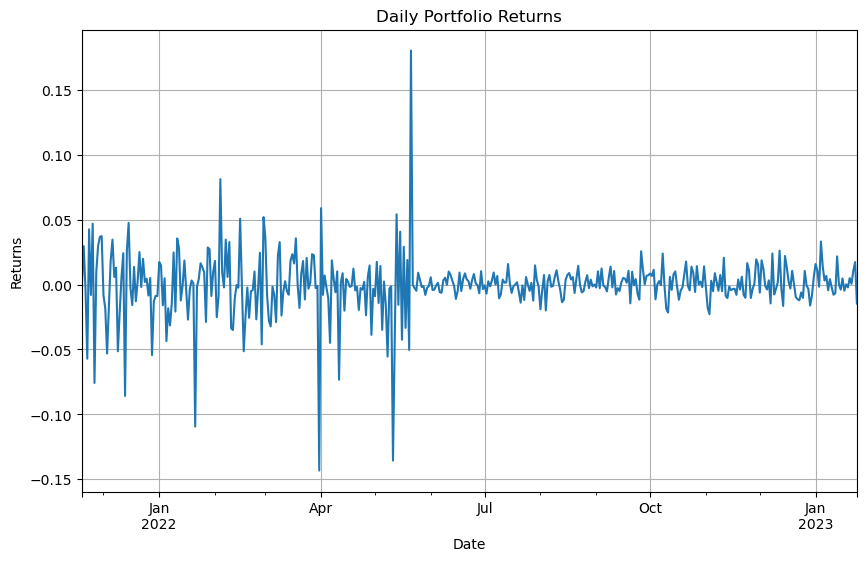

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


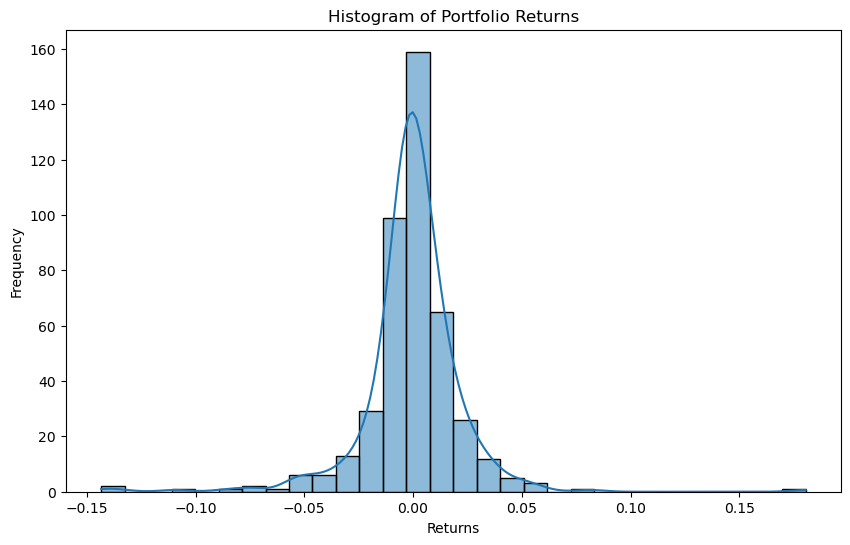

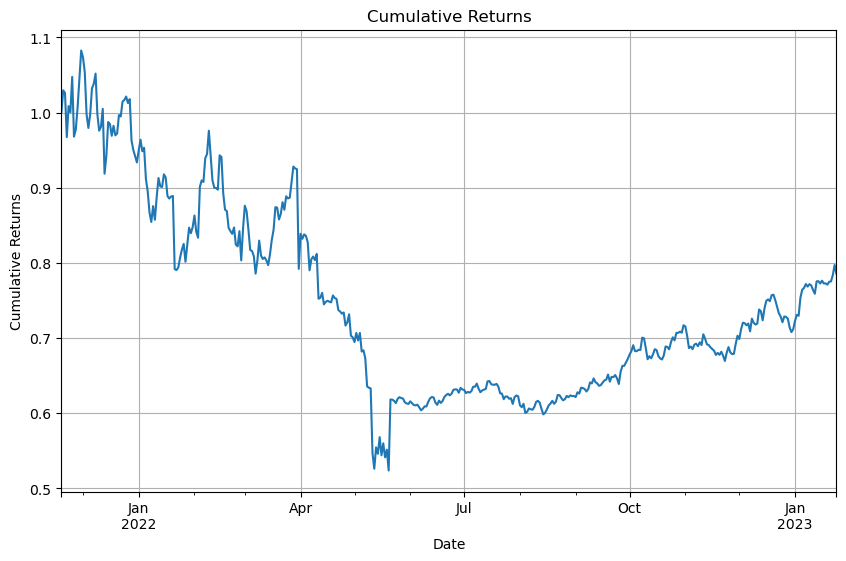

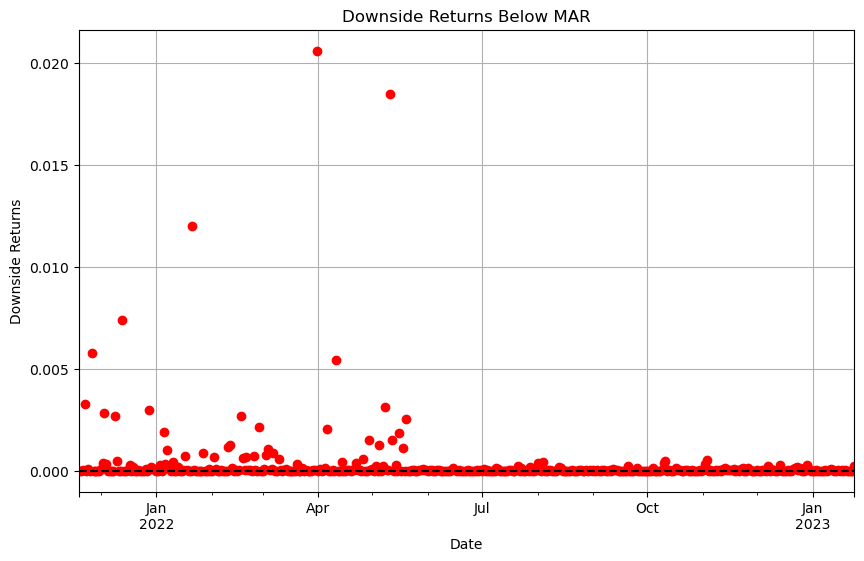

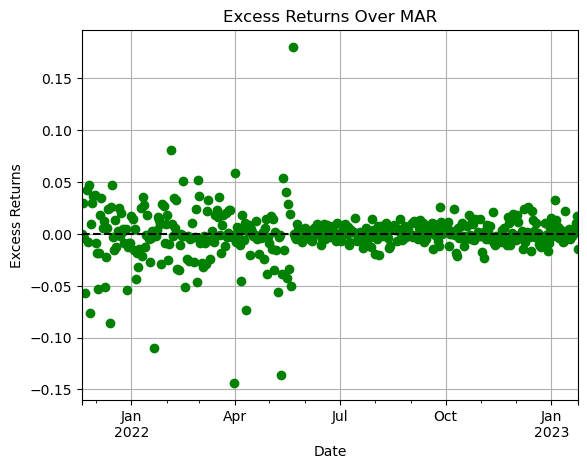

Sortino ratio: -0.6772585588237336
Scaled Sortino diff: 6.820261572033992e-05
reward -0.12247746107379417
Reward at the end of the cycle on 2023-01-24 00:00:00: -0.7998042225132481
Completed cycle up to 2023-01-24 00:00:00
Running simulation from 2023-01-25 00:00:00 to 2023-02-18 00:00:00
Cycle Number: 11, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000063716
weight difference -0.19083091205627242
Desired adjustment -1.9083091205627243
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.24083091205633614, Target: 0.050000000000063716, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999703
weight difference 0.34208627174844336
Desired adjustment 3.4208627174844337
adjustment scale 10
legal adjustments [-1, -0.

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


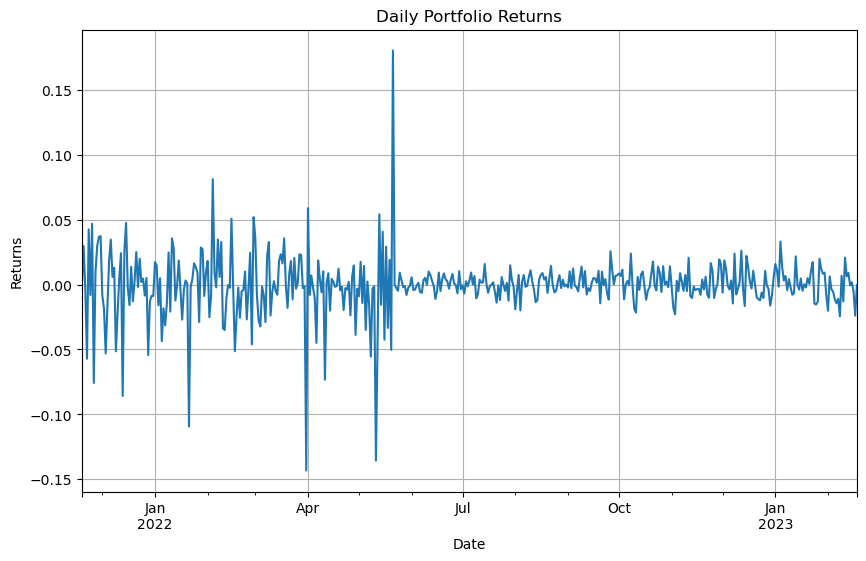

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


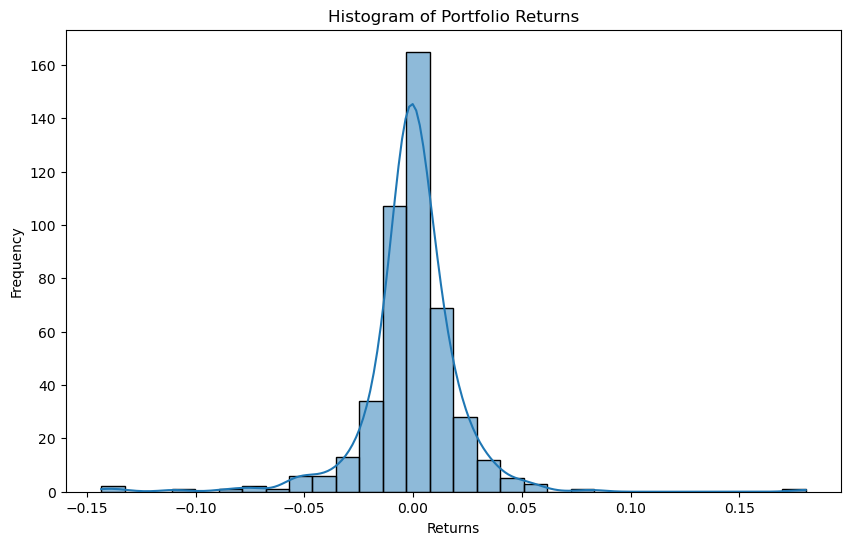

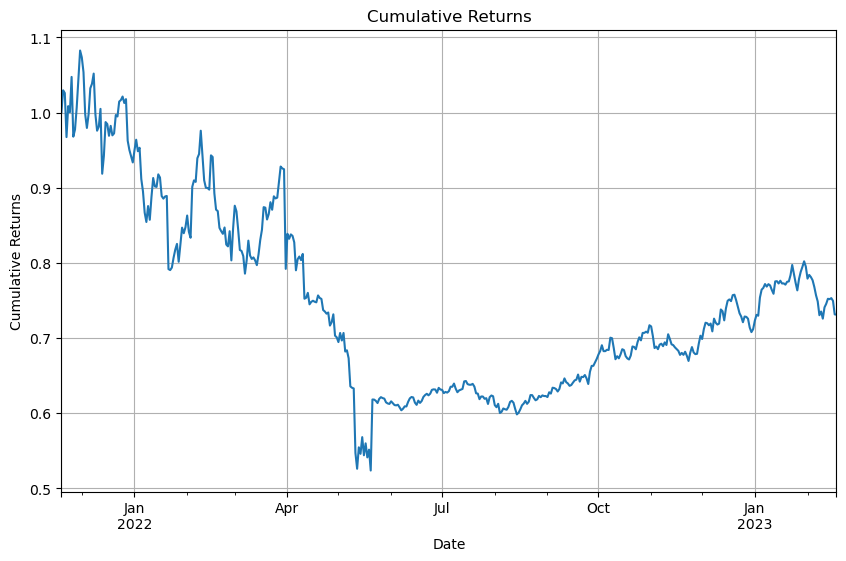

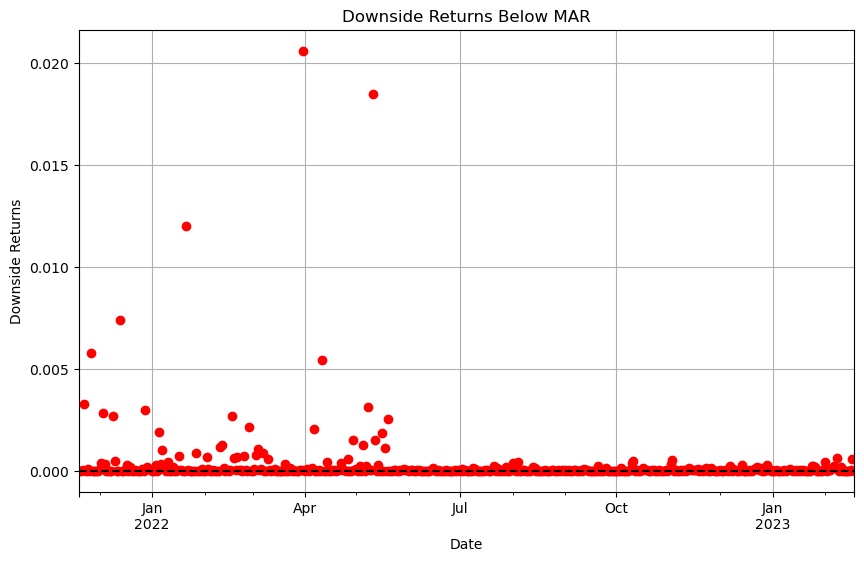

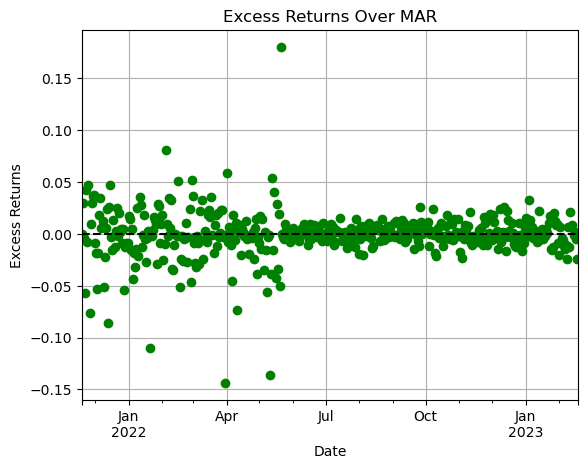

Sortino ratio: -0.7973076314255174
Scaled Sortino diff: 6.061371717210967e-05
reward -0.11822703153084865
Reward at the end of the cycle on 2023-02-18 00:00:00: -0.9155952766735382
Completed cycle up to 2023-02-18 00:00:00
Running simulation from 2023-02-19 00:00:00 to 2023-03-15 00:00:00
Cycle Number: 12, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.1723986153150116
Desired adjustment -1.7239861531501162
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22239861531501162, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999994
weight difference 0.33311039799987474
Desired adjustment 3.3311039799987476
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest a

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


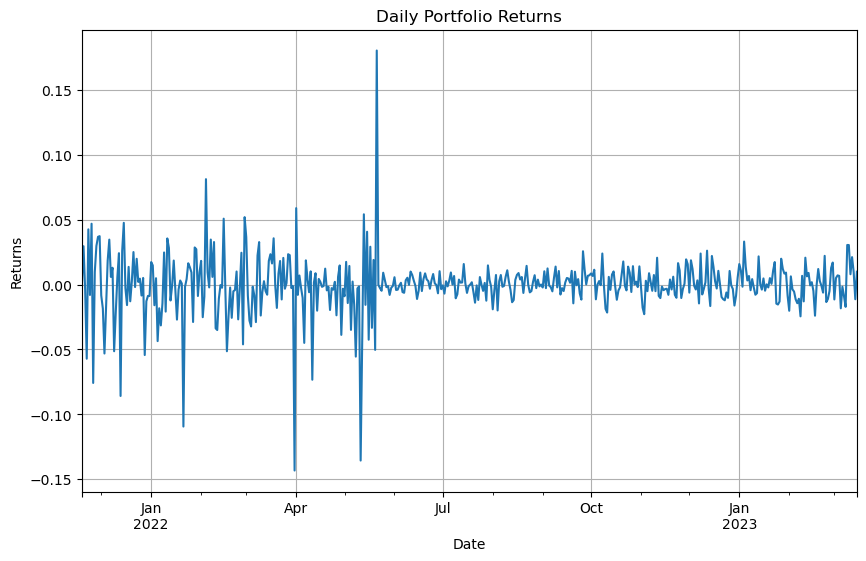

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


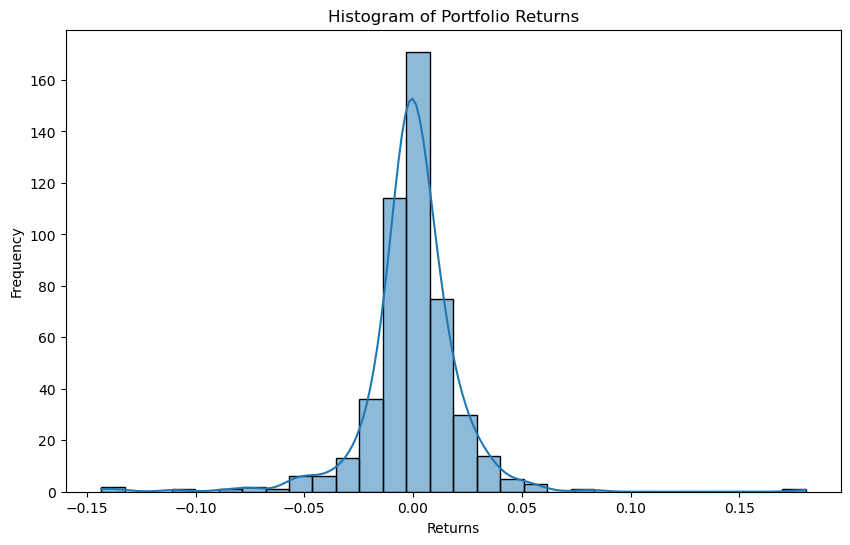

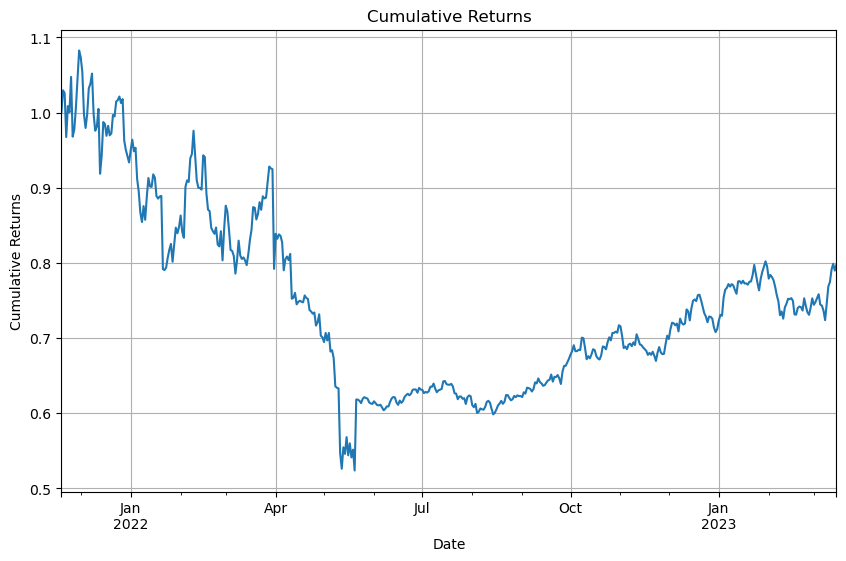

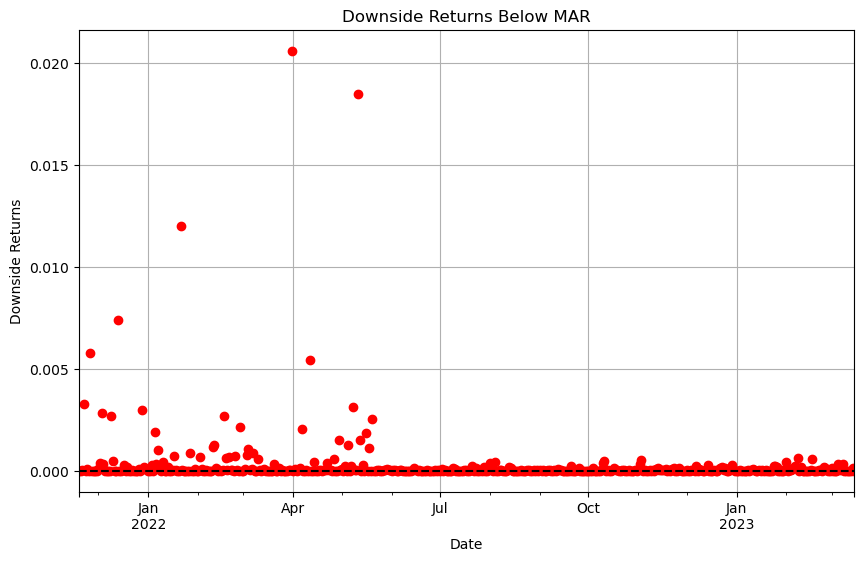

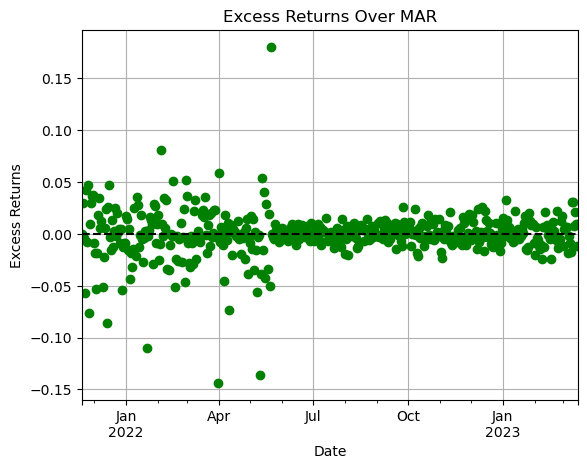

Sortino ratio: -0.6227313628371647
Scaled Sortino diff: 5.96182525131547e-05
reward -0.11504069869607438
Reward at the end of the cycle on 2023-03-15 00:00:00: -0.7378316797857523
Completed cycle up to 2023-03-15 00:00:00
Running simulation from 2023-03-16 00:00:00 to 2023-04-09 00:00:00
Cycle Number: 13, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.17390197276656078
Desired adjustment -1.7390197276656076
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22390197276656076, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.3182771930635661
Desired adjustment 3.182771930635661
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vau

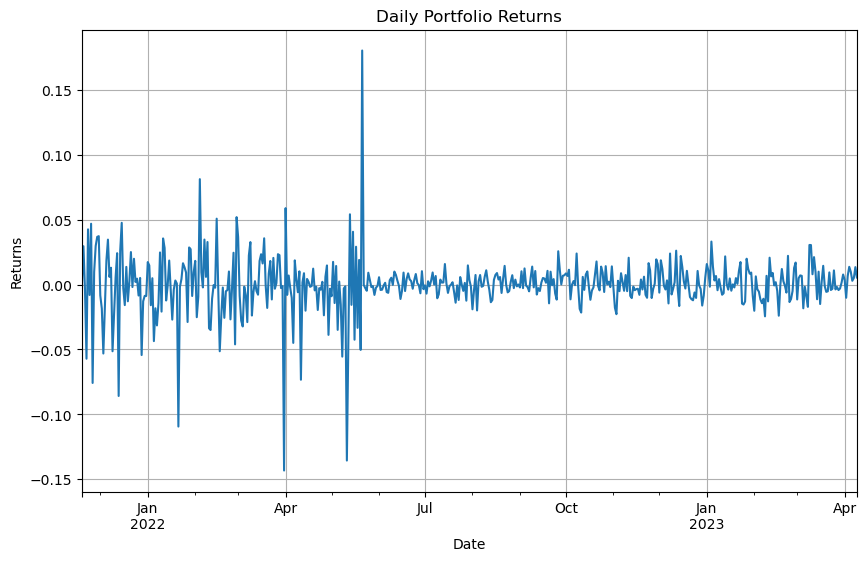

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


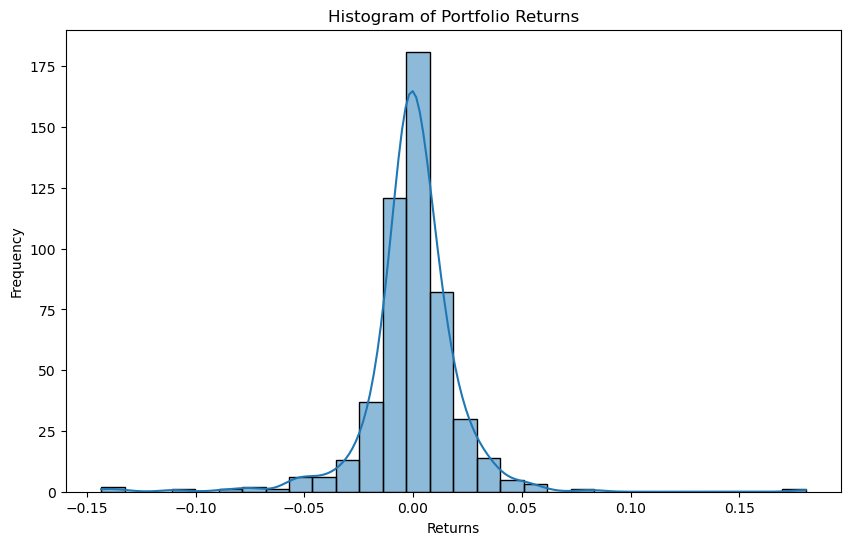

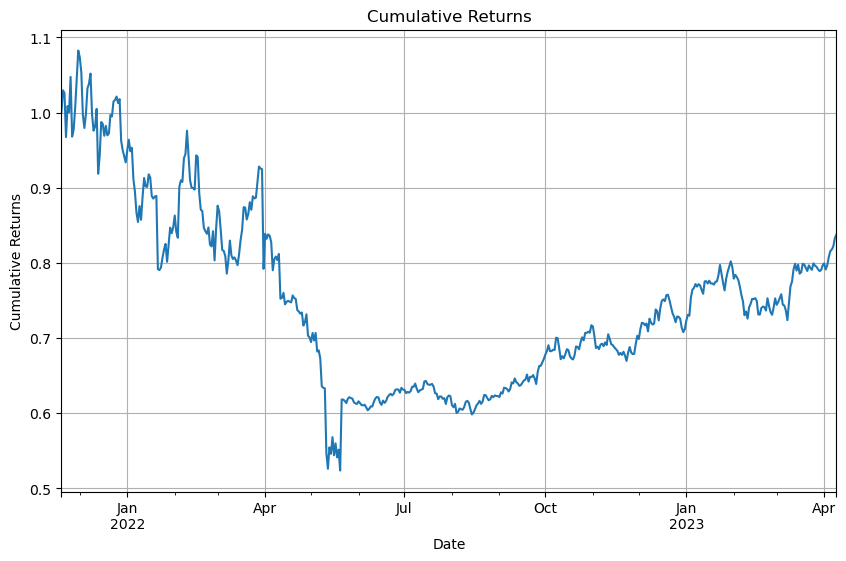

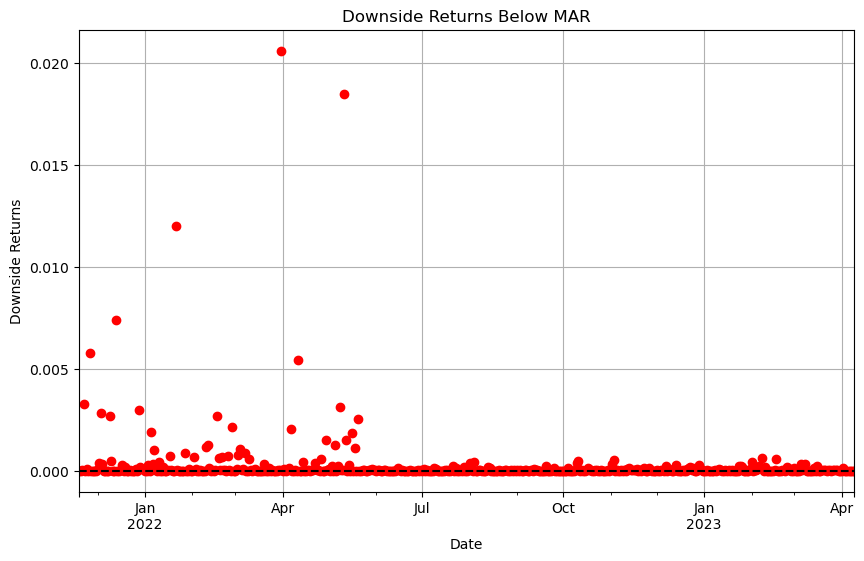

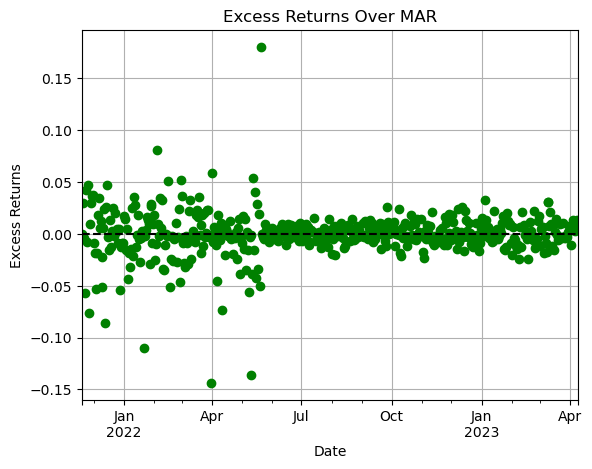

Sortino ratio: -0.5219255471603395
Scaled Sortino diff: 5.5618573916472237e-05
reward -0.11679113508931965
Reward at the end of the cycle on 2023-04-09 00:00:00: -0.6387723008235756
Completed cycle up to 2023-04-09 00:00:00
Running simulation from 2023-04-10 00:00:00 to 2023-05-04 00:00:00
Cycle Number: 14, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.1755633296965104
Desired adjustment -1.755633296965104
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22556332969651038, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.32351057227861757
Desired adjustment 3.2351057227861757
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
V

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


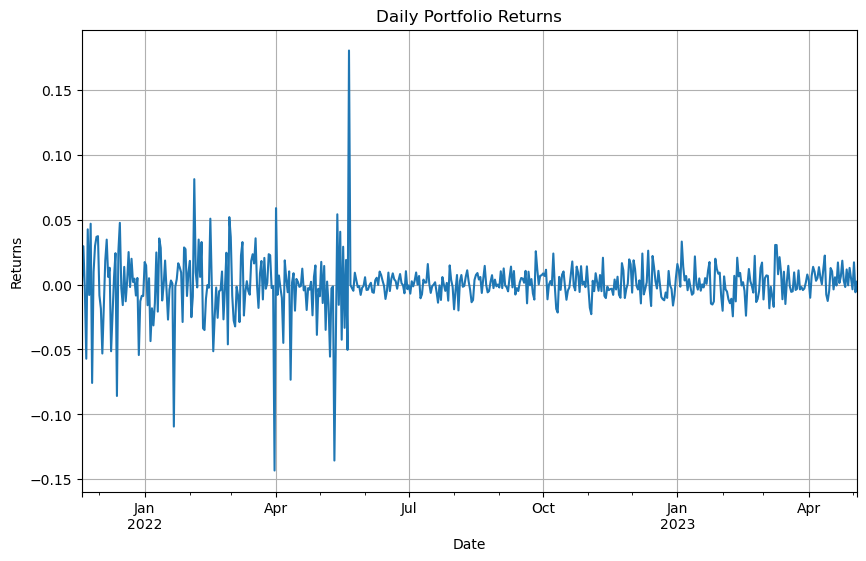

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


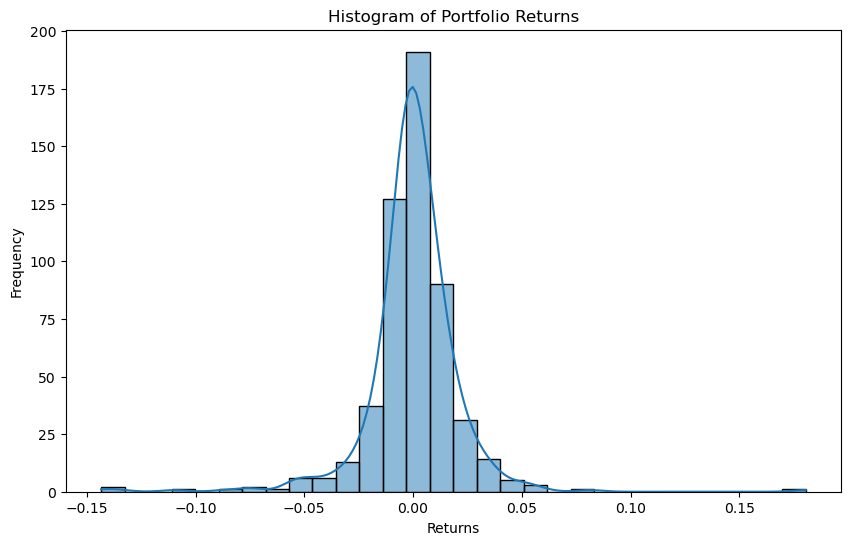

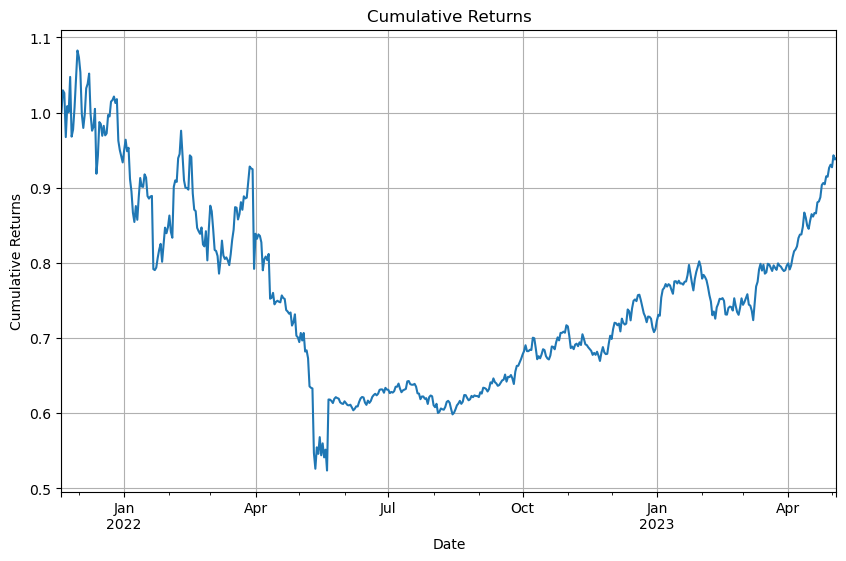

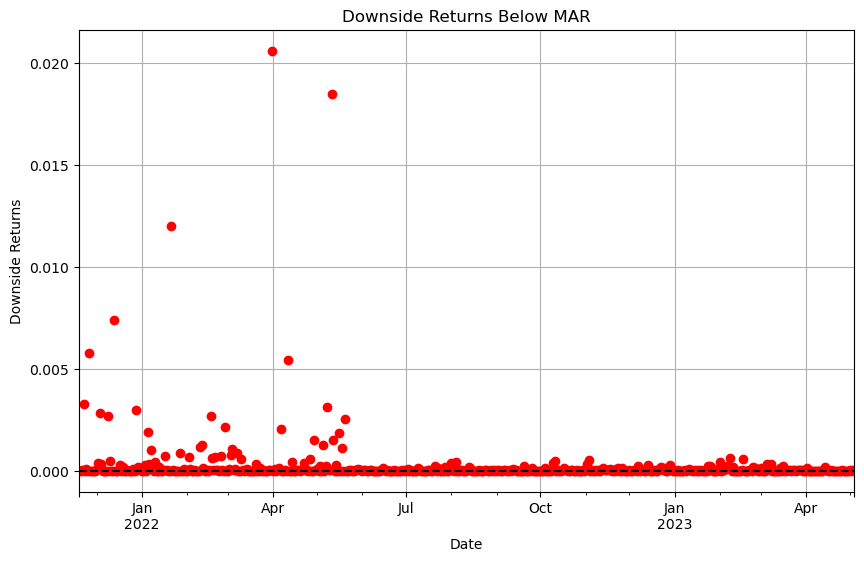

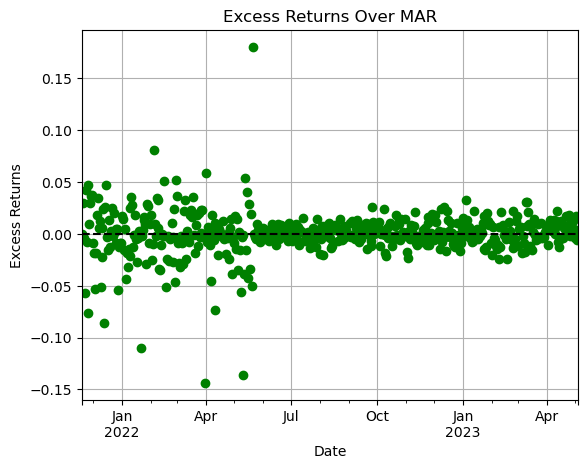

Sortino ratio: -0.2887991959491711
Scaled Sortino diff: 5.416541732080849e-05
reward -0.11570227692860702
Reward at the end of the cycle on 2023-05-04 00:00:00: -0.4045556382950989
Completed cycle up to 2023-05-04 00:00:00
Running simulation from 2023-05-05 00:00:00 to 2023-05-29 00:00:00
Cycle Number: 15, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000001914
weight difference -0.18454273375107666
Desired adjustment -1.8454273375107666
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2345427337510958, Target: 0.05000000000001914, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999884
weight difference 0.3228128586652087
Desired adjustment 3.228128586652087
adjustment scale 10
legal adjustments [-1, -0.5, -0

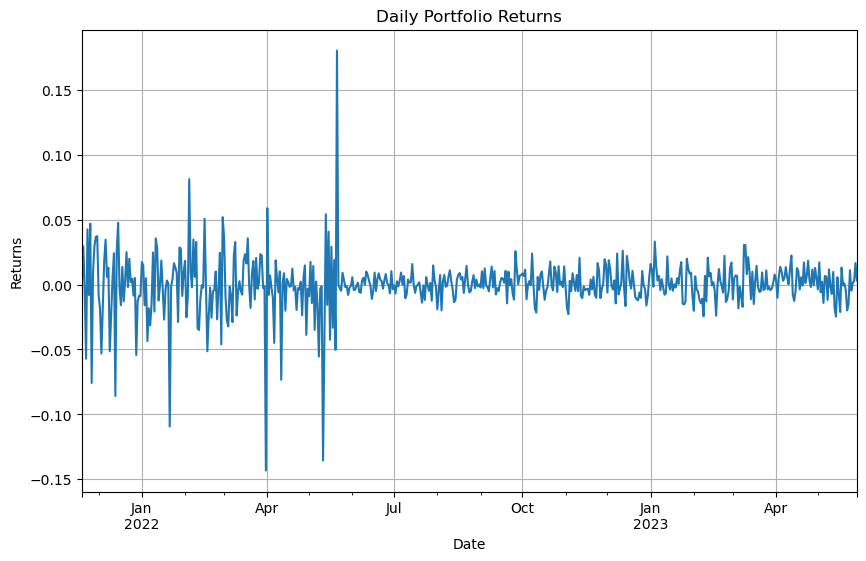

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


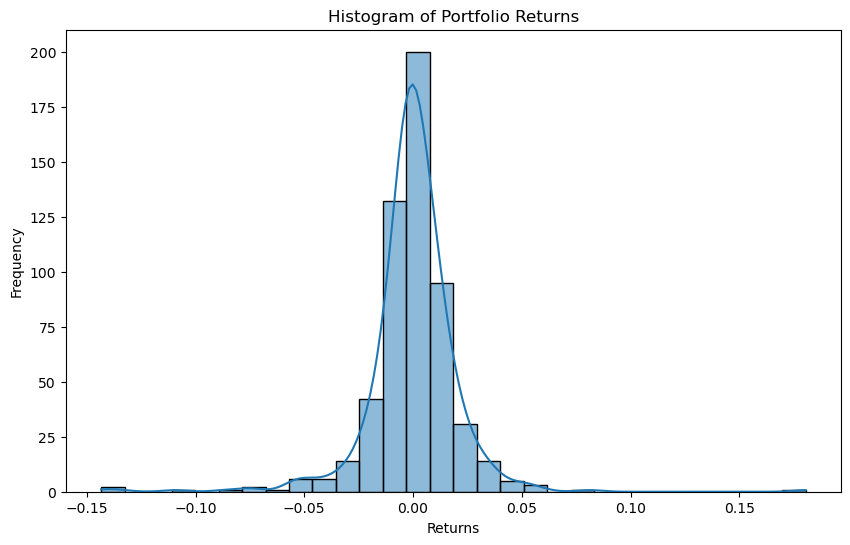

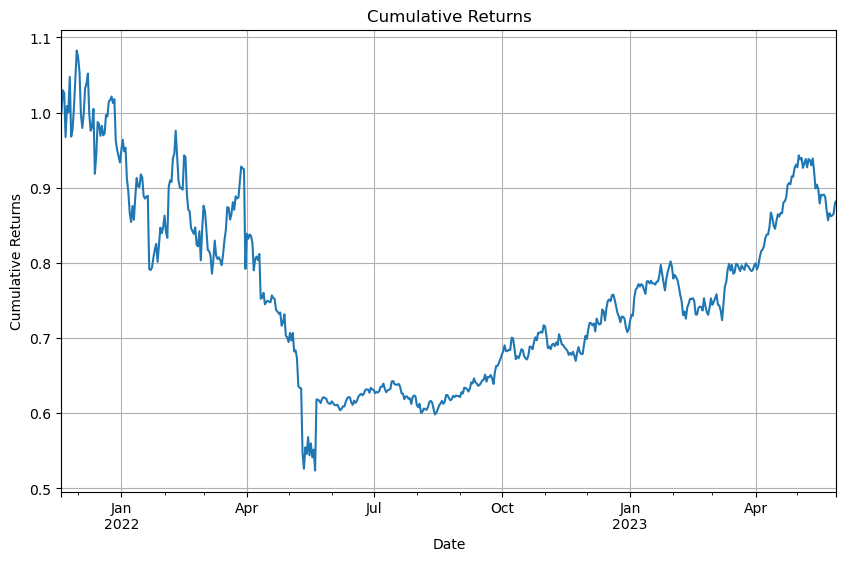

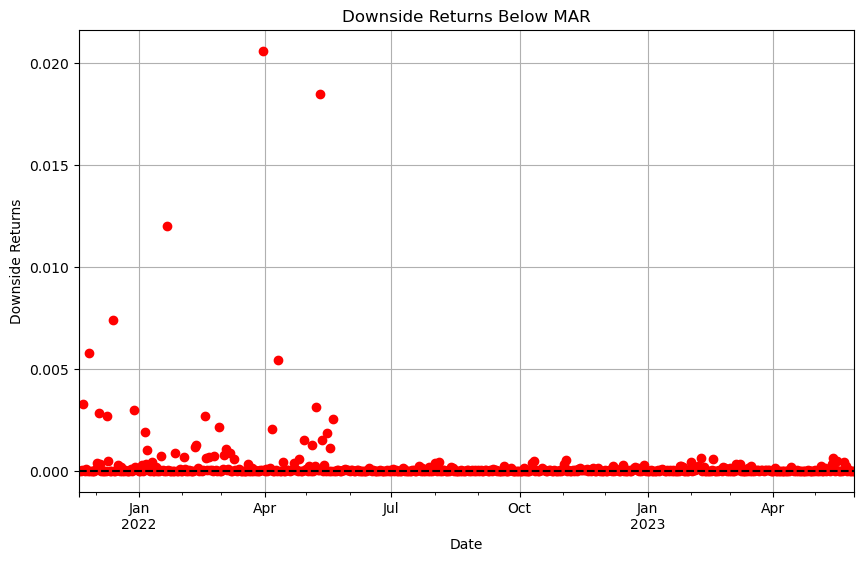

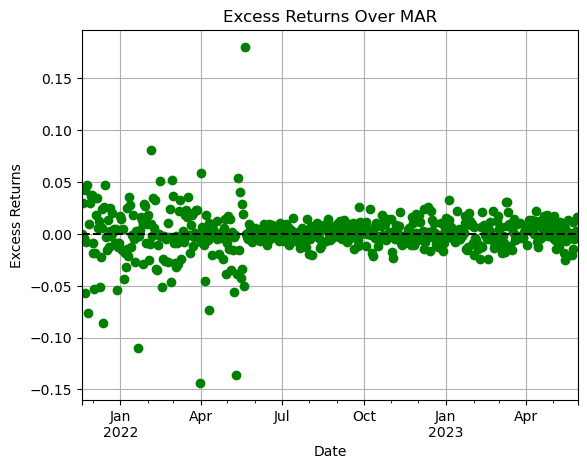

Sortino ratio: -0.40987199631671206
Scaled Sortino diff: 4.898502181847427e-05
reward -0.11461272170478198
Reward at the end of the cycle on 2023-05-29 00:00:00: -0.5245337030433125
Completed cycle up to 2023-05-29 00:00:00
Running simulation from 2023-05-30 00:00:00 to 2023-06-23 00:00:00
Cycle Number: 16, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.17302050799106677
Desired adjustment -1.7302050799106676
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2230205079910668, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.310301887130952
Desired adjustment 3.10301887130952
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vaul

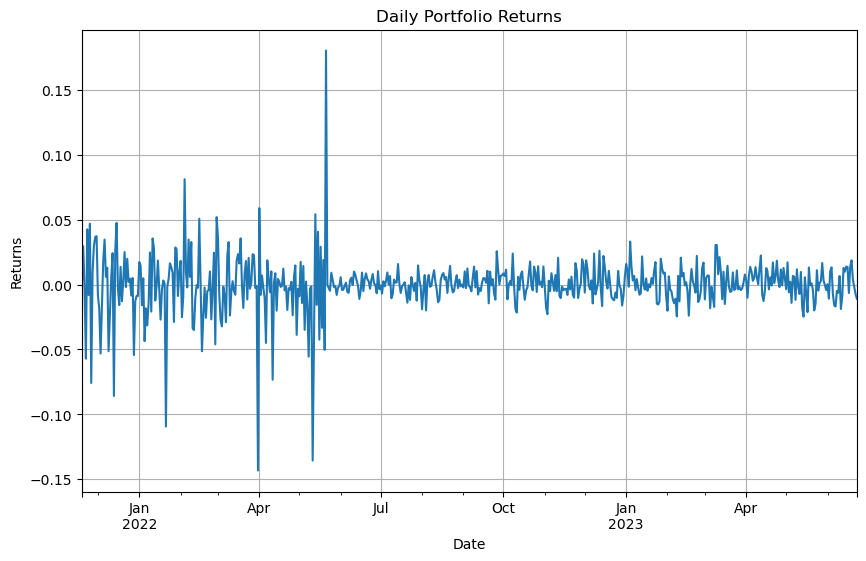

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


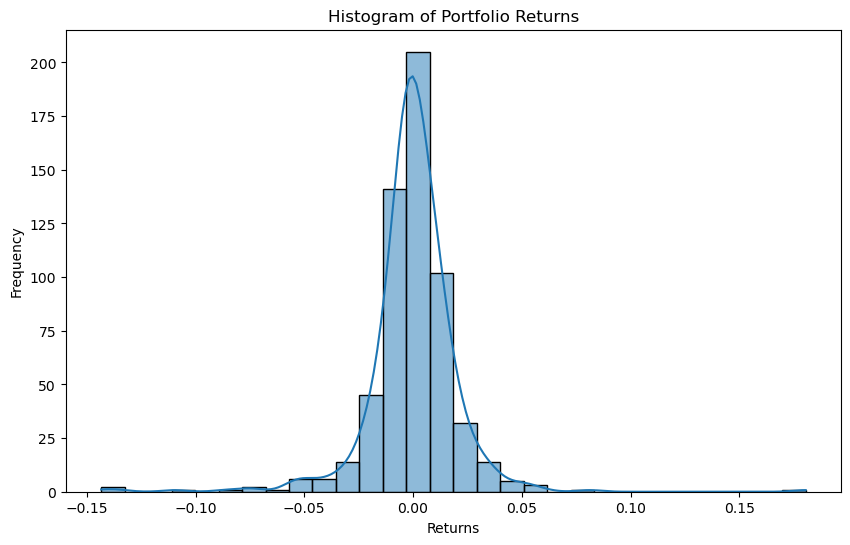

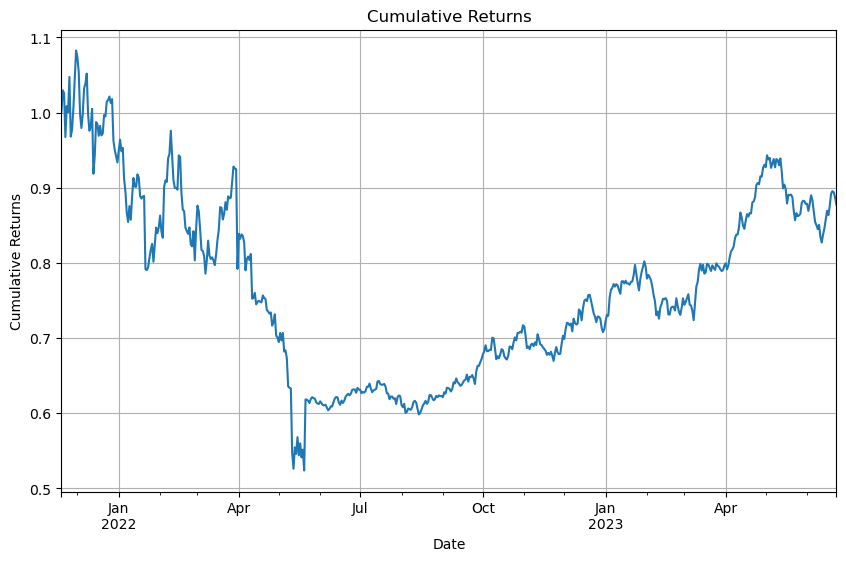

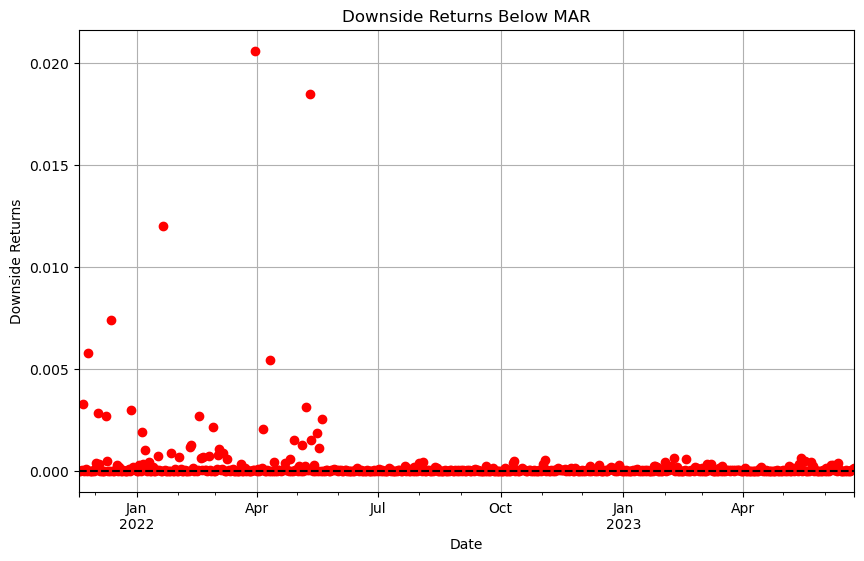

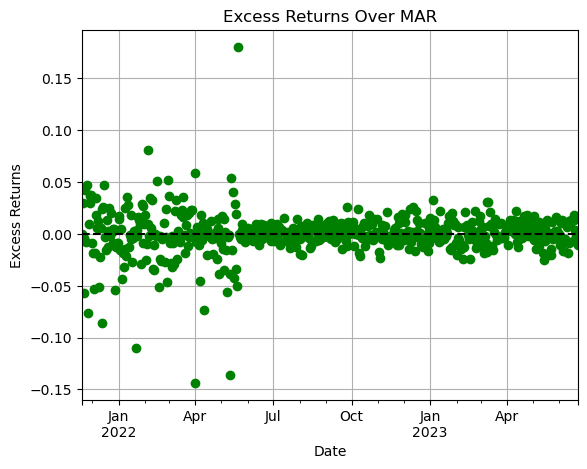

Sortino ratio: -0.4169590281759119
Scaled Sortino diff: 4.727307122949782e-05
reward -0.10965909390548315
Reward at the end of the cycle on 2023-06-23 00:00:00: -0.5266653951526246
Completed cycle up to 2023-06-23 00:00:00
Running simulation from 2023-06-24 00:00:00 to 2023-07-18 00:00:00
Cycle Number: 17, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000017332
weight difference -0.1725545659708191
Desired adjustment -1.725545659708191
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22255456597099244, Target: 0.05000000000017332, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999255
weight difference 0.29717214984999973
Desired adjustment 2.9717214984999973
adjustment scale 10
legal adjustments [-1, -0.5, -

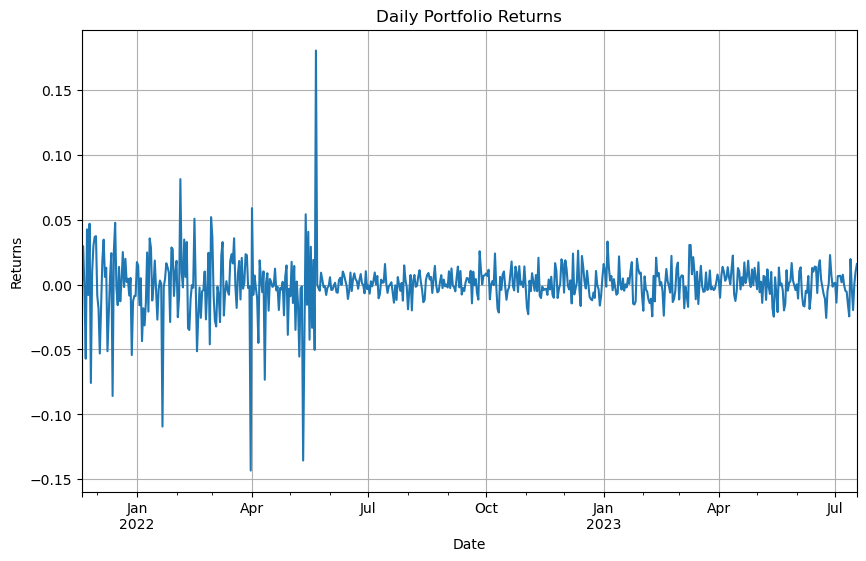

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


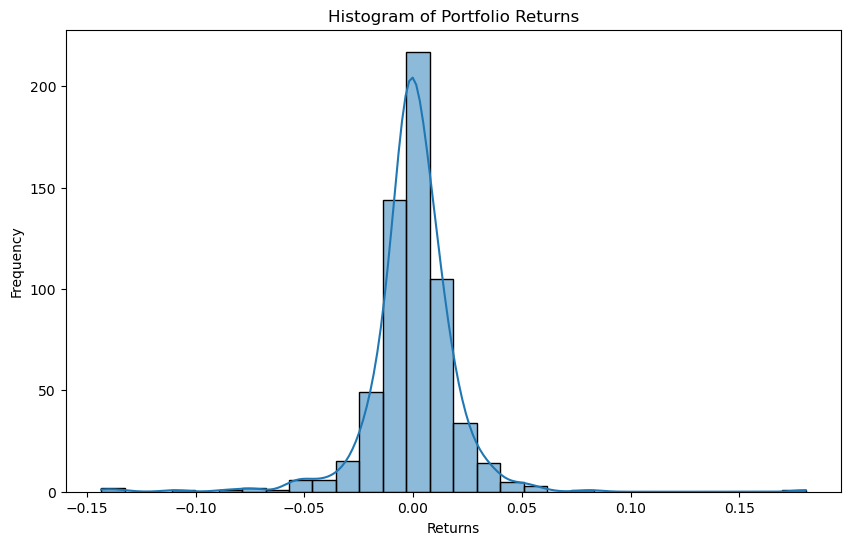

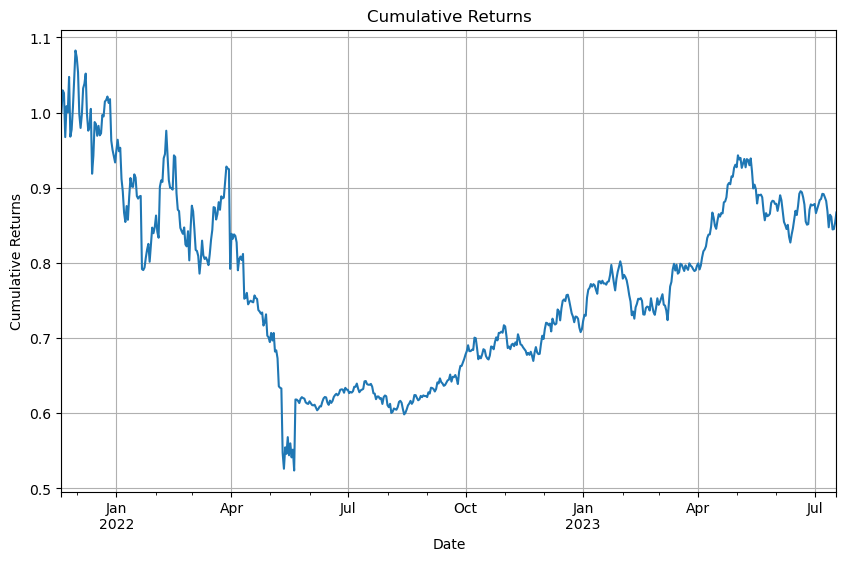

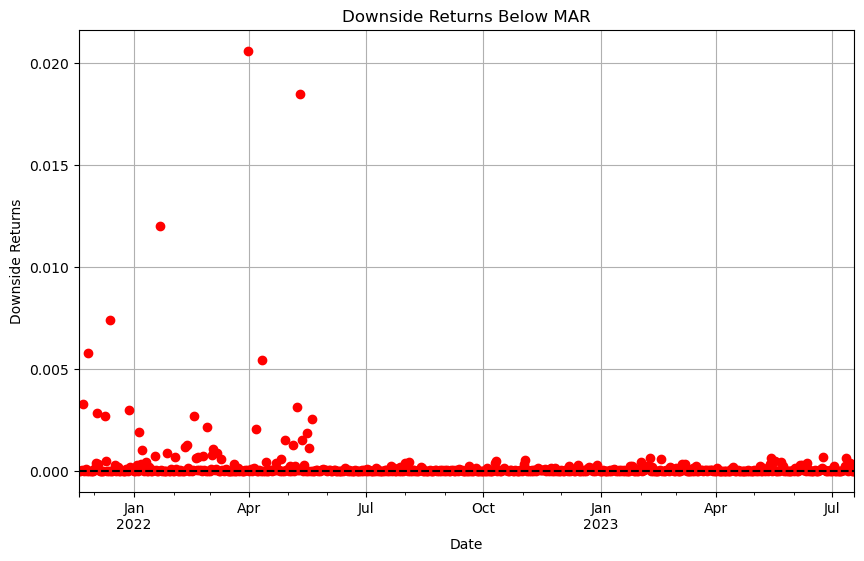

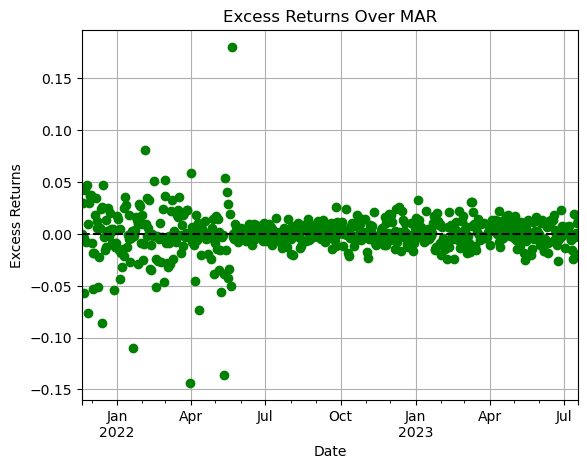

Sortino ratio: -0.4341309046597245
Scaled Sortino diff: 4.419515658660022e-05
reward -0.10576072788678524
Reward at the end of the cycle on 2023-07-18 00:00:00: -0.5399358277030963
Completed cycle up to 2023-07-18 00:00:00
Running simulation from 2023-07-19 00:00:00 to 2023-08-12 00:00:00
Cycle Number: 18, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.15599367784022816
Desired adjustment -1.5599367784022817
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.20599367784022815, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.2819495696087032
Desired adjustment 2.8194956960870323
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
V

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scip

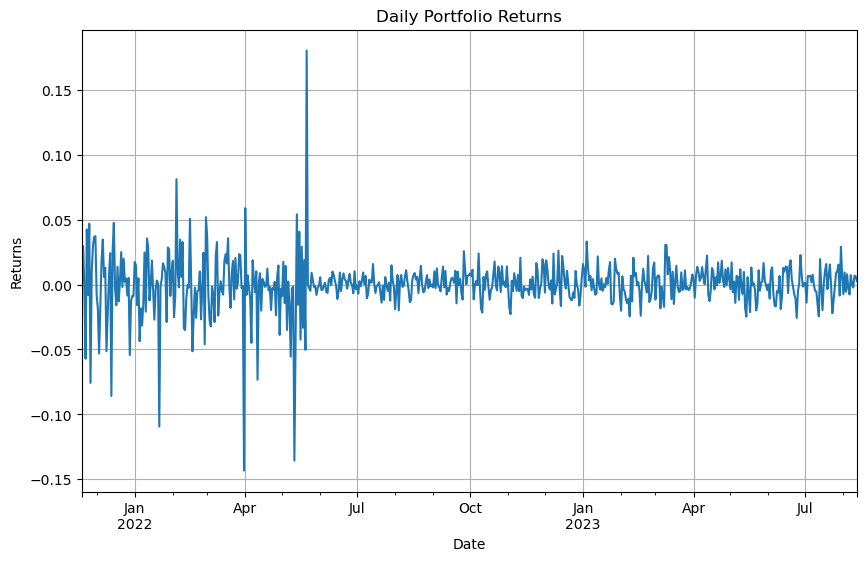

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


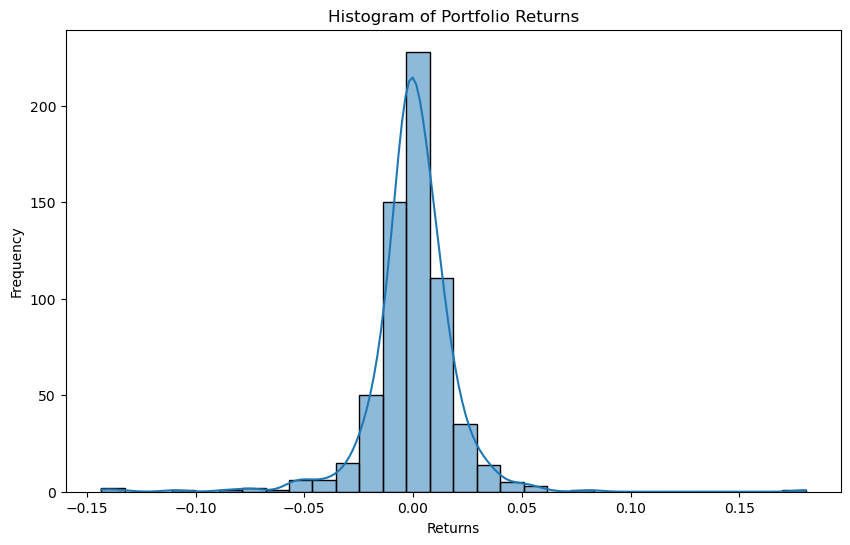

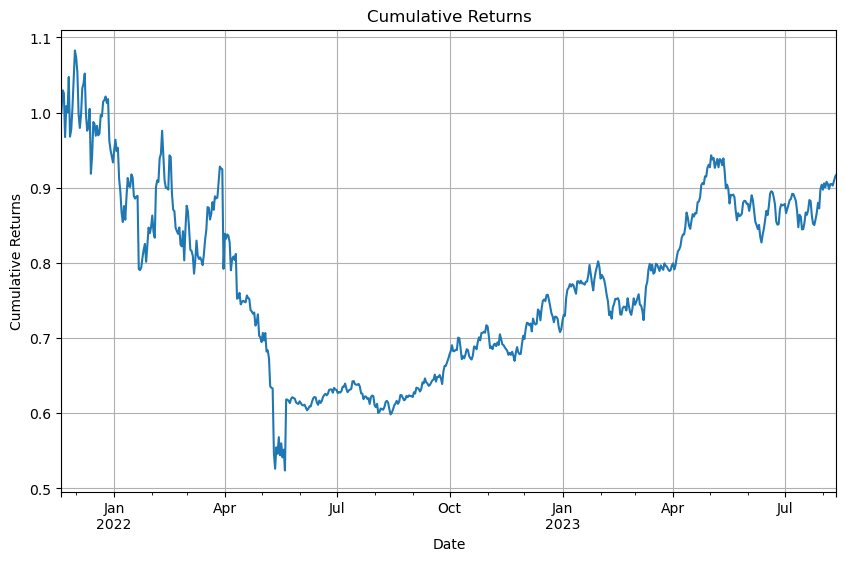

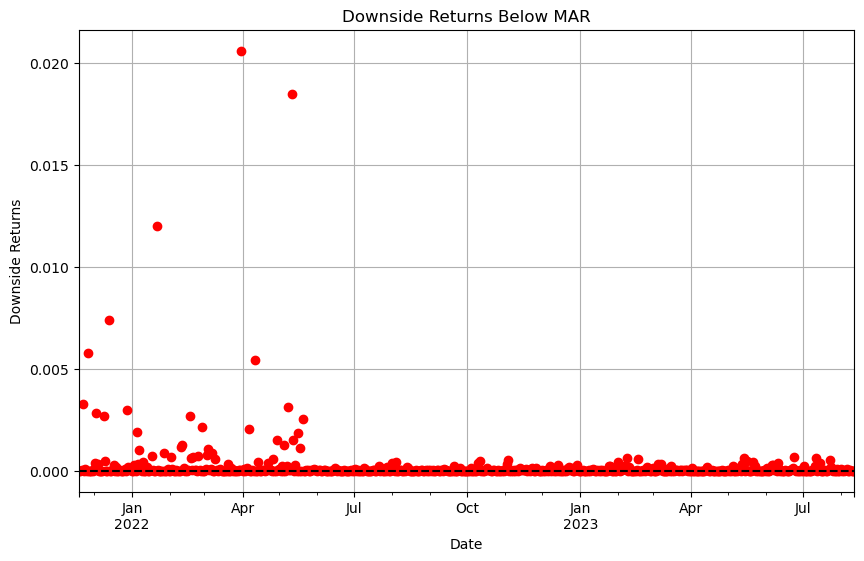

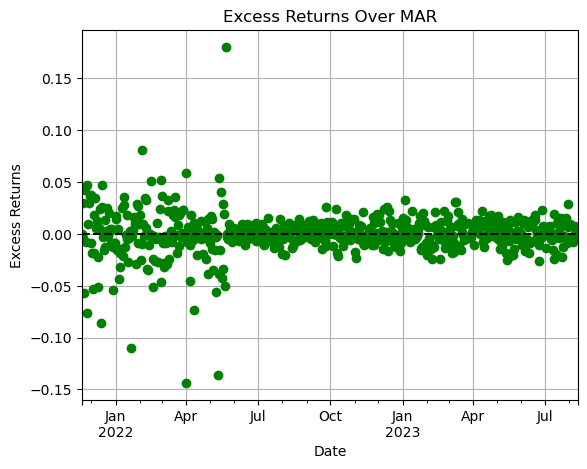

Sortino ratio: -0.32931103362829883
Scaled Sortino diff: 4.168560267984594e-05
reward -0.10672166011541144
Reward at the end of the cycle on 2023-08-12 00:00:00: -0.43607437934639015
Completed cycle up to 2023-08-12 00:00:00
Running simulation from 2023-08-13 00:00:00 to 2023-09-06 00:00:00
Cycle Number: 19, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.16382138665416923
Desired adjustment -1.6382138665416923
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.21382138665416925, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.28176957339225916
Desired adjustment 2.8176957339225916
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.

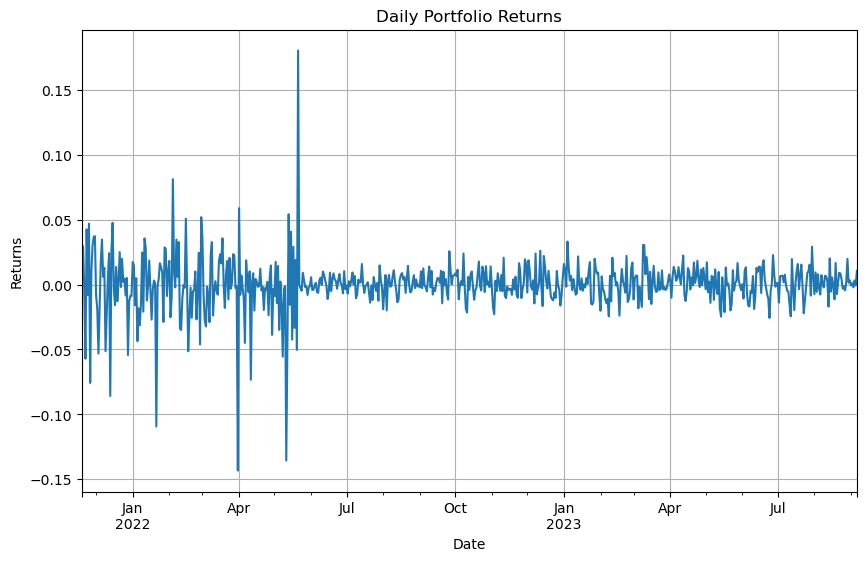

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


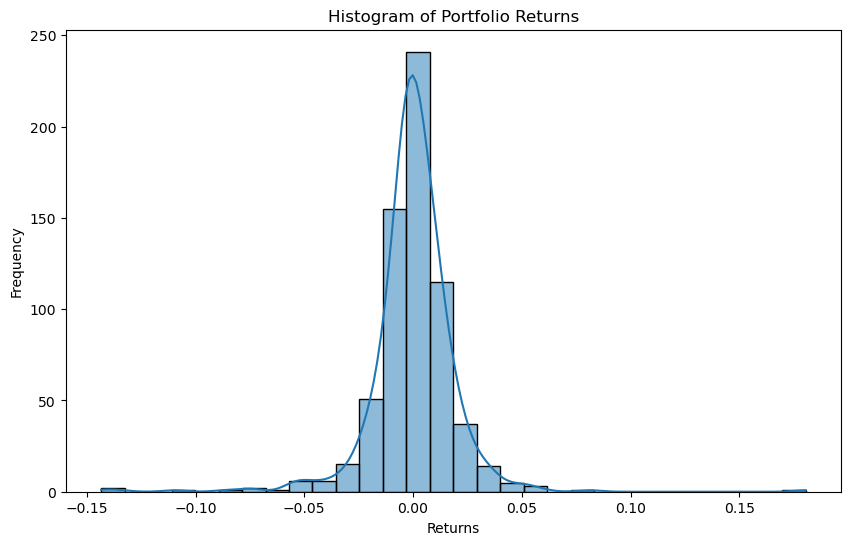

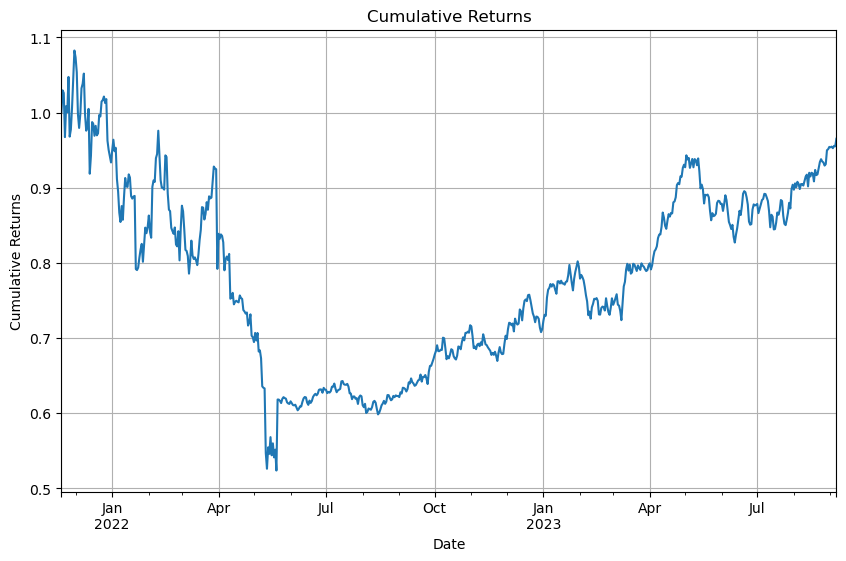

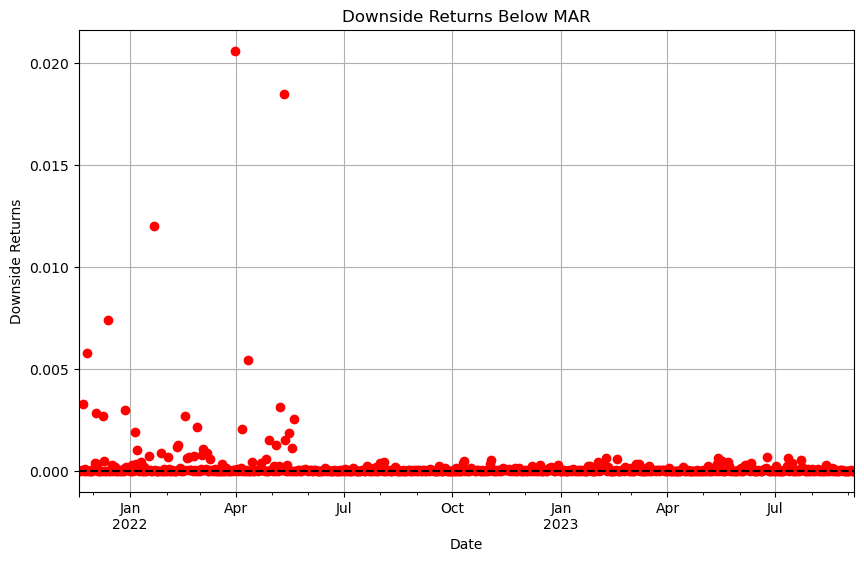

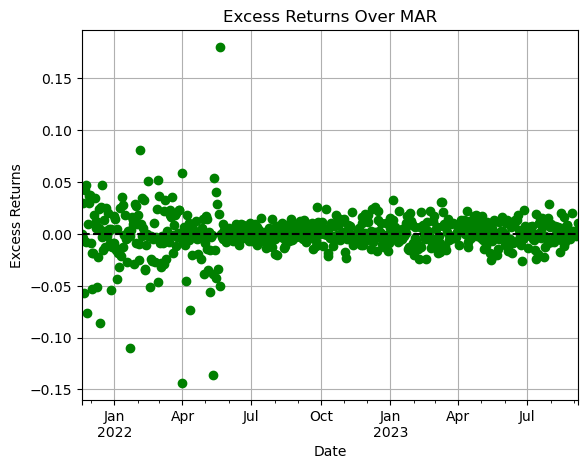

Sortino ratio: -0.23636015368511043
Scaled Sortino diff: 4.091844894146935e-05
reward -0.10278801296920684
Reward at the end of the cycle on 2023-09-06 00:00:00: -0.33918908510325874
Completed cycle up to 2023-09-06 00:00:00
Running simulation from 2023-09-07 00:00:00 to 2023-10-01 00:00:00
Cycle Number: 20, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.160018633240046
Desired adjustment -1.60018633240046
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.210018633240046, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.2692847257786673
Desired adjustment 2.692847257786673
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vault:

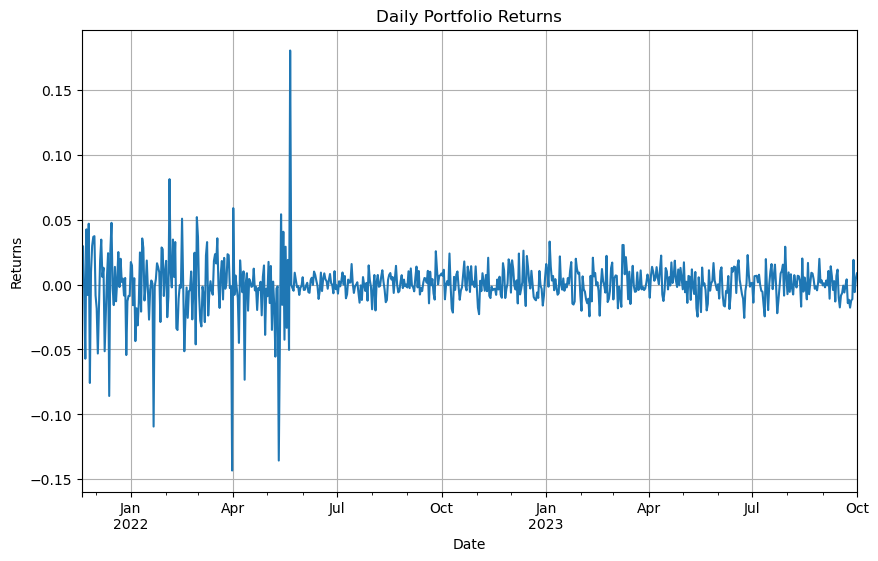

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


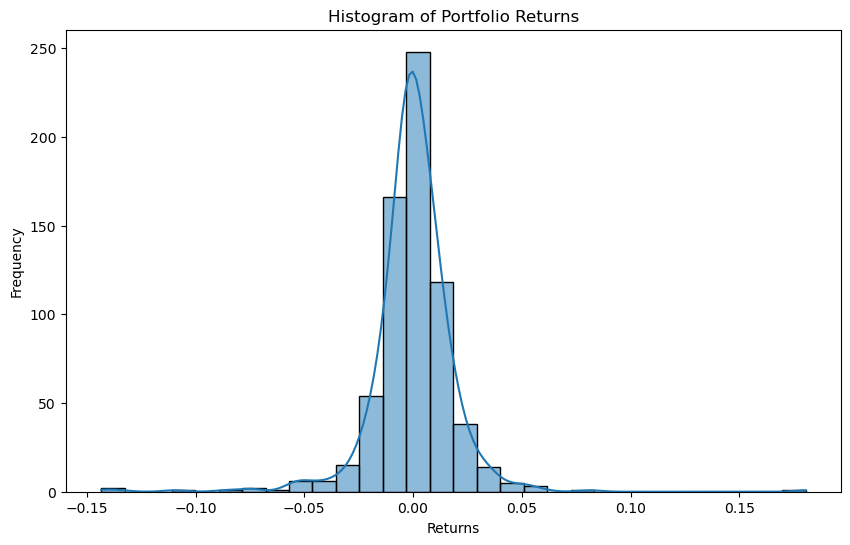

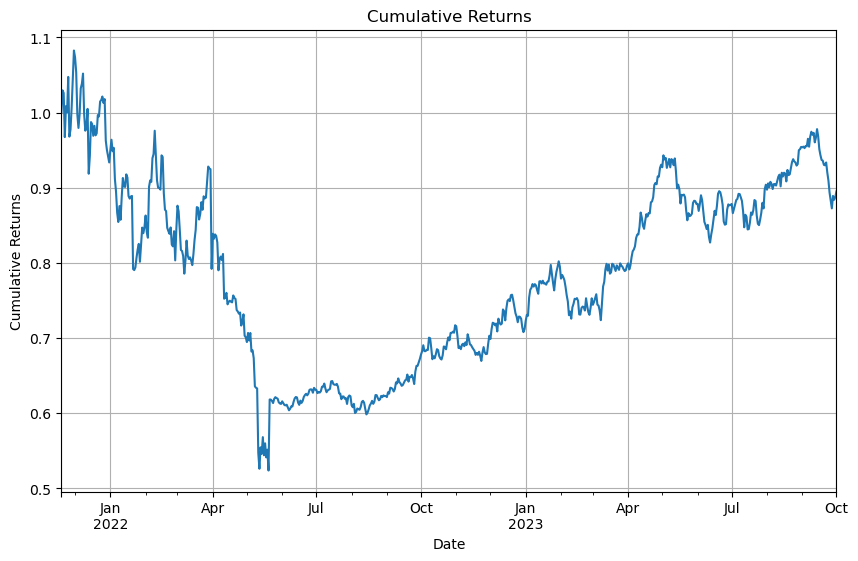

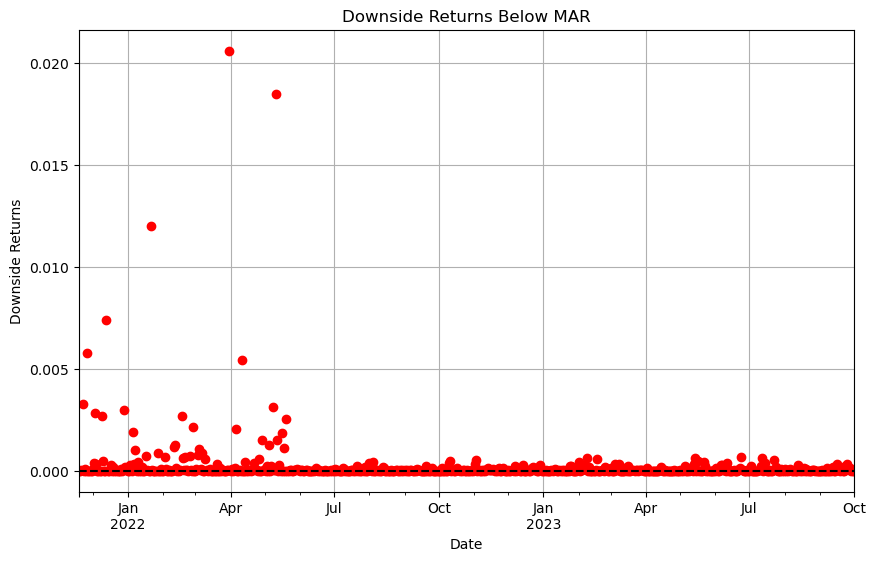

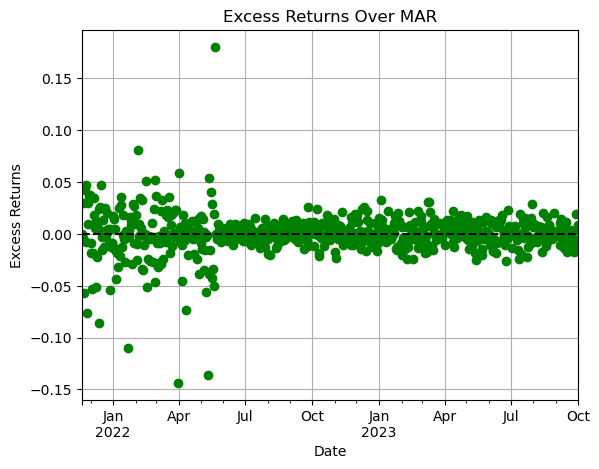

Sortino ratio: -0.3702400448728535
Scaled Sortino diff: 3.842464576210957e-05
reward -0.09486235395784791
Reward at the end of the cycle on 2023-10-01 00:00:00: -0.4651408234764635
Completed cycle up to 2023-10-01 00:00:00
Running simulation from 2023-10-02 00:00:00 to 2023-10-26 00:00:00
Cycle Number: 21, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.143401563637096
Desired adjustment -1.43401563637096
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.19340156363709599, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.24677931037045048
Desired adjustment 2.467793103704505
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
Vault

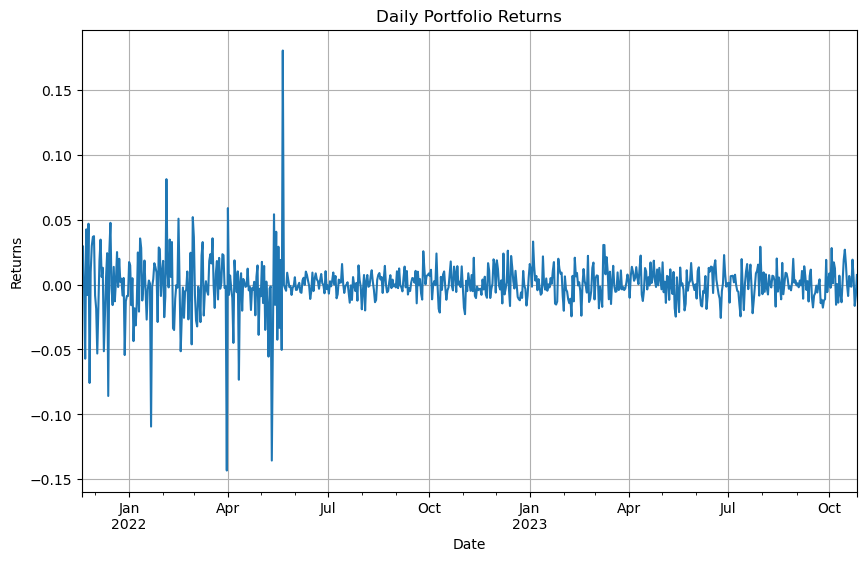

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


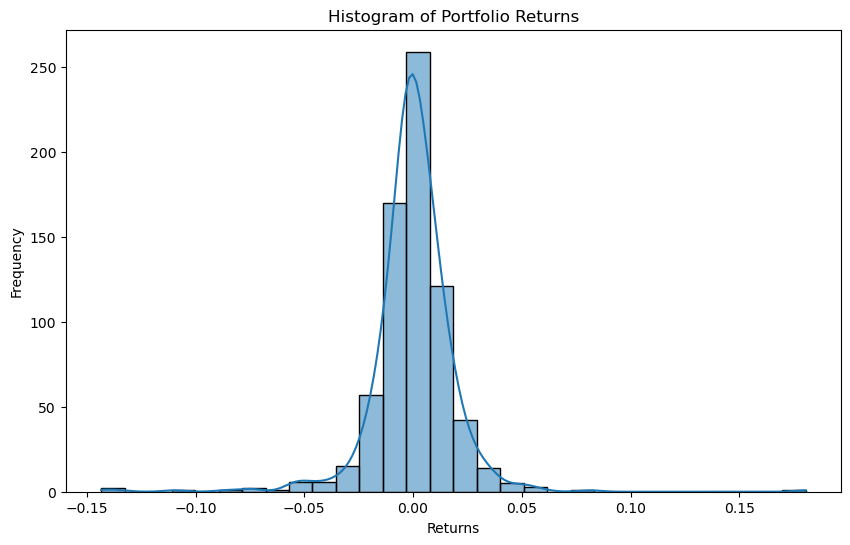

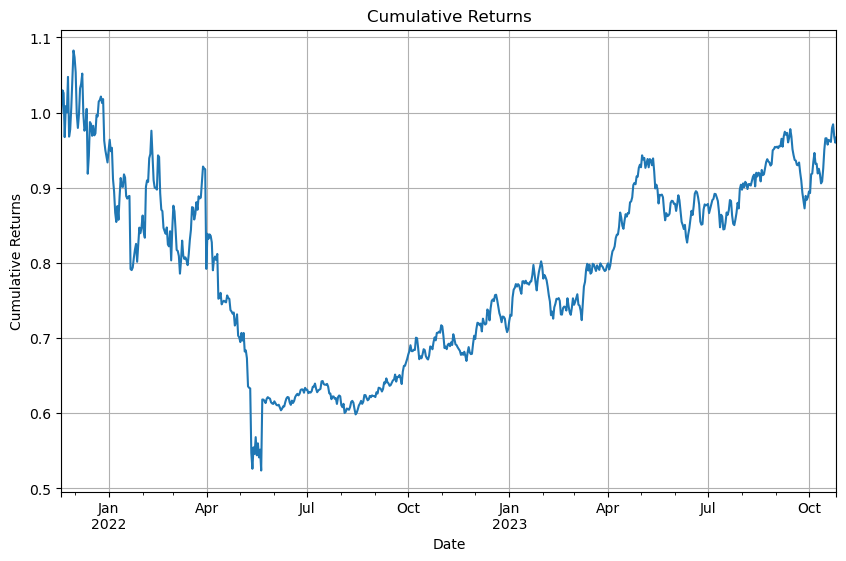

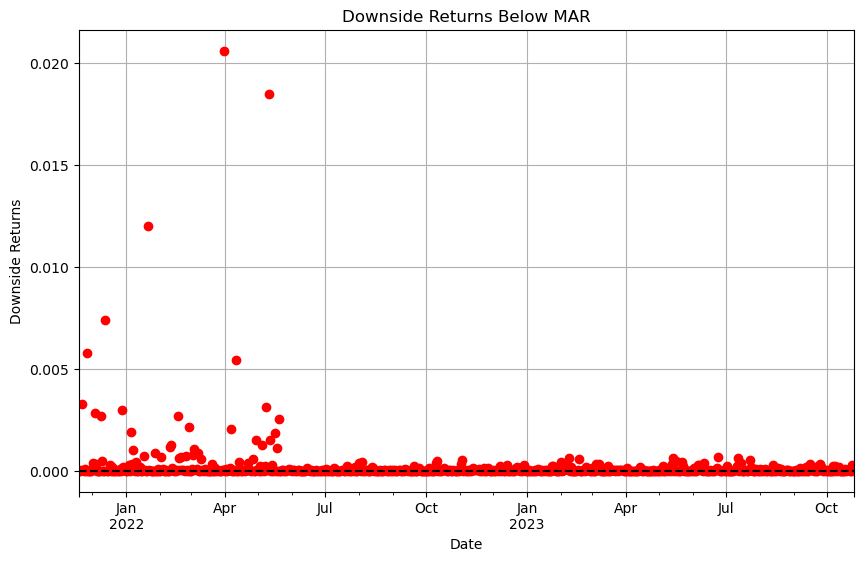

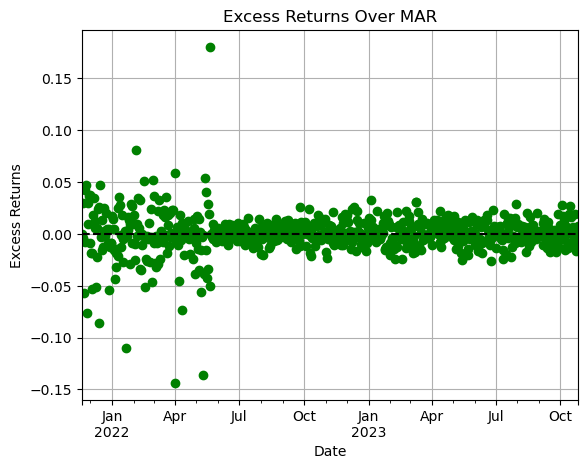

Sortino ratio: -0.2343803212020921
Scaled Sortino diff: 3.766536013222737e-05
reward -0.09017816737974987
Reward at the end of the cycle on 2023-10-26 00:00:00: -0.32459615394197416
Completed cycle up to 2023-10-26 00:00:00
Running simulation from 2023-10-27 00:00:00 to 2023-11-20 00:00:00
Cycle Number: 22, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000005804
weight difference -0.1458567795227353
Desired adjustment -1.4585677952273528
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.19585677952279335, Target: 0.05000000000005804, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.499999999999969
weight difference 0.235783332809626
Desired adjustment 2.35783332809626
adjustment scale 10
legal adjustments [-1, -0.5, -0.2

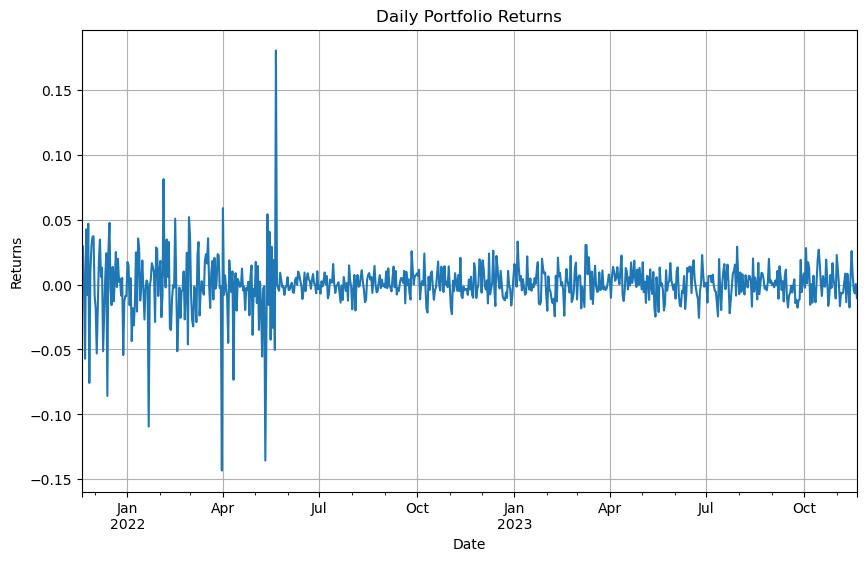

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


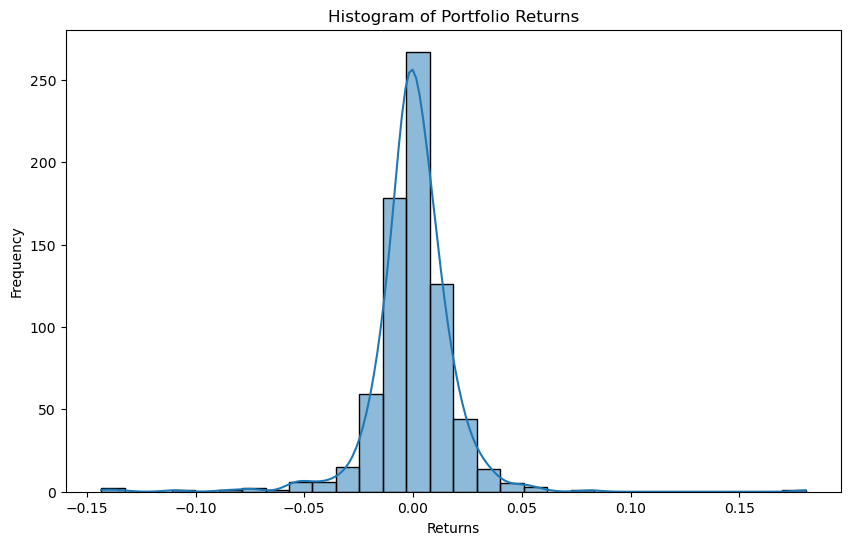

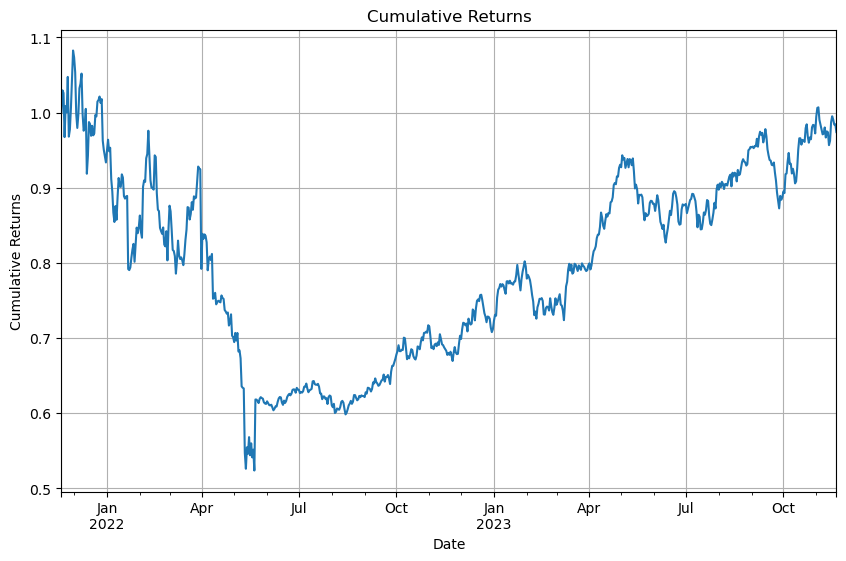

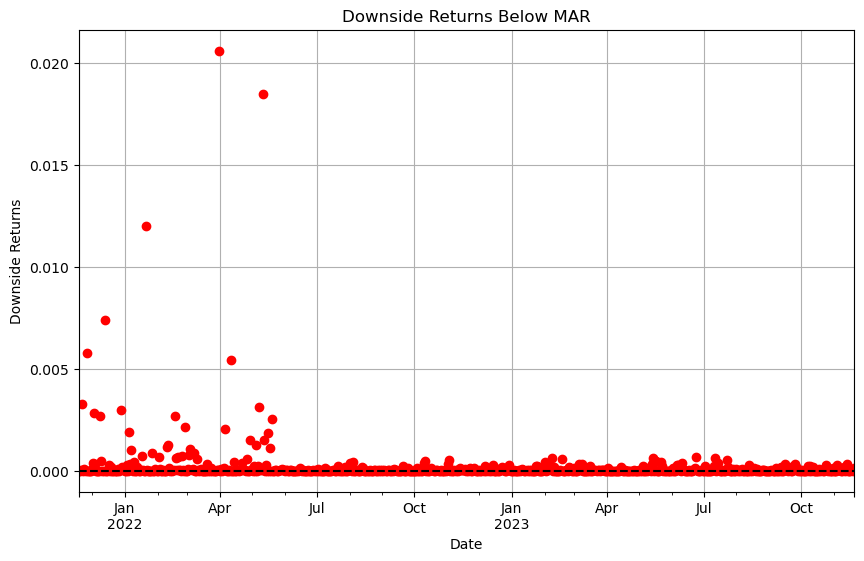

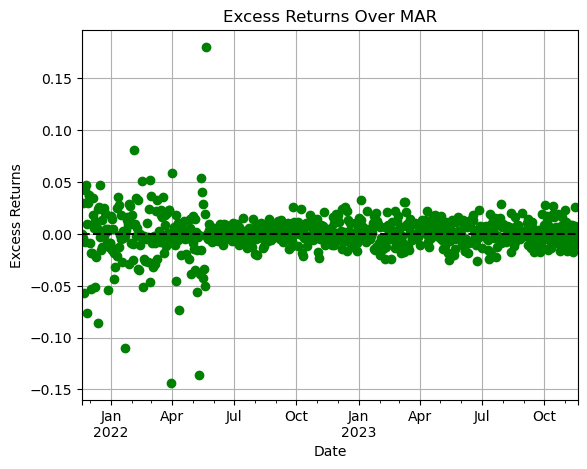

Sortino ratio: -0.22276520352173992
Scaled Sortino diff: 3.517248283589316e-05
reward -0.08526368571295881
Reward at the end of the cycle on 2023-11-20 00:00:00: -0.30806406171753464
Completed cycle up to 2023-11-20 00:00:00
Running simulation from 2023-11-21 00:00:00 to 2023-12-15 00:00:00
Cycle Number: 23, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.1420848862727503
Desired adjustment -1.4208488627275029
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.1920848862727503, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.21313797970321652
Desired adjustment 2.131379797032165
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.5
V

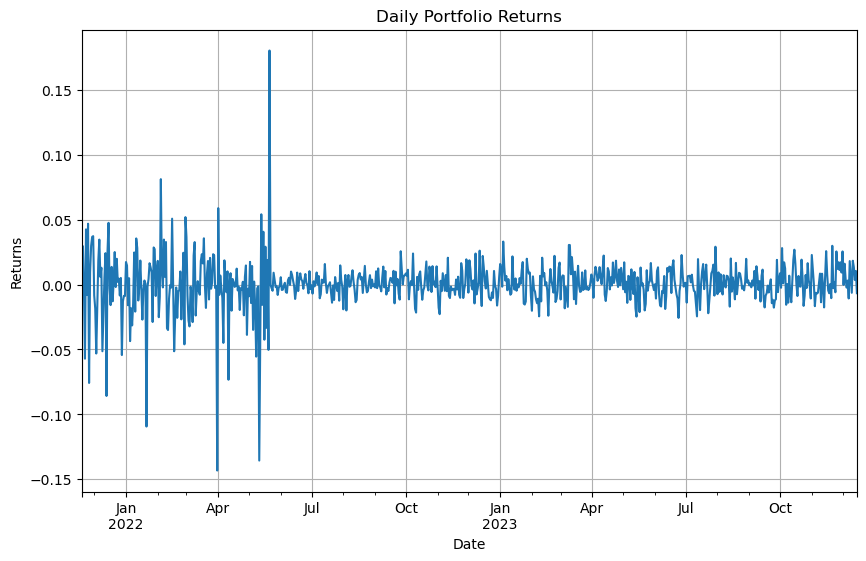

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


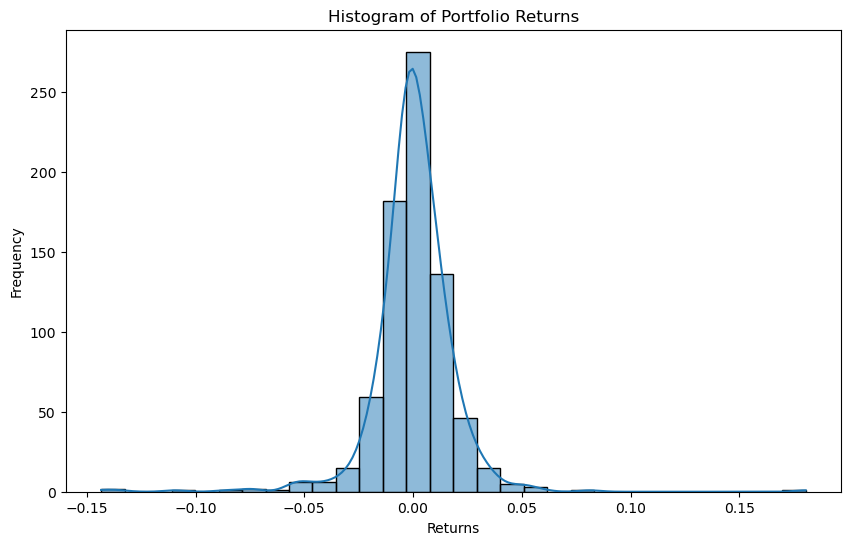

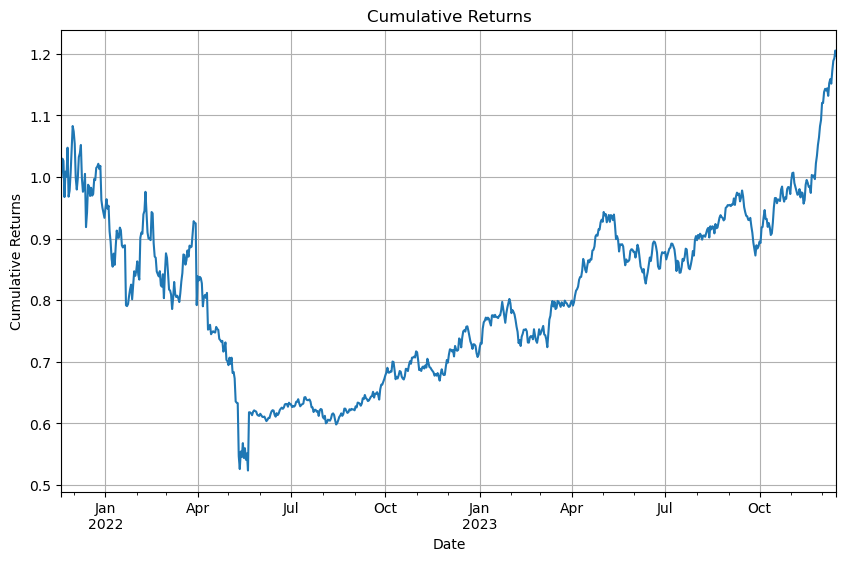

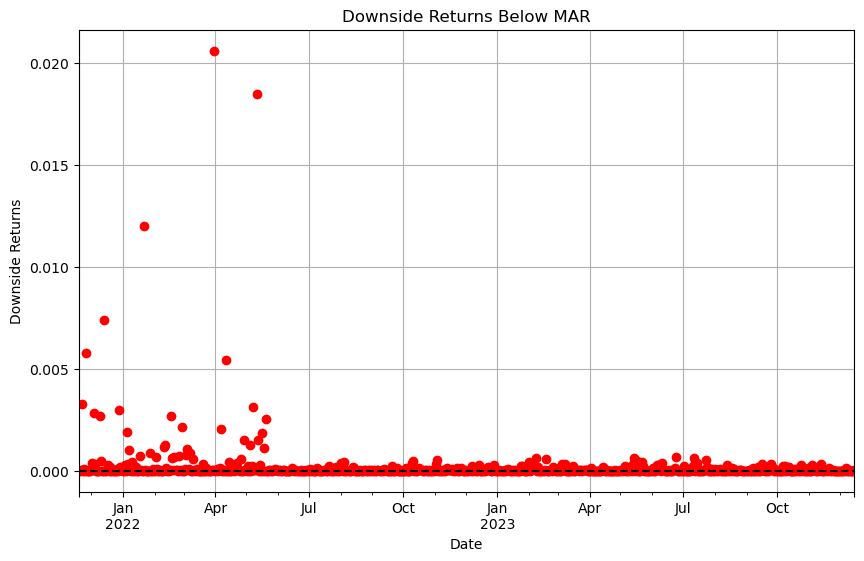

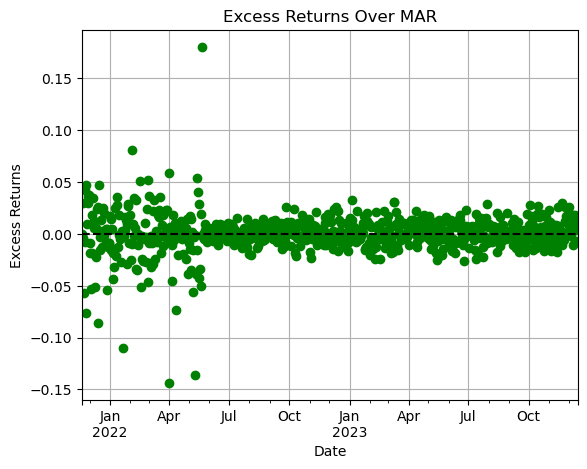

Sortino ratio: 0.14576278241783974
Scaled Sortino diff: 3.3994941806367655e-05
reward -0.08733103690682358
Reward at the end of the cycle on 2023-12-15 00:00:00: 0.0583977505692098
Completed cycle up to 2023-12-15 00:00:00
Running simulation from 2023-12-16 00:00:00 to 2024-01-09 00:00:00
Cycle Number: 24, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.0500000000000663
weight difference -0.15471335700873523
Desired adjustment -1.5471335700873523
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.20471335700880153, Target: 0.0500000000000663, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999996025
weight difference 0.2187408562811055
Desired adjustment 2.187408562811055
adjustment scale 10
legal adjustments [-1, -0.5, -0

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scip

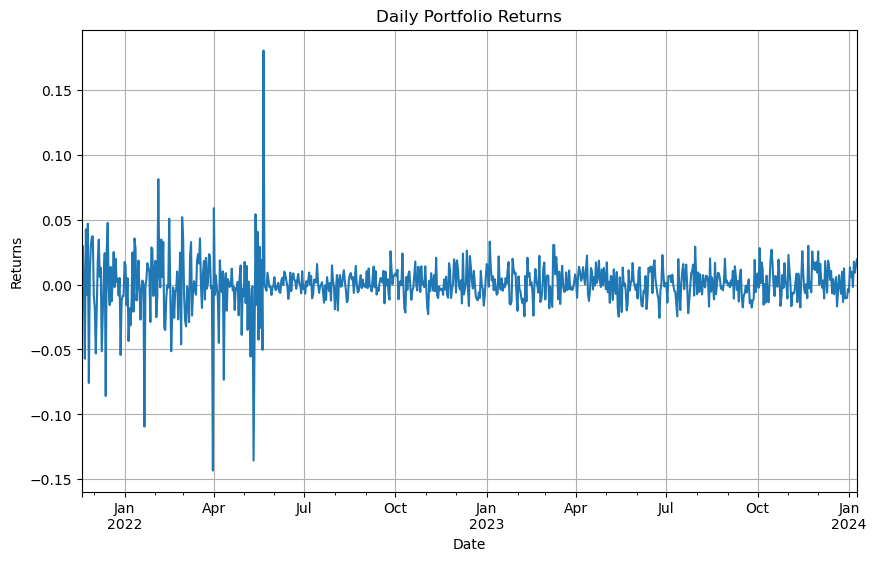

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


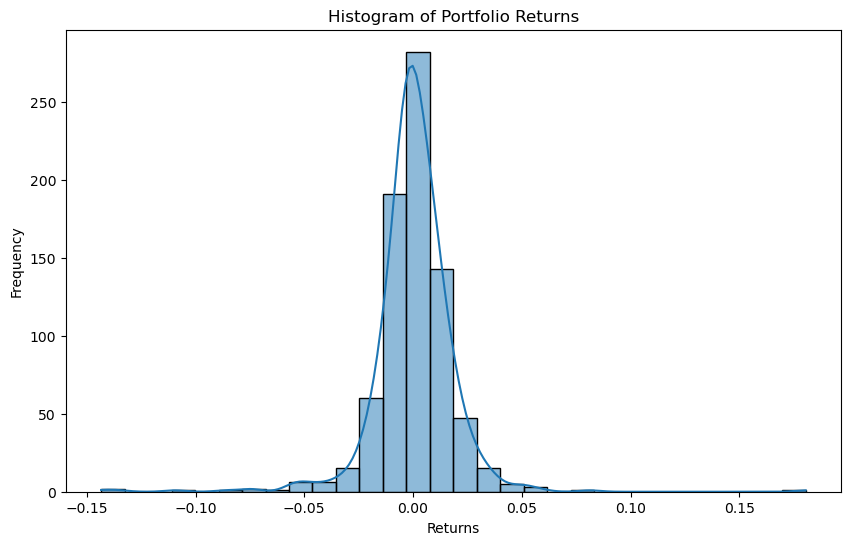

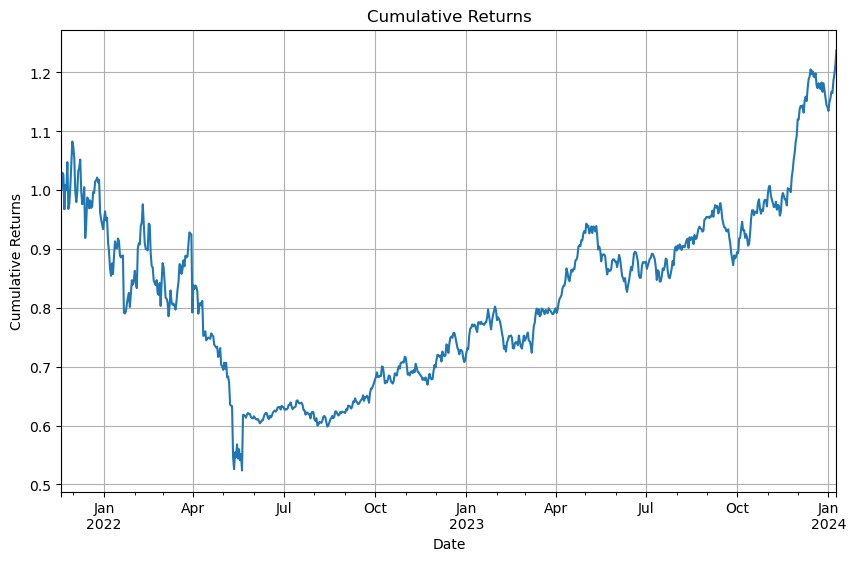

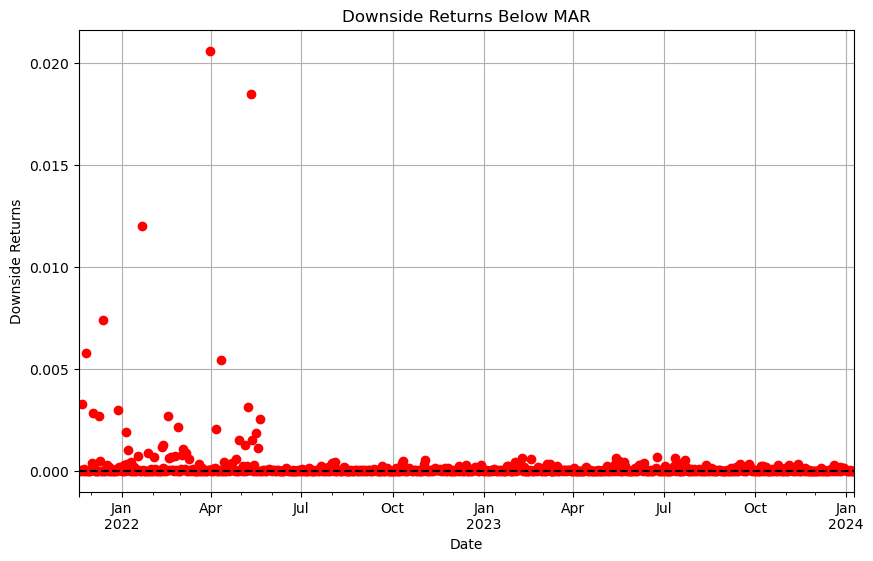

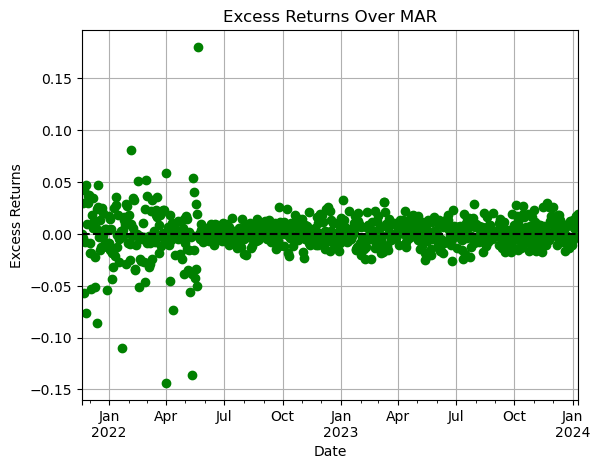

Sortino ratio: 0.1979073891933115
Scaled Sortino diff: 3.157862960790593e-05
reward -0.08438094277779537
Reward at the end of the cycle on 2024-01-09 00:00:00: 0.11349486778590821
Completed cycle up to 2024-01-09 00:00:00
Running simulation from 2024-01-10 00:00:00 to 2024-02-03 00:00:00
Cycle Number: 25, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000000276
weight difference -0.14497922959937426
Desired adjustment -1.4497922959937426
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.19497922959937702, Target: 0.05000000000000276, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999973
weight difference 0.20298656546629734
Desired adjustment 2.0298656546629736
adjustment scale 10
legal adjustments [-1, -0.5, 

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scip

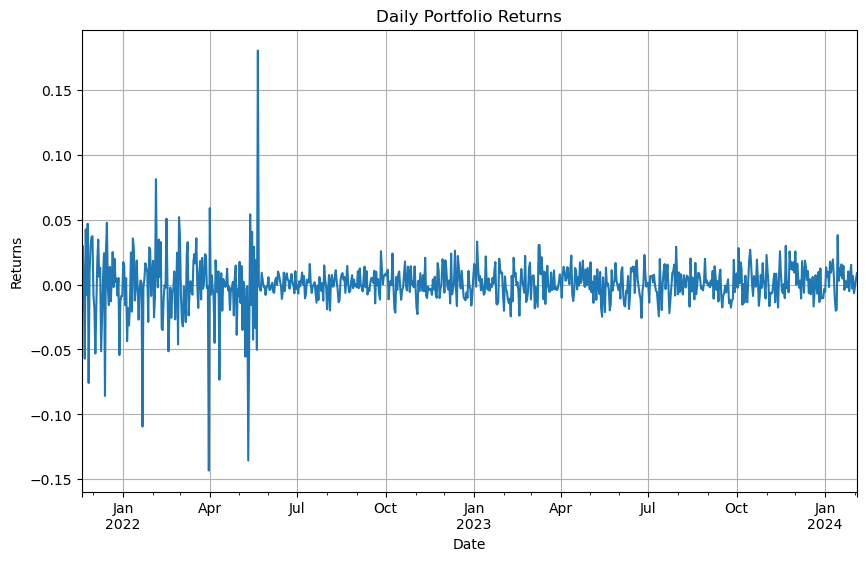

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


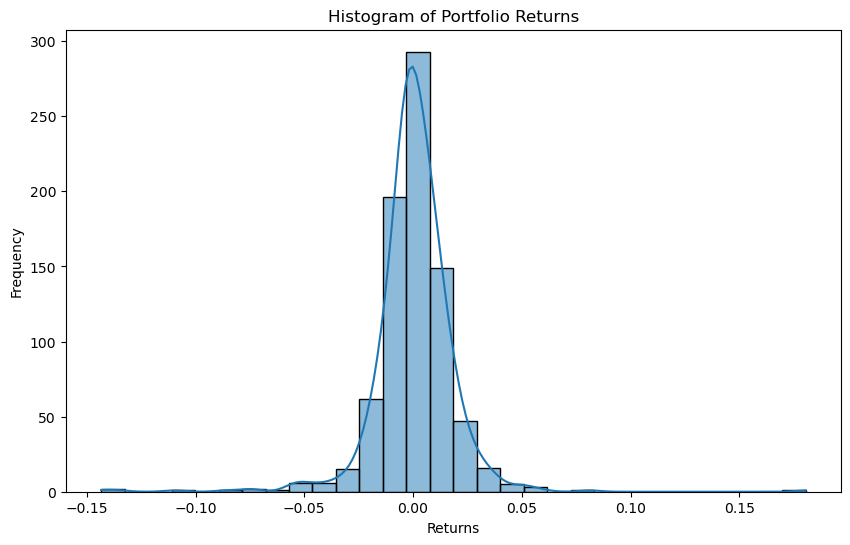

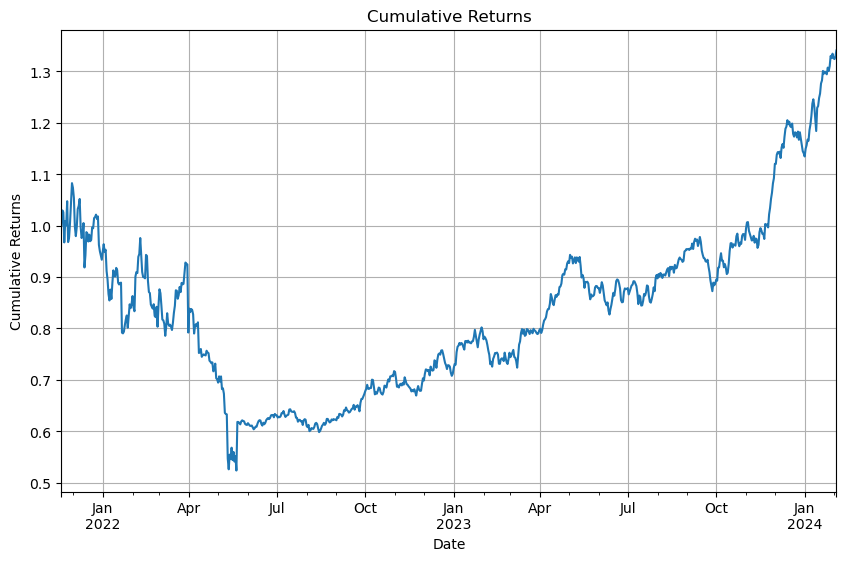

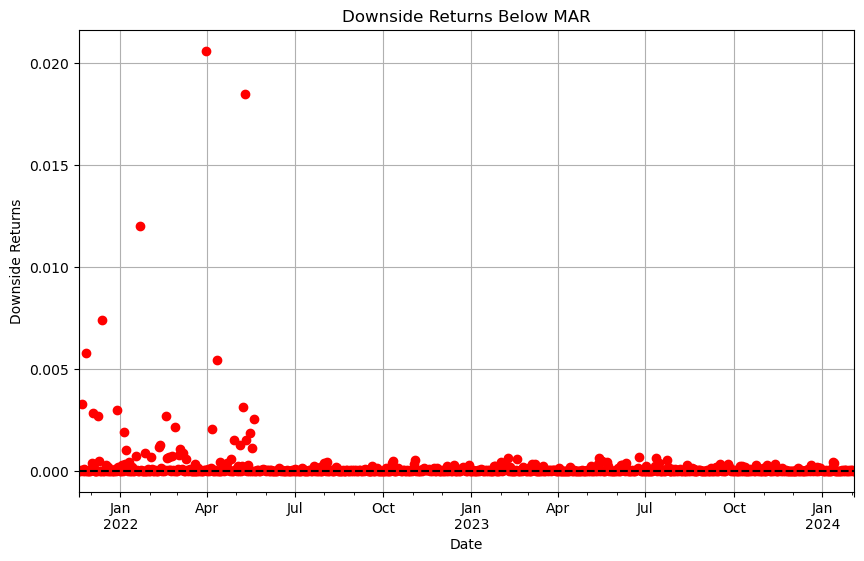

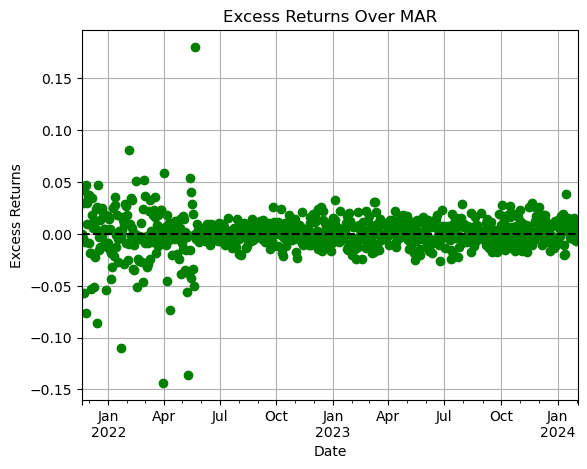

Sortino ratio: 0.3377813357435776
Scaled Sortino diff: 2.9652002710609874e-05
reward -0.08048490461286667
Reward at the end of the cycle on 2024-02-03 00:00:00: 0.25726677912800033
Completed cycle up to 2024-02-03 00:00:00
Running simulation from 2024-02-04 00:00:00 to 2024-02-28 00:00:00
Cycle Number: 26, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000004521
weight difference -0.14354494803389742
Desired adjustment -1.4354494803389741
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.19354494803394262, Target: 0.05000000000004521, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999998407
weight difference 0.18855965495663618
Desired adjustment 1.8855965495663618
adjustment scale 10
legal adjustments [-1, -0.5

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scip

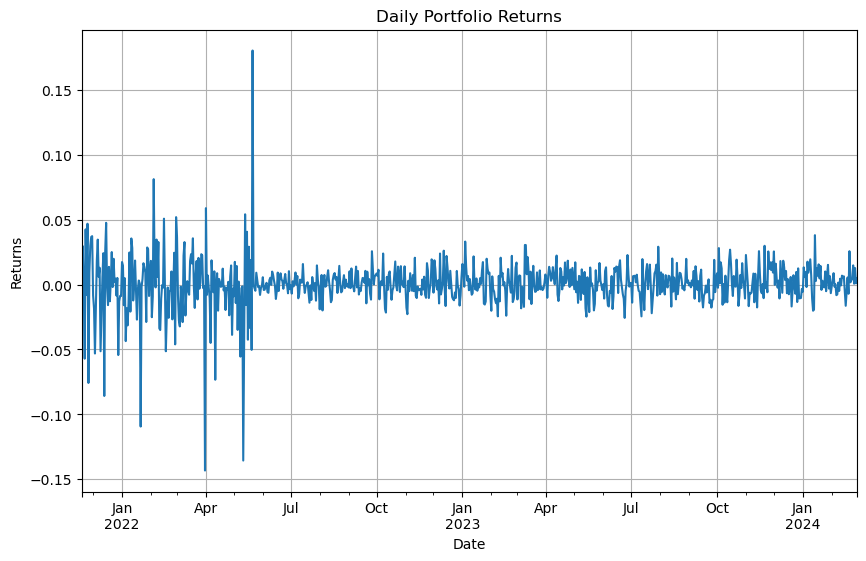

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


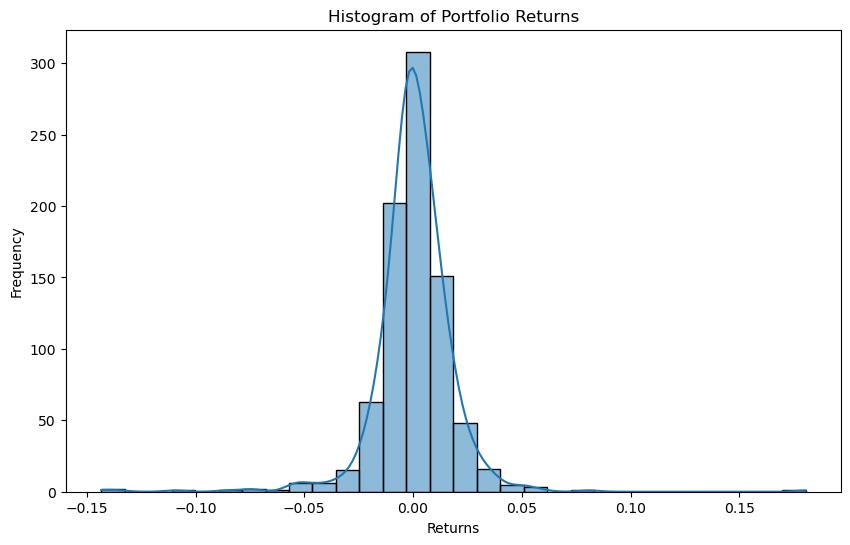

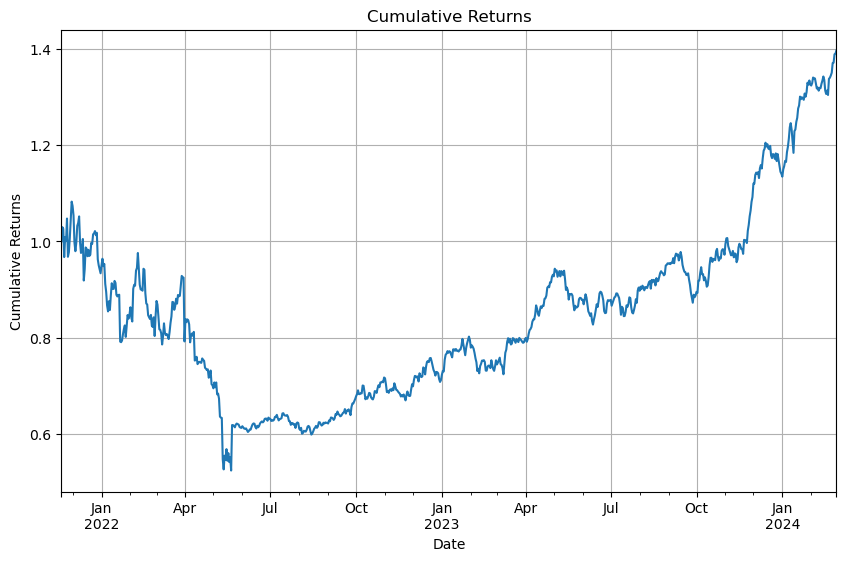

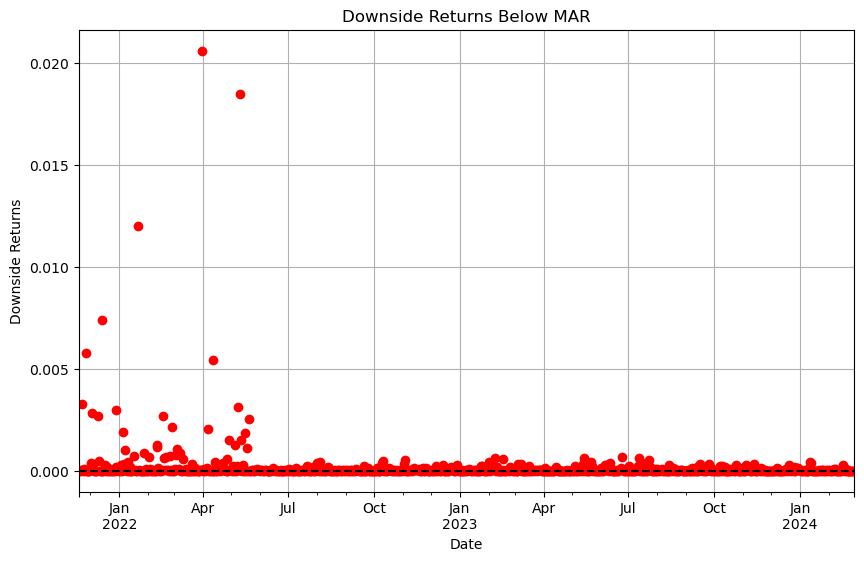

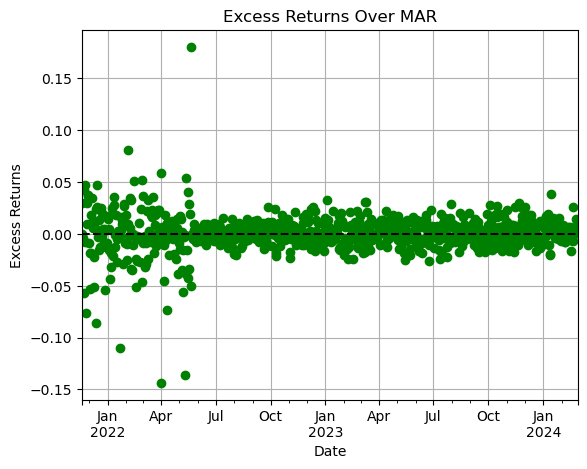

Sortino ratio: 0.4024953281829155
Scaled Sortino diff: 2.8163244424975276e-05
reward -0.07200856791129148
Reward at the end of the cycle on 2024-02-28 00:00:00: 0.33045859702719904
Completed cycle up to 2024-02-28 00:00:00
Running simulation from 2024-02-29 00:00:00 to 2024-03-20 00:00:00
Cycle Number: 27, Epsilon: 1.0
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.13703808393213146
Desired adjustment -1.3703808393213146
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.25
Vault: ETH Vault_collateral_usd, Current: 0.18703808393213145, Target: 0.05, Adjustment: -1.25
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.16015722809759303
Desired adjustment 1.6015722809759303
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adjustment 0.

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


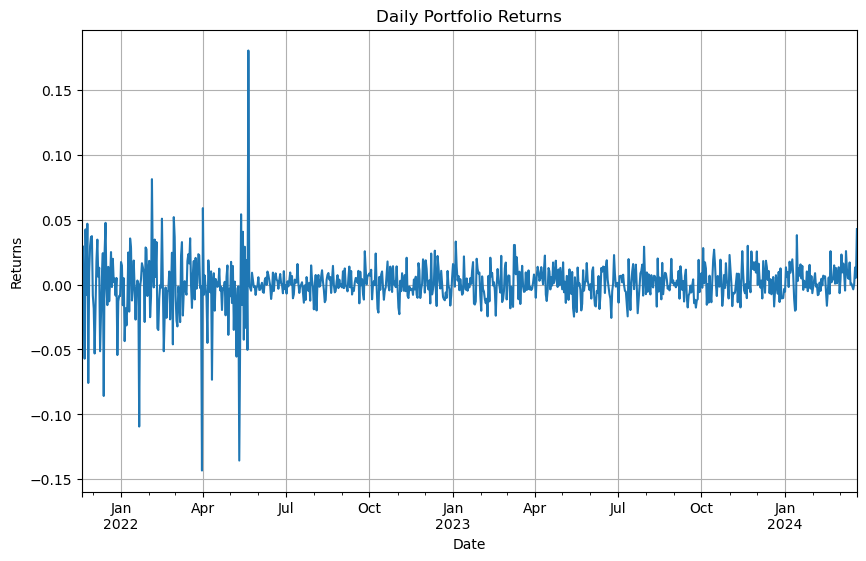

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


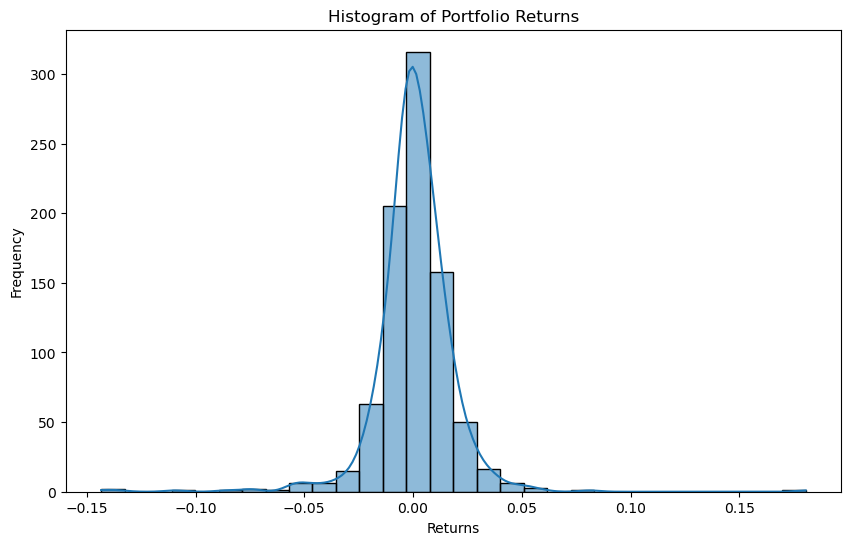

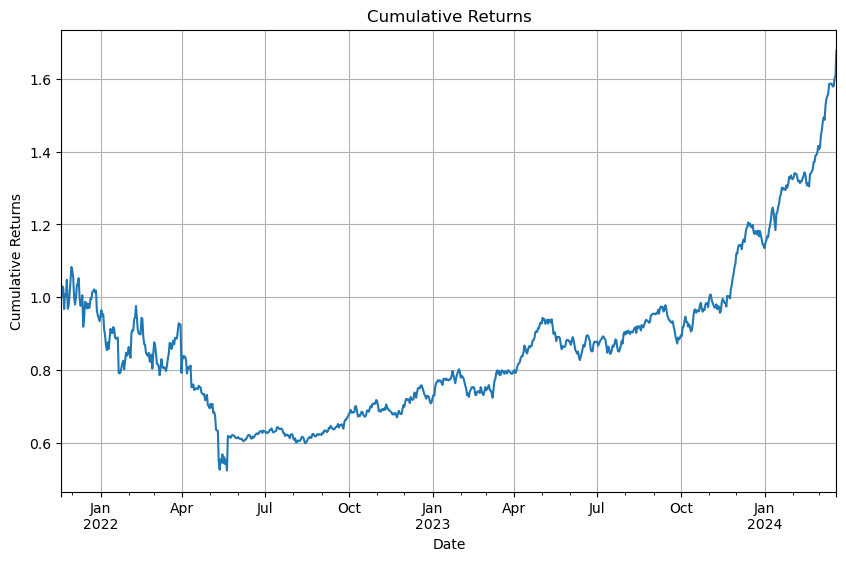

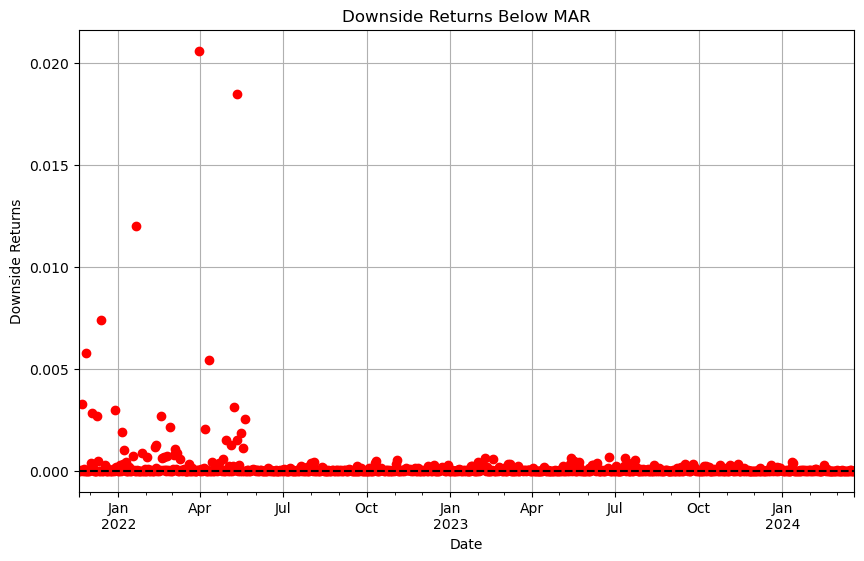

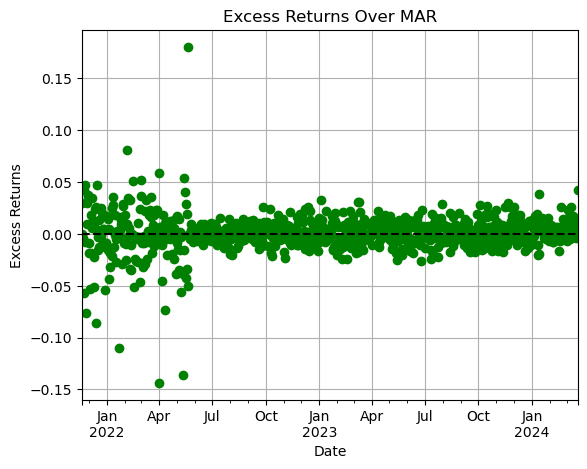

Sortino ratio: 0.7469920322338229
Scaled Sortino diff: 2.4918368520550905e-05
reward -0.07601977633797061
Reward at the end of the cycle on 2024-03-20 00:00:00: 0.6709473375273318
Reached or passed end date: stopping simulation at 2024-03-21 00:00:00


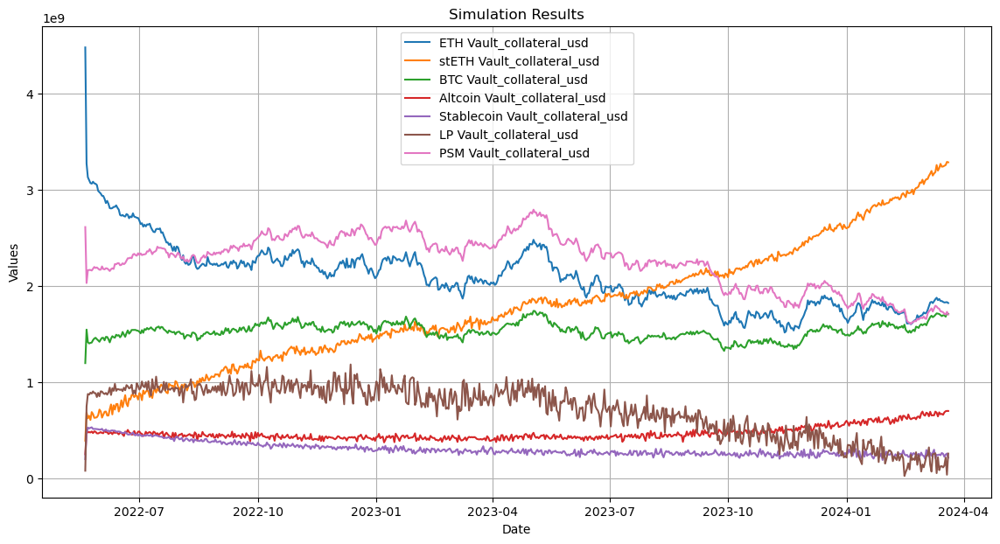

In [900]:
# Define action space as a list of dictionaries
vault_action_ranges = {
    'stETH Vault_dai_ceiling': [-1, -0.5, -0.25, 0, 0.25, 0.5],  # Larger steps due to higher volatility or other reasons
    'ETH Vault_dai_ceiling': [-1.5, -1.25,-1,-0.5,-0.25, 0, 0.25],
    'BTC Vault_dai_ceiling': [-1, -0.5, -0.25, 0, 0.25],
    'Altcoin Vault_dai_ceiling': [-2, -1, -0.25, 0, 0.25],  # Simpler adjustments
    'Stablecoin Vault_dai_ceiling': [0], # need so that agent logic does not decrease a ceiling already @ 0
    'LP Vault_dai_ceiling': [-0.25, 0, 0.25],
    'RWA Vault_dai_ceiling': [0],
    'PSM Vault_dai_ceiling': [-1, -0.5, 0, 0.5]
}
action_space = generate_action_space(vault_action_ranges)

# Assuming `optimized_weight_dict` and `initial_weights` are defined elsewhere in your script
agent = MVOAgent(action_space, optimized_weight_dict, vault_action_ranges, initial_strategy_period=1)
initial_action = agent.initial_strategy(initial_weights)

print("Initial Action Computed:", initial_action)


simulation_data = test_data_copy  
#05-20-2022
start_date = '2022-05-20'
end_date = '2024-03-20'
#end_date = '2022-07-20'

simulator = RL_VaultSimulator(simulation_data, test_data_copy, features, targets, temporals, start_date, end_date, scale_factor=300000000, minimum_value_factor=0.05, volatility_window=250)

simulator.train_model()

environment = SimulationEnvironment(simulator, start_date, end_date, agent)
environment.reset()

state, reward, done, info = environment.run()

simulator.plot_simulation_results()
action_df = environment.generate_action_dataframe()

mvo_sim_results = simulator.results

### Q Sim

test_simulator = RL_VaultSimulator(simulator_simulation_data, test_data_copy, features, targets, temporals, start_date, end_date)
test_simulator.train_model()

test_environment = SimulationEnvironment(test_simulator, start_date, end_date)
test_environment.run(actions)

test_simulator.plot_simulation_results()


Calculating initial strategy...
items in state dict_items([('BTC Vault_collateral_usd', 0.1131354019508382), ('ETH Vault_collateral_usd', 0.48043492548500283), ('stETH Vault_collateral_usd', 0.03387400765933107), ('Stablecoin Vault_collateral_usd', 0.025435560745005616), ('Altcoin Vault_collateral_usd', 0.031155567995268595), ('LP Vault_collateral_usd', 0.0276946278356852), ('RWA Vault_collateral_usd', 0.005535616134052087), ('PSM Vault_collateral_usd', 0.2827342921948164)])
vault BTC Vault_collateral_usd
simplified vault name initial strategy BTC Vault_dai_ceiling
vault BTC Vault_collateral_usd
vault BTC Vault_dai_ceiling
target weights in calc 0.10000000000001205
weight difference -0.013135401950826145
Desired adjustment -0.13135401950826145
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25]
closest adjustment -0.25
Vault: BTC Vault_collateral_usd,'simplified vault initial strategy BTC Vault_dai_ceiling, Current: 0.1131354019508382, Target: 0.10000000000001205, Adjustme

C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\site-packages\sklearn\linear_model\_ridge.py:216: LinAlgWarning: Ill-conditioned matrix (rcond=1.79588e-22): result may not be accurate.
  return linalg.solve(A, Xy, assume_a="pos", overwrite_a=True).T
C:\Users\brandyns pc\anacondareal\Lib\si

current state ETH Vault_collateral_usd                 3,190,083,384.21404
stETH Vault_collateral_usd                 706,478,899.96710
BTC Vault_collateral_usd                 1,507,784,673.95050
Altcoin Vault_collateral_usd               492,689,572.63951
Stablecoin Vault_collateral_usd            465,339,722.68267
                                                 ...        
Stablecoin Vault_collateral_usd_30d_ma     240,761,509.80674
LP Vault_collateral_usd_30d_ma             180,719,320.17650
PSM Vault_collateral_usd_30d_ma          3,373,566,436.14872
RWA Vault_collateral_usd_30d_ma             50,870,409.00000
RWA Vault_prev_dai_ceiling                  59,000,000.00000
Name: 2022-05-21 00:00:00, Length: 85, dtype: float64
vault stETH Vault_dai_ceiling
Applying action to: stETH Vault_dai_ceiling
Simulator Adjusted stETH Vault_dai_ceiling by -0.25% from 149440485.75085515 to 149066884.536478
vault ETH Vault_dai_ceiling
Applying action to: ETH Vault_dai_ceiling
Simulator Adjusted E

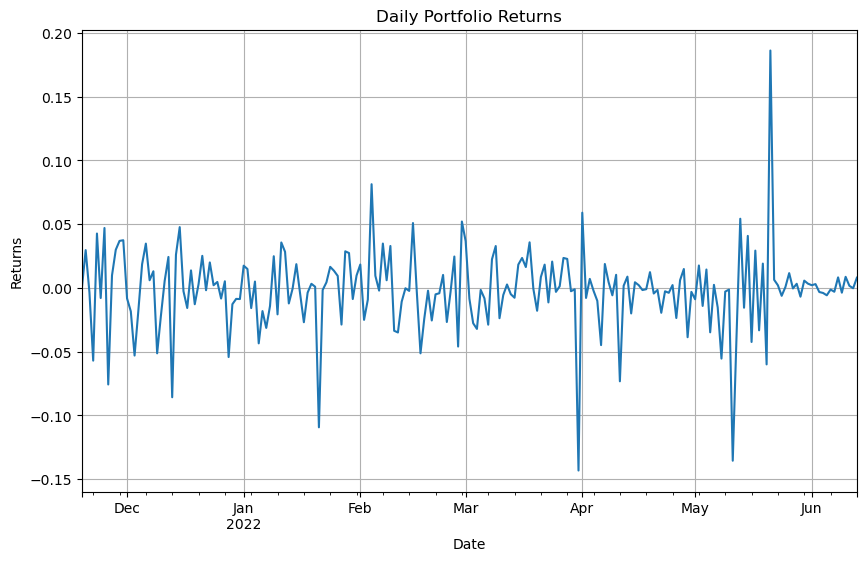

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


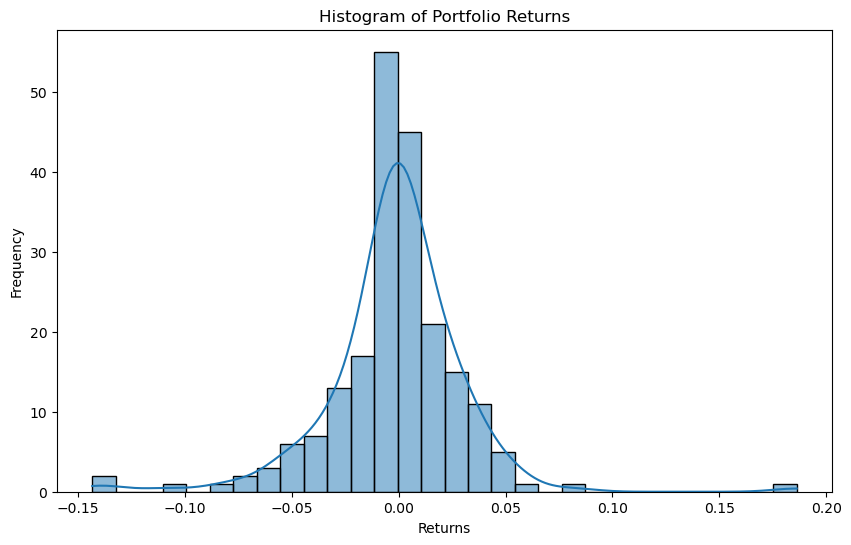

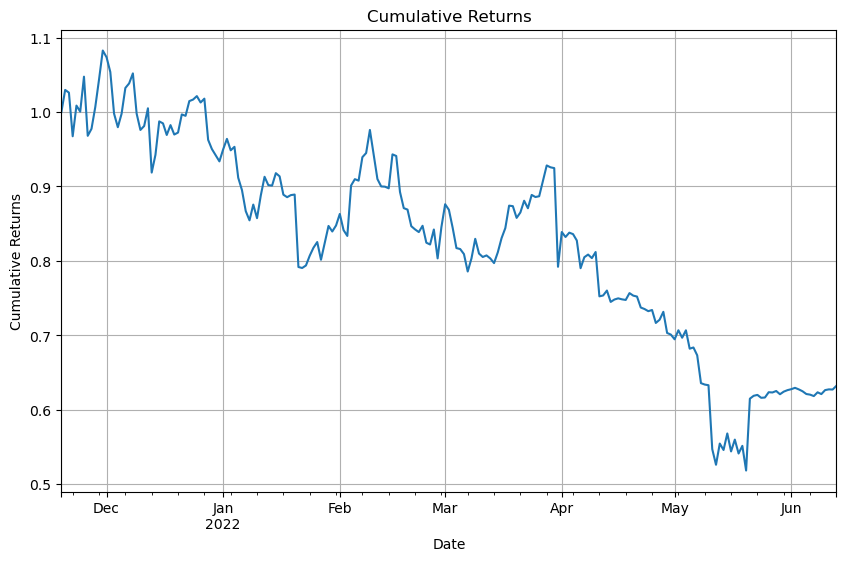

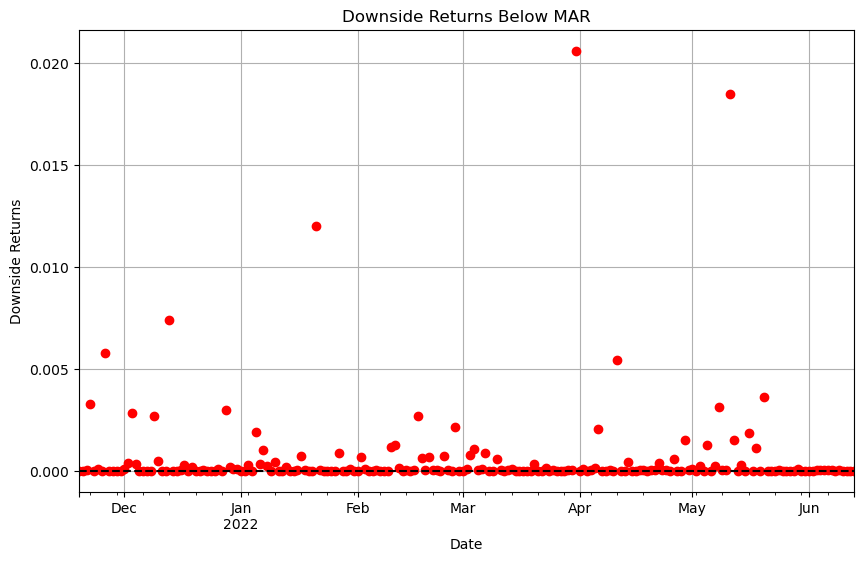

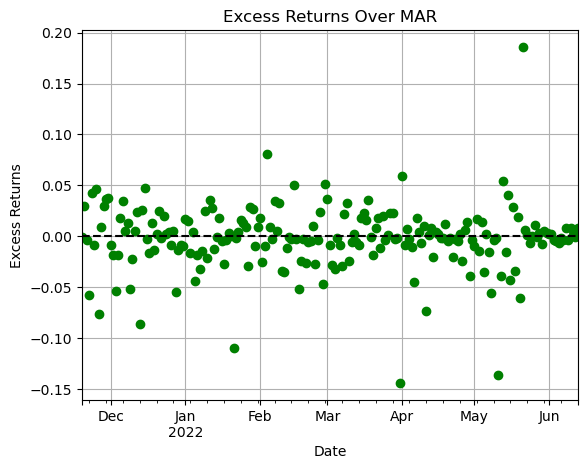

Sortino ratio: -1.2405591555841884
Scaled Sortino diff: 0.000130506263087167
reward -0.1371383202230193
Reward at the end of the cycle on 2022-06-13 00:00:00: -1.3778279820702948
Completed cycle up to 2022-06-13 00:00:00
Running simulation from 2022-06-14 00:00:00 to 2022-07-08 00:00:00
Cycle Number: 2, Epsilon: 0.855
State: {'ETH Vault_collateral_usd': 0.33731132715554935, 'stETH Vault_collateral_usd': 0.08155556763566517, 'BTC Vault_collateral_usd': 0.1389830390570015, 'Altcoin Vault_collateral_usd': 0.04598994972520391, 'Stablecoin Vault_collateral_usd': 0.05328528842573443, 'LP Vault_collateral_usd': 0.10805708332913336, 'PSM Vault_collateral_usd': 0.23481774467171243}
Chosen Action: {'stETH Vault_dai_ceiling': -0.5, 'ETH Vault_dai_ceiling': 0.25, 'BTC Vault_dai_ceiling': -0.25, 'Altcoin Vault_dai_ceiling': -2, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': 0}, Reason: exploration (random selection for wider state 

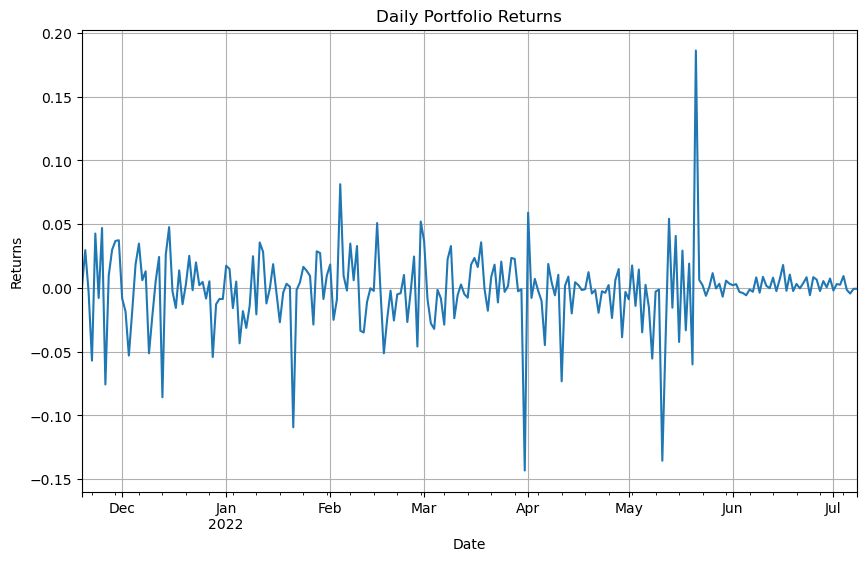

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


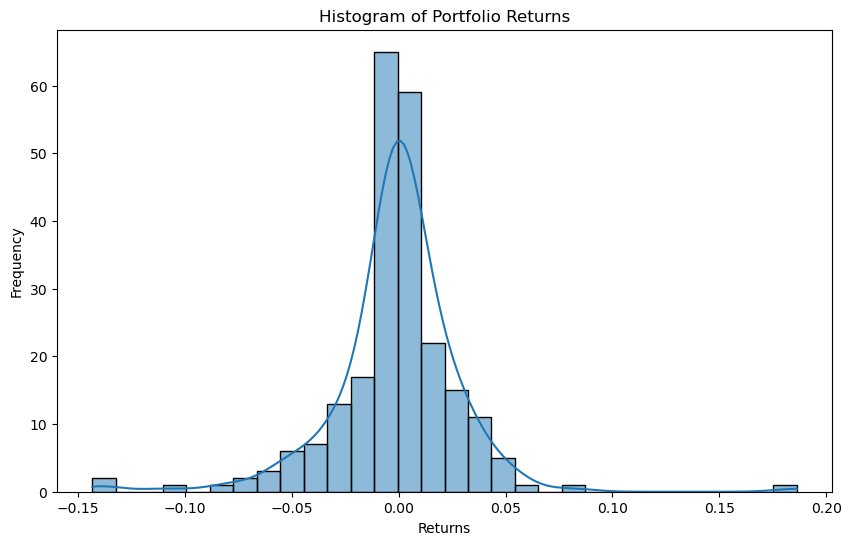

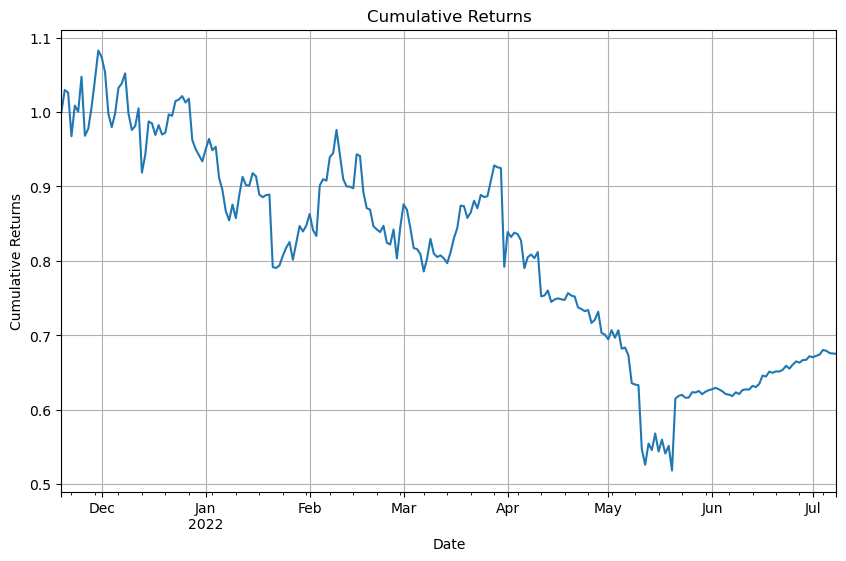

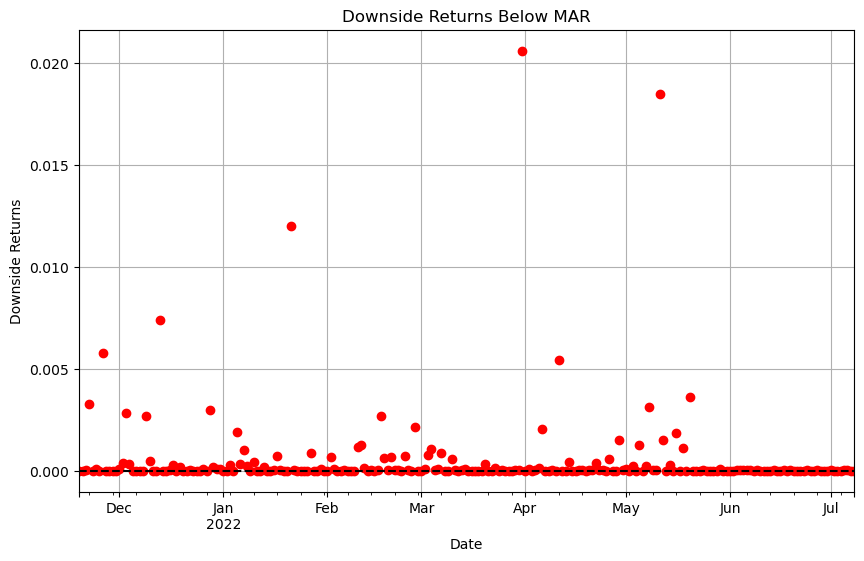

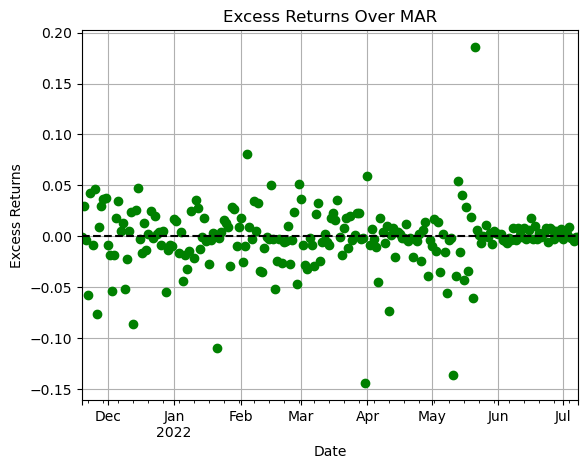

Sortino ratio: -1.1099268934409465
Scaled Sortino diff: 0.00011688728027447936
reward -0.1378226737651361
Reward at the end of the cycle on 2022-07-08 00:00:00: -1.2478664544863571
Completed cycle up to 2022-07-08 00:00:00
Running simulation from 2022-07-09 00:00:00 to 2022-08-02 00:00:00
Cycle Number: 3, Epsilon: 0.7716375
State: {'ETH Vault_collateral_usd': 0.33605511622766493, 'stETH Vault_collateral_usd': 0.08595744038142143, 'BTC Vault_collateral_usd': 0.13792522481791133, 'Altcoin Vault_collateral_usd': 0.03513138903511991, 'Stablecoin Vault_collateral_usd': 0.04678190235989391, 'LP Vault_collateral_usd': 0.11703093484255706, 'PSM Vault_collateral_usd': 0.24111799233543127}
Chosen Action: {'stETH Vault_dai_ceiling': -0.25, 'ETH Vault_dai_ceiling': -0.25, 'BTC Vault_dai_ceiling': -0.25, 'Altcoin Vault_dai_ceiling': -2, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0.25, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': 0.5}, Reason: exploration (random selection fo

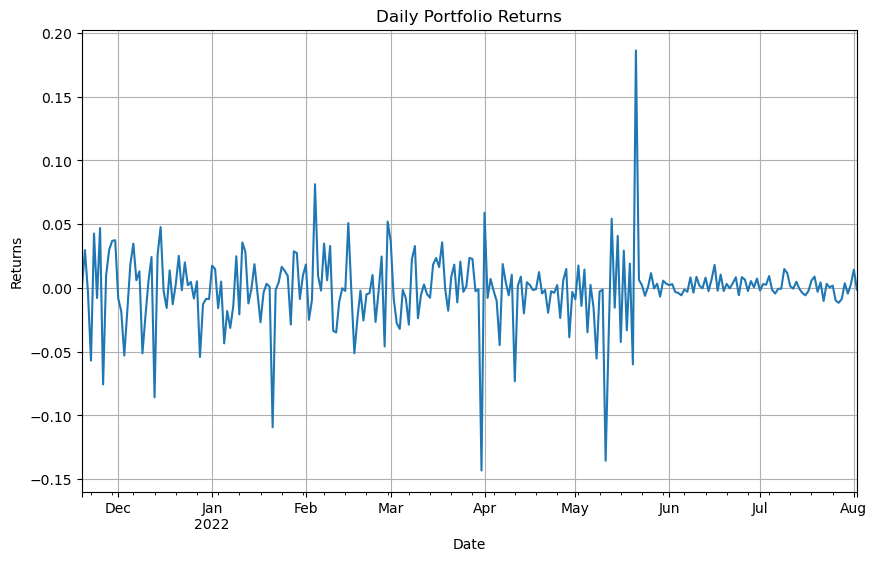

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


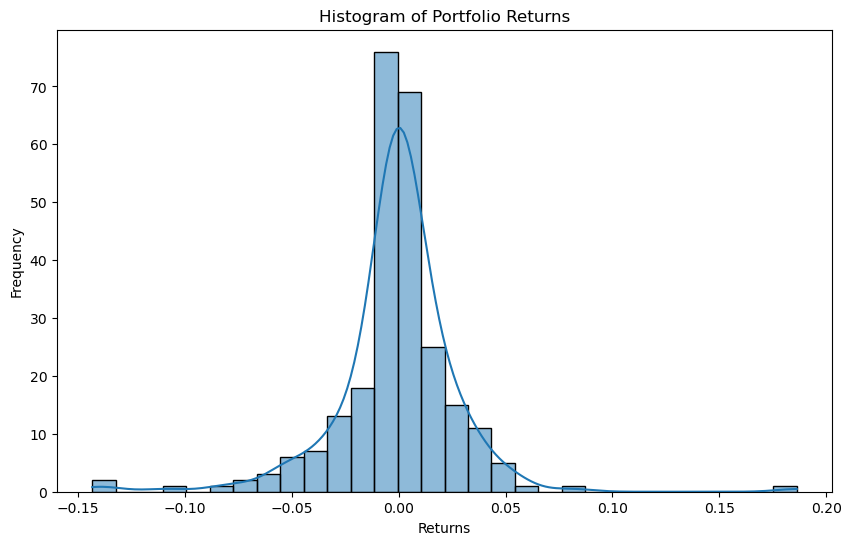

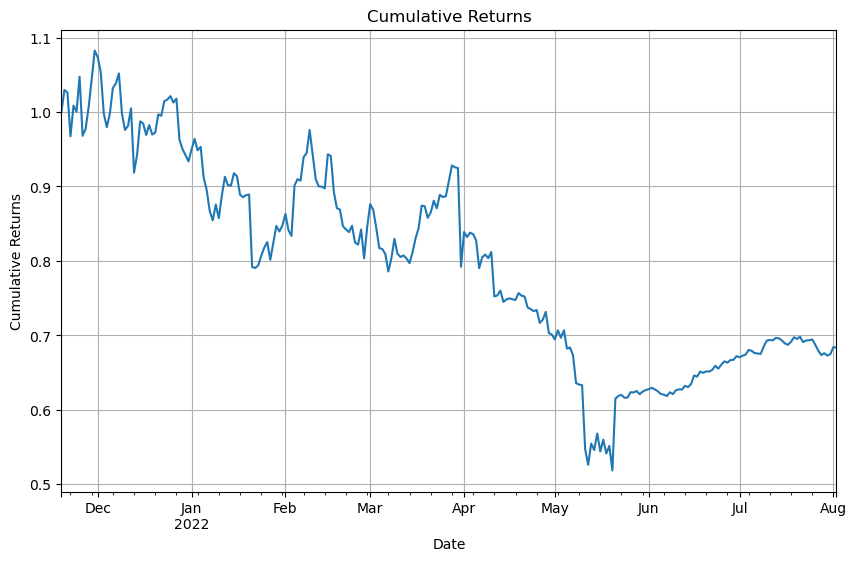

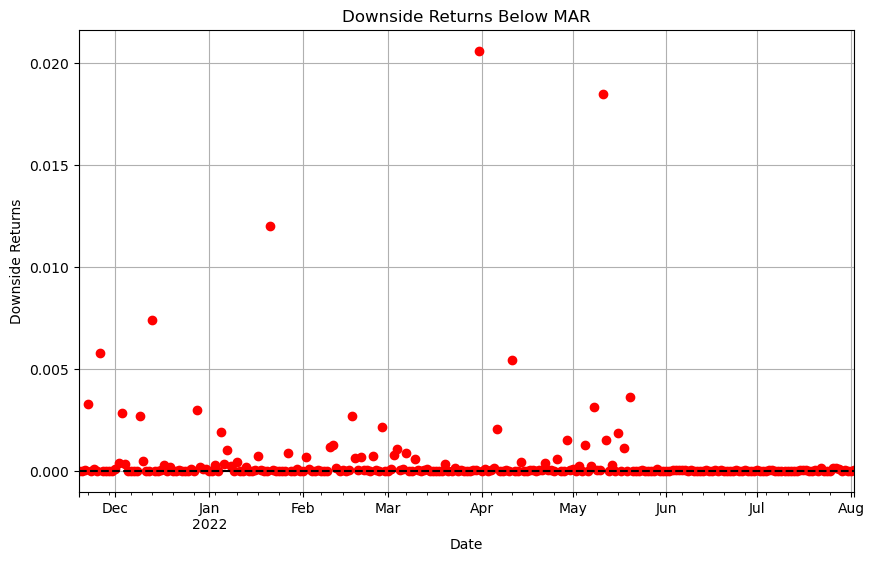

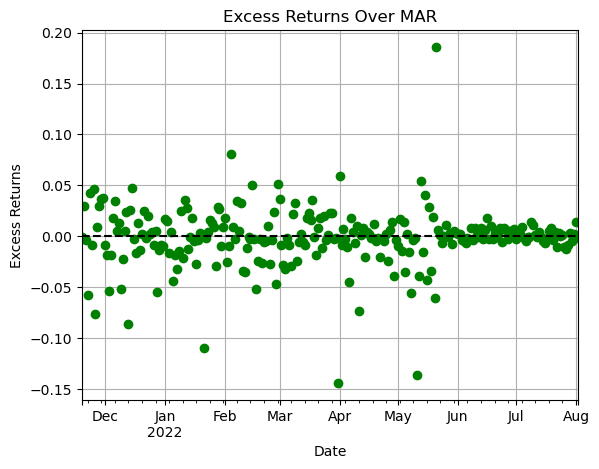

Sortino ratio: -1.0668530319352665
Scaled Sortino diff: 0.00010089498417647864
reward -0.13439351467713065
Reward at the end of the cycle on 2022-08-02 00:00:00: -1.2013474415965737
Completed cycle up to 2022-08-02 00:00:00
Running simulation from 2022-08-03 00:00:00 to 2022-08-27 00:00:00
Cycle Number: 4, Epsilon: 0.69640284375
State: {'ETH Vault_collateral_usd': 0.3094435226585968, 'stETH Vault_collateral_usd': 0.08616971058815524, 'BTC Vault_collateral_usd': 0.13620774812206432, 'Altcoin Vault_collateral_usd': 0.03264643980659235, 'Stablecoin Vault_collateral_usd': 0.048645779489463796, 'LP Vault_collateral_usd': 0.12245487948323897, 'PSM Vault_collateral_usd': 0.2644319198518884}
Chosen Action: {'stETH Vault_dai_ceiling': -1, 'ETH Vault_dai_ceiling': -0.25, 'BTC Vault_dai_ceiling': -0.25, 'Altcoin Vault_dai_ceiling': 0.25, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0.25, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': -1}, Reason: exploration (random selection 

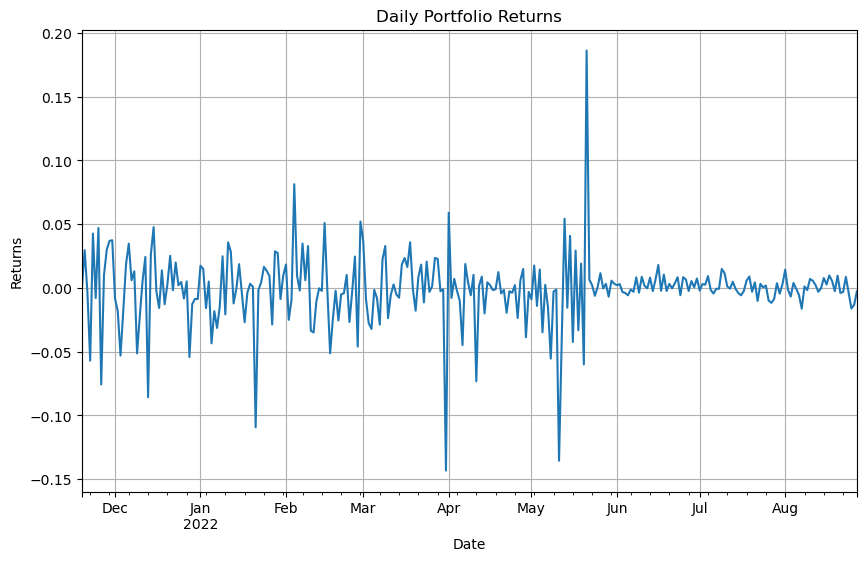

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


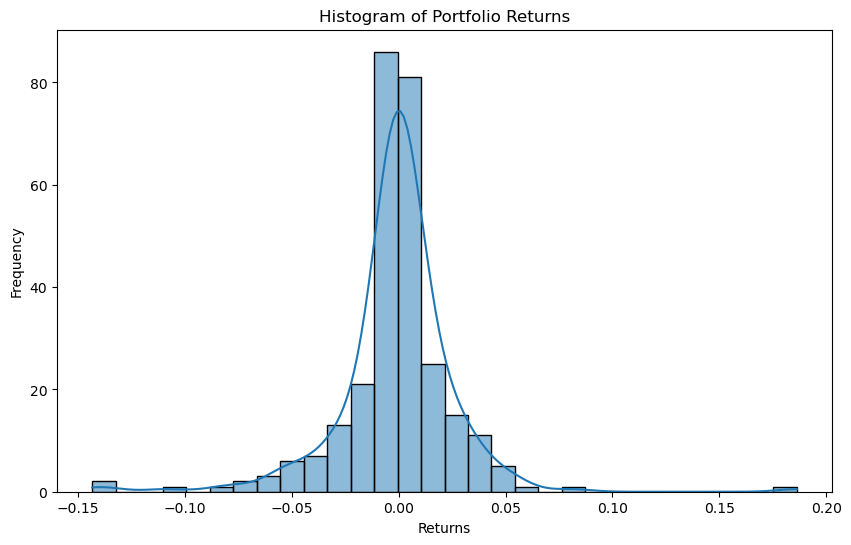

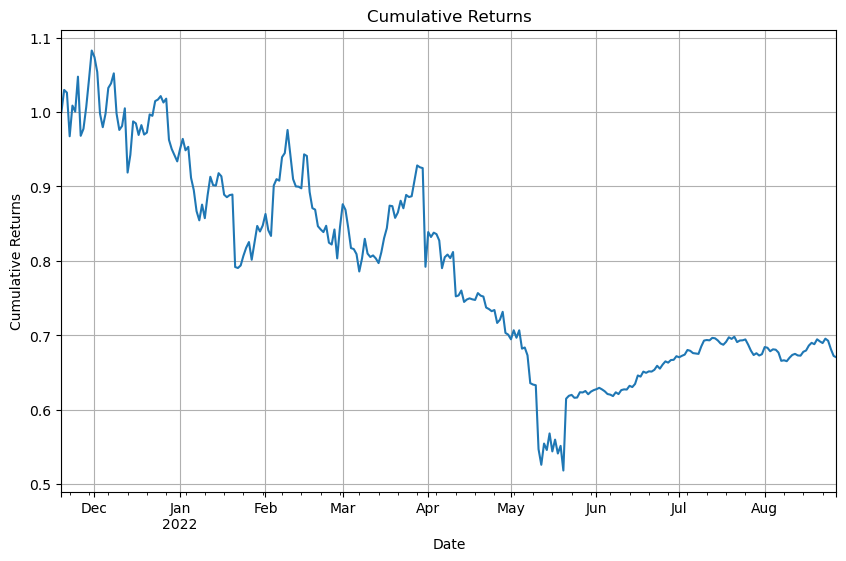

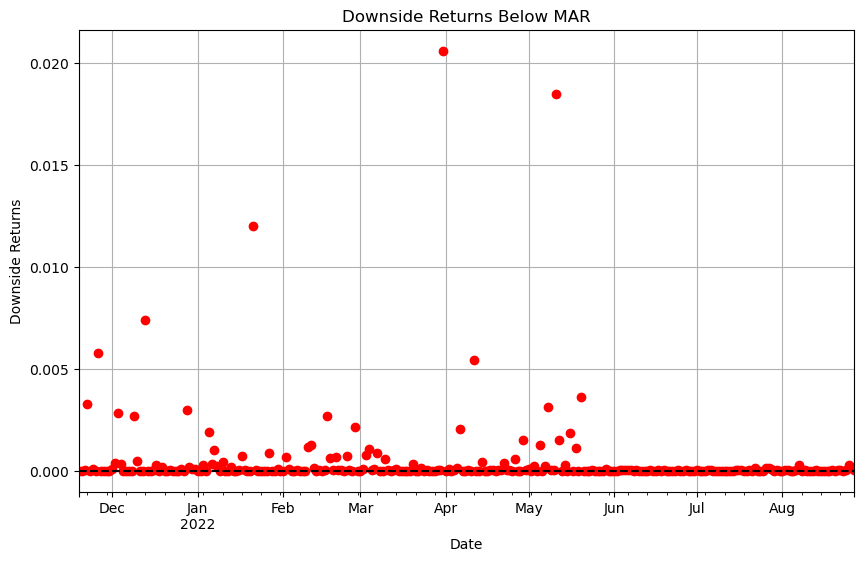

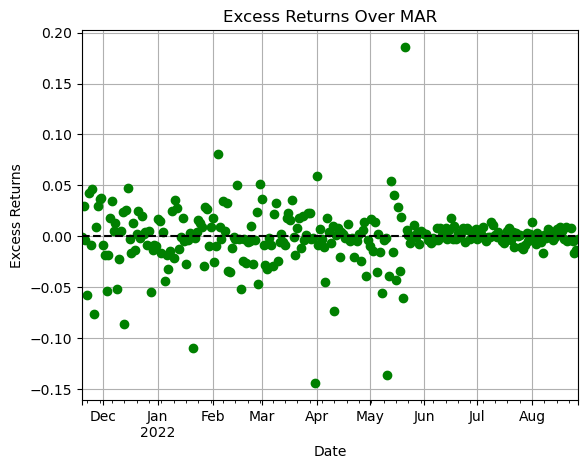

Sortino ratio: -1.0808061113483864
Scaled Sortino diff: 8.795942507647519e-05
reward -0.13409690813740793
Reward at the end of the cycle on 2022-08-27 00:00:00: -1.2149909789108708
Completed cycle up to 2022-08-27 00:00:00
Running simulation from 2022-08-28 00:00:00 to 2022-09-21 00:00:00
Cycle Number: 5, Epsilon: 0.6285035664843749
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000007207
weight difference -0.2617127925618512
Desired adjustment -2.617127925618512
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.31171279256192325, Target: 0.05000000000007207, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999994604
weight difference 0.4038096191129833
Desired adjustment 4.038096191129833
adjustment scale 10
legal adjustments

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


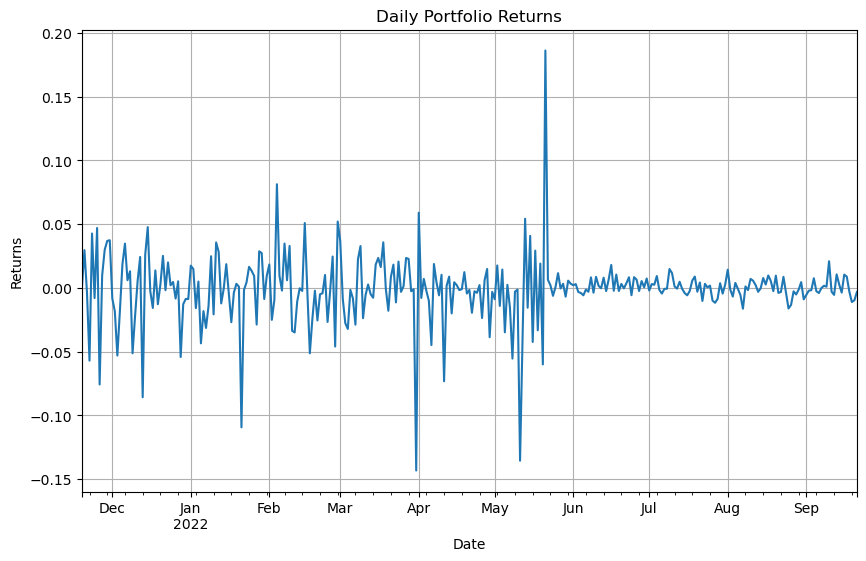

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


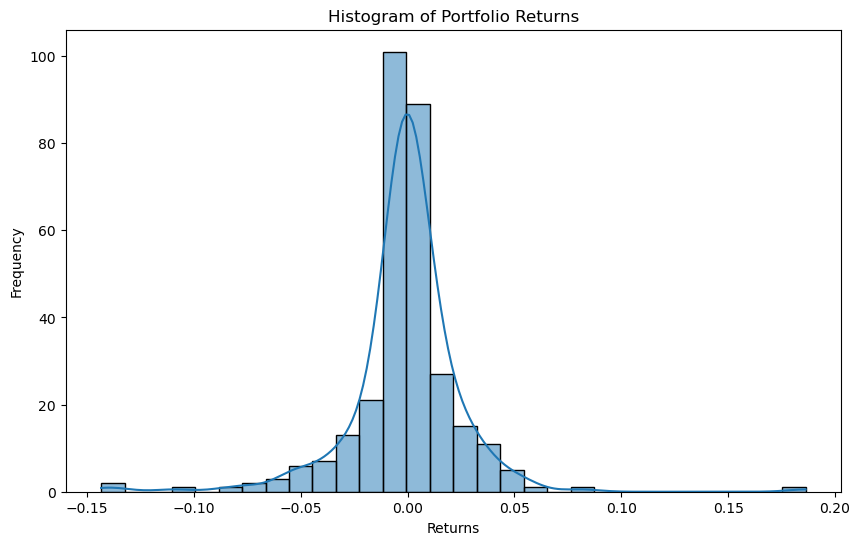

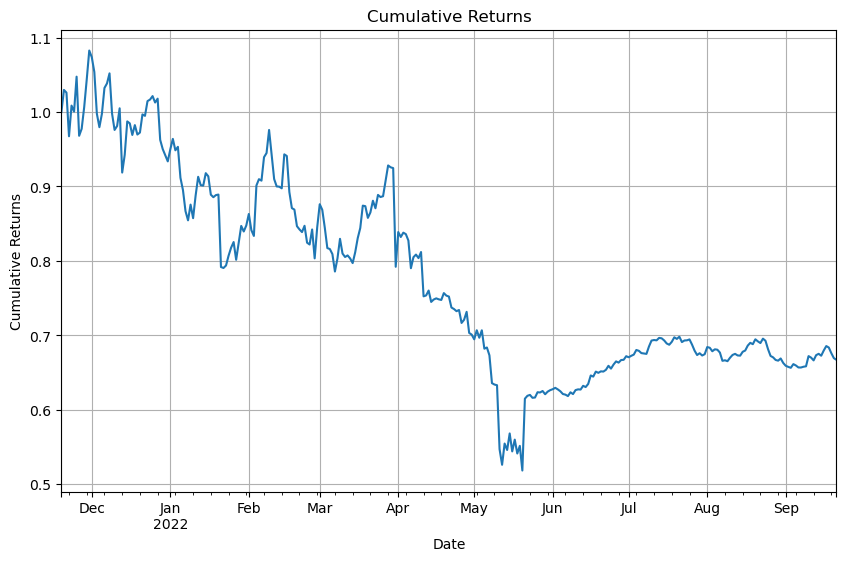

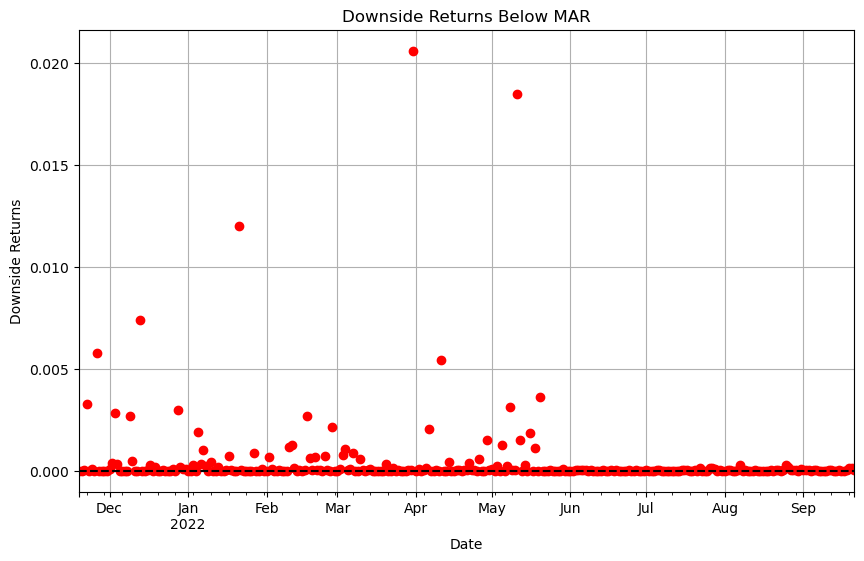

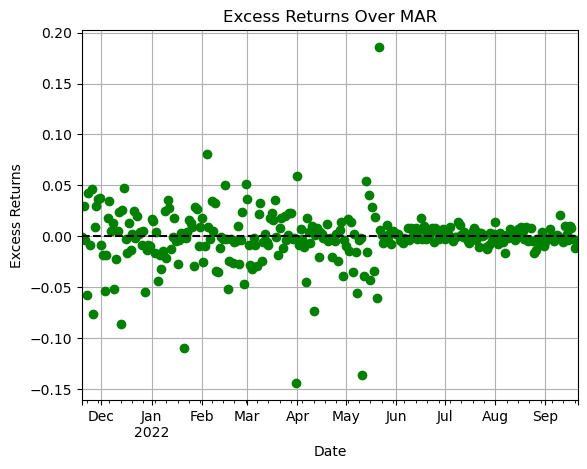

Sortino ratio: -1.0708896181249838
Scaled Sortino diff: 8.351406275977691e-05
reward -0.13103440941332484
Reward at the end of the cycle on 2022-09-21 00:00:00: -1.2020075416010685
Completed cycle up to 2022-09-21 00:00:00
Running simulation from 2022-09-22 00:00:00 to 2022-10-16 00:00:00
Cycle Number: 6, Epsilon: 0.5672244687521483
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000097626
weight difference -0.2213365735604626
Desired adjustment -2.213365735604626
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.27133657356056023, Target: 0.050000000000097626, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999993766
weight difference 0.3891632651755498
Desired adjustment 3.891632651755498
adjustment scale 10
legal adjustmen

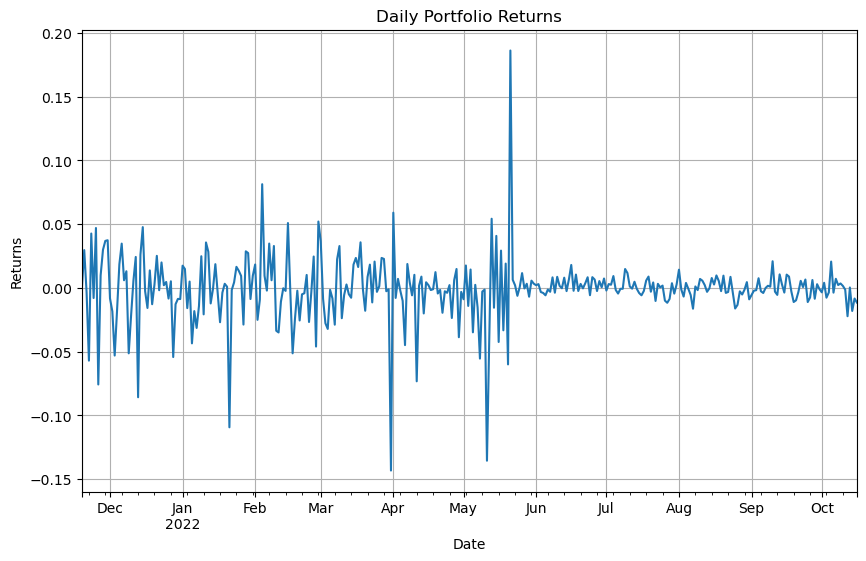

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


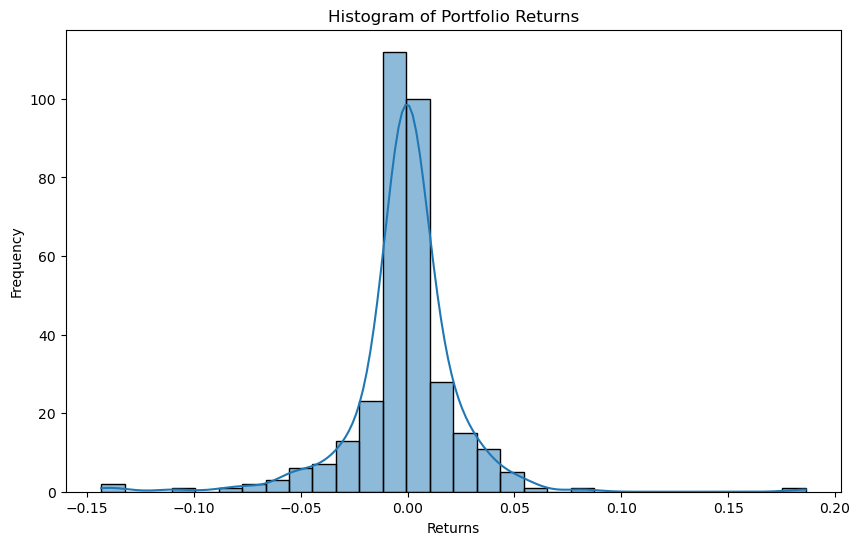

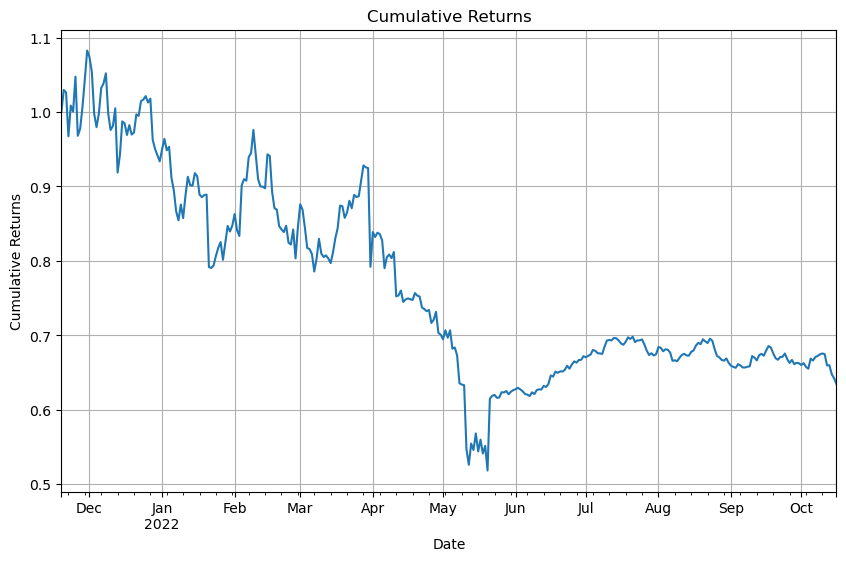

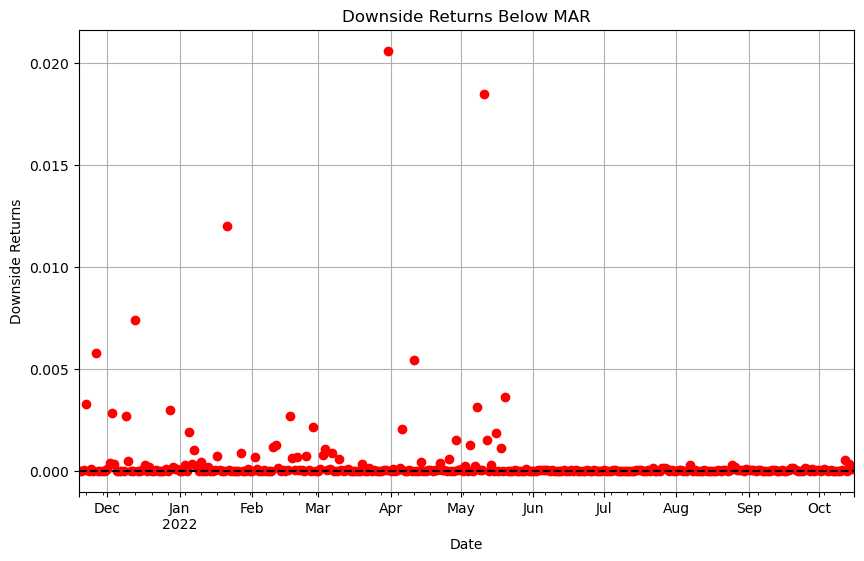

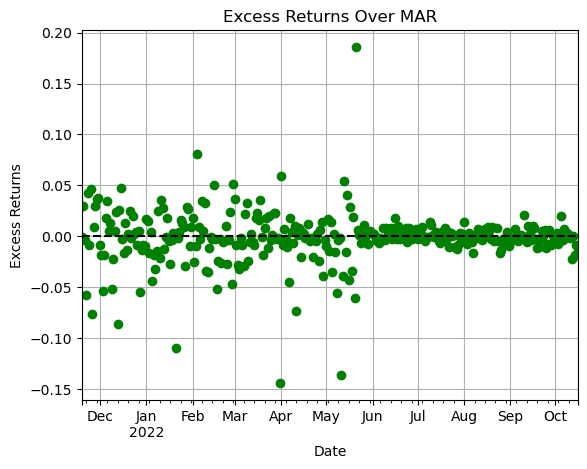

Sortino ratio: -1.1358004135657738
Scaled Sortino diff: 7.354470587646683e-05
reward -0.1269491817052777
Reward at the end of the cycle on 2022-10-16 00:00:00: -1.2628231399769279
Completed cycle up to 2022-10-16 00:00:00
Running simulation from 2022-10-17 00:00:00 to 2022-11-10 00:00:00
Cycle Number: 7, Epsilon: 0.5119200830488138
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000002573
weight difference -0.19898621394152566
Desired adjustment -1.9898621394152567
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2489862139415514, Target: 0.05000000000002573, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999998584
weight difference 0.37405688760199085
Desired adjustment 3.7405688760199087
adjustment scale 10
legal adjustmen

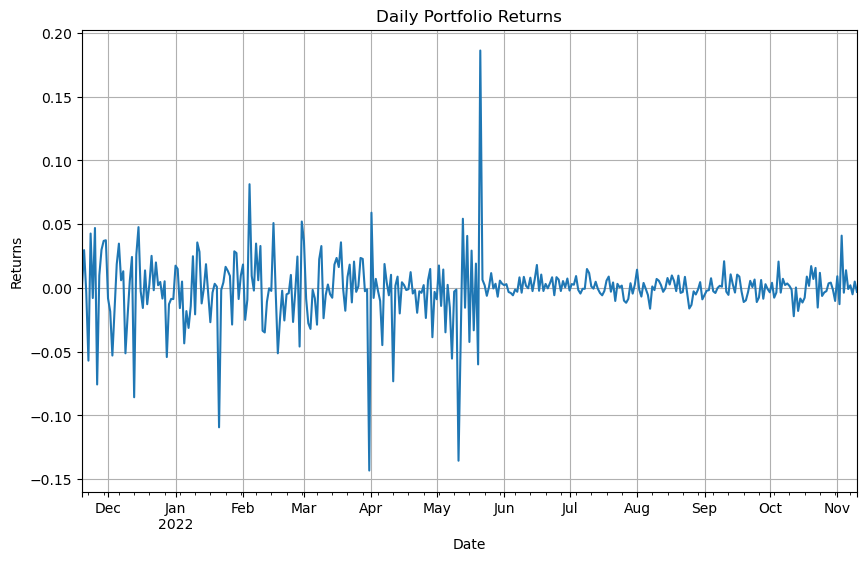

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


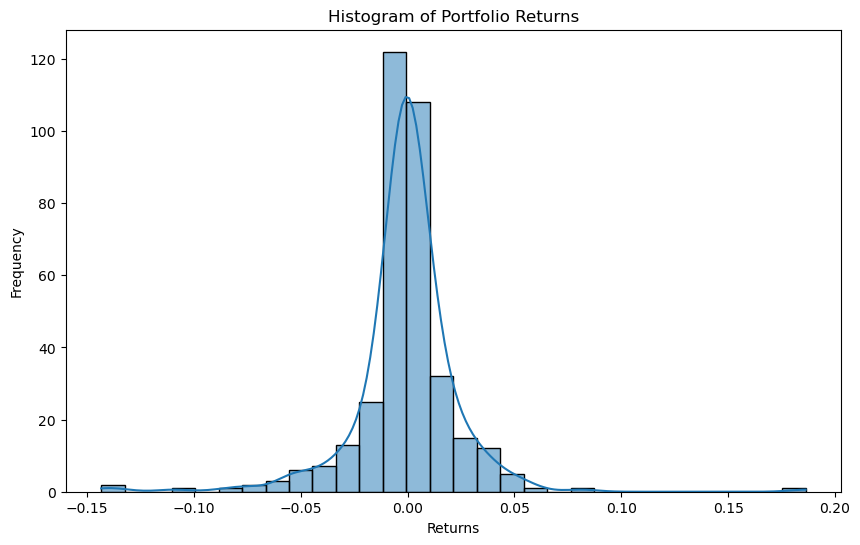

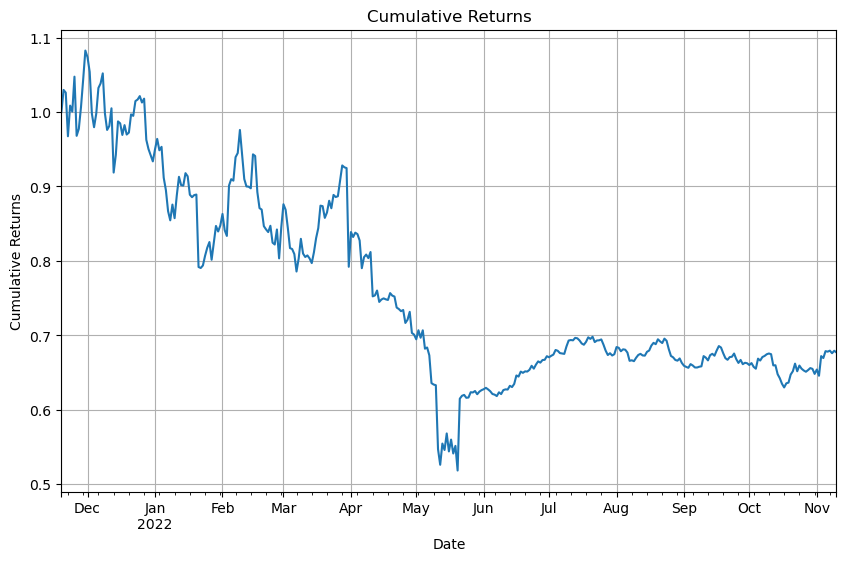

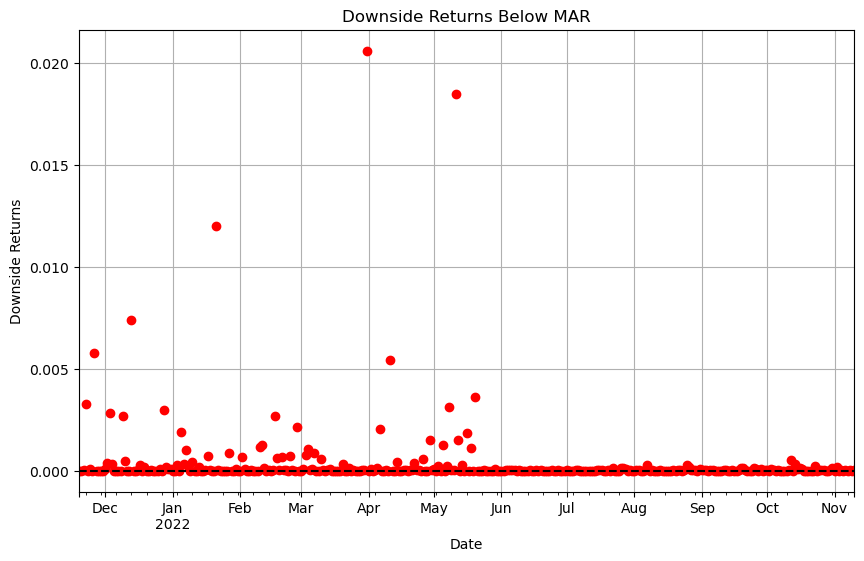

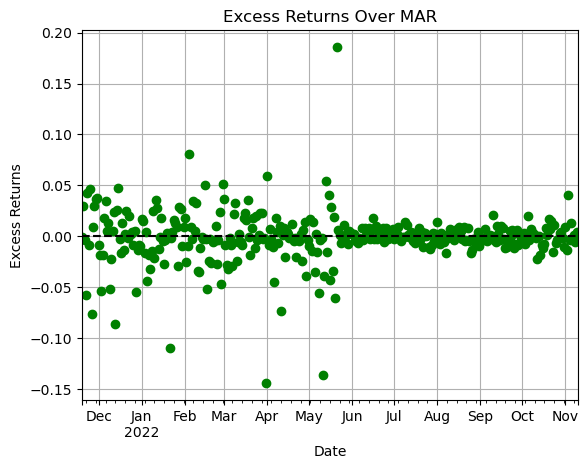

Sortino ratio: -1.0041235244626348
Scaled Sortino diff: 6.948387005781173e-05
reward -0.1245109209349729
Reward at the end of the cycle on 2022-11-10 00:00:00: -1.1287039292676655
Completed cycle up to 2022-11-10 00:00:00
Running simulation from 2022-11-11 00:00:00 to 2022-12-05 00:00:00
Cycle Number: 8, Epsilon: 0.4620078749515544
State: {'ETH Vault_collateral_usd': 0.23549076107550934, 'stETH Vault_collateral_usd': 0.13350395073822233, 'BTC Vault_collateral_usd': 0.15375775067561342, 'Altcoin Vault_collateral_usd': 0.03491658506329009, 'Stablecoin Vault_collateral_usd': 0.03578449932688869, 'LP Vault_collateral_usd': 0.12383656535491633, 'PSM Vault_collateral_usd': 0.2827098877655597}
Chosen Action: {'stETH Vault_dai_ceiling': -1, 'ETH Vault_dai_ceiling': 0, 'BTC Vault_dai_ceiling': -0.5, 'Altcoin Vault_dai_ceiling': -0.25, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': -0.25, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': 0.5}, Reason: exploration (random selection

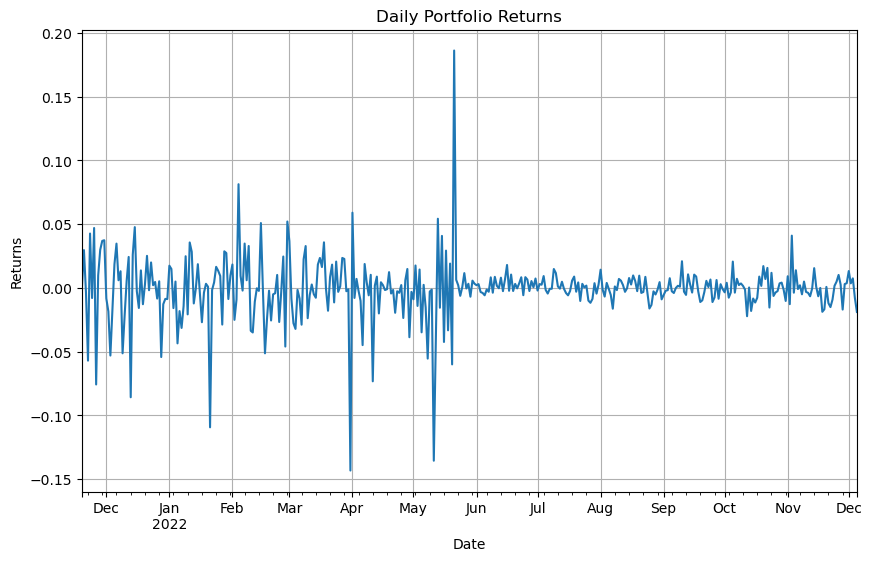

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


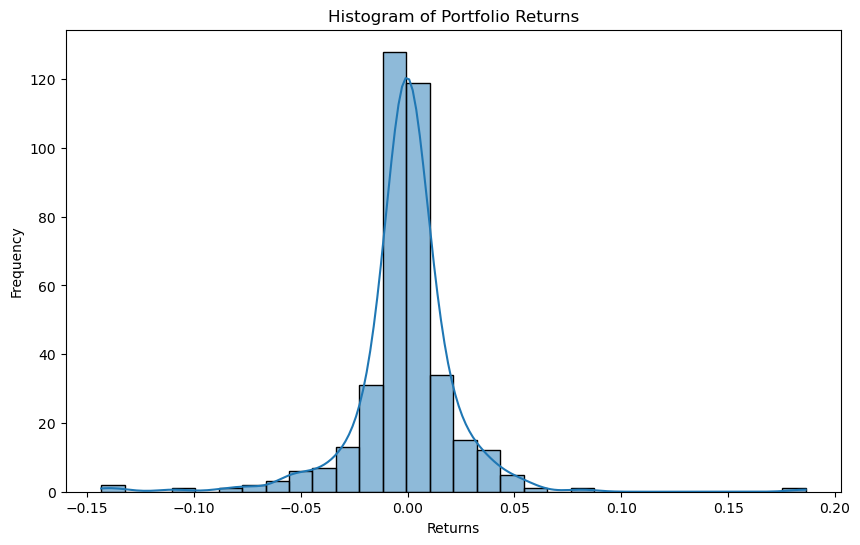

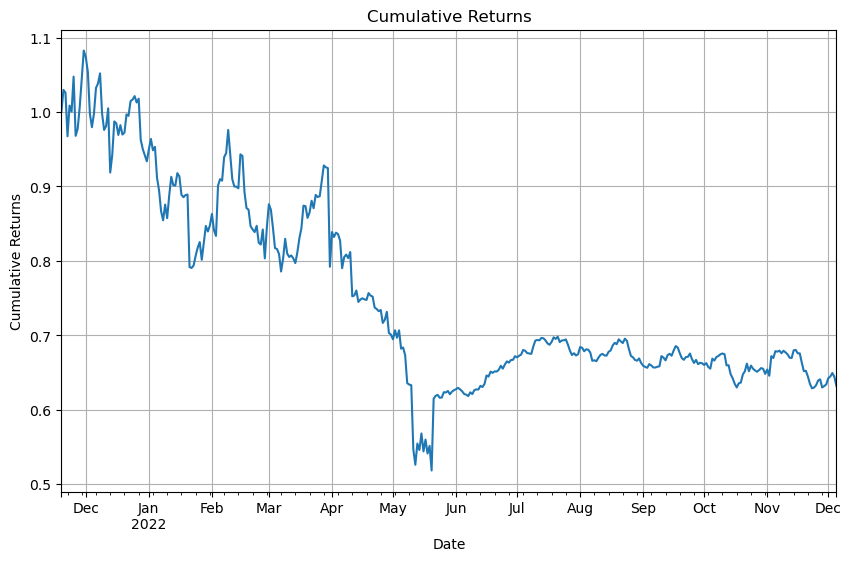

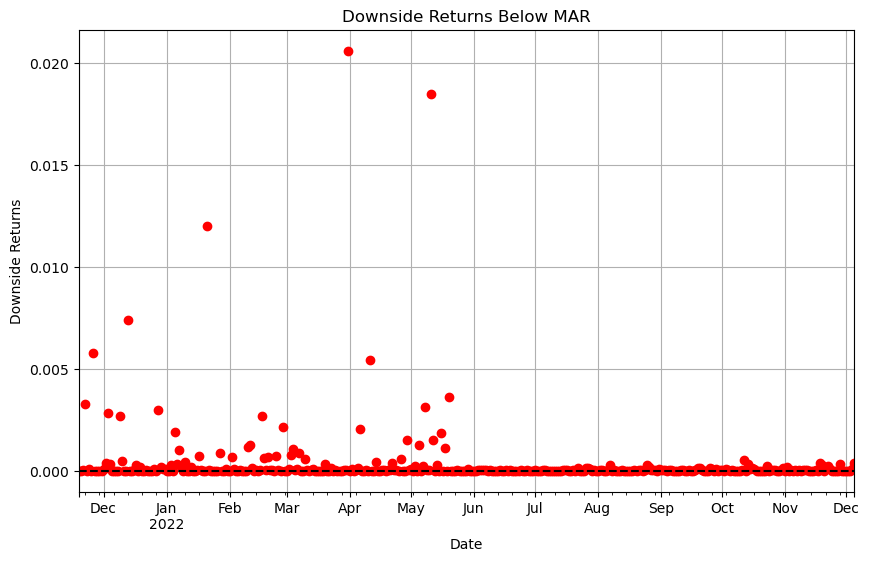

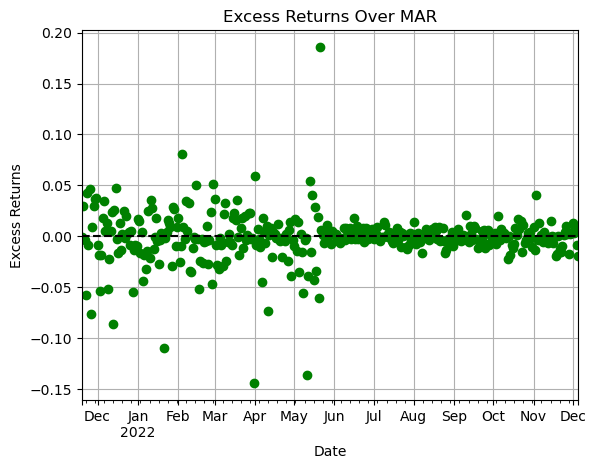

Sortino ratio: -1.1016461161618019
Scaled Sortino diff: 6.099081306438329e-05
reward -0.12366551136192892
Reward at the end of the cycle on 2022-12-05 00:00:00: -1.2253726183367952
Completed cycle up to 2022-12-05 00:00:00
Running simulation from 2022-12-06 00:00:00 to 2022-12-30 00:00:00
Cycle Number: 9, Epsilon: 0.4169621071437778
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.1794461722449655
Desired adjustment -1.794461722449655
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2294461722449655, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.35861547894666446
Desired adjustment 3.5861547894666446
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest adju

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


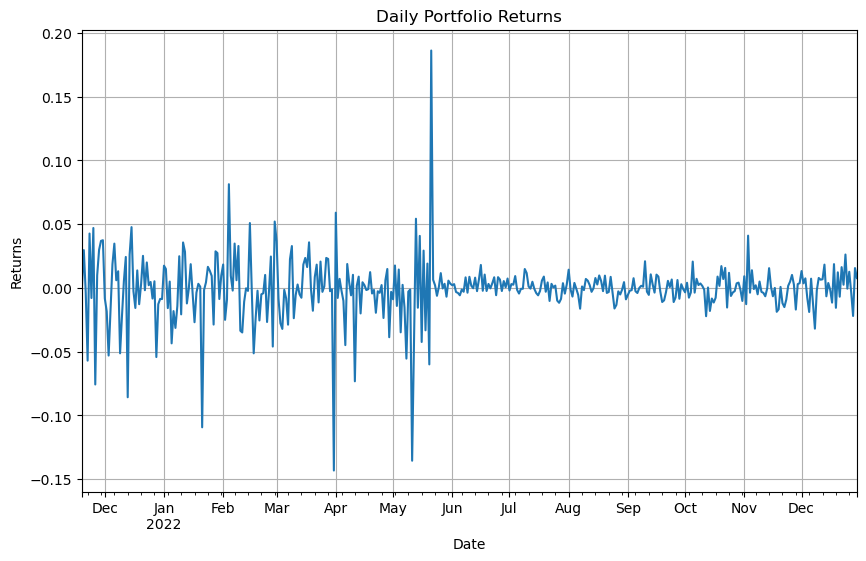

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


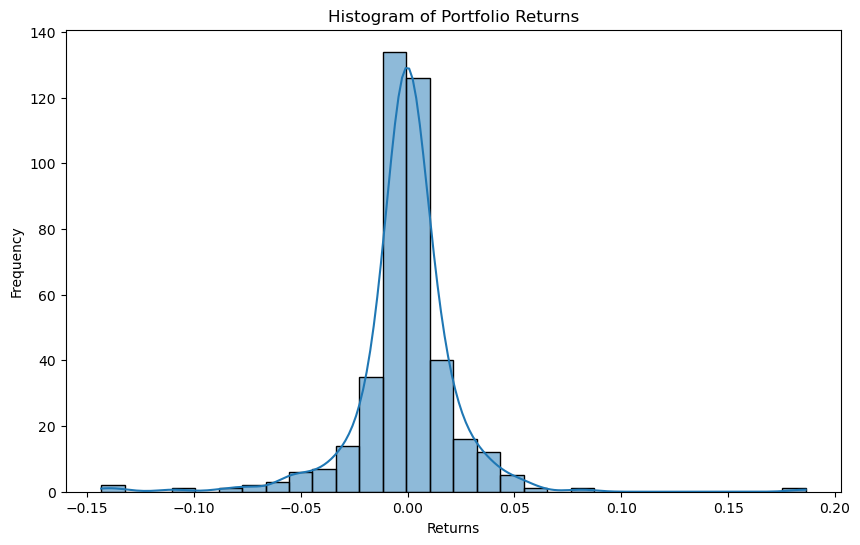

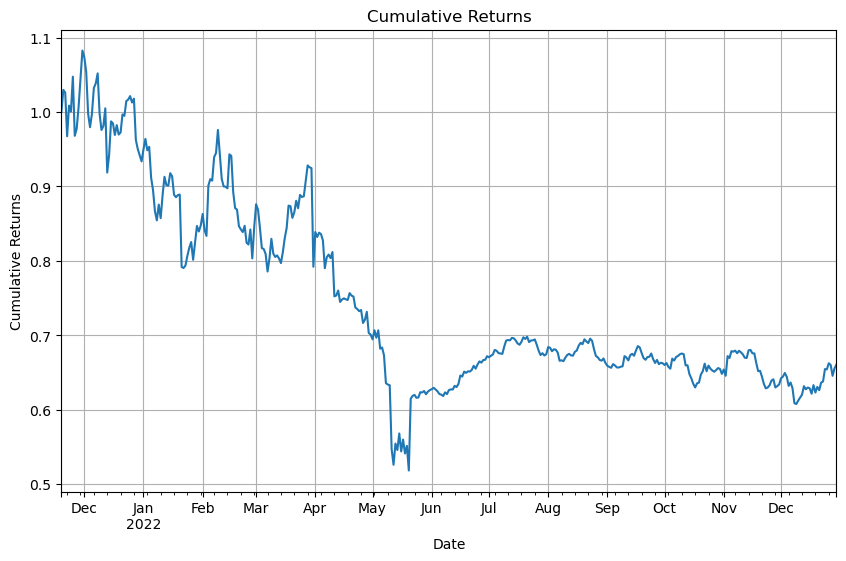

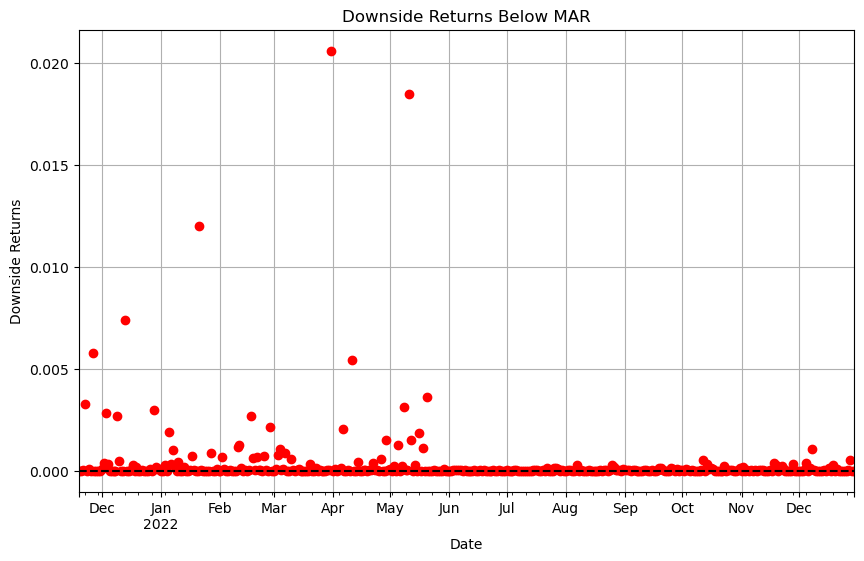

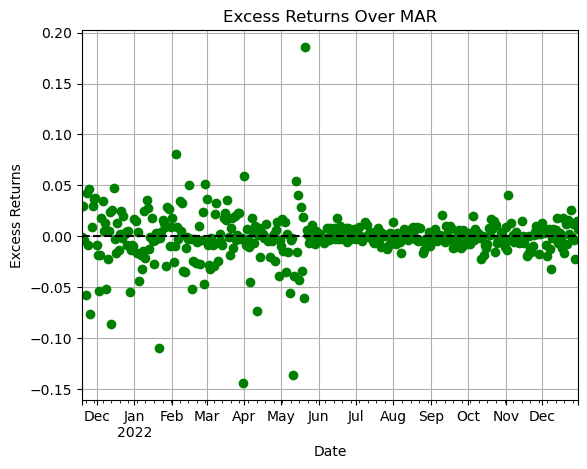

Sortino ratio: -1.004137875518966
Scaled Sortino diff: 5.718947752552988e-05
reward -0.1214777539802451
Reward at the end of the cycle on 2022-12-30 00:00:00: -1.1256728189767367
Completed cycle up to 2022-12-30 00:00:00
Running simulation from 2022-12-31 00:00:00 to 2023-01-24 00:00:00
Cycle Number: 10, Epsilon: 0.37630830169725943
State: {'ETH Vault_collateral_usd': 0.21282661400036207, 'stETH Vault_collateral_usd': 0.14863550910906795, 'BTC Vault_collateral_usd': 0.14670190234231395, 'Altcoin Vault_collateral_usd': 0.04102760535461537, 'Stablecoin Vault_collateral_usd': 0.04101009387382727, 'LP Vault_collateral_usd': 0.118909999623695, 'PSM Vault_collateral_usd': 0.29088827569611836}
Chosen Action: {'stETH Vault_dai_ceiling': -0.25, 'ETH Vault_dai_ceiling': -0.5, 'BTC Vault_dai_ceiling': -0.25, 'Altcoin Vault_dai_ceiling': -1, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': 0}, Reason: exploration (random selection f

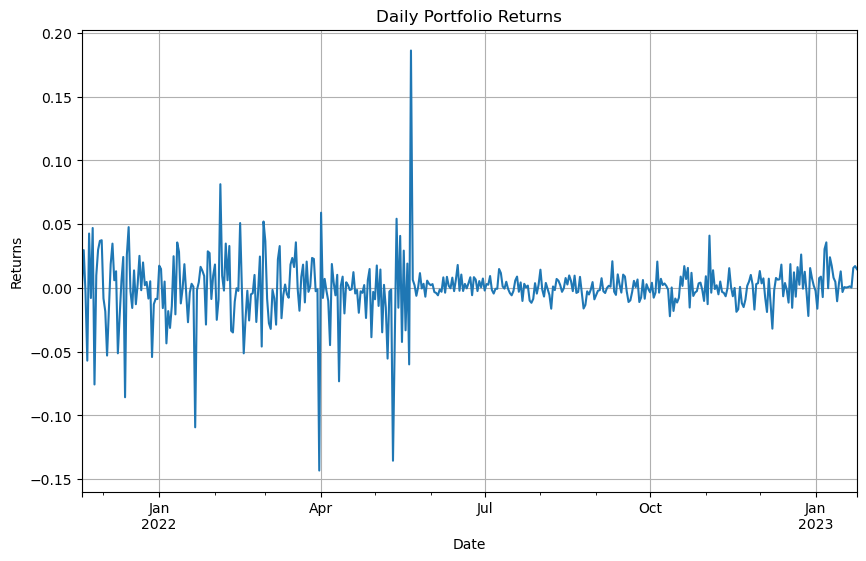

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


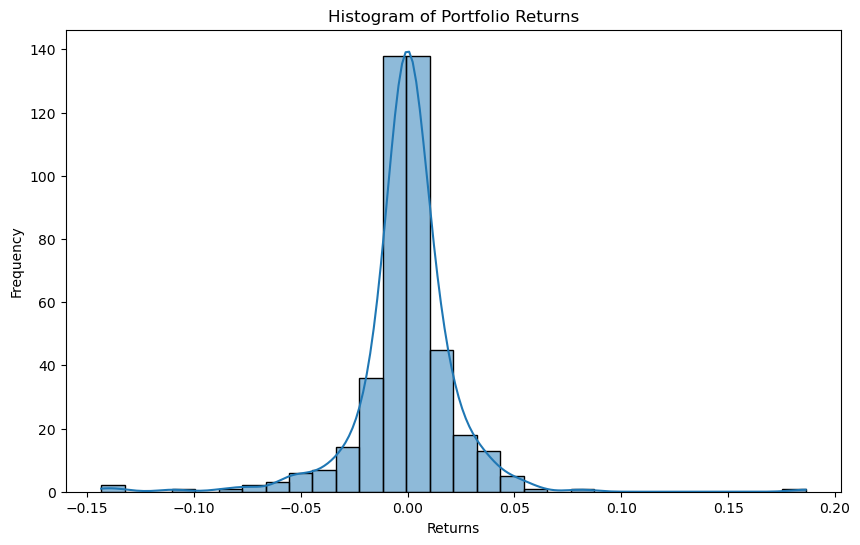

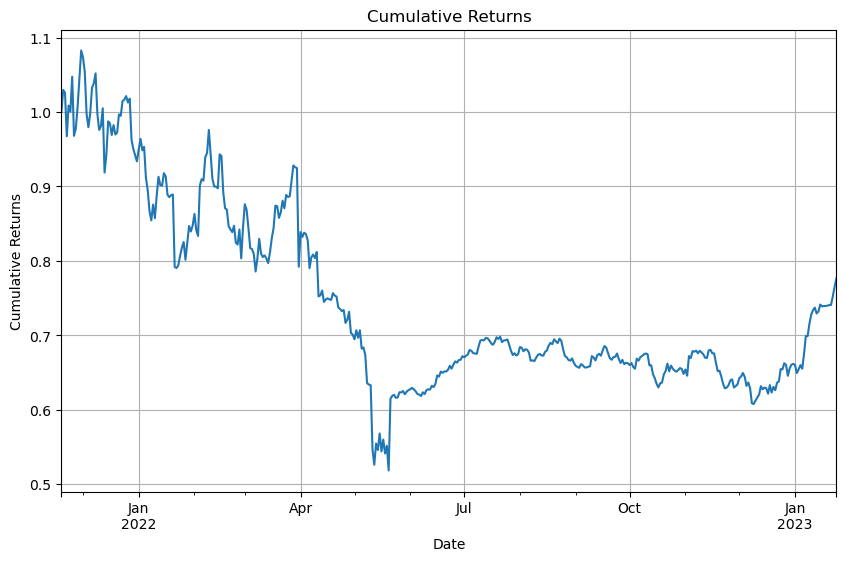

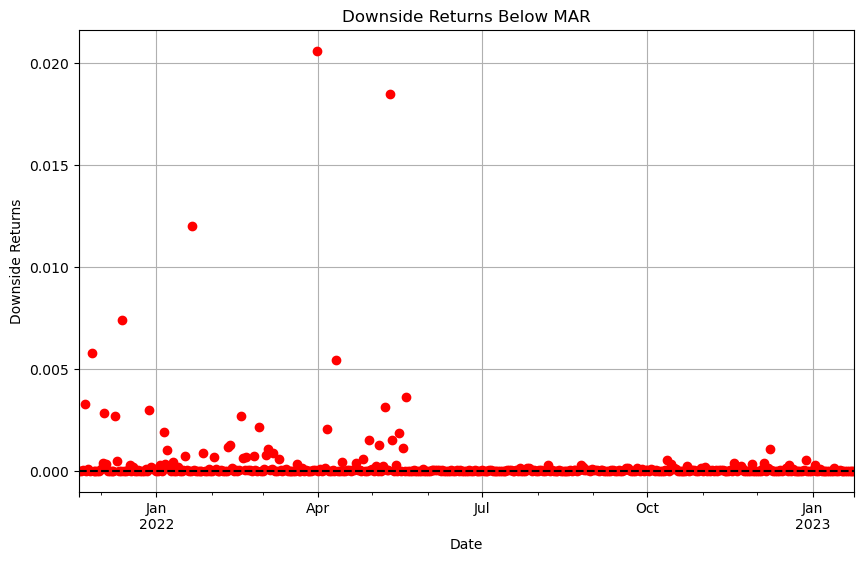

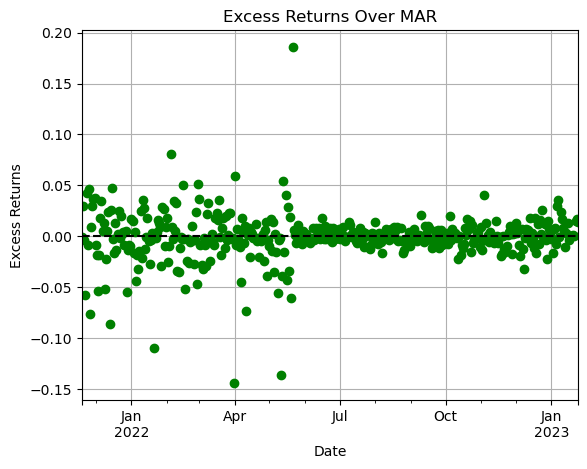

Sortino ratio: -0.6946936405187225
Scaled Sortino diff: 5.6451682449873114e-05
reward -0.12182577567609847
Reward at the end of the cycle on 2023-01-24 00:00:00: -0.8165758678772709
Completed cycle up to 2023-01-24 00:00:00
Running simulation from 2023-01-25 00:00:00 to 2023-02-18 00:00:00
Cycle Number: 11, Epsilon: 0.3396182422817766
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000000439
weight difference -0.16894224744544462
Desired adjustment -1.6894224744544462
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.21894224744544902, Target: 0.05000000000000439, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999999806
weight difference 0.3558923121857398
Desired adjustment 3.558923121857398
adjustment scale 10
legal adjustm

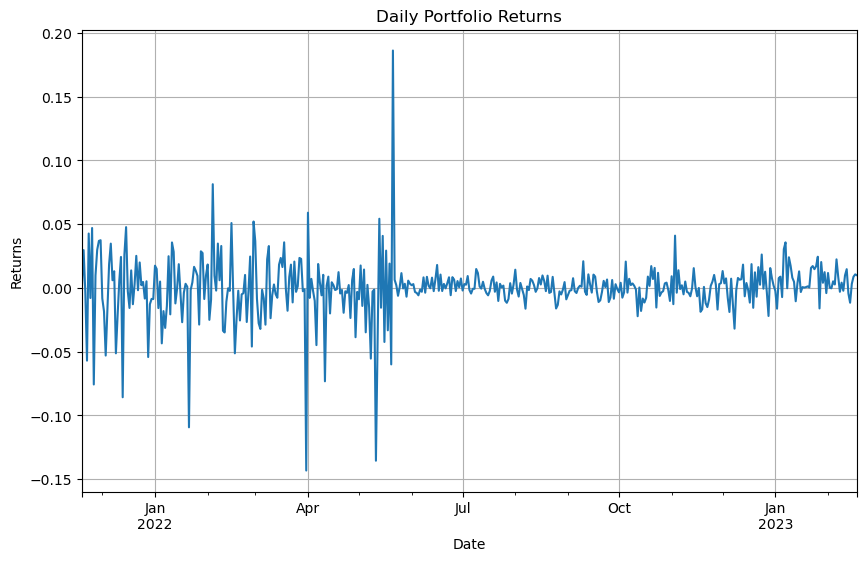

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


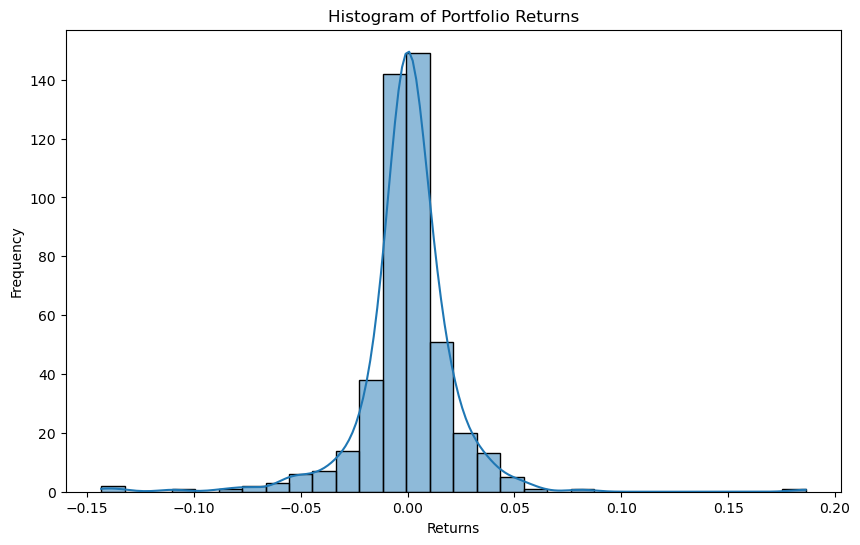

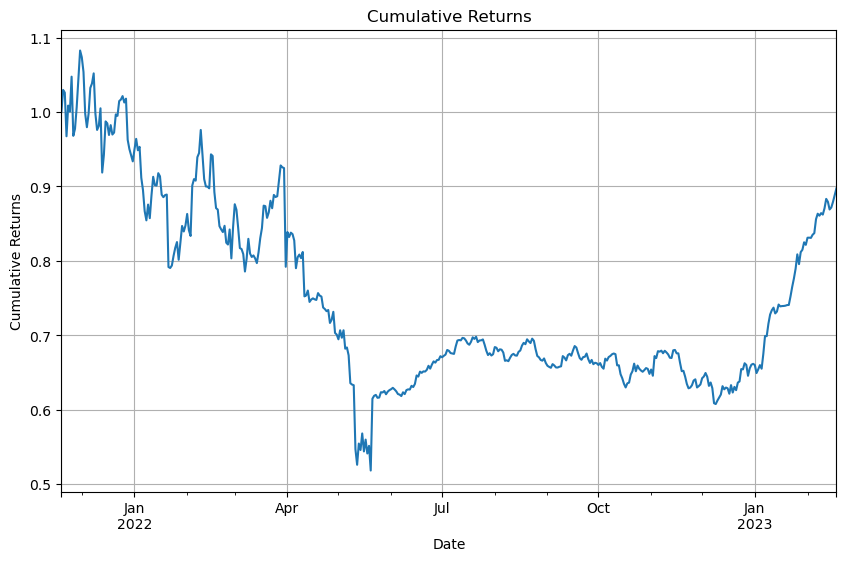

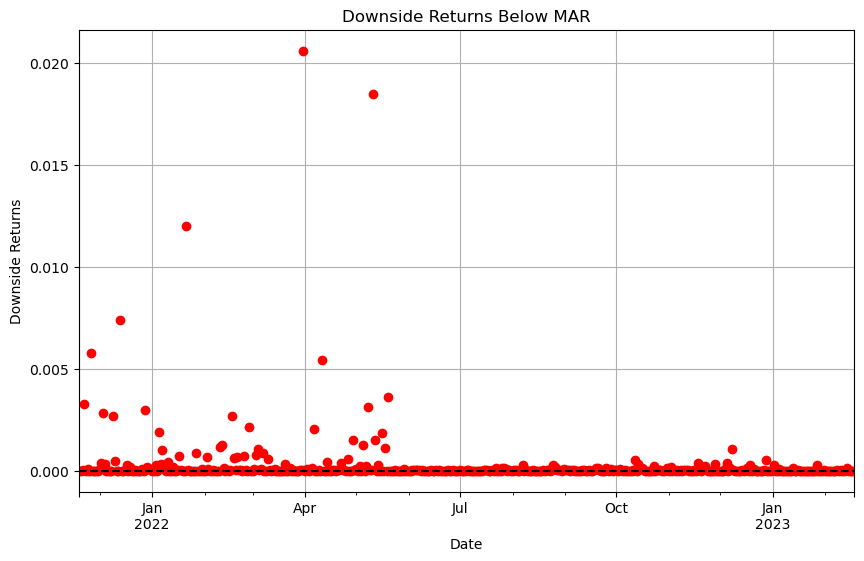

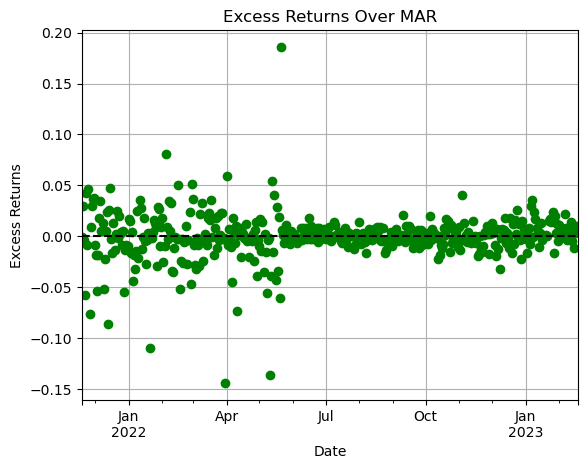

Sortino ratio: -0.39088533995906793
Scaled Sortino diff: 5.5628114448434125e-05
reward -0.1239327191428986
Reward at the end of the cycle on 2023-02-18 00:00:00: -0.514873687216415
Completed cycle up to 2023-02-18 00:00:00
Running simulation from 2023-02-19 00:00:00 to 2023-03-15 00:00:00
Cycle Number: 12, Epsilon: 0.30650546365930337
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000037015
weight difference -0.1809962704596812
Desired adjustment -1.809962704596812
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2309962704597182, Target: 0.050000000000037015, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999892
weight difference 0.35573929911390867
Desired adjustment 3.5573929911390865
adjustment scale 10
legal adjustm

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


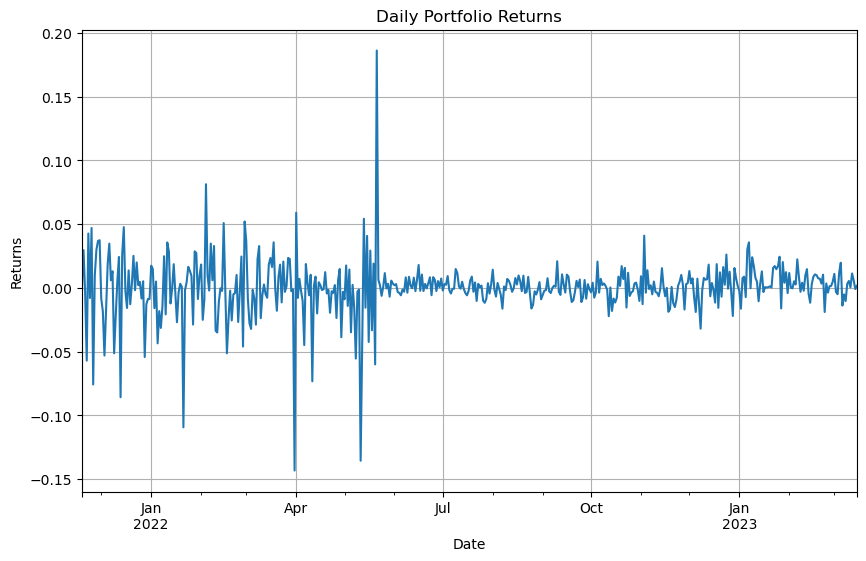

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


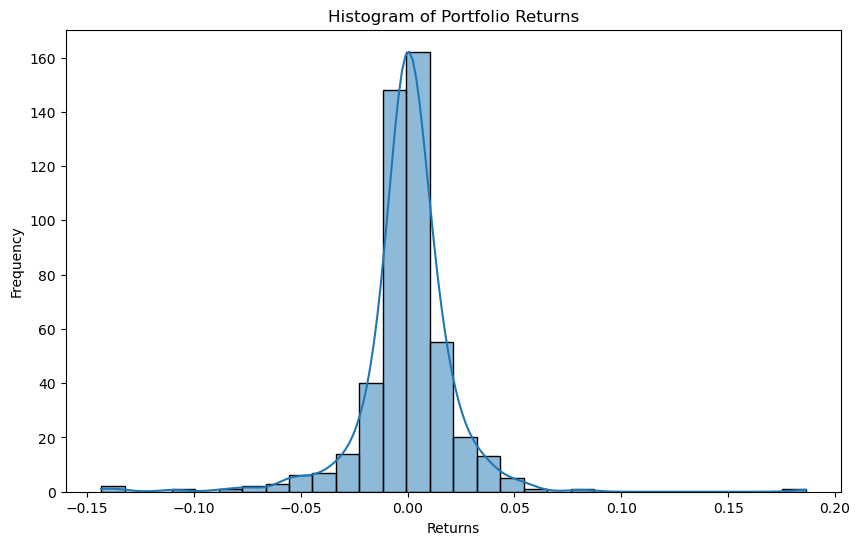

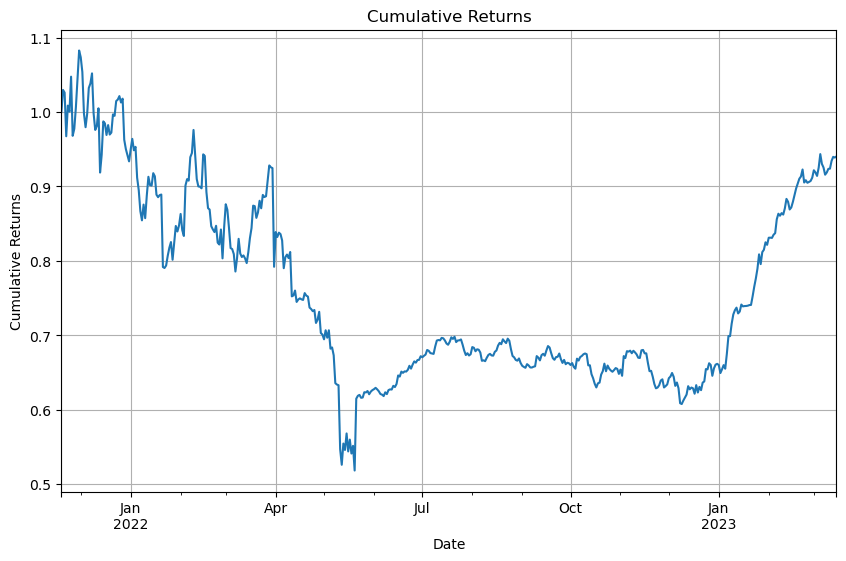

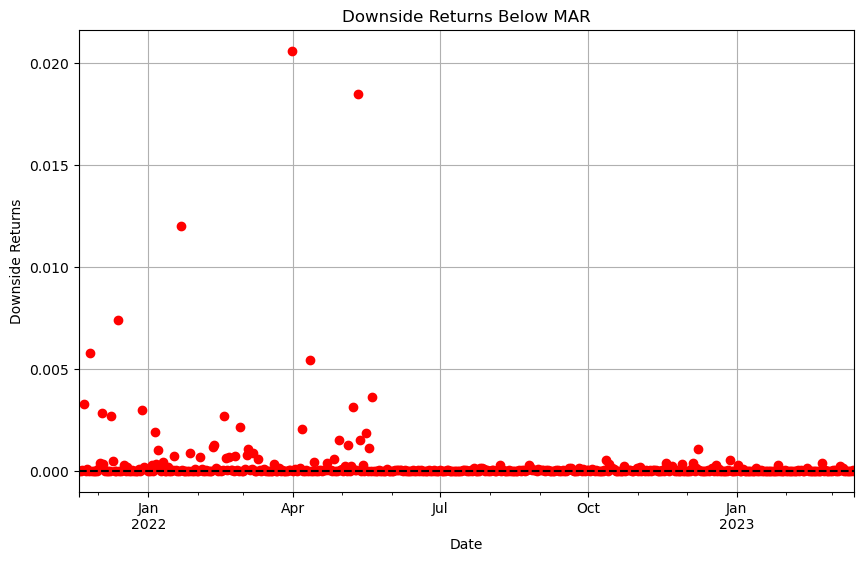

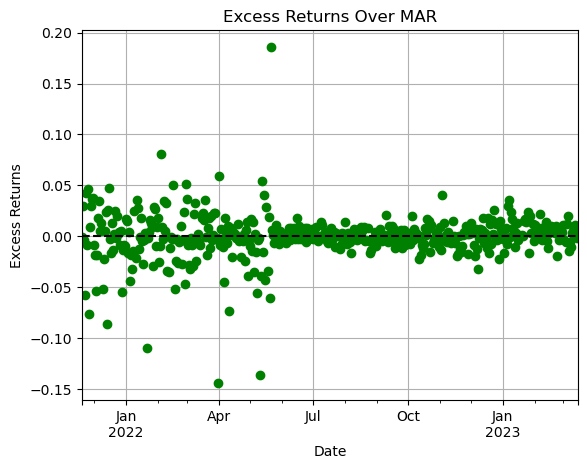

Sortino ratio: -0.28788194982307164
Scaled Sortino diff: 5.224513987416401e-05
reward -0.12489945782605236
Reward at the end of the cycle on 2023-03-15 00:00:00: -0.41283365278899814
Completed cycle up to 2023-03-15 00:00:00
Running simulation from 2023-03-16 00:00:00 to 2023-04-09 00:00:00
Cycle Number: 13, Epsilon: 0.2766211809525213
State: {'ETH Vault_collateral_usd': 0.2316502191187915, 'stETH Vault_collateral_usd': 0.1438982584073363, 'BTC Vault_collateral_usd': 0.15990971579563804, 'Altcoin Vault_collateral_usd': 0.02753268870406925, 'Stablecoin Vault_collateral_usd': 0.024949132223906184, 'LP Vault_collateral_usd': 0.11755810909209842, 'PSM Vault_collateral_usd': 0.2945018766581604}
Chosen Action: {'stETH Vault_dai_ceiling': 0.5, 'ETH Vault_dai_ceiling': 0, 'BTC Vault_dai_ceiling': -1, 'Altcoin Vault_dai_ceiling': 0.25, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0.25, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': -0.5}, Reason: exploration (random selectio

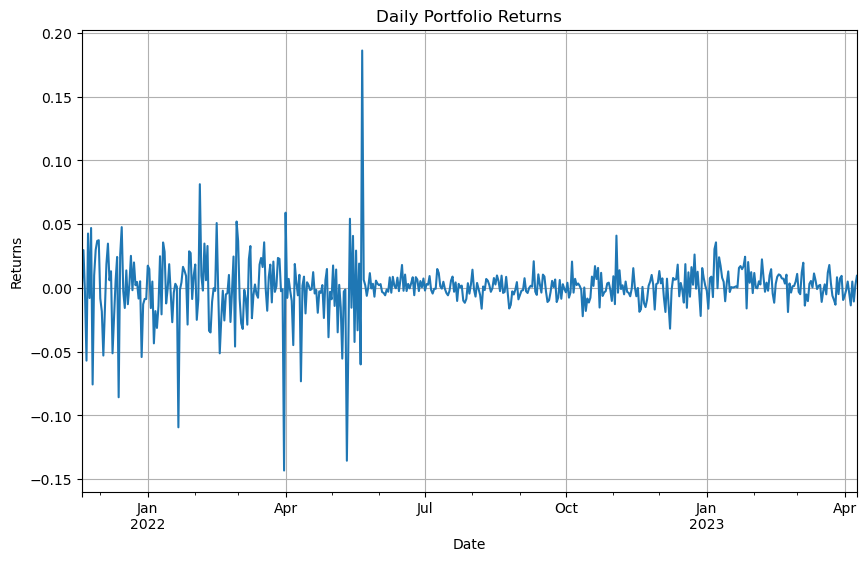

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


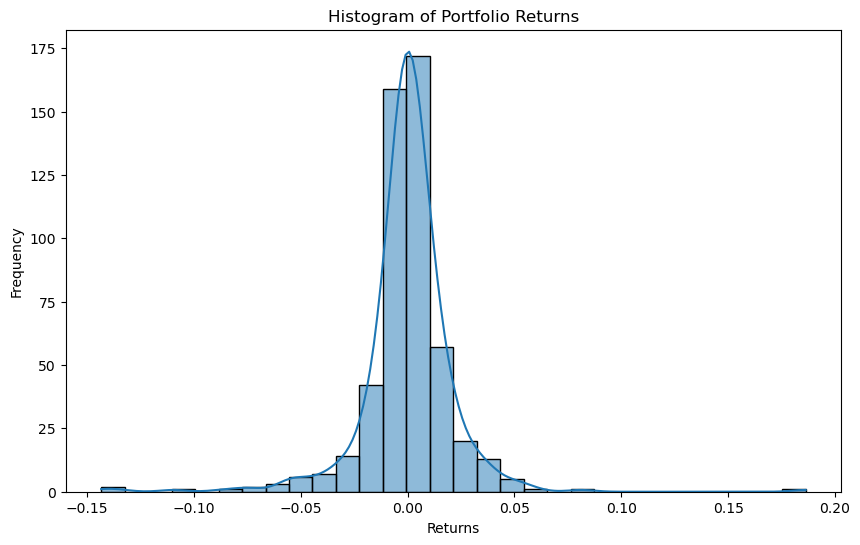

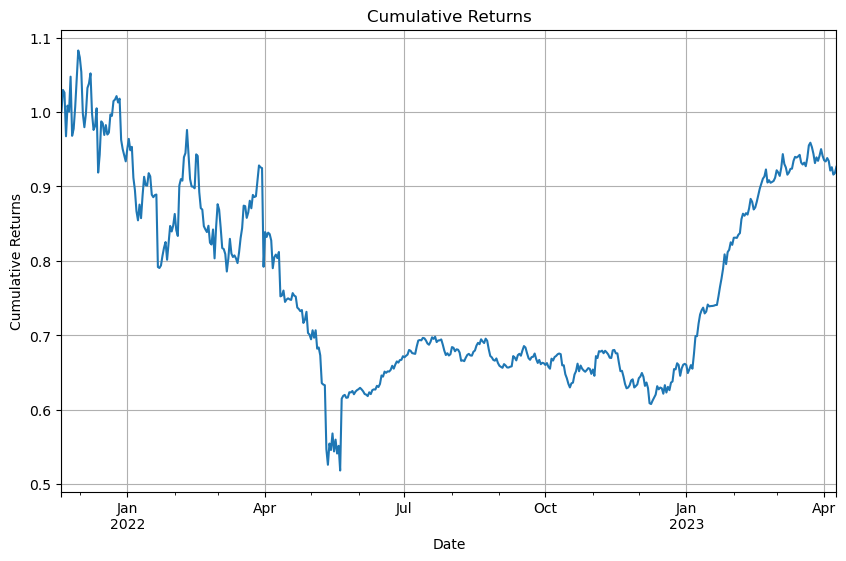

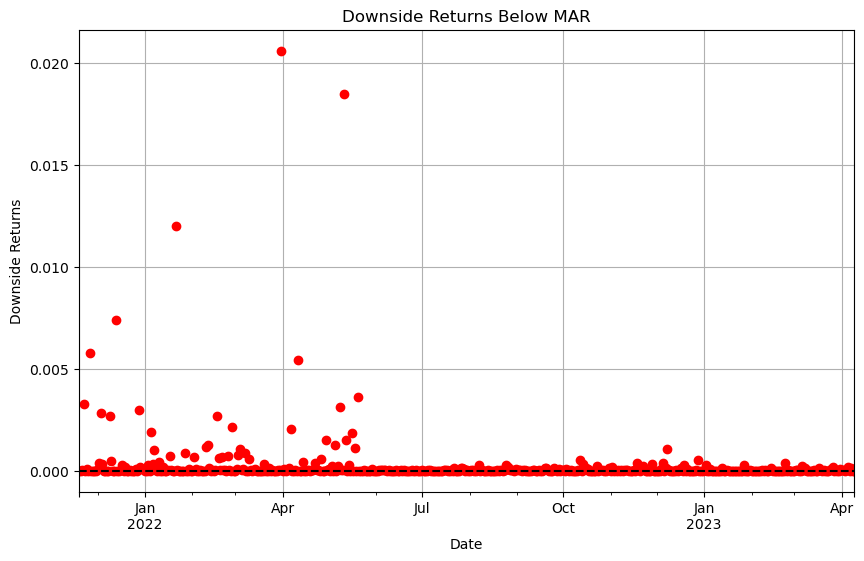

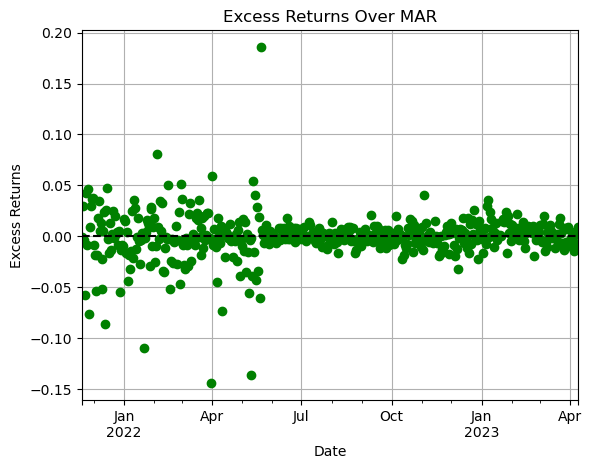

Sortino ratio: -0.31863694348385524
Scaled Sortino diff: 4.8602368751086164e-05
reward -0.1234447257974045
Reward at the end of the cycle on 2023-04-09 00:00:00: -0.44213027165001084
Completed cycle up to 2023-04-09 00:00:00
Running simulation from 2023-04-10 00:00:00 to 2023-05-04 00:00:00
Cycle Number: 14, Epsilon: 0.24965061580965048
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000001077
weight difference -0.17753420957316146
Desired adjustment -1.7753420957316146
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22753420957317222, Target: 0.05000000000001077, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999999667
weight difference 0.3544534456876284
Desired adjustment 3.544534456876284
adjustment scale 10
legal adjus

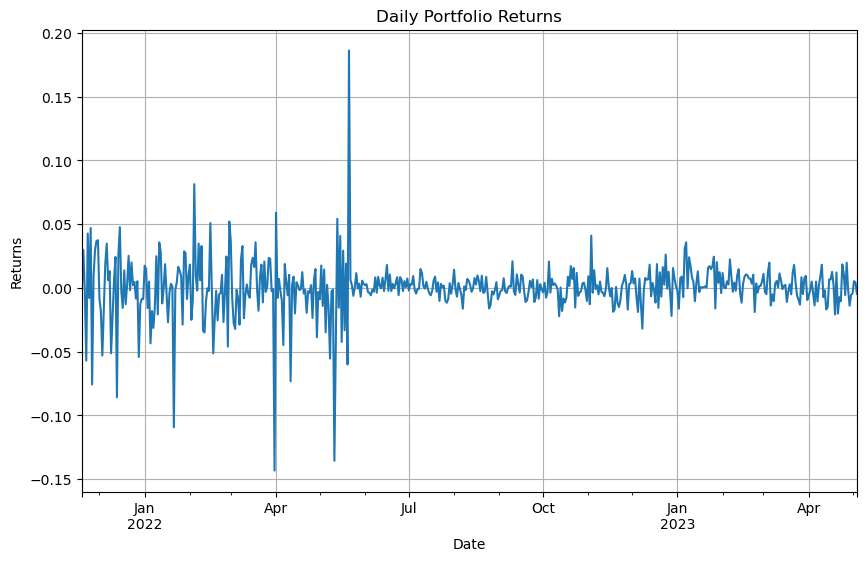

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


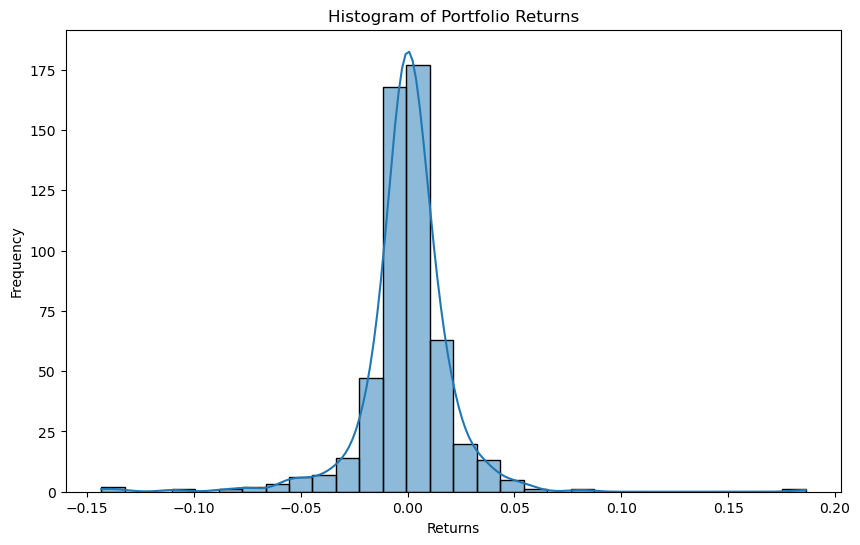

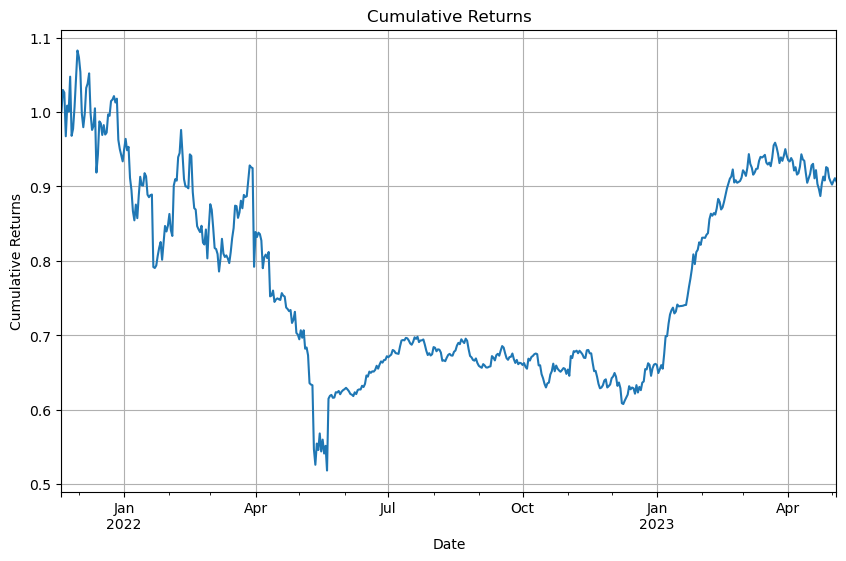

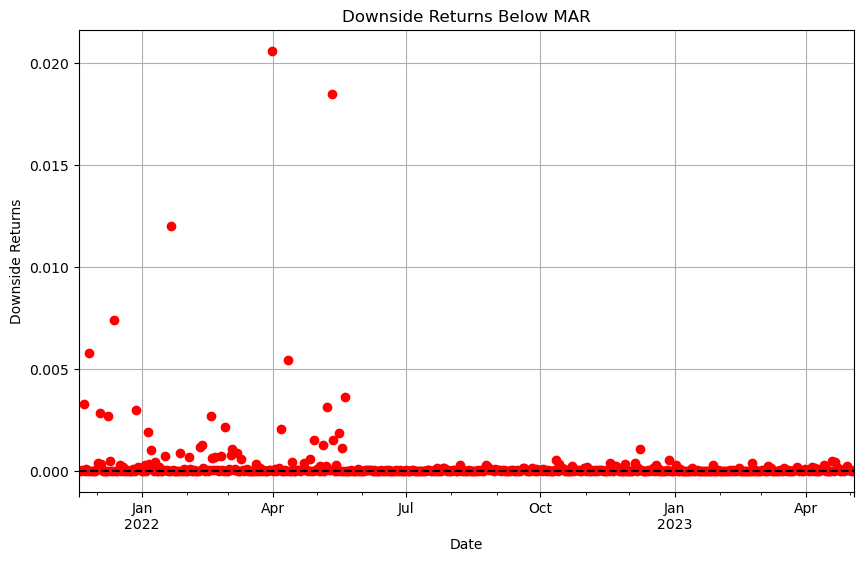

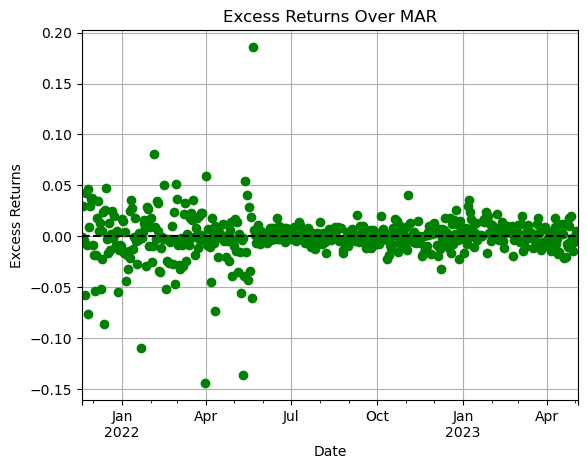

Sortino ratio: -0.35970971991400374
Scaled Sortino diff: 4.549238658475179e-05
reward -0.12123549731210362
Reward at the end of the cycle on 2023-05-04 00:00:00: -0.48099070961269214
Completed cycle up to 2023-05-04 00:00:00
Running simulation from 2023-05-05 00:00:00 to 2023-05-29 00:00:00
Cycle Number: 15, Epsilon: 0.22530968076820954
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000000413
weight difference -0.17344481649948382
Desired adjustment -1.7344481649948382
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22344481649948794, Target: 0.05000000000000413, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999945
weight difference 0.34595772870648556
Desired adjustment 3.459577287064856
adjustment scale 10
legal adjus

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


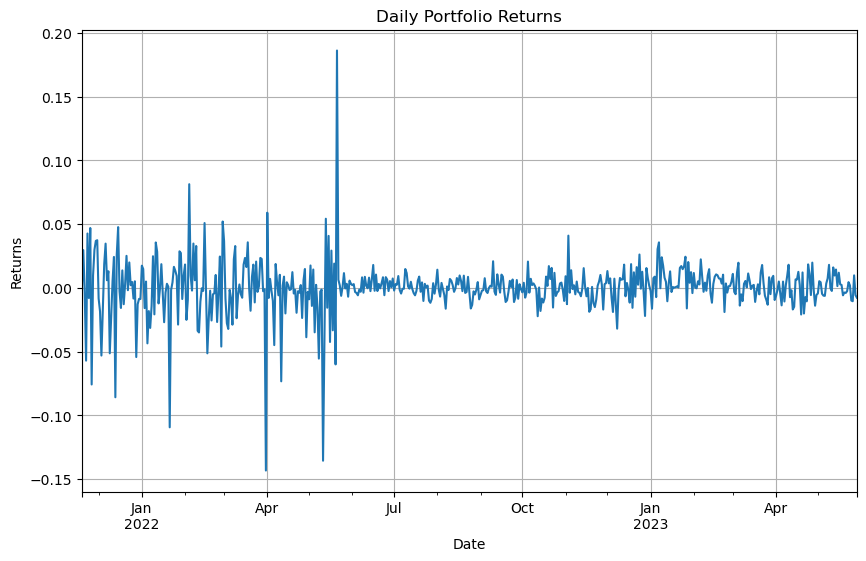

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


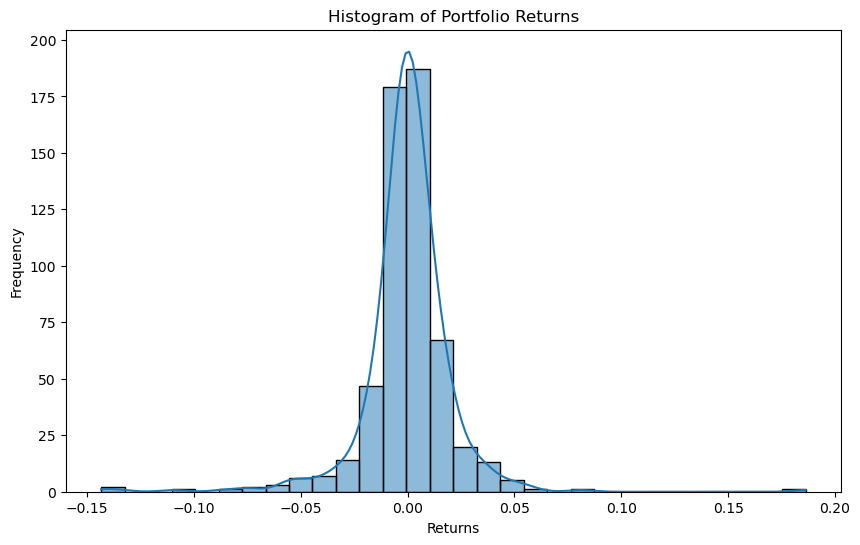

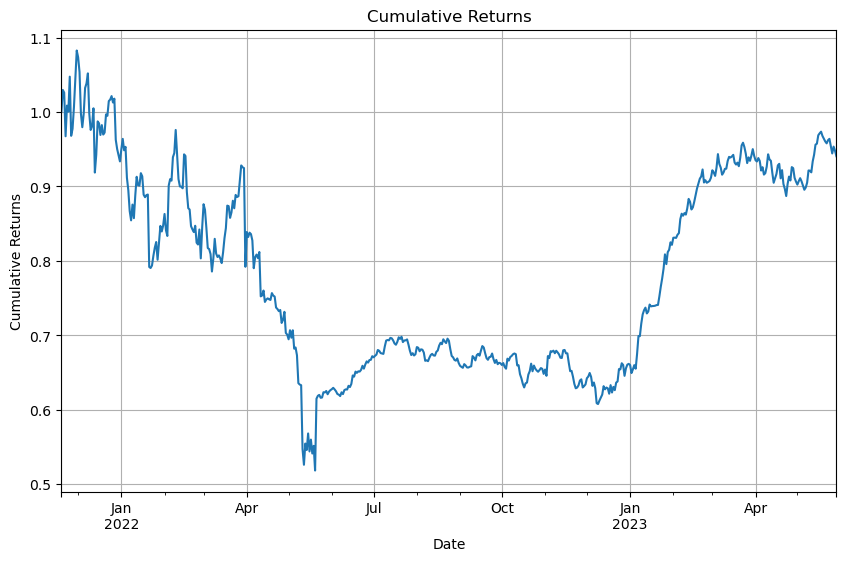

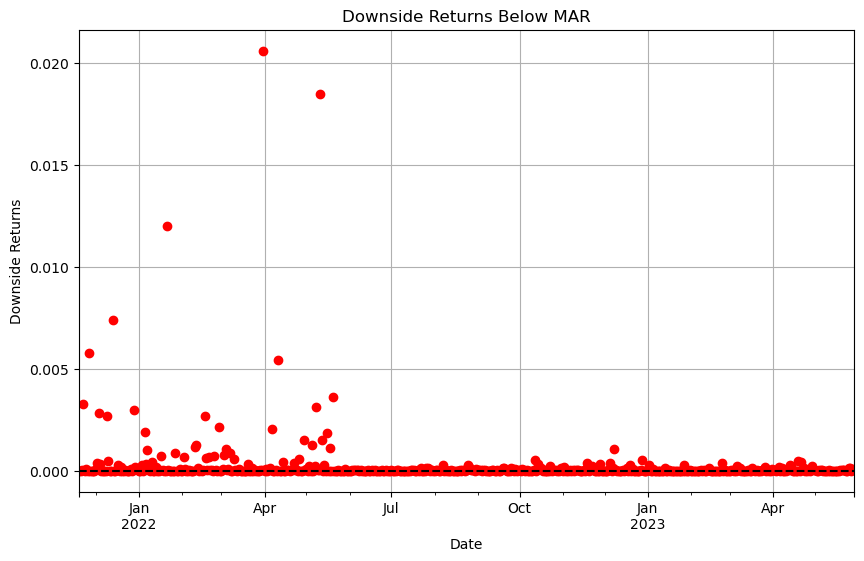

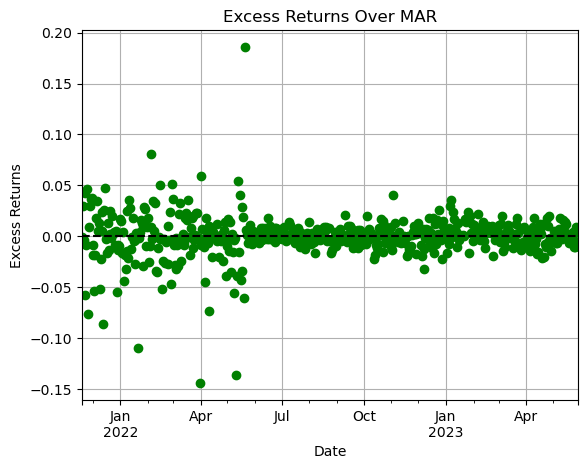

Sortino ratio: -0.28559660507270296
Scaled Sortino diff: 4.3028869766704956e-05
reward -0.12163911876226048
Reward at the end of the cycle on 2023-05-29 00:00:00: -0.40727875270473013
Completed cycle up to 2023-05-29 00:00:00
Running simulation from 2023-05-30 00:00:00 to 2023-06-23 00:00:00
Cycle Number: 16, Epsilon: 0.2033419868933091
State: {'ETH Vault_collateral_usd': 0.22792374832741566, 'stETH Vault_collateral_usd': 0.1546909800401099, 'BTC Vault_collateral_usd': 0.15911996425529454, 'Altcoin Vault_collateral_usd': 0.027400038442941147, 'Stablecoin Vault_collateral_usd': 0.025445820339664606, 'LP Vault_collateral_usd': 0.10960230800244536, 'PSM Vault_collateral_usd': 0.29581714059212877}
Chosen Action: {'stETH Vault_dai_ceiling': 0, 'ETH Vault_dai_ceiling': -0.5, 'BTC Vault_dai_ceiling': -0.25, 'Altcoin Vault_dai_ceiling': 0.25, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0.25, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': -1}, Reason: exploration (random se

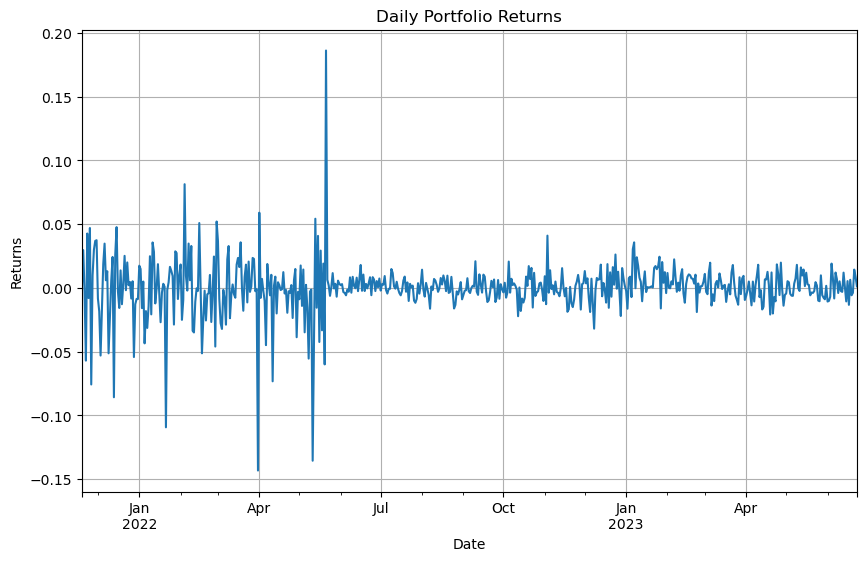

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


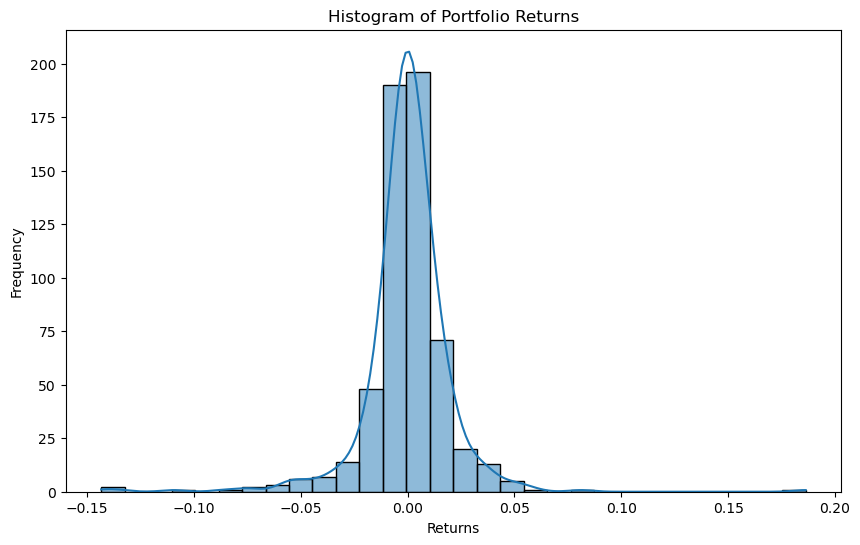

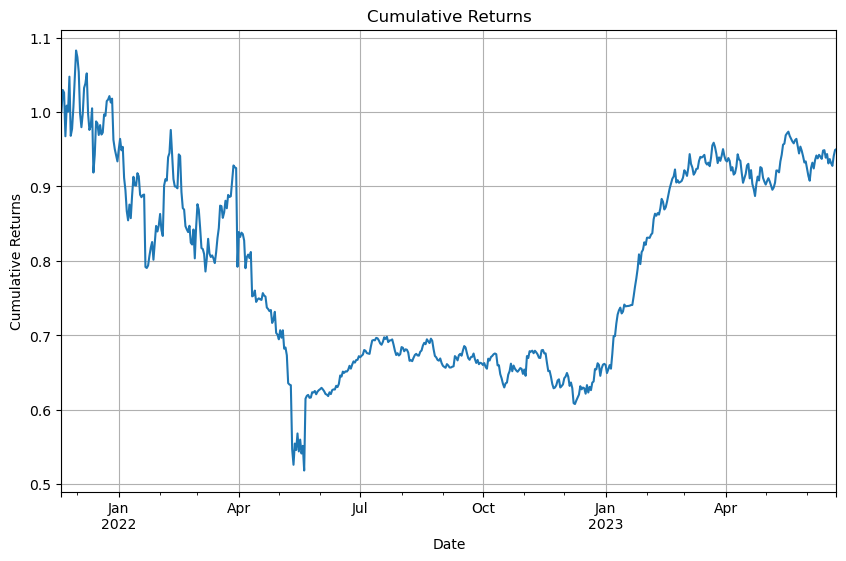

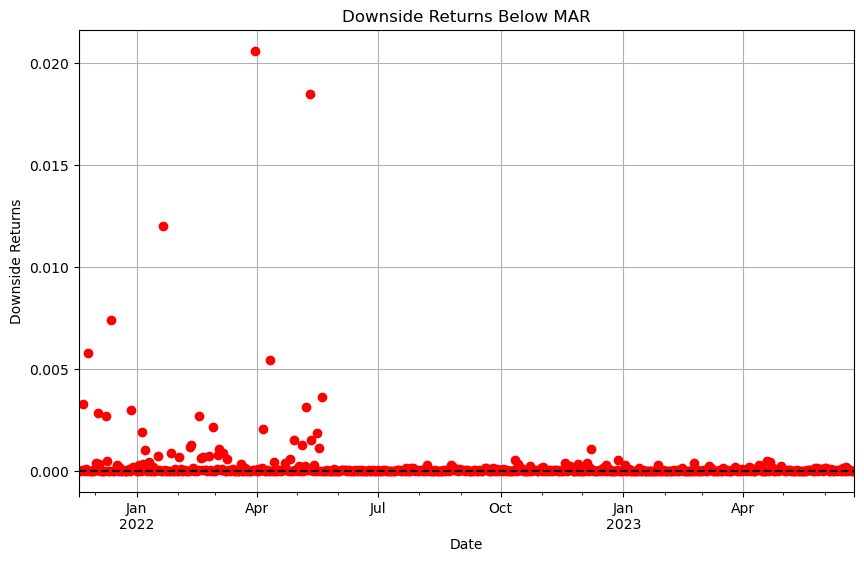

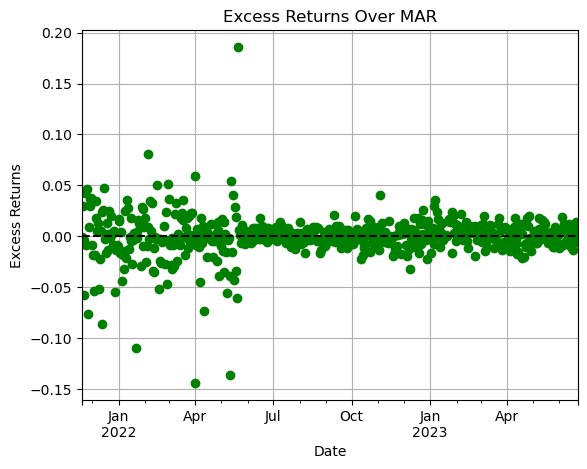

Sortino ratio: -0.2658948340272866
Scaled Sortino diff: 4.1081629066948856e-05
reward -0.12014762313283839
Reward at the end of the cycle on 2023-06-23 00:00:00: -0.38608353878919194
Completed cycle up to 2023-06-23 00:00:00
Running simulation from 2023-06-24 00:00:00 to 2023-07-18 00:00:00
Cycle Number: 17, Epsilon: 0.18351614317121145
State: {'ETH Vault_collateral_usd': 0.22205566105531943, 'stETH Vault_collateral_usd': 0.15591441856829208, 'BTC Vault_collateral_usd': 0.15553948102500031, 'Altcoin Vault_collateral_usd': 0.03162054695692325, 'Stablecoin Vault_collateral_usd': 0.02944786183136619, 'LP Vault_collateral_usd': 0.11292264894715777, 'PSM Vault_collateral_usd': 0.2924993816159409}
Chosen Action: {'stETH Vault_dai_ceiling': -0.5, 'ETH Vault_dai_ceiling': 0.25, 'BTC Vault_dai_ceiling': -1, 'Altcoin Vault_dai_ceiling': -0.25, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': -0.5}, Reason: exploration (random sele

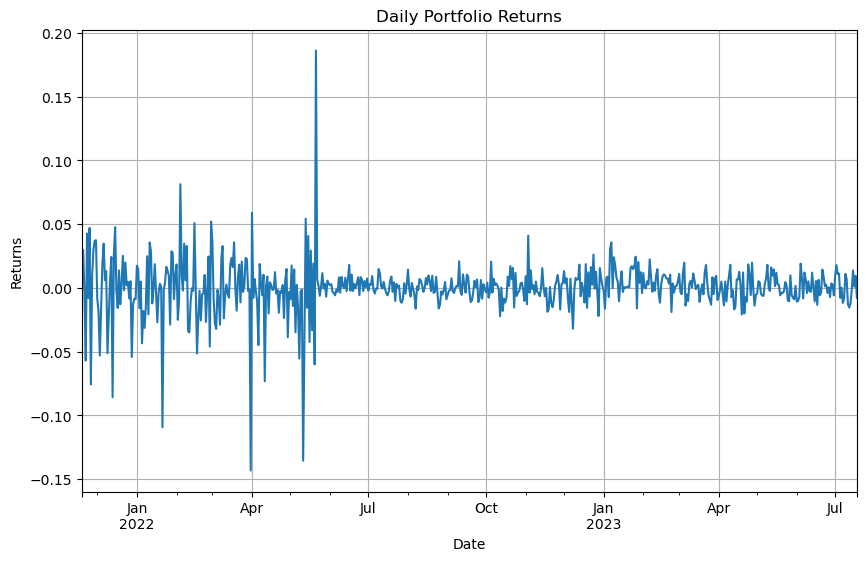

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


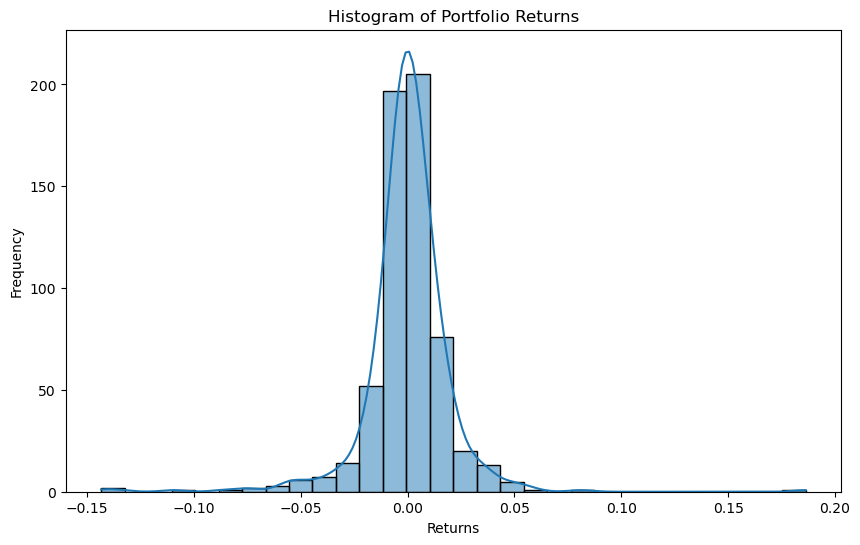

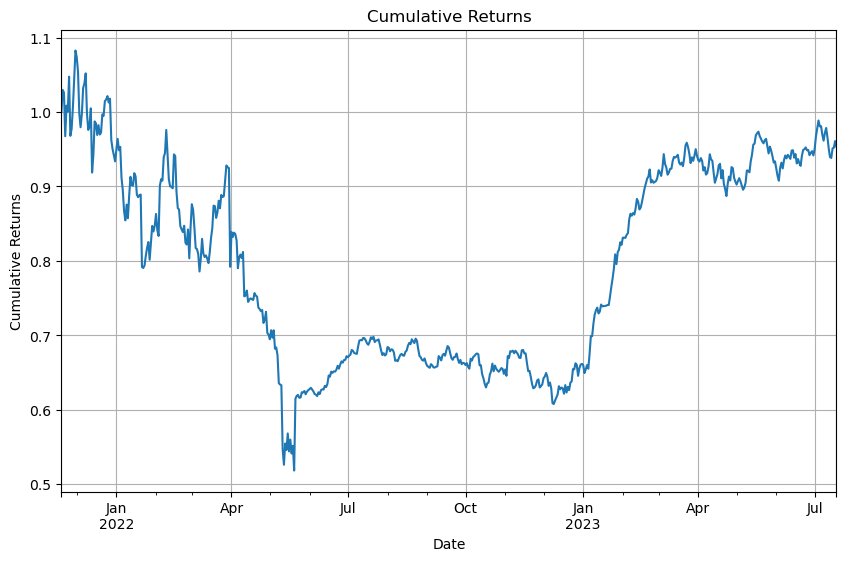

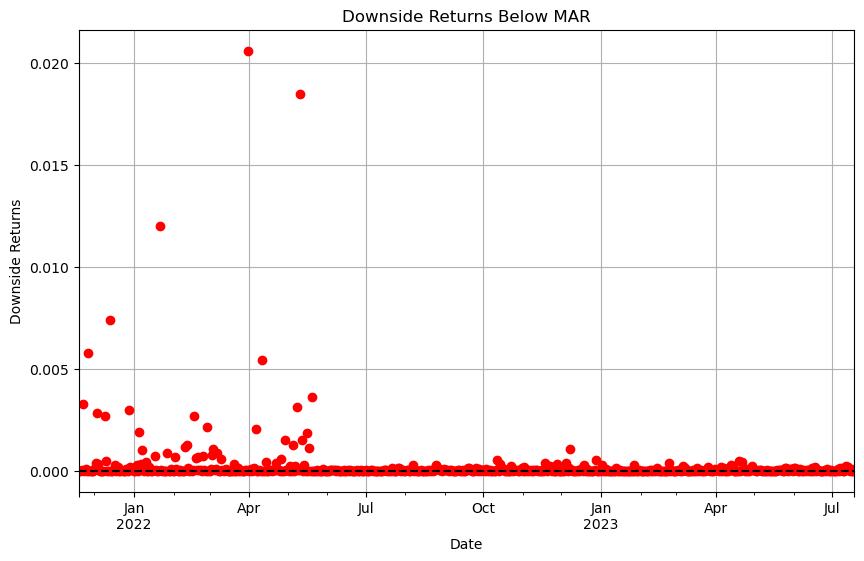

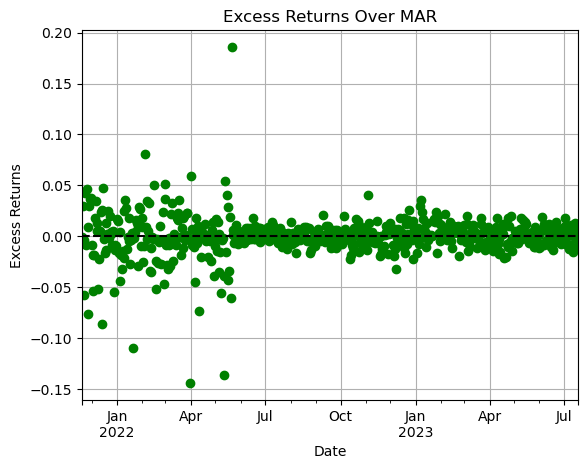

Sortino ratio: -0.2596282827420996
Scaled Sortino diff: 3.842863041716221e-05
reward -0.12009346759827833
Reward at the end of the cycle on 2023-07-18 00:00:00: -0.37976017897079506
Completed cycle up to 2023-07-18 00:00:00
Running simulation from 2023-07-19 00:00:00 to 2023-08-12 00:00:00
Cycle Number: 18, Epsilon: 0.16562331921201834
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.17535678768595264
Desired adjustment -1.7535678768595264
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22535678768595266, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.34195091600019395
Desired adjustment 3.4195091600019394
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closes

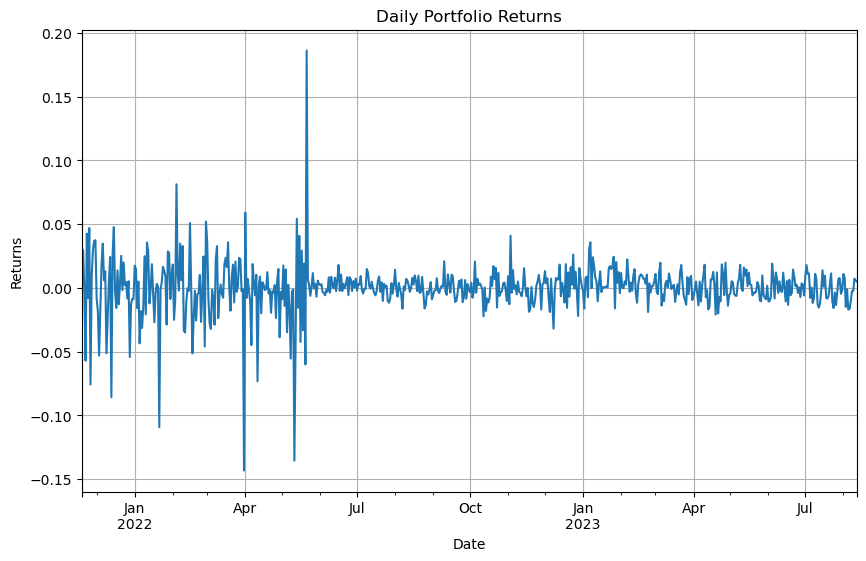

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


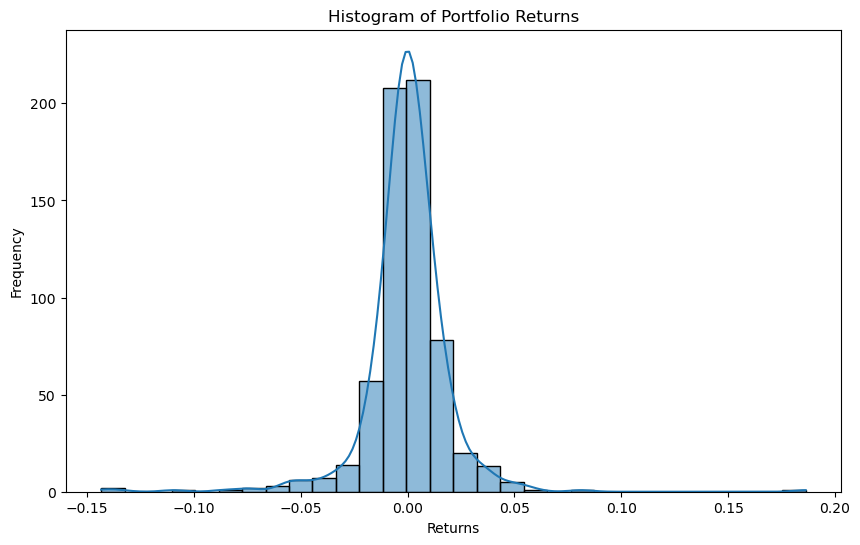

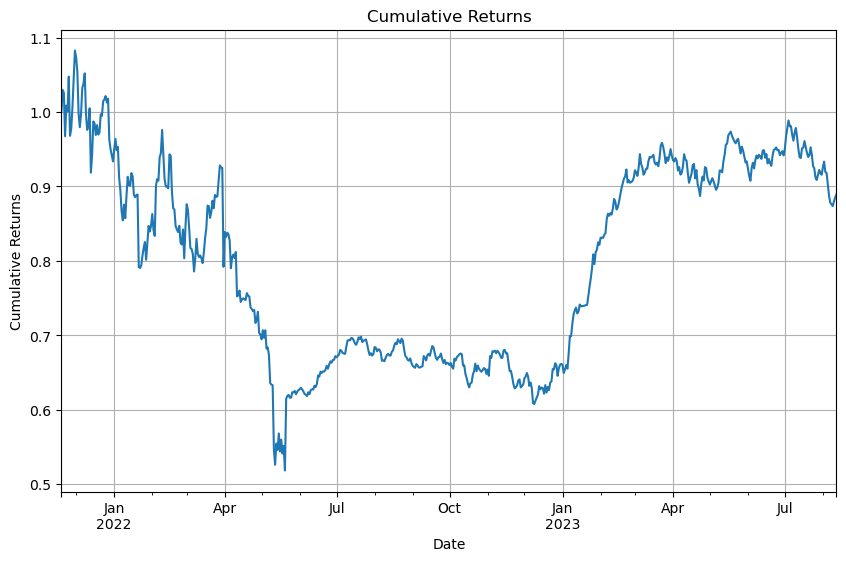

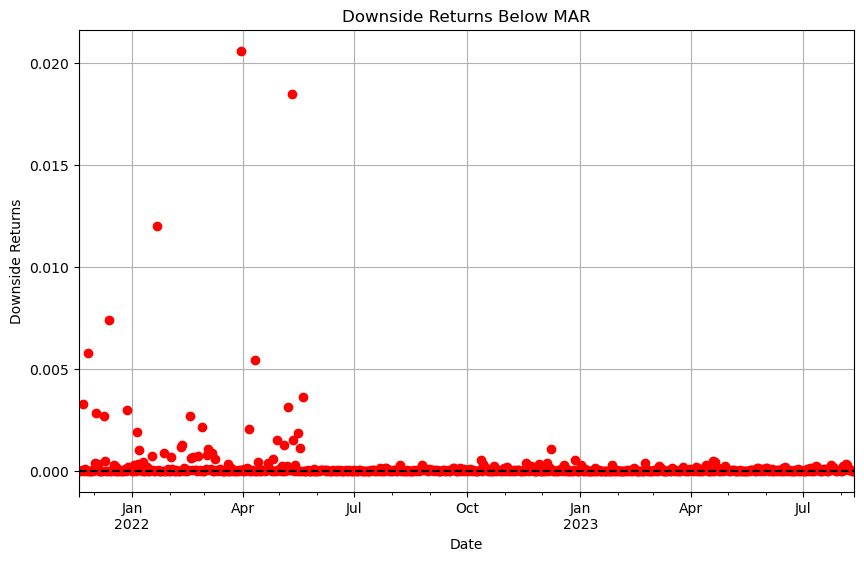

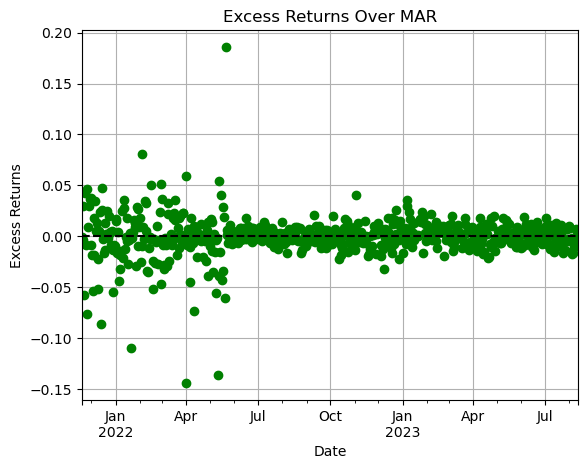

Sortino ratio: -0.38842612546383576
Scaled Sortino diff: 3.5397747436322186e-05
reward -0.11712529123000051
Reward at the end of the cycle on 2023-08-12 00:00:00: -0.5055868144412726
Completed cycle up to 2023-08-12 00:00:00
Running simulation from 2023-08-13 00:00:00 to 2023-09-06 00:00:00
Cycle Number: 19, Epsilon: 0.14947504558884656
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000000373
weight difference -0.1604830487113294
Desired adjustment -1.604830487113294
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.21048304871133314, Target: 0.05000000000000373, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999981
weight difference 0.3334064837964688
Desired adjustment 3.334064837964688
adjustment scale 10
legal adjustme

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


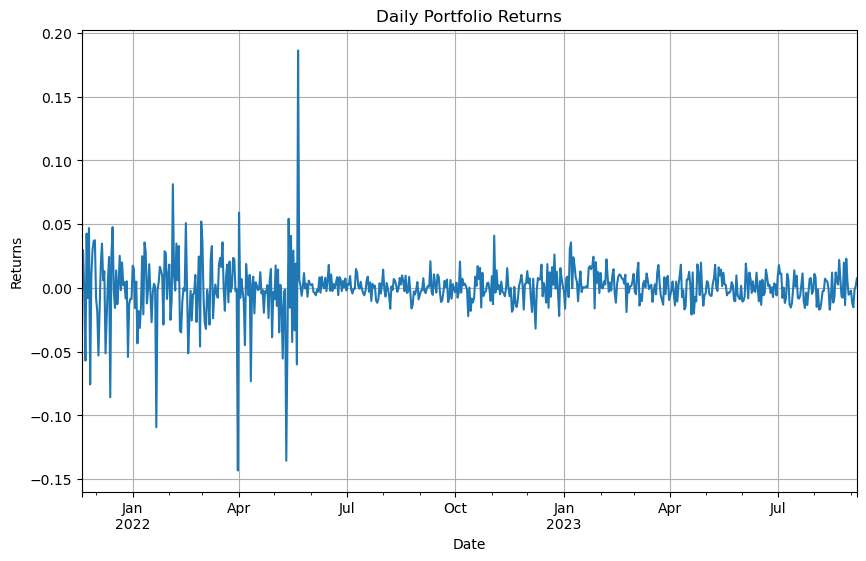

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


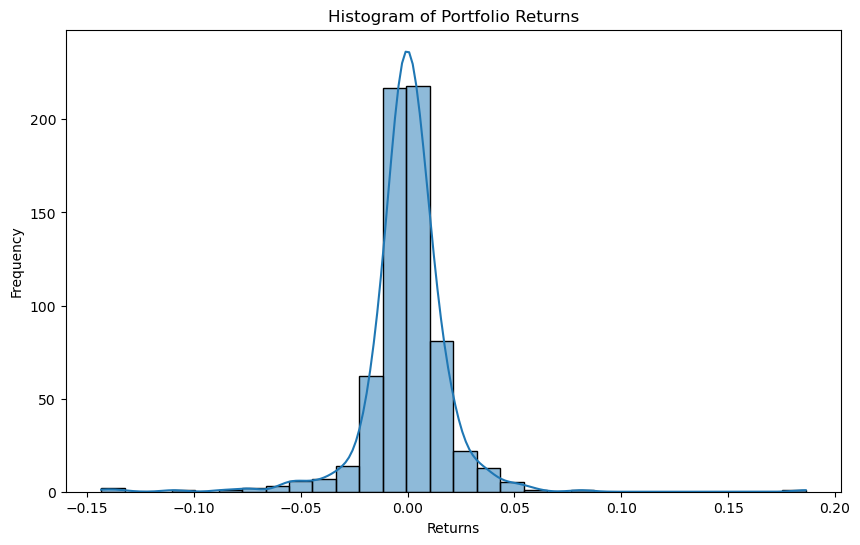

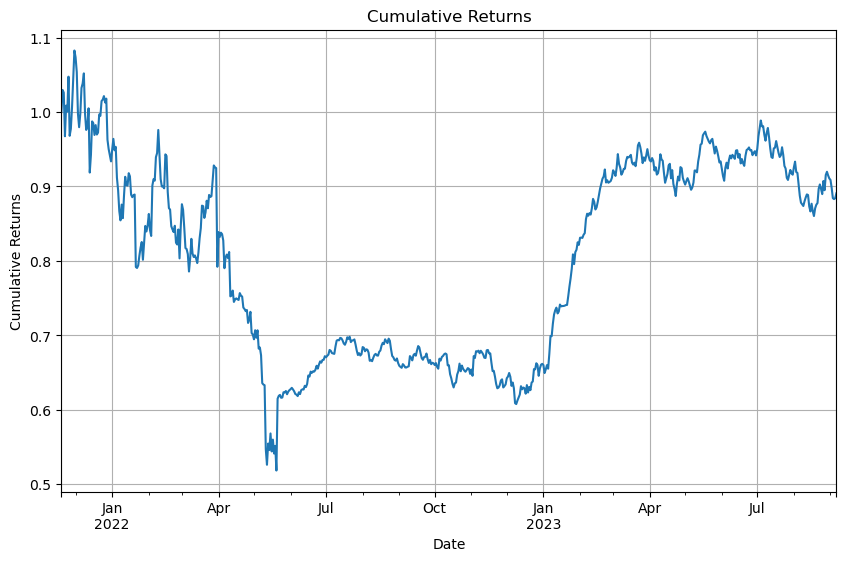

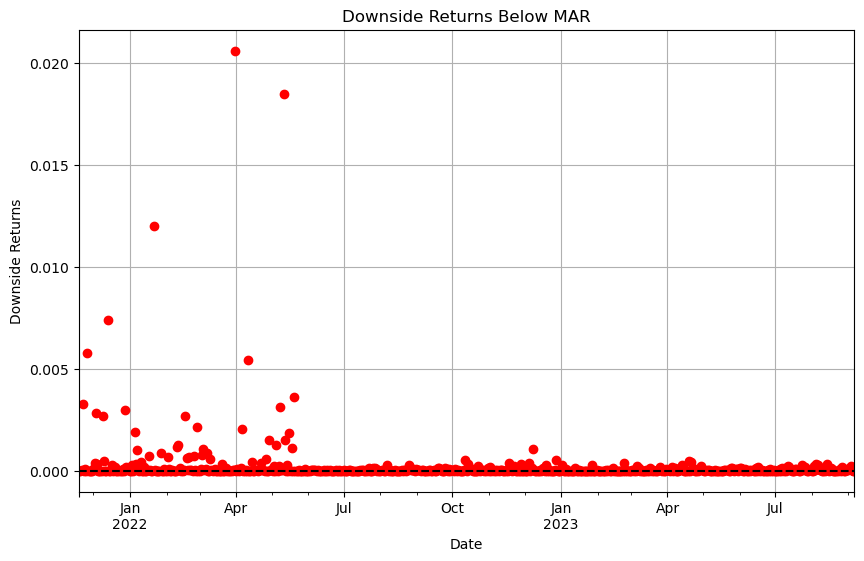

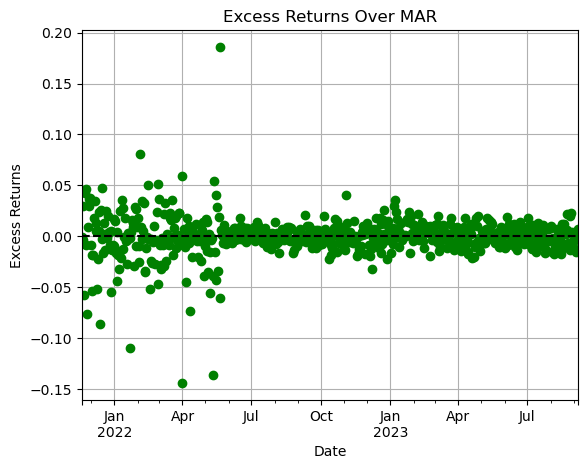

Sortino ratio: -0.38303411623563766
Scaled Sortino diff: 3.281156192700501e-05
reward -0.11683290206783274
Reward at the end of the cycle on 2023-09-06 00:00:00: -0.4998998298653974
Completed cycle up to 2023-09-06 00:00:00
Running simulation from 2023-09-07 00:00:00 to 2023-10-01 00:00:00
Cycle Number: 20, Epsilon: 0.134901228643934
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.0500000000000055
weight difference -0.1549076729177739
Desired adjustment -1.549076729177739
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2049076729177794, Target: 0.0500000000000055, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999999717
weight difference 0.3333845355161916
Desired adjustment 3.333845355161916
adjustment scale 10
legal adjustments [

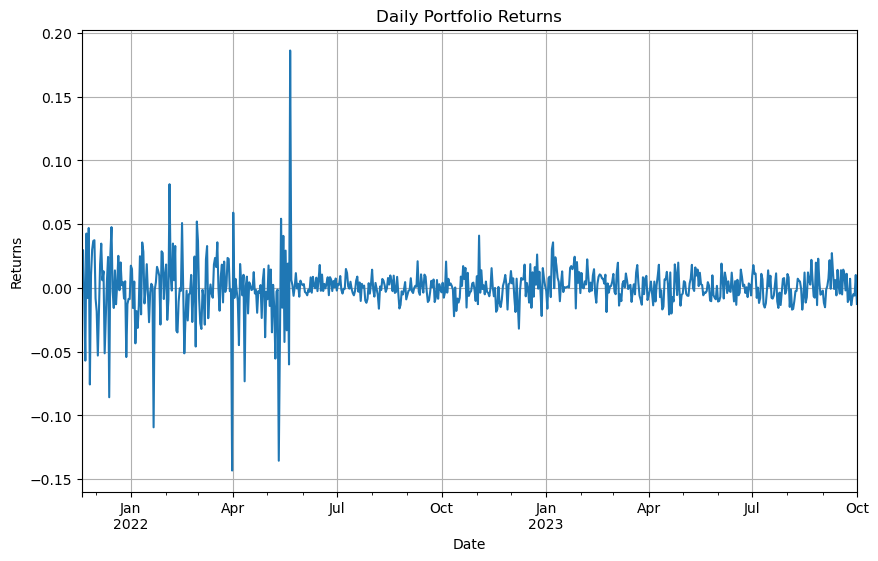

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


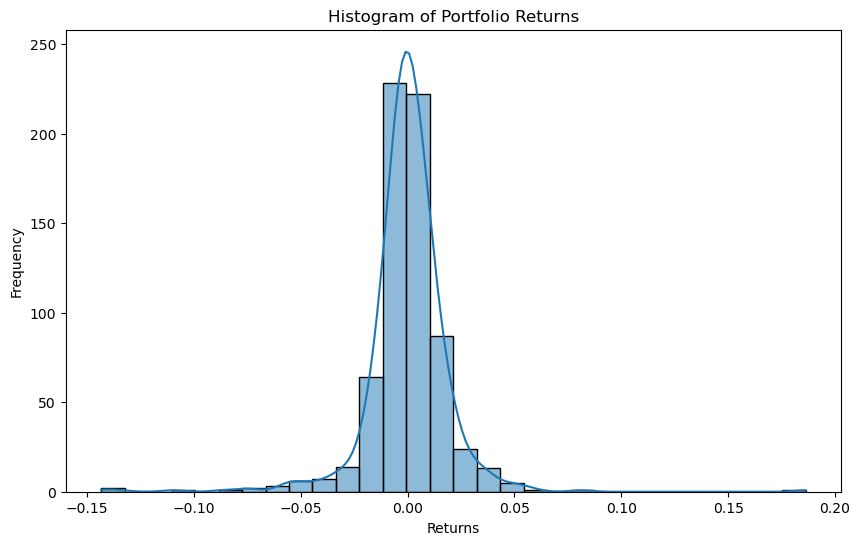

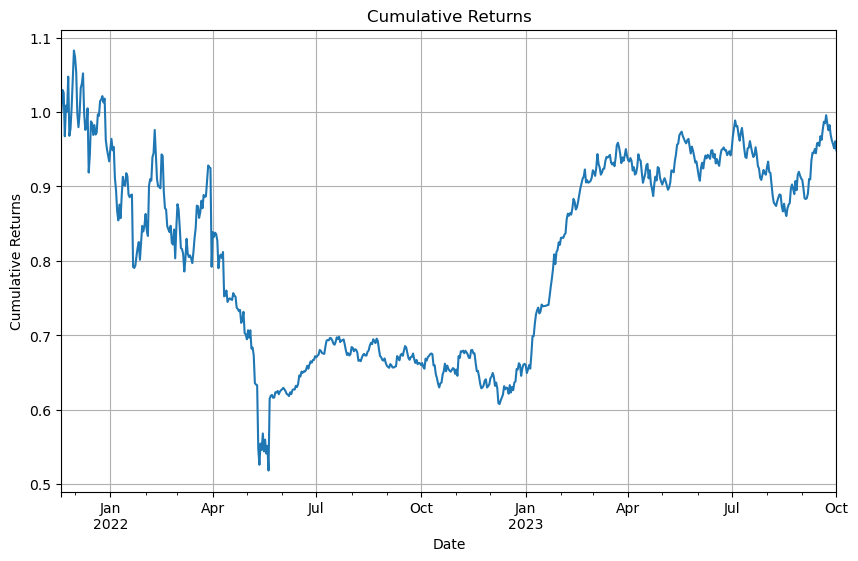

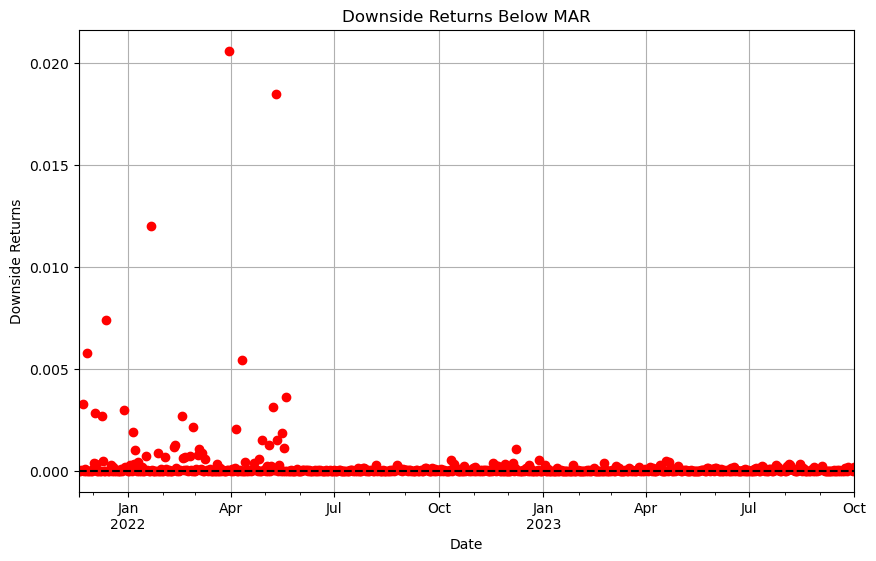

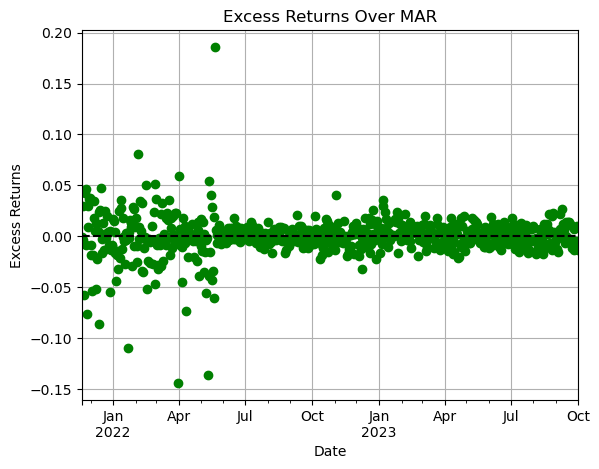

Sortino ratio: -0.2701435510696769
Scaled Sortino diff: 3.1826627556078646e-05
reward -0.11630194622167807
Reward at the end of the cycle on 2023-10-01 00:00:00: -0.38647732391891104
Completed cycle up to 2023-10-01 00:00:00
Running simulation from 2023-10-02 00:00:00 to 2023-10-26 00:00:00
Cycle Number: 21, Epsilon: 0.12174835885115043
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000007365
weight difference -0.17004844211593595
Desired adjustment -1.7004844211593595
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22004844211594332, Target: 0.050000000000007365, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999842
weight difference 0.3283973033144269
Desired adjustment 3.283973033144269
adjustment scale 10
legal adju

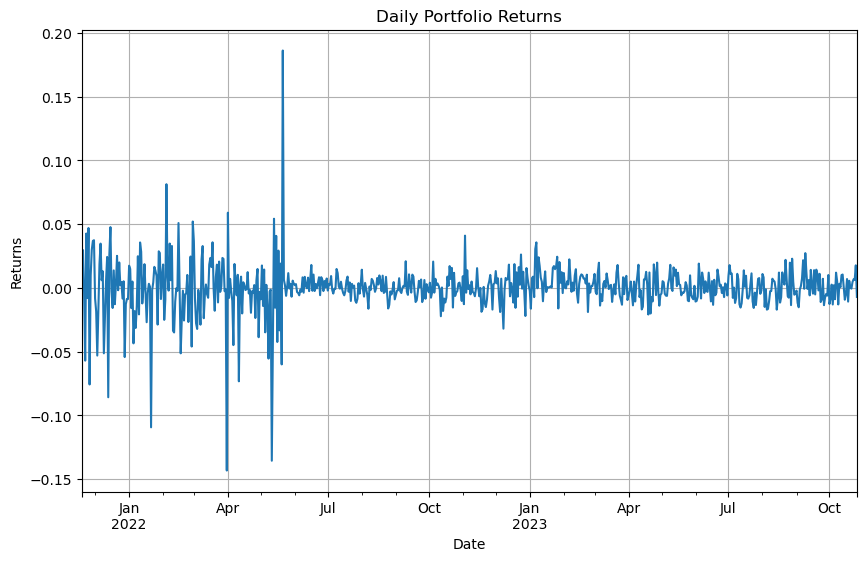

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


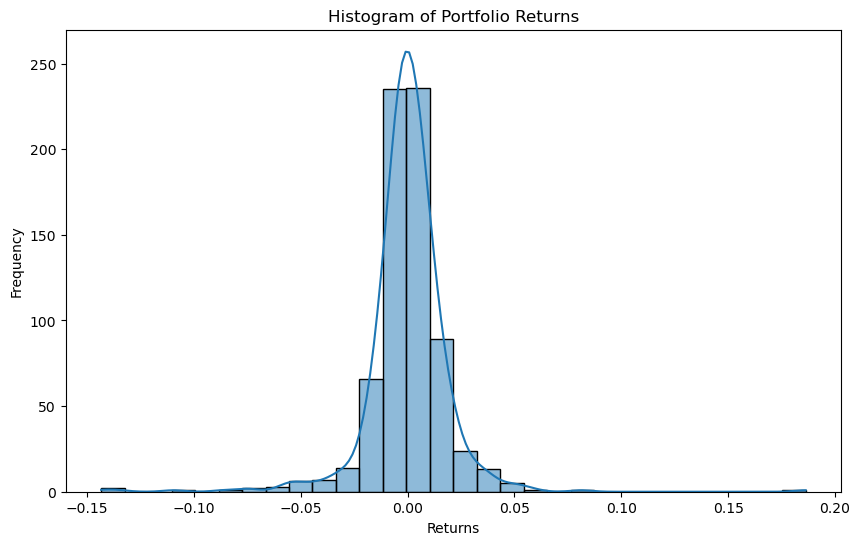

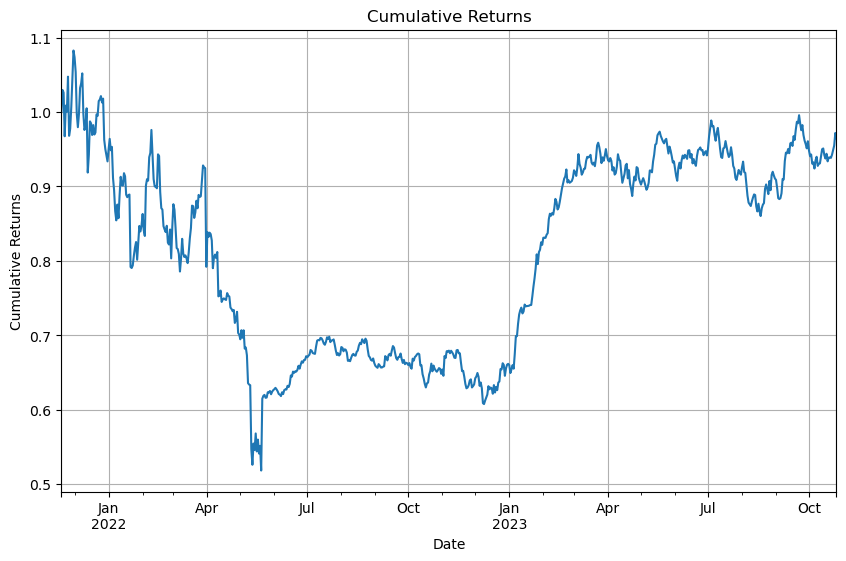

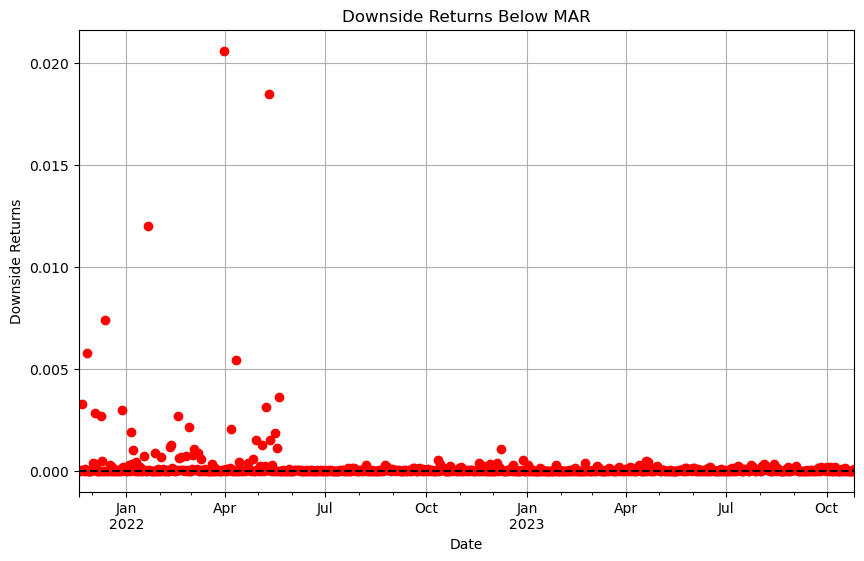

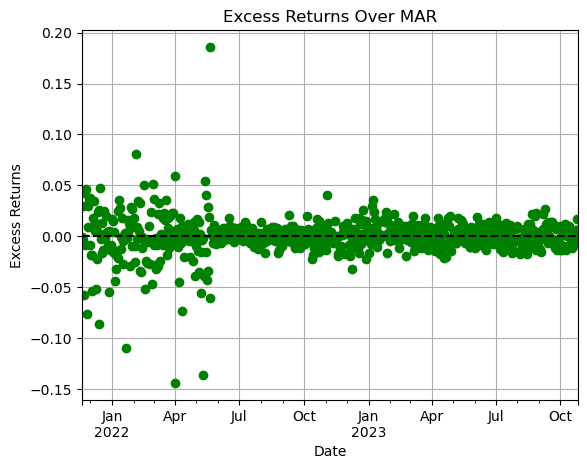

Sortino ratio: -0.24050439698156476
Scaled Sortino diff: 3.010973109277241e-05
reward -0.11580273892519714
Reward at the end of the cycle on 2023-10-26 00:00:00: -0.3563372456378547
Completed cycle up to 2023-10-26 00:00:00
Running simulation from 2023-10-27 00:00:00 to 2023-11-20 00:00:00
Cycle Number: 22, Epsilon: 0.10987789386316325
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000000634
weight difference -0.16454094105027114
Desired adjustment -1.6454094105027115
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.21454094105027177, Target: 0.050000000000000634, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999999944
weight difference 0.32663098951050507
Desired adjustment 3.2663098951050507
adjustment scale 10
legal ad

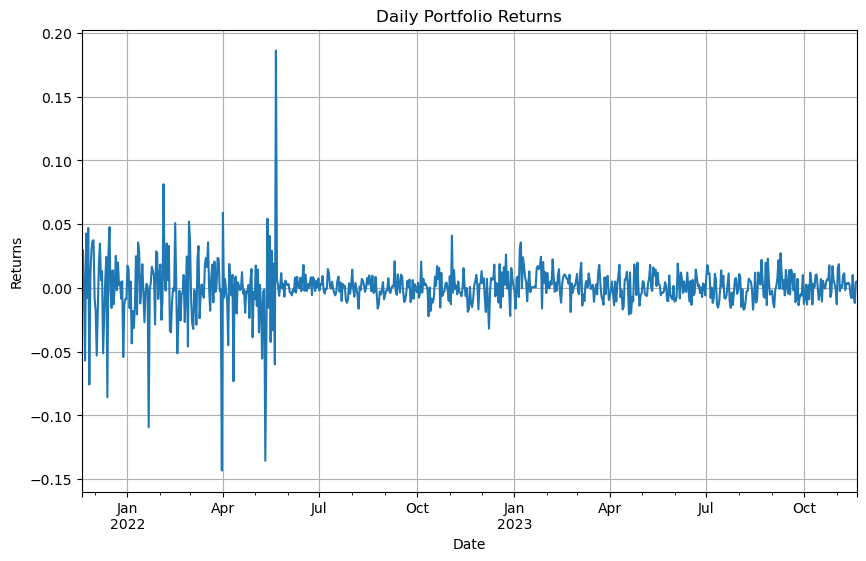

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


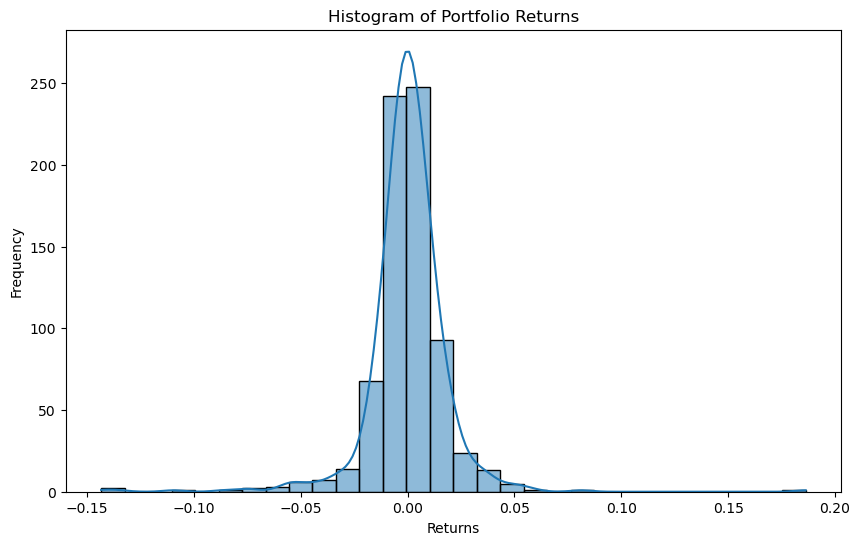

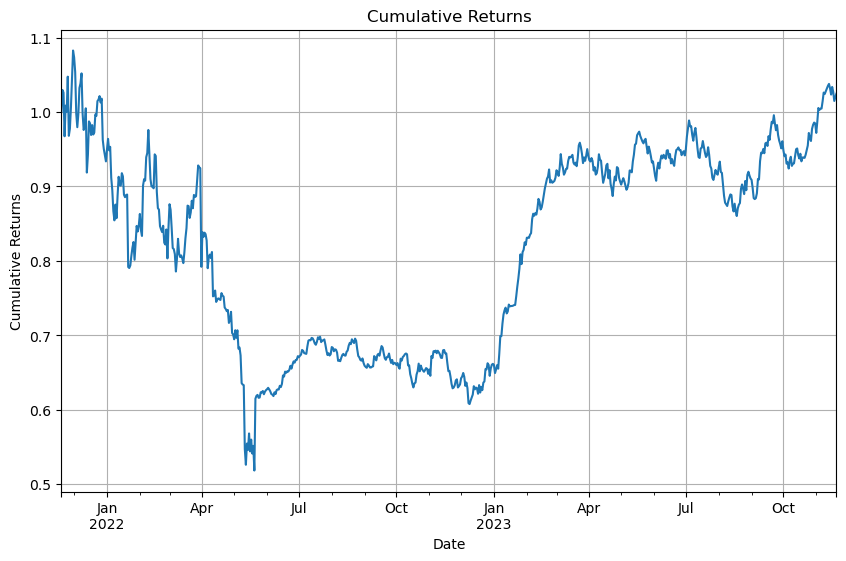

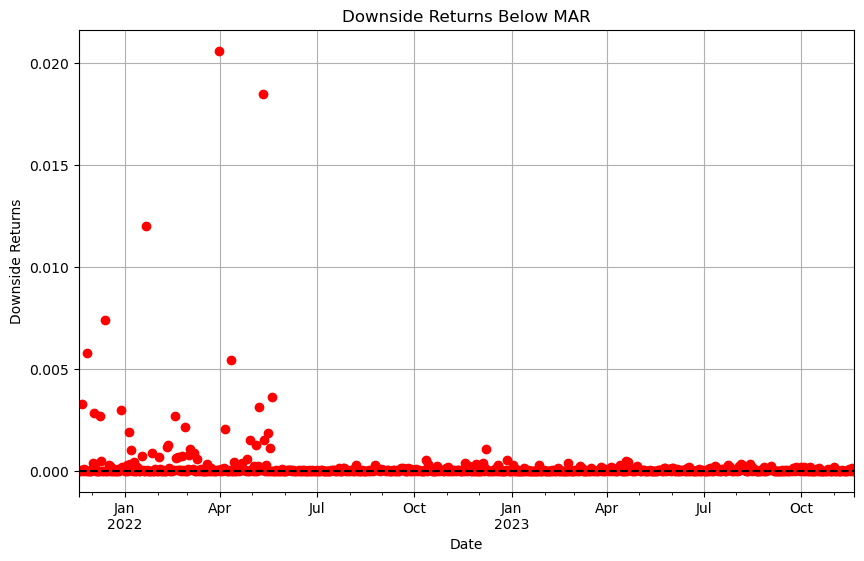

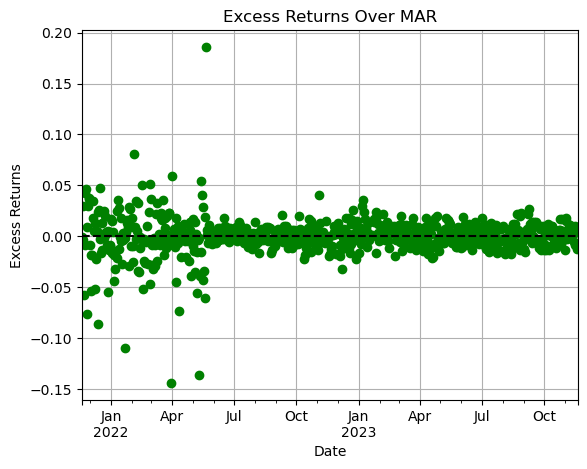

Sortino ratio: -0.1353961922228427
Scaled Sortino diff: 2.9036749401127167e-05
reward -0.11595517740575423
Reward at the end of the cycle on 2023-11-20 00:00:00: -0.251380406377998
Completed cycle up to 2023-11-20 00:00:00
Running simulation from 2023-11-21 00:00:00 to 2023-12-15 00:00:00
Cycle Number: 23, Epsilon: 0.09916479921150484
State: {'ETH Vault_collateral_usd': 0.21522827781983994, 'stETH Vault_collateral_usd': 0.17657766258983643, 'BTC Vault_collateral_usd': 0.1534673103950126, 'Altcoin Vault_collateral_usd': 0.033306250132454425, 'Stablecoin Vault_collateral_usd': 0.023339763759578455, 'LP Vault_collateral_usd': 0.10977654091042362, 'PSM Vault_collateral_usd': 0.28830419439285454}
Chosen Action: {'stETH Vault_dai_ceiling': 0.25, 'ETH Vault_dai_ceiling': 0, 'BTC Vault_dai_ceiling': -0.25, 'Altcoin Vault_dai_ceiling': -1, 'Stablecoin Vault_dai_ceiling': 0, 'LP Vault_dai_ceiling': 0, 'RWA Vault_dai_ceiling': 0, 'PSM Vault_dai_ceiling': -0.5}, Reason: exploration (random selecti

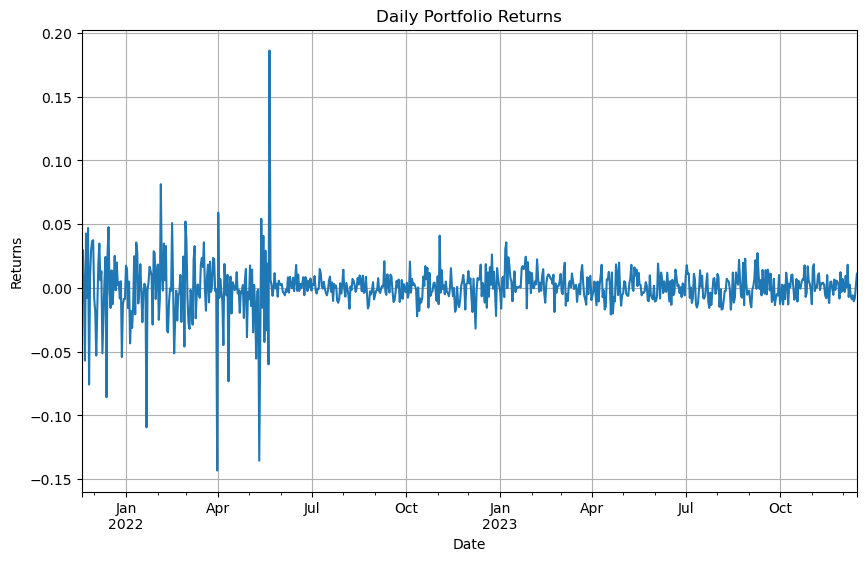

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


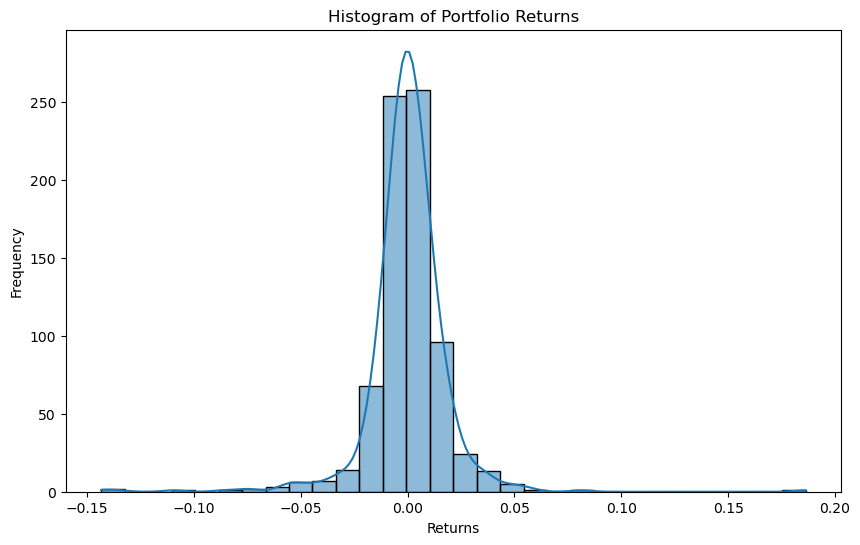

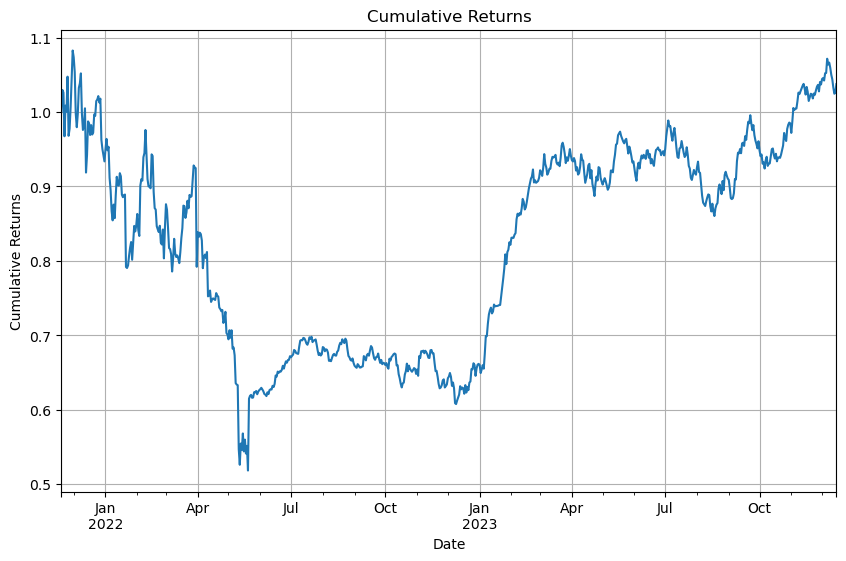

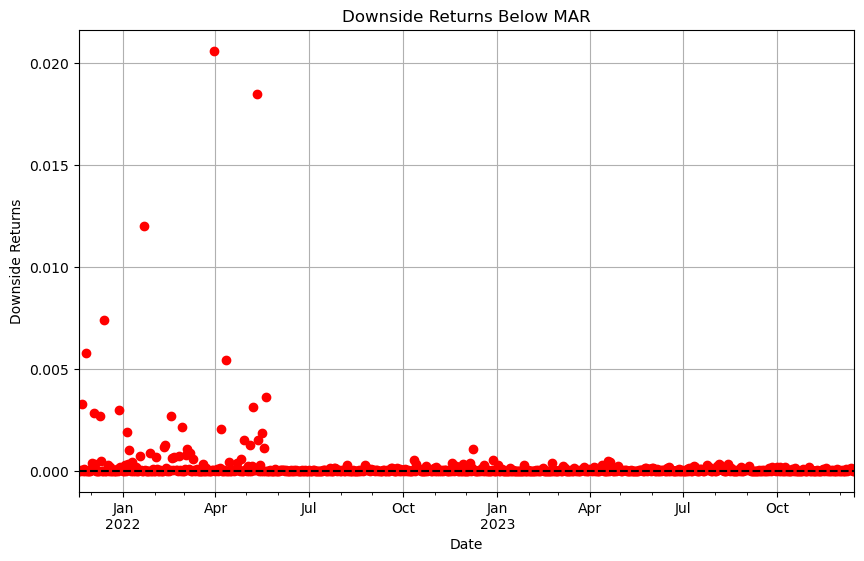

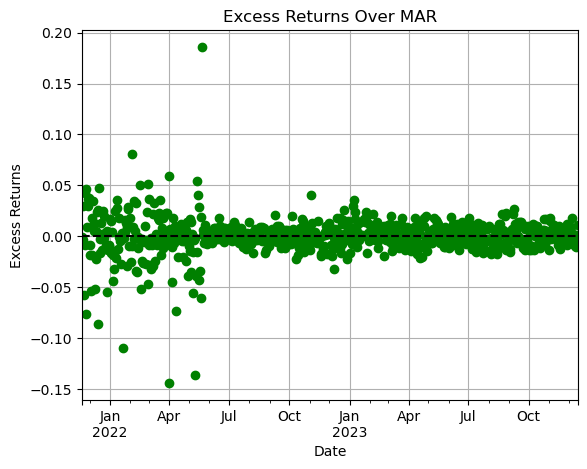

Sortino ratio: -0.11653678414914176
Scaled Sortino diff: 2.768422975031761e-05
reward -0.1158193066061324
Reward at the end of the cycle on 2023-12-15 00:00:00: -0.2323837749850245
Completed cycle up to 2023-12-15 00:00:00
Running simulation from 2023-12-16 00:00:00 to 2024-01-09 00:00:00
Cycle Number: 24, Epsilon: 0.08949623128838312
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.050000000000008614
weight difference -0.16209061985702128
Desired adjustment -1.620906198570213
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2120906198570299, Target: 0.050000000000008614, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999893
weight difference 0.3264056488984003
Desired adjustment 3.2640564889840027
adjustment scale 10
legal adjustm

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


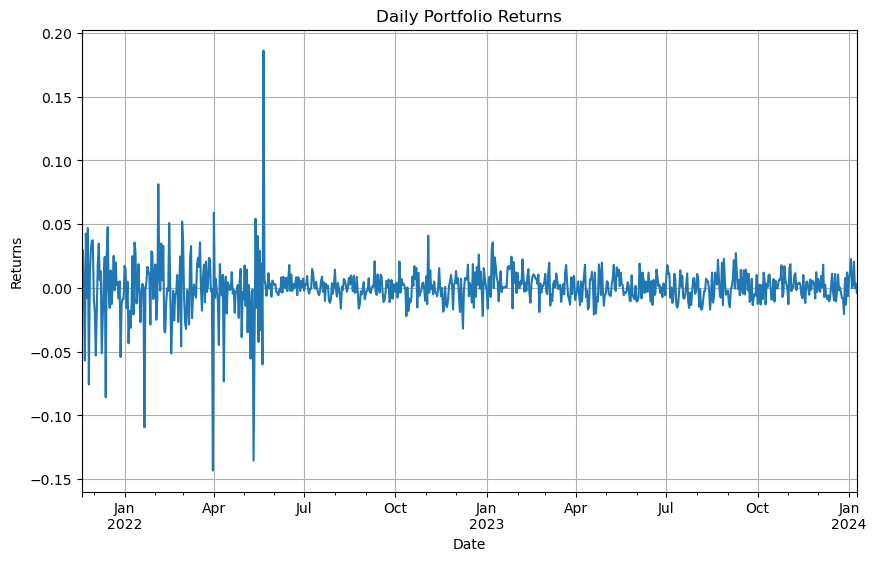

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


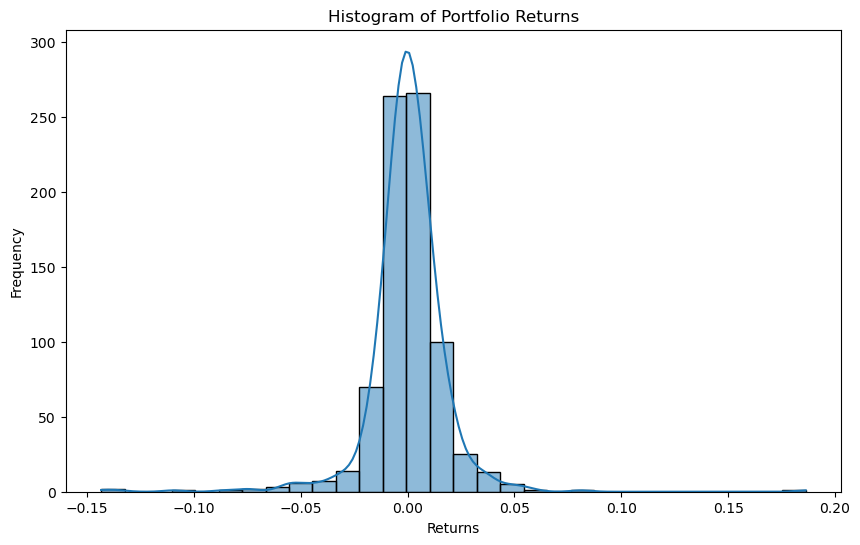

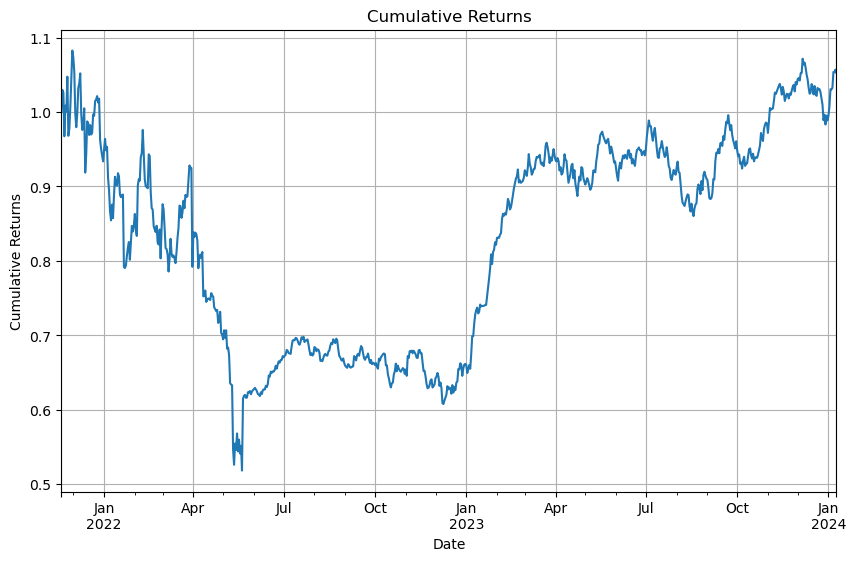

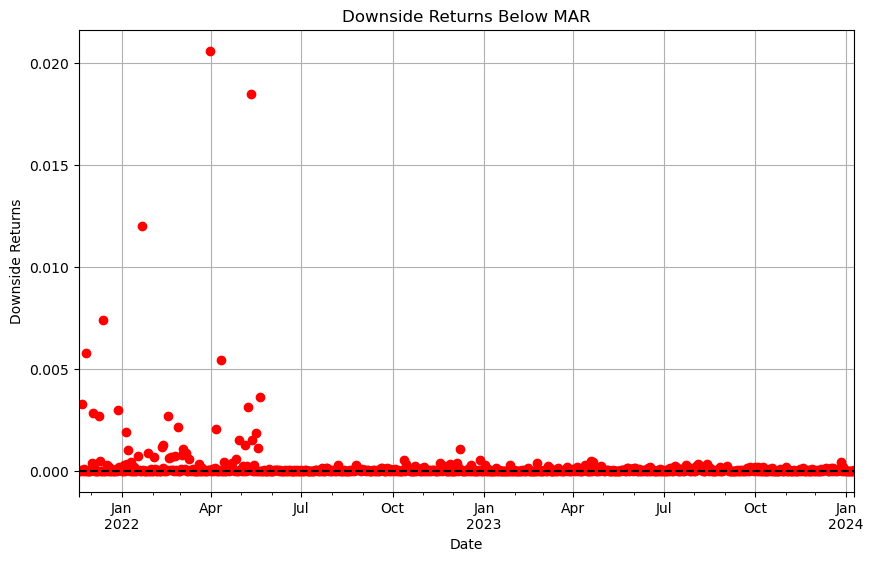

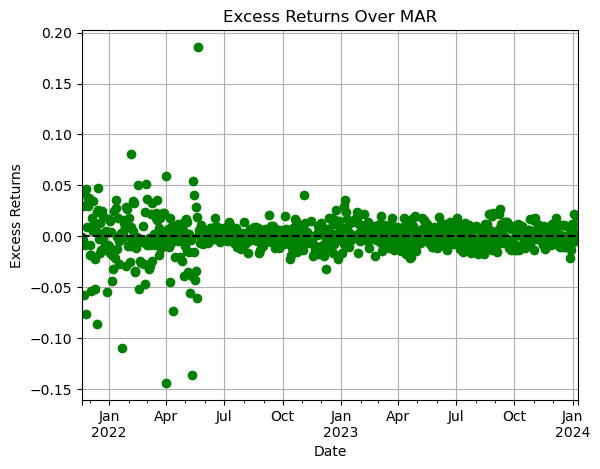

Sortino ratio: -0.09459792412515881
Scaled Sortino diff: 2.6853594877745515e-05
reward -0.11350268776139767
Reward at the end of the cycle on 2024-01-09 00:00:00: -0.20812746548143424
Completed cycle up to 2024-01-09 00:00:00
Running simulation from 2024-01-10 00:00:00 to 2024-02-03 00:00:00
Cycle Number: 25, Epsilon: 0.08077034873776576
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05
weight difference -0.1663974686677117
Desired adjustment -1.663974686677117
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.21639746866771173, Target: 0.05, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.5
weight difference 0.3174815415414203
Desired adjustment 3.1748154154142028
adjustment scale 10
legal adjustments [-1, -0.5, -0.25, 0, 0.25, 0.5]
closest

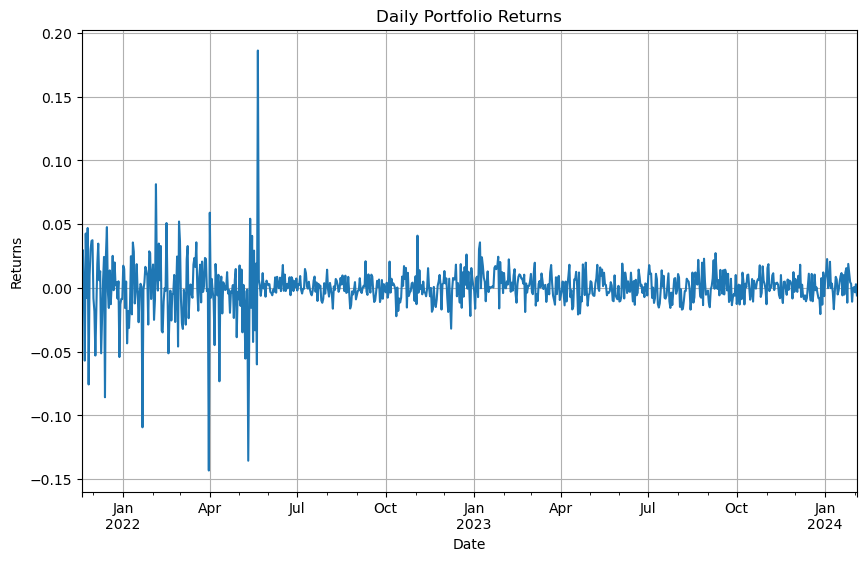

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


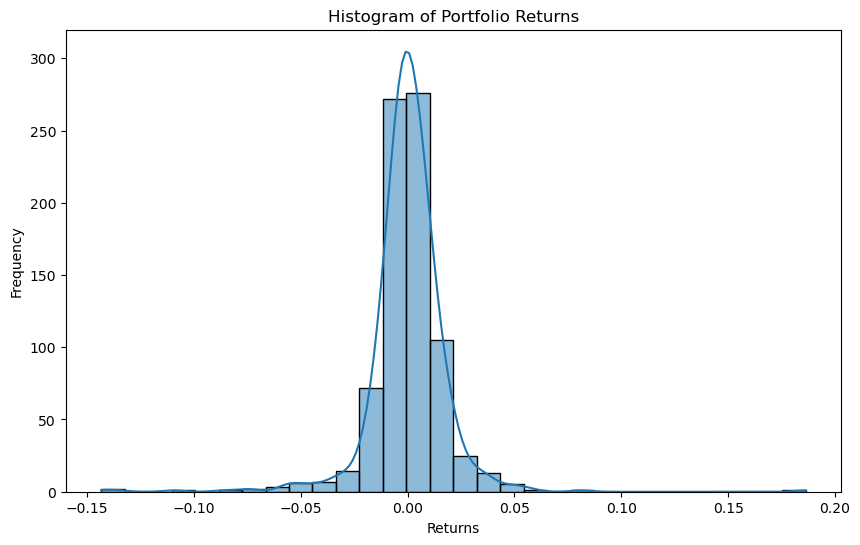

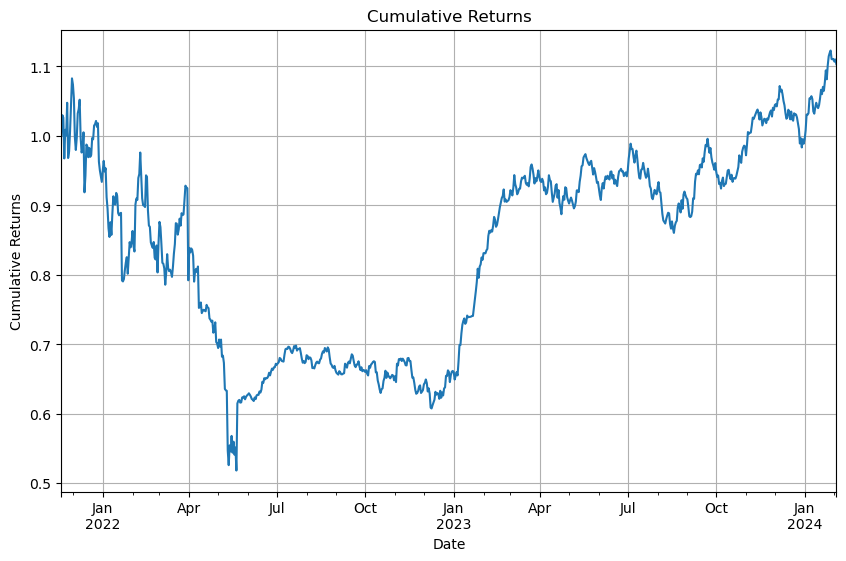

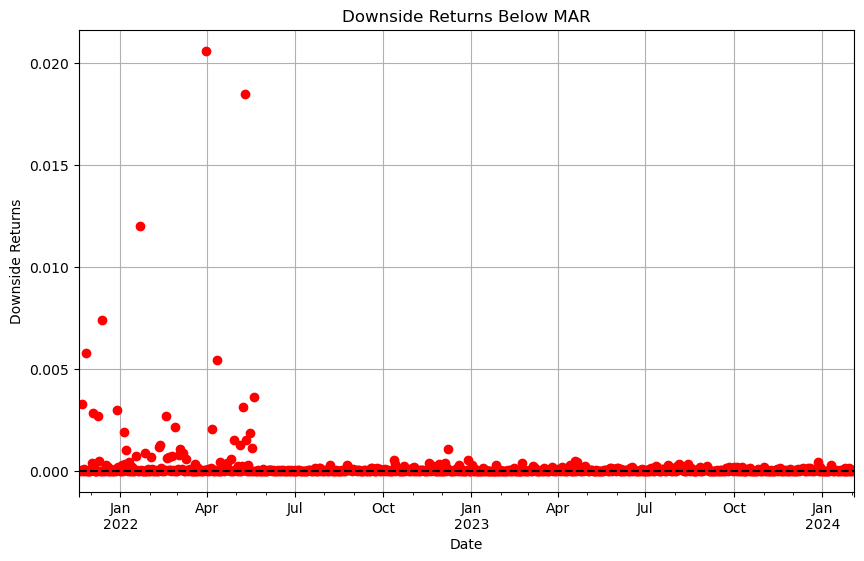

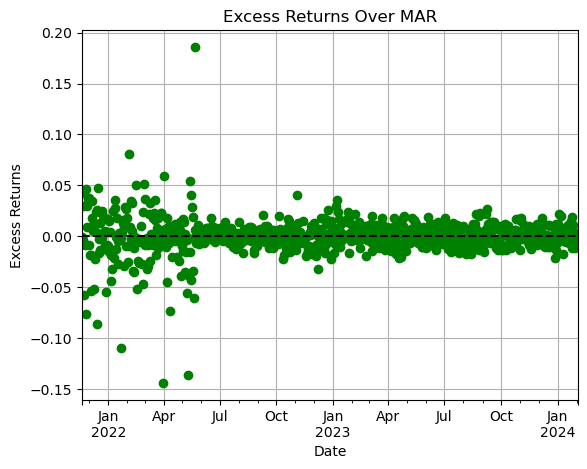

Sortino ratio: -0.017272071357797333
Scaled Sortino diff: 2.5144021620530563e-05
reward -0.11455164386738988
Reward at the end of the cycle on 2024-02-03 00:00:00: -0.13184885924680773
Completed cycle up to 2024-02-03 00:00:00
Running simulation from 2024-02-04 00:00:00 to 2024-02-28 00:00:00
Cycle Number: 26, Epsilon: 0.07289523973583359
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000000387
weight difference -0.17003632933903465
Desired adjustment -1.7003632933903465
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.22003632933903852, Target: 0.05000000000000387, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.4999999999999978
weight difference 0.3187135371427515
Desired adjustment 3.187135371427515
adjustment scale 10
legal adju

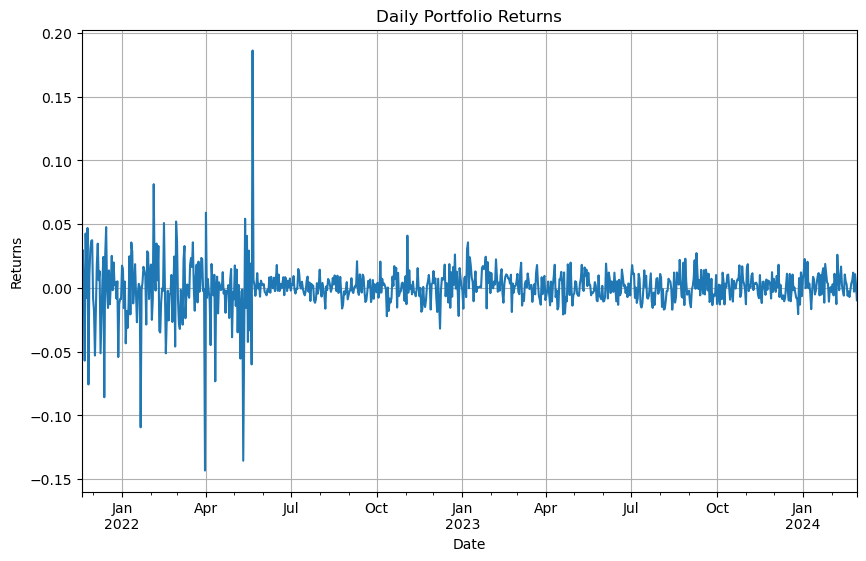

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


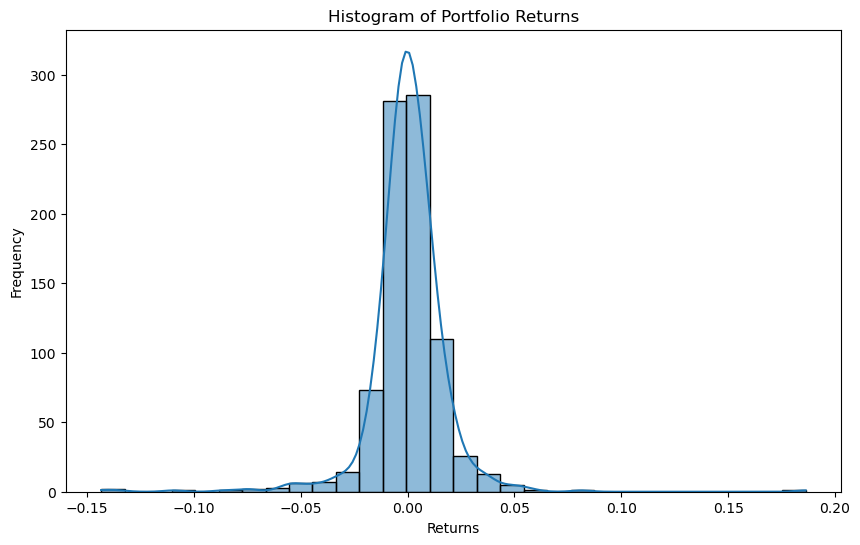

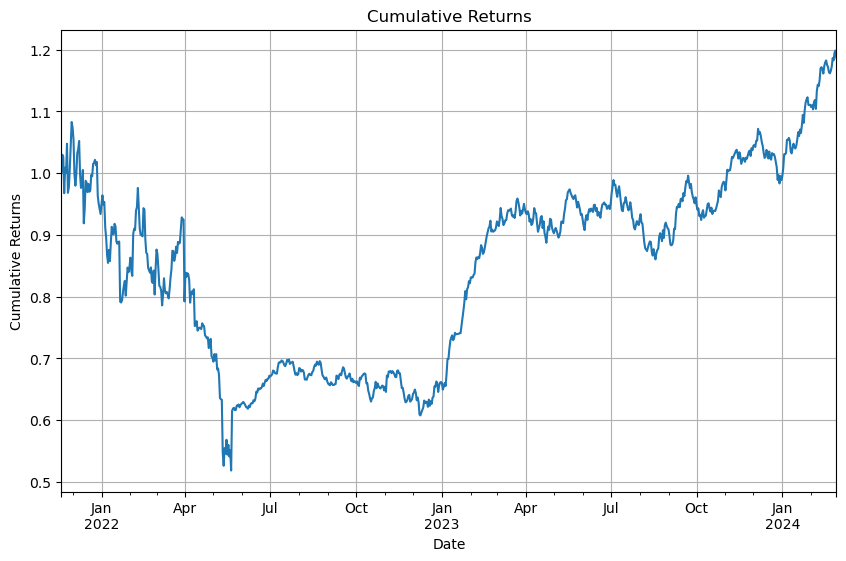

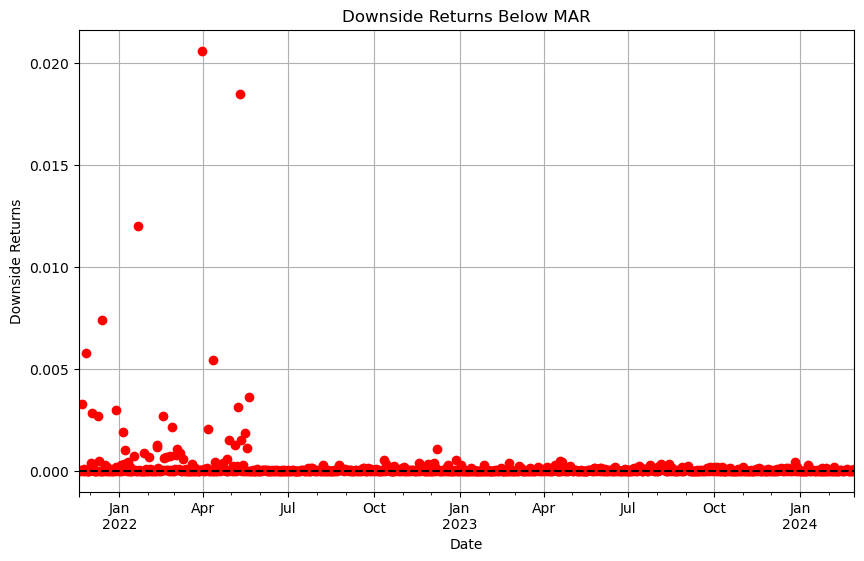

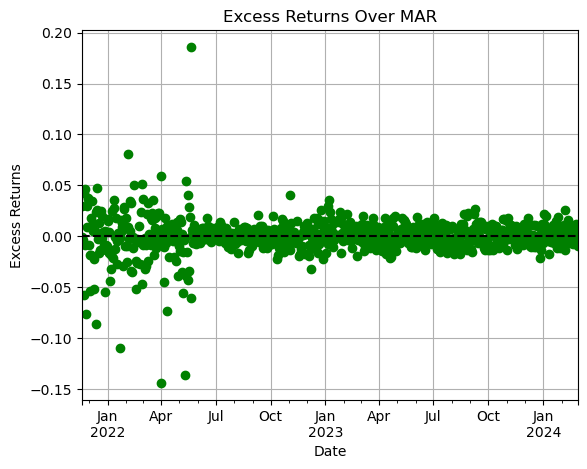

Sortino ratio: 0.10554208058048081
Scaled Sortino diff: 2.3971168217258887e-05
reward -0.11552073083517421
Reward at the end of the cycle on 2024-02-28 00:00:00: -0.010002621422910654
Completed cycle up to 2024-02-28 00:00:00
Running simulation from 2024-02-29 00:00:00 to 2024-03-20 00:00:00
Cycle Number: 27, Epsilon: 0.06578795386158981
Calculating dynamic strategy based on optimized weights...
vault ETH Vault_collateral_usd
vault ETH Vault_dai_ceiling
target weights in calc 0.05000000000001232
weight difference -0.1768119913838242
Desired adjustment -1.768119913838242
adjustment scale 10
legal adjustments [-1.5, -1.25, -1, -0.5, -0.25, 0, 0.25]
closest adjustment -1.5
Vault: ETH Vault_collateral_usd, Current: 0.2268119913838365, Target: 0.05000000000001232, Adjustment: -1.5
vault stETH Vault_collateral_usd
vault stETH Vault_dai_ceiling
target weights in calc 0.49999999999999195
weight difference 0.3205270895819113
Desired adjustment 3.2052708958191127
adjustment scale 10
legal adjust

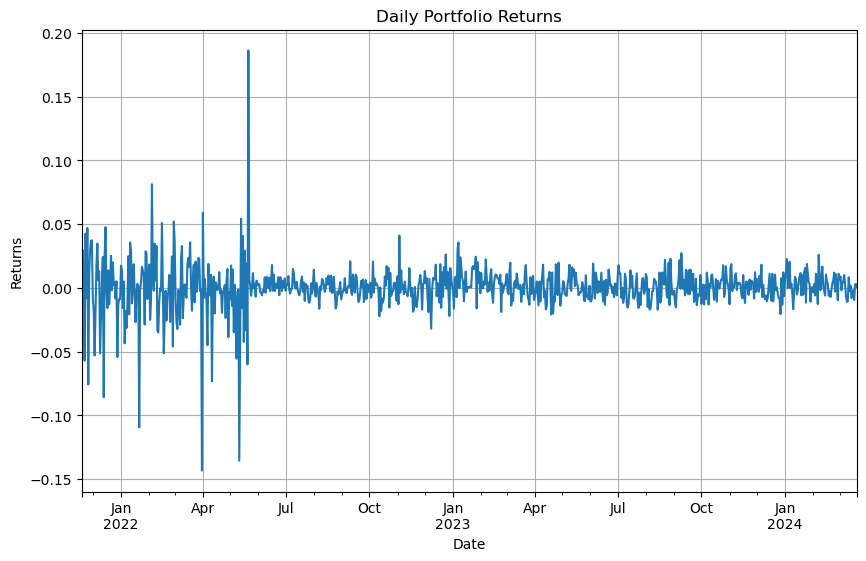

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


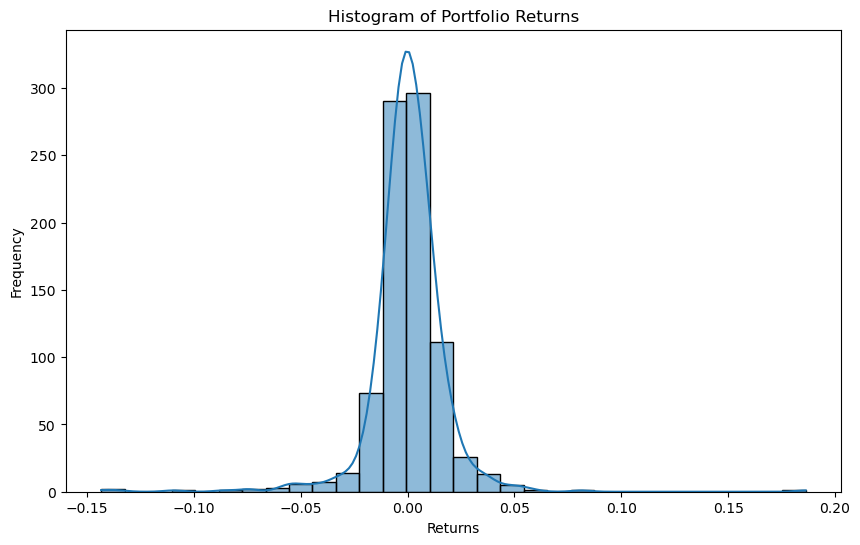

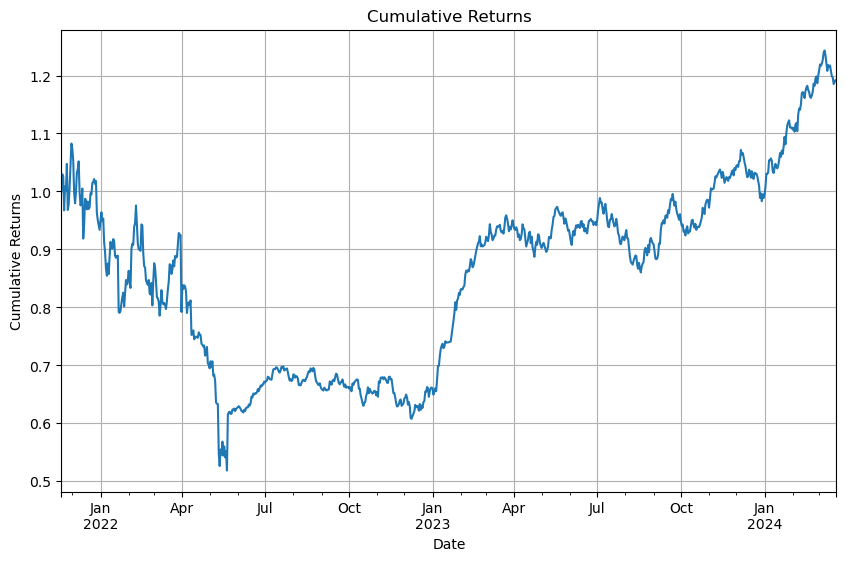

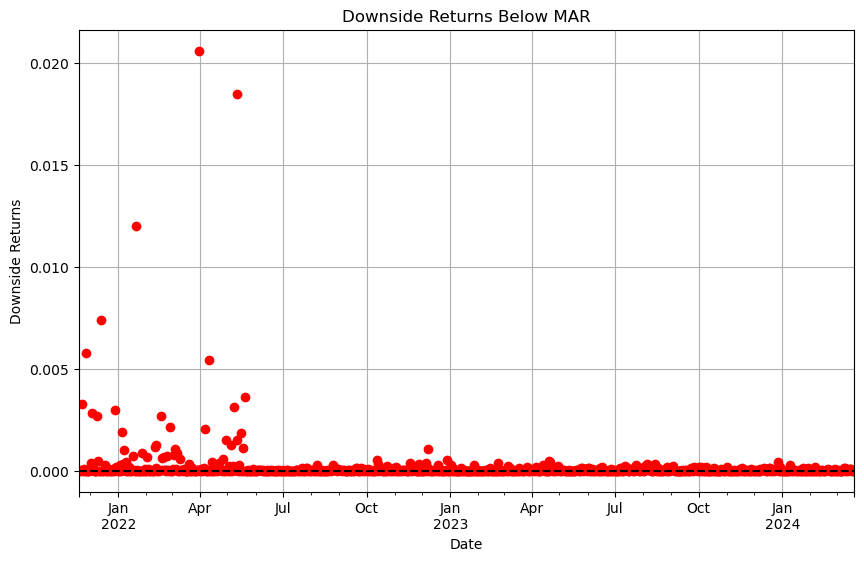

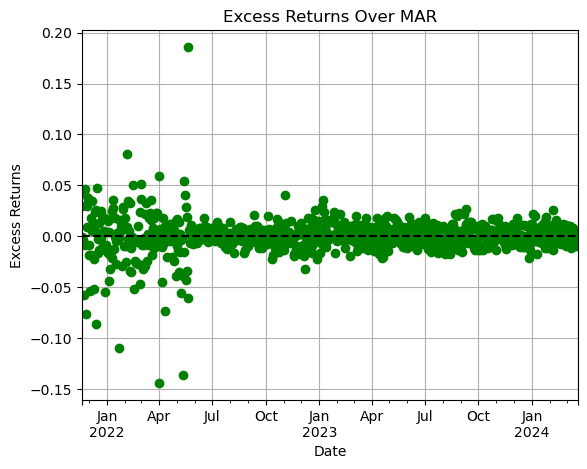

Sortino ratio: 0.1079680072599847
Scaled Sortino diff: 2.3505650971434898e-05
reward -0.1139285921783673
Reward at the end of the cycle on 2024-03-20 00:00:00: -0.005984090569354034
Reached or passed end date: stopping simulation at 2024-03-21 00:00:00


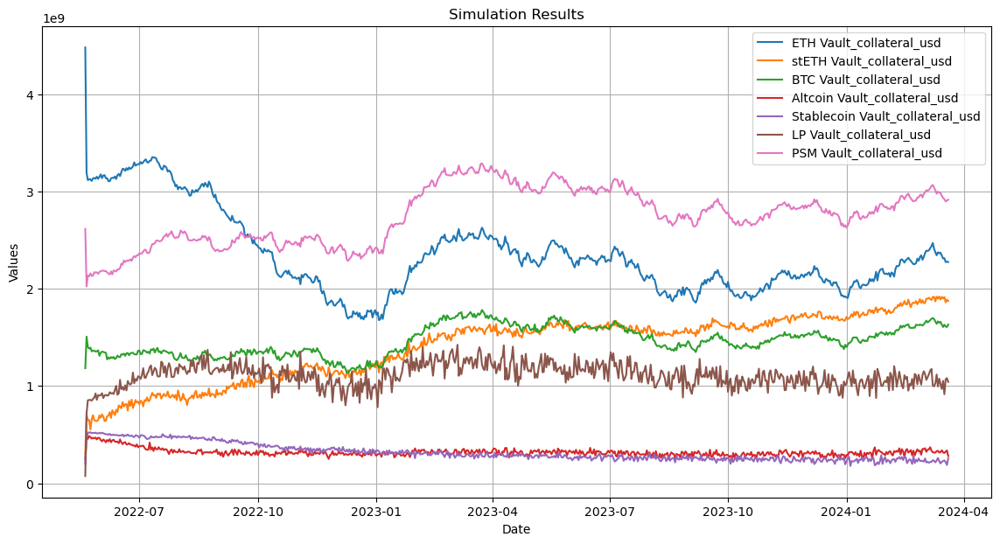

In [901]:
# Define action space as a list of dictionaries
vault_action_ranges = {
    'stETH Vault_dai_ceiling': [-1, -0.5, -0.25, 0, 0.25, 0.5],  # Larger steps due to higher volatility or other reasons
    'ETH Vault_dai_ceiling': [-1.5, -1.25,-1,-0.5,-0.25, 0, 0.25],
    'BTC Vault_dai_ceiling': [-1, -0.5, -0.25, 0, 0.25],
    'Altcoin Vault_dai_ceiling': [-2, -1, -0.25, 0, 0.25],  # Simpler adjustments
    'Stablecoin Vault_dai_ceiling': [0], # need so that agent logic does not decrease a ceiling already @ 0
    'LP Vault_dai_ceiling': [-0.25, 0, 0.25],
    'RWA Vault_dai_ceiling': [0],
    'PSM Vault_dai_ceiling': [-1, -0.5, 0, 0.5]
}
action_space = generate_action_space(vault_action_ranges)

# Assuming `optimized_weight_dict` and `initial_weights` are defined elsewhere in your script
agent = RlAgent(action_space, optimized_weight_dict, vault_action_ranges, initial_strategy_period=1)
initial_action = agent.initial_strategy(initial_weights)

print("Initial Action Computed:", initial_action)


simulation_data = test_data_copy  
simulation_data.index = simulation_data.index.tz_localize(None)  # Remove timezone information
#05-20-2022
start_date = '2022-05-20'
end_date = '2024-03-20'
#end_date = '2022-07-20'


simulator = RL_VaultSimulator(simulation_data, test_data_copy, features, targets, temporals, start_date, end_date, scale_factor=300000000, minimum_value_factor=0.05, volatility_window=250)
simulator.train_model()
#simulator.set_parameters()

environment = SimulationEnvironment(simulator, start_date, end_date, agent)
environment.reset()

state, reward, done, info = environment.run()

simulator.plot_simulation_results()
action_df = environment.generate_action_dataframe()


### DAI Ceilings


<Axes: xlabel='timestamp'>

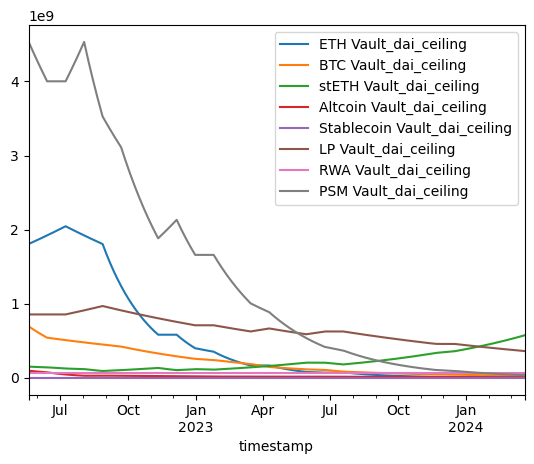

In [902]:
sim_dai_ceilings = simulator.dai_ceilings_history
sim_dai_ceilings.plot()

### Actions Log

In [903]:
start_date_dt = pd.to_datetime(start_date)  # Convert string to datetime
historical_cutoff = start_date_dt - pd.DateOffset(days=1)
historical_data = historical[historical.index <= historical_cutoff]


historical_data = historical_data.merge(test_data['RWA Vault_collateral_usd'], left_index=True, right_index=True, how='left')
historical_data

historical_optimized_weights, historical_portfolio_returns, historical_portfolio_composition, historical_total_portfolio_value = mvo(historical_data)
historical_portfolio_daily_returns,  historical_downside_returns, historical_excess_returns, historical_sortino_ratio = historical_sortino(historical_portfolio_returns,historical_portfolio_composition)

Individual Sortino Ratios: BTC Vault_collateral_usd          -1.61046
ETH Vault_collateral_usd          -3.02073
stETH Vault_collateral_usd         6.49820
Stablecoin Vault_collateral_usd   -1.21766
Altcoin Vault_collateral_usd      -1.94559
LP Vault_collateral_usd           -1.97911
RWA Vault_collateral_usd          -0.07620
PSM Vault_collateral_usd           0.43863
dtype: float64
Optimized weights: [0.1  0.05 0.5  0.1  0.01 0.01 0.02 0.21]
Daily downside deviation: 0.02550965199145749
Annualized downside deviation: 0.48736121698871765
Annualized excess return: -0.711474304628297
Portfolio Sortino Ratio: -1.4598500656747324


In [904]:
action_df.set_index('date', inplace=True)
action_df.columns

Index(['env reset start date', 'get state calculated portfolio value',
       'action', 'mvo calculated current portfolio value',
       'calculated optimized weights', 'current composition',
       'agent weights updated to', 'current sortino ratio',
       'target sortino ratio', 'current weights', 'target weights',
       'current cumulative return', 'Distance penalty', 'Scaled Sortino diff',
       'Reward', 'Reward no scale', 'dai ceilings'],
      dtype='object')

In [905]:
action_df['dai ceilings'].dropna().to_dict()

{Timestamp('2022-06-14 00:00:00'):             ETH Vault_dai_ceiling  stETH Vault_dai_ceiling  \
 2021-11-19    4,215,499,587.09872         16,779,001.87837   
 2021-11-20    4,185,875,620.48578         17,284,635.75812   
 2021-11-21    4,185,229,052.82756         19,140,998.34184   
 2021-11-22    4,167,338,922.83872         22,170,168.94489   
 2021-11-23    4,152,215,276.92244         23,065,851.72446   
 ...                           ...                      ...   
 2022-06-09    1,902,558,289.98690        142,143,288.18941   
 2022-06-10    1,907,314,685.71187        141,787,929.96894   
 2022-06-11    1,912,082,972.42615        141,433,460.14402   
 2022-06-12    1,916,863,179.85722        141,079,876.49366   
 2022-06-13    1,921,655,337.80686        140,727,176.80242   
 
             BTC Vault_dai_ceiling  Altcoin Vault_dai_ceiling  \
 2021-11-19    1,398,087,189.04925          170,858,309.36176   
 2021-11-20    1,393,749,077.71651          171,141,983.01782   
 2021-11-21  

In [906]:
action_df['target weights'].dropna().to_dict()

{Timestamp('2022-06-14 00:00:00'): {'BTC Vault_collateral_usd': 0.1,
  'ETH Vault_collateral_usd': 0.05,
  'stETH Vault_collateral_usd': 0.5,
  'Stablecoin Vault_collateral_usd': 0.1,
  'Altcoin Vault_collateral_usd': 0.010000000000002516,
  'LP Vault_collateral_usd': 0.010000000000000002,
  'RWA Vault_collateral_usd': 0.02,
  'PSM Vault_collateral_usd': 0.21000000000009833},
 Timestamp('2022-07-09 00:00:00'): {'BTC Vault_collateral_usd': 0.1,
  'ETH Vault_collateral_usd': 0.050000000000002695,
  'stETH Vault_collateral_usd': 0.5,
  'Stablecoin Vault_collateral_usd': 0.1,
  'Altcoin Vault_collateral_usd': 0.01,
  'LP Vault_collateral_usd': 0.015203262904937445,
  'RWA Vault_collateral_usd': 0.019999999999999976,
  'PSM Vault_collateral_usd': 0.20479673709506213},
 Timestamp('2022-08-03 00:00:00'): {'BTC Vault_collateral_usd': 0.10000000000004908,
  'ETH Vault_collateral_usd': 0.0500000000000613,
  'stETH Vault_collateral_usd': 0.4999999999998993,
  'Stablecoin Vault_collateral_usd': 0.

In [907]:
action_df['current composition'].dropna().to_dict()

{Timestamp('2022-06-14 00:00:00'): BTC Vault_collateral_usd          0.13823
 ETH Vault_collateral_usd          0.33547
 stETH Vault_collateral_usd        0.08111
 Stablecoin Vault_collateral_usd   0.05299
 Altcoin Vault_collateral_usd      0.04574
 LP Vault_collateral_usd           0.10747
 RWA Vault_collateral_usd          0.00545
 PSM Vault_collateral_usd          0.23354
 Name: 2022-06-13 00:00:00, dtype: float64,
 Timestamp('2022-07-09 00:00:00'): BTC Vault_collateral_usd          0.13721
 ETH Vault_collateral_usd          0.33432
 stETH Vault_collateral_usd        0.08551
 Stablecoin Vault_collateral_usd   0.04654
 Altcoin Vault_collateral_usd      0.03495
 LP Vault_collateral_usd           0.11643
 RWA Vault_collateral_usd          0.00516
 PSM Vault_collateral_usd          0.23987
 Name: 2022-07-08 00:00:00, dtype: float64,
 Timestamp('2022-08-03 00:00:00'): BTC Vault_collateral_usd          0.13551
 ETH Vault_collateral_usd          0.30785
 stETH Vault_collateral_usd        0

<Axes: xlabel='date'>

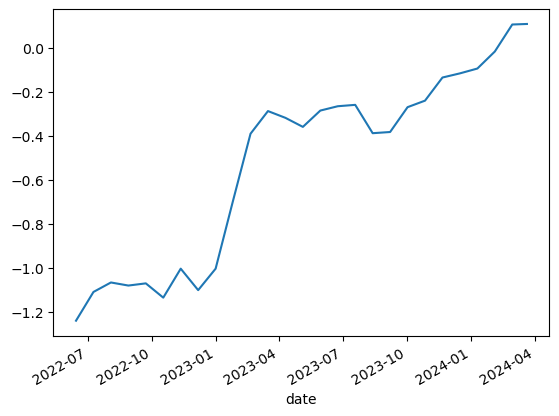

In [908]:
action_df['current sortino ratio'].dropna().plot()

<Axes: xlabel='date'>

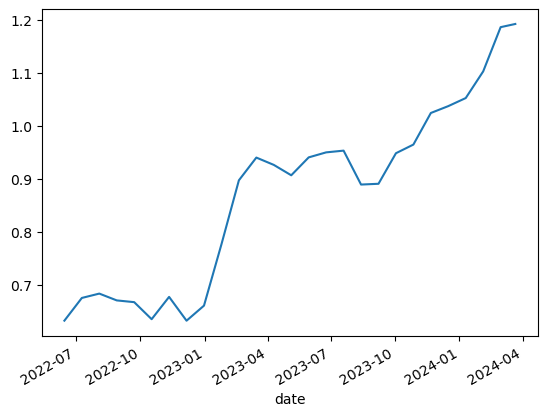

In [909]:
action_df['current cumulative return'].dropna().plot()

In [910]:
action_df['action'].dropna().to_dict()

{Timestamp('2022-05-20 00:00:00'): {'stETH Vault_dai_ceiling': -0.25,
  'ETH Vault_dai_ceiling': 0.25,
  'BTC Vault_dai_ceiling': -1,
  'Altcoin Vault_dai_ceiling': -1,
  'Stablecoin Vault_dai_ceiling': 0,
  'LP Vault_dai_ceiling': 0,
  'RWA Vault_dai_ceiling': 0,
  'PSM Vault_dai_ceiling': -0.5},
 Timestamp('2022-06-14 00:00:00'): {'stETH Vault_dai_ceiling': -0.5,
  'ETH Vault_dai_ceiling': 0.25,
  'BTC Vault_dai_ceiling': -0.25,
  'Altcoin Vault_dai_ceiling': -2,
  'Stablecoin Vault_dai_ceiling': 0,
  'LP Vault_dai_ceiling': 0,
  'RWA Vault_dai_ceiling': 0,
  'PSM Vault_dai_ceiling': 0},
 Timestamp('2022-07-09 00:00:00'): {'stETH Vault_dai_ceiling': -0.25,
  'ETH Vault_dai_ceiling': -0.25,
  'BTC Vault_dai_ceiling': -0.25,
  'Altcoin Vault_dai_ceiling': -2,
  'Stablecoin Vault_dai_ceiling': 0,
  'LP Vault_dai_ceiling': 0.25,
  'RWA Vault_dai_ceiling': 0,
  'PSM Vault_dai_ceiling': 0.5},
 Timestamp('2022-08-03 00:00:00'): {'stETH Vault_dai_ceiling': -1,
  'ETH Vault_dai_ceiling': -0.2

In [911]:
action_df
actions_log_path = '../data/actions/actionslog.csv'
action_df.to_csv(actions_log_path)

In [912]:
simulations_path = '../data/portfolio/simulations'
simulator.results.to_csv('simulations_path')

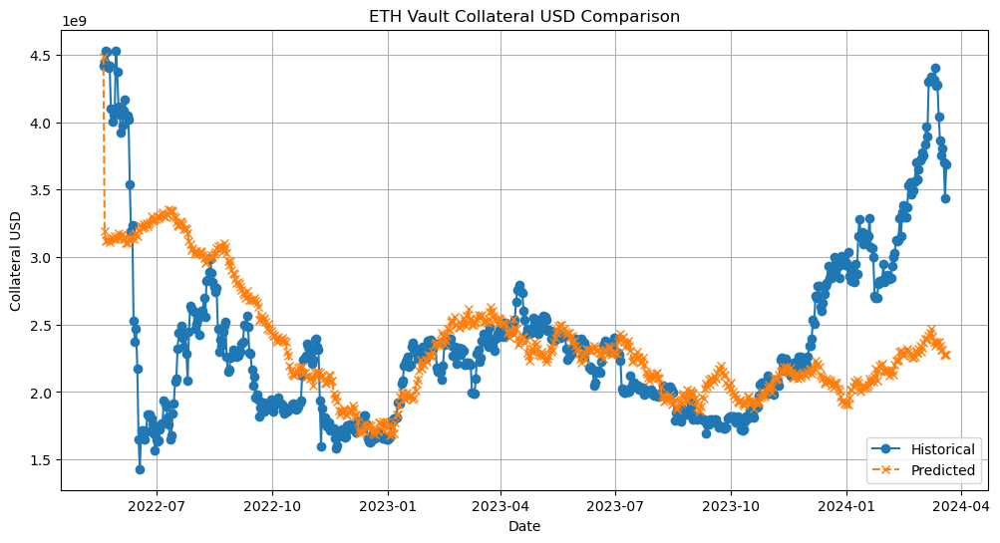

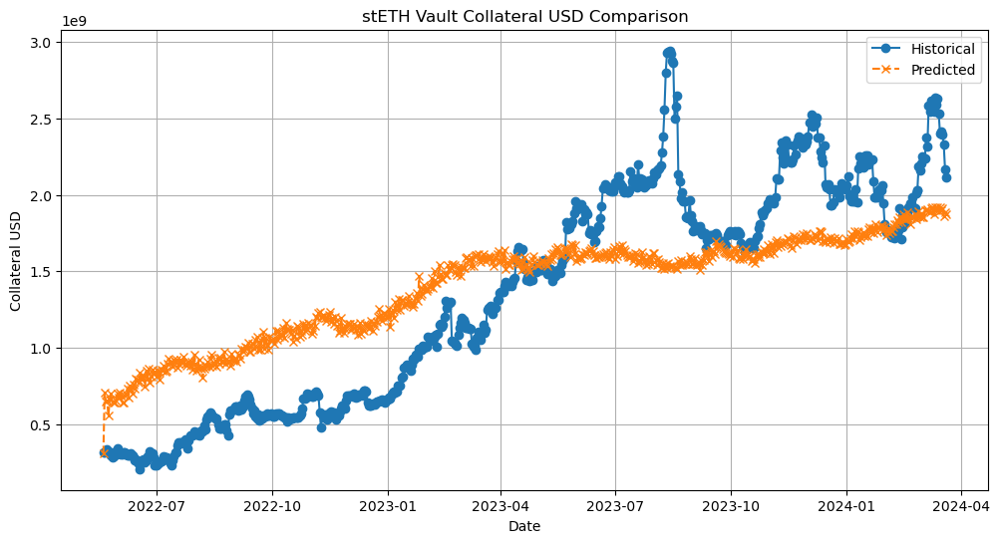

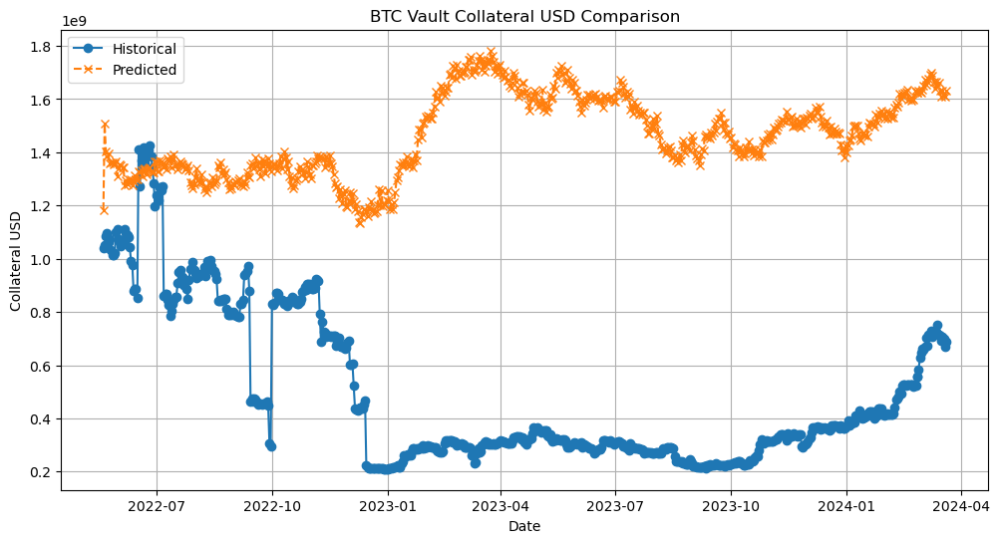

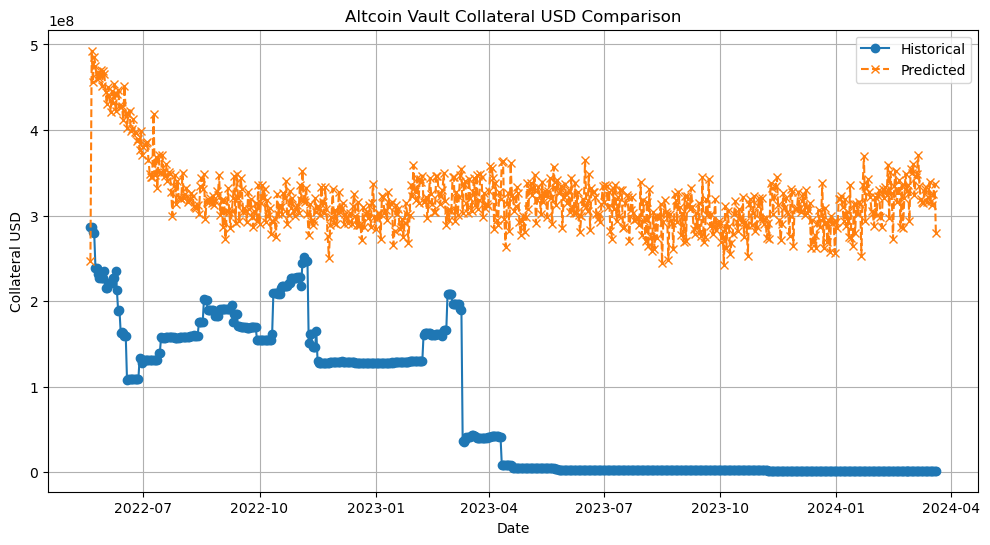

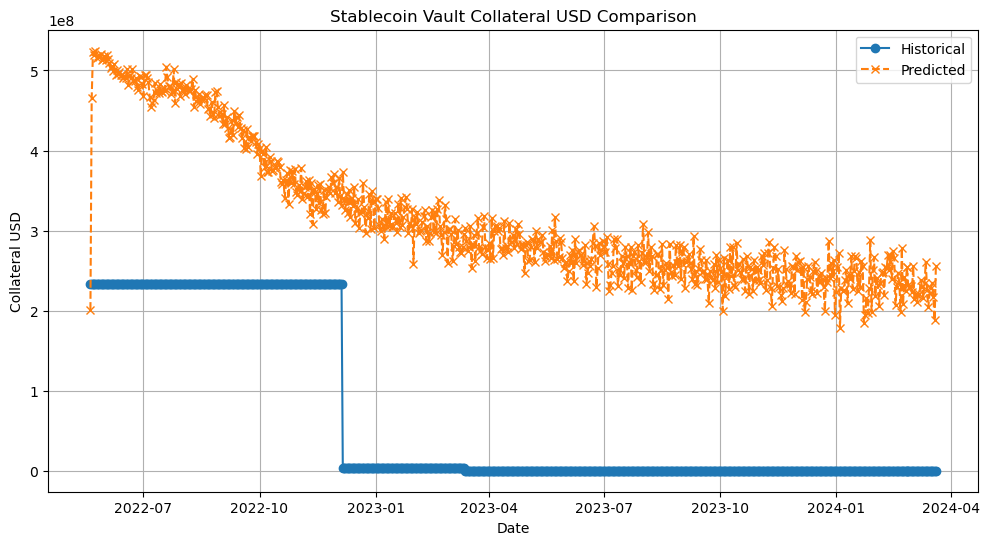

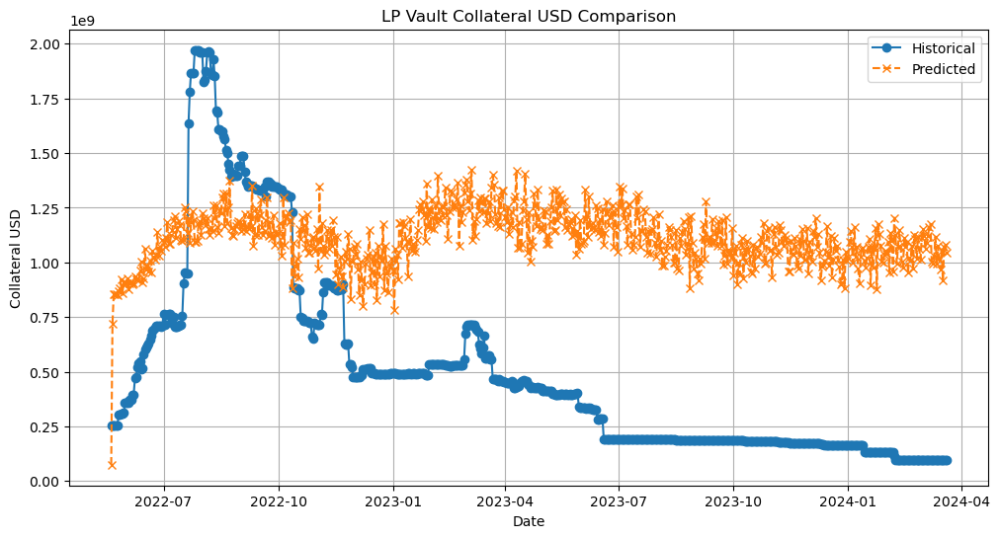

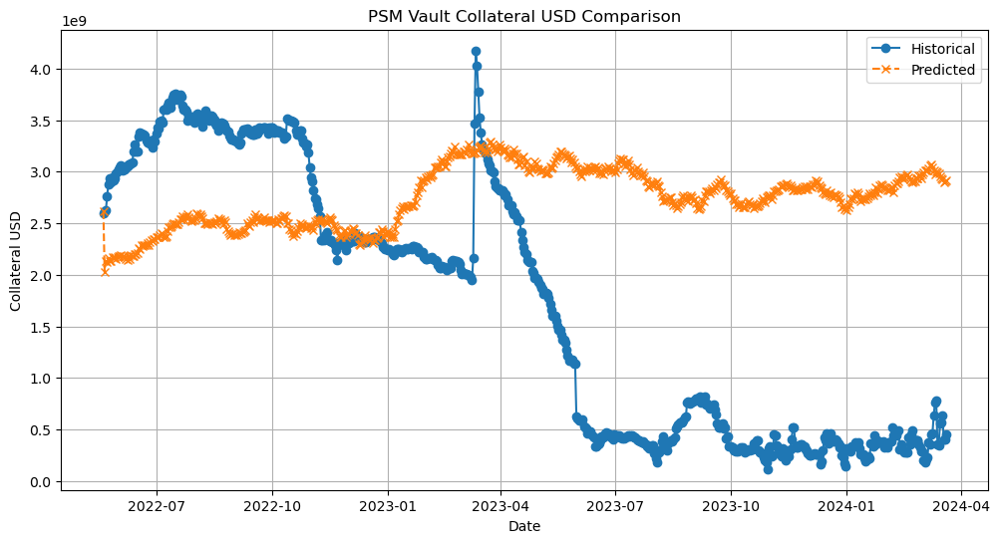

{'ETH Vault': {'MSE': 4.084020511054668e+17,
  'MAE': 440743058.7172799,
  'RMSE': 639063417.1234236,
  'R2': -0.057733397073061354},
 'stETH Vault': {'MSE': 1.9921888408028214e+17,
  'MAE': 390285684.2160187,
  'RMSE': 446339426.98386186,
  'R2': 0.6176967674751045},
 'BTC Vault': {'MSE': 1.0879479579310605e+18,
  'MAE': 971892224.8662363,
  'RMSE': 1043047438.0060863,
  'R2': -11.659588872752895},
 'Altcoin Vault': {'MSE': 6.541045232348489e+16,
  'MAE': 243794247.44480705,
  'RMSE': 255754672.1439999,
  'R2': -8.502219951246955},
 'Stablecoin Vault': {'MSE': 6.340499685101419e+16,
  'MAE': 246108581.0744927,
  'RMSE': 251803488.56005588,
  'R2': -4.592426330965548},
 'LP Vault': {'MSE': 5.4331648672325165e+17,
  'MAE': 685836409.8473227,
  'RMSE': 737100052.0439893,
  'R2': -1.723712856169179},
 'PSM Vault': {'MSE': 3.0908002326636764e+18,
  'MAE': 1507443437.6515024,
  'RMSE': 1758067186.6182125,
  'R2': -0.9134791852294739}}

In [913]:
rl_sim_results = simulator.results
evaluate_predictions(rl_sim_results, historical)

### Data Prep for MVO

In [914]:
start_date_dt = pd.to_datetime(start_date)  # Convert string to datetime
historical_cutoff = start_date_dt - pd.DateOffset(days=1)
historical_cutoff

Timestamp('2022-05-19 00:00:00')

In [915]:
historical_ceilings = test_data_copy[dai_ceilings]
ceiling_historical_cutoff = historical_cutoff.tz_localize(None)

historical_ceilings_for_sim =  historical_ceilings[historical_ceilings.index <= ceiling_historical_cutoff]
historical_ceilings_for_sim
combined_ceiling_data = pd.concat([historical_ceilings_for_sim, sim_dai_ceilings])
combined_ceiling_data

,ETH Vault_dai_ceiling,stETH Vault_dai_ceiling,BTC Vault_dai_ceiling,Altcoin Vault_dai_ceiling,Stablecoin Vault_dai_ceiling,LP Vault_dai_ceiling,RWA Vault_dai_ceiling,PSM Vault_dai_ceiling
2021-11-19,"4,215,499,587.09872","16,779,001.87837","1,398,087,189.04925","170,858,309.36176","5,000,000.00000","352,901,603.86001","59,000,000.00000","3,593,103,707.31785"
2021-11-20,"4,185,875,620.48578","17,284,635.75812","1,393,749,077.71651","171,141,983.01782","5,000,000.00000","372,841,835.68929","59,000,000.00000","3,604,384,386.93336"
2021-11-21,"4,185,229,052.82756","19,140,998.34184","1,407,300,021.86314","171,131,567.49223","5,000,000.00000","378,293,238.31257","59,000,000.00000","3,604,384,386.93336"
2021-11-22,"4,167,338,922.83872","22,170,168.94489","1,437,967,464.63631","159,239,990.91266","5,000,000.00000","378,299,770.81950","59,000,000.00000","3,674,297,040.97279"
2021-11-23,"4,152,215,276.92244","23,065,851.72446","1,435,093,757.47548","158,801,066.38277","5,000,000.00000","378,879,291.14350","59,000,000.00000","3,670,722,718.34453"
...,...,...,...,...,...,...,...,...
2024-03-16,"2,780,774.05933","561,409,460.99542","26,218,786.27427","6,039,103.48234",0.00000,"363,714,197.30855","59,000,000.00000","36,989,146.75912"
2024-03-17,"2,739,062.44844","564,216,508.30040","26,087,692.34289","6,024,005.72364",0.00000,"362,804,911.81528","59,000,000.00000","36,619,255.29153"
2024-03-18,"2,697,976.51171","567,037,590.84190","25,957,253.88118","6,008,945.70933",0.00000,"361,897,899.53574","59,000,000.00000","36,253,062.73861"
2024-03-19,"2,657,506.86404","569,872,778.79611","25,827,467.61177","5,993,923.34505",0.00000,"360,993,154.78691","59,000,000.00000","35,890,532.11123"


In [916]:
test_data.columns

Index(['ETH Vault_collateral_usd', 'stETH Vault_collateral_usd',
       'BTC Vault_collateral_usd', 'Altcoin Vault_collateral_usd',
       'Stablecoin Vault_collateral_usd', 'LP Vault_collateral_usd',
       'PSM Vault_collateral_usd', 'ETH Vault_dai_ceiling',
       'stETH Vault_dai_ceiling', 'BTC Vault_dai_ceiling',
       'Altcoin Vault_dai_ceiling', 'Stablecoin Vault_dai_ceiling',
       'LP Vault_dai_ceiling', 'PSM Vault_dai_ceiling',
       'BTC Vault_market_price', 'ETH Vault_market_price',
       'stETH Vault_market_price', 'Stablecoin Vault_market_price',
       'Altcoin Vault_market_price', 'LP Vault_market_price',
       'effective_funds_rate', 'M1V', 'WM2NS', 'fed_reverse_repo',
       'mcap_total_volume', 'defi_apy_medianAPY', 'defi_apy_avg7day',
       'dpi_market_Volume', 'ETH Vault_liquidation_ratio',
       'BTC Vault_liquidation_ratio', 'stETH Vault_liquidation_ratio',
       'Altcoin Vault_liquidation_ratio', 'Stablecoin Vault_liquidation_ratio',
       'LP Vault_liq

<Axes: >

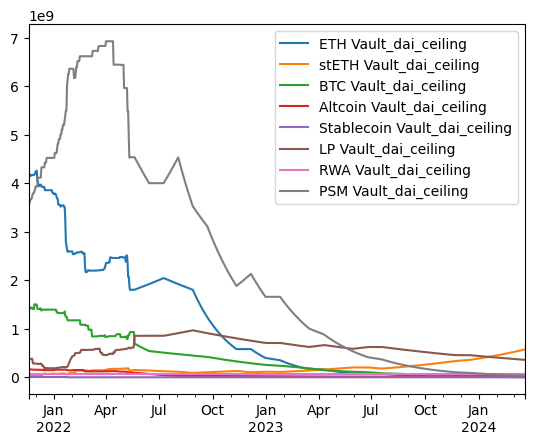

In [917]:
combined_ceiling_data.plot()

<Axes: xlabel='day'>

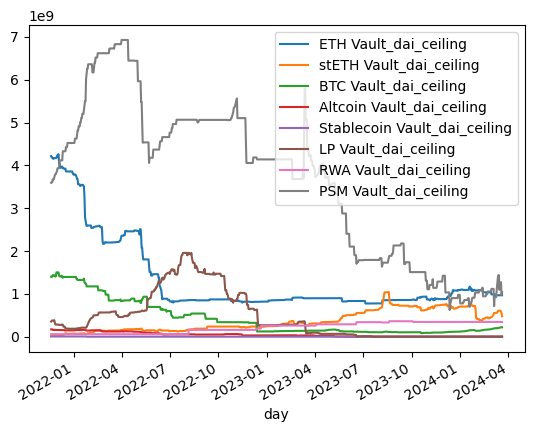

In [918]:
historical_ceilings.plot()

In [919]:
historical_data = historical[historical.index <= historical_cutoff]
rl_combined_data = pd.concat([historical_data, rl_sim_results])
mvo_combined_data = pd.concat([historical_data, mvo_sim_results])
print(mvo_combined_data)
print(rl_combined_data)

            ETH Vault_collateral_usd  stETH Vault_collateral_usd  \
2021-11-19      11,530,810,569.93515            39,769,944.75450   
2021-11-20      11,943,278,353.68762            41,280,230.12684   
2021-11-21      11,839,472,041.02766            48,477,796.29037   
2021-11-22      10,933,452,742.14960            59,724,075.18165   
2021-11-23      11,600,116,135.99997            74,570,808.78308   
...                              ...                         ...   
2024-03-16       1,832,477,922.36080         3,240,363,458.15019   
2024-03-17       1,826,260,344.78928         3,248,295,790.82496   
2024-03-18       1,828,115,473.46066         3,255,080,920.98085   
2024-03-19       1,830,007,714.18286         3,288,351,496.73086   
2024-03-20       1,820,820,259.64613         3,283,843,707.25275   

            BTC Vault_collateral_usd  Altcoin Vault_collateral_usd  \
2021-11-19       2,866,222,769.09959             520,045,444.90519   
2021-11-20       2,948,959,833.37399       

<Axes: >

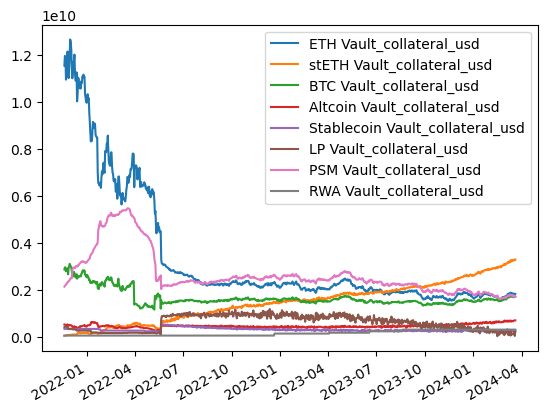

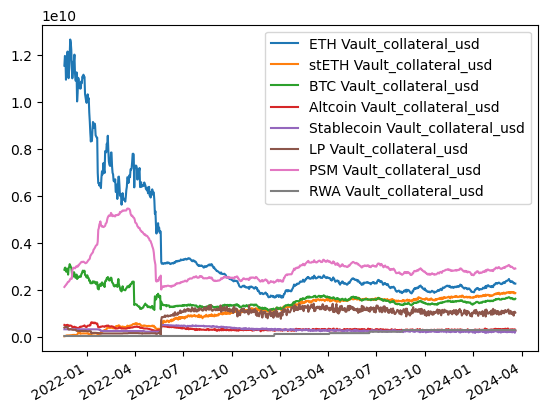

In [920]:
rl_combined_data.index = rl_combined_data.index.tz_localize(None)
mvo_combined_data.index = mvo_combined_data.index.tz_localize(None)

test_data['RWA Vault_collateral_usd'].index = test_data['RWA Vault_collateral_usd'].index.tz_localize(None)


#Since RWA is not a target, we need to add back in for MVO calculations
rl_sim_w_RWA = rl_combined_data.merge(test_data['RWA Vault_collateral_usd'], left_index=True, right_index=True, how='left')
mvo_sim_w_RWA = mvo_combined_data.merge(test_data['RWA Vault_collateral_usd'], left_index=True, right_index=True, how='left')

# Optional: Sort the DataFrame by index if it's not already sorted
rl_sim_w_RWA.sort_index(inplace=True)
mvo_sim_w_RWA.sort_index(inplace=True)


# Now 'combined_data' contains both historical and simulation data in one DataFrame
mvo_sim_w_RWA.plot()
rl_sim_w_RWA.plot()

In [921]:
sim_cutoff = rl_sim_w_RWA.index.max()
sim_cutoff

Timestamp('2024-03-20 00:00:00')

,ETH Vault_collateral_usd,stETH Vault_collateral_usd,BTC Vault_collateral_usd,Altcoin Vault_collateral_usd,Stablecoin Vault_collateral_usd,LP Vault_collateral_usd,PSM Vault_collateral_usd,RWA Vault_collateral_usd
day,,,,,,,,
2021-11-19,"11,530,810,569.93515","39,769,944.75450","2,866,222,769.09959","520,045,444.90519","336,521,697.42675","412,562,137.86644","2,132,251,251.20941","50,870,409.00000"
2021-11-20,"11,943,278,353.68762","41,280,230.12684","2,948,959,833.37399","508,972,390.70129","336,521,697.42675","430,562,322.97248","2,164,546,578.27289","50,870,409.00000"
2021-11-21,"11,839,472,041.02766","48,477,796.29037","2,951,818,107.21472","505,016,705.04971","336,521,697.42675","431,500,082.06578","2,195,743,029.10143","50,870,409.00000"
2021-11-22,"10,933,452,742.14960","59,724,075.18165","2,788,017,226.13774","509,504,043.07337","336,503,182.74675","433,806,450.38492","2,215,601,174.20796","50,870,409.00000"
2021-11-23,"11,600,116,135.99997","74,570,808.78308","2,821,788,807.21326","500,427,709.74620","336,503,182.74675","432,619,037.81609","2,258,244,677.18063","50,870,409.00000"
...,...,...,...,...,...,...,...,...
2024-03-16,"3,752,247,535.61763","2,417,541,115.80447","693,532,316.12871","1,944,419.59103","99,227.46740","97,377,612.28187","567,092,988.70479","303,771,975.92692"
2024-03-17,"3,803,584,313.35047","2,393,113,805.45610","706,205,158.85654","1,944,419.59103","99,227.46740","97,379,575.13498","631,684,264.91900","303,771,975.92692"
2024-03-18,"3,703,955,421.92055","2,328,357,914.39336","700,133,609.78409","1,944,419.59103","99,227.46740","97,380,556.52498","399,224,583.39463","303,771,975.92692"


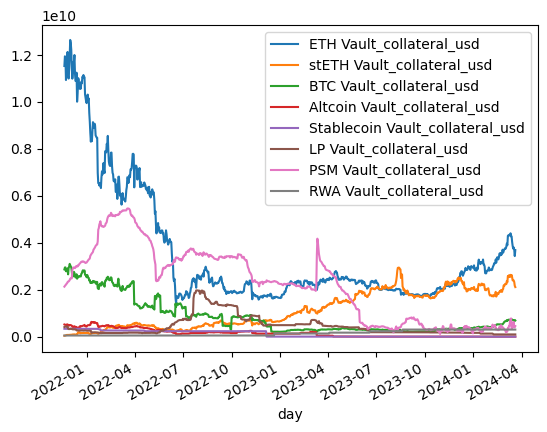

In [922]:
# Assuming 'test_data' is the DataFrame with the timezone-aware index
test_data.index = pd.to_datetime(test_data.index).tz_localize(None)

# Now perform the merge
historical_sim = test_data[test_data.index <= sim_cutoff]
historical_sim = historical_sim[targets].merge(test_data['RWA Vault_collateral_usd'], left_index=True, right_index=True, how='left')
historical_sim.plot()
historical_sim

### Historical Stats

In [923]:
historical_optimized_weights, historical_portfolio_returns, historical_portfolio_composition, historical_total_portfolio_value = mvo(historical_sim)
print('average daily return per vault:', historical_portfolio_returns.mean())
print('current composition:', historical_portfolio_composition.iloc[-1])
print(f'current portfolio value: ${historical_total_portfolio_value.iloc[-1]:,.2f}')

Individual Sortino Ratios: BTC Vault_collateral_usd          -0.44815
ETH Vault_collateral_usd          -0.36545
stETH Vault_collateral_usd         1.12372
Stablecoin Vault_collateral_usd   -2.40068
Altcoin Vault_collateral_usd      -1.66096
LP Vault_collateral_usd           -0.45638
RWA Vault_collateral_usd           0.48709
PSM Vault_collateral_usd          -0.48595
dtype: float64
Optimized weights: [0.1        0.19134517 0.5        0.1        0.01       0.06865483
 0.02       0.01      ]
average daily return per vault: BTC Vault_collateral_usd          -0.00166
ETH Vault_collateral_usd          -0.00133
stETH Vault_collateral_usd         0.00464
Stablecoin Vault_collateral_usd   -0.00950
Altcoin Vault_collateral_usd      -0.00653
LP Vault_collateral_usd           -0.00170
RWA Vault_collateral_usd           0.00209
PSM Vault_collateral_usd          -0.00182
dtype: float64
current composition: BTC Vault_collateral_usd          0.09394
ETH Vault_collateral_usd          0.50203
stETH Va

In [924]:
historical_portfolio_daily_returns,  historical_downside_returns, historical_excess_returns, historical_sortino_ratio = historical_sortino(historical_portfolio_returns,historical_portfolio_composition)

Daily downside deviation: 0.018521889407538017
Annualized downside deviation: 0.35386020027286225
Annualized excess return: -0.20447169577712399
Portfolio Sortino Ratio: -0.577831854555713


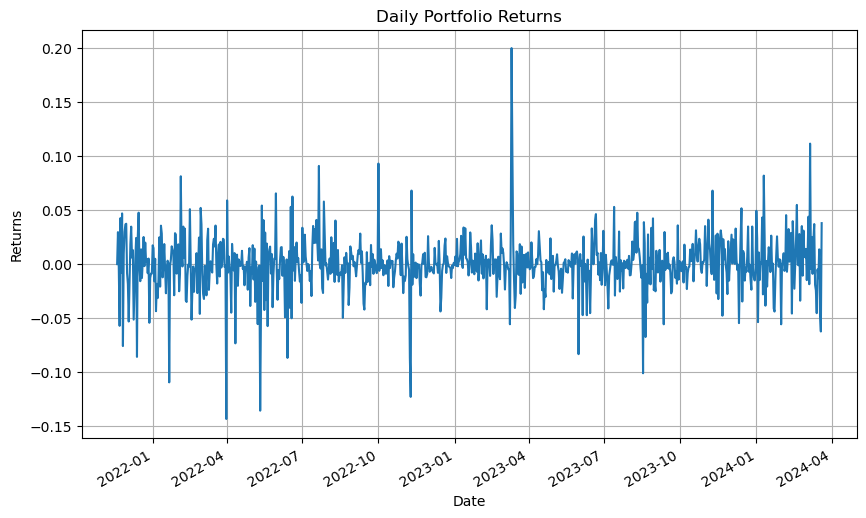

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


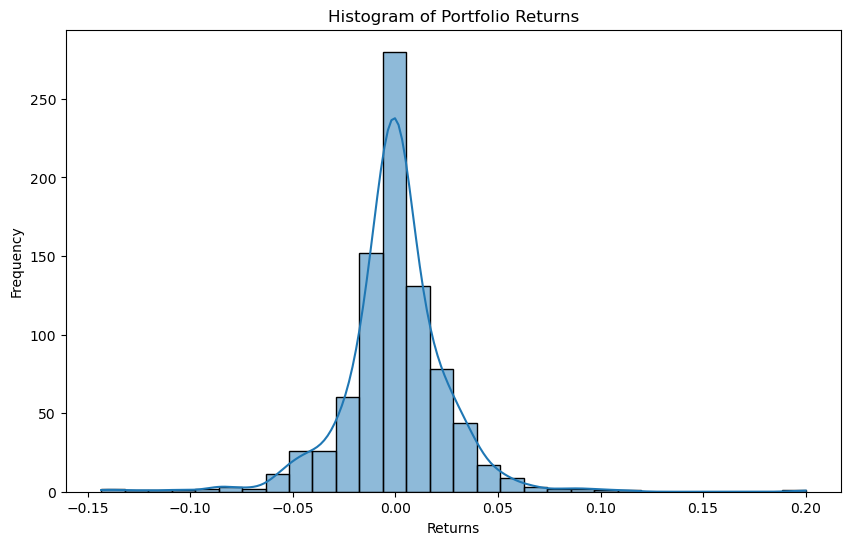

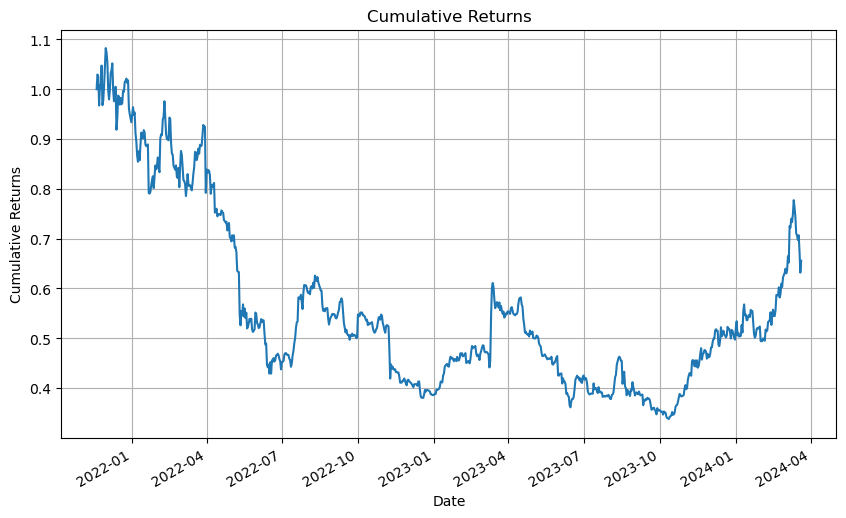

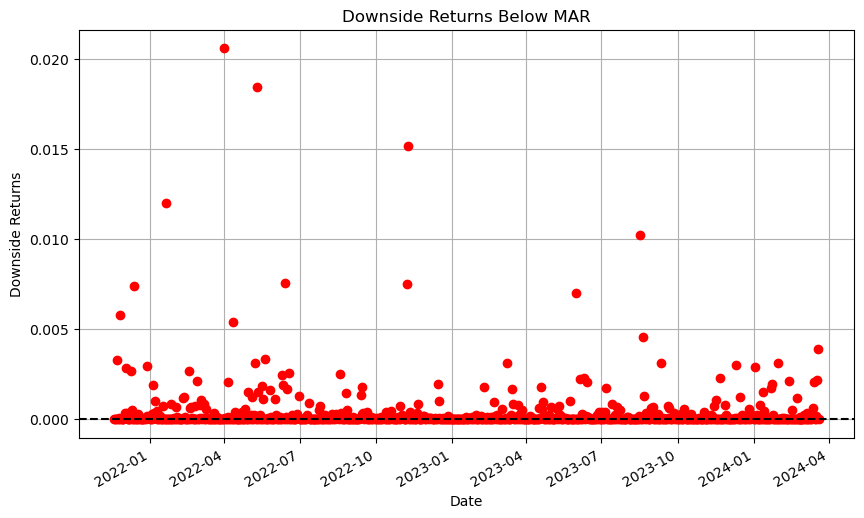

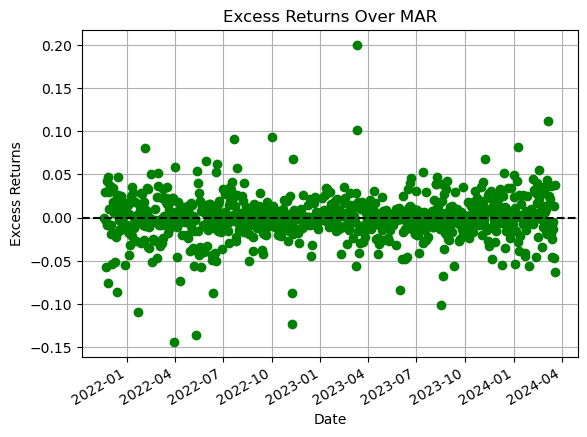

In [925]:
historical_returns = visualize_mvo_results(historical_portfolio_daily_returns, historical_downside_returns, historical_excess_returns)

### Sim Stats - Final Simulation w/ Agent Scores

In [926]:
rl_sim_w_RWA.iloc[-1].sum()

10579219447.70542

In [927]:
mvo_sim_w_RWA.iloc[-1].sum()

9984165495.615852

In [928]:
# Optimized Weights for Simulation

rl_portfolio_mvo_weights, rl_portfolio_returns, rl_portfolio_composition, rl_total_portfolio_value = mvo(rl_sim_w_RWA)
print('optimized weights:', rl_portfolio_mvo_weights)
print('current composition:', rl_portfolio_composition.iloc[-1])
print(f'current portfolio value: ${rl_total_portfolio_value.iloc[-1]:,.2f}')

Individual Sortino Ratios: BTC Vault_collateral_usd          -0.35023
ETH Vault_collateral_usd          -0.89790
stETH Vault_collateral_usd         1.93252
Stablecoin Vault_collateral_usd   -0.20104
Altcoin Vault_collateral_usd      -0.37895
LP Vault_collateral_usd            0.42007
RWA Vault_collateral_usd           0.86471
PSM Vault_collateral_usd           0.10285
dtype: float64
Optimized weights: [0.1        0.05       0.5        0.1        0.01       0.03957291
 0.02       0.18042709]
optimized weights: [0.1        0.05       0.5        0.1        0.01       0.03957291
 0.02       0.18042709]
current composition: BTC Vault_collateral_usd          0.15423
ETH Vault_collateral_usd          0.21508
stETH Vault_collateral_usd        0.17714
Stablecoin Vault_collateral_usd   0.02417
Altcoin Vault_collateral_usd      0.02647
LP Vault_collateral_usd           0.09852
RWA Vault_collateral_usd          0.02871
PSM Vault_collateral_usd          0.27566
Name: 2024-03-20 00:00:00, dtype: flo

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


In [929]:
mvo_portfolio_mvo_weights, mvo_portfolio_returns, mvo_portfolio_composition, mvo_total_portfolio_value = mvo(mvo_sim_w_RWA)
print('optimized weights:', mvo_portfolio_mvo_weights)
print('current composition:', mvo_portfolio_composition.iloc[-1])
print(f'current portfolio value: ${mvo_total_portfolio_value.iloc[-1]:,.2f}')

Individual Sortino Ratios: BTC Vault_collateral_usd          -0.20072
ETH Vault_collateral_usd          -0.62276
stETH Vault_collateral_usd         1.36618
Stablecoin Vault_collateral_usd   -0.18230
Altcoin Vault_collateral_usd       0.05726
LP Vault_collateral_usd           -0.18907
RWA Vault_collateral_usd           0.53155
PSM Vault_collateral_usd          -0.10792
dtype: float64
Optimized weights: [0.1        0.05       0.5        0.1        0.03448548 0.01
 0.02       0.18551452]
optimized weights: [0.1        0.05       0.5        0.1        0.03448548 0.01
 0.02       0.18551452]
current composition: BTC Vault_collateral_usd          0.17110
ETH Vault_collateral_usd          0.18237
stETH Vault_collateral_usd        0.32891
Stablecoin Vault_collateral_usd   0.02129
Altcoin Vault_collateral_usd      0.06991
LP Vault_collateral_usd           0.02555
RWA Vault_collateral_usd          0.03043
PSM Vault_collateral_usd          0.17045
Name: 2024-03-20 00:00:00, dtype: float64
current

C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "
C:\Users\brandyns pc\anacondareal\Lib\site-packages\scipy\optimize\_optimize.py:404: RuntimeWarning: Values in x were outside bounds during a minimize step, clipping to bounds
  warnings.warn("Values in x were outside bounds during a "


In [930]:
mvo_sim_portfolio_daily_returns,  mvo_sim_downside_returns, mvo_sim_excess_returns, mvo_sim_sortino_ratio = historical_sortino(mvo_portfolio_returns,mvo_portfolio_composition)

Daily downside deviation: 0.013150191686778851
Annualized downside deviation: 0.2512340594160057
Annualized excess return: 0.19622689635822899
Portfolio Sortino Ratio: 0.7810521265084798


In [931]:
rl_sim_portfolio_daily_returns,  rl_sim_downside_returns, rl_sim_excess_returns, rl_sim_sortino_ratio = historical_sortino(rl_portfolio_returns,rl_portfolio_composition)

Daily downside deviation: 0.01303178070902406
Annualized downside deviation: 0.248971820862429
Annualized excess return: 0.03836658382250957
Portfolio Sortino Ratio: 0.15410010534368576


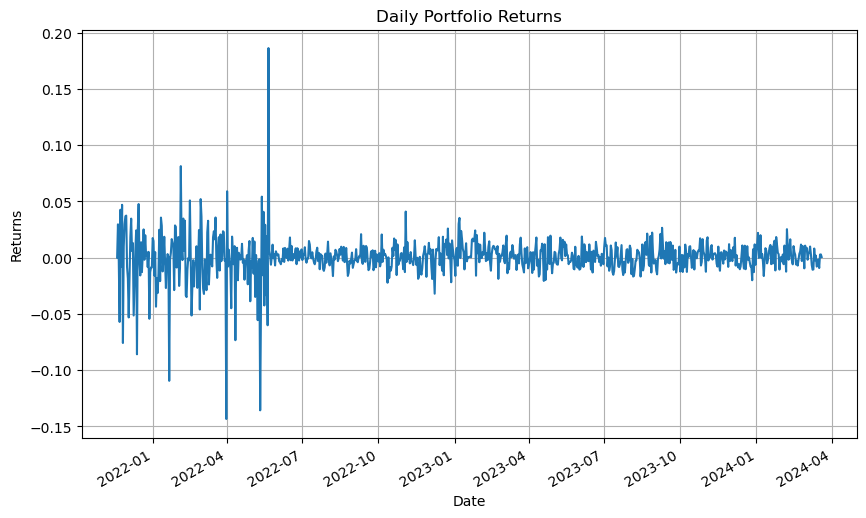

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


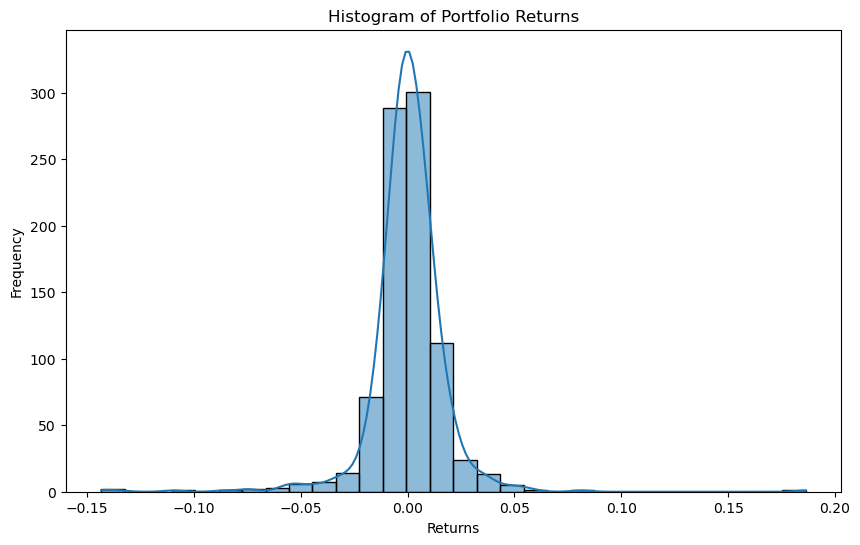

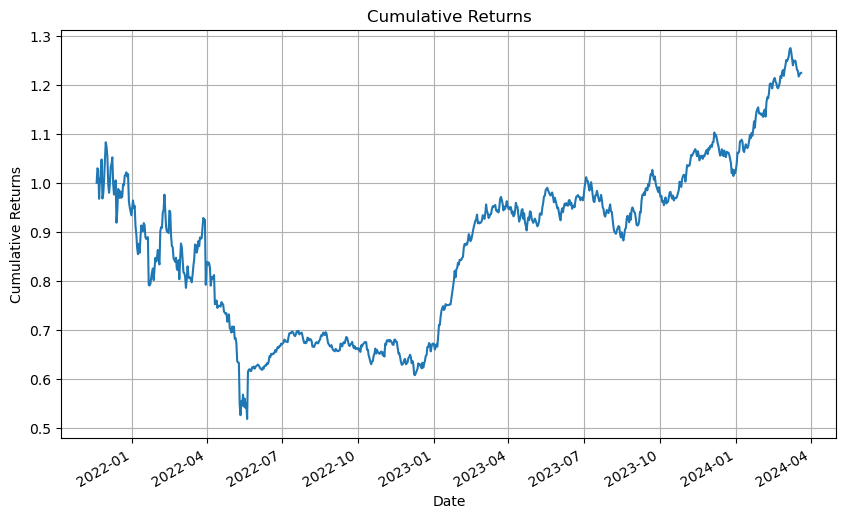

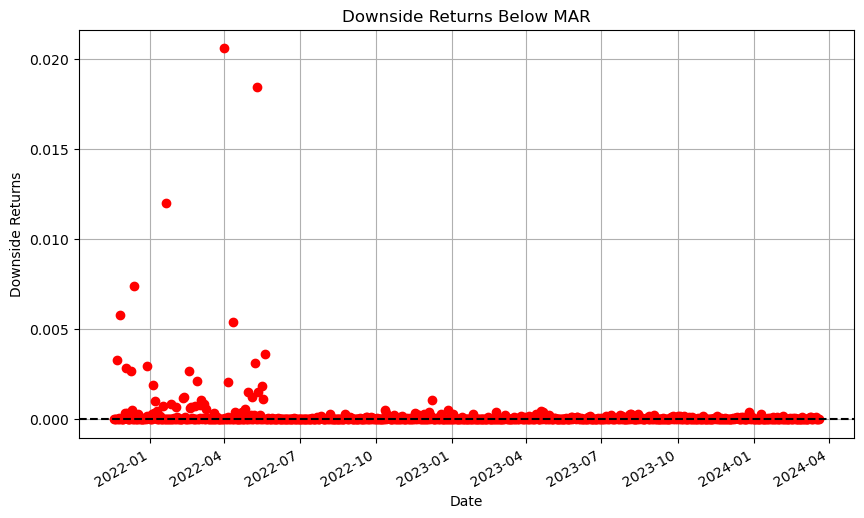

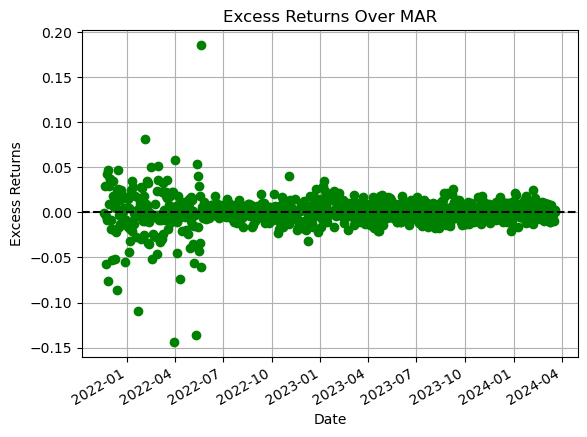

In [932]:
rl_optimized_returns = visualize_mvo_results(rl_sim_portfolio_daily_returns, rl_sim_downside_returns, rl_sim_excess_returns)

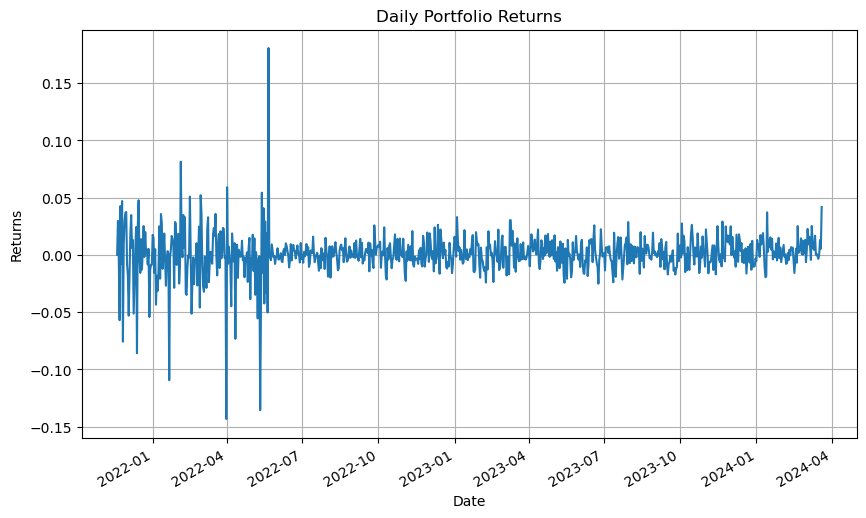

C:\Users\brandyns pc\anacondareal\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


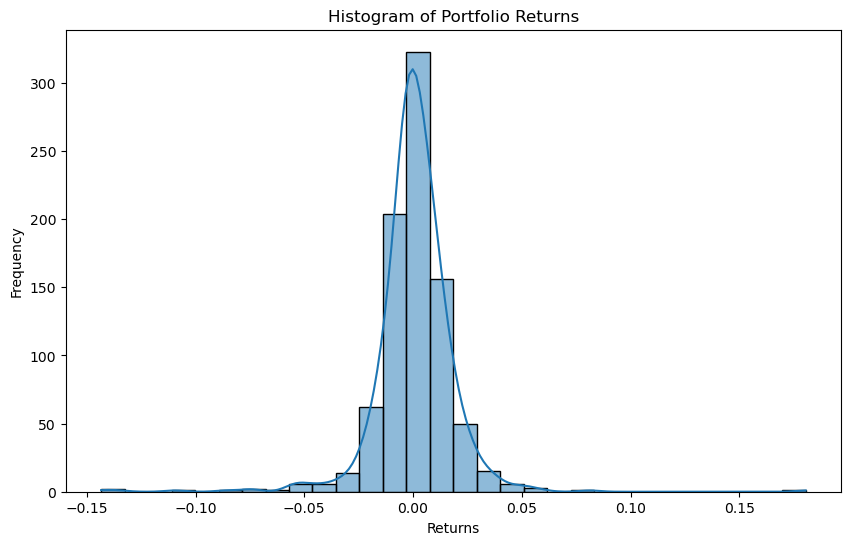

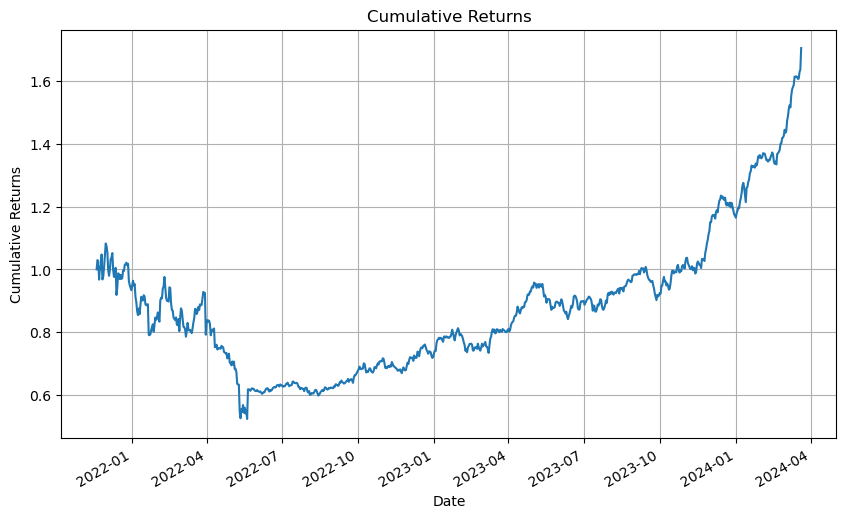

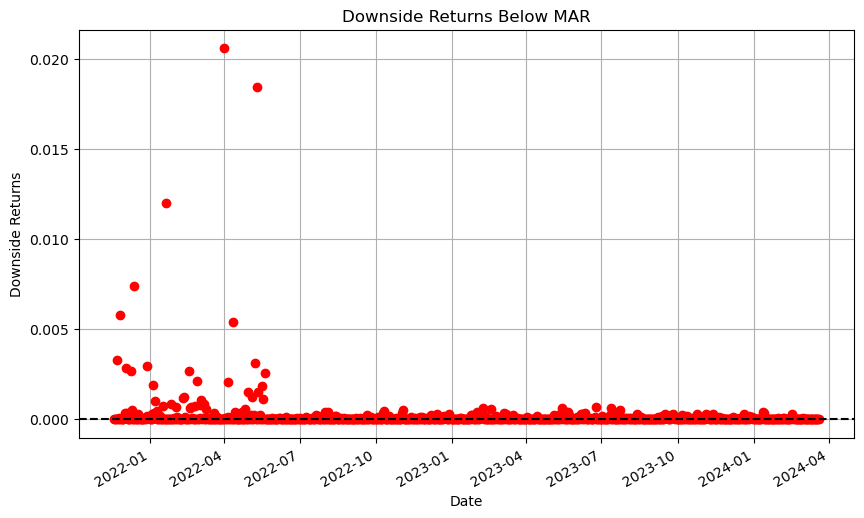

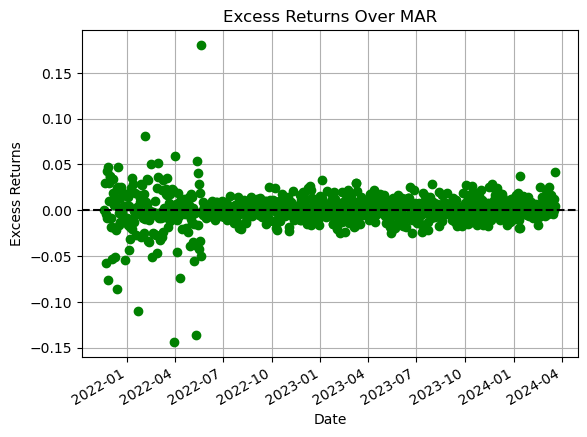

In [933]:
mvo_optimized_returns = visualize_mvo_results(mvo_sim_portfolio_daily_returns, mvo_sim_downside_returns, mvo_sim_excess_returns)

### Comparisons on charts

In [934]:
print(mvo_optimized_returns.describe())
print(rl_optimized_returns.describe())

count   854.00000
mean      0.87978
std       0.22188
min       0.52359
25%       0.70734
50%       0.86504
75%       0.97164
max       1.70460
dtype: float64
count   854.00000
mean      0.87277
std       0.17153
min       0.51822
25%       0.68148
50%       0.91757
75%       0.98036
max       1.27471
dtype: float64


In [935]:
# Find the duplicate indices
mvo_duplicate_indices = mvo_optimized_returns.index[mvo_optimized_returns.index.duplicated()]
rl_duplicate_indices = rl_optimized_returns.index[rl_optimized_returns.index.duplicated()]

# Print the duplicate indices
print("MVO Duplicate indices:", mvo_duplicate_indices)
print("RL Duplicate indices:", rl_duplicate_indices)

# Drop duplicates, keeping the first occurrence
rl_optimized_returns = rl_optimized_returns[~rl_optimized_returns.index.duplicated(keep='first')]
mvo_optimized_returns = mvo_optimized_returns[~mvo_optimized_returns.index.duplicated(keep='first')]

# Verify if duplicates are removed
print("After removing duplicates")
print("MVO indices:", mvo_optimized_returns.index)
print("RL indices:", rl_optimized_returns.index)


MVO Duplicate indices: DatetimeIndex(['2024-02-26'], dtype='datetime64[ns]', freq=None)
RL Duplicate indices: DatetimeIndex(['2024-02-26'], dtype='datetime64[ns]', freq=None)
After removing duplicates
MVO indices: DatetimeIndex(['2021-11-19', '2021-11-20', '2021-11-21', '2021-11-22',
               '2021-11-23', '2021-11-24', '2021-11-25', '2021-11-26',
               '2021-11-27', '2021-11-28',
               ...
               '2024-03-11', '2024-03-12', '2024-03-13', '2024-03-14',
               '2024-03-15', '2024-03-16', '2024-03-17', '2024-03-18',
               '2024-03-19', '2024-03-20'],
              dtype='datetime64[ns]', length=853, freq=None)
RL indices: DatetimeIndex(['2021-11-19', '2021-11-20', '2021-11-21', '2021-11-22',
               '2021-11-23', '2021-11-24', '2021-11-25', '2021-11-26',
               '2021-11-27', '2021-11-28',
               ...
               '2024-03-11', '2024-03-12', '2024-03-13', '2024-03-14',
               '2024-03-15', '2024-03-16', '2024

In [936]:
historical_returns.index

DatetimeIndex(['2021-11-19', '2021-11-20', '2021-11-21', '2021-11-22',
               '2021-11-23', '2021-11-24', '2021-11-25', '2021-11-26',
               '2021-11-27', '2021-11-28',
               ...
               '2024-03-11', '2024-03-12', '2024-03-13', '2024-03-14',
               '2024-03-15', '2024-03-16', '2024-03-17', '2024-03-18',
               '2024-03-19', '2024-03-20'],
              dtype='datetime64[ns]', name='day', length=856, freq=None)

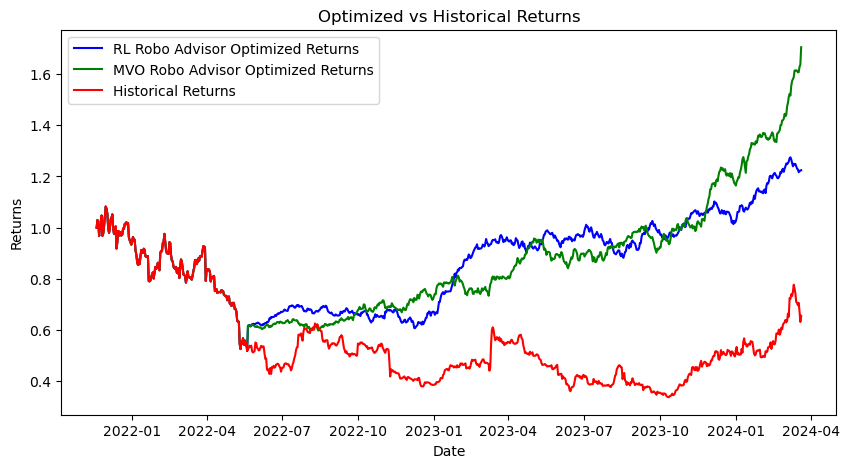

In [937]:
all_dates = rl_optimized_returns.index.union(historical_returns.index)
#optimized_returns = optimized_returns.reindex(all_dates, fill_value=0)
#historical_returns = historical_returns.reindex(all_dates, fill_value=0)

plt.figure(figsize=(10, 5))
plt.plot(rl_optimized_returns.index, rl_optimized_returns.values, label='RL Robo Advisor Optimized Returns', color='blue')
plt.plot(mvo_optimized_returns.index, mvo_optimized_returns.values, label='MVO Robo Advisor Optimized Returns', color='green')
plt.plot(historical_returns.index, historical_returns.values, label='Historical Returns', color='red')
plt.title('Optimized vs Historical Returns')
plt.xlabel('Date')
plt.ylabel('Returns')
plt.legend()
plt.show()


### Sim Composition

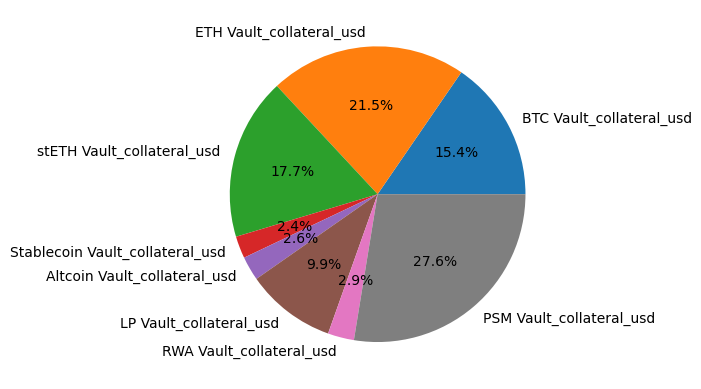

current portfolio value: $10,579,219,447.71


In [938]:
plt.pie(rl_portfolio_composition.iloc[-1], labels = rl_portfolio_composition.columns, autopct='%1.1f%%')
plt.show() 
print(f'current portfolio value: ${rl_total_portfolio_value.iloc[-1]:,.2f}')

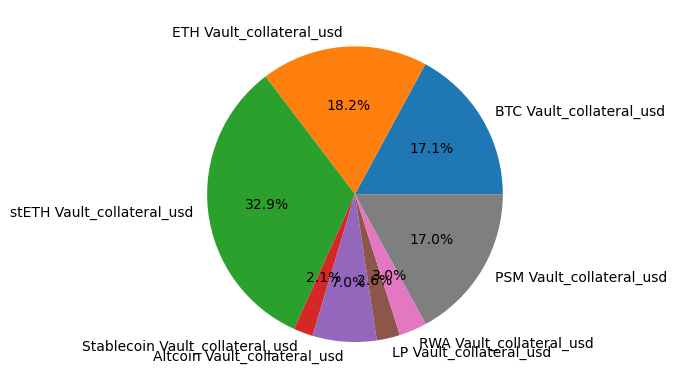

current portfolio value: $9,984,165,495.62


In [939]:
plt.pie(mvo_portfolio_composition.iloc[-1], labels = mvo_portfolio_composition.columns, autopct='%1.1f%%')
plt.show() 
print(f'current portfolio value: ${mvo_total_portfolio_value.iloc[-1]:,.2f}')

### Historical Composition 

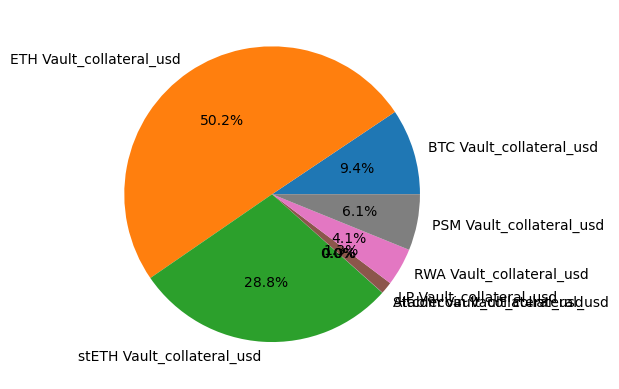

current portfolio value: $7,342,533,784.81


In [940]:
plt.pie(historical_portfolio_composition.iloc[-1], labels = historical_portfolio_composition.columns, autopct='%1.1f%%' )
plt.show() 
print(f'current portfolio value: ${historical_total_portfolio_value.iloc[-1]:,.2f}')

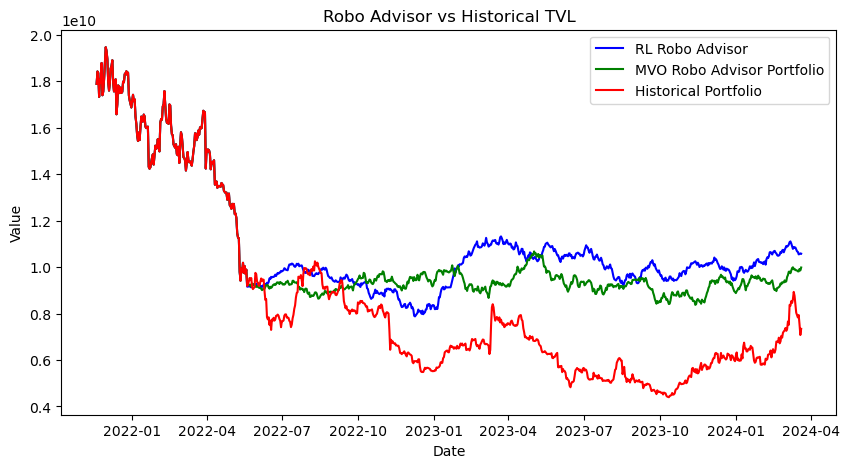

In [941]:
plt.figure(figsize=(10, 5))
plt.plot(rl_total_portfolio_value.index, rl_total_portfolio_value.values, label='RL Robo Advisor', color='blue')
plt.plot(mvo_total_portfolio_value.index, mvo_total_portfolio_value.values, label='MVO Robo Advisor Portfolio', color='green')
plt.plot(historical_total_portfolio_value.index, historical_total_portfolio_value.values, label='Historical Portfolio', color='red')
plt.title('Robo Advisor vs Historical TVL')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()


In [942]:
## Add historical MAR from annual risk_free rate to daily risk free  

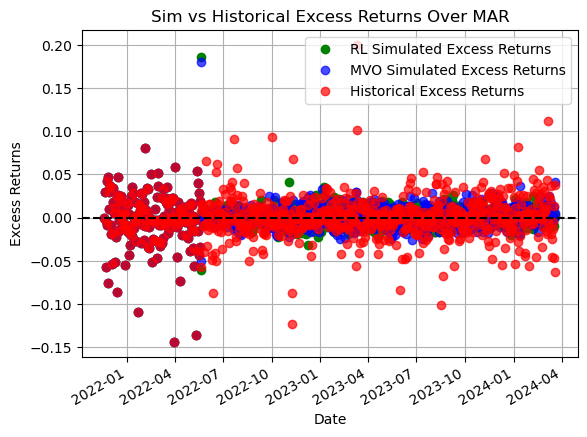

In [943]:
ax = rl_sim_excess_returns.plot(style='go', label='RL Simulated Excess Returns', title='Sim vs Historical Excess Returns Over MAR')
# Plot the second set of excess returns on the same axis
mvo_sim_excess_returns.plot(ax=ax, style='bo', alpha=0.7, label='MVO Simulated Excess Returns')  # 'ro' for red dots, you can change the color and marker style
historical_excess_returns.plot(ax=ax, style='ro', alpha=0.7, label='Historical Excess Returns')  # 'ro' for red dots, you can change the color and marker style

# Add a line at the minimum acceptable return (MAR) for reference
plt.axhline(0, color='k', linestyle='--')

# Set the labels and grid
plt.xlabel('Date')
plt.ylabel('Excess Returns')
plt.grid(True)

# Add the legend
plt.legend()

# Show the plot
plt.show()


sim_portfolio_daily_returns.describe()

historical_portfolio_daily_returns.describe()

(1 + sim_portfolio_daily_returns).cumprod()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Assuming 'sim_portfolio_daily_returns' is your daily returns Series
cumulative_returns = (1 + sim_portfolio_daily_returns).cumprod()

# Display the cumulative returns
cumulative_returns

# Reset display option if you want to limit the display in other parts of your code


pd.reset_option('display.max_rows')
(1 + historical_portfolio_daily_returns).cumprod()